In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def coth(a):
    if a>0: return (1+tf.math.exp(-2*a))/(1-tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)+1)/(tf.math.exp(2*a)-1)
    if a==0: return 0

def tanh(a):
    if a>0: return (1-tf.math.exp(-2*a))/(1+tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)-1)/(tf.math.exp(2*a)+1)
    if a==0: return 0

In [18]:
data=1000
batch=100
set=10
layer=10
n_ini=1.0
n_fin=0.1
dn=-0.1
m2=-1
lam=1
c_reg1=0.003
c_reg2=0.0001

<tf.Variable 'Variable:0' shape=(10,) dtype=float64, numpy=
array([ 2.3378483 ,  2.58324552,  0.70134832,  0.93042548,  2.86482408,
        1.15781088,  2.01101733,  4.1851119 ,  4.50076221, 11.26022271])>
tf.Tensor(
[ 3.01490951  3.02722263  3.04978824  3.09134316  3.16854751  3.31437385
  3.59861219  4.18820179  5.58607614 10.29821491], shape=(10,), dtype=float64)


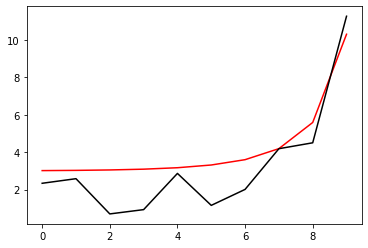

In [4]:
h=tf.zeros(layer)
h_in=[]
#h_in=[3.0205426, 3.022307 , 3.0291433, 3.04402  , 3.0732646, 3.131582 ,
# 3.2585216, 3.5762587, 4.59116  , 9.752249]
for i in range (layer):
#   midd=np.float64(10.0)
#    h_in.append(midd)
#    midd=3*coth(3*((i-layer)*dn)).numpy()
#    h_in.append(midd)
    mu=1/(1-i/10)
    h_inn=np.float64(np.random.normal(mu, 1))
    h_in.append(h_inn)
h=tf.Variable(h_in)
print(h)

h_real=tf.zeros(layer)
middd=[]
for i in range (layer):
    midd=3*coth(3*((i-layer)*dn)).numpy()
    middd.append(midd)
h_real=tf.constant(middd)
print(h_real)
plt.plot(h_real, 'r-')
plt.plot(h.numpy(), 'k-')
plt.show()

In [5]:
def F_func(a,b):
    return 2*b/n_fin-m2*a-lam*(a**3)

def t_func(a):
    return 0.5*(tf.math.tanh(100*(a-0.1))-tf.math.tanh(100*(a+0.1))+2)

In [6]:
def LP2(hh, phi, pi):
    for j in range (layer-1):
        phi1=phi+dn*pi
        pi1 =phi*m2*dn+(1-dn*hh[j])*pi+dn*lam*(phi1**3)
        phi=phi1
        pi=pi1
    return phi, pi
def NN_func_p(hh):
    Positive=[]
    while len(Positive)<batch:
        phi1=np.random.uniform(0.0, 1.5, 10000)
        pi1=np.random.uniform(-0.2, 0.2, 10000)
        phi_1, pi_1=LP2(hh, phi1, pi1)
        F=np.array(tf.math.abs(F_func(phi_1, pi_1)))
        for i in range (len(phi1[F<0.1])):
            Positive.append([phi1[F<0.1][i], pi1[F<0.1][i]])
            if len(Positive)>=batch: break
    return Positive
def NN_func_n(hh):
    Negative=[]
    while len(Negative)<batch:
        phi1=np.random.uniform(0.0, 1.5, 10000)
        pi1=np.random.uniform(-0.2, 0.2, 10000)
        phi_1, pi_1=LP2(hh, phi1, pi1)
        F=np.array(tf.math.abs(F_func(phi_1, pi_1)))
        for i in range (len(phi1[F>=0.1])):
            Negative.append([phi1[F>=0.1][i], pi1[F>=0.1][i]])
            if len(Negative)>=batch: break
    return Negative
def NN_func_01(hh, list1):
    PP=[]
    NN=[]
    phi=np.array(list1)[:, 0]
    pi=np.array(list1)[:, 1]
    F=np.array(tf.math.abs(LP2(hh, phi, pi)[1]))
    for i in range (len(phi[F<0.1])):
        PP.append([phi[F<0.1][i], pi[F<0.1][i]])
    for i in range (len(phi[F>=0.1])):
        NN.append([phi[F>=0.1][i], pi[F>=0.1][i]])
    return PP, NN

In [7]:
Positive=[]
Negative=[]
for i in range (set):
    Positive.insert(i, NN_func_p(h_real))
    Negative.insert(i, NN_func_n(h_real))
    print(i)

0
1
2
3
4
5
6
7
8
9


In [8]:
Positive0=[]
Positive1=[]
Negative0=[]
Negative1=[]
for i in range (set):
    Positive0.insert(i, NN_func_01(h, Positive[i])[0])
    Positive1.insert(i, NN_func_01(h, Positive[i])[1])
    Negative0.insert(i, NN_func_01(h, Negative[i])[0])
    Negative1.insert(i, NN_func_01(h, Negative[i])[1])

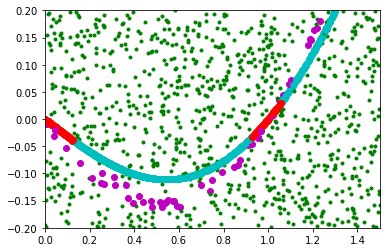

In [9]:
x_data1=[]
y_data1=[]
x_data2=[]
y_data2=[]
x_data3=[]
y_data3=[]
x_data4=[]
y_data4=[]
for i in range (set):
    x_data1.insert(i, [v[0] for v in Positive0[i]])
    y_data1.insert(i, [v[1] for v in Positive0[i]])
    x_data2.insert(i, [v[0] for v in Positive1[i]])
    y_data2.insert(i, [v[1] for v in Positive1[i]])
    x_data3.insert(i, [v[0] for v in Negative0[i]])
    y_data3.insert(i, [v[1] for v in Negative0[i]])
    x_data4.insert(i, [v[0] for v in Negative1[i]])
    y_data4.insert(i, [v[1] for v in Negative1[i]])
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'co')
    plt.plot(x_data1[i], y_data1[i], 'ro')
    plt.plot(x_data3[i], y_data3[i], 'mo')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.show()

# Error function

$E=\sum_{data} \left\vert y(\bar{x}^{(1)}) - \bar{y} \right\vert+E_{reg}(W)$
, $E_{reg}=c_{reg}^{(1)}\sum_{n=1}^{N-1}(\eta^{(n)})^{4}(h(\eta^{(n+1)})-h(\eta^{(n)}))^{2}+c_{reg}^{(2)}(h(\eta^{(N)})-1/\eta^{(N)})^{2}$

In [10]:
def Error_func(hh, list1, list2):
    phi0=np.array([v[0] for v in list1])
    pi0=np.array([v[1] for v in list1])
    phi1=np.array([v[0] for v in list2])
    pi1=np.array([v[1] for v in list2])
    phi_0, pi_0=LP2(hh, phi0, pi0)
    phi_1, pi_1=LP2(hh, phi1, pi1)
    PPlist=t_func(pi_0)
    NNlist=t_func(pi_1)
    sum_p=sum(PPlist)/batch
    sum_n=(batch-sum(NNlist))/batch

    inside=0
    for k in range (layer-1):
        second=((n_ini+k*dn)**4)*((hh[k+1]-hh[k])**2)
        inside=inside+second
    E_reg1=c_reg1*inside
    E_reg2=c_reg2*((hh[layer-1]-1/n_fin)**2)
    return E_reg1+E_reg2+sum_p+sum_n

In [11]:
for i in range (set):
    print(Error_func(h_real, Positive[i], Negative[i]))
for i in range (set):
    print(Error_func(h, Positive[i], Negative[i]))

tf.Tensor(0.060211069919598, shape=(), dtype=float64)
tf.Tensor(0.010212077942647354, shape=(), dtype=float64)
tf.Tensor(0.039088345222282106, shape=(), dtype=float64)
tf.Tensor(0.027830319418492643, shape=(), dtype=float64)
tf.Tensor(0.020122019370595854, shape=(), dtype=float64)
tf.Tensor(0.010514911792197284, shape=(), dtype=float64)
tf.Tensor(0.009215105355121591, shape=(), dtype=float64)
tf.Tensor(0.021059358525398784, shape=(), dtype=float64)
tf.Tensor(0.030178063056697603, shape=(), dtype=float64)
tf.Tensor(0.017776355177466268, shape=(), dtype=float64)
tf.Tensor(0.8737119817235747, shape=(), dtype=float64)
tf.Tensor(0.7952856512090725, shape=(), dtype=float64)
tf.Tensor(0.851047930876466, shape=(), dtype=float64)
tf.Tensor(0.8362641985948449, shape=(), dtype=float64)
tf.Tensor(0.8051138187897874, shape=(), dtype=float64)
tf.Tensor(0.7813090784653625, shape=(), dtype=float64)
tf.Tensor(0.8316926762948877, shape=(), dtype=float64)
tf.Tensor(0.792353000935815, shape=(), dtype=floa

0 0.8559925664915254
[ 2.43784723  2.68324351  0.80134687  1.03042297  2.96481468  1.25780229
  1.91111887  4.08512464  4.40077088 11.16112444]


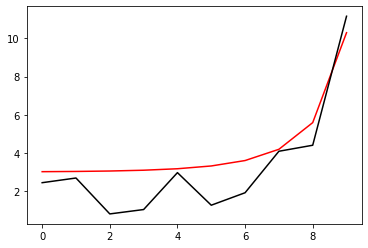

1100 0.02128265095715269
[ 3.36117959  3.59749262  1.73226124  1.96046813  3.86550032  2.14183016
  1.94812094  3.45075131  3.65572073 10.06813118]


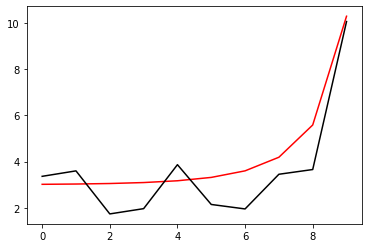

2200 0.0564127112054364
[3.36802325 3.47481346 1.85904349 2.02783228 3.69886476 2.30836155
 2.2489924  3.63812863 3.79970529 9.06341179]


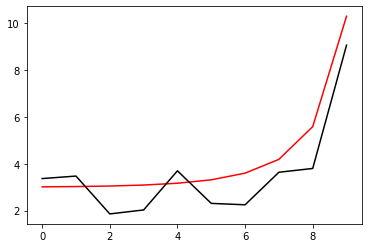

3300 0.03652005835042491
[3.47174292 3.42643444 2.13316309 2.23796255 3.61947121 2.70429449
 2.8729198  4.15664214 4.17609911 8.14391395]


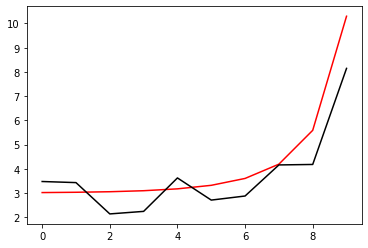

4400 0.030655079329690638
[3.3550347  3.22319662 2.32329022 2.39070973 3.46353398 3.04514679
 3.343652   4.61581809 4.60853305 7.31384317]


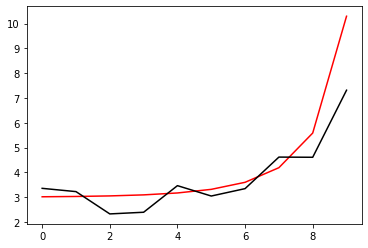

5500 0.012911492729208489
[3.22401537 3.02407484 2.37159346 2.37168827 3.14168732 3.00417401
 3.28299987 4.45227406 4.54467227 6.57512692]


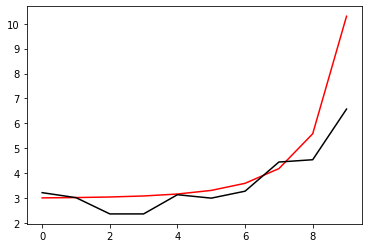

6600 0.011124712199911922
[3.25273153 3.05525438 2.53032814 2.53122892 3.19517539 3.24420191
 3.62456472 4.86113131 5.09063441 5.92588541]


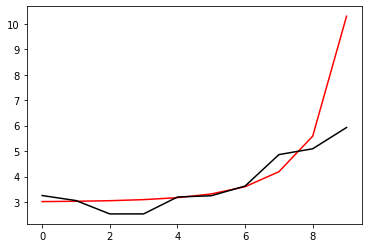

7700 0.030848927500883555
[3.19765237 2.99207239 2.55051626 2.52765653 3.06535844 3.20850348
 3.59760654 4.74756899 5.03532665 5.50505774]


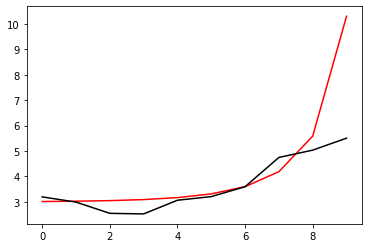

8800 0.03070192112353338
[3.19242002 2.99167243 2.61041075 2.58125566 3.04635763 3.27276465
 3.72436571 4.90463316 5.32149247 5.32274147]


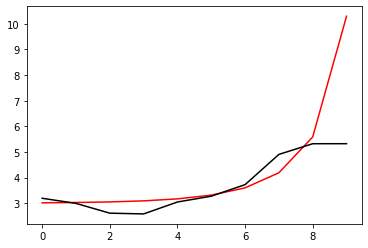

9900 0.07810734558167468
[3.02097848 2.82645559 2.49170458 2.45496251 2.85422138 3.13284016
 3.61849863 4.76752039 5.2881979  5.26377425]


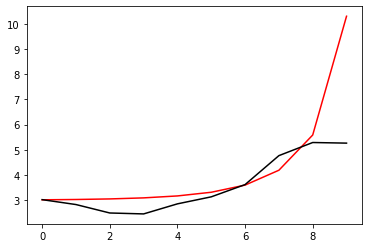

11000 0.14033256773099234
[3.34106995 3.17872456 2.89871656 2.88436168 3.27303335 3.61067065
 4.16237526 5.16653837 5.30029498 5.57771746]


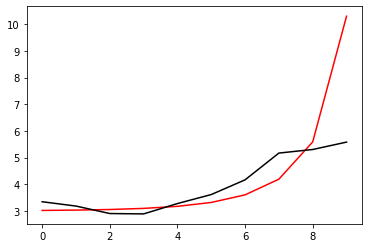

12100 0.01052661143693542
[3.27539729 3.10250455 2.81675982 2.78465348 3.14092357 3.45066818
 3.94199202 4.81752946 5.03365374 5.02004533]


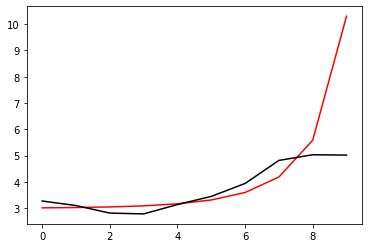

13200 0.02760713763002205
[3.12735017 2.96783288 2.70298506 2.67878125 3.02932942 3.35635651
 3.8679044  4.7759388  5.07940122 5.04311327]


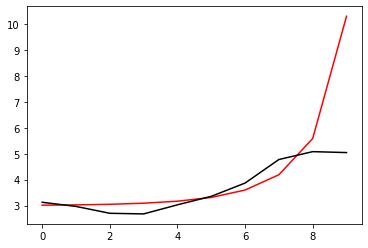

14300 0.020462789004026666
[3.16592375 3.00995295 2.76322368 2.74481661 3.09131033 3.46442871
 4.05681944 5.09290153 5.53650829 5.52343924]


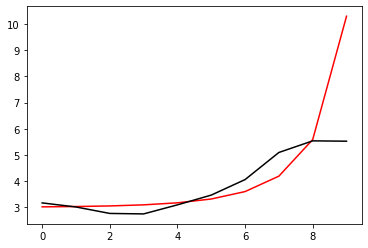

15400 0.017399690191797226
[3.09082835 2.98102299 2.78374848 2.80124055 3.16694855 3.5641956
 4.14175414 4.94917742 5.15494463 5.11591464]


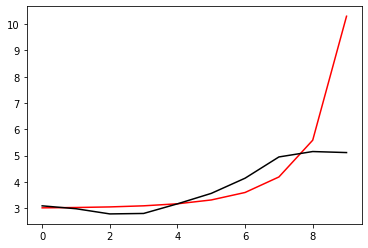

16500 0.010394149608842424
[3.08628052 2.98213109 2.79692329 2.82228543 3.19347723 3.62110095
 4.27170122 5.26785735 5.41259626 5.40098581]


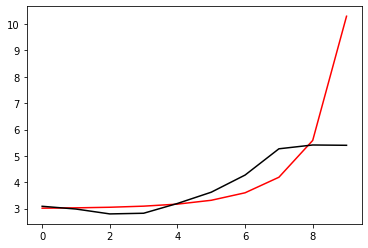

17600 0.01053544042929465
[2.96978448 2.88561087 2.72887581 2.77352722 3.15598594 3.62561787
 4.36039401 5.52477423 5.67677232 5.68286537]


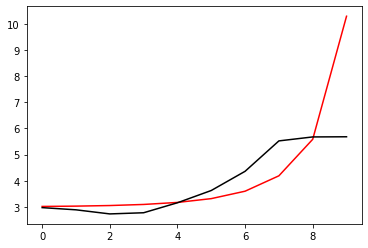

18700 0.030612632608562576
[3.17790757 3.06763969 2.89517985 2.91328092 3.25624899 3.71172726
 4.44082769 5.49723714 5.44372676 5.81776308]


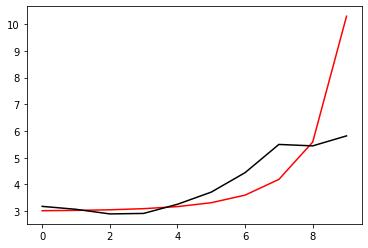

19800 0.0303028328149854
[3.00096208 2.89598656 2.73480932 2.76002368 3.10553683 3.5808897
 4.34163872 5.44896709 5.48788408 5.48487923]


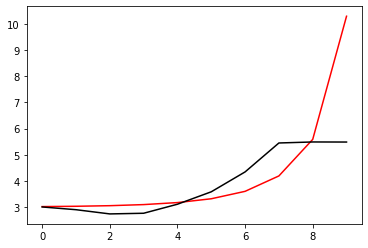

20900 0.0342514664828273
[2.93626097 2.83475612 2.6873542  2.72329854 3.07794351 3.59815552
 4.43501919 5.64963027 5.82542817 5.73998928]


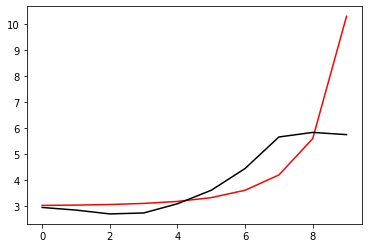

22000 0.0605353443185447
[2.9902892  2.90288705 2.782246   2.83921563 3.20898264 3.78395273
 4.69827349 5.98427153 6.22728237 6.23205718]


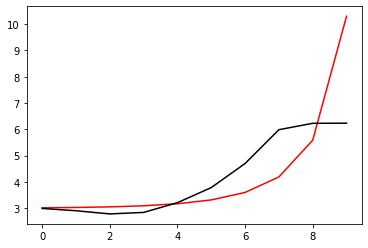

23100 0.01051905777448639
[2.97914333 2.85104141 2.70131031 2.72820015 3.06603074 3.63255627
 4.52557726 5.69134451 5.86492965 5.86914316]


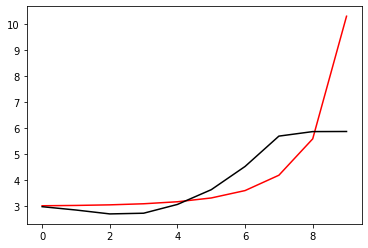

24200 0.019206854508604997
[3.02209916 2.88962642 2.73848836 2.76304395 3.09837958 3.67298569
 4.58153367 5.77173914 5.99007844 5.94603739]


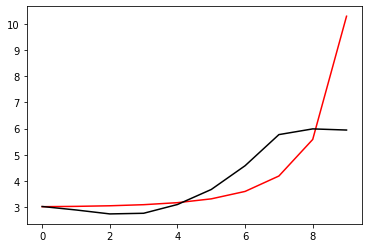

25300 0.010823083736191855
[3.0157352  2.89222248 2.75307635 2.78698236 3.13060949 3.7303706
 4.67759716 5.92177352 6.22341004 6.24075202]


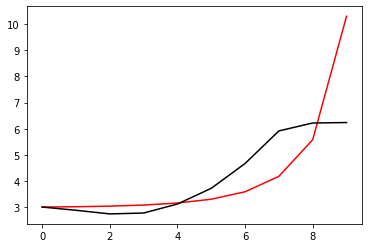

26400 0.008607564813048372
[3.04585468 2.95384754 2.85014288 2.91317919 3.28167076 3.92757764
 4.93594984 6.25263064 6.65034134 6.57164833]


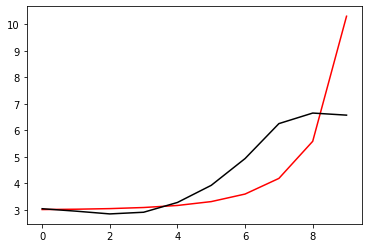

27500 0.104424616039056
[2.75994038 2.69566372 2.63252786 2.73348415 3.14114352 3.86630452
 4.99219992 6.4525394  7.01601357 6.96174832]


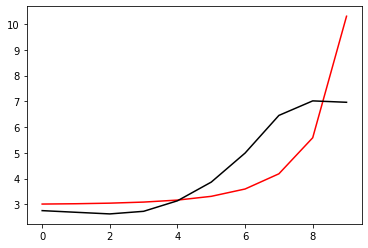

28600 0.0021492305237259266
[2.97447185 2.88783843 2.80041765 2.86933344 3.22844433 3.87174602
 4.8316553  6.00085092 6.31859722 6.28783619]


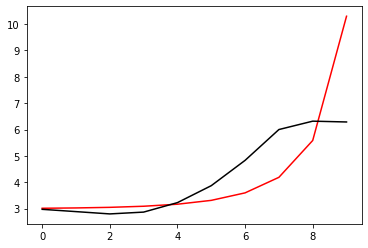

29700 0.010859692921116002
[2.98458641 2.90404698 2.82394483 2.89976578 3.26628614 3.92497134
 4.91298415 6.1264257  6.4945039  6.48507223]


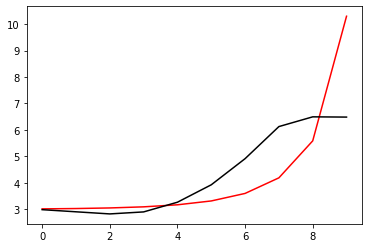

30800 0.01844097215537562
[2.98845296 2.92161819 2.85795238 2.95016848 3.33510498 4.02748578
 5.0735952  6.37224198 6.82545696 6.73820543]


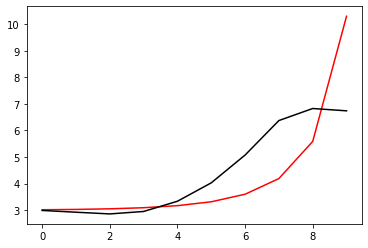

31900 0.05054919057510293
[2.87692559 2.7804851  2.69032649 2.7532921  3.10299848 3.75790167
 4.75344857 5.97118729 6.37282292 6.38575751]


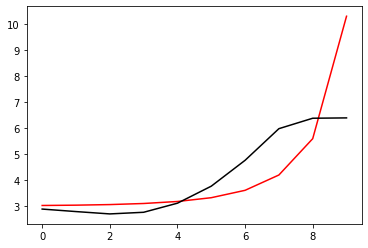

33000 0.060557205382781865
[3.00904567 2.90728017 2.81274383 2.87112595 3.21558048 3.86830196
 4.86436599 6.08596433 6.50261943 6.50446399]


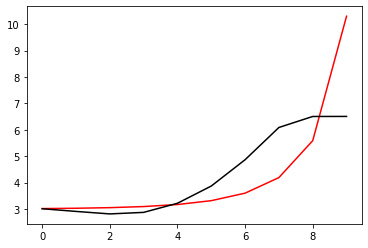

34100 0.010665535385089965
[3.02747008 2.94071412 2.86162388 2.93420227 3.29231636 3.96668389
 4.99553802 6.26466695 6.75191056 6.75326585]


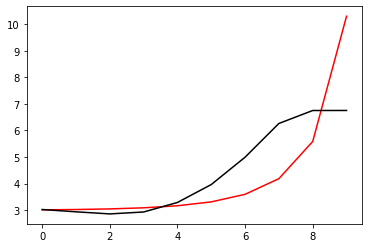

35200 0.018867645872730345
[2.98796876 2.85690256 2.73297128 2.75655692 3.05621898 3.6566418
 4.5735747  5.67340948 6.04129837 6.03448219]


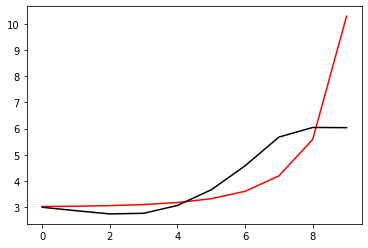

36300 0.012150043676439078
[3.06559095 2.93020672 2.80133786 2.81921903 3.11185154 3.70681465
 4.61983858 5.71843786 6.09560659 6.11548364]


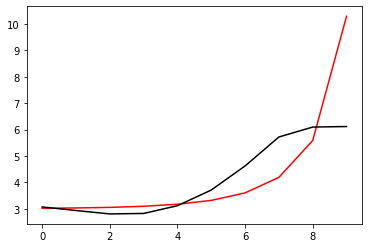

37400 0.004433302343523004
[3.01886392 2.89588702 2.78146378 2.81671956 3.13206029 3.76593776
 4.74469084 5.9442808  6.44905216 6.42617837]


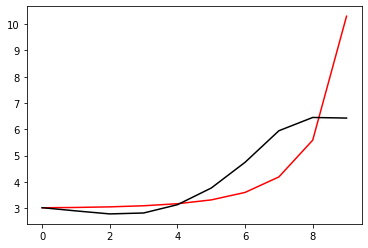

38500 0.0015762059068536172
[2.94800172 2.83751724 2.73850626 2.79259081 3.13345311 3.81509037
 4.87701983 6.19900274 6.84108863 6.82326183]


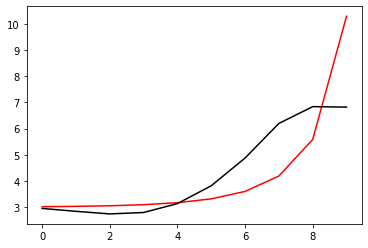

39600 0.0007872130180288548
[3.06083708 2.92852638 2.80664022 2.83404702 3.14200779 3.78810726
 4.80259567 6.05161479 6.651333   6.6392808 ]


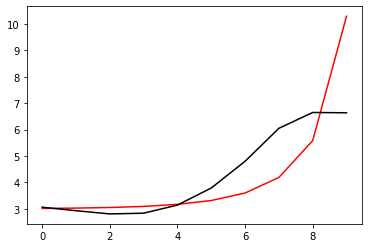

40700 0.034857021883504716
[2.99793905 2.84220955 2.69725079 2.7015314  2.98512645 3.60813082
 4.59467063 5.80242252 6.38362497 6.79473797]


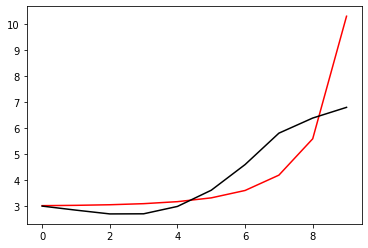

41800 0.026411037988534627
[3.12633472 2.97202775 2.82642099 2.82908102 3.11013322 3.73213443
 4.71999708 5.93258327 6.52660511 6.49742648]


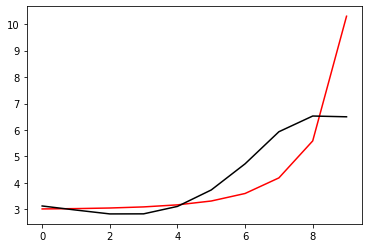

42900 0.010696651575657532
[3.06291224 2.93310529 2.81039428 2.83595339 3.14208275 3.79905615
 4.83825735 6.12254556 6.80634034 6.84345657]


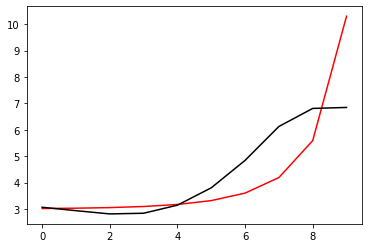

44000 0.05947151695106912
[3.06063772 2.95146435 2.84943379 2.89542562 3.22400705 3.91483489
 5.00583103 6.36213144 7.13422092 7.11600425]


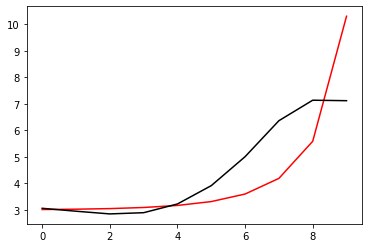

45100 0.010575654793414371
[3.07255625 2.94521316 2.82249089 2.84126828 3.13005046 3.75806533
 4.73100296 5.86730577 6.39133642 6.41980484]


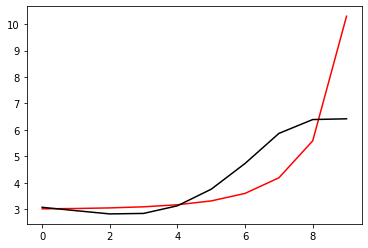

46200 0.019046866617013273
[3.06479524 2.94226245 2.82433034 2.84838784 3.14430664 3.78544396
 4.78563273 5.97144896 6.53281563 6.47516717]


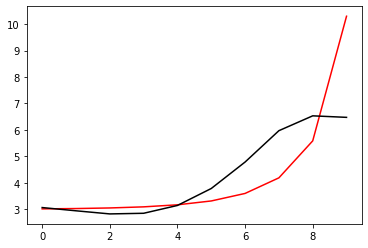

47300 0.011294662172106553
[3.04419484 2.92974792 2.81966916 2.85177794 3.15778706 3.81695214
 4.85428478 6.10710173 6.72161153 6.73247103]


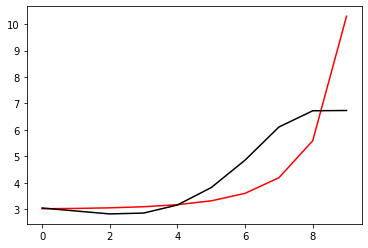

48400 0.0018473265151724223
[2.98702669 2.88565273 2.7884606  2.83309825 3.15372613 3.83811092
 4.92692521 6.27255341 6.96659079 6.92579871]


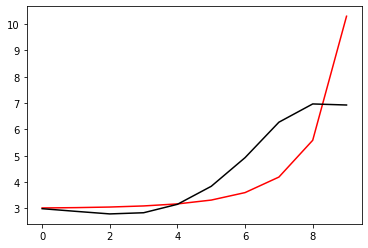

49500 0.048557227747592066
[2.90023658 2.79718613 2.70067105 2.74696763 3.07188461 3.77260143
 4.90957893 6.37068952 7.19993103 7.16716884]


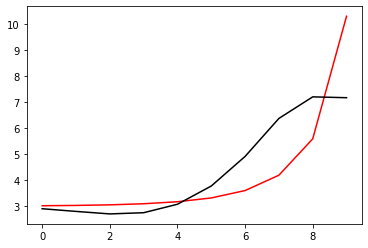

50600 0.010478441851573452
[3.01337832 2.86872809 2.73048897 2.7339893  3.01178548 3.65427088
 4.69984859 5.97146387 6.61159412 6.60909779]


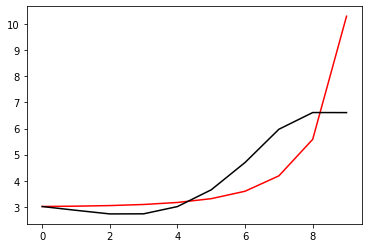

51700 0.010767790090347458
[3.07417074 2.94254316 2.81453208 2.82634549 3.11142279 3.76326054
 4.82319226 6.11904787 6.7985065  6.79845647]


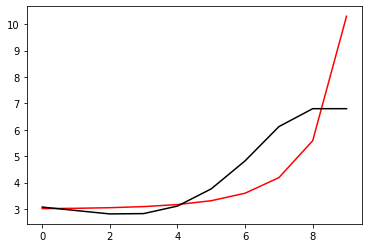

52800 0.026069360001797368
[3.14105014 2.9893948  2.83855552 2.82408887 3.07801176 3.69174594
 4.69853917 5.9233096  6.56219019 6.54166267]


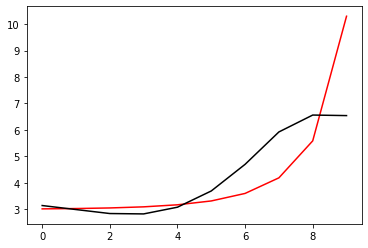

53900 0.010758545113614737
[3.12064541 2.98545721 2.85147467 2.85563059 3.13226942 3.77907983
 4.83671499 6.13439871 6.85797839 6.86901532]


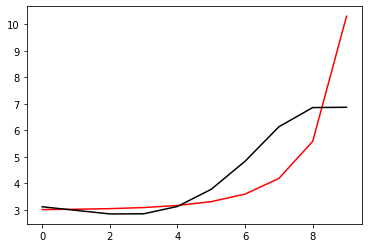

55000 0.059002212048940836
[3.08671948 2.97200386 2.85900645 2.88498129 3.18690604 3.87033978
 4.98524066 6.36714116 7.18944699 7.16156421]


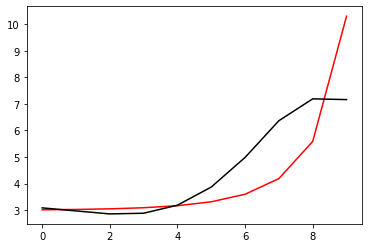

56100 0.01068411761465589
[3.17392209 3.00377632 2.83759989 2.81086179 3.05765531 3.67827571
 4.70505907 5.94830423 6.66712341 6.67042923]


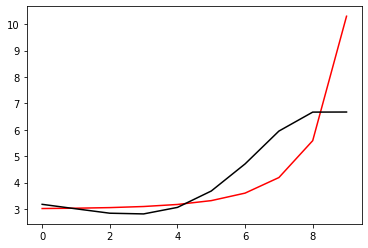

57200 0.017530771191488593
[3.11763445 2.95921832 2.80429362 2.79028922 3.05328365 3.69824999
 4.76411689 6.06812643 6.86604199 6.78414797]


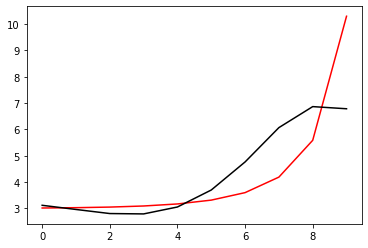

58300 0.01100066063436308
[3.06741211 2.92868631 2.79214167 2.79646876 3.07959203 3.75161473
 4.85857376 6.22571507 7.10446417 7.11351177]


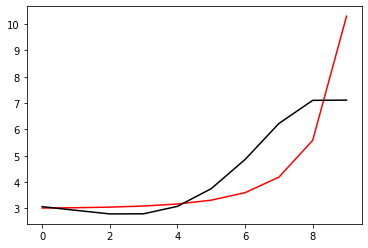

59400 0.00138695928406907
[3.00625715 2.88406378 2.7642358  2.78617727 3.09078497 3.79600208
 4.95891366 6.41554184 7.40430179 7.3812023 ]


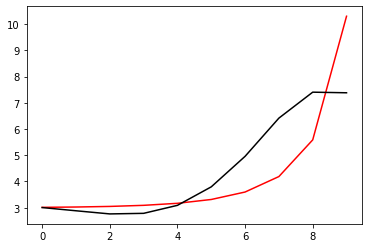

60500 0.009645291094655282
[3.09339782 2.93075405 2.76964028 2.74936441 3.0084278  3.65848019
 4.73795231 6.06022326 6.95882577 6.95176319]


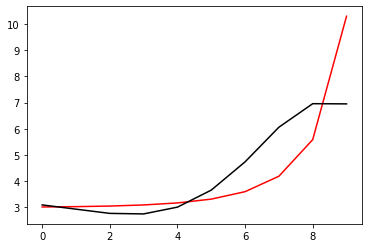

61600 0.010157488588698157
[3.01875547 2.86862632 2.71967822 2.71307743 2.98986622 3.667496
 4.79328384 6.18930307 7.17803795 7.18005085]


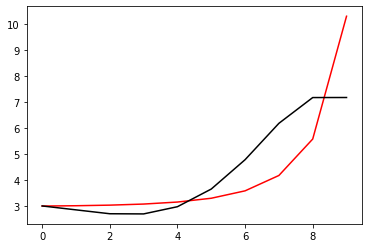

62700 0.5939691329202772
[3.31144132 3.16159007 3.01024163 2.99847405 3.26670804 3.92761015
 5.00139862 6.24603615 7.13226159 7.3254397 ]


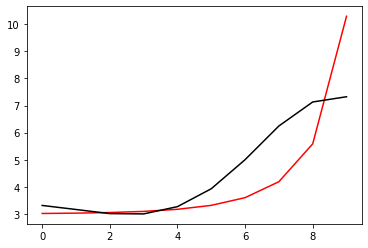

63800 0.02465354979227702
[3.13729953 2.9823249  2.82391824 2.80326531 3.06013215 3.70700419
 4.76753981 6.02081991 6.96374229 6.92064198]


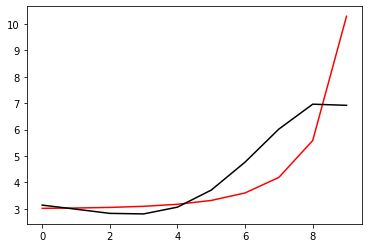

64900 0.010767347027523808
[3.11091569 2.97494293 2.83591761 2.83614272 3.1180077  3.79996147
 4.9150436  6.24923738 7.27418996 7.29456195]


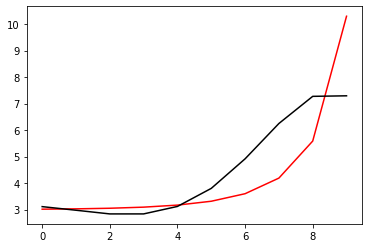

66000 0.060698567113493626
[3.12935323 2.94465707 2.75909925 2.71411665 2.95040579 3.58246718
 4.63276768 5.87276823 6.81534702 6.82365708]


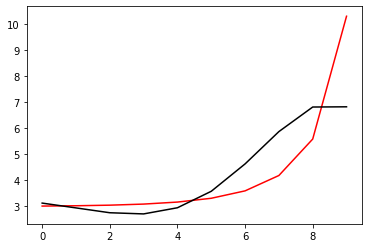

67100 0.010718852588277252
[3.15285847 2.97793726 2.79991957 2.76178651 3.0052064  3.64669211
 4.71237149 5.97981599 6.95942731 6.95974689]


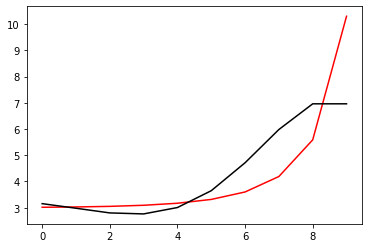

68200 0.013815754589224419
[3.09365766 2.93872058 2.7796246  2.76140658 3.0285395  3.70301097
 4.81988402 6.16727492 7.24396913 7.19509271]


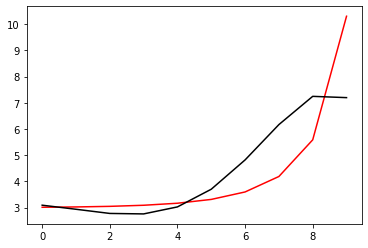

69300 0.010883851746435372
[3.08204474 2.89193095 2.69785487 2.64349509 2.86989899 3.49208957
 4.5328568  5.76922741 6.7101515  6.7100746 ]


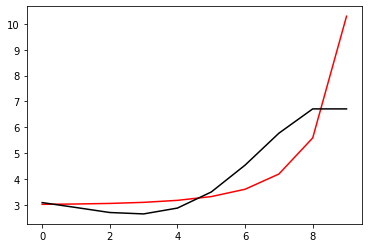

70400 0.006789918035725429
[3.14181799 2.94842921 2.7510384  2.69460059 2.92097752 3.54684523
 4.59834498 5.85770003 6.82813632 6.79914939]


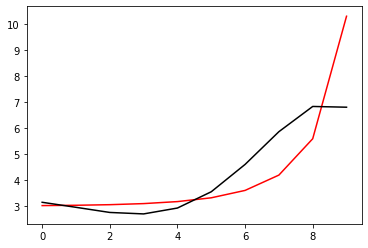

71500 0.008822325543147528
[3.11828272 2.93751028 2.75086686 2.70566609 2.94620863 3.59401493
 4.68446998 6.01202111 7.0651576  7.06974325]


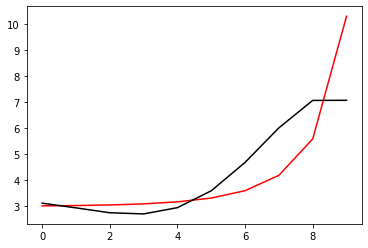

72600 0.010457698472566723
[3.04235117 2.87880431 2.70739143 2.67745922 2.93637378 3.61191948
 4.75198854 6.16835358 7.32781128 7.33466408]


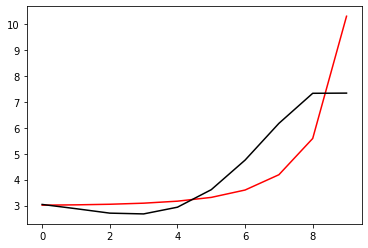

73700 0.05723568872419685
[3.02700292 2.8485564  2.66048215 2.61276995 2.85446363 3.51448826
 4.63739381 6.02299985 7.167905   7.55826498]


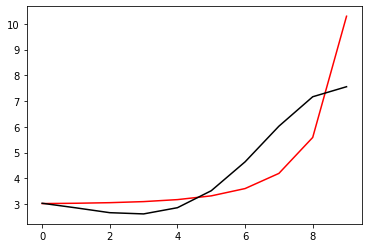

74800 0.02849288726414873
[3.13887563 2.9577389  2.7653554  2.712959   2.95028663 3.60735628
 4.73104908 6.12641264 7.28783032 7.26475887]


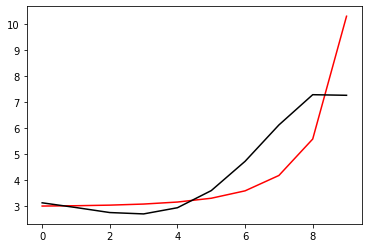

75900 0.010862602742095356
[3.10346581 2.9391382  2.76187754 2.72458466 2.97990082 3.66313875
 4.82998936 6.29608456 7.54294736 7.55451713]


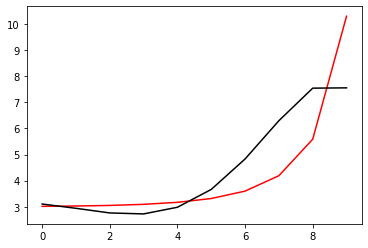

77000 0.11008440757570001
[3.02321338 2.83090972 2.62234827 2.54855002 2.75860213 3.37793592
 4.43800635 5.73310614 6.87119565 6.92209813]


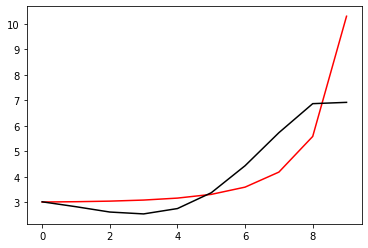

78100 0.010750842535282079
[3.19527051 2.99828584 2.78349464 2.70247184 2.90397546 3.51271787
 4.55962025 5.84072921 6.96238364 6.9633414 ]


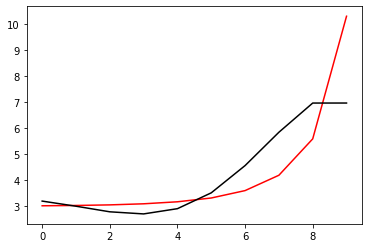

79200 0.017536197166078623
[3.16313166 2.98213362 2.78261412 2.718092   2.94027091 3.57950647
 4.67693407 6.04155534 7.26814768 7.1750247 ]


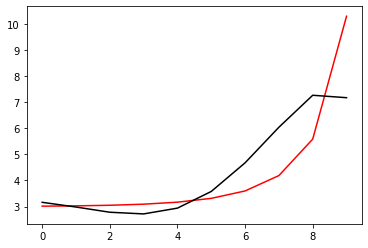

80300 0.010997483882161846
[3.10752216 2.94685009 2.76660219 2.72169185 2.96775677 3.64261298
 4.80069418 6.26587996 7.60868734 7.65744111]


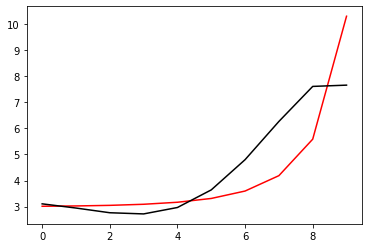

81400 0.011717676826875637
[3.10279419 2.90401025 2.68587899 2.60300495 2.80939516 3.43782641
 4.52988099 5.89391928 7.14927527 7.14168182]


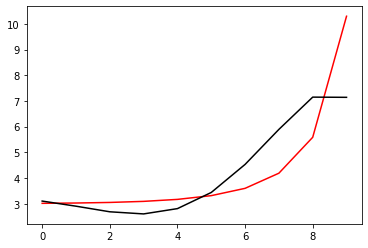

82500 0.0010498130200171153
[3.09568757 2.90562954 2.69382433 2.61612234 2.82778099 3.46389738
 4.57085613 5.96530356 7.26296489 7.260967  ]


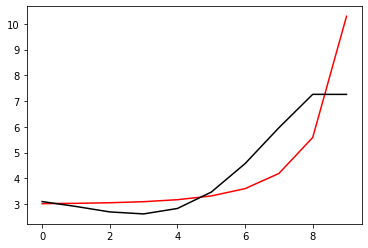

83600 0.0008341148460555587
[3.16334274 2.99419814 2.79875015 2.73351668 2.95570113 3.60376083
 4.73077335 6.16480245 7.51474411 7.51569549]


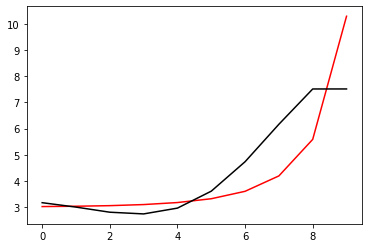

84700 0.029326888230557704
[3.05605004 2.90580998 2.72513478 2.66653401 2.88118975 3.4938957
 4.51595996 5.54495448 6.59353008 6.59926944]


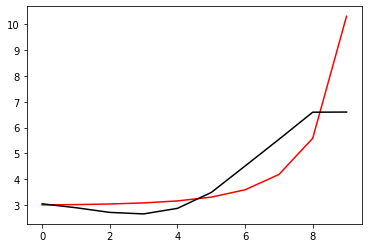

85800 0.03010616853151742
[3.05734038 2.90927221 2.73076425 2.67393117 2.89043986 3.50607388
 4.53423689 5.57999198 6.64634019 6.64167538]


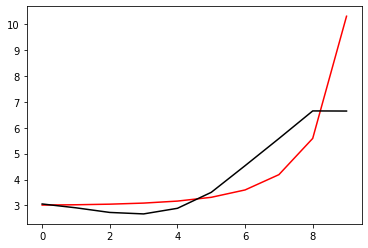

86900 0.010808376792078063
[3.151723   3.00130968 2.82195913 2.76550506 2.98470637 3.60749021
 4.6509016  5.7289888  6.81874514 6.81929041]


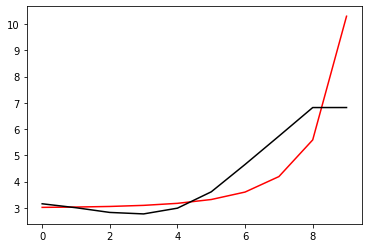

88000 0.06053975245628059
[3.13574067 3.00049762 2.83706474 2.79666243 3.03469866 3.68473611
 4.77415239 5.93649983 7.10347626 7.09709717]


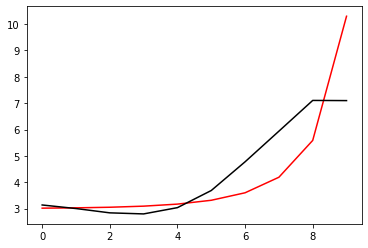

89100 0.011823039622122673
[2.95679868 2.84806162 2.70874964 2.68584911 2.93201249 3.57465166
 4.61562864 5.49174096 6.44785298 6.913125  ]


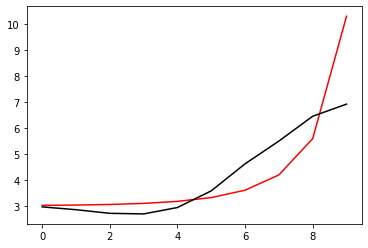

90200 0.018705624396750987
[3.01917757 2.90139354 2.75468987 2.72499145 2.96440707 3.59945676
 4.63038578 5.49820442 6.44074648 6.42941322]


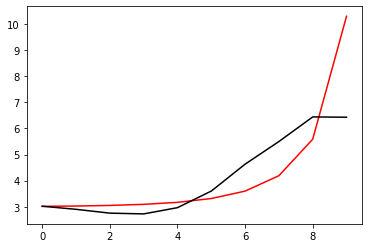

91300 0.012421243638031957
[3.09095601 2.96605372 2.81458879 2.78187762 3.02083651 3.65979295
 4.70210879 5.60022232 6.56605783 6.5433259 ]


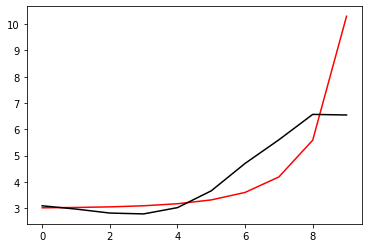

92400 0.005131860905246683
[3.05612033 2.94138281 2.8018174  2.78213662 3.03752097 3.70163849
 4.78780799 5.77176331 6.81436788 6.79530567]


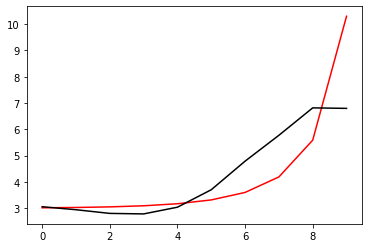

93500 0.001171227364477224
[2.97611543 2.87583444 2.75374098 2.75233025 3.02918885 3.72441193
 4.86376193 5.95717667 7.09457266 7.10277036]


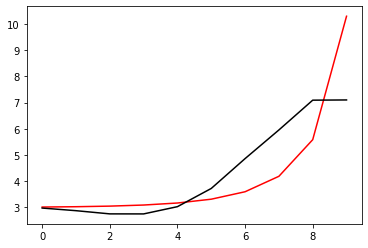

94600 0.0007175890662122059
[3.02308114 2.94224444 2.84309419 2.86335033 3.16243488 3.88594476
 5.06860952 6.25451311 7.44691582 7.44366087]


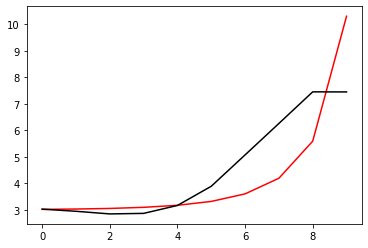

95700 0.012261130271532932
[2.98801216 2.91590317 2.82351495 2.84242279 3.12644625 3.81061041
 4.90662076 5.93545349 6.88187401 6.87133621]


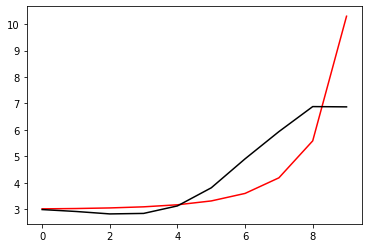

96800 0.024422523302524576
[2.99770414 2.9302777  2.84384728 2.86922956 3.16120858 3.85747471
 4.97506853 6.04501236 7.0156517  6.98270044]


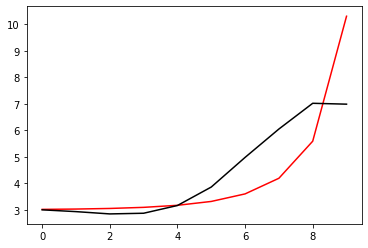

97900 0.010665161599563324
[2.99675418 2.93612198 2.85850453 2.89309511 3.19579798 3.90785885
 5.05378546 6.18182698 7.19123317 7.20563257]


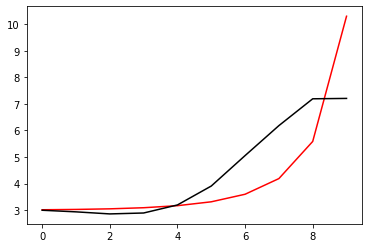

99000 0.05628599327218538
[2.99812218 2.95092262 2.89070107 2.94379982 3.26810998 4.01121645
 5.2100444  6.43523461 7.50396247 7.4702353 ]


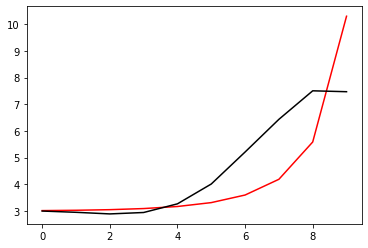

100100 0.010653488906506992
[3.02232939 2.93106909 2.83117426 2.84460517 3.12569684 3.81693376
 4.94739466 6.09743311 7.10584987 7.10938672]


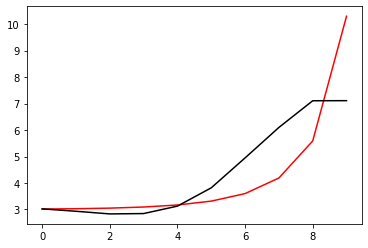

101200 0.010087107469764581
[2.97599794 2.89468232 2.80801619 2.83772222 3.13935005 3.86003754
 5.03758326 6.27281138 7.37241083 7.3160608 ]


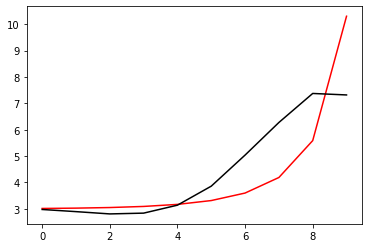

102300 0.010738471368278586
[3.02385176 2.89611902 2.761309   2.73827401 2.9760241  3.60802138
 4.64320832 5.65882169 6.56668239 6.58122319]


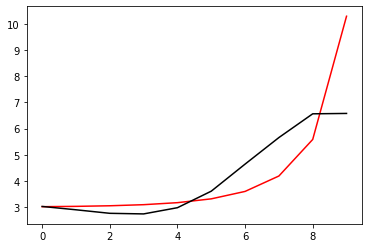

103400 0.010492594127534609
[3.01514298 2.89392191 2.76533717 2.74892794 2.99389537 3.63514565
 4.68497566 5.73076915 6.67442794 6.65563527]


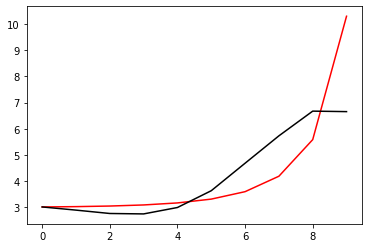

104500 0.0011846301424284216
[2.9871491  2.87531894 2.75637468 2.75076151 3.00827197 3.66661796
 4.7443287  5.84583412 6.85526428 6.85248788]


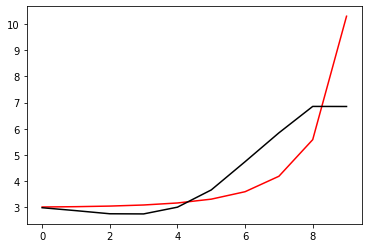

105600 0.5856005007681305
[3.25289144 3.13979348 3.01995683 3.01368469 3.269542   3.92314623
 4.9859949  6.06331273 7.03972177 7.16792185]


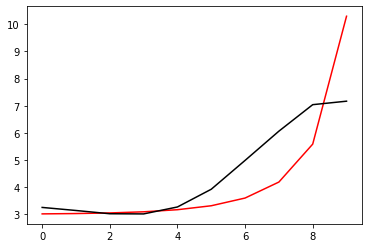

106700 0.022592325898831263
[3.05244173 2.91152301 2.76474293 2.73306347 2.96388021 3.59193263
 4.63079023 5.70053968 6.69032938 6.66849564]


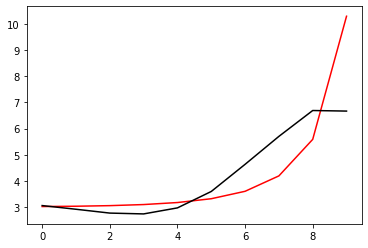

107800 0.02953380631833615
[3.05099917 2.92008195 2.78206036 2.75950941 3.00030481 3.64144454
 4.70208698 5.81743208 6.86003204 6.85850335]


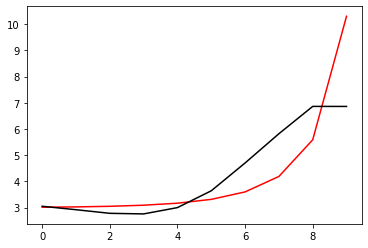

108900 0.06935121372328835
[2.8548333  2.76266242 2.6611982  2.67307551 2.94580731 3.61863509
 4.71825353 5.90229055 7.01720455 7.17472921]


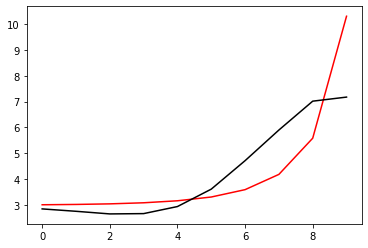

110000 0.06047681214511021
[2.95732146 2.88773018 2.80857424 2.83821866 3.12140289 3.79548041
 4.88964831 6.08465471 7.20267831 7.20441628]


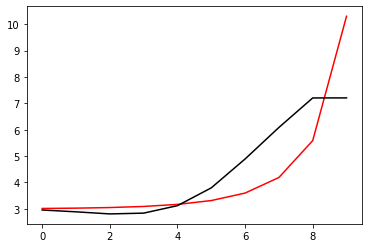

111100 0.010553242164218237
[3.05514481 2.99270433 2.91885731 2.94706777 3.21644582 3.85236418
 4.85044597 5.77365454 6.56430611 6.57270259]


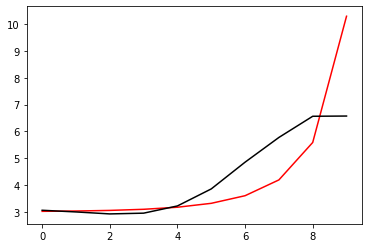

112200 0.014503234103706913
[2.99770239 2.94132497 2.87545377 2.91262521 3.193161   3.84764876
 4.89476392 5.99869149 6.81025811 6.74000917]


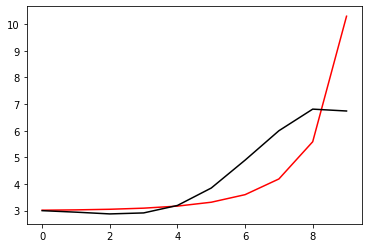

113300 0.010664616171032353
[2.92994691 2.88167745 2.82731903 2.87757538 3.17437933 3.85600376
 4.97373568 6.29605107 7.13824665 7.14856761]


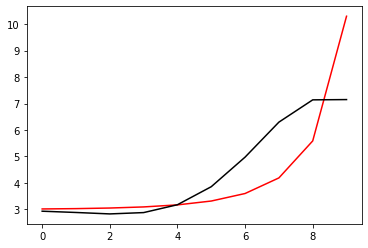

114400 0.0031820950393187056
[2.9911735  2.91377648 2.83174764 2.8541725  3.12086541 3.76675394
 4.8375126  6.05127353 6.79919602 6.75116437]


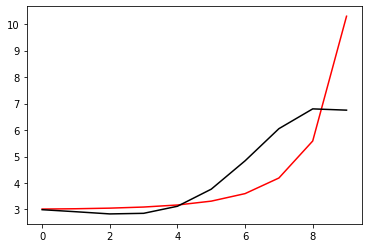

115500 0.0013903490245670462
[2.92712534 2.85967712 2.79185378 2.83227183 3.1221356  3.80237726
 4.93210936 6.24738402 7.09357923 7.07792439]


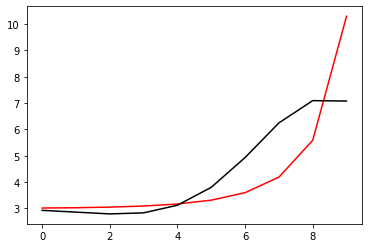

116600 0.0007484604982609037
[2.97381428 2.90110557 2.83174065 2.87241739 3.16296775 3.84469872
 4.98013766 6.31946438 7.19341512 7.19628779]


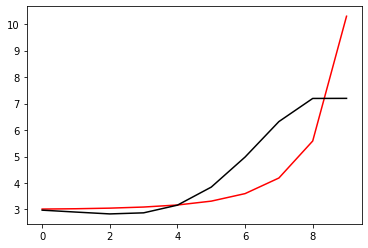

117700 0.11103417493121588
[2.86564165 2.76213966 2.66526189 2.68017242 2.94374273 3.59333004
 4.68418713 5.96091763 6.77884153 7.22073711]


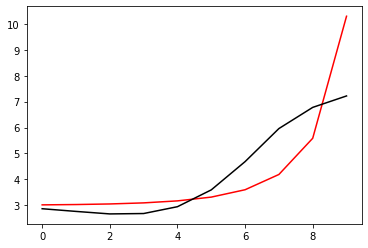

118800 0.026837958078123617
[3.0550682  2.94177802 2.83474815 2.83991433 3.0931314  3.73066612
 4.80722466 6.07117942 6.87931638 6.8491277 ]


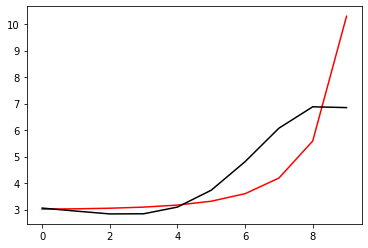

119900 0.010664824518423682
[3.05704224 2.9579636  2.86408135 2.88317585 3.15183825 3.80893008
 4.91463186 6.22793412 7.10261281 7.1097715 ]


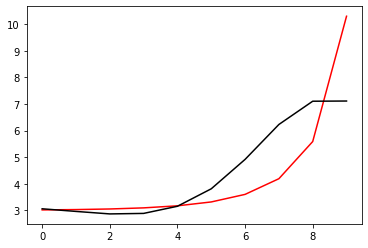

121000 0.06057941629188041
[3.0636912  2.93646086 2.812601   2.80013766 3.03287408 3.64418756
 4.68504846 5.91684649 6.74303626 6.73650623]


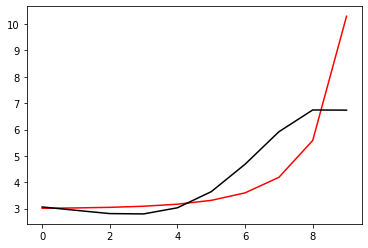

122100 0.010623499095903818
[3.06193752 2.94707117 2.83482621 2.83521413 3.08283876 3.71365269
 4.78423387 6.06535747 6.95213104 6.95180116]


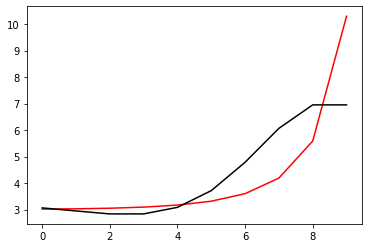

123200 0.01230630217555699
[2.94526599 2.85458574 2.76848156 2.79872864 3.08193886 3.75933141
 4.89738276 6.27833587 7.27464836 7.21963895]


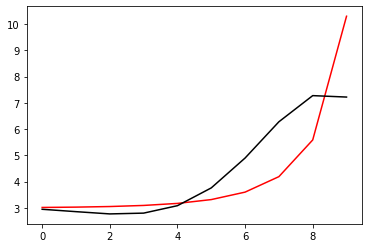

124300 0.010884440352441396
[2.9963712  2.91362993 2.83309174 2.86376727 3.13626257 3.77719143
 4.80381247 5.76531611 6.59702764 7.04319579]


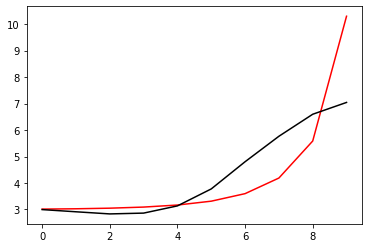

125400 0.003376929313321158
[2.97396968 2.89548525 2.81927144 2.85453377 3.1326177  3.78209305
 4.82537193 5.82390955 6.68255266 6.65527795]


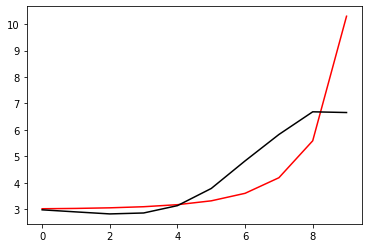

126500 0.009827774840955277
[2.97688765 2.90579221 2.83797769 2.88320774 3.17488247 3.84647085
 4.9309901  6.00370421 6.9005154  6.89736485]


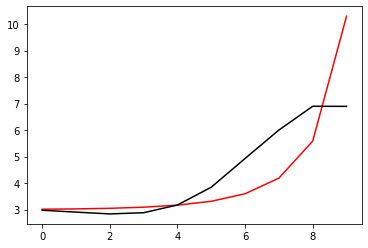

127600 0.0006951551730110196
[2.95583974 2.89522882 2.83968044 2.8988919  3.20852791 3.90786469
 5.04306188 6.21113174 7.16255381 7.11628578]


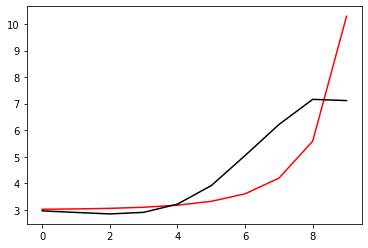

128700 0.010716879569588486
[2.96093579 2.90150615 2.85128846 2.91837763 3.23956799 3.95827321
 5.13162681 6.39022033 7.4054455  7.40352196]


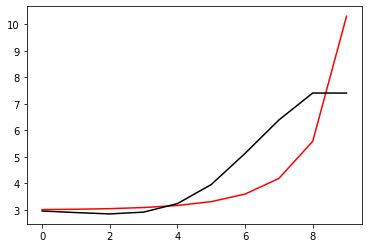

129800 0.019130429210598914
[3.00328744 2.95538524 2.91343449 2.98250292 3.29477145 3.98249379
 5.06797446 6.09434842 6.8021646  6.79317348]


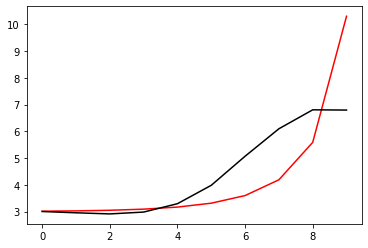

130900 0.010629754851428563
[2.96931197 2.92681774 2.89087579 2.96610409 3.28548033 3.98400031
 5.09447242 6.19395515 6.92548222 6.9143801 ]


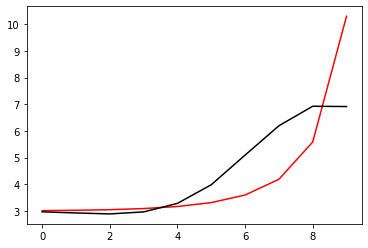

132000 0.058979029442016453
[2.95161361 2.91738452 2.891671   2.97850794 3.31300658 4.03681215
 5.20443248 6.43391405 7.17969406 7.16752921]


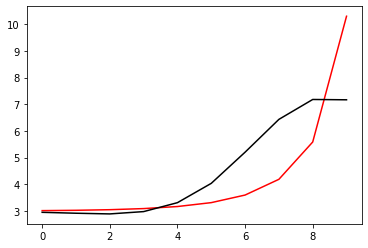

133100 0.02689117741650555
[2.85192629 2.78214182 2.72118688 2.77011281 3.05976008 3.72321538
 4.79878845 5.87293785 6.45715363 6.46916981]


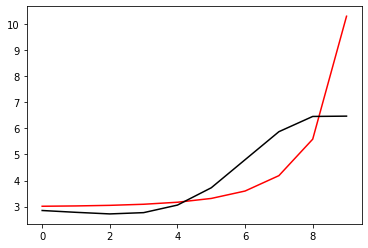

134200 0.01576702022696891
[3.00293929 2.92880816 2.86406919 2.90980839 3.19636594 3.85626935
 4.92746646 6.00315785 6.5887543  6.52313225]


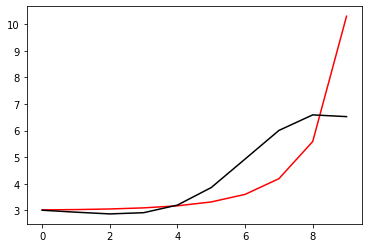

135300 0.01074600349155634
[2.96525855 2.89902795 2.84378032 2.90116264 3.20250247 3.8831354
 4.98658181 6.12185818 6.77902026 6.79594431]


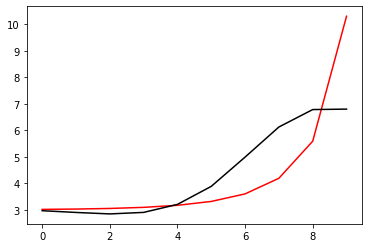

136400 0.001138718240121466
[2.90839558 2.85684681 2.81947146 2.89771703 3.22397973 3.93723066
 5.08864554 6.30964059 7.06296609 7.04679038]


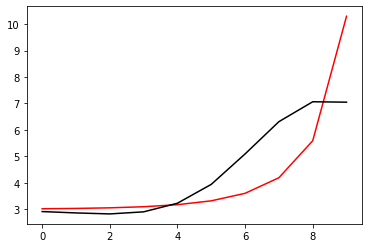

137500 0.0066686465060373365
[2.97811329 2.88503098 2.80666165 2.84358036 3.12441677 3.78023549
 4.84700672 5.95157511 6.60390062 6.5891346 ]


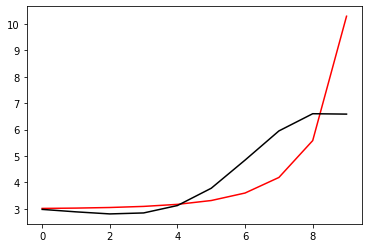

138600 0.0006678132815084506
[2.98433518 2.90659884 2.84363499 2.89749264 3.19776785 3.87806001
 4.97947472 6.1423941  6.86419072 6.81614875]


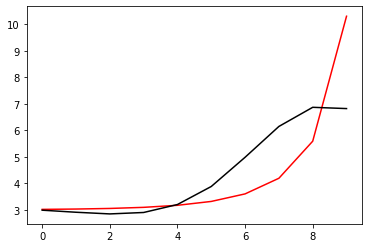

139700 0.010942546494975253
[2.95687309 2.88759422 2.83432981 2.89932631 3.21222133 3.90806535
 5.03325831 6.24934222 7.03978311 7.13393203]


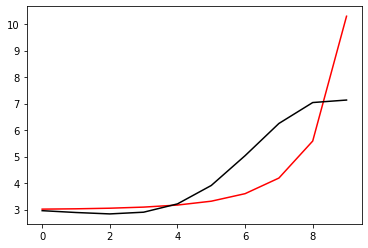

140800 0.029170921623014476
[2.96119275 2.8665229  2.78827377 2.82628507 3.10530221 3.75136972
 4.79710409 5.90363424 6.5675646  6.58808599]


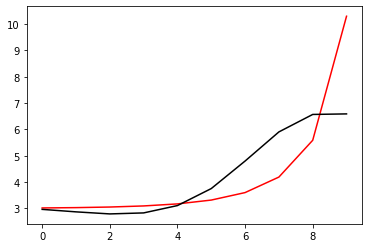

141900 0.010623715172385924
[3.01787972 2.92505573 2.84903653 2.89071156 3.17544437 3.83068221
 4.89178595 6.02517678 6.7154403  6.71325502]


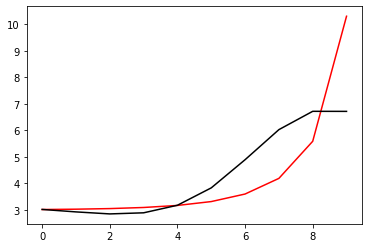

143000 0.060317058178471473
[3.01555618 2.93229404 2.86536608 2.9170825  3.21386835 3.88565607
 4.97326666 6.15453349 6.89753302 6.89628345]


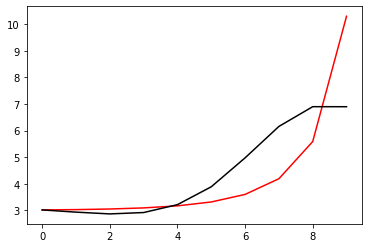

144100 0.010713017543211429
[3.00294544 2.93388212 2.88192991 2.95093608 3.26929166 3.97137587
 5.10724935 6.37084255 7.19817858 7.23064939]


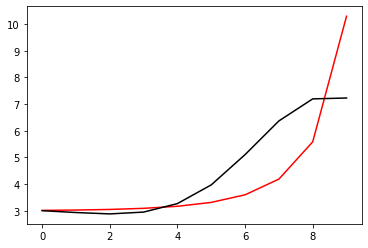

145200 0.011920444158677303
[2.90715248 2.82840679 2.77048002 2.83748624 3.15823811 3.86950409
 5.03043619 6.36177892 7.27472881 7.2872443 ]


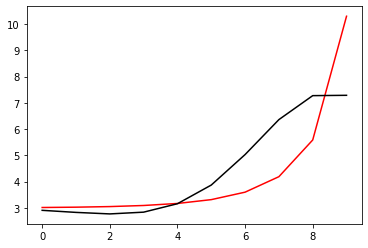

146300 0.01069676280301643
[3.00696736 2.87528906 2.76274856 2.77238494 3.02750337 3.65434036
 4.69675414 5.86997389 6.61021435 6.59858883]


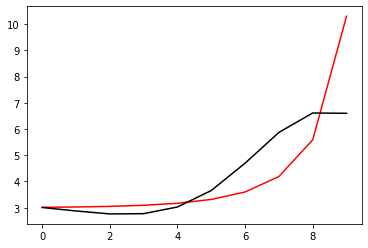

147400 0.0036363285540602004
[3.02967691 2.91008346 2.80850278 2.8304488  3.1004431  3.74731793
 4.82054914 6.04690883 6.85239806 6.79231553]


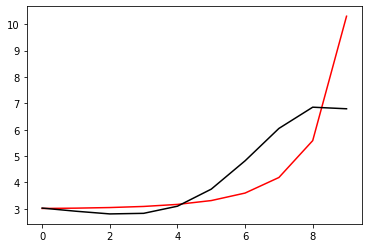

148500 0.019641326263947958
[2.93046272 2.82057749 2.72965785 2.76658111 3.0585853  3.74018722
 4.87337503 6.20714187 7.1454331  7.11976412]


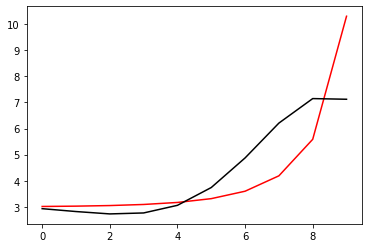

149600 0.010568246348392481
[3.03250547 2.8793484  2.73995584 2.72208824 2.94680296 3.53442913
 4.51819179 5.61353616 6.32725085 6.32180411]


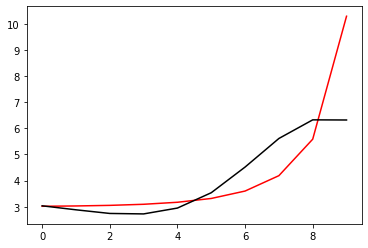

150700 0.010743358730757506
[3.11971091 2.97331895 2.83867605 2.82581285 3.05633464 3.65149171
 4.64740832 5.76813614 6.51256786 6.47491288]


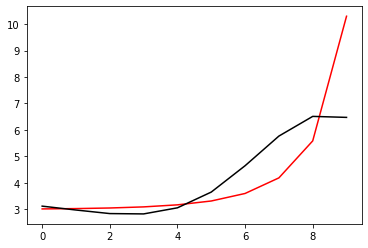

151800 0.028462493499249994
[3.05956407 2.92460166 2.80186534 2.80577389 3.06216683 3.70039484
 4.77284336 6.02629785 6.9256469  6.91656516]


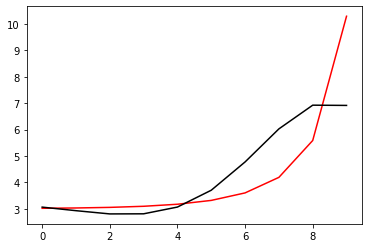

152900 0.011077123950992617
[3.11766437 2.94818673 2.78959644 2.75868139 2.98081932 3.58189609
 4.60359226 5.77115007 6.59705373 6.61210528]


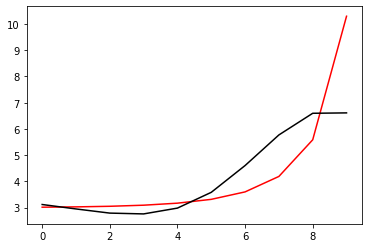

154000 0.06055892476770902
[3.14107278 2.98429973 2.83565624 2.8145832  3.0475611  3.66203793
 4.70325678 5.90463189 6.77251563 6.77442748]


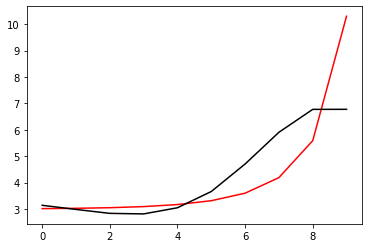

155100 0.010686552347425458
[3.11769235 2.98226427 2.85252451 2.8513902  3.10810574 3.75413523
 4.84230034 6.11865695 7.07319403 7.07340561]


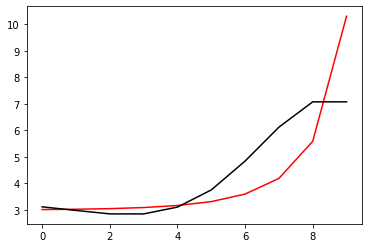

156200 0.024602814690699717
[3.1637765  2.97713775 2.79830768 2.75143273 2.96448566 3.5638983
 4.59181923 5.78789841 6.67309481 6.6291798 ]


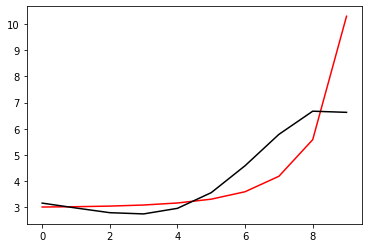

157300 0.011855332417397878
[3.12809666 2.95441185 2.78683214 2.75247014 2.98131742 3.60289763
 4.66500715 5.91593912 6.8694601  6.84751105]


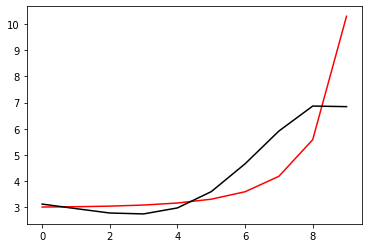

158400 0.0032109915983937008
[3.06958879 2.91526144 2.76473402 2.74847005 2.99924967 3.65064676
 4.75815426 6.08196489 7.12171067 7.0813956 ]


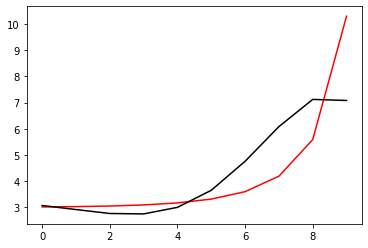

159500 0.0617381876640533
[2.9395225  2.80099221 2.66585846 2.66866134 2.94764925 3.6444823
 4.82911429 6.27842213 7.45475769 7.42422172]


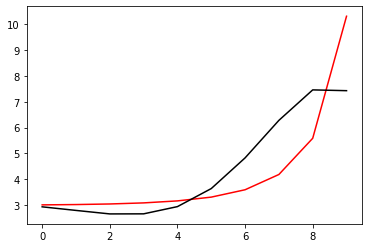

160600 0.002751557410863307
[3.12614235 2.94975767 2.77374192 2.73238189 2.95994063 3.58725746
 4.66086782 5.93929903 6.96925429 6.94567854]


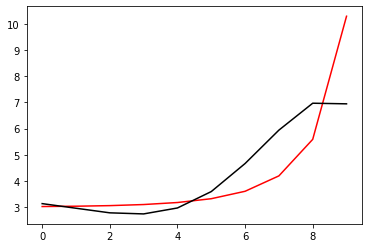

161700 0.010819799582733453
[3.12039931 2.96118252 2.79971919 2.77292984 3.01758212 3.66784642
 4.77646541 6.11181919 7.21067233 7.20026462]


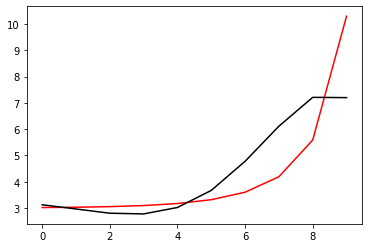

162800 0.02998269083326907
[3.07122806 2.90182029 2.72502494 2.6772814  2.8931833  3.49938464
 4.53358907 5.75926407 6.79760743 6.92970862]


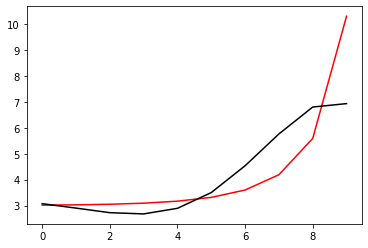

163900 0.009435550036184327
[3.07062665 2.9084558  2.73789889 2.69646264 2.92019466 3.5380634
 4.59350544 5.86046625 6.94554148 6.93546454]


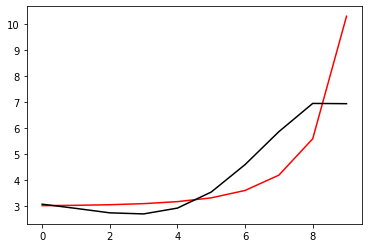

165000 0.06067855474727094
[3.08626069 2.93879181 2.78198102 2.75431616 2.99431939 3.63493407
 4.72865311 6.06405011 7.22153755 7.21875639]


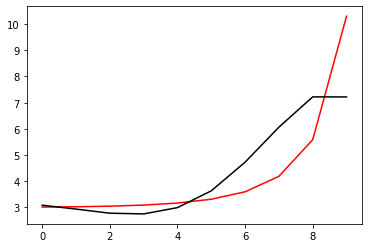

166100 0.010708862469892999
[3.16888741 2.97888807 2.78102778 2.71418492 2.91683709 3.51874556
 4.55979068 5.79602206 6.8513364  6.85195234]


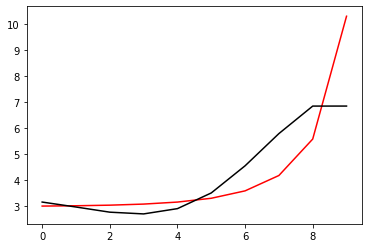

167200 0.019420149610746618
[3.16512005 2.98805339 2.80170604 2.7470567  2.96470567 3.58763393
 4.66151469 5.95103887 7.07151129 6.98879595]


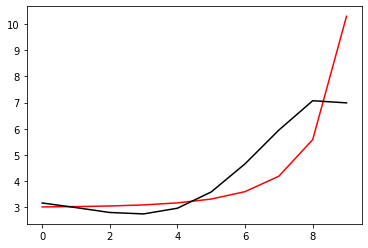

168300 0.010969575479115031
[3.0953024  2.9377452  2.76951857 2.73347983 2.97320368 3.62625555
 4.74695384 6.11273623 7.32258201 7.34251899]


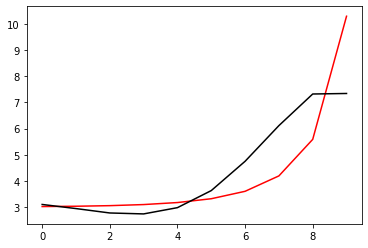

169400 0.0056658162643723866
[3.1338786  2.95487971 2.76333398 2.70281356 2.91663437 3.53917931
 4.61641633 5.91997477 7.0896371  7.06337234]


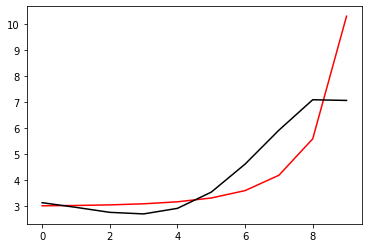

170500 0.0016841713829228561
[3.03896529 2.87261189 2.6946547  2.65077202 2.88818243 3.54814954
 4.68931103 6.09584919 7.37163829 7.3509793 ]


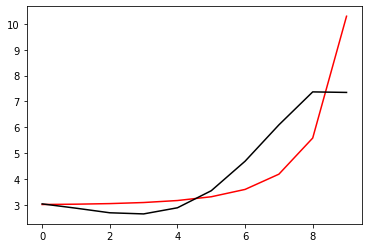

171600 0.6036660415124071
[3.30625755 3.14688823 2.97524024 2.93775801 3.1841109  3.85593241
 5.00061265 6.36939201 7.59908858 7.75323849]


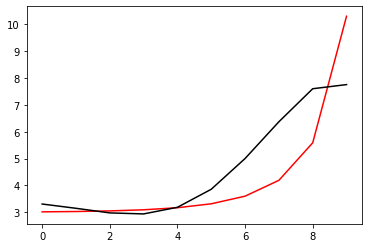

172700 0.010990028807232124
[3.16441102 2.97853636 2.77980576 2.71541252 2.93438994 3.57691421
 4.6916569  6.04481293 7.2884387  7.26958055]


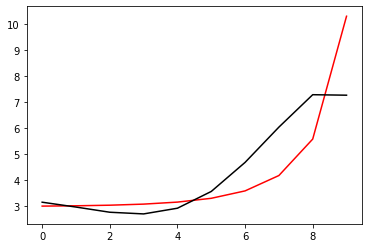

173800 0.02162500738882608
[3.15530959 2.99022426 2.81056279 2.76523051 3.00573636 3.67619952
 4.83263    6.25197081 7.57065648 7.5155452 ]


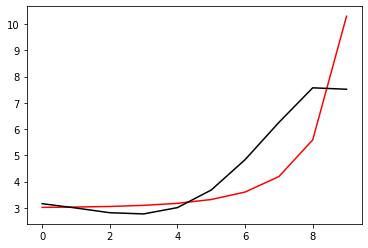

174900 0.00517922021526751
[3.0842683  2.8886519  2.67520284 2.59179734 2.78739516 3.3972473
 4.454133   5.70432916 6.91747231 7.02080898]


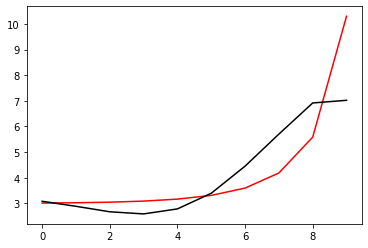

176000 0.06071752158745209
[3.14696217 2.95182814 2.73764815 2.65371024 2.85005164 3.46344908
 4.53016498 5.80351497 7.04511507 7.04505995]


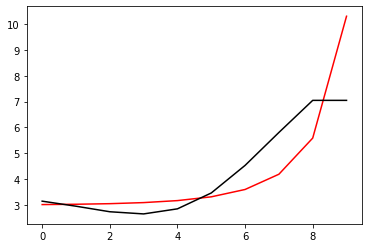

177100 0.010766553893378682
[3.1476888  2.96690086 2.76468401 2.69161082 2.89936182 3.52739861
 4.61819082 5.9369259  7.23165989 7.23221967]


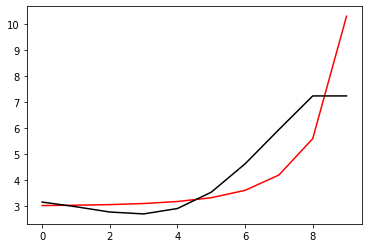

178200 0.017070466162101845
[3.12520754 2.9930161  2.83539722 2.8007031  3.03907237 3.68584882
 4.7724064  6.04360595 7.25323082 7.23887797]


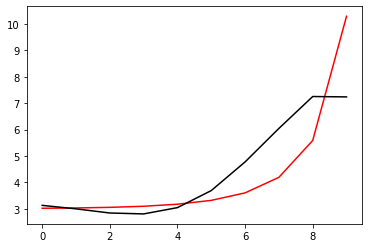

179300 0.01084316482728018
[3.05042593 2.93278406 2.7924437  2.77609672 3.03714318 3.71917787
 4.87744408 6.30019191 7.63188073 7.64114295]


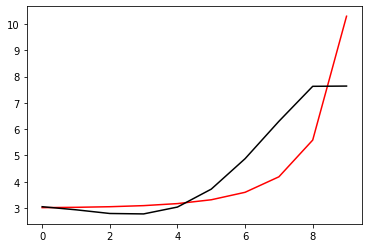

180400 0.0046844313537791615
[3.10747587 2.95224129 2.77601257 2.72329359 2.94493809 3.57901484
 4.67046614 5.98590079 7.16921921 7.14640226]


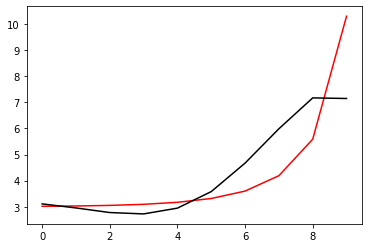

181500 0.00931085170402328
[3.08964252 2.94530359 2.7798983  2.73829979 2.97322628 3.62654153
 4.75117309 6.12697265 7.38431635 7.38266106]


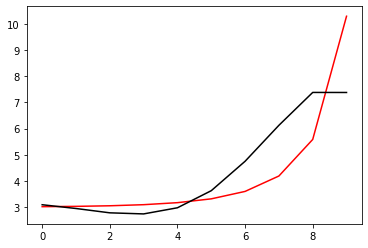

182600 0.0009781108485788607
[3.08530307 2.9451265  2.7853643  2.75029347 2.99462618 3.66449126
 4.82262156 6.26703038 7.60929524 7.63405408]


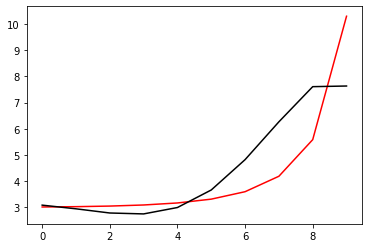

183700 0.052004521273328524
[3.01681549 2.85868395 2.68161028 2.62777838 2.85153741 3.49758388
 4.62381506 6.0176917  7.32152153 7.69467079]


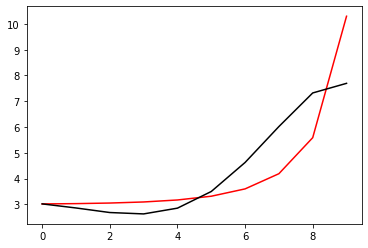

184800 0.024684186603899996
[3.1522013  2.99162725 2.8114495  2.75449168 2.97540144 3.61954171
 4.74679543 6.15044143 7.46721396 7.43081171]


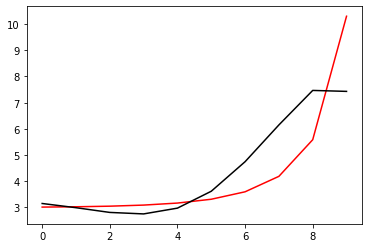

185900 0.010836949640445081
[3.08958032 2.94224946 2.77542463 2.73283433 2.97141345 3.64144068
 4.81227407 6.29128881 7.6982498  7.71272621]


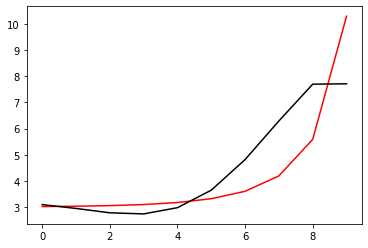

187000 0.060835308728098794
[3.22547718 3.03154896 2.81556882 2.71952411 2.89652644 3.48651478
 4.53428878 5.82100421 7.07951989 7.11933171]


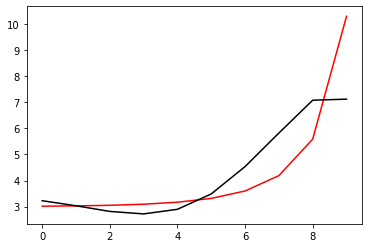

188100 0.01075550774158031
[3.17602893 2.99188046 2.78494696 2.69838269 2.88627736 3.49103484
 4.56283231 5.89163686 7.20155825 7.20250076]


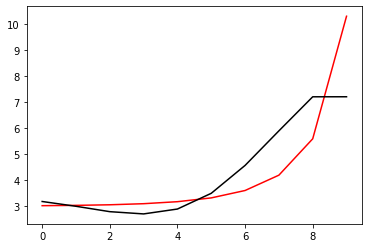

189200 0.015368795748959585
[3.13755106 2.96890992 2.77824648 2.71052209 2.92248934 3.56223405
 4.69047286 6.1095608  7.51914719 7.43517656]


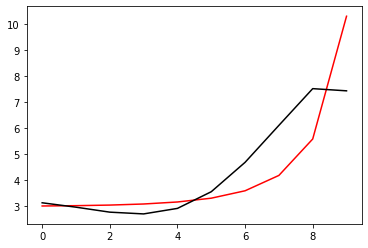

190300 0.010947783224315924
[3.10019903 2.94530369 2.76890091 2.71744404 2.95091917 3.62434543
 4.81193895 6.33178769 7.84510743 7.89702658]


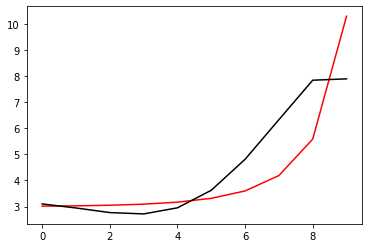

191400 0.011351138836829066
[3.10365992 2.91095403 2.69695803 2.60827103 2.80307509 3.43090894
 4.55031307 5.9551034  7.37351744 7.36444727]


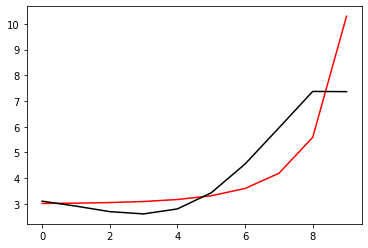

192500 0.00977387042713463
[3.14700171 2.96851397 2.76523811 2.68520648 2.88751439 3.52346878
 4.65597408 6.08851713 7.54252159 7.54518922]


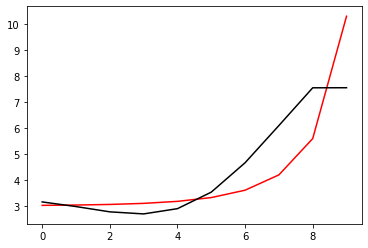

193600 0.7120633875229742
[3.4111301  3.24360133 3.04914474 2.97583902 3.18319744 3.82106788
 4.94078793 6.30174774 7.64023892 7.80897829]


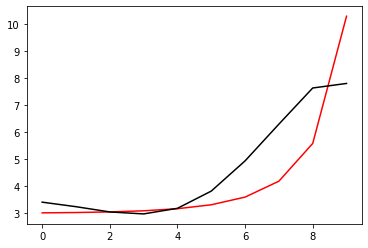

194700 0.029029407491718315
[3.13843901 2.93696987 2.7057334  2.59201754 2.7519533  3.32821903
 4.36190106 5.62830969 6.97192791 6.96479574]


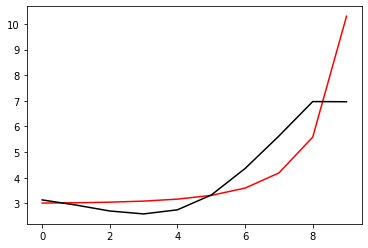

195800 0.030235535410573288
[3.12539703 2.9308319  2.70481659 2.5957199  2.7603893  3.34315545
 4.38956446 5.68433752 7.06470695 7.06113493]


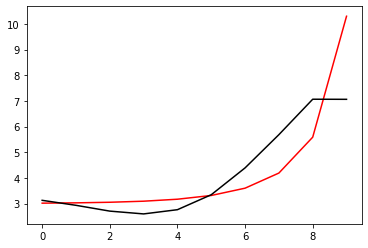

196900 0.0110387187338832
[3.12198536 2.93997029 2.72449267 2.62504497 2.79985655 3.39626716
 4.46740168 5.81276835 7.25450009 7.22485091]


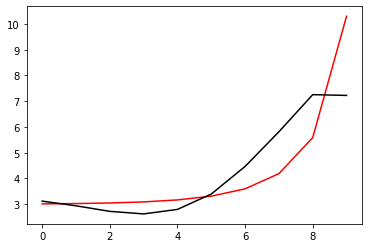

198000 0.06074241926271439
[3.13902216 2.97795039 2.78062153 2.69566454 2.88248066 3.49161456
 4.58601484 5.98694071 7.4958206  7.50037314]


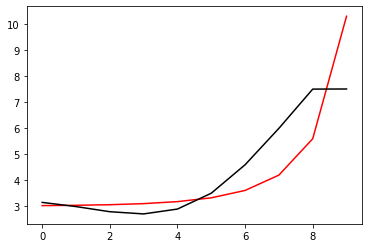

199100 0.010664624666831143
[3.11350763 3.01008025 2.86734121 2.83079141 3.05971507 3.70206275
 4.79655239 6.00928538 7.29731091 7.29666614]


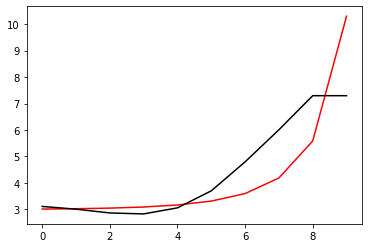

200200 0.0109859696054502
[3.01394036 2.92378868 2.79819251 2.77906143 3.0285947  3.7050391
 4.8895405  6.33737214 7.61159609 7.55448207]


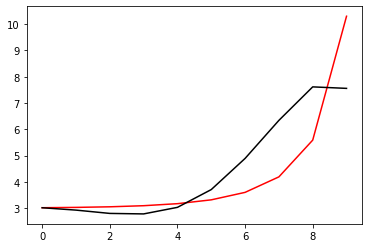

201300 0.01084368586533146
[3.06138663 2.93400602 2.76979844 2.70679199 2.90314278 3.50752082
 4.57720679 5.77011074 6.87955026 6.86345921]


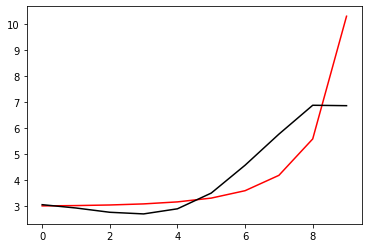

202400 0.0050740854818121526
[3.08011674 2.96463471 2.81444894 2.76660162 2.98061579 3.60886644
 4.71423079 5.96675747 7.13356063 7.06881218]


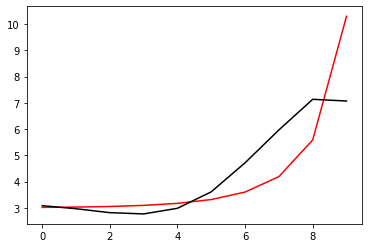

203500 0.02665290361532821
[2.95521927 2.84947444 2.71475892 2.68570764 2.92385968 3.58817368
 4.75373216 6.1147291  7.39374252 7.36458195]


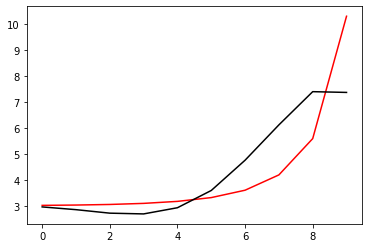

204600 0.006710315936621003
[3.11140484 2.97317395 2.80228841 2.73075305 2.91447234 3.49973643
 4.5334604  5.68322584 6.79864997 6.77691761]


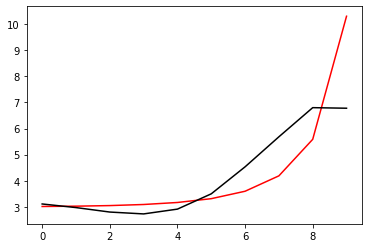

205700 0.010706436608941562
[3.11882052 2.99431108 2.84025805 2.78921943 2.99960296 3.62429139
 4.72206095 5.97763414 7.19027455 7.14668255]


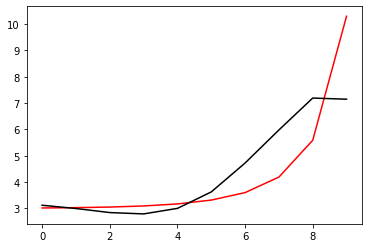

206800 0.03318239439599645
[3.03830436 2.88605494 2.70755907 2.63445731 2.82468186 3.43075117
 4.50742571 5.73036746 6.90115908 6.99169794]


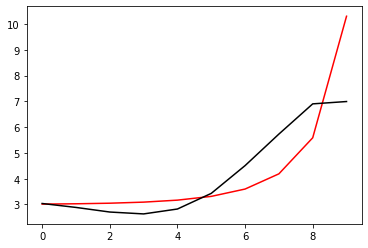

207900 0.010255200723030138
[3.07446604 2.92704171 2.75279202 2.68392816 2.87864224 3.49081849
 4.57836852 5.82768091 7.03095215 7.02176032]


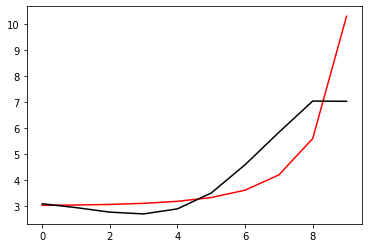

209000 0.060629425361847226
[3.07683237 2.9402128  2.77622492 2.71726317 2.92201585 3.5468166
 4.65530229 5.95184996 7.21299926 7.21335502]


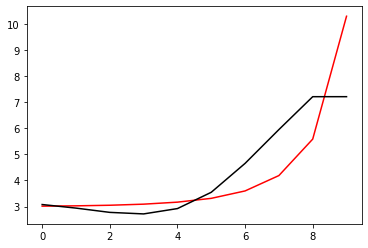

210100 0.010631420847416915
[3.0948474  2.99526934 2.8647723  2.83208113 3.05248667 3.67766318
 4.76322473 6.01782777 7.21582942 7.21061746]


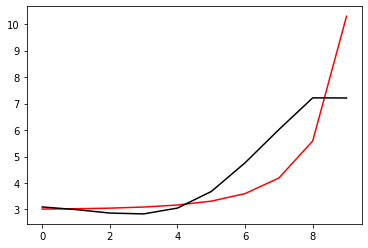

211200 0.011654092958369765
[2.99110091 2.89820955 2.78086522 2.76668869 3.01497847 3.68931566
 4.87450682 6.32517872 7.69997205 7.60561509]


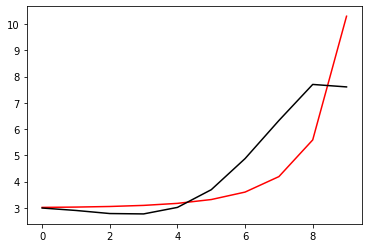

212300 0.010940220450968536
[3.01134713 2.944481   2.85881577 2.87736661 3.16080674 3.8794362
 5.13139666 6.68783995 8.12535084 8.12138401]


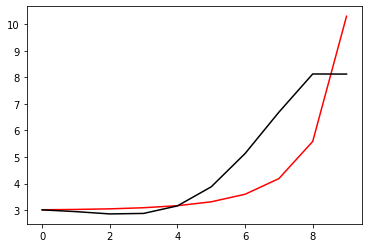

213400 0.0012248741500350557
[2.95512207 2.90141092 2.8308593  2.85800233 3.13641092 3.82460127
 4.99405386 6.3790412  7.57204465 7.84182294]


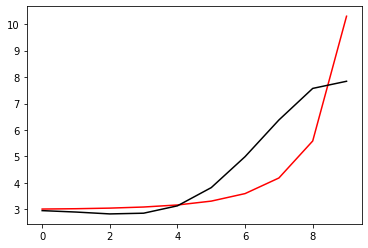

214500 0.009717010243958182
[2.96650305 2.91516614 2.84785942 2.87844476 3.16072435 3.85439589
 5.03419158 6.43948632 7.63967841 7.63518471]


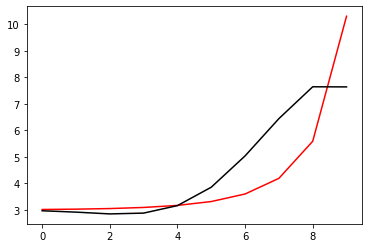

215600 0.0007817947782506941
[2.94051446 2.89360181 2.83220558 2.86894134 3.15795987 3.86115092
 5.06027602 6.51076469 7.74651868 7.74668807]


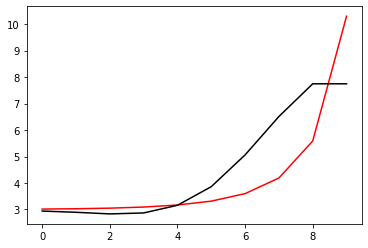

216700 0.01085356288030449
[2.92886396 2.8880949  2.83622859 2.88378693 3.18576516 3.90841308
 5.14566789 6.67229336 7.9551629  7.96164184]


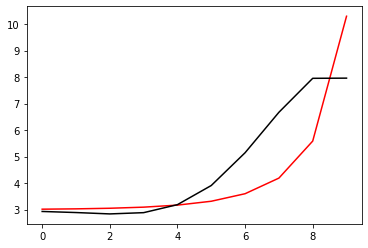

217800 0.01966688302253413
[3.00948871 2.94053735 2.86207322 2.87996726 3.14479036 3.81525831
 4.96972391 6.34522799 7.45476232 7.75408356]


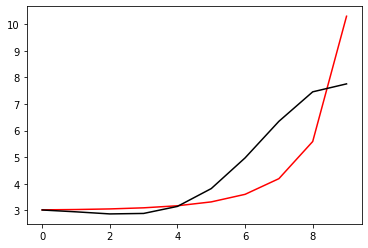

218900 0.010713991674147416
[2.99984945 2.93795957 2.86864139 2.89729425 3.17435762 3.86028952
 5.03795499 6.4558319  7.61431857 7.60322985]


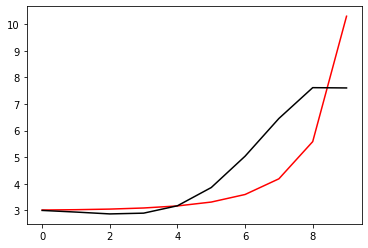

220000 0.11250709990336782
[2.90719003 2.80770609 2.70156308 2.69199764 2.92479148 3.55125894
 4.63407172 5.89848812 6.92371327 6.97251234]


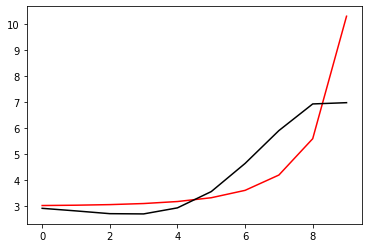

221100 0.010603715083908762
[3.05879995 2.95637528 2.84687272 2.83371807 3.06162014 3.68080426
 4.75336614 6.00880619 7.02473243 7.02568214]


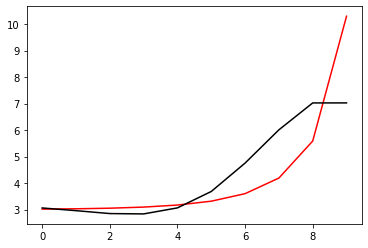

222200 0.012139027638994316
[3.03411338 2.94133782 2.84292318 2.84356365 3.08886537 3.73232563
 4.84283299 6.16231087 7.25779328 7.18620067]


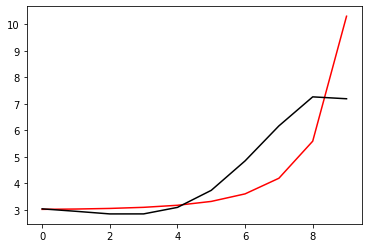

223300 0.010713291745758618
[2.95479637 2.87829783 2.79893234 2.82189278 3.09329768 3.77039557
 4.93106585 6.33479114 7.52974523 7.55033617]


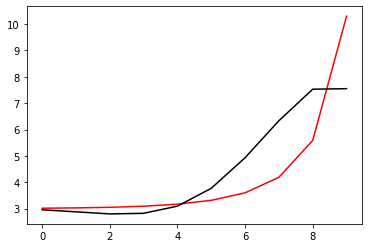

224400 0.005151144375301613
[3.07810524 2.94970783 2.81959773 2.79275233 3.01176155 3.62682362
 4.70340215 5.99655604 7.09291874 7.06727608]


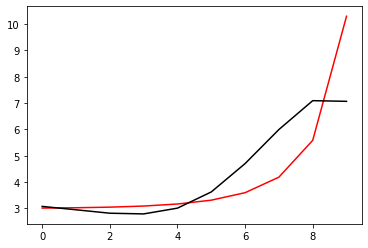

225500 0.007054095301878913
[3.03717753 2.91764037 2.79677328 2.78175534 3.01604004 3.65288145
 4.76474398 6.11892103 7.28870947 7.28581094]


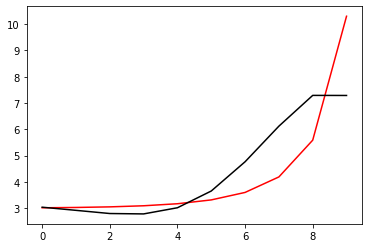

226600 0.7081972222346453
[3.31560859 3.19917305 3.08140155 3.07072417 3.30927537 3.94724668
 5.0441765  6.32570562 7.3841604  7.55234347]


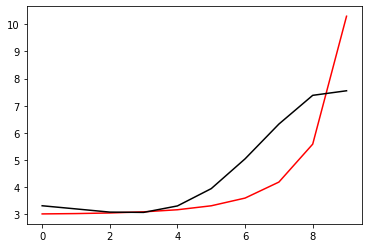

227700 0.027379007210757464
[3.06657561 2.91187928 2.75334073 2.69884823 2.88606572 3.45670505
 4.45991415 5.64303082 6.69743387 6.68449985]


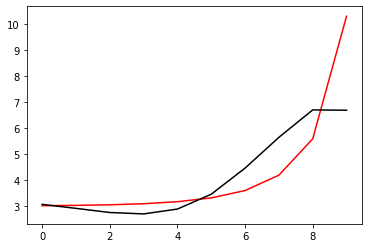

228800 0.027776168922240232
[3.15118374 2.99992424 2.84431801 2.79493285 2.99025607 3.57410837
 4.60091619 5.82842173 6.93734123 6.91885194]


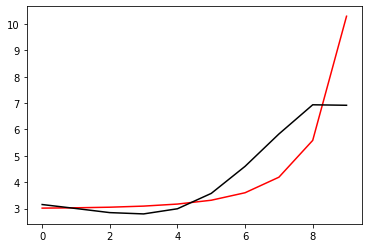

229900 0.010747734835423317
[3.09267133 2.95479772 2.81223659 2.77954371 2.99768124 3.61607438
 4.70143048 6.0301294  7.25720755 7.26586225]


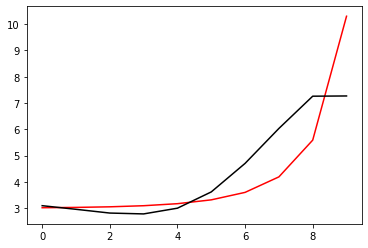

231000 0.06066266595642608
[3.13369534 2.95585765 2.77458105 2.70669507 2.89218097 3.47679681
 4.51714968 5.77572497 6.94243185 6.93672792]


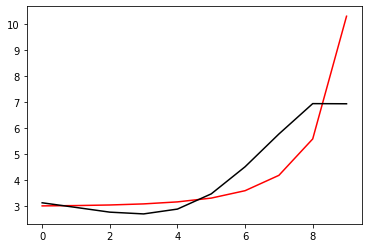

232100 0.010682281223437765
[3.16358728 2.99737956 2.82509285 2.76597705 2.96050729 3.5555414
 4.61109307 5.8974354  7.09826201 7.09898664]


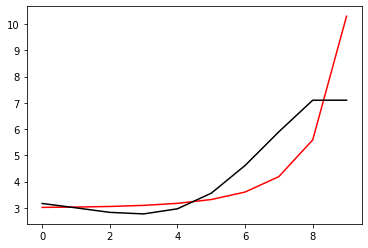

233200 0.014321920206075589
[3.09079094 2.94410207 2.79091087 2.75421777 2.97725099 3.61197722
 4.72848631 6.11043513 7.41976215 7.35613977]


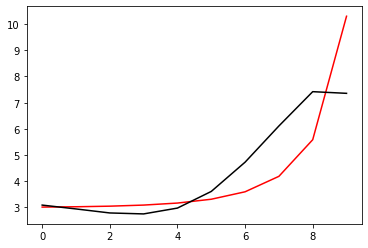

234300 0.011004358236760567
[3.10315019 2.91131223 2.70997488 2.62100855 2.78183718 3.33062679
 4.30891341 5.47152851 6.58628808 6.58785291]


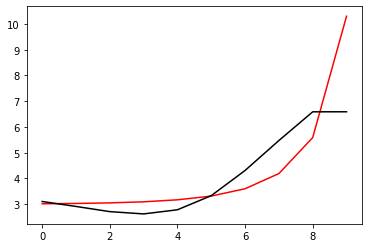

235400 0.014927194242706094
[3.13907959 2.94592209 2.74253051 2.65278485 2.81478585 3.36792067
 4.35726684 5.54539515 6.69582779 6.67020187]


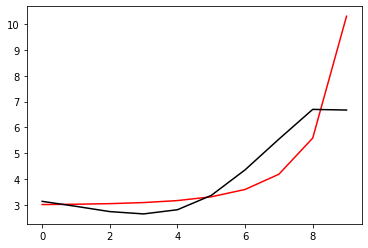

236500 0.0009419792114896038
[3.08821122 2.90498159 2.70875049 2.62628738 2.79689223 3.36215547
 4.37354372 5.60760933 6.82178302 6.8298283 ]


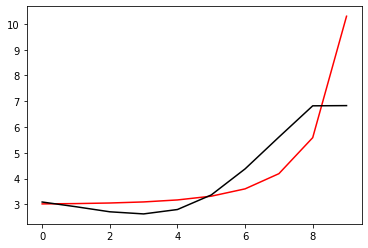

237600 0.010744582810581372
[3.07248302 2.90078717 2.71277486 2.63862475 2.8196286  3.40061328
 4.44250273 5.74203868 7.04079698 7.03337179]


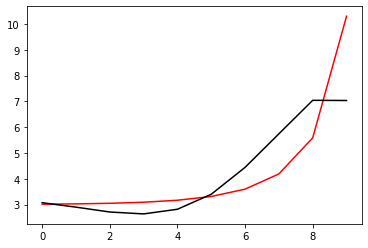

238700 0.01079016576246174
[3.14810767 2.99134919 2.81601424 2.75572087 2.95539418 3.56596812
 4.66396026 6.0709397  7.4794322  7.48856117]


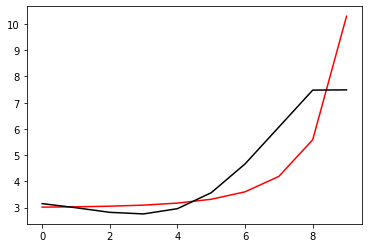

239800 0.025702838894656393
[3.08808478 2.97747526 2.84381158 2.81910908 3.04721688 3.67574766
 4.76747057 6.02718466 7.10945746 7.06568103]


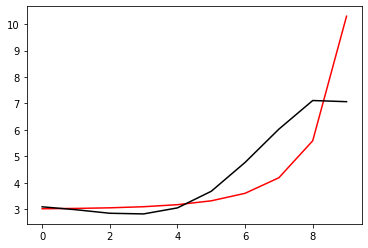

240900 0.010751524032434017
[3.07307729 2.97477041 2.85493125 2.84503093 3.09284697 3.75688971
 4.94412831 6.45509624 7.43299471 7.42560454]


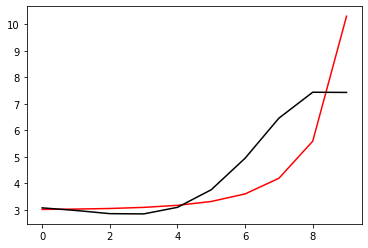

242000 0.11194148799421494
[2.95437705 2.8213436  2.66614963 2.6166726  2.81720462 3.41806551
 4.51230688 5.86251552 6.68426255 6.7613961 ]


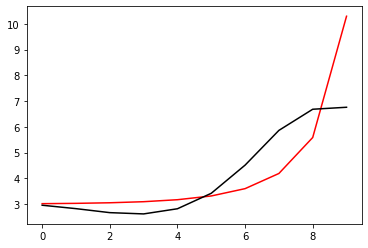

243100 0.010644075189263883
[3.06113386 2.9230005  2.76249303 2.70734989 2.90163743 3.49519446
 4.58049364 5.92418627 6.74535278 6.74569134]


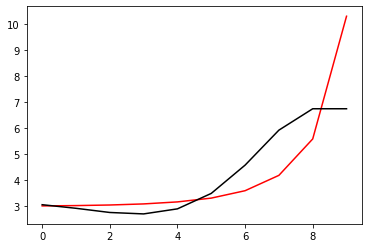

244200 0.015674721321088863
[3.05013517 2.9217357  2.77138754 2.72724213 2.93502415 3.54789159
 4.66419772 6.06348264 6.96485148 6.9069256 ]


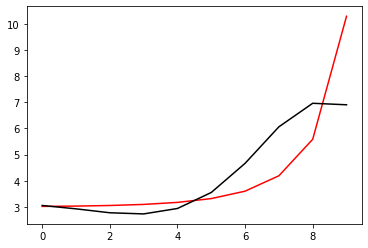

245300 0.010831958439679646
[3.04611599 2.93456919 2.80177026 2.77484364 3.00101626 3.63685954
 4.78715544 6.24824056 7.23814184 7.26526771]


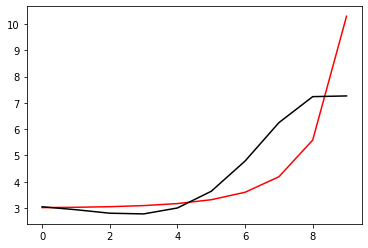

246400 0.012083787238208573
[3.06209258 2.90705645 2.7330005  2.6657287  2.84987353 3.43584485
 4.51407543 5.86513276 6.75141787 6.74139155]


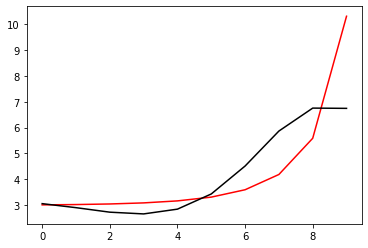

247500 0.00978501942402018
[3.13176556 2.96811671 2.78512437 2.71010515 2.88856959 3.47233234
 4.55469651 5.92436868 6.84433089 6.8468132 ]


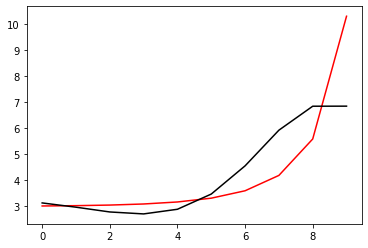

248600 0.00903730925466831
[3.0774479  2.92680578 2.7581323  2.7005526  2.90198542 3.51946858
 4.65553938 6.11216404 7.13782572 7.1301985 ]


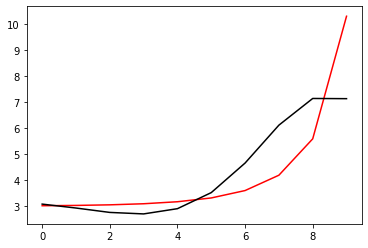

249700 0.5152365585011083
[3.33456445 3.17948943 3.00547193 2.94185295 3.1358336  3.73928379
 4.82897269 6.14271103 7.06836147 7.28722634]


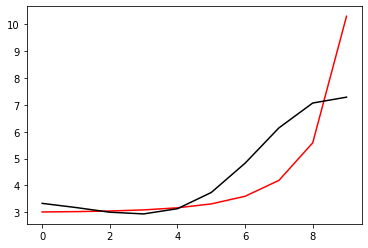

250800 0.029652778172163042
[3.20345877 3.01968095 2.81627816 2.72352377 2.88782578 3.4595815
 4.51632949 5.81048747 6.74878078 6.73843302]


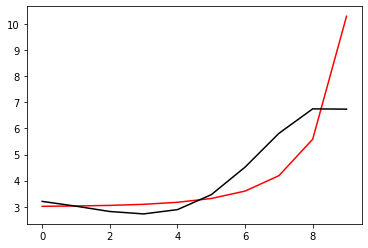

251900 0.010834433814976074
[3.18666506 3.01639318 2.82582472 2.74723084 2.92864647 3.52361595
 4.61520838 5.96518457 6.9706152  6.97215795]


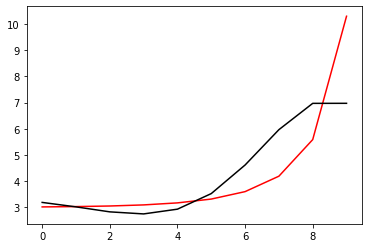

253000 0.060735096718079105
[3.11476038 2.95846019 2.78206808 2.720556   2.92524046 3.55557636
 4.7046283  6.14829481 7.26146075 7.2593727 ]


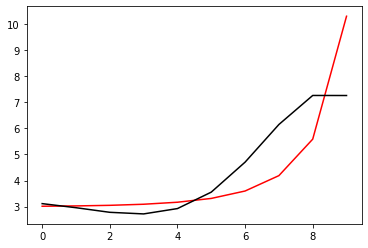

254100 0.010720455124391268
[3.2205065  3.01552885 2.78855029 2.67425734 2.82054233 3.37604162
 4.40576936 5.65301966 6.63198552 6.64997936]


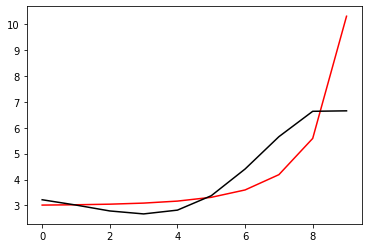

255200 0.02526283268409979
[3.22304938 3.03056795 2.81520172 2.7139585  2.87671262 3.45593627
 4.52426209 5.83808442 6.9007193  6.80037384]


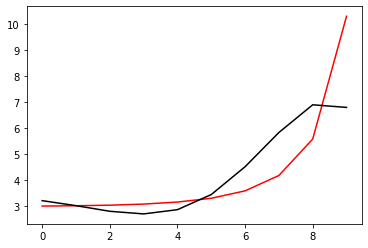

256300 0.011445135840791888
[3.14907351 2.97322146 2.77474533 2.69396399 2.88479526 3.50741267
 4.64890947 6.08444691 7.28474469 7.27115038]


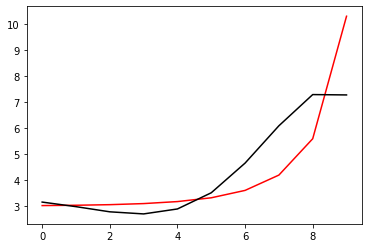

257400 0.0020045837070285896
[3.08707224 2.92945497 2.74964174 2.69106339 2.91276486 3.58408951
 4.8082669  6.37610775 7.70393426 7.66561456]


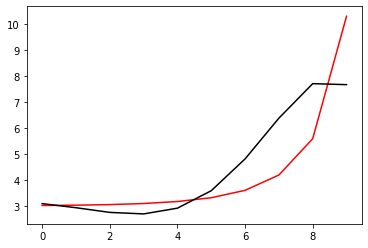

258500 0.008035142350759375
[3.16072752 2.96365299 2.74383989 2.64540429 2.8255827  3.44708451
 4.59310346 6.0222005  7.24349328 7.22282917]


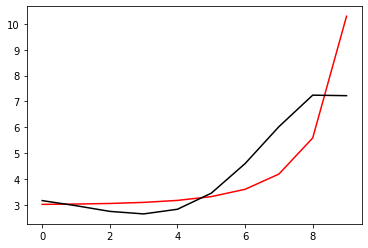

259600 0.00848377351032825
[3.11610753 2.93642383 2.73258514 2.6508658  2.85079289 3.49886046
 4.68531771 6.18069038 7.48141756 7.47106434]


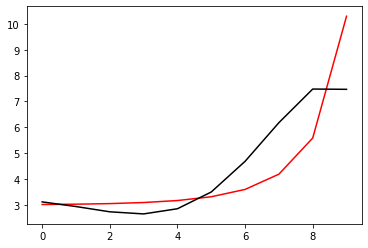

260700 0.5029987611867552
[3.37061957 3.18893852 2.97898747 2.88677784 3.07042625 3.68892152
 4.80721222 6.15293119 7.3400707  7.54641792]


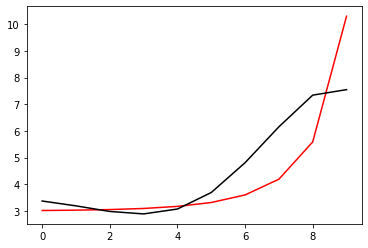

261800 0.029865194222783335
[3.23957891 3.0297785  2.79096659 2.6700139  2.82436619 3.41147327
 4.49721372 5.8233769  7.01930948 7.00921792]


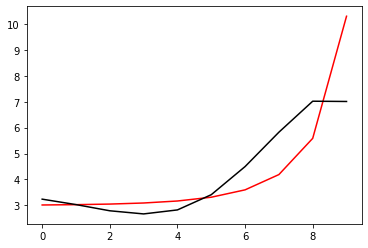

262900 0.01094219458137709
[3.22673718 3.03144324 2.80595372 2.69894003 2.8696434  3.4786085
 4.59783799 5.97964028 7.24087071 7.24506177]


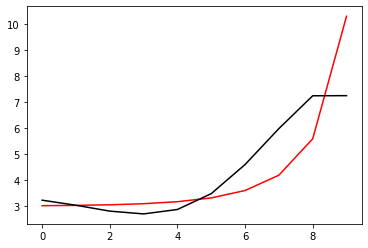

264000 0.060826273421346895
[3.15077024 2.97103182 2.76070946 2.67069439 2.86367147 3.50594284
 4.68043878 6.15568271 7.52226405 7.52030482]


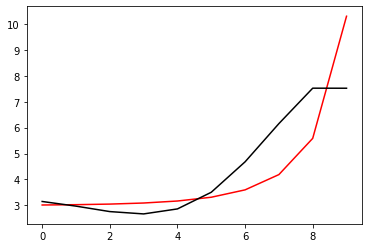

265100 0.010793591545487645
[3.16282898 2.96829344 2.74011479 2.62827593 2.79315939 3.39323997
 4.49119571 5.83241507 7.11976472 7.11778452]


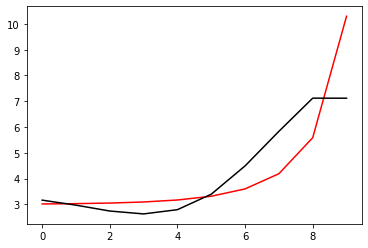

266200 0.01567111682124011
[3.13066047 2.94876636 2.73415241 2.6385534  2.82573019 3.46056919
 4.61827643 6.05875489 7.44205126 7.34396375]


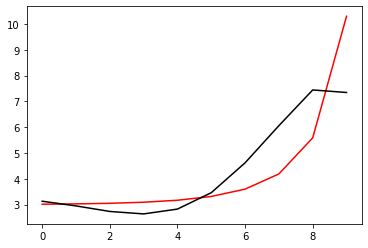

267300 0.011094174922030834
[3.12222187 2.96848456 2.78309385 2.71724589 2.93710428 3.61204475
 4.82605122 6.349781   7.79985086 7.81708028]


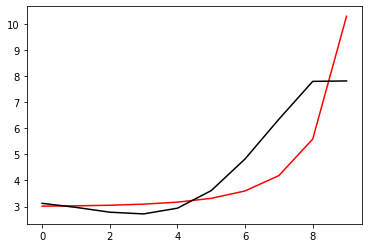

268400 0.005335820987563308
[3.17034177 2.9745764  2.7489772  2.6449074  2.82779238 3.46245134
 4.61562007 6.02434836 7.38532065 7.33824401]


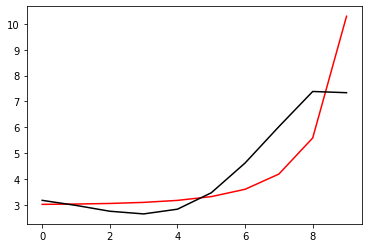

269500 0.0025896508822501334
[3.11643114 2.93535156 2.72406113 2.63535405 2.8368347  3.49724188
 4.69109053 6.16837337 7.61042693 7.60090808]


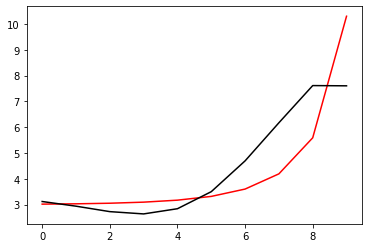

270600 0.7065100730062754
[3.39830577 3.23096144 3.03169396 2.95255798 3.16145652 3.82502544
 5.006971   6.43059751 7.78861719 7.91706471]


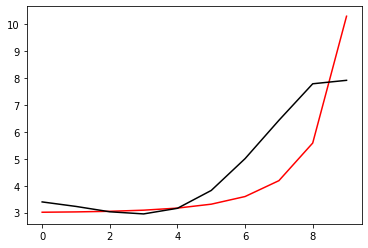

271700 0.0294784078873323
[3.12791207 2.92806103 2.69348942 2.57474984 2.73568644 3.33484845
 4.42648137 5.7530123  7.08107668 7.07493852]


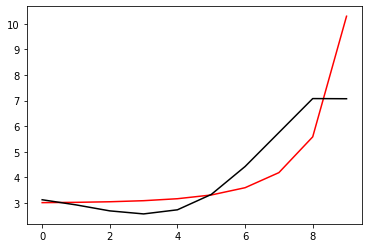

272800 0.029278798243830922
[3.22966755 3.03057694 2.79593446 2.67714163 2.83845986 3.43914167
 4.5362364  5.88075078 7.23025198 7.2213328 ]


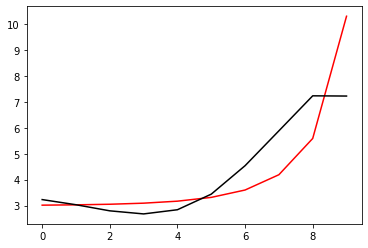

273900 0.010915987981443569
[3.19377744 3.00883773 2.78857635 2.68606596 2.86838723 3.50059132
 4.65238775 6.09475728 7.55731711 7.566481  ]


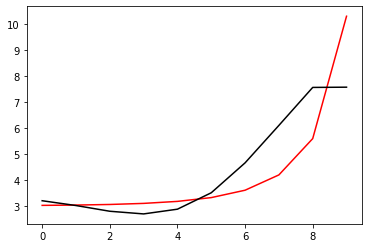

275000 0.060614096964672445
[3.17290467 3.00646926 2.80551591 2.72434974 2.93382529 3.60633902
 4.82651855 6.38398872 7.9585046  7.94712615]


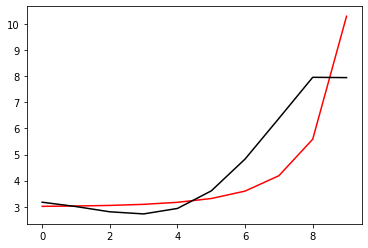

276100 0.4120309309227107
[3.26229388 3.13078599 2.96297102 2.91018761 3.14212138 3.82701411
 5.02136864 6.10604223 7.4938994  7.80817813]


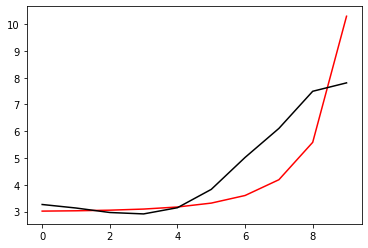

277200 0.017122534522578125
[3.09591492 2.96528654 2.79661418 2.73934783 2.96061039 3.62238029
 4.76659187 5.80285863 7.30504329 7.26091672]


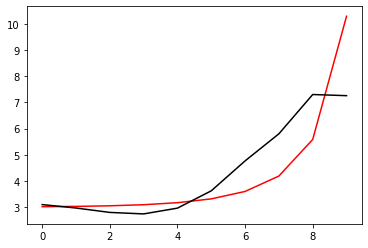

278300 0.011341820250010907
[3.09735797 2.97456395 2.81469892 2.76670803 2.9996038  3.67965511
 4.85791391 5.96665877 7.49701627 7.4751399 ]


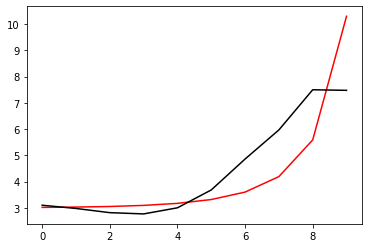

279400 0.0020073437426164366
[3.0468978  2.93610589 2.78964343 2.75472556 3.00243838 3.70413564
 4.92272671 6.13094758 7.71640238 7.69346963]


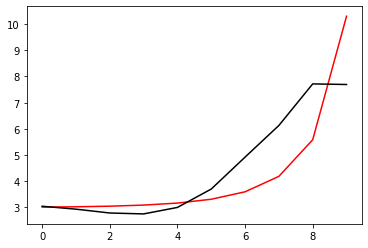

280500 0.019424948268529387
[2.93771555 2.84813709 2.72638023 2.71620034 2.99223869 3.73494504
 5.02736043 6.396153   8.07233598 8.0405171 ]


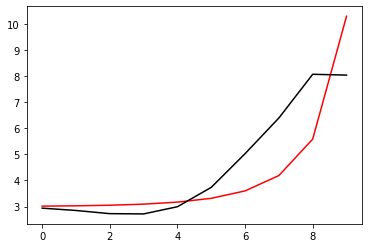

281600 0.003912919805950192
[3.05586627 2.93413377 2.77904261 2.73155373 2.96184814 3.63904517
 4.81483922 5.9598727  7.43355505 7.40263158]


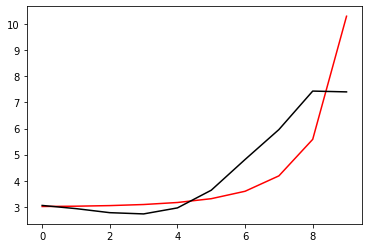

282700 0.011206550636499786
[3.04582058 2.934913   2.79423907 2.76347893 3.01431257 3.72010862
 4.94032451 6.17716633 7.72593998 7.68378964]


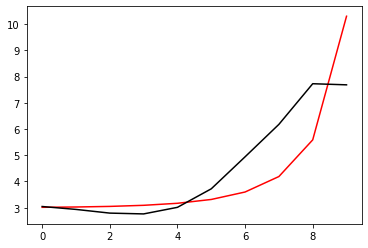

283800 0.028574954386972204
[3.11531611 2.97959926 2.81480574 2.75617544 2.97064712 3.6210549
 4.73827791 5.78903586 7.17242736 7.53553205]


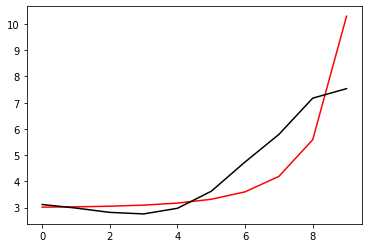

284900 0.010774852411834965
[3.08876078 2.95997455 2.8034955  2.7546315  2.98101064 3.64786733
 4.79147313 5.90029422 7.33566647 7.33113724]


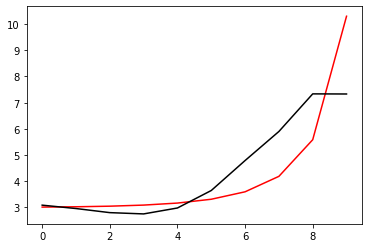

286000 0.06068075347372781
[3.06014769 2.94258465 2.80008985 2.76780836 3.01471654 3.71025028
 4.89957066 6.1027624  7.61658641 7.62035096]


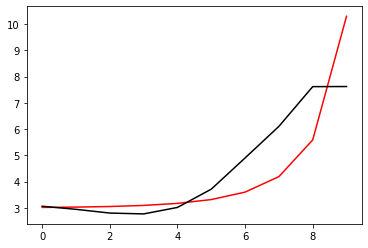

287100 0.010806121143989452
[3.04048611 2.94229051 2.82393002 2.81867129 3.09617991 3.82974187
 5.0735242  6.38527022 7.97344536 7.96875064]


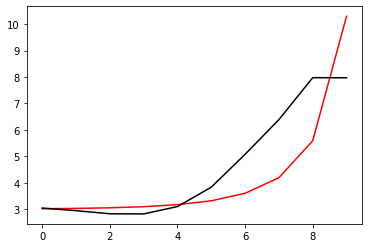

288200 0.4608798171630523
[2.72988946 2.64174951 2.53890052 2.55218594 2.85090754 3.60941154
 4.88201102 6.24320086 7.81831946 8.04729799]


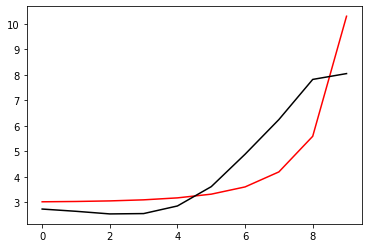

289300 0.010864270251387982
[3.03638996 2.93365253 2.81628043 2.81295975 3.08928484 3.81249882
 5.02483899 6.2947741  7.74673962 7.73335537]


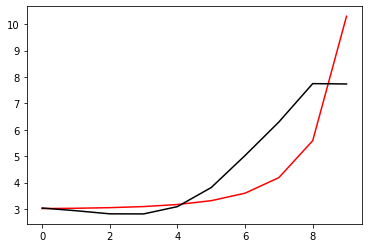

290400 0.0013980935714959274
[3.00786197 2.91266853 2.8034549  2.8085487  3.09396414 3.82875465
 5.06043147 6.37497903 7.87127409 7.86800585]


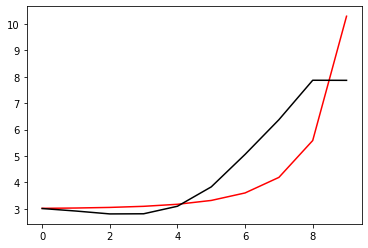

291500 0.006606831905712779
[2.92532365 2.84237856 2.74762938 2.76852285 3.07220997 3.83183935
 5.10583598 6.50975477 8.09505727 8.0747814 ]


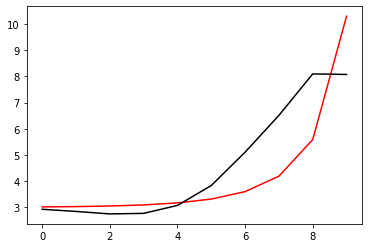

292600 0.0006685327415888033
[3.03338436 2.95877372 2.86720428 2.88229929 3.16393429 3.86830465
 5.01048996 6.1216099  7.33622675 7.3342919 ]


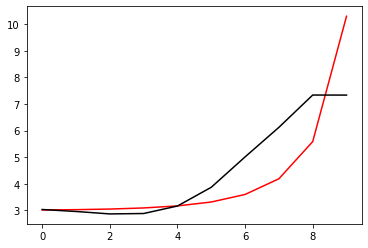

293700 0.010707313467827937
[3.00546748 2.93364156 2.8455635  2.86413702 3.14931208 3.85837281
 5.01236447 6.17068944 7.41091754 7.41133066]


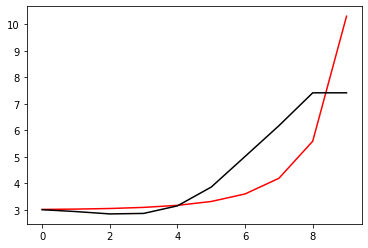

294800 0.017514002685848448
[2.98922782 2.92506032 2.8465861  2.87603424 3.17489971 3.90597508
 5.10958802 6.38754158 7.64480432 7.5557646 ]


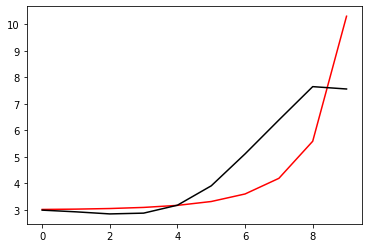

295900 0.043095182599982546
[2.89800129 2.81424891 2.71883234 2.73064977 3.00801361 3.70984352
 4.87667813 6.12248617 7.244126   7.32093748]


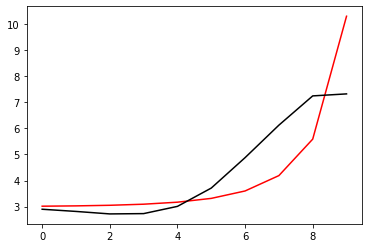

297000 0.060592959652584835
[3.01173505 2.92168711 2.82187504 2.83088943 3.10677165 3.80848218
 4.97719087 6.23109811 7.35433117 7.35623536]


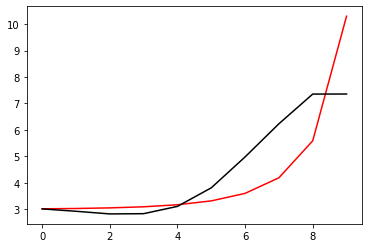

298100 0.010718497152837963
[3.01759465 2.9341057  2.84128964 2.85755236 3.14118446 3.85271101
 5.0379425  6.32910229 7.49378176 7.49243403]


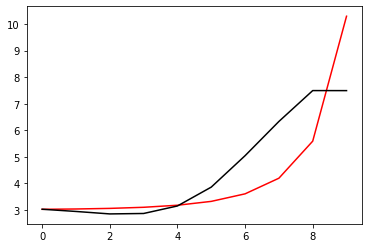

299200 0.009865076722405735
[2.94040421 2.87192348 2.7964591  2.83215964 3.13901496 3.88304358
 5.12319723 6.51834372 7.7969635  7.74618964]


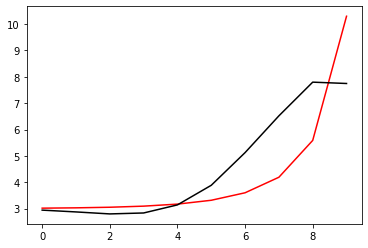

300300 0.011266403513175406
[2.95250475 2.86447424 2.76928813 2.7812327  3.05407741 3.74248024
 4.88611856 6.12822664 7.19805872 7.21014713]


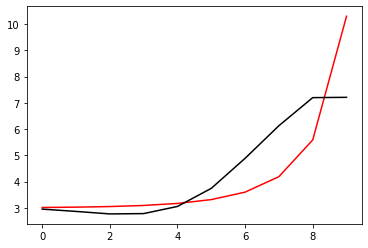

301400 0.0019745424893537287
[2.99691482 2.91177701 2.82001127 2.83605671 3.11402538 3.80976726
 4.96576961 6.23140324 7.32327388 7.31652293]


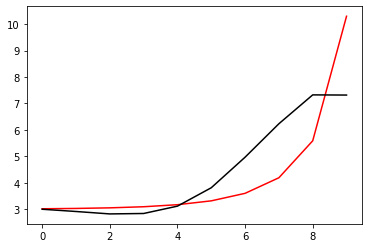

302500 0.008970971558310349
[2.98519912 2.90644586 2.82185947 2.8459262  3.13332702 3.84219067
 5.02105123 6.33325205 7.47835493 7.47640116]


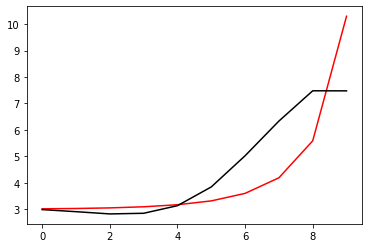

303600 0.7122736411240413
[3.24825336 3.16411367 3.07526516 3.09553917 3.37900744 4.08264932
 5.25009573 6.52945181 7.59402905 7.68704734]


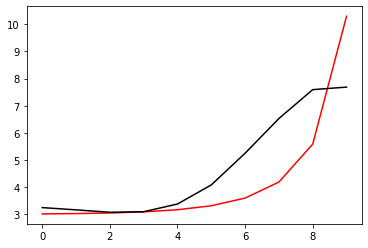

304700 0.010791920313190288
[3.09293303 2.96596285 2.83363298 2.80815231 3.03846844 3.67237181
 4.7421038  5.90863392 6.9148569  6.91229447]


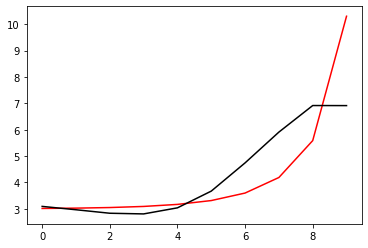

305800 0.024049308066290995
[3.08224613 2.96593334 2.84452837 2.83176793 3.07734091 3.73182628
 4.83451975 6.06141823 7.14092494 7.09770014]


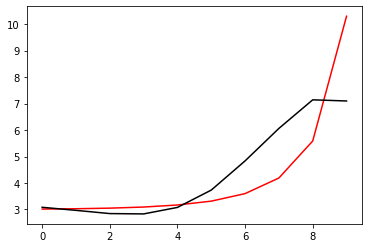

306900 0.010811210693792742
[3.07592362 2.97583035 2.87175486 2.87934306 3.14976462 3.83832113
 4.99544464 6.31725527 7.50017098 7.54471508]


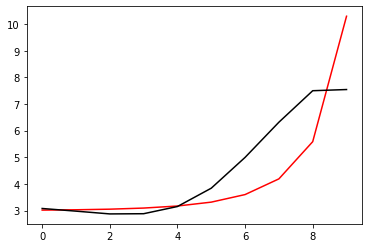

308000 0.06054612774800265
[3.12474932 2.98475486 2.84117355 2.80901614 3.03585526 3.67025132
 4.75209746 5.978919   7.08317505 7.08060501]


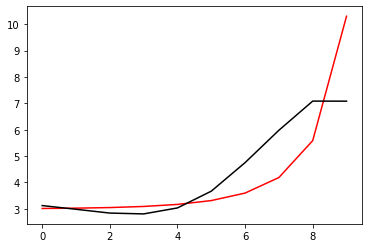

309100 0.010681698283213348
[3.10146941 2.97242538 2.8391687  2.81851892 3.0584855  3.70963431
 4.81775519 6.0932728  7.25453778 7.25541112]


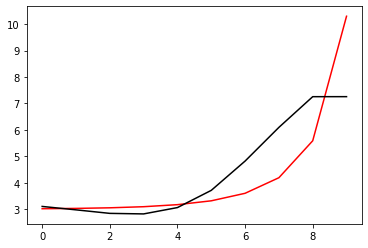

310200 0.008897603092738699
[3.02953082 2.91628909 2.80073346 2.8027859  3.07327311 3.7693642
 4.95047263 6.34548561 7.63333959 7.5238811 ]


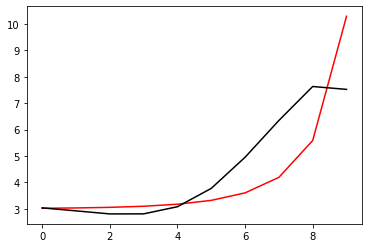

311300 0.010864704522672268
[3.07770133 2.92162647 2.76343503 2.72332192 2.94887681 3.58981513
 4.69081364 5.97296306 7.17047558 7.15696092]


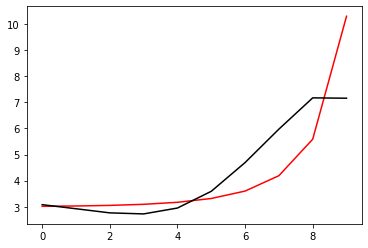

312400 0.0031252185460213925
[3.07632446 2.93485361 2.79025296 2.76535062 3.00922218 3.67482624
 4.81402508 6.1597     7.42983297 7.40894499]


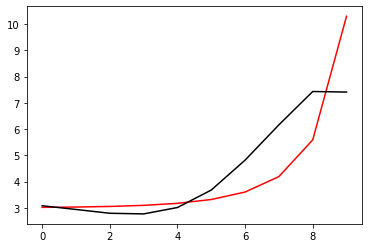

313500 0.036500922985764024
[2.94539671 2.82294984 2.6978776  2.69508971 2.96538911 3.66612653
 4.86043801 6.30043687 7.67688531 7.65022368]


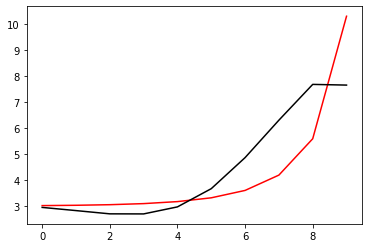

314600 0.006539462358144284
[3.08784161 2.92863497 2.76390032 2.71854867 2.93950449 3.575165
 4.6726608  5.9753495  7.22053637 7.20609432]


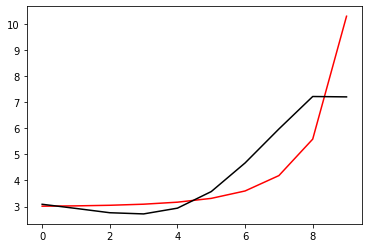

315700 0.010763213091101507
[3.10837783 2.96678738 2.81774874 2.7884267  3.02705884 3.68468596
 4.81495792 6.17289852 7.48156087 7.49380001]


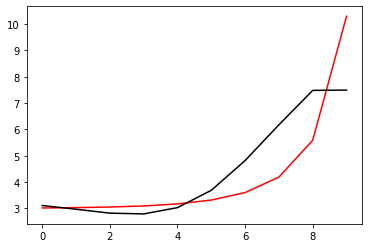

316800 0.061293036430165274
[2.99887779 2.84829795 2.68639574 2.63938544 2.85195592 3.46714191
 4.52524705 5.78054131 7.03212325 7.19145997]


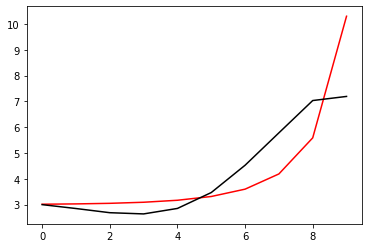

317900 0.010713815862947744
[3.12296816 2.9837483  2.83299984 2.79748599 3.02189174 3.64940051
 4.7221337  5.99818717 7.25465411 7.25505132]


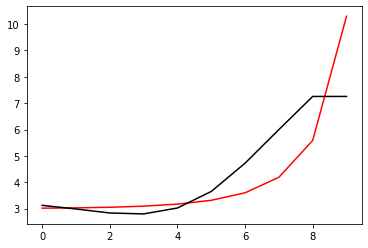

319000 0.059710780442070996
[3.11109224 2.98958837 2.85853701 2.84604369 3.09923898 3.7667501
 4.9031455  6.28021892 7.62795268 7.61640492]


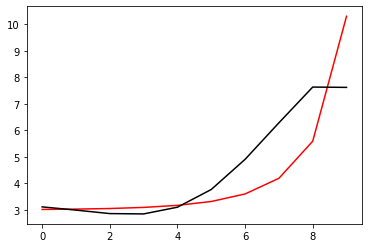

320100 0.010684233364868139
[3.15024706 3.00278439 2.84391011 2.80131769 3.01997679 3.64262971
 4.7110217  5.97333371 7.23760384 7.23809926]


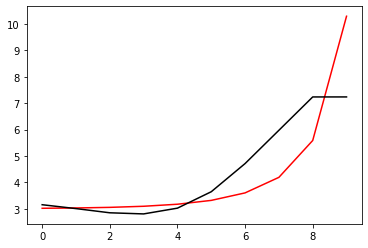

321200 0.011893971793259807
[3.06548461 2.93325289 2.79170749 2.7703509  3.01694269 3.6801404
 4.81427571 6.18233762 7.55129696 7.50000116]


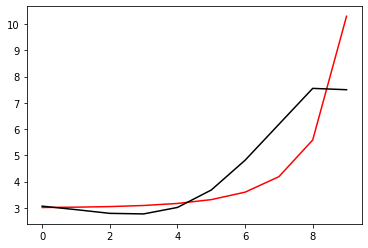

322300 0.011008172259422778
[3.10622913 2.92578413 2.73384691 2.65857114 2.84267373 3.42232847
 4.42396261 5.57134455 6.75528511 6.76235548]


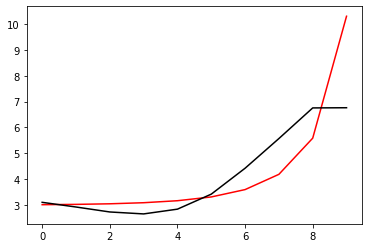

323400 0.01231384464610781
[3.07415382 2.9015923  2.71605552 2.64732995 2.83895054 3.42883668
 4.4483391  5.63213225 6.86451456 6.849525  ]


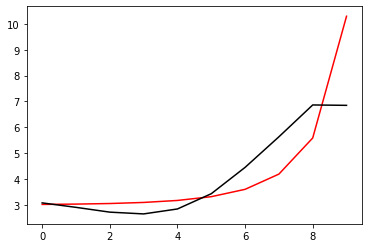

324500 0.0009635184490929217
[3.06515708 2.89925832 2.71860945 2.65512188 2.85357021 3.45429959
 4.49596999 5.73000336 7.02773076 7.02895569]


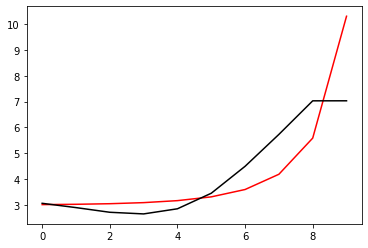

325600 0.0007504975992848385
[3.14754345 3.00915632 2.85270461 2.81128737 3.03076341 3.65379308
 4.7273119  6.02233833 7.3854781  7.30786966]


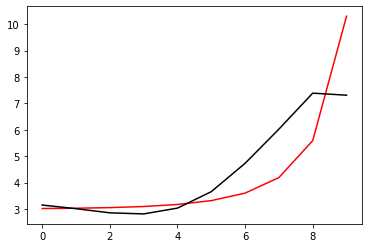

326700 0.011945024718966002
[3.03800605 2.93306079 2.8081925  2.79368569 3.03425808 3.67155551
 4.75655145 6.07830626 7.4193026  7.3479646 ]


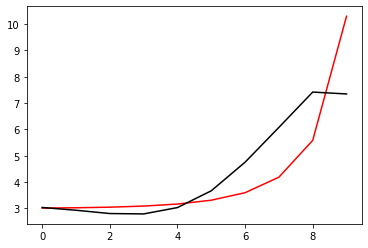

327800 0.01567963154984857
[3.04369742 2.96131096 2.864423   2.88204927 3.16449896 3.86711215
 5.07322429 6.59656603 8.04888547 7.91741191]


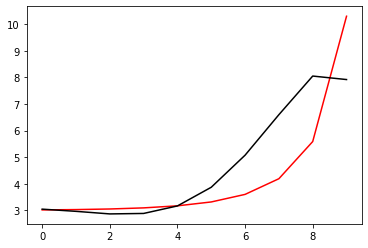

328900 0.0013028745344414157
[2.95573913 2.86651782 2.76203224 2.76686925 3.02614249 3.6855297
 4.81082454 6.19116589 7.43390653 7.44545321]


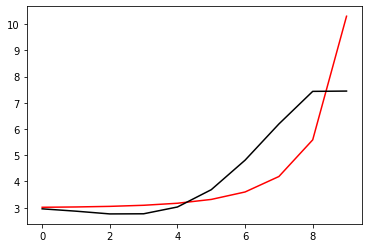

330000 0.06057837582356704
[3.02486324 2.93235494 2.826311   2.83077288 3.09112201 3.75384046
 4.88676225 6.28320073 7.54343349 7.54604022]


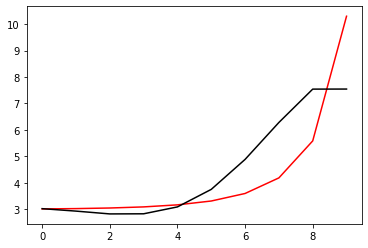

331100 0.010719079472374191
[3.02918399 2.94390419 2.84567165 2.85779437 3.12651014 3.80037007
 4.95217772 6.38532934 7.69102015 7.69012022]


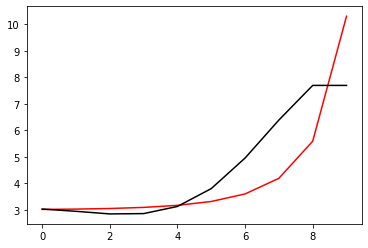

332200 0.010167093982796653
[2.93880903 2.87109742 2.79324845 2.82734972 3.12237214 3.83340072
 5.04713388 6.58744395 8.01691884 7.96851746]


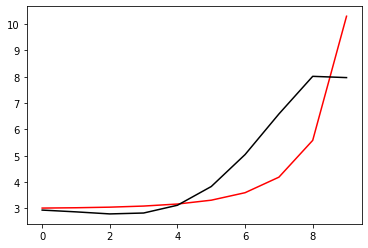

333300 0.010869989872216816
[3.02531043 2.93698362 2.84073413 2.85612362 3.13012497 3.81448898
 4.99119824 6.48439704 7.86343314 7.84644739]


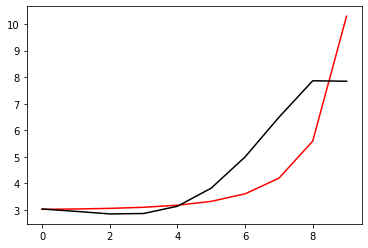

334400 0.0009555014546112425
[2.95411417 2.87548835 2.79225905 2.8225242  3.11416223 3.82261795
 5.03887378 6.60393398 8.07425784 8.07527559]


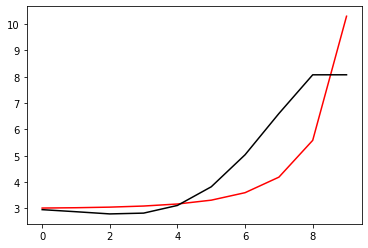

335500 0.008897962190390489
[3.02344286 2.91911803 2.81112945 2.8148616  3.07344355 3.73330171
 4.86892925 6.30357127 7.60740229 7.59957061]


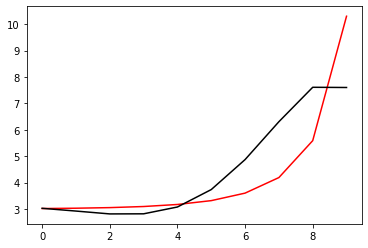

336600 0.0008407493667714397
[3.00798916 2.91070387 2.80958748 2.82047509 3.0872983  3.75889325
 4.91563966 6.39049628 7.73842286 7.73762322]


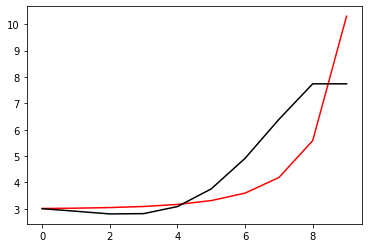

337700 0.1805906715684634
[2.83004234 2.71493318 2.59901113 2.59761937 2.85435128 3.51847683
 4.6726298  6.15386686 7.50795661 7.9134086 ]


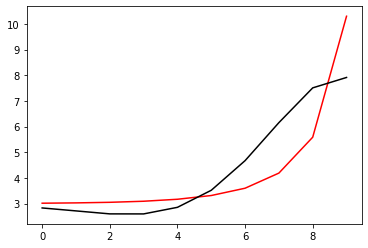

338800 0.02477960066198971
[3.05313096 2.93944495 2.82240744 2.8167255  3.06369581 3.70790269
 4.82257575 6.23075553 7.47436655 7.44048759]


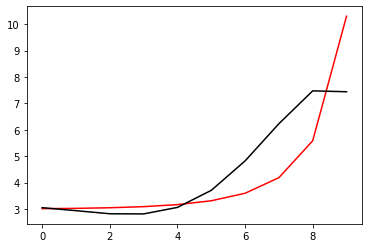

339900 0.010729394537641062
[3.05031093 2.94515922 2.83627756 2.83931067 3.09669943 3.75611879
 4.89800492 6.35566135 7.64836463 7.66190242]


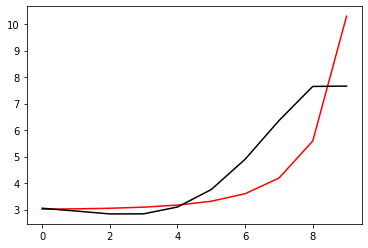

341000 0.05623964182066192
[3.05390332 2.96579691 2.874286   2.89595159 3.17547191 3.86621798
 5.06066345 6.60438851 7.97225964 7.94061319]


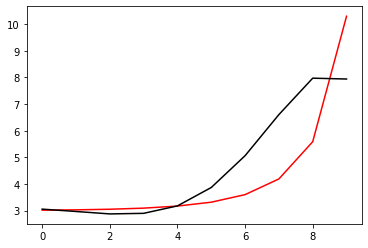

342100 0.010724791007548135
[3.07565268 2.96091742 2.8425912  2.83603764 3.08329867 3.73260428
 4.86714254 6.32520685 7.64425618 7.64614649]


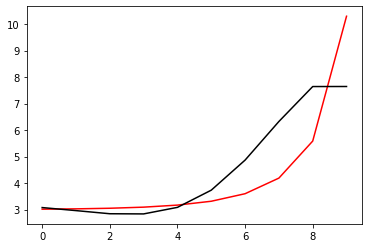

343200 0.010324844045523017
[2.98300122 2.88226627 2.78090676 2.79584666 3.07178932 3.76377825
 4.96855641 6.53895882 7.97889201 7.93614874]


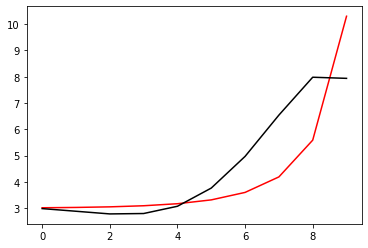

344300 0.05517325072015589
[3.09657334 3.01090513 2.92078685 2.94045407 3.20949675 3.87181171
 4.99404833 6.35020908 7.4826276  7.77737111]


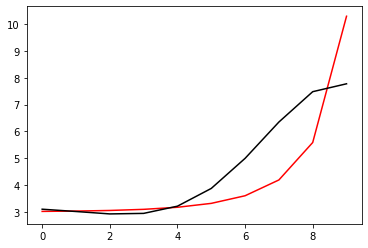

345400 0.002121090527698798
[2.99408582 2.92004684 2.83967513 2.86659589 3.14001577 3.80316476
 4.9227514  6.28921236 7.47954723 7.45884179]


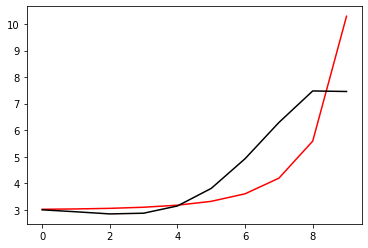

346500 0.003072340665162691
[2.94894371 2.88153171 2.80895782 2.8442688  3.12790353 3.80715898
 4.96246902 6.41758684 7.67595964 7.66081127]


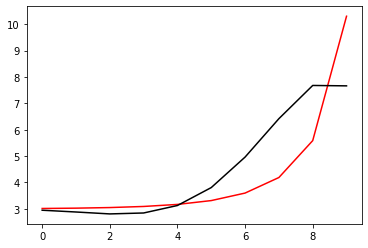

347600 0.09474709860026552
[3.05788282 2.99292157 2.92698437 2.97208225 3.2710425  3.97827848
 5.19313044 6.75563261 8.03026058 7.97111066]


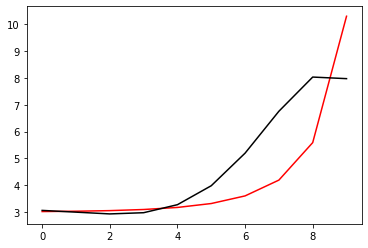

348700 0.011411572015568788
[2.96300071 2.89989852 2.83148989 2.86647516 3.14184819 3.80019146
 4.91777948 6.30543751 7.3494449  7.31903309]


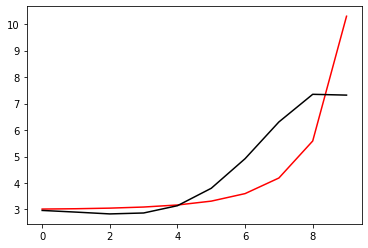

349800 0.019226432090783063
[2.97528667 2.91749128 2.85547436 2.89759205 3.18166033 3.85258186
 4.99179714 6.41745861 7.50130499 7.44339809]


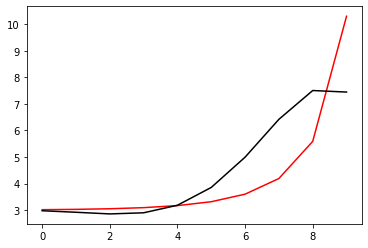

350900 0.010724522610894885
[2.9691806  2.91886996 2.86625177 2.91874596 3.21514378 3.90355949
 5.0730275  6.55384971 7.70006144 7.73585408]


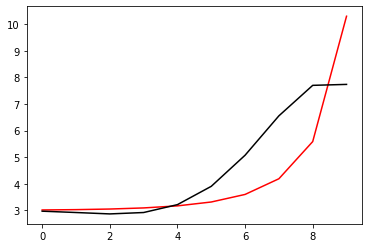

352000 0.06046179631718498
[3.0338063  2.95348345 2.86912093 2.88408108 3.1310218  3.7453044
 4.78920826 6.05136819 6.97762544 7.04184111]


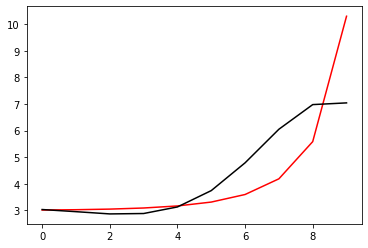

353100 0.010602300193950776
[3.0272713  2.95050953 2.87113223 2.89271088 3.14855482 3.77651881
 4.84528771 6.15553149 7.14135104 7.14208848]


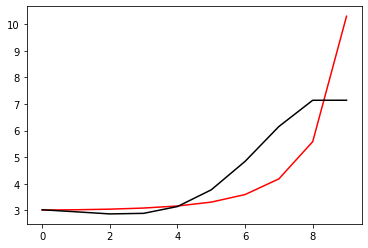

354200 0.01060447319534413
[2.95589967 2.88474294 2.81531637 2.85229716 3.13197403 3.8001749
 4.94280565 6.38191159 7.50849521 7.44312344]


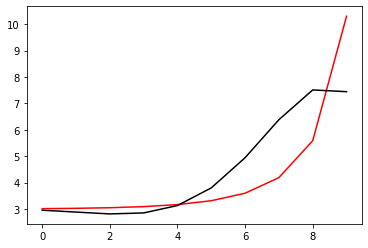

355300 0.010681892136155145
[3.0053961  2.90084074 2.7950583  2.7908141  3.01916942 3.61434629
 4.6342083  5.84418305 6.77563528 6.76059505]


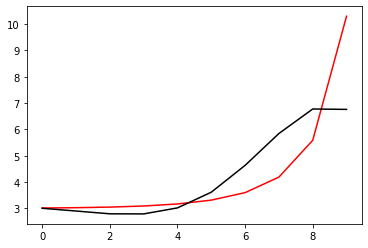

356400 0.003011315094876978
[3.00988533 2.918227   2.8270227  2.84027911 3.09047856 3.71548717
 4.77973703 6.05721621 7.06206106 7.03692035]


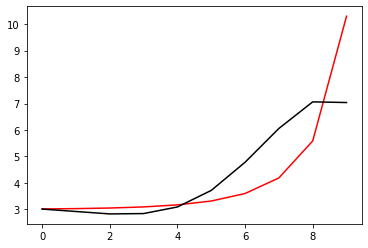

357500 0.0014771145324080329
[2.92957846 2.85226345 2.77881858 2.81374573 3.09083766 3.75233048
 4.87200153 6.2383786  7.34191721 7.33447897]


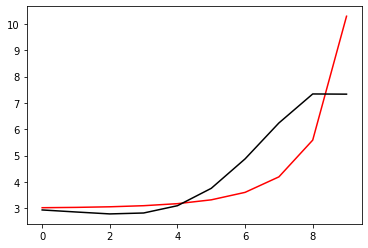

358600 0.008940276803577002
[2.94172533 2.86993478 2.80044427 2.83356154 3.09691219 3.72207339
 4.76432876 5.99272271 6.89982151 6.93935427]


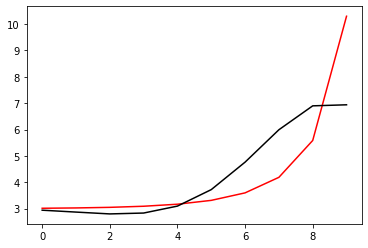

359700 0.011600003208102215
[2.97730635 2.90808667 2.84170454 2.87869266 3.14727704 3.78045974
 4.8363744  6.08792323 7.01841804 6.99150165]


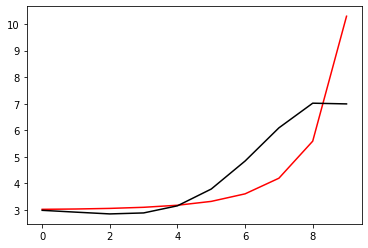

360800 0.021271306193880422
[2.98929501 2.92720611 2.86865698 2.91443166 3.19382078 3.84246159
 4.92403028 6.21960519 7.19840648 7.15146552]


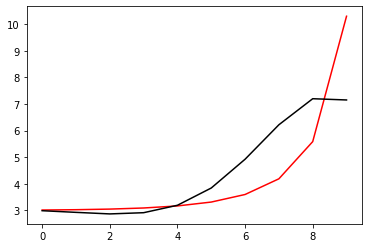

361900 0.010676199322788007
[2.98494026 2.93411713 2.88826829 2.94804245 3.24421413 3.91633145
 5.03647825 6.39824262 7.44946452 7.50400199]


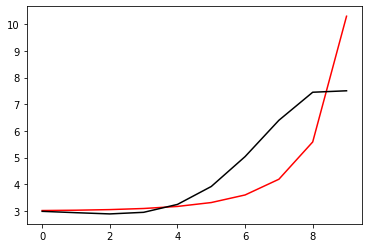

363000 0.0956007864768087
[2.92251057 2.83428247 2.75434319 2.78120479 3.04296793 3.67467557
 4.74116954 6.03227951 7.0208496  7.02172994]


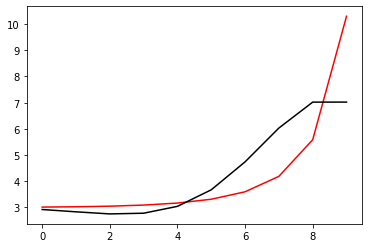

364100 0.010614471048951165
[3.02339352 2.93616767 2.85707213 2.88532496 3.14894081 3.78339312
 4.85536867 6.16060903 7.17137565 7.17110651]


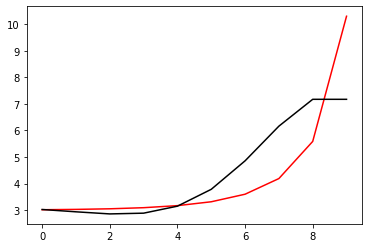

365200 0.010836056823240703
[2.95291263 2.87949333 2.81544437 2.86145027 3.14733031 3.81298711
 4.93406716 6.32062366 7.43706228 7.38574108]


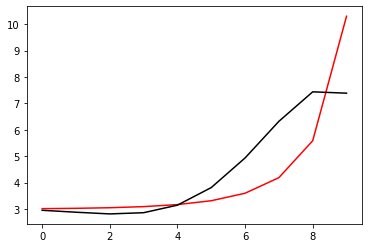

366300 0.010667191677279237
[3.00252229 2.88699323 2.77760537 2.77336831 2.99848905 3.58041409
 4.56946332 5.75301207 6.70450498 6.69719434]


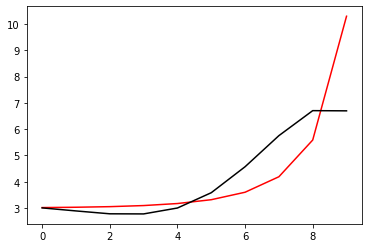

367400 0.006517469430372777
[3.00507855 2.89843542 2.79702006 2.80126683 3.03583574 3.62960949
 4.63657439 5.85122584 6.84257524 6.81501335]


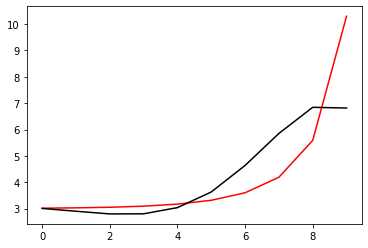

368500 0.009510314382699513
[3.01524597 2.91985239 2.82925894 2.84583952 3.09537065 3.70951528
 4.74872316 6.01871677 7.07879831 7.10261814]


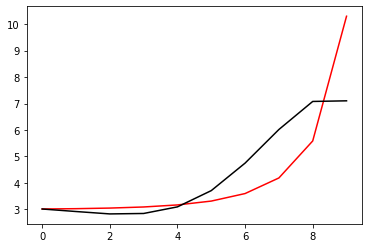

369600 0.5523486858206719
[3.20142428 3.11049611 3.02497798 3.04711419 3.30148073 3.91627306
 4.94162974 6.17203282 7.20499913 7.36904487]


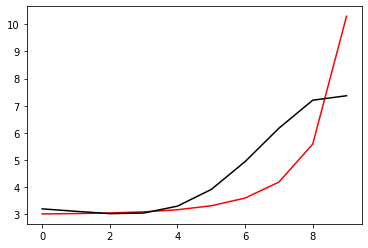

370700 0.010828823072486494
[3.07795015 2.96022505 2.84831734 2.84429109 3.07059    3.65225754
 4.63732394 5.82585993 6.82538872 6.79545221]


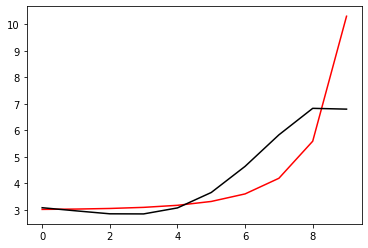

371800 0.022593273830968576
[3.07762648 2.97436434 2.87606361 2.88676808 3.13034006 3.73469081
 4.75373203 5.9960261  7.06075679 7.01777247]


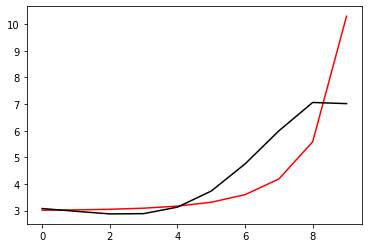

372900 0.0053368396476724264
[2.96382132 2.88064688 2.80183395 2.83311445 3.10012155 3.73463823
 4.79941546 6.11663768 7.27172843 7.35959079]


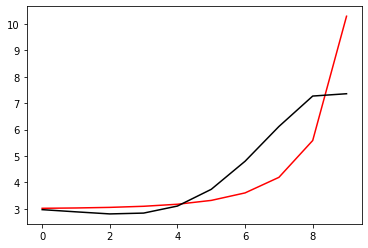

374000 0.060519621933098684
[2.94485372 2.8878249  2.83466927 2.88954483 3.17861586 3.83568157
 4.93086463 6.3024039  7.52382285 7.51639841]


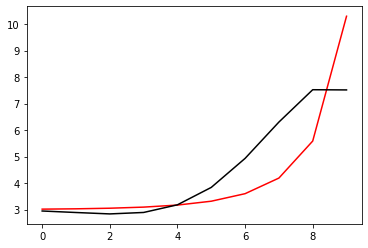

375100 0.026140920698539648
[2.86195875 2.794845   2.73095103 2.76954025 3.03133919 3.63900428
 4.64309638 5.86808889 6.91821652 6.94229668]


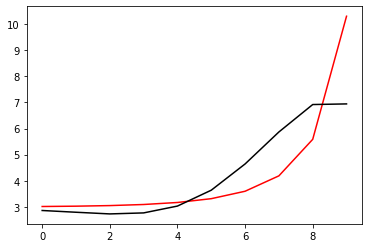

376200 0.01392542935788638
[2.94586254 2.87432617 2.80703113 2.84317597 3.10350765 3.71081708
 4.71610917 5.94367178 6.98956107 6.96926145]


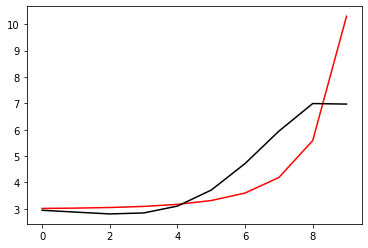

377300 0.010797601663530828
[2.98642024 2.92257445 2.86399202 2.91039814 3.1842397  3.81204565
 4.85228281 6.13528081 7.22829226 7.24237098]


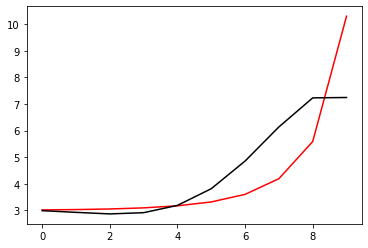

378400 0.001152852913225413
[2.93159555 2.87822537 2.83163738 2.89123198 3.18099676 3.83170936
 4.91239927 6.26857447 7.44085584 7.41704305]


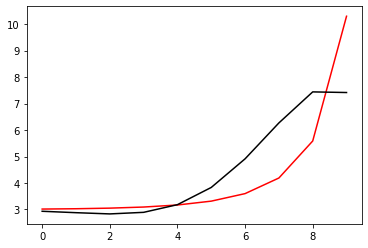

379500 0.010311797809897596
[3.05022561 2.94924211 2.85245743 2.85649106 3.07854783 3.63439937
 4.56204971 5.66715723 6.5972426  6.59111217]


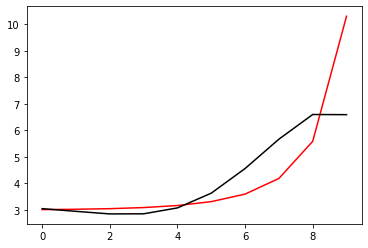

380600 0.0008785778586399587
[3.04180826 2.94787472 2.85841927 2.87115549 3.1045321  3.67741308
 4.6348695  5.79254032 6.78091566 6.76400113]


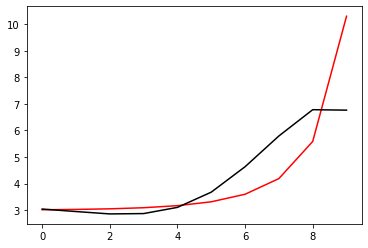

381700 0.01062763133951817
[3.02756717 2.94503212 2.86775964 2.8948237  3.14662447 3.74682873
 4.75113127 5.98791008 7.05675252 7.06808562]


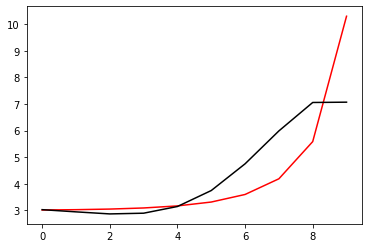

382800 0.017905793212287927
[3.02911604 2.96639513 2.91116673 2.96351484 3.24674931 3.89156177
 4.96803504 6.3169025  7.48652182 7.38161972]


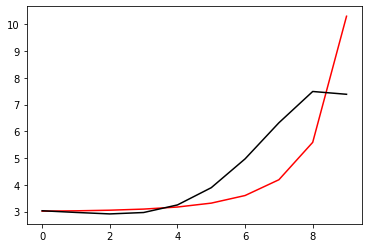

383900 0.010622508640589922
[3.05813961 2.98325016 2.91453125 2.94919498 3.20532726 3.80257955
 4.78787596 5.96858263 6.92083635 6.90706104]


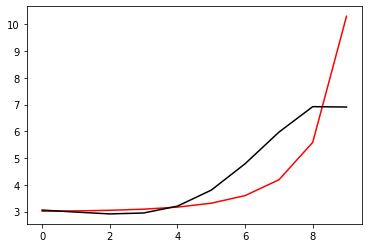

385000 0.0601829936617835
[3.01260715 2.94780657 2.89023942 2.93755927 3.20955771 3.83076422
 4.86111516 6.12780481 7.16096328 7.16295942]


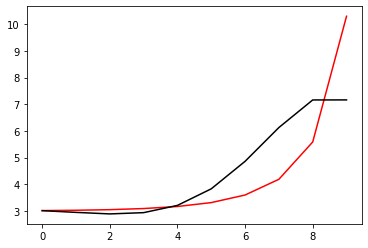

386100 0.01047940171554817
[3.05807269 2.96209783 2.87102907 2.88052917 3.10602031 3.66310224
 4.59577045 5.70864069 6.60692385 6.61718926]


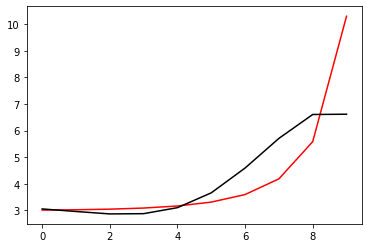

387200 0.016514245315655648
[3.0366684  2.94804364 2.8665529  2.88988215 3.13638449 3.72815046
 4.72222116 5.9378476  6.94644087 6.8322481 ]


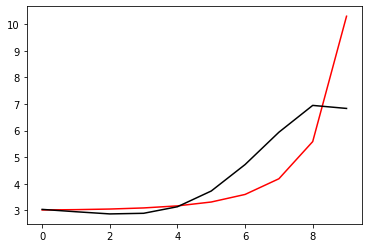

388300 0.010862633445624442
[3.00202628 2.92600513 2.8595832  2.90159596 3.17228106 3.79870291
 4.84898358 6.15554548 7.25391299 7.2454161 ]


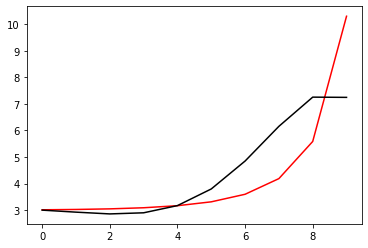

389400 0.0037092129057880417
[2.9725952  2.91310258 2.8616156  2.91398035 3.18558155 3.79402177
 4.7861855  5.95440996 6.83135299 7.06852968]


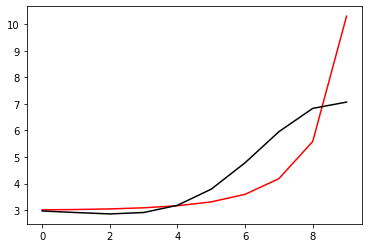

390500 0.010354645108949923
[2.9762328  2.92018302 2.87240417 2.92876494 3.2052585  3.82107168
 4.82729763 6.02201168 6.91567899 6.91020768]


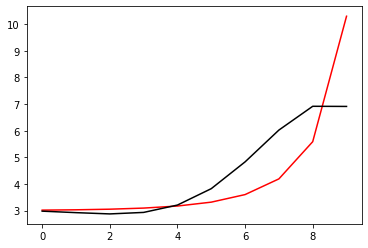

391600 0.000676895172320174
[2.95190974 2.90147683 2.86003616 2.92342389 3.20882674 3.83864744
 4.87278868 6.12321243 7.06231055 7.06223757]


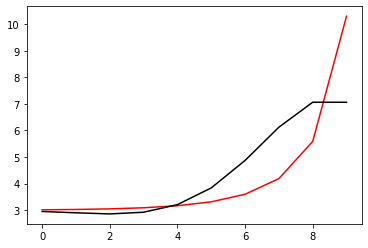

392700 0.01064607365684913
[2.95250223 2.91093781 2.88069138 2.95737875 3.26051688 3.91858819
 5.00609427 6.34858237 7.34414885 7.37242027]


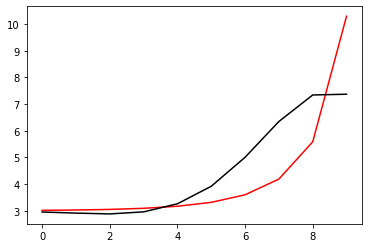

393800 0.014517598491821226
[2.94519976 2.91085231 2.89249323 2.98503032 3.31107847 4.00769388
 5.16958705 6.64179952 7.73089532 7.61449109]


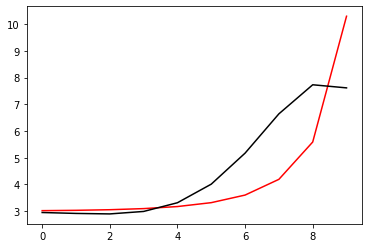

394900 0.010525563494852999
[2.92388234 2.88783383 2.86524028 2.94757295 3.25224954 3.90597695
 4.98208321 6.29072575 7.14160172 7.12137647]


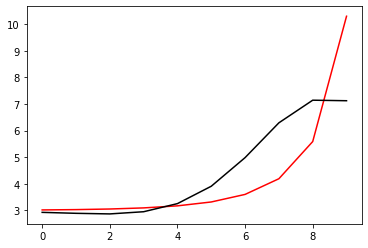

396000 0.060046002233150486
[2.93635825 2.90478721 2.887538   2.97580388 3.28776762 3.95217336
 5.04683473 6.38878654 7.27414676 7.2733565 ]


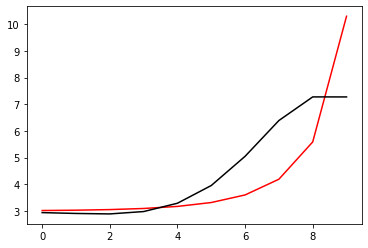

397100 0.01071417131435574
[2.93291374 2.90978647 2.90289114 3.00283362 3.32934518 4.01527484
 5.14729815 6.55477137 7.50811625 7.51064789]


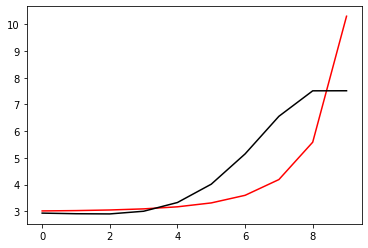

398200 0.028751617803076363
[2.87188844 2.80101977 2.74774187 2.79905094 3.06878815 3.67852676
 4.6947578  5.92531665 6.68061889 6.97770614]


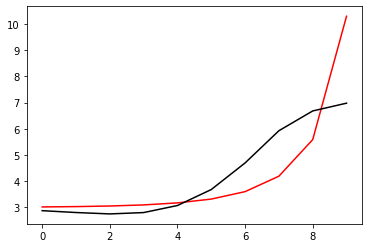

399300 0.010672469830730566
[2.9706173  2.89321243 2.83421975 2.88078836 3.14630494 3.75162429
 4.76173377 5.98237327 6.72204829 6.7127384 ]


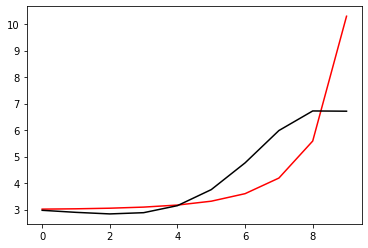

400400 0.0031471343190276196
[2.97697378 2.90603008 2.85364687 2.9081947  3.1843293  3.80587094
 4.84363358 6.11040333 6.90040091 6.88790075]


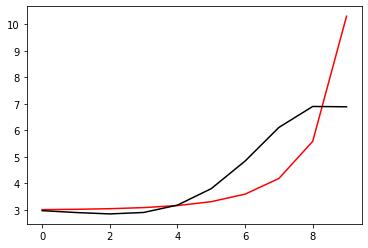

401500 0.007581640695982606
[2.94450251 2.88182771 2.83783008 2.90217822 3.1908748  3.83125289
 4.90175664 6.22692493 7.08711221 7.09083428]


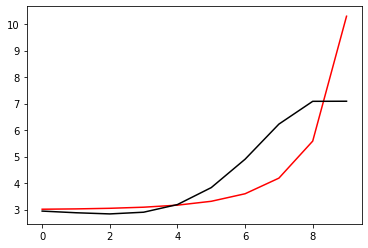

402600 0.6503947860502084
[3.18129553 3.11271647 3.06338546 3.12379782 3.41028927 4.0500746
 5.11663752 6.41483319 7.23166481 7.35235227]


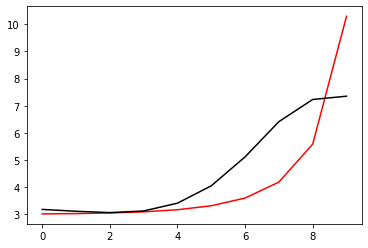

403700 0.010746516978864825
[2.99142096 2.91367079 2.85436372 2.90469651 3.18000237 3.80650733
 4.85965873 6.16409337 7.04187443 7.02959179]


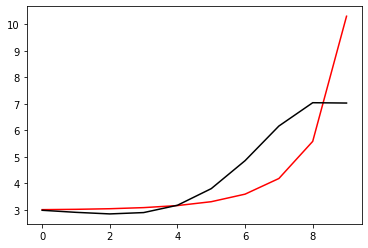

404800 0.05596175654642331
[2.93725763 2.82716686 2.73705585 2.75869079 3.00573487 3.60060854
 4.61006958 5.85185837 6.68629484 6.78269811]


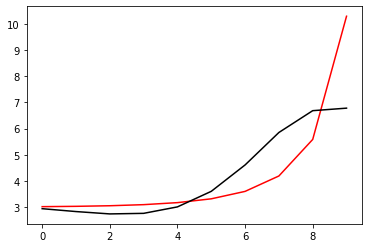

405900 0.010612111441661784
[3.06484555 2.95395788 2.86183843 2.88212857 3.12850439 3.72351263
 4.73484956 5.98395207 6.83164131 6.83031271]


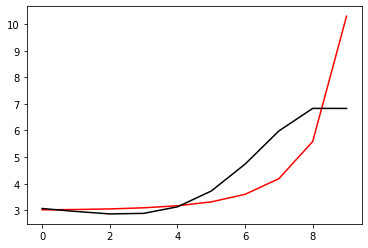

407000 0.05984128191623379
[3.06199685 2.96697586 2.88934592 2.92554794 3.19067095 3.81003563
 4.85663064 6.16008832 7.07680181 7.06997512]


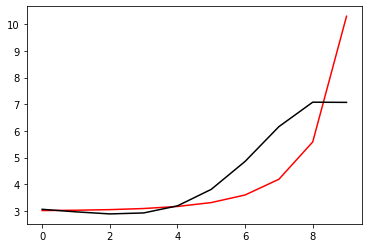

408100 0.010531412799920987
[3.00289245 2.88146427 2.77647821 2.78447412 3.01753586 3.59461947
 4.57797091 5.79001726 6.60492112 6.60227027]


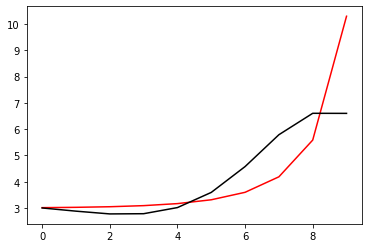

409200 0.016071314186234073
[2.98864164 2.8754029  2.77709594 2.79223186 3.03413445 3.6241357
 4.62959535 5.88096568 6.7452795  6.71370242]


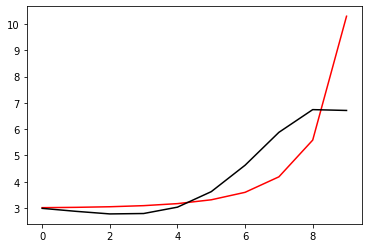

410300 0.010664965941537524
[2.9934436  2.88954274 2.79893252 2.82265582 3.07585378 3.68320396
 4.71932392 6.02610177 6.9594639  6.99298047]


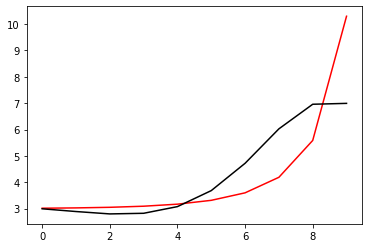

411400 0.002127925988828433
[2.98788862 2.90727812 2.83864429 2.88548072 3.16624838 3.81151596
 4.90734541 6.30900418 7.34539309 7.29177809]


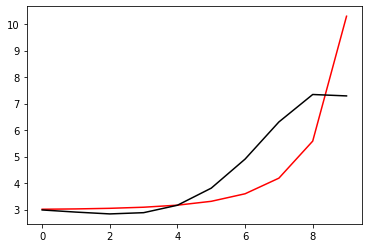

412500 0.008514334458495981
[2.97461061 2.89520735 2.82803873 2.87636598 3.15970498 3.81014518
 4.91903687 6.35623388 7.44923667 7.44633579]


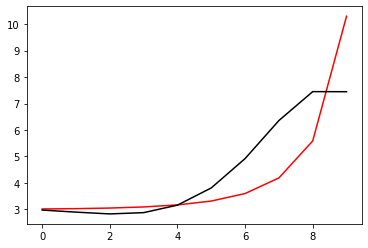

413600 0.007909474691900753
[2.9362246  2.86121488 2.79655551 2.84268917 3.11528874 3.73916036
 4.79272602 6.12916262 7.07205081 7.09726056]


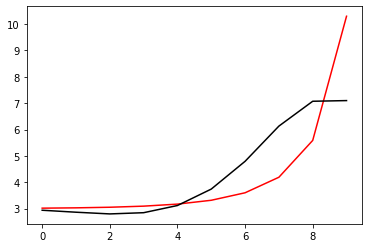

414700 0.010839331785994952
[2.99236912 2.91279369 2.84480879 2.88898214 3.1613848  3.78763559
 4.84800905 6.19901313 7.16276917 7.15946697]


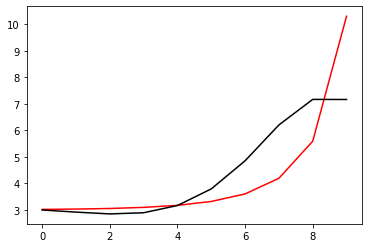

415800 0.01935641041299693
[2.99346856 2.92329733 2.86501945 2.91984545 3.20544846 3.8504945
 4.94102461 6.3408765  7.36428071 7.29976693]


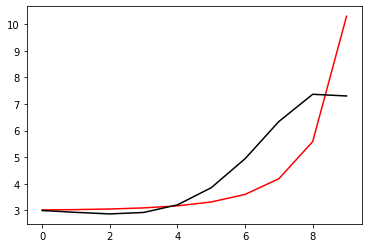

416900 0.04879154681537427
[2.86407395 2.79475452 2.73568847 2.7858856  3.05978526 3.67934756
 4.71741856 6.02129742 6.92640903 6.99162969]


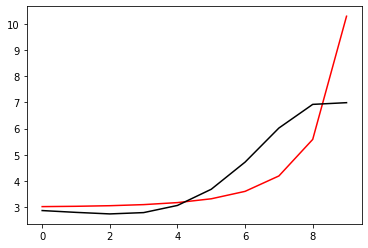

418000 0.060461779987303794
[2.9895986  2.91896867 2.85963203 2.91111811 3.18896341 3.81706086
 4.87119983 6.19682339 7.10430247 7.10737737]


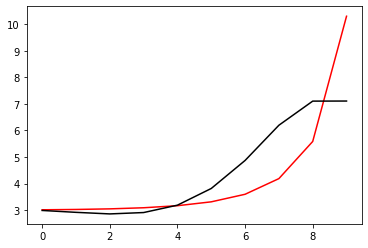

419100 0.01064172143532079
[2.98993224 2.92740026 2.87701771 2.93857915 3.22923637 3.87656618
 4.96466981 6.35004966 7.31950922 7.31821437]


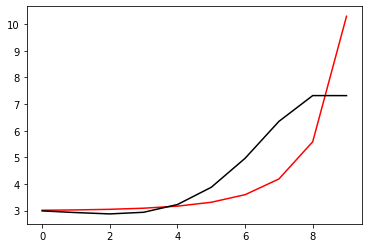

420200 0.011587256754287312
[2.91852097 2.84696352 2.79080239 2.84957477 3.14159418 3.79779097
 4.91241165 6.36346193 7.42698119 7.40037976]


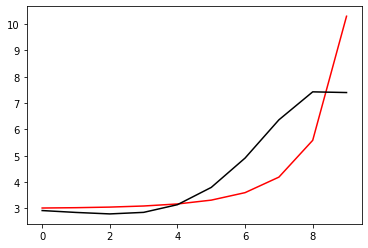

421300 0.6162483866786774
[3.19185368 3.11114956 3.04769241 3.10171747 3.39280816 4.05361244
 5.17895094 6.63881172 7.70682333 7.79385641]


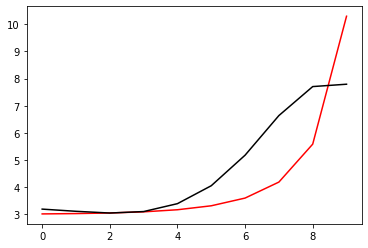

422400 0.0012732734314723306
[2.97269025 2.88137902 2.80642279 2.84888464 3.12775668 3.77512259
 4.88824649 6.35471481 7.48143212 7.47301984]


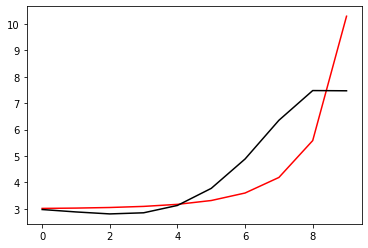

423500 0.0012124400488600744
[3.01967054 2.88137639 2.75651935 2.7450292  2.96056868 3.52236525
 4.4988226  5.74294836 6.68253345 6.67612201]


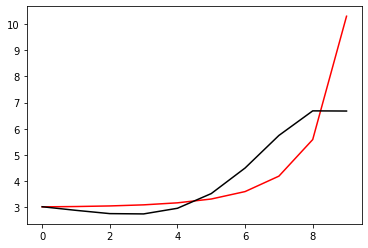

424600 0.0009641018349425903
[3.09522846 2.95816949 2.83375668 2.82399928 3.04336698 3.6124339
 4.60220398 5.86996723 6.84230494 6.80923367]


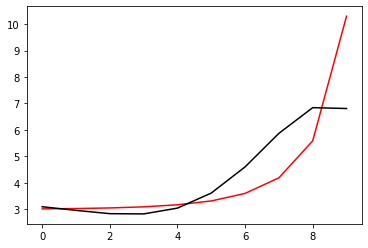

425700 0.010666700375485894
[3.07809732 2.95586392 2.84525576 2.85128654 3.09038633 3.68661816
 4.71713426 6.04666898 7.09477609 7.10392621]


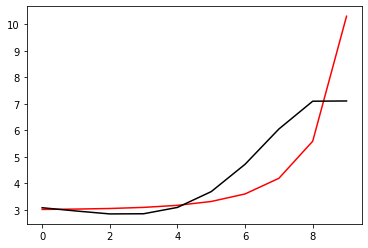

426800 0.019737256285628196
[3.1048848  2.98767407 2.88140573 2.89390409 3.14353384 3.75731665
 4.81839161 6.2016059  7.32165946 7.28913923]


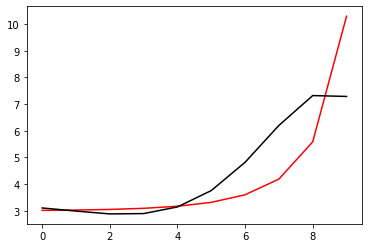

427900 0.03752206326059109
[2.89768111 2.81081533 2.73293486 2.77422241 3.05608964 3.71147503
 4.83656095 6.32448665 7.5690555  7.6941908 ]


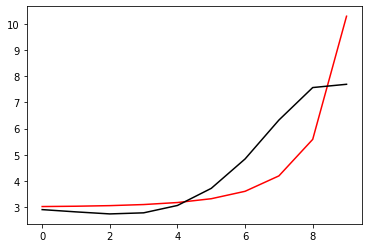

429000 0.0605397292949891
[3.0843638  2.95533542 2.83161648 2.82203794 3.04340394 3.61522773
 4.59791236 5.81747654 6.79637735 6.86194795]


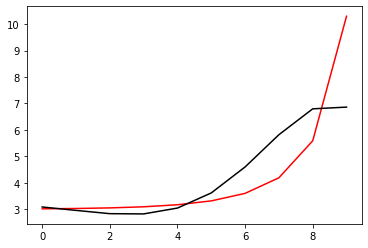

430100 0.010576268049823173
[3.08427744 2.96090448 2.84196656 2.8373652  3.06502526 3.64673695
 4.64849733 5.90371847 6.90688645 6.90774038]


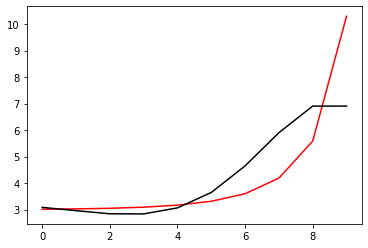

431200 0.014156018123933028
[3.06347087 2.95021907 2.8410105  2.84772581 3.09130965 3.69997319
 4.75477318 6.10543529 7.17603426 7.08310605]


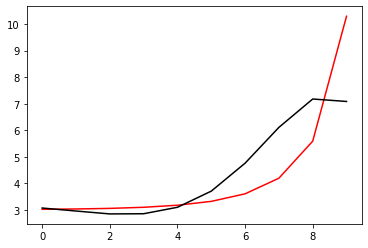

432300 0.010717734520375593
[2.99697033 2.90022757 2.80657921 2.82934631 3.09269978 3.73149104
 4.84251775 6.29468253 7.4463981  7.46733301]


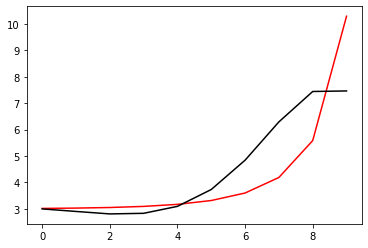

433400 0.004116417156330369
[3.05896137 2.93536668 2.81364797 2.80749388 3.0402645  3.64297922
 4.70032747 6.04958302 7.13619381 7.10966026]


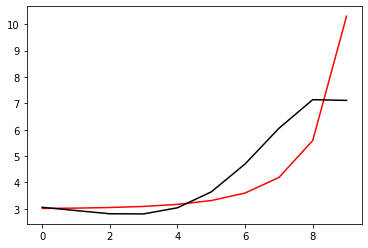

434500 0.01686075940888426
[2.95231156 2.83996097 2.73104571 2.74089244 2.99594345 3.6330219
 4.74733937 6.18912378 7.37967799 7.35331672]


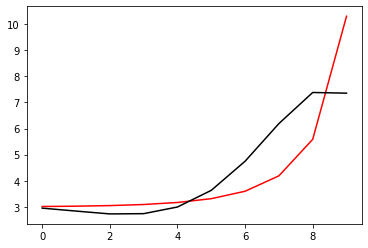

435600 0.0007511504793968021
[3.10146736 2.96745144 2.83302873 2.81364845 3.03324931 3.62157421
 4.6579561  5.97822111 7.06169252 7.02718609]


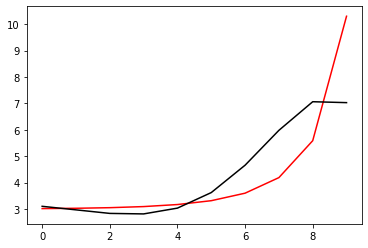

436700 0.011436020242541096
[3.05080291 2.93018111 2.80926379 2.80549333 3.04557013 3.66382842
 4.747403   6.14312114 7.31693129 7.26408298]


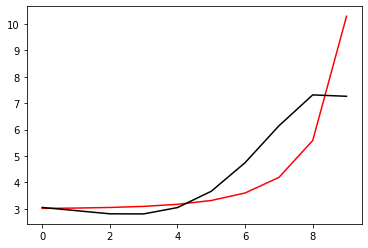

437800 0.057340725710010206
[2.98873425 2.84380135 2.69987011 2.67442343 2.89389223 3.48895034
 4.53332062 5.85970901 6.99568688 7.11296391]


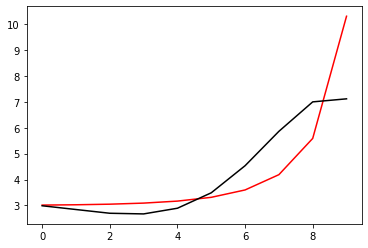

438900 0.010709575179834112
[3.12502024 2.97913789 2.8328989  2.80521902 3.02289679 3.61684077
 4.66175569 5.99447817 7.14111037 7.13880387]


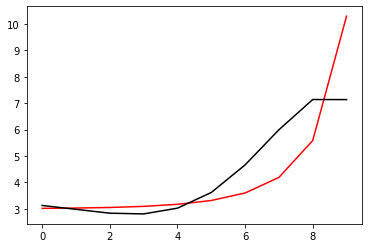

440000 0.06017138676632817
[3.11479899 2.98975518 2.86263485 2.85430369 3.0936859  3.7150335
 4.79890263 6.19091715 7.40819692 7.40483068]


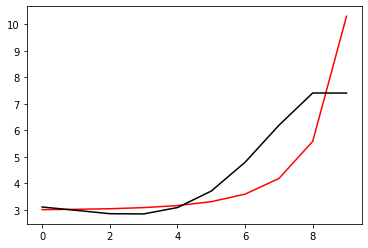

441100 0.010593351985207583
[3.090419   2.94618347 2.79597795 2.75915627 2.96071185 3.52507451
 4.51327601 5.75978615 6.87276981 6.87012664]


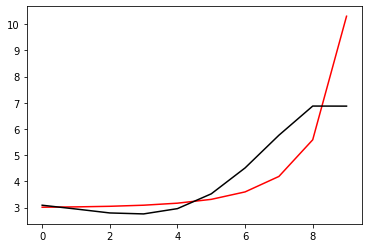

442200 0.016191871639737773
[3.09273966 2.96194841 2.82680092 2.80834294 3.03450826 3.63528446
 4.68163329 6.01663354 7.21802272 7.119216  ]


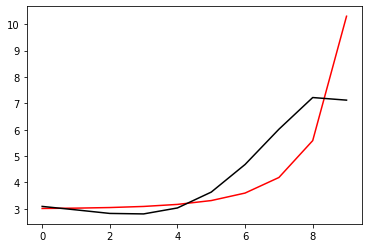

443300 0.010787015365683168
[3.03745629 2.92119242 2.80253625 2.80357592 3.0553027  3.69366256
 4.80149821 6.23512815 7.5370989  7.55405169]


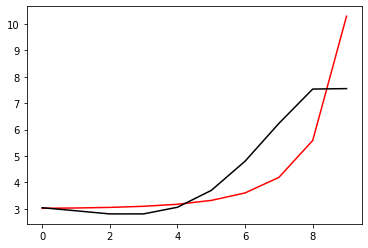

444400 0.00481464421620031
[3.08829516 2.94677602 2.80082914 2.77293904 2.9930704  3.59265279
 4.64042455 5.96222265 7.17626706 7.1180266 ]


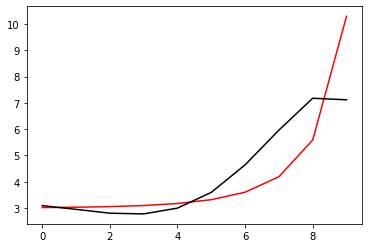

445500 0.006395234639721469
[2.98436848 2.85607338 2.72463891 2.71414312 2.95747723 3.59140255
 4.6945756  6.10581294 7.42235807 7.39915747]


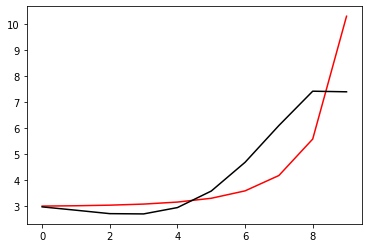

446600 0.0007292234013311421
[3.04297747 2.94335533 2.83577673 2.8418035  3.09066274 3.71087853
 4.76197215 6.04878216 7.1980541  7.13144293]


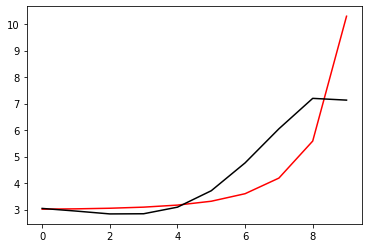

447700 0.010685757257679701
[3.05359776 2.95342857 2.84782698 2.85769911 3.11462742 3.75290307
 4.85031265 6.25365843 7.48781797 7.48653189]


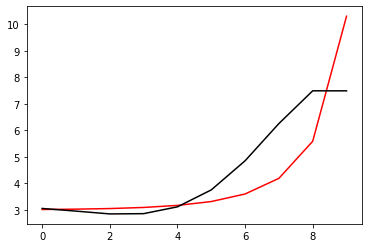

448800 0.029183788406870612
[3.02713464 2.91405592 2.79369116 2.78393933 3.01388013 3.61270312
 4.64948615 5.93779083 7.05464998 7.22591783]


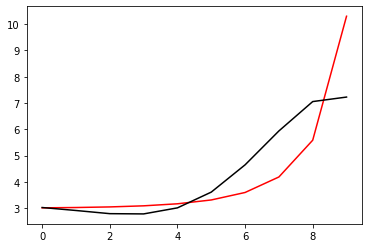

449900 0.010655949903272914
[3.07072135 2.97610798 2.87542605 2.88620652 3.13856122 3.76407448
 4.83556864 6.17106419 7.32556762 7.30831271]


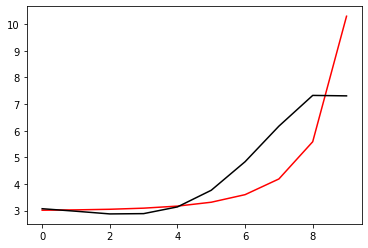

451000 0.06189230006358573
[3.01342747 2.87534755 2.7347462  2.70829777 2.92530726 3.51522112
 4.54537573 5.82559173 6.92401696 6.93228616]


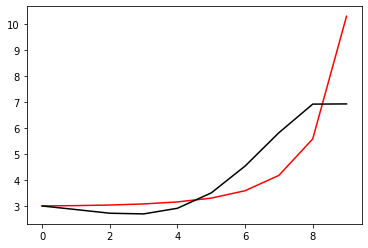

452100 0.010610607761329409
[3.03579959 2.9027842  2.76549498 2.74157358 2.96071964 3.5531596
 4.58819553 5.88178138 7.00194423 7.00287563]


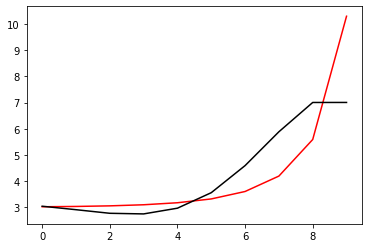

453200 0.014178273056556513
[3.06696157 2.95199945 2.83119262 2.82339802 3.05999434 3.67421723
 4.74084322 6.08660373 7.27511057 7.22898205]


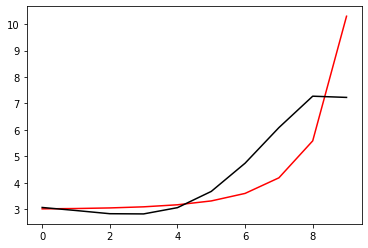

454300 0.010691359157131944
[3.00476549 2.90107302 2.79094208 2.79248018 3.03710605 3.6586488
 4.73472701 6.10484064 7.33157475 7.33382244]


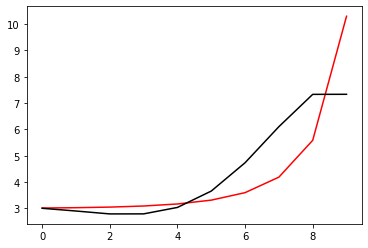

455400 0.0011188871792723798
[2.97270437 2.89123355 2.80668952 2.83610003 3.11398567 3.78123507
 4.928931   6.41517293 7.76897153 7.75024189]


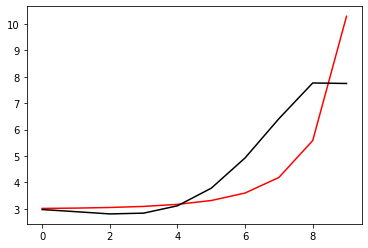

456500 0.0037009115695392962
[3.01210615 2.90278539 2.78921303 2.78612861 3.02347843 3.63102783
 4.6721018  5.96510106 7.11993012 7.10337441]


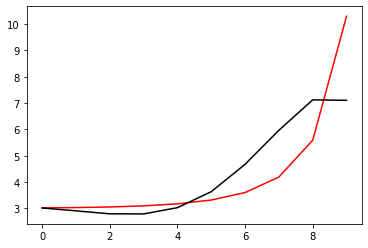

457600 0.0009067978678395216
[3.03052194 2.92928529 2.82385959 2.82966557 3.07824479 3.70274254
 4.77317305 6.11476024 7.31000893 7.30352638]


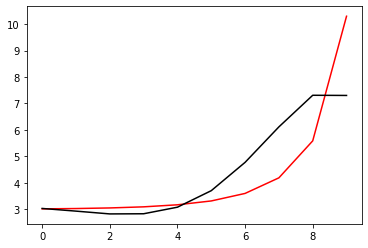

458700 0.010711903593210429
[3.0215626  2.93383617 2.84232746 2.8628067  3.12902571 3.77902126
 4.89279065 6.30670171 7.56555464 7.58528716]


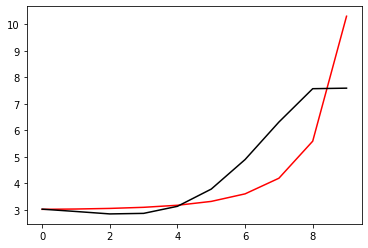

459800 0.02212229001162574
[3.10865254 3.0005315  2.88634458 2.87883016 3.10799702 3.70224936
 4.71537113 5.92781047 7.04522954 7.35960619]


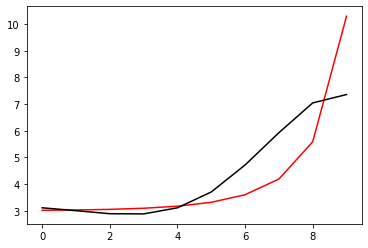

460900 0.010630430362734353
[3.06899879 2.96714554 2.86043397 2.86217647 3.10373471 3.7169606
 4.76306673 6.03392159 7.21215463 7.2066919 ]


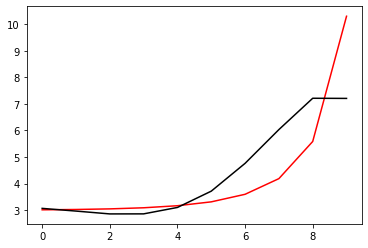

462000 0.06546336625505811
[3.07785509 2.99359623 2.907344   2.93329446 3.20581648 3.86342858
 4.97839569 6.34954845 7.60836185 7.57140285]


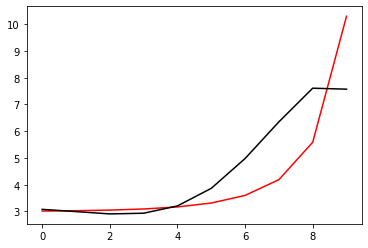

463100 0.010624457722880981
[3.09899903 2.9892592  2.87653626 2.87350571 3.11183698 3.72396496
 4.76783229 6.02498912 7.21388582 7.2128738 ]


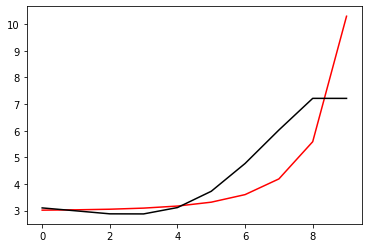

464200 0.009730652172319646
[3.02607322 2.92780692 2.82930549 2.84452733 3.10770728 3.75716062
 4.86210093 6.21794698 7.50423991 7.46900298]


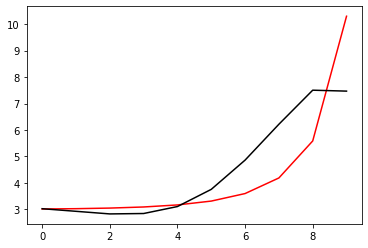

465300 0.010761644157186117
[3.0429759  2.90855871 2.77093799 2.74292792 2.95456782 3.53357186
 4.52161786 5.66582822 6.79918466 6.78556942]


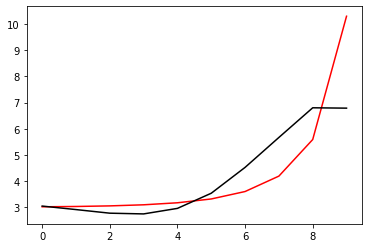

466400 0.0070722118232899814
[3.03351678 2.91021677 2.7831858  2.7666833  2.9918334  3.58880934
 4.60466311 5.79736655 6.98399691 6.94840255]


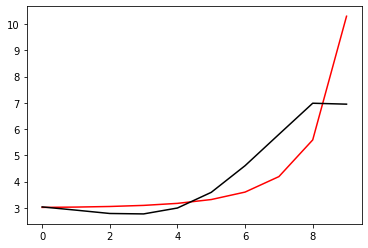

467500 0.010448547730518237
[3.05590155 2.94731497 2.83498402 2.83479954 3.07982213 3.70418069
 4.76299891 6.02883499 7.29031473 7.30191213]


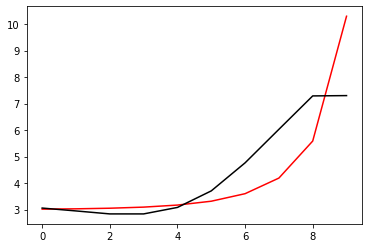

468600 0.0008501262879292914
[3.0082965  2.91137249 2.81437894 2.83276025 3.10168127 3.75959872
 4.87066864 6.2253091  7.57370329 7.64053338]


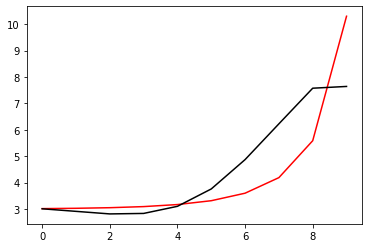

469700 0.042297320806917005
[2.95638383 2.84756819 2.7378336  2.7392412  2.98303572 3.59922401
 4.63053858 5.82817415 7.05089603 7.47846384]


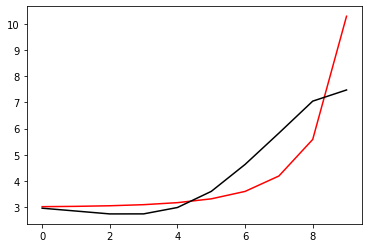

470800 0.024292187313163262
[3.0865633  2.97193064 2.85636961 2.85276119 3.09236406 3.70545004
 4.73679331 5.94539548 7.17837101 7.13732076]


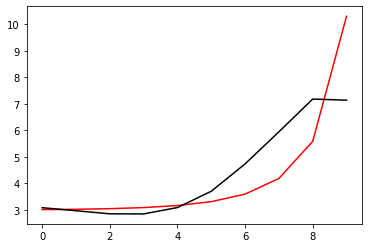

471900 0.010672106914740985
[3.04087798 2.93720725 2.83382707 2.845333   3.10531701 3.7489892
 4.83110408 6.12597947 7.44949252 7.45868755]


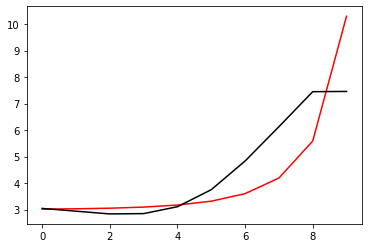

473000 0.060549348019681745
[3.07863185 2.94724932 2.81416838 2.79273507 3.01277379 3.59910595
 4.57796771 5.6810952  6.89601835 6.92702548]


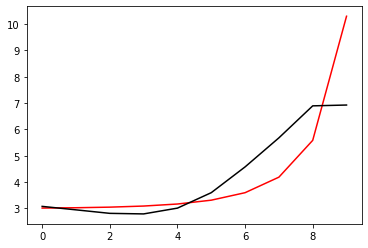

474100 0.010594329956360412
[3.10635151 2.98900804 2.87006066 2.86403929 3.10178026 3.71034714
 4.72097239 5.87400041 7.13171377 7.13326218]


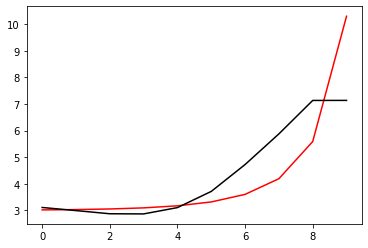

475200 0.010843602450085628
[3.04156296 2.94134885 2.8419258  2.85922273 3.12663273 3.77673061
 4.85227787 6.10928215 7.46439899 7.43654523]


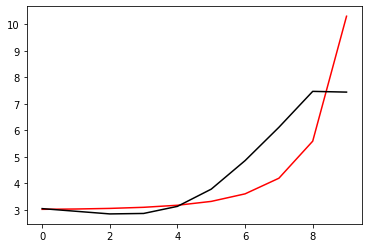

476300 0.01087327133610376
[3.05248328 2.91842838 2.7828201  2.76057385 2.98129962 3.5675641
 4.5363977  5.59857158 6.81439393 6.79292313]


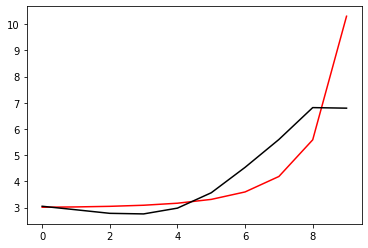

477400 0.003904074573222226
[3.04486334 2.92586703 2.80654202 2.80359804 3.04886806 3.66924838
 4.68996548 5.83234986 7.12245193 7.09619844]


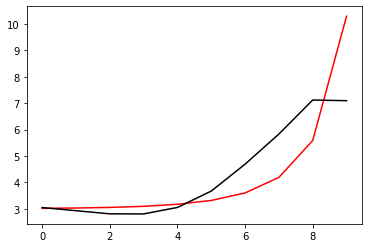

478500 0.023647333832365797
[2.93195037 2.82919754 2.72905626 2.74947294 3.02510669 3.68885695
 4.77896182 6.03500103 7.43117807 7.41462409]


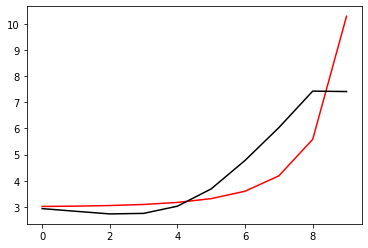

479600 0.010557497899870897
[3.02435142 2.8871553  2.74789823 2.72294008 2.94133905 3.52201613
 4.46925739 5.47131322 6.67727631 6.67497679]


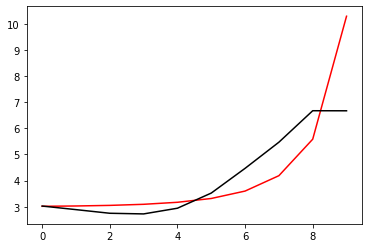

480700 0.014116697007016467
[3.07291851 2.94199096 2.80893223 2.79207173 3.02218333 3.62128033
 4.60046455 5.66013209 6.92095955 6.87311374]


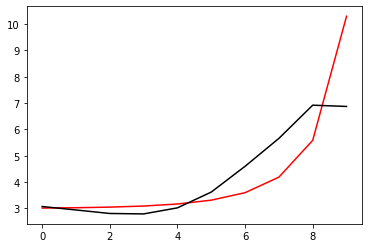

481800 0.02148184780705067
[3.08478871 2.97518304 2.86410259 2.87165782 3.13105674 3.76889192
 4.80576844 5.95570111 7.29134626 7.24314769]


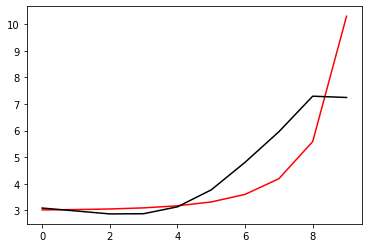

482900 0.017348300954396295
[2.98851246 2.85152504 2.71425382 2.69553687 2.92631449 3.52718779
 4.50444302 5.558744   6.80267822 6.84894576]


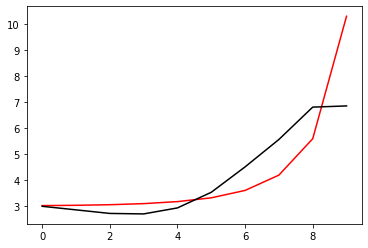

484000 0.06054268259950362
[3.13211668 2.98523793 2.83832873 2.81138584 3.03534714 3.63080675
 4.60567765 5.66682126 6.91552306 6.91680168]


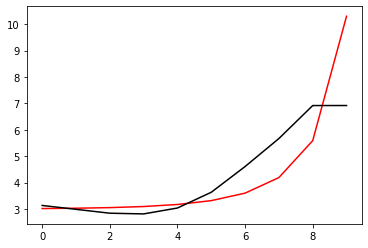

485100 0.010613200931326797
[3.1213259  2.99036159 2.85801023 2.84613907 3.08728803 3.70508729
 4.71459217 5.83578408 7.14752457 7.14715414]


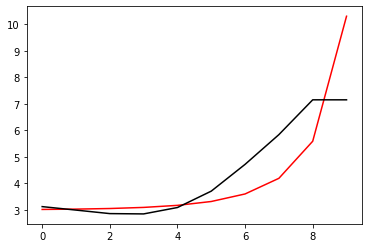

486200 0.01035401817806912
[3.04457271 2.9328446  2.82084338 2.83284606 3.10545814 3.76967384
 4.85515398 6.10130397 7.53970671 7.40430913]


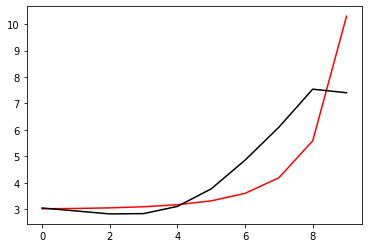

487300 0.010807134381993407
[3.06389444 2.91240564 2.761237   2.73416413 2.9653188  3.57899282
 4.59072729 5.73198762 7.08284277 7.07086556]


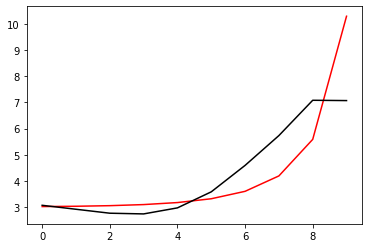

488400 0.003463717226642967
[3.06428775 2.92850762 2.79204479 2.78060097 3.03014114 3.66823036
 4.71730983 5.91980496 7.33545977 7.31498565]


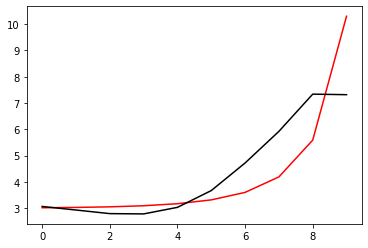

489500 0.036351785128143285
[2.93807144 2.82126693 2.7044517  2.71465451 2.99049574 3.66470542
 4.77143349 6.07126914 7.58874154 7.56779557]


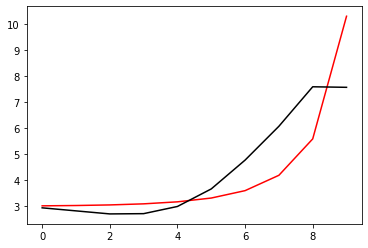

490600 0.005834751911991187
[3.09906566 2.93981509 2.77868473 2.74216663 2.96503363 3.57115759
 4.57903746 5.74001735 7.11498534 7.10100874]


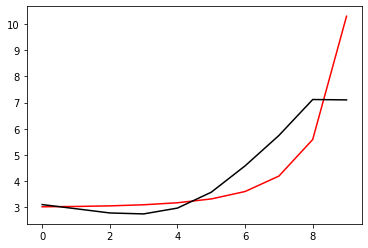

491700 0.010714037455065228
[3.11487773 2.97132257 2.82400295 2.80142569 3.04005016 3.66663867
 4.70596815 5.91985495 7.35280177 7.36219291]


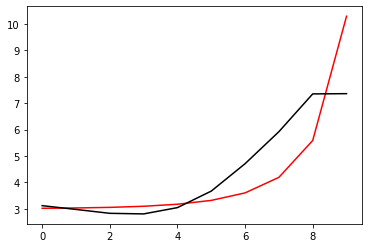

492800 0.027969061490108502
[3.16263025 3.00005676 2.83066555 2.78313725 2.992582   3.58138876
 4.56737811 5.71480971 7.09316538 7.07890708]


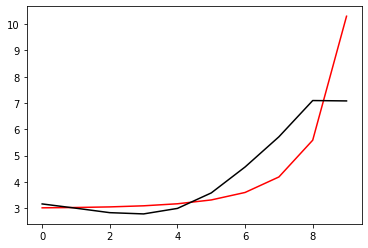

493900 0.010704583214371352
[3.14227044 2.9947911  2.84031244 2.80923781 3.03855535 3.6542839
 4.68184132 5.8953544  7.33807236 7.34153715]


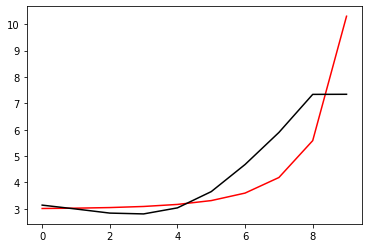

495000 0.3624773226049112
[3.21382214 3.09525654 2.96777677 2.96299279 3.21902737 3.86195534
 4.90375535 5.92216699 7.07422583 7.42879641]


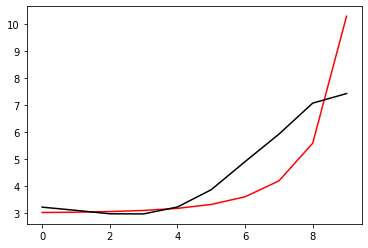

496100 0.010545205559123985
[3.04089706 2.91527756 2.77915024 2.76209494 2.9985627  3.60676512
 4.58348457 5.51224542 6.71958523 6.71911855]


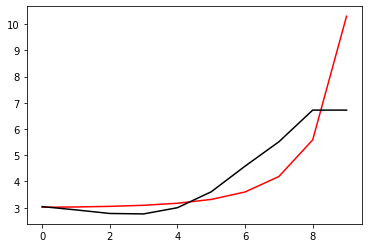

497200 0.017213234078059785
[3.03224406 2.91243439 2.78222269 2.77154028 3.01622938 3.63728712
 4.63770549 5.61394886 6.86047699 6.82254913]


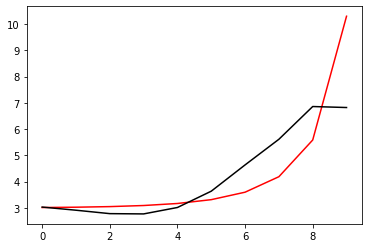

498300 0.011194529730563754
[3.05426985 2.94560333 2.82717079 2.82931324 3.09043347 3.73648939
 4.78034557 5.83437799 7.13401346 7.15337628]


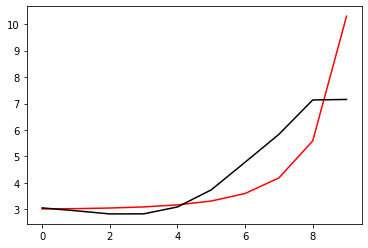

499400 0.002007096001044636
[2.99947826 2.90995865 2.81156945 2.83361691 3.11724738 3.79412488
 4.88977897 6.04298748 7.41759128 7.37423203]


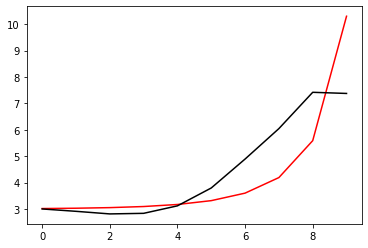

In [12]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

0 0.4674125417319872
[3.14306553 3.06276227 2.97499804 3.008205   3.30533451 4.00160314
 5.12902369 6.33536226 7.73796093 7.64847456]


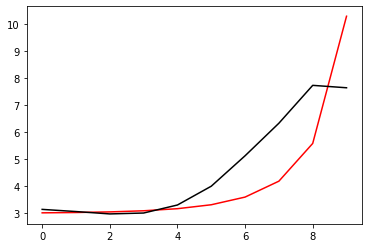

1100 0.010691611864176708
[2.98134072 2.90463339 2.82076002 2.85746268 3.15791977 3.85788301
 4.99085205 6.21056822 7.6290106  7.62847267]


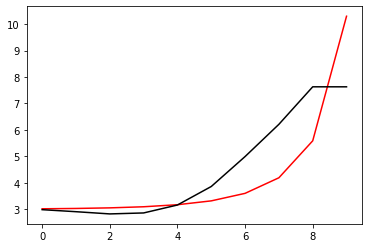

2200 0.007478378640678141
[2.95953491 2.89175451 2.81839419 2.86575041 3.17804288 3.89324466
 5.04964819 6.31531932 7.78847558 7.73234935]


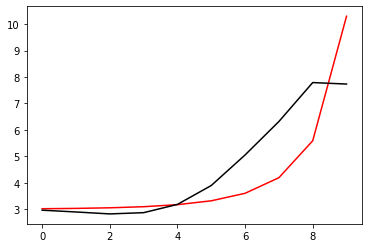

3300 0.010929938973192782
[3.04529738 2.93628153 2.82452789 2.83443002 3.1081456  3.77972302
 4.88251861 6.0906487  7.49852004 7.4871807 ]


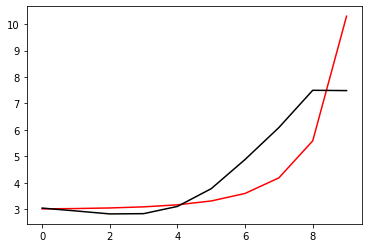

4400 0.0016533796249014131
[3.00692021 2.90711067 2.80546718 2.82629984 3.1126835  3.80120841
 4.9310229  6.19223565 7.66080233 7.64786298]


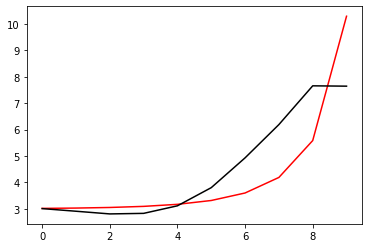

5500 0.017110533624378702
[2.91329737 2.82729439 2.74284699 2.78352191 3.09424185 3.81655639
 5.00039599 6.36096644 7.93768382 7.91958928]


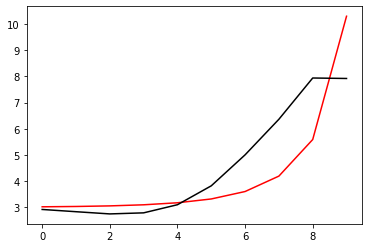

6600 0.009068902741489767
[3.01638467 2.890489   2.76321455 2.75627363 3.00936487 3.65272953
 4.71481416 5.89314375 7.27309161 7.26181913]


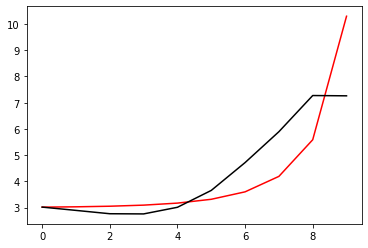

7700 0.013684002089622869
[3.02453821 2.90746204 2.78856381 2.79045747 3.05377117 3.71117516
 4.79678209 6.02275152 7.45566679 7.42022231]


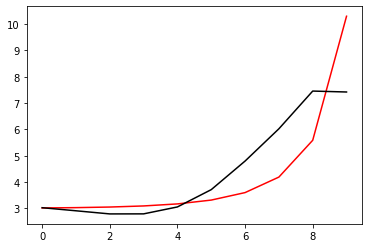

8800 0.060345632802190394
[2.99262992 2.84546543 2.69409098 2.6595586  2.87828947 3.47297556
 4.45469966 5.51310209 6.81142319 7.20228384]


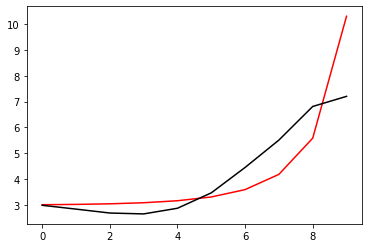

9900 0.014242554029732207
[3.00689601 2.86060055 2.70908277 2.6742445  2.89248564 3.48686305
 4.47034951 5.53926359 6.84834197 6.82300102]


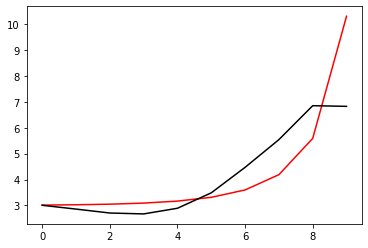

11000 0.06054573723056267
[3.15272846 3.00289884 2.84652156 2.8064788  3.01872276 3.60587795
 4.58216246 5.65262291 6.95585102 6.95759013]


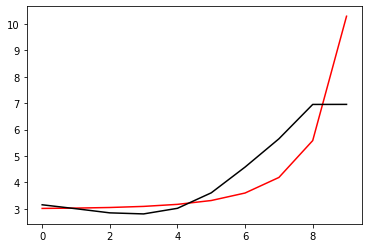

12100 0.01063966174022595
[3.09360279 2.95524605 2.81084972 2.78579945 3.01865478 3.63779138
 4.66945076 5.83853775 7.24259618 7.24485799]


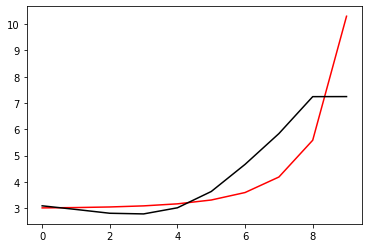

13200 0.023399855271210572
[3.13215155 2.96178216 2.78373711 2.72424971 2.92040085 3.49529927
 4.46046003 5.5212314  6.84862857 6.80059377]


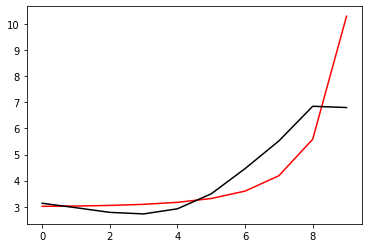

14300 0.011389211114119608
[3.11148817 2.9554786  2.79262097 2.75167577 2.97247261 3.58399483
 4.60949096 5.76926367 7.18550599 7.13426129]


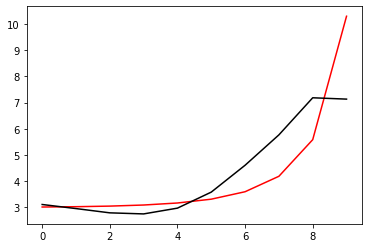

15400 0.0023400429251566957
[3.05491261 2.91393635 2.76698751 2.74588377 2.99445589 3.64994838
 4.75186447 6.03843117 7.55943051 7.52991405]


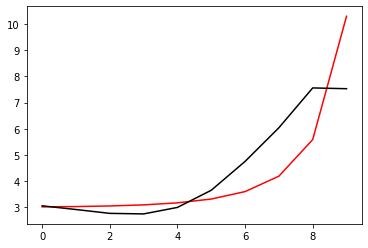

16500 0.0059254706351282655
[3.09237917 2.92923342 2.75825673 2.71239135 2.9347721  3.55888786
 4.61032972 5.79648391 7.24623037 7.23381681]


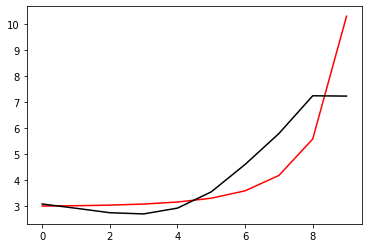

17600 0.001091709602990299
[3.167291   3.00935253 2.84367615 2.80512841 3.03884151 3.68169663
 4.76627101 6.01235377 7.50183558 7.53827589]


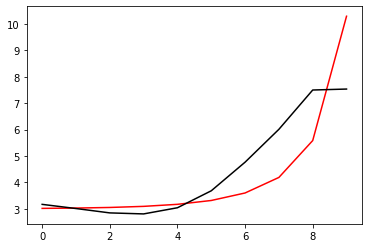

18700 0.11077875634164161
[2.97221425 2.80101994 2.6226918  2.57318097 2.79835548 3.43555871
 4.51364952 5.73198856 7.17944674 7.60135217]


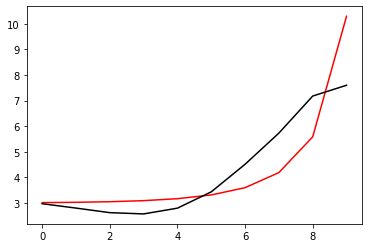

19800 0.028595559418985582
[3.17385447 2.9881709  2.79464363 2.73064447 2.94177439 3.56453903
 4.62789154 5.8368507  7.27132485 7.2517658 ]


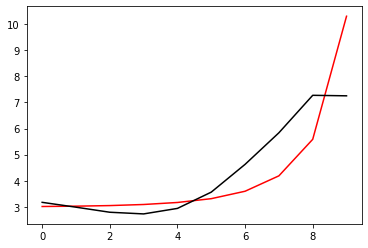

20900 0.010821851170562379
[3.16928315 3.00249048 2.82533128 2.77752102 3.00640432 3.65143576
 4.74790374 6.01395316 7.50987006 7.51737102]


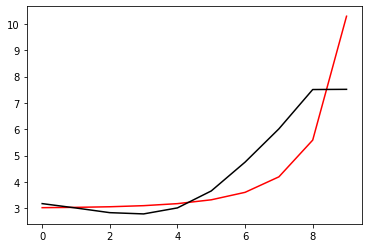

22000 0.060620939183032053
[3.12787681 2.93974098 2.73923992 2.66562364 2.86327779 3.46413357
 4.48918222 5.64474167 6.99599423 7.0069341 ]


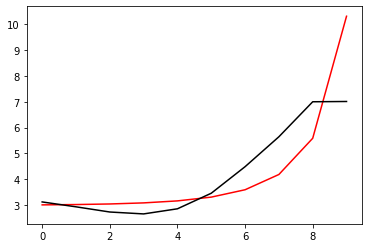

23100 0.010709115760059264
[3.12496003 2.94196846 2.74531645 2.67538624 2.87746584 3.48515254
 4.52367671 5.70787114 7.08427764 7.0852639 ]


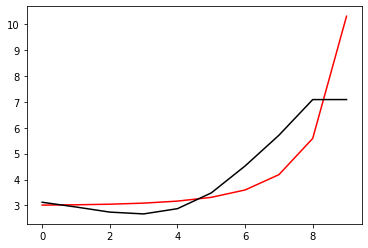

24200 0.01664575858517305
[3.11263356 2.94018075 2.75255799 2.6920369  2.90608617 3.53248129
 4.60609322 5.8570226  7.29066405 7.22573806]


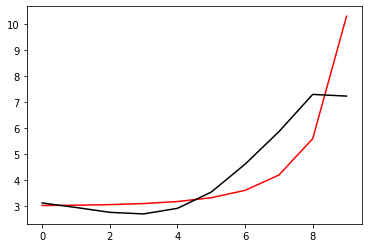

25300 0.010969467398540647
[3.10144133 2.9461793  2.77375133 2.72835513 2.96058789 3.61399285
 4.73647131 6.0772406  7.58074059 7.63089332]


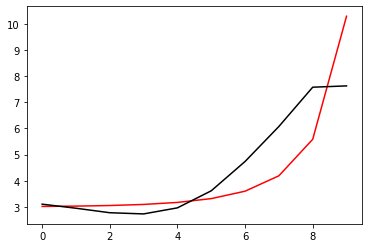

26400 0.012540140772587525
[3.06426892 2.91853164 2.75156249 2.70438511 2.92194211 3.53488619
 4.55612202 5.53301345 6.71575797 6.76797765]


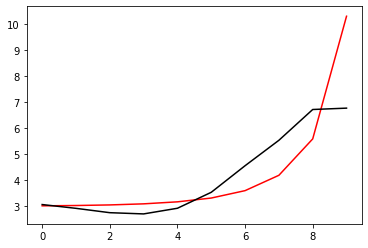

27500 0.0014110233577671223
[3.04411119 2.90276067 2.73987365 2.69656656 2.91855575 3.53798916
 4.57126072 5.57604698 6.7856281  6.77444775]


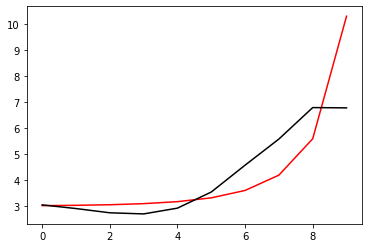

28600 0.010602377419589038
[3.02876606 2.89364878 2.73643559 2.69801145 2.92494163 3.55091375
 4.59616382 5.63328833 6.87135481 6.87306062]


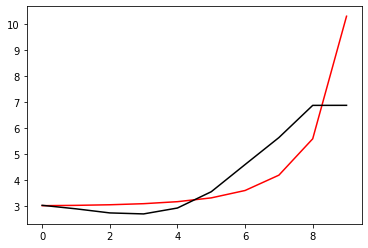

29700 0.010705675507212459
[3.10661276 2.97905391 2.83027544 2.80101326 3.0399825  3.68479734
 4.76307915 5.86469111 7.14100608 7.15344846]


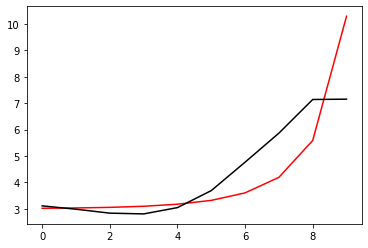

30800 0.09514624547772801
[2.94576186 2.80146092 2.63747899 2.59194191 2.81261469 3.43495311
 4.4832384  5.55598309 6.76265202 6.93056096]


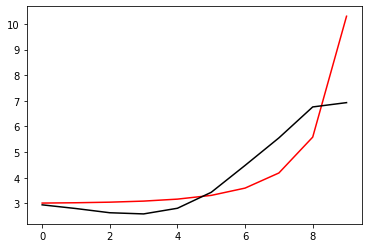

31900 0.005059620791830018
[3.02890227 2.87874892 2.70936292 2.65869887 2.87417977 3.49060172
 4.53145633 5.59907208 6.79455701 6.77414685]


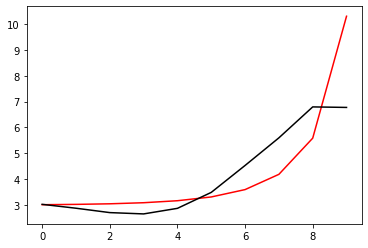

33000 0.06061429818149807
[3.14941625 2.99446374 2.82118383 2.7679977  2.98286517 3.60160115
 4.64997184 5.73980493 6.95266955 6.95239503]


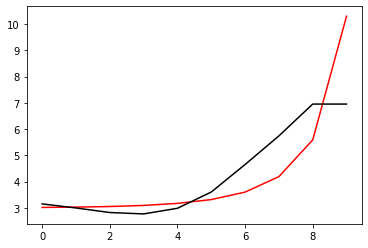

34100 0.010680496767831647
[3.14027357 3.0011453  2.84291643 2.80474749 3.03669208 3.67870963
 4.76497146 5.92815492 7.21687382 7.22178563]


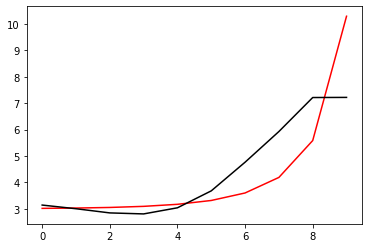

35200 0.00965541789419592
[3.0599326  2.9391491  2.80114721 2.78563074 3.04716504 3.73485106
 4.9006379  6.21018739 7.64616098 7.50748155]


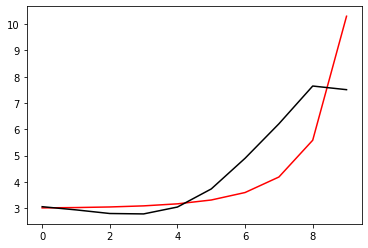

36300 0.010785759784841215
[3.06157979 2.90375811 2.7293323  2.67648788 2.89755534 3.53576143
 4.62834557 5.82856432 7.16999384 7.16147807]


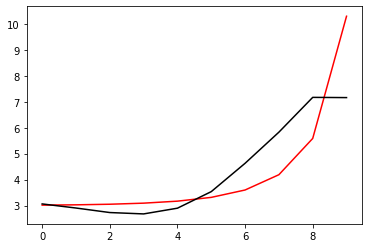

37400 0.004251782469211903
[3.0969454  2.95168698 2.78821308 2.74538204 2.97651529 3.62686513
 4.73810104 5.97765089 7.361134   7.30985185]


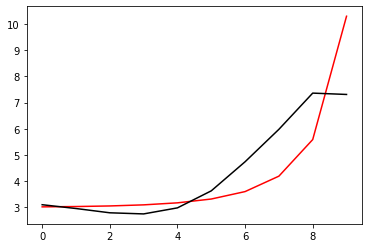

38500 0.031359062129973476
[2.96225193 2.83691824 2.69482142 2.6745923  2.93194021 3.6175032
 4.78398691 6.12346623 7.61507457 7.59075953]


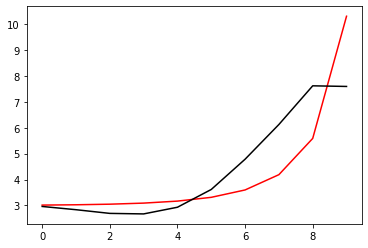

39600 0.0009205068403272034
[3.1193779  2.97235757 2.8059878  2.75795055 2.981071   3.61874412
 4.70812762 5.93367146 7.32201446 7.27830684]


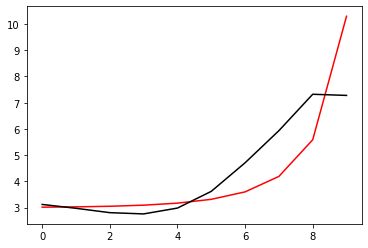

40700 0.1106639517610755
[2.98094228 2.81177226 2.62554432 2.55962239 2.76655774 3.38890733
 4.46203827 5.67831244 7.05823107 7.44708743]


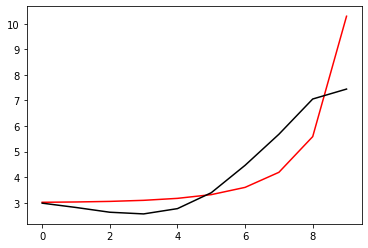

41800 0.029818282368317437
[3.17066411 2.98591288 2.78368493 2.70230217 2.89371276 3.49938058
 4.55429366 5.75671885 7.11760399 7.10739112]


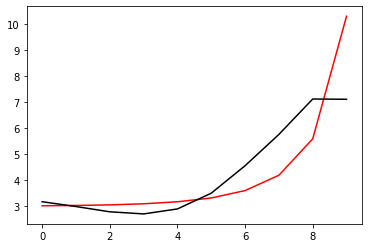

42900 0.010836203439945442
[3.18454948 3.01581657 2.82810894 2.76149881 2.96938746 3.59650875
 4.685012   5.94895181 7.3793387  7.39392474]


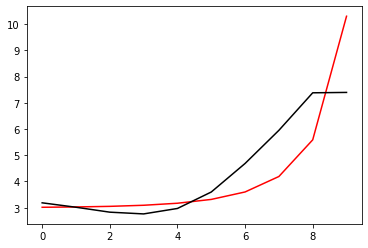

44000 0.060703446415356264
[3.12611606 2.97111388 2.79704733 2.74601425 2.97430367 3.6326889
 4.77620115 6.14367755 7.68752598 7.67972452]


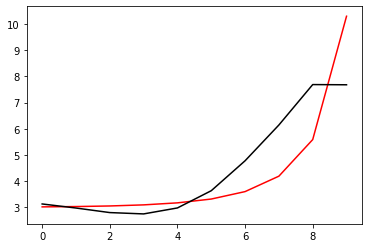

45100 0.010675606115318037
[3.07811447 2.89188338 2.68839418 2.61034119 2.81386091 3.44744294
 4.55669991 5.86830728 7.36878551 7.36273449]


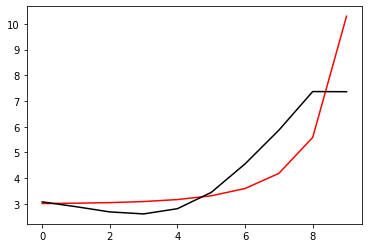

46200 0.015167790361596977
[3.10762613 2.93105595 2.73447977 2.66204721 2.87055506 3.50975792
 4.62900621 5.96610327 7.49546942 7.45172519]


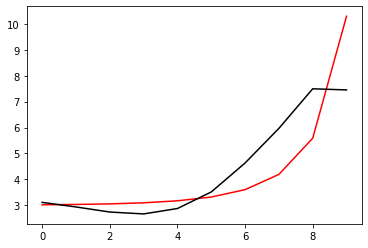

47300 0.010864663576410754
[3.08298909 2.92760111 2.74981332 2.69478486 2.92103939 3.58178169
 4.73457171 6.13561624 7.73522567 7.76338451]


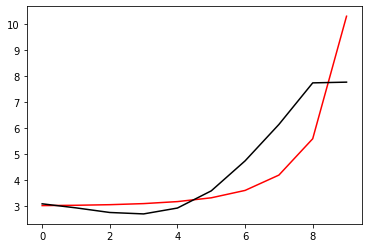

48400 0.008367329087585633
[3.11877276 2.94432518 2.74371738 2.66092638 2.85130397 3.46038849
 4.53098316 5.81237071 7.31302553 7.26965732]


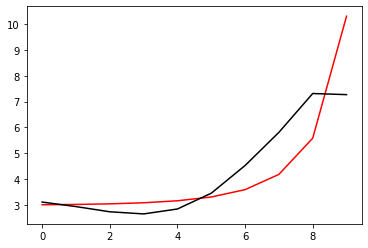

49500 0.010654712398617757
[3.14396283 2.98665846 2.80271994 2.73675253 2.94563093 3.57844473
 4.68653522 6.03540728 7.59682119 7.61245076]


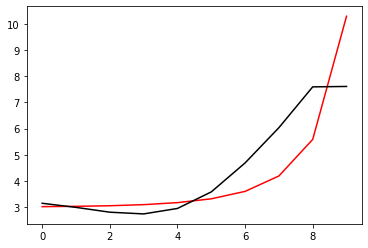

50600 0.6122148445714503
[3.30685751 3.16085792 2.99101267 2.94104444 3.16939107 3.82597364
 4.95327908 6.28908416 7.82061605 7.97278361]


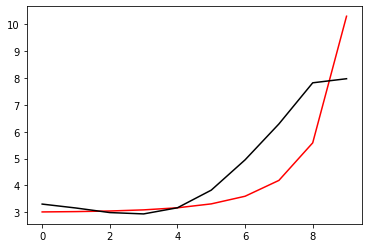

51700 0.010856740808582017
[3.1713076  2.99810681 2.80061205 2.72273483 2.92179031 3.54590812
 4.63892444 5.9555802  7.49445228 7.48315175]


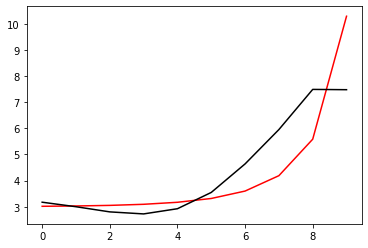

52800 0.027948224677044237
[3.11324966 2.95430861 2.7713122  2.7094877  2.92853619 3.58147945
 4.7221964  6.12078447 7.74787397 7.72103032]


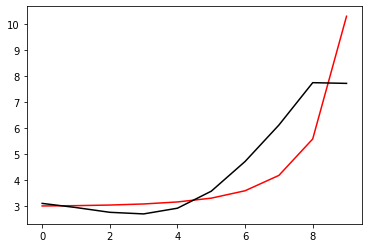

53900 0.010886311275840992
[3.20166457 3.02746817 2.82653839 2.74276696 2.93341395 3.54488849
 4.61635842 5.90757385 7.45128014 7.43446233]


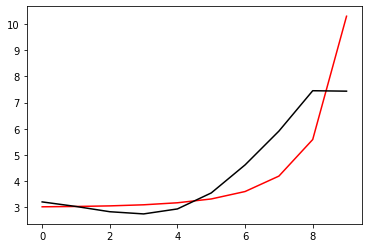

55000 0.0606222358215425
[3.16530032 3.00668543 2.82193542 2.75570441 2.96689261 3.60579588
 4.72009933 6.08109018 7.68791555 7.69148152]


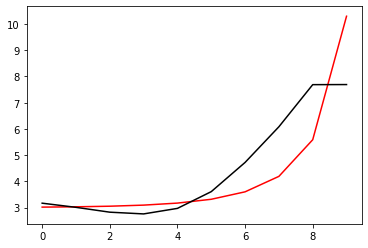

56100 0.010609862717461572
[3.05250725 2.91747046 2.75075106 2.69482247 2.90442864 3.51834207
 4.54235397 5.60192165 7.04956264 7.10031803]


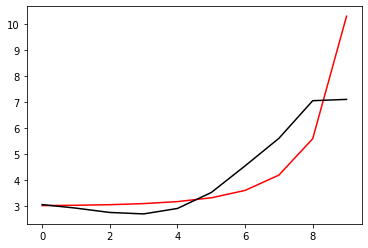

57200 0.01594204744461258
[3.04919345 2.91985907 2.75943676 2.7101168  2.92807225 3.55632813
 4.61716777 5.78339452 7.21906026 7.17464925]


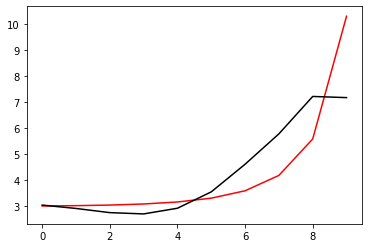

58300 0.010979904091874262
[3.07558185 2.95736703 2.80996717 2.77545652 3.0137897  3.67869784
 4.82779031 6.1901764  7.59256642 7.61491605]


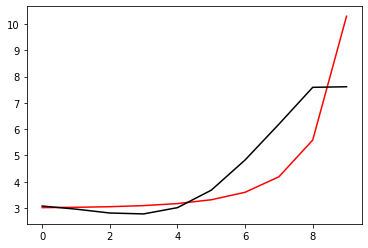

59400 0.0011267129386182085
[2.99871168 2.89940321 2.77455281 2.76376057 3.03018994 3.73815293
 4.97771379 6.52218239 7.97075003 7.96208833]


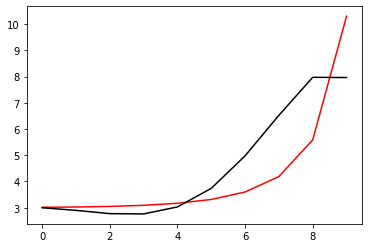

60500 0.0013489909652876393
[2.98445373 2.89057942 2.76973049 2.75724314 3.0110824  3.68393271
 4.83419924 6.16846269 7.37828691 7.35339903]


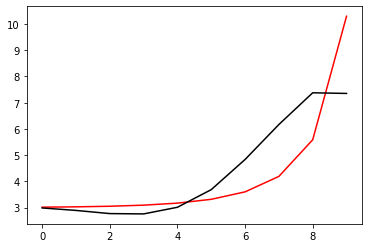

61600 0.0009862214237747035
[2.99276896 2.90838757 2.79985617 2.80134605 3.07336825 3.77639666
 4.98966369 6.43183847 7.64417748 7.62512826]


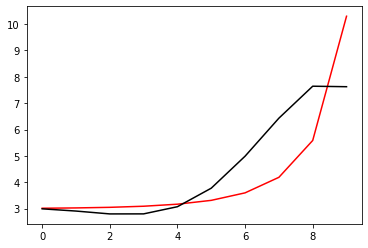

62700 0.4480785068054905
[2.71189341 2.63548224 2.53913083 2.55397035 2.84179791 3.56945994
 4.83456591 6.37001595 7.60576602 7.98420931]


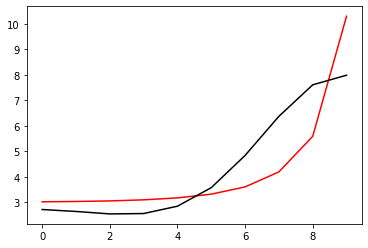

63800 0.01822655495183102
[3.004283   2.93455994 2.84393239 2.86102576 3.14508877 3.85732473
 5.07881979 6.49920996 7.5159043  7.43628779]


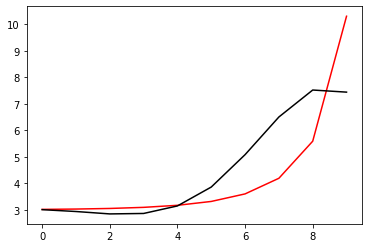

64900 0.010818683035765568
[2.98946596 2.92752056 2.84781376 2.87732351 3.17697788 3.91399274
 5.18618374 6.7184367  7.80404281 7.81180271]


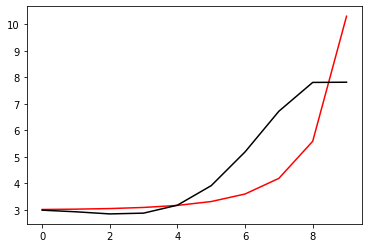

66000 0.06058120537185349
[2.95872206 2.9035917  2.82867479 2.85559368 3.1391441  3.83447467
 5.01178824 6.35513695 7.17728179 7.33154407]


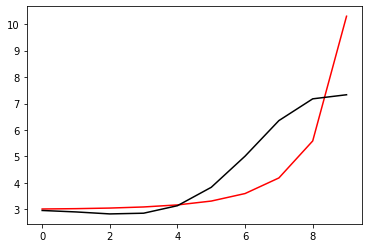

67100 0.01069960126739987
[2.96246882 2.90994051 2.83877952 2.86978248 3.15821389 3.86107608
 5.05348378 6.42845012 7.26713935 7.26768241]


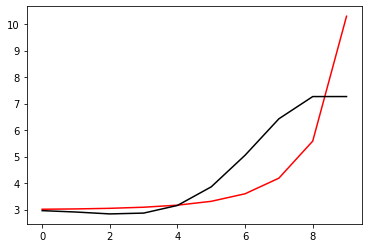

68200 0.0055541224488092665
[2.95278341 2.90553531 2.84204241 2.88182697 3.18138144 3.90208971
 5.13050605 6.57742158 7.45805693 7.40905058]


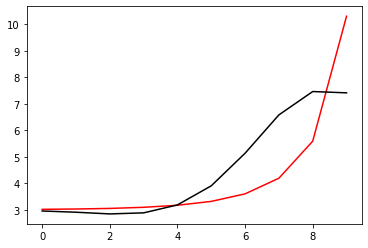

69300 0.010815900646088766
[2.90531885 2.86655678 2.81557797 2.86934996 3.18570449 3.93197221
 5.21054784 6.75975786 7.71438891 7.73524421]


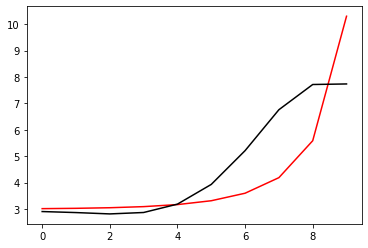

70400 0.00114248100371245
[2.95467667 2.89107919 2.81847345 2.85106229 3.14417383 3.86157082
 5.09841484 6.58523845 7.48671026 7.48306176]


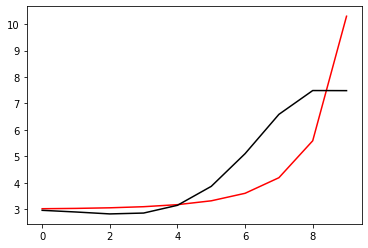

71500 0.001454787103330297
[2.94569817 2.86717547 2.7838909  2.80854696 3.09543141 3.80910729
 5.04920548 6.56849835 7.53515031 7.53520599]


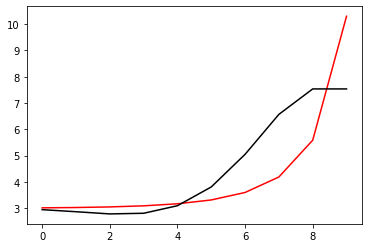

72600 0.6705214640737643
[3.1736284  3.09840858 3.02247313 3.05797884 3.35955349 4.09513641
 5.36997195 6.94177973 7.9313389  7.89114108]


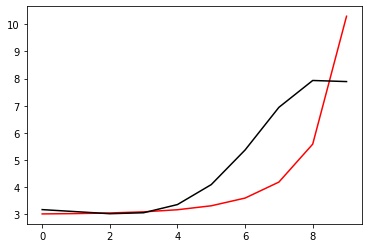

73700 0.01084388770905504
[2.99077071 2.90512015 2.81979097 2.84645515 3.13796105 3.86095087
 5.12130776 6.69388985 7.72737979 7.71724421]


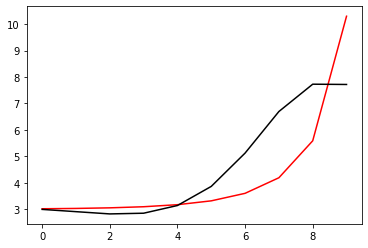

74800 0.05188866610088655
[3.12443378 3.01792315 2.91155618 2.91516043 3.17671905 3.852847
 5.02341929 6.41123685 7.24735677 7.57681742]


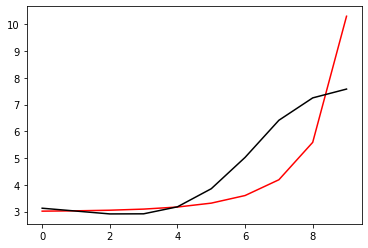

75900 0.010734598690607883
[3.04598598 2.94272844 2.83980309 2.8478613  3.1148499  3.79879396
 4.98457166 6.41079457 7.31038612 7.28913864]


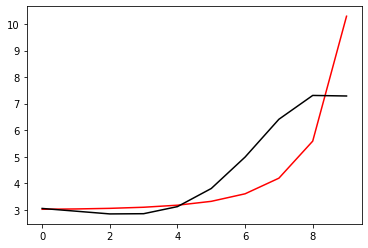

77000 0.05722816042733004
[3.04317144 2.95506738 2.8690687  2.8971163  3.18828516 3.90477388
 5.14026332 6.64924481 7.64624684 7.62800927]


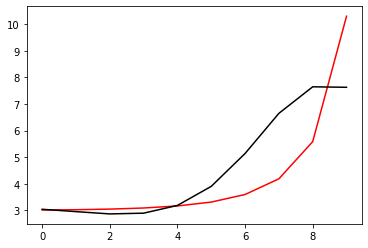

78100 0.010702838882220749
[3.05068698 2.94088377 2.83319928 2.83817965 3.10057066 3.77411948
 4.93518171 6.31907704 7.16369552 7.17880871]


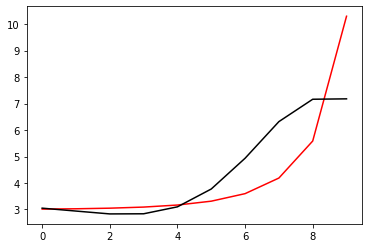

79200 0.008813102796333232
[3.03137309 2.92773355 2.82603842 2.83784898 3.10894874 3.79600612
 4.9824396  6.41399426 7.3031135  7.26038271]


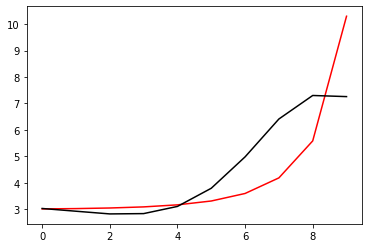

80300 0.01079771375452789
[2.99899368 2.90479554 2.81211011 2.83355194 3.11598252 3.8194257
 5.03583951 6.52568304 7.47298918 7.48513721]


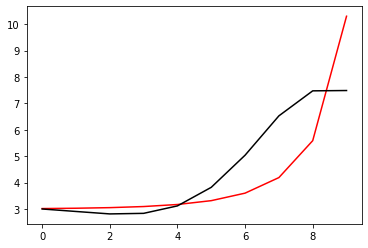

81400 0.0009939569116951712
[2.95379507 2.87385377 2.79646482 2.83506959 3.13855758 3.87292646
 5.14422497 6.73244075 7.77028039 7.76138702]


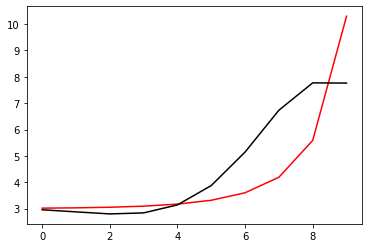

82500 0.0012024102285973397
[2.97750272 2.87012332 2.76260582 2.76682227 3.02682527 3.69745507
 4.85795273 6.23201888 7.0891321  7.06375878]


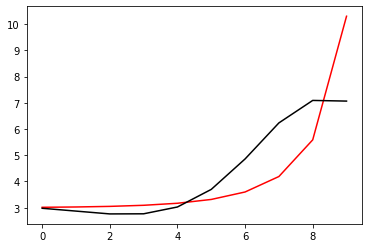

83600 0.0009231943530804652
[2.9903447  2.89582558 2.80280538 2.82429378 3.1058545  3.80637545
 5.01304207 6.46137854 7.39372592 7.3788385 ]


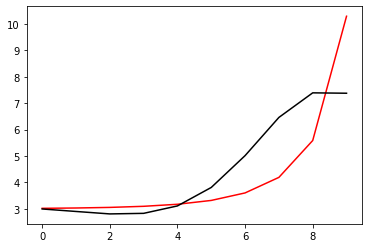

84700 0.6363681346401073
[3.25852298 3.15474571 3.05407299 3.06933629 3.34475858 4.03471811
 5.20538373 6.50938633 7.26296085 7.5006843 ]


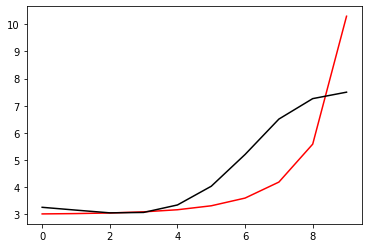

85800 0.022486828192796373
[3.05720043 2.94784883 2.84051207 2.84805433 3.11316898 3.78815432
 4.94008133 6.24881396 7.06911663 7.00981092]


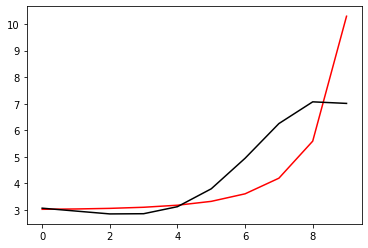

86900 0.010794955852995072
[3.04476026 2.95103564 2.86146213 2.89067301 3.18347951 3.89727094
 5.10882641 6.51166386 7.42009653 7.42635293]


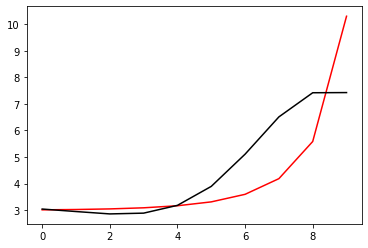

88000 0.0784216126328357
[3.04622474 2.96936021 2.89948049 2.95235812 3.27510713 4.03082501
 5.30820024 6.82018697 7.830485   7.75637667]


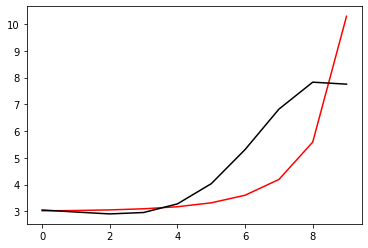

89100 0.010762409677239624
[2.98760974 2.90947183 2.83737286 2.88549732 3.19801515 3.93157623
 5.15941171 6.56072231 7.38606551 7.38587984]


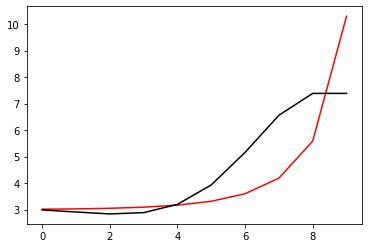

90200 0.009453331755763315
[2.909898   2.84678728 2.79070366 2.85631548 3.19075133 3.95878455
 5.25822442 6.81944484 7.75558605 7.69621802]


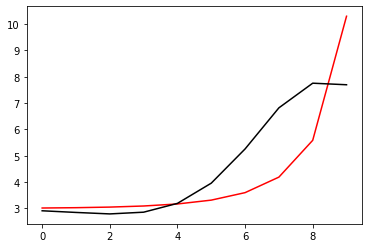

91300 0.010765970476783682
[2.97648499 2.86775151 2.76389774 2.7770168  3.04821651 3.72828416
 4.8851571  6.19014834 6.83969953 6.83630512]


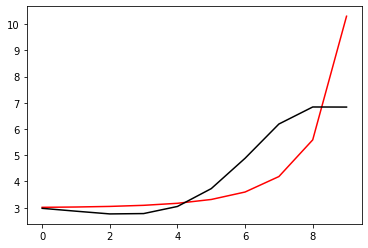

92400 0.001970672378448057
[2.99963293 2.90255466 2.81135127 2.8393091  3.12909443 3.83510988
 5.03261976 6.40756246 7.14342356 7.12288645]


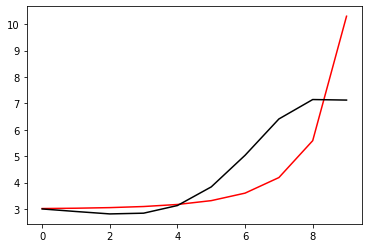

93500 0.015938696908203577
[2.91166321 2.82290002 2.74235953 2.7844557  3.09383054 3.82992165
 5.07992666 6.55629616 7.42474402 7.39558565]


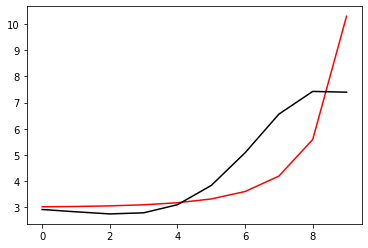

94600 0.0007946262093381385
[3.01392094 2.90879048 2.81036223 2.83295856 3.11878311 3.82171664
 5.01762381 6.40896097 7.18849594 7.12442582]


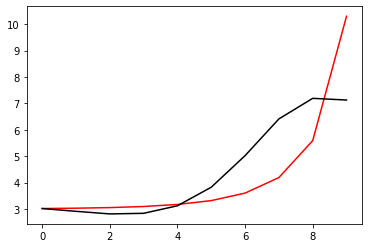

95700 0.6165131648933915
[3.26510236 3.15216217 3.04511538 3.0581035  3.3309362  4.0098904
 5.14457978 6.37720525 7.0251561  7.24733303]


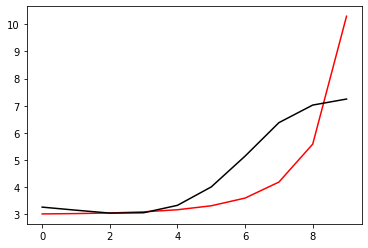

96800 0.023915162457992384
[3.07544954 2.95564826 2.84046727 2.84462475 3.10689019 3.77224816
 4.89340985 6.14181377 6.86355492 6.81444879]


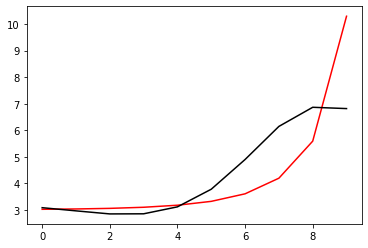

97900 0.01080452129478926
[3.0665953  2.96198938 2.86331181 2.88788967 3.17743255 3.8828044
 5.06718352 6.41317003 7.22467604 7.24307591]


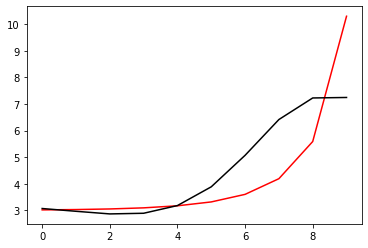

99000 0.05995513086952911
[3.01333142 2.87136223 2.73616799 2.72560173 2.9798041  3.64523633
 4.77480377 6.04321619 6.80379034 6.79931397]


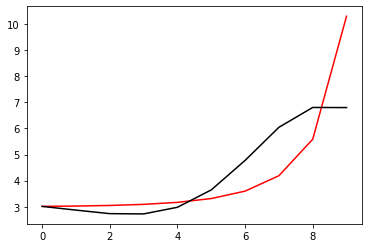

100100 0.010696514789263714
[3.03237754 2.89942583 2.77104112 2.76695366 3.02786084 3.70121692
 4.84322415 6.13927895 6.93988189 6.94047857]


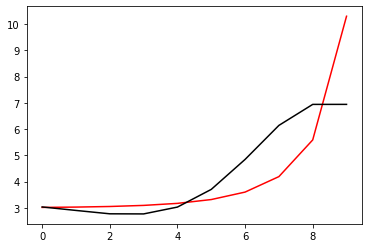

101200 0.009190285779846312
[3.04575521 2.92983459 2.81756116 2.83142713 3.11458573 3.81856496
 5.00776812 6.38381878 7.2830538  7.15552932]


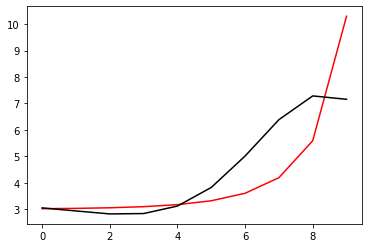

102300 0.011430264583781232
[3.0645217  2.94143046 2.81791778 2.8144452  3.06877123 3.719938
 4.80654229 5.99733038 6.65776385 6.63770097]


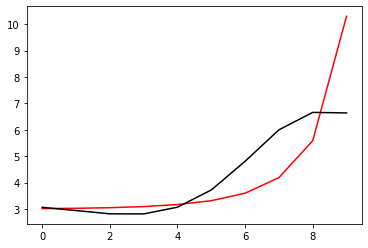

103400 0.004815694012433921
[3.05073601 2.93354719 2.81564414 2.81830953 3.08058848 3.74440599
 4.85595322 6.09623745 6.79649291 6.77991563]


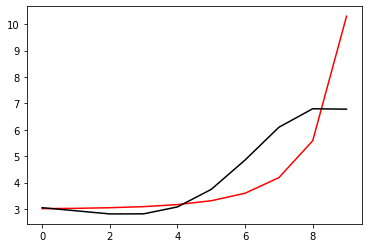

104500 0.0094376945860309
[3.0223322  2.91394376 2.80446877 2.81611086 3.08970451 3.77116803
 4.91746546 6.22773199 6.98675236 6.98788044]


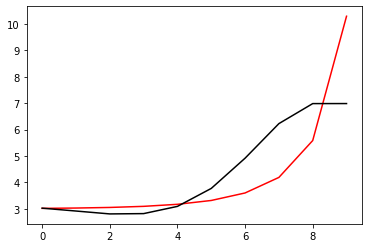

105600 0.7088584229388789
[3.29359138 3.18270127 3.07028687 3.07918512 3.35186888 4.03595205
 5.18640447 6.45383587 7.08874122 7.24790476]


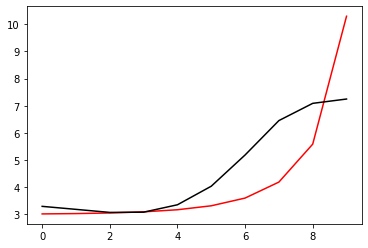

106700 0.026913409969650817
[3.04232517 2.89626432 2.74669895 2.71502389 2.93902665 3.55652046
 4.60778302 5.76281858 6.41464304 6.40039153]


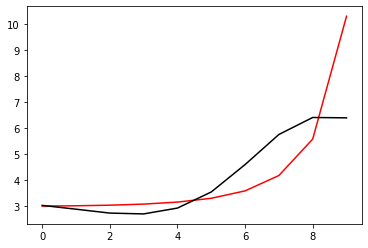

107800 0.02728548863131846
[3.13486924 2.98969808 2.84050357 2.80995098 3.03630385 3.65818874
 4.71869959 5.89736119 6.57938731 6.55638261]


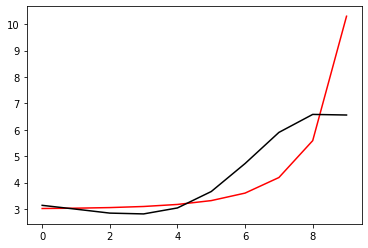

108900 0.010774518403133423
[3.11755617 2.98879494 2.85702277 2.84742143 3.10153229 3.76454349
 4.8926976  6.18427687 6.99042685 7.0187998 ]


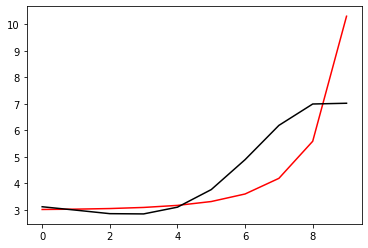

110000 0.06073316392695586
[3.18884202 3.01179321 2.8333819  2.77867452 2.98697641 3.5981279
 4.65972816 5.86633234 6.58032561 6.6050989 ]


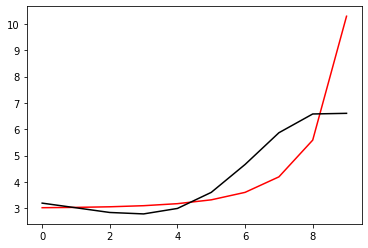

111100 0.010676473241648134
[3.14740061 2.98342893 2.81608819 2.77206414 2.9914584  3.61574465
 4.69660832 5.93842848 6.7017369  6.70183304]


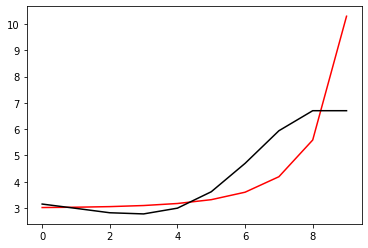

112200 0.01563884917883025
[3.10302945 2.95545134 2.80428615 2.77888547 3.02210789 3.68055333
 4.81608219 6.14964781 7.02730811 6.96473126]


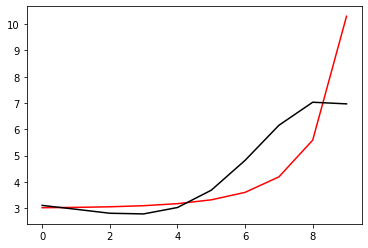

113300 0.010909775951576703
[3.0569145  2.92886568 2.79686878 2.79281251 3.06330554 3.76148872
 4.96215234 6.40635633 7.41245152 7.47437797]


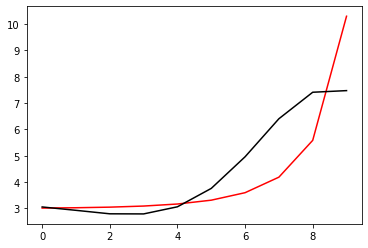

114400 0.005367711196604218
[3.11873307 2.95065154 2.77847026 2.73461325 2.96393067 3.61349093
 4.74313078 6.08051996 7.01292284 6.98563723]


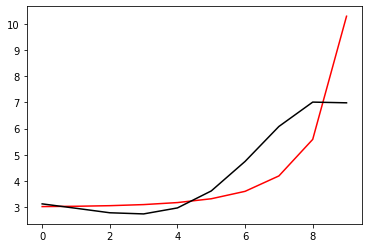

115500 0.0010519675455091708
[3.03303701 2.87749147 2.71755638 2.68814256 2.93658129 3.61427131
 4.78952139 6.20282635 7.22663408 7.20862681]


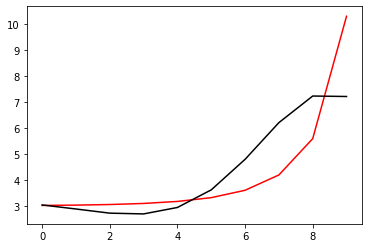

116600 0.7316925966679164
[3.36568142 3.21974812 3.0675829  3.04552287 3.30198243 3.98638044
 5.15148913 6.48415061 7.39264932 7.55718761]


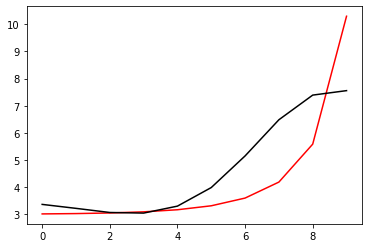

117700 0.010850995202461189
[3.14100612 2.97869776 2.8062273  2.75929966 2.98320253 3.62030763
 4.71408093 5.97978692 6.95233787 6.93732596]


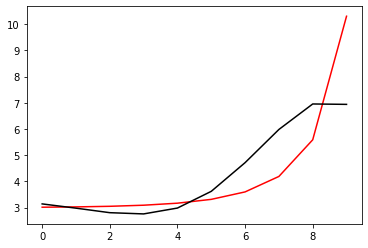

118800 0.022284974049795996
[3.15626009 3.01407563 2.86217129 2.83817011 3.09026118 3.76561255
 4.91583586 6.26403037 7.31563408 7.25214477]


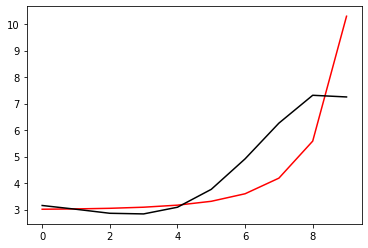

119900 0.01078683541650406
[3.08118554 2.97351765 2.85531747 2.86184892 3.14019733 3.8361327
 5.0012925  6.36338733 7.4073219  7.41985517]


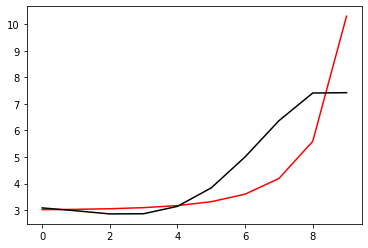

121000 0.06058521548586515
[3.11693946 2.97767693 2.82592509 2.79364579 3.02350217 3.64991185
 4.69767601 5.83856846 6.72801628 6.75934282]


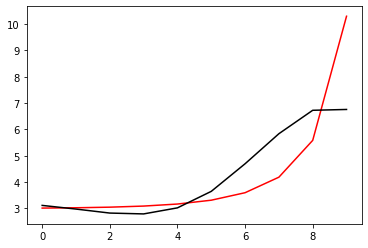

122100 0.010651134348568125
[3.10937772 2.98123262 2.84163308 2.82298206 3.06949839 3.71873721
 4.80230654 6.0032769  6.95119138 6.95268552]


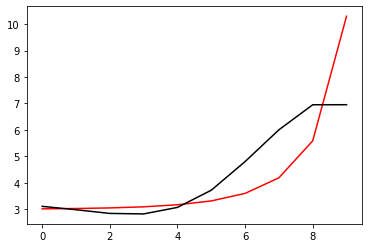

123200 0.008326512803089386
[3.03492046 2.92749454 2.81282074 2.82458813 3.11195181 3.82189246
 5.00170968 6.34511351 7.4176874  7.28621863]


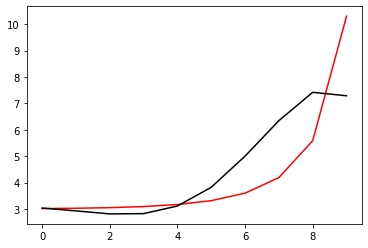

124300 0.01073614055182358
[3.01835123 2.8867836  2.74752785 2.73200626 2.98590757 3.6485123
 4.75302318 5.98457347 6.92832555 6.91999124]


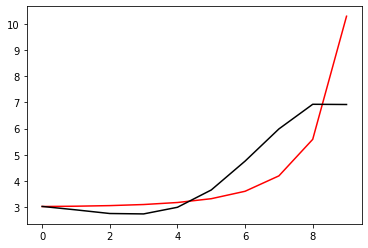

125400 0.0027545068893693493
[3.03892902 2.91540438 2.78348061 2.77511256 3.03708596 3.71069328
 4.83363032 6.09970718 7.08038219 7.0477692 ]


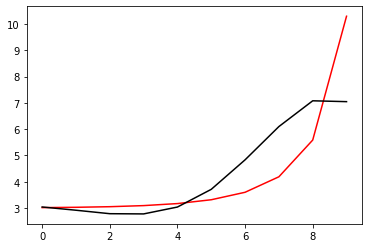

126500 0.0015890107832562178
[2.96637142 2.85676582 2.73944053 2.74686126 3.02839477 3.73068187
 4.90322663 6.25934825 7.34257048 7.32675341]


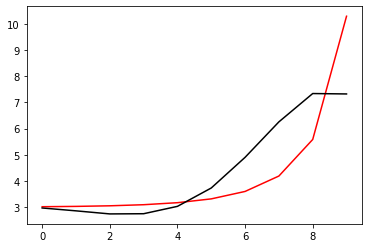

127600 0.000904922509640127
[2.98022976 2.88941523 2.79124328 2.81721512 3.11908179 3.84817295
 5.06445392 6.5004343  7.66685293 7.66236061]


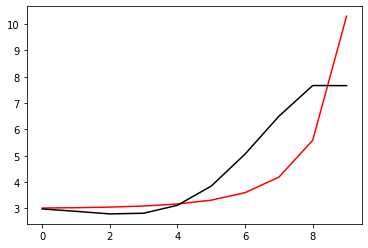

128700 0.011398524219237883
[2.98695481 2.90236711 2.80870203 2.83329507 3.12360509 3.82223386
 4.97239669 6.2877291  7.28380929 7.26922762]


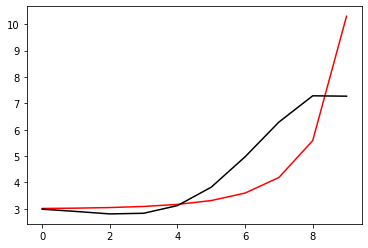

129800 0.02022490496846432
[2.99761398 2.91832446 2.83065713 2.86152842 3.15931159 3.86869376
 5.03744479 6.38546657 7.41058118 7.36364207]


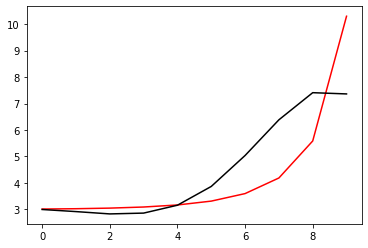

130900 0.010751976716136142
[2.99356821 2.92254459 2.84435037 2.88482703 3.19353412 3.91811992
 5.11328681 6.51009009 7.58247411 7.60569886]


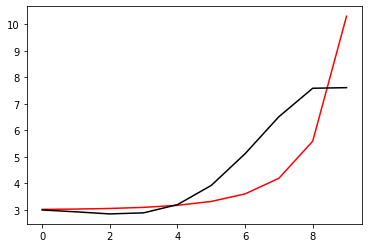

132000 0.060488324866779866
[3.04883692 2.95296321 2.84827759 2.85690093 3.1235878  3.78525408
 4.87404747 6.09434561 7.02279831 7.01304401]


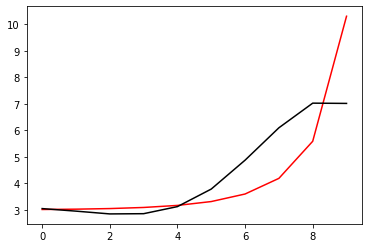

133100 0.010663137121645903
[3.03673978 2.9482092  2.85259048 2.87162083 3.15088114 3.83014695
 4.94881599 6.22395694 7.20969882 7.2090051 ]


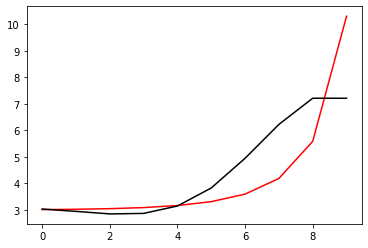

134200 0.011013765485801906
[2.9336505  2.85586174 2.7769539  2.81866574 3.13002126 3.85984567
 5.06641778 6.48672811 7.61339433 7.55319989]


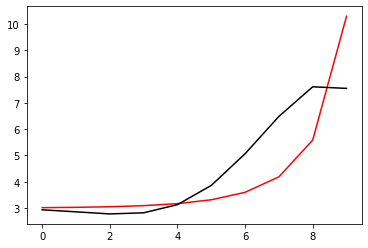

135300 0.010758542953741993
[3.02471594 2.90240518 2.78027324 2.77846805 3.04245233 3.71369104
 4.83533097 6.12718552 7.13572312 7.12656045]


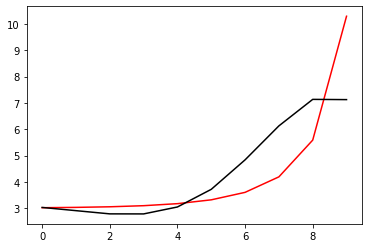

136400 0.0019687386666880718
[3.01991651 2.90881213 2.79761142 2.80763662 3.08537591 3.77511361
 4.92633237 6.27126667 7.34813218 7.3341241 ]


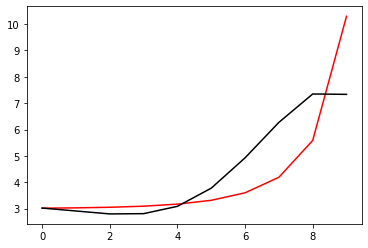

137500 0.028752634923136153
[2.9103455  2.81658902 2.7246586  2.75636203 3.05986509 3.78434181
 4.99038828 6.42996498 7.62260847 7.59580158]


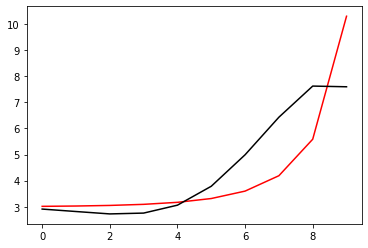

138600 0.010257429289238555
[3.04105577 2.90003942 2.75688349 2.73071529 2.96235365 3.5847219
 4.62587251 5.80800864 6.76520043 6.75811882]


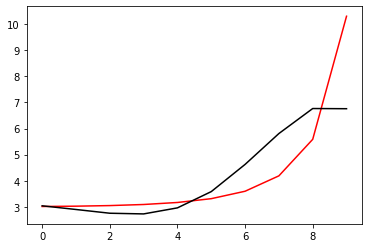

139700 0.010842053531498108
[3.08884665 2.95838239 2.82451641 2.80747078 3.048474   3.68174956
 4.73882657 5.9492896  6.94180237 6.92938275]


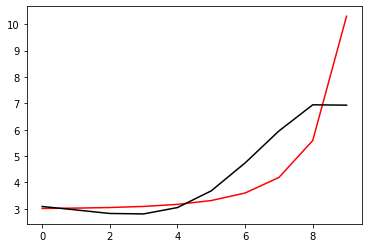

140800 0.01990767009534358
[3.09452994 2.98241333 2.86685521 2.86948439 3.13299966 3.79521677
 4.89534915 6.17501407 7.24846039 7.17338677]


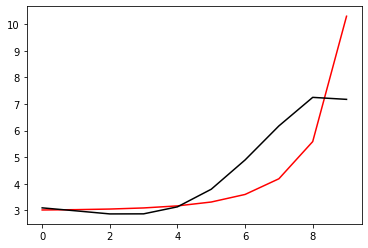

141900 0.010721622585422842
[3.05070677 2.95349605 2.85384291 2.87350848 3.15627956 3.84351416
 4.98398249 6.33738304 7.49874869 7.58411784]


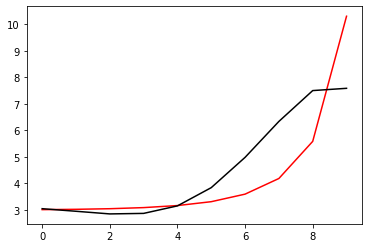

143000 0.06057660049377369
[3.0872887  2.95280794 2.81226544 2.785228   3.00980518 3.61520298
 4.62851445 5.79378863 6.76452019 6.76205957]


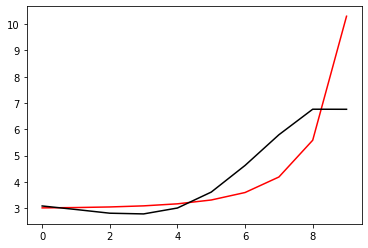

144100 0.010631903623973808
[3.10648661 2.98434012 2.85601387 2.84251511 3.08385878 3.71408094
 4.77140676 6.01114288 7.03538173 7.03664192]


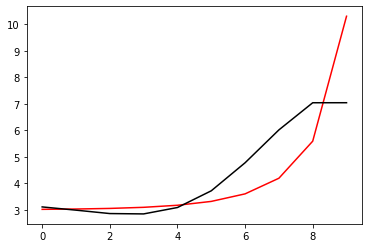

145200 0.01142159166723591
[2.99570232 2.89286686 2.78598998 2.79779351 3.07247223 3.75474617
 4.90762872 6.31216429 7.47750691 7.39350935]


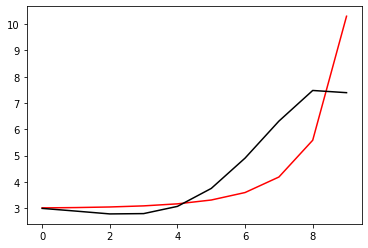

146300 0.011948747566351328
[3.11973377 2.96507511 2.80837827 2.77182357 2.99698324 3.62257517
 4.69764996 5.97554248 7.01929666 6.98704988]


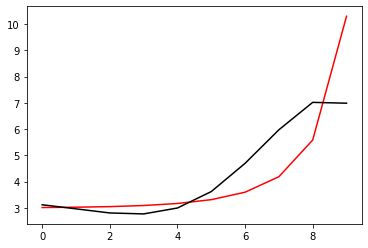

147400 0.003936938897020221
[3.08097273 2.93791474 2.79208464 2.76766687 3.00761056 3.65365913
 4.76095983 6.09260796 7.20314424 7.18438972]


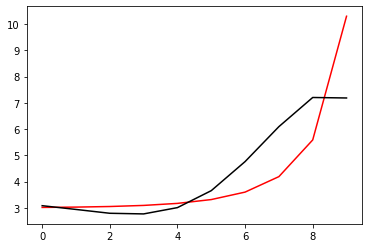

148500 0.020204085274658466
[2.96531676 2.8383546  2.70902357 2.70341932 2.96655295 3.6448876
 4.80355701 6.22116584 7.43488458 7.41649465]


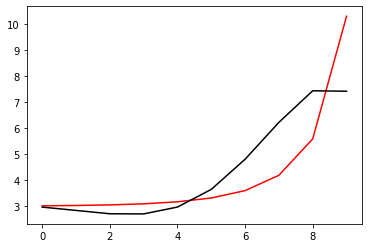

149600 0.0015827311517153425
[3.17869015 2.99931192 2.81293574 2.74412347 2.93136421 3.50634507
 4.50629767 5.68825398 6.68442903 6.65473989]


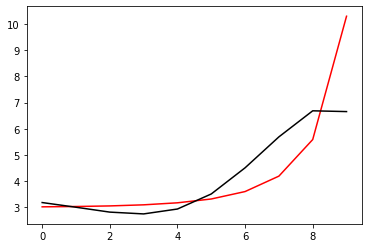

150700 0.010849342209925556
[3.15816631 2.99150323 2.8166834  2.76080664 2.96414567 3.56209256
 4.59967623 5.84654883 6.92690786 6.91469109]


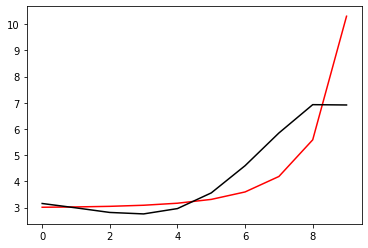

151800 0.028150049973065285
[3.10503482 2.95454156 2.79529231 2.7577742  2.9856483  3.62089477
 4.72154511 6.07435525 7.27879023 7.27330761]


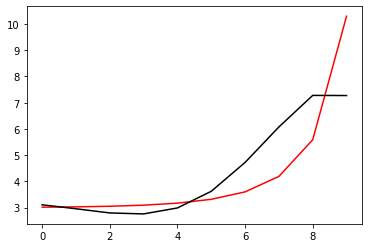

152900 0.03380792719083775
[3.02115596 2.84855004 2.66717975 2.60834112 2.81507543 3.42636981
 4.49174172 5.7884784  6.94560948 6.98141094]


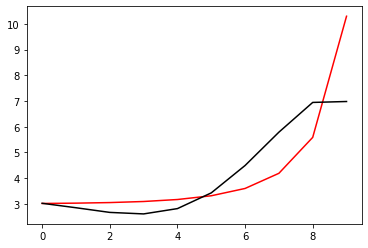

154000 0.06070030437965726
[3.1791123  2.99245571 2.79638437 2.72362078 2.91705993 3.51510081
 4.56761711 5.85612686 7.008504   7.01046458]


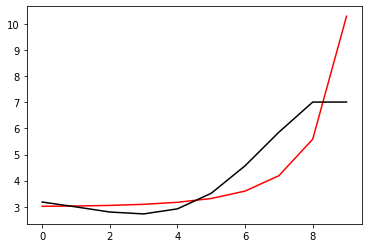

155100 0.01073598973944575
[3.17309074 3.00153906 2.81830827 2.75868706 2.96726466 3.58549982
 4.66989015 6.01303283 7.23406335 7.23365314]


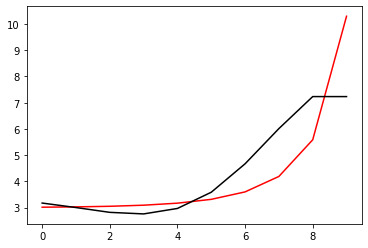

156200 0.010855033784302106
[3.11733018 2.96502949 2.80094157 2.76419339 3.00420021 3.67056755
 4.83403816 6.30200054 7.66165334 7.51539784]


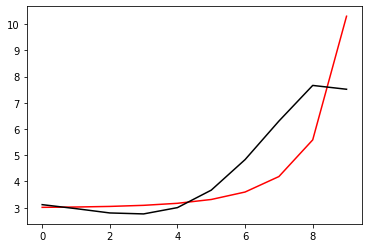

157300 0.012117063252477838
[3.17569262 2.98066133 2.77438142 2.69637595 2.89422734 3.51149698
 4.60514415 5.97176208 7.24782933 7.21798159]


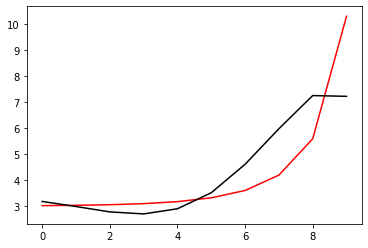

158400 0.004032903907146
[3.13239285 2.9525175  2.75966437 2.6957101  2.91018419 3.55001398
 4.67881451 6.10263827 7.44830305 7.42846073]


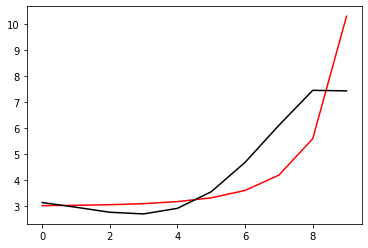

159500 0.01779201107525687
[3.01480379 2.85403741 2.67936882 2.63500871 2.87373885 3.54816721
 4.73334956 6.25055669 7.70561833 7.68565289]


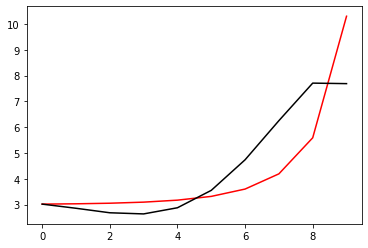

160600 0.00108676232943128
[3.1595988  2.98002831 2.78281732 2.71234734 2.91936228 3.55027931
 4.66701512 6.07935637 7.44048219 7.39909527]


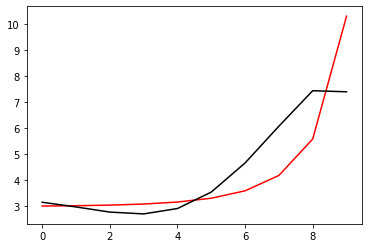

161700 0.010864938972313365
[3.16339289 2.98697014 2.79245942 2.72602366 2.94086921 3.5874495
 4.73656574 6.21094322 7.64194443 7.63035208]


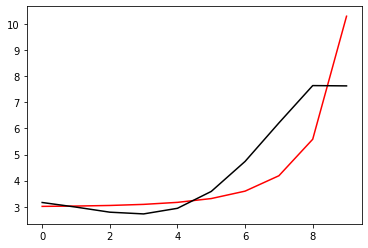

162800 0.027657036608016276
[3.18912908 3.0047462  2.79887301 2.7176961  2.91300882 3.53076343
 4.63145104 6.0242765  7.37418246 7.34986917]


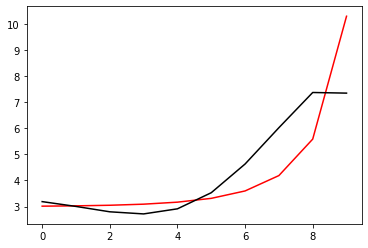

163900 0.13411781544290818
[2.9086725  2.75192007 2.57509364 2.52561816 2.75791344 3.42354061
 4.59456751 6.09394295 7.5611312  7.74520939]


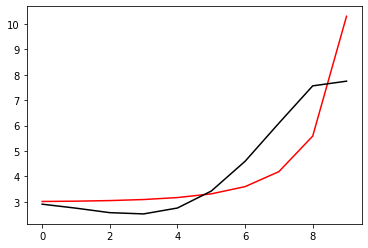

165000 0.0606566571357635
[3.14949997 2.98977683 2.80610894 2.74330035 2.95059689 3.56588131
 4.62162425 5.82940917 7.01179378 7.01744837]


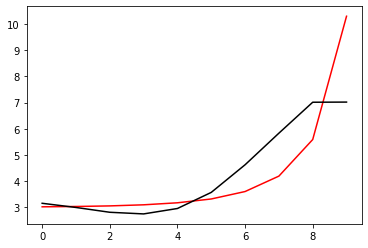

166100 0.010708366855484288
[3.14522107 2.99336127 2.8175759  2.76296796 2.98055893 3.61206501
 4.70010362 5.97660089 7.22164398 7.22213735]


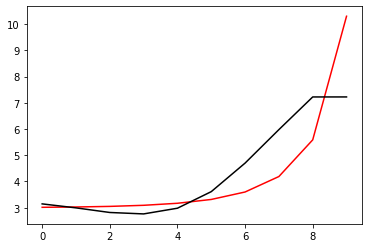

167200 0.011563585792735625
[3.06747747 2.93344036 2.77726203 2.74422677 2.9894108  3.66378667
 4.83251422 6.26116763 7.63823961 7.57636695]


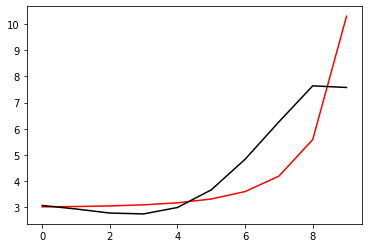

168300 0.010814128249499901
[3.07229728 2.91997471 2.74327603 2.68537201 2.89872859 3.52801798
 4.62515387 5.93011908 7.19184697 7.18045562]


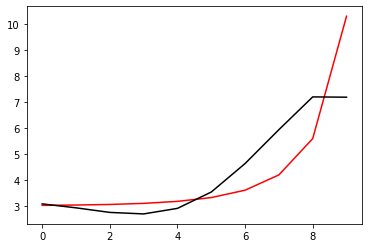

169400 0.002225216966816611
[3.06311813 2.92807777 2.77096788 2.73465891 2.97408425 3.63932248
 4.7929362  6.18960337 7.53663043 7.50863539]


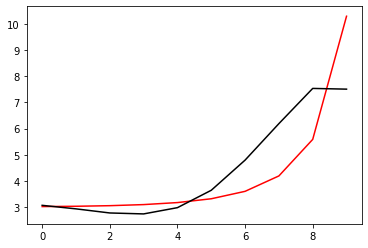

170500 0.04064686532823646
[2.96048494 2.83066301 2.68293756 2.65972701 2.91975117 3.62188706
 4.84865544 6.38470976 7.86902764 7.82561434]


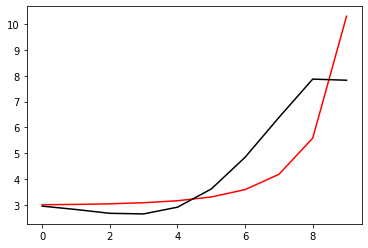

171600 0.0009302201591350639
[3.13922861 2.97583719 2.79282851 2.73204643 2.94927141 3.59512671
 4.7298144  6.10005117 7.43373782 7.4032869 ]


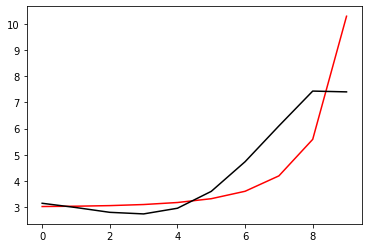

172700 0.010819648943535865
[3.14395582 2.98896778 2.81454126 2.76362461 2.99403645 3.66041794
 4.8309129  6.26711731 7.67507207 7.6119613 ]


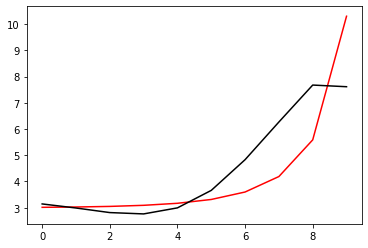

173800 0.02968313144476688
[3.03434655 2.90612432 2.75355734 2.7167257  2.94821599 3.58987959
 4.6686185  5.73741609 6.87591484 6.86473181]


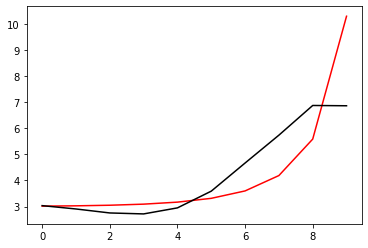

174900 0.009867417824519623
[3.03856883 2.91393496 2.76536956 2.73282234 2.96985903 3.62048574
 4.71642416 5.82271987 6.98862219 6.98409734]


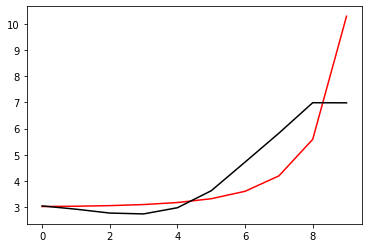

176000 0.06053580025115812
[3.08954944 2.97457175 2.83616489 2.81391287 3.0630314  3.7308842
 4.85538651 6.01381328 7.20151503 7.2016115 ]


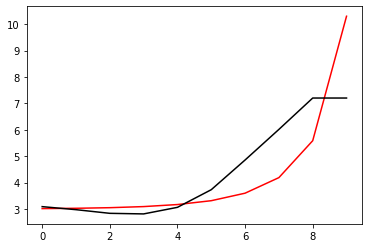

177100 0.010832498896770662
[3.08633766 2.98881367 2.86950775 2.86671017 3.13843661 3.83831799
 5.01692625 6.27595412 7.53044997 7.54281555]


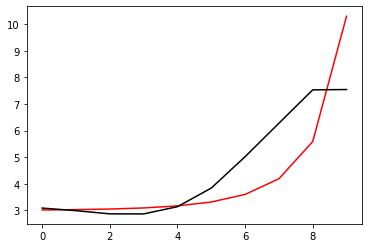

178200 0.019872258243205706
[3.10488031 2.9784487  2.82860984 2.79014006 3.01711594 3.65351369
 4.725632   5.80031819 6.93145394 6.85404899]


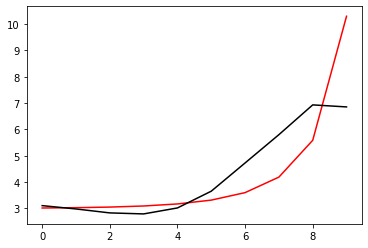

179300 0.011049951484435492
[3.06527003 2.94825455 2.8104598  2.78641165 3.03189075 3.69520454
 4.81106863 5.9657565  7.16822195 7.15903088]


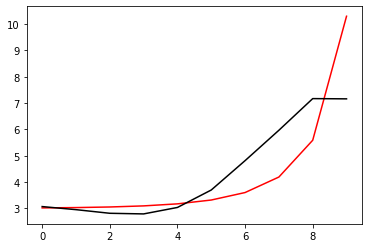

180400 0.001577667926930348
[3.00715303 2.90672633 2.78978579 2.78942472 3.06340218 3.76565239
 4.94216002 6.20574874 7.49786514 7.4695943 ]


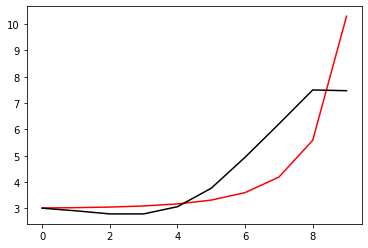

181500 0.010375053382016606
[3.11000349 2.96108369 2.79773389 2.75169817 2.97733525 3.62083745
 4.7104372  5.84180085 6.99828108 6.99553233]


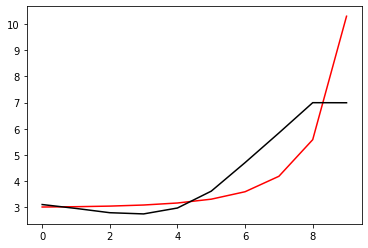

182600 0.0008660110911399987
[3.09755746 2.96034868 2.80842005 2.77442528 3.01374486 3.67515066
 4.79225846 5.97492988 7.18789984 7.16209501]


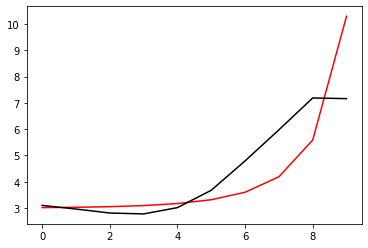

183700 0.011461930067445265
[3.15351246 3.01341189 2.85959943 2.82514155 3.06597717 3.73261728
 4.86375147 6.09003666 7.3511536  7.33554511]


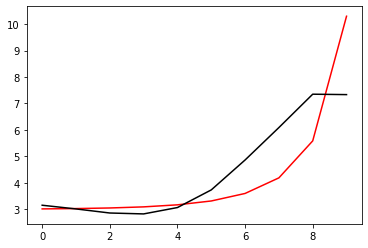

184800 0.029957740943959744
[3.08437687 2.91106393 2.72510636 2.65925607 2.86757958 3.4968904
 4.57780085 5.73827397 6.93541207 7.02699617]


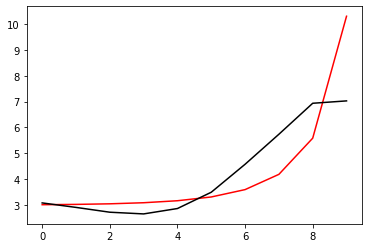

185900 0.011018421624382648
[3.11645602 2.94811807 2.76604148 2.70473029 2.91899575 3.55734788
 4.65435297 5.84922623 7.08611589 7.08428032]


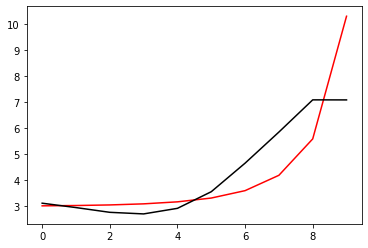

187000 0.060541571415398523
[3.14805182 2.99995324 2.83521708 2.7896823  3.01869667 3.67243764
 4.79034098 6.0280667  7.30947023 7.30791682]


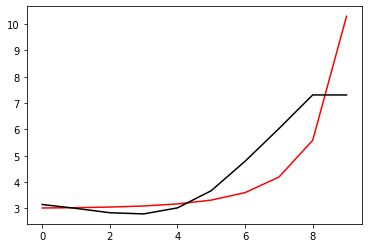

188100 0.010523732494367178
[3.07089543 2.88148439 2.6743028  2.58398967 2.7614147  3.34587529
 4.35315905 5.42064393 6.56778452 6.5821047 ]


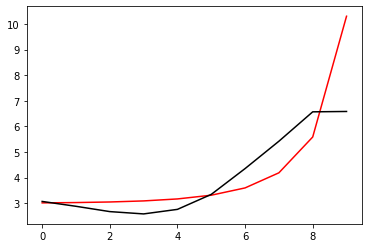

189200 0.026288413867583328
[3.18313753 2.98476636 2.76816561 2.66930893 2.83904012 3.41659976
 4.41896425 5.49068834 6.64264974 6.61106577]


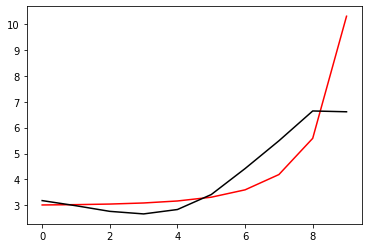

190300 0.011874845604626401
[3.15078883 2.96956418 2.76890143 2.68743088 2.87822056 3.48516331
 4.53505838 5.69123407 6.94438632 6.92010802]


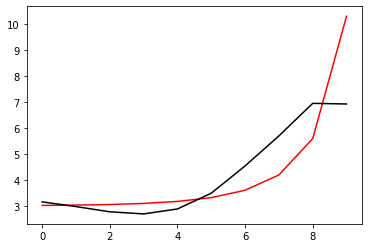

191400 0.004091342728685755
[3.09528592 2.93520044 2.75511447 2.6965126  2.91599426 3.56451579
 4.68317271 5.9578995  7.33338592 7.28953427]


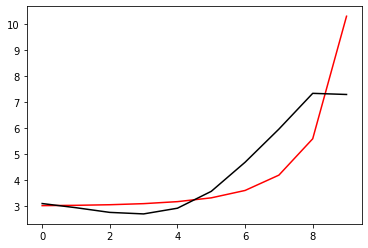

192500 0.001123041906152907
[3.10656632 2.91628248 2.70419145 2.61270453 2.79699657 3.40331206
 4.46162863 5.64648082 6.93897863 6.92347499]


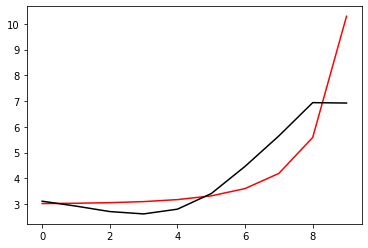

193600 0.010745755486849768
[3.08668774 2.90743295 2.70370586 2.61945057 2.81062064 3.42514938
 4.49874205 5.72253287 7.05890298 7.06184833]


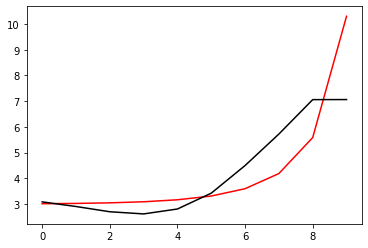

194700 0.11373758540636265
[2.9995979  2.80952904 2.5925053  2.49226456 2.66372875 3.25192882
 4.28967219 5.48007868 6.78057382 7.1647628 ]


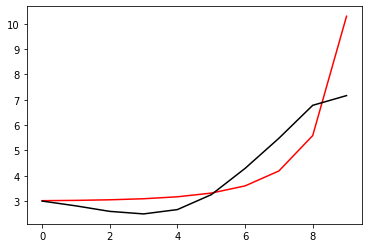

195800 0.030427287609383142
[3.12365534 2.92451295 2.69637862 2.58358724 2.74006404 3.30902282
 4.3222149  5.4877182  6.75716074 6.75491327]


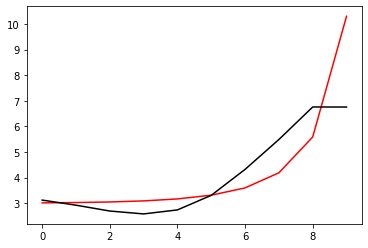

196900 0.011097542106448675
[3.22664484 3.03488439 2.81198865 2.70365169 2.86423108 3.43775338
 4.45951423 5.64921963 6.94255537 6.95661949]


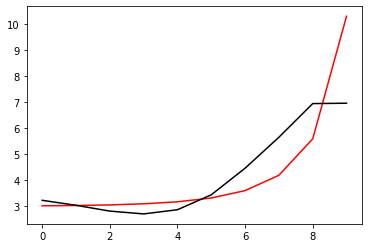

198000 0.4275440196241029
[3.33350522 3.16295759 2.96001198 2.87091956 3.05129956 3.64712584
 4.69629343 5.92124623 7.22596004 7.24947611]


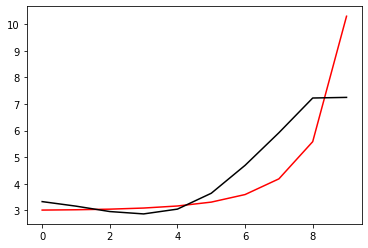

199100 0.01071443718510562
[3.17422843 2.9732968  2.74003361 2.62050718 2.76863979 3.32722119
 4.33124096 5.50720734 6.76309327 6.76429443]


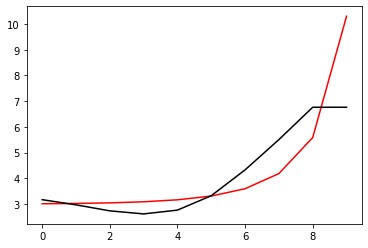

200200 0.019693400908268873
[3.10335662 2.91260162 2.68871675 2.57908324 2.73917721 3.31475972
 4.3473832  5.57629332 6.9002299  6.88832768]


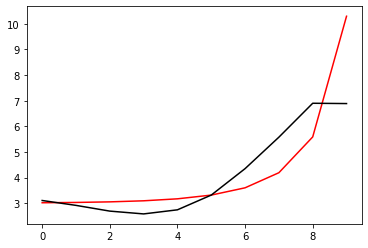

201300 0.010896709886445914
[3.10398204 2.92380183 2.70826534 2.60549427 2.772094   3.3559283
 4.40491235 5.6748035  7.04962554 7.06644149]


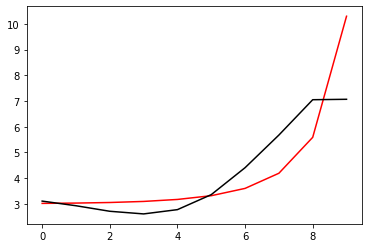

202400 0.011523830572365465
[3.08564263 2.92069408 2.71952544 2.63002802 2.81087075 3.41423809
 4.49985037 5.8497369  7.31796721 7.2356938 ]


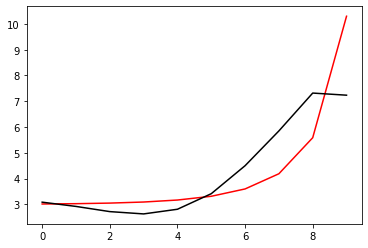

203500 0.03504970882737311
[2.98824624 2.85136091 2.68197191 2.62581801 2.84742595 3.5112684
 4.69946343 6.21199744 7.81996898 7.78166195]


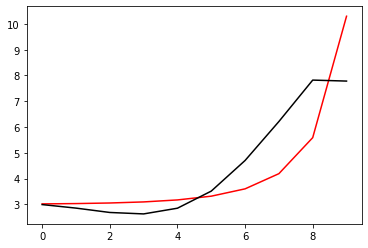

204600 0.00302694993565509
[3.17570655 3.01544362 2.81673872 2.7215515  2.88610408 3.45335748
 4.44601048 5.55085038 6.79386616 6.76733288]


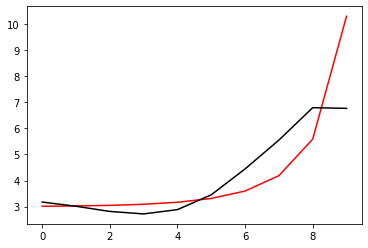

205700 0.01087818045742266
[3.170584   3.01884708 2.82869102 2.74251455 2.91829026 3.50321962
 4.531059   5.70452112 6.98112419 6.96307694]


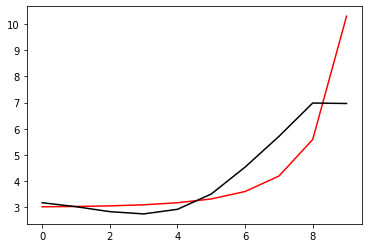

206800 0.025213606568651382
[3.15502776 3.01764459 2.84269344 2.77298065 2.96971806 3.587953
 4.68067867 5.97158474 7.30451206 7.26827367]


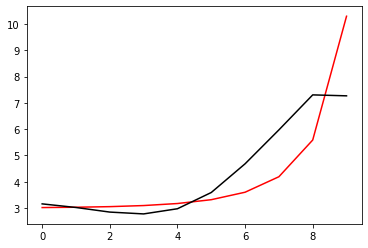

207900 0.010774246832924975
[3.11607128 2.98941436 2.82756379 2.7722174  2.9877395  3.63751458
 4.7963567  6.21764022 7.62842768 7.65274004]


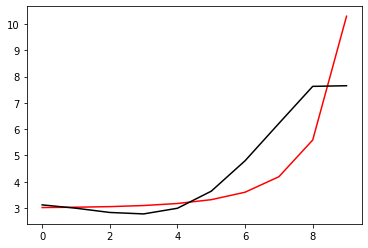

209000 0.06072326935785125
[3.16724733 2.99977867 2.79888067 2.70365411 2.87701898 3.4798143
 4.58124127 5.90574472 7.21483631 7.21629839]


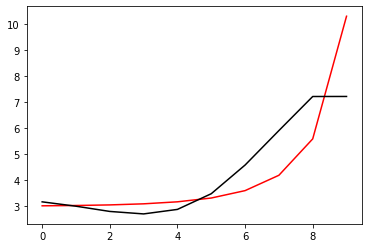

210100 0.010748661202931524
[3.16949749 3.01540852 2.8273996  2.74478295 2.93106317 3.54908829
 4.67245323 6.03684242 7.39147424 7.39262974]


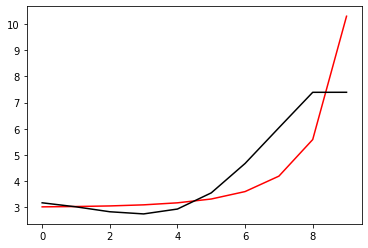

211200 0.011551628820517258
[3.09735013 2.9593252  2.78982921 2.72887398 2.94292652 3.60158079
 4.79043604 6.26369443 7.73712334 7.62462147]


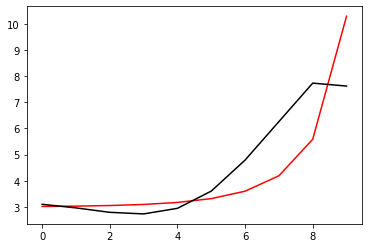

212300 0.010866223101603258
[3.0865384  2.91643035 2.7150938  2.62168266 2.80041923 3.41544349
 4.53985733 5.92230808 7.32808566 7.3227863 ]


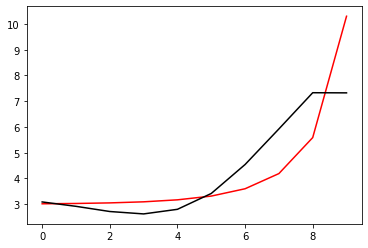

213400 0.0059477307409737485
[3.14517294 2.98956477 2.80041214 2.7174528  2.90534955 3.52983512
 4.66819383 6.08139464 7.52452972 7.45521896]


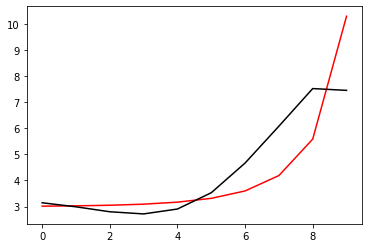

214500 0.0012637042782670674
[3.04694684 2.91258022 2.74542987 2.6845497  2.89616589 3.55068855
 4.73572905 6.23279932 7.77168713 7.77166098]


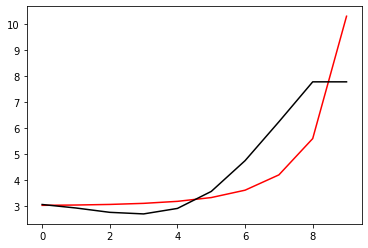

215600 0.0007988024846122529
[3.03053196 2.94773292 2.82834513 2.80752928 3.04868332 3.71576533
 4.87129565 6.18394653 7.46592815 7.4613358 ]


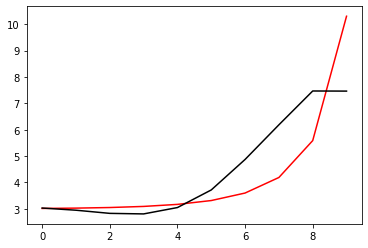

216700 0.010834863202538219
[3.00790554 2.93443908 2.82741172 2.81947798 3.07615024 3.76896754
 4.9906833  6.48309172 7.72079494 7.71571179]


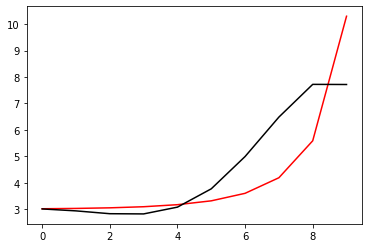

217800 0.014006145402256084
[3.01545385 2.9537634  2.86474362 2.87707158 3.15978221 3.89707207
 5.22252888 6.92485636 8.13349174 8.07046786]


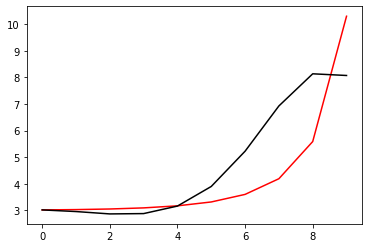

218900 0.010668994949326849
[2.97589757 2.91831886 2.83038862 2.83611485 3.09877313 3.79126012
 5.02300681 6.53319424 7.44473392 7.43160714]


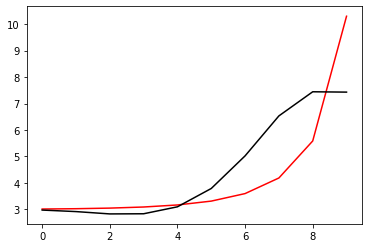

220000 0.06044599564527788
[2.98420458 2.92958811 2.84607842 2.85650855 3.12459886 3.82506988
 5.07135989 6.60932369 7.54130101 7.54198788]


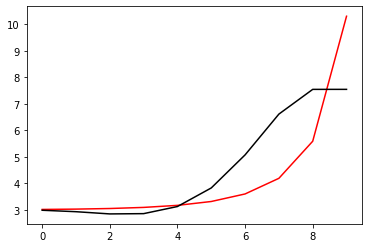

221100 0.010793527516044005
[2.98793465 2.9385865  2.86280611 2.88132642 3.15844839 3.87172259
 5.14085434 6.72301892 7.69154461 7.69131191]


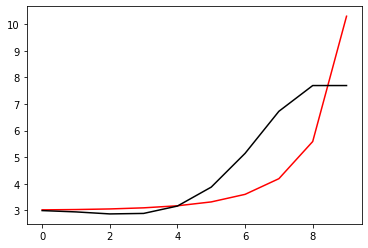

222200 0.008796478842643096
[2.96560639 2.89913297 2.81260672 2.82269325 3.09224397 3.79913699
 5.06744234 6.67778741 7.69880061 7.71691416]


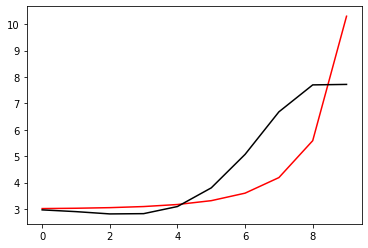

223300 0.0108592869561094
[2.99543857 2.92552227 2.83952941 2.85192967 3.12486691 3.83804104
 5.12087609 6.77605989 7.87685267 7.86742075]


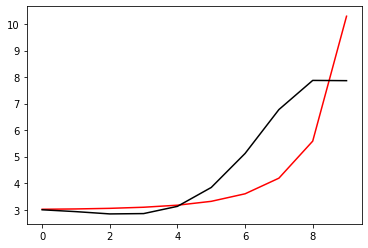

224400 0.0426965243801428
[2.89451775 2.83855072 2.76485251 2.78343834 3.0509769  3.73851287
 4.95781125 6.49346686 7.43498306 7.64950546]


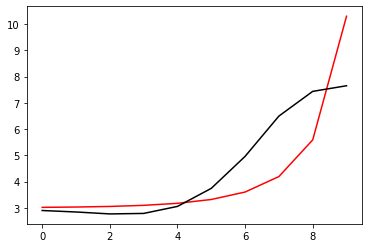

225500 0.007545955092208055
[2.96604122 2.90664702 2.83104025 2.84853884 3.11547274 3.80282767
 5.02180324 6.55555901 7.48984027 7.48359774]


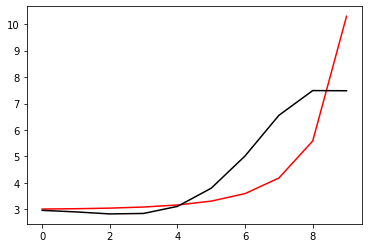

226600 0.0007731942352326689
[2.96652565 2.91144183 2.8414398  2.86503614 3.13880226 3.83563333
 5.07126768 6.63759485 7.60836345 7.6094528 ]


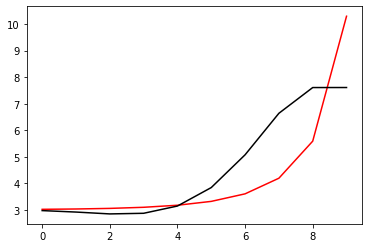

227700 0.11217370343112007
[2.82898393 2.7534817  2.66792811 2.67885658 2.94183257 3.63005271
 4.86100909 6.42836396 7.39386946 7.81060432]


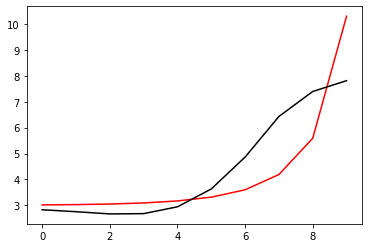

228800 0.02037348361190559
[3.02064274 2.93431124 2.83917475 2.84130843 3.09488182 3.77149346
 4.98658743 6.5354925  7.48575486 7.43985758]


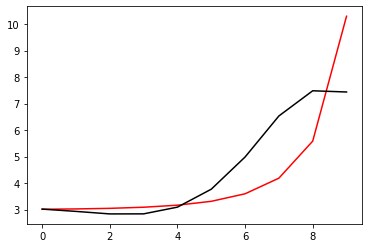

229900 0.010781744367086269
[3.01428644 2.93780595 2.85321499 2.86682849 3.13299769 3.82549956
 5.06440777 6.65567219 7.6718883  7.69550886]


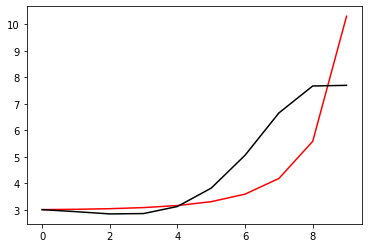

231000 0.06048027701582598
[2.99633027 2.89493525 2.78723965 2.77872885 3.0213694  3.68591135
 4.88837723 6.43913906 7.43366236 7.43116738]


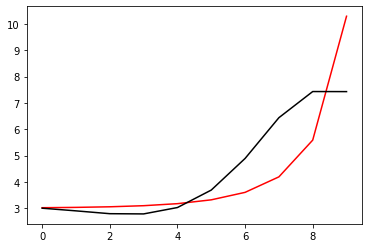

232100 0.01088331595821933
[3.06400095 2.97466949 2.87902995 2.88335938 3.13941164 3.81942009
 5.04301048 6.62994042 7.6799662  7.68322857]


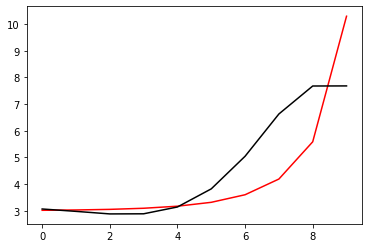

233200 0.015502907955827473
[3.04385235 2.91023115 2.76950285 2.72712594 2.93014365 3.54078447
 4.65714663 6.07684808 6.99565433 6.97361031]


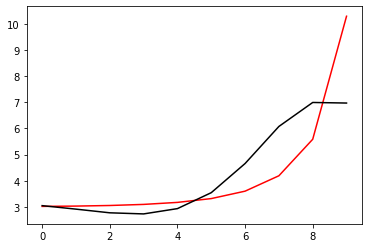

234300 0.01090813386565063
[3.06282503 2.93889679 2.80735611 2.77534702 2.99034656 3.61643872
 4.7556534  6.21284679 7.18357969 7.17625932]


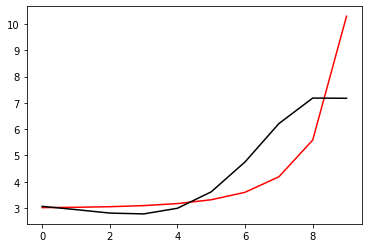

235400 0.0017079888763656616
[3.02200671 2.91107515 2.79325024 2.77782484 3.01334225 3.66754811
 4.85012198 6.37823099 7.4426397  7.42289813]


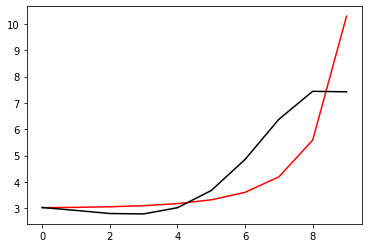

236500 0.001033108609869473
[3.03401003 2.89309982 2.74383214 2.69662114 2.89781036 3.51025457
 4.63419611 6.08233309 7.08875911 7.06802563]


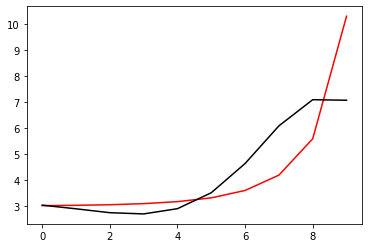

237600 0.0007420217182395822
[3.09056579 2.96753144 2.83407226 2.80269351 3.01996209 3.65028235
 4.79806196 6.28511131 7.34566265 7.29033803]


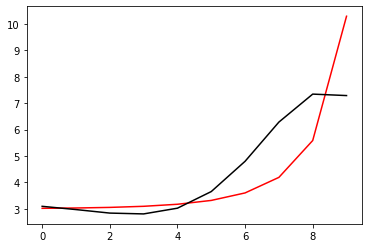

238700 0.5882739920275994
[3.2927255  3.17374011 3.04297828 3.01239415 3.22578616 3.84016849
 4.93716748 6.30059111 7.27345808 7.46737848]


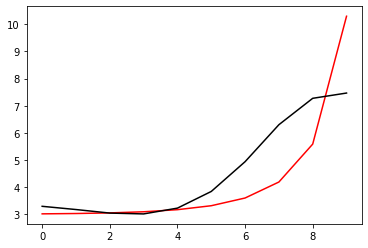

239800 0.024488977897095754
[3.12464724 2.99933893 2.86077983 2.82129807 3.02345982 3.62291813
 4.70359106 6.06744563 7.08092698 7.03947391]


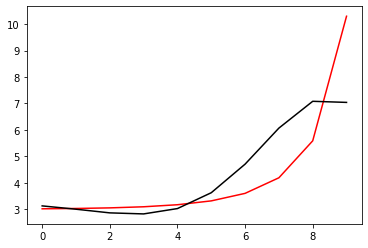

240900 0.04401356254154772
[2.92291545 2.82347647 2.71216256 2.70263315 2.93901229 3.58124126
 4.72268668 6.17778591 7.29827922 7.41283364]


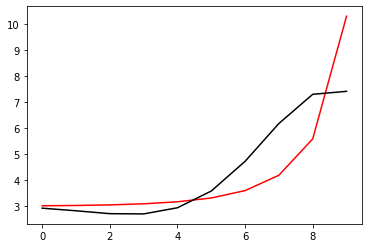

242000 0.058989291671726334
[3.06632473 2.98206308 2.88621287 2.89105486 3.13962226 3.79107793
 4.94111125 6.41560155 7.56710419 7.55023432]


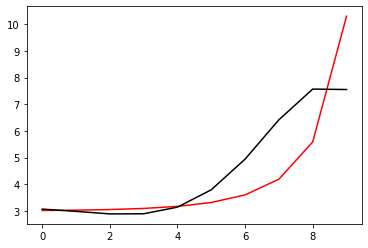

243100 0.5094724012101309
[2.63389022 2.56842416 2.49524241 2.52456532 2.79986521 3.48303684
 4.67831032 6.22796956 7.47287836 7.94416702]


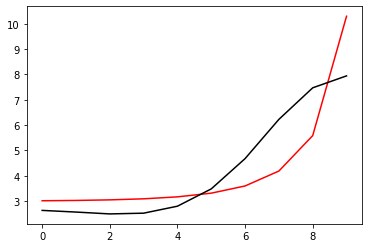

244200 0.01282584722494013
[2.99328482 2.90785186 2.81395947 2.81827048 3.05829244 3.68481604
 4.78305204 6.17467801 7.21210645 7.19699139]


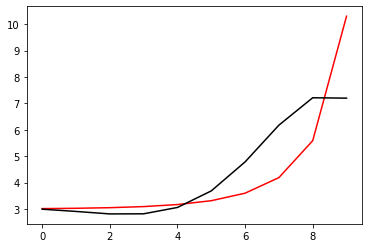

245300 0.010828360658927491
[3.01521302 2.93523864 2.84740613 2.85862976 3.10735647 3.74649965
 4.86577718 6.29311563 7.37354233 7.37352721]


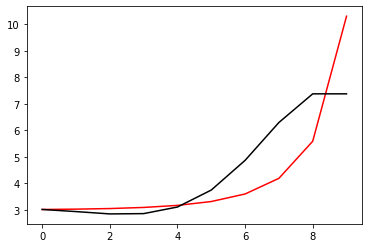

246400 0.0015689844985039198
[2.98289688 2.9120659  2.83423768 2.85614752 3.11729767 3.77340759
 4.92101164 6.39955806 7.54721946 7.52608275]


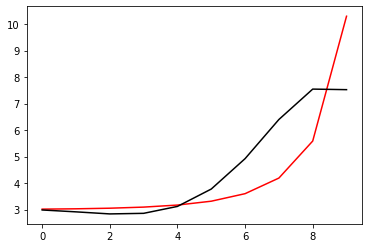

247500 0.03007731866942329
[2.87849342 2.82072428 2.75937811 2.80031501 3.08513005 3.77525566
 4.98066255 6.56098165 7.83429679 7.80754582]


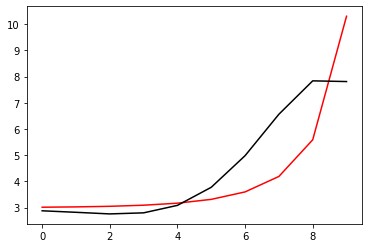

248600 0.0006795486127585001
[3.06013514 2.96524693 2.86232829 2.85373204 3.07269067 3.66116071
 4.68512122 5.93845087 6.85425815 6.85164478]


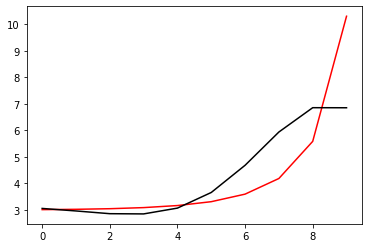

249700 0.010785931205617896
[3.04462213 2.95449431 2.85647401 2.85340439 3.07937424 3.67890593
 4.72551812 6.02577267 6.97836314 6.97421819]


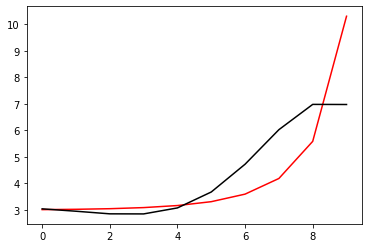

250800 0.021967380724552718
[3.03861    2.95817196 2.87062004 2.87962519 3.12125785 3.74548237
 4.83992869 6.2263656  7.23033846 7.17064496]


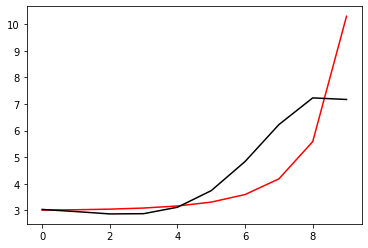

251900 0.01077562010559782
[3.04845275 2.97252282 2.89230577 2.9117092  3.16873413 3.8194543
 4.96794189 6.45354568 7.52316825 7.58288168]


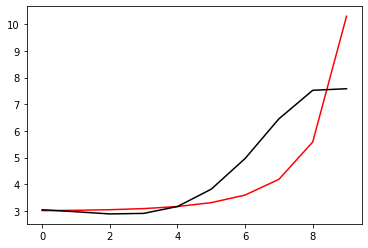

253000 0.19456967193400185
[3.07756497 3.01461102 2.94959252 2.98600216 3.26288789 3.94041491
 5.13312724 6.6954584  7.83975525 7.76385317]


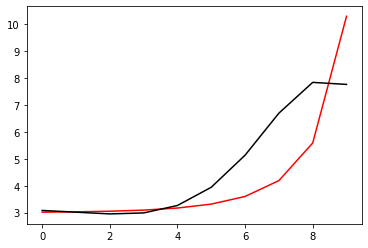

254100 0.010621420240699198
[2.97891854 2.89883088 2.81543111 2.828925   3.07253954 3.69551921
 4.79322246 6.19877043 7.13902744 7.13917878]


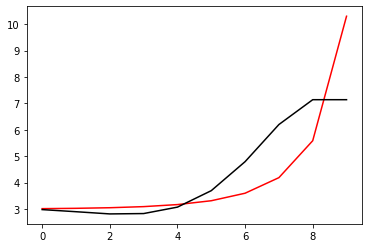

255200 0.009583216519532544
[3.00491633 2.93035878 2.85313603 2.87396045 3.12712208 3.7643164
 4.8857328  6.33027822 7.31554845 7.26031312]


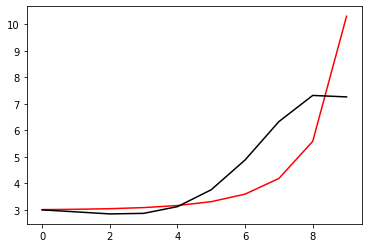

256300 0.010730417053188104
[2.97735399 2.91116629 2.84306984 2.87387139 3.13880474 3.79228341
 4.94084767 6.43410337 7.48408323 7.51046824]


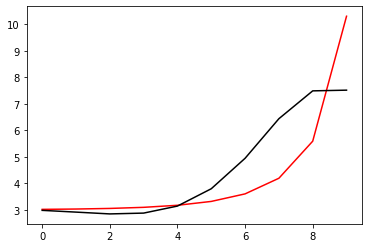

257400 0.000986649934641526
[2.93763163 2.8830273  2.82935643 2.87682849 3.16221033 3.84446276
 5.04039229 6.61486227 7.76505406 7.75193686]


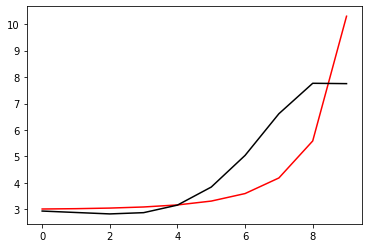

258500 0.0016956717685748112
[2.97461438 2.88092647 2.78951996 2.80001031 3.04648741 3.68232744
 4.81334879 6.29266554 7.36274615 7.34160056]


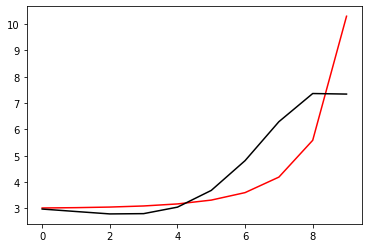

259600 0.0007242742482828576
[3.01165919 2.9262042  2.84428908 2.86643251 3.12740546 3.78283393
 4.94364801 6.47217807 7.61126964 7.59417607]


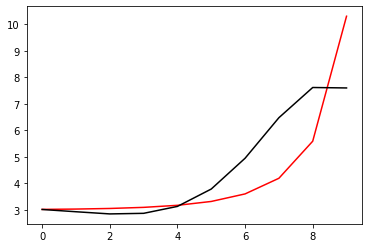

260700 0.04254647323147348
[2.95423638 2.84377396 2.7381531  2.73784    2.97580156 3.60416196
 4.72721724 6.2044605  7.32472486 7.67537602]


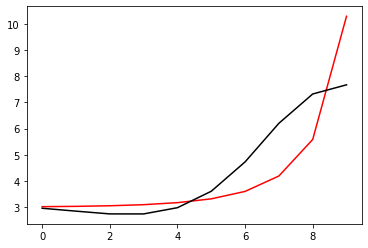

261800 0.022513530158498763
[3.07309462 2.9559089  2.84303134 2.83663347 3.06948986 3.69369326
 4.81482245 6.29759565 7.43402728 7.38297635]


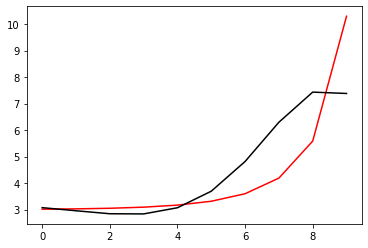

262900 0.010828365524832986
[3.06954641 2.96916051 2.87300453 2.88596014 3.14252478 3.79870736
 4.96781511 6.52439283 7.75167271 7.7829736 ]


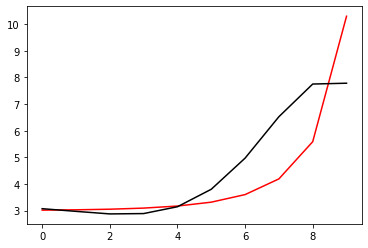

264000 0.06050889679588019
[3.13435632 3.00193522 2.87120921 2.8450497  3.05146478 3.63285317
 4.67725103 6.03214602 7.01863454 7.0174282 ]


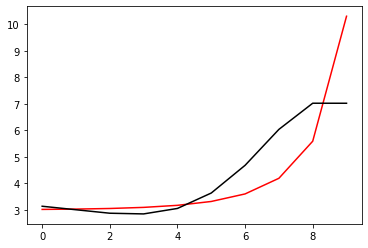

265100 0.01063971379861467
[3.09732645 2.97159977 2.84676296 2.82722917 3.04188699 3.6354659
 4.70237693 6.10156109 7.1443105  7.14538235]


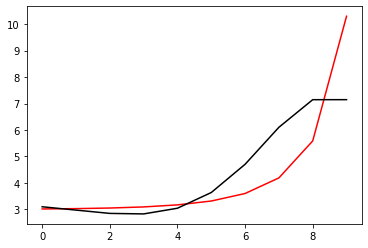

266200 0.011360313199200655
[3.03968944 2.92581288 2.81316923 2.80889849 3.04480964 3.67237156
 4.80138091 6.30895965 7.46511171 7.38759904]


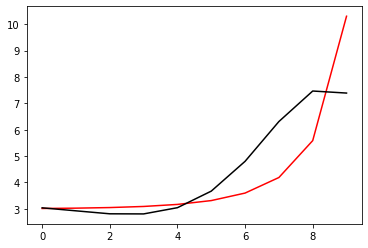

267300 0.010869370705715498
[3.06459823 2.9249844  2.78529003 2.75197069 2.95299052 3.53110211
 4.57784592 5.94315691 6.92396941 6.91005649]


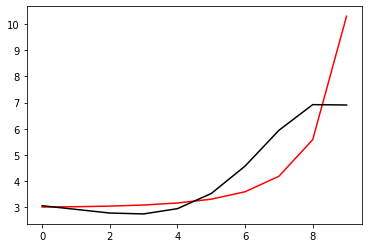

268400 0.004345497079190727
[3.07475117 2.9440202  2.81262453 2.78904067 3.0032077  3.60205026
 4.6861699  6.11569013 7.15770867 7.13953812]


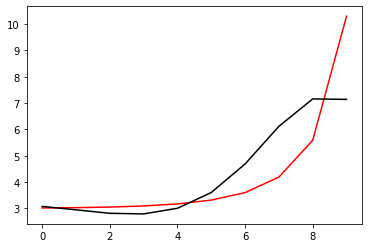

269500 0.0031013007401796714
[3.02087841 2.90190079 2.78147128 2.77030332 3.00062364 3.62435867
 4.75412323 6.26747289 7.40213406 7.39809307]


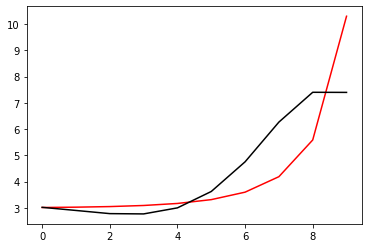

270600 0.603817594280294
[3.24718593 3.13086238 3.01216007 3.00315887 3.23752358 3.86810646
 5.00388762 6.49531198 7.58590089 7.73211454]


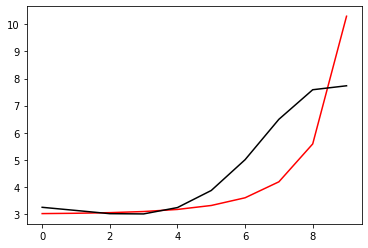

271700 0.010895648903532174
[3.11824603 2.9680907  2.81590819 2.77478708 2.97722471 3.57376193
 4.67256019 6.13578785 7.23443451 7.22777231]


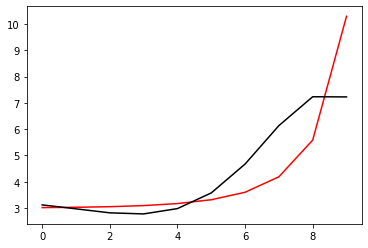

272800 0.01964403414360043
[3.12447655 2.99353145 2.85971622 2.83858977 3.06452778 3.69139313
 4.83321275 6.35952621 7.5346362  7.46236526]


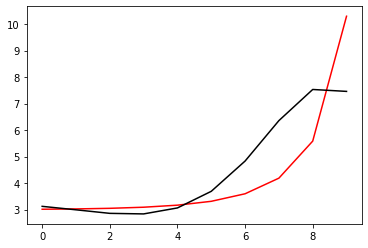

273900 0.06295373243747861
[2.97630964 2.81395282 2.64614794 2.58793568 2.76991154 3.33546334
 4.37311083 5.72089699 6.78533451 6.92620214]


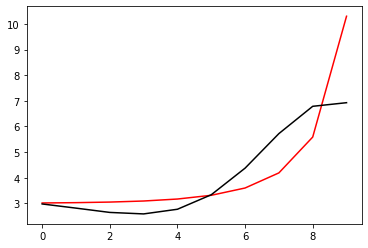

275000 0.06064103718771291
[3.13583548 2.96341002 2.78432116 2.71470182 2.88475018 3.43665169
 4.45767375 5.78757244 6.83559698 6.83270146]


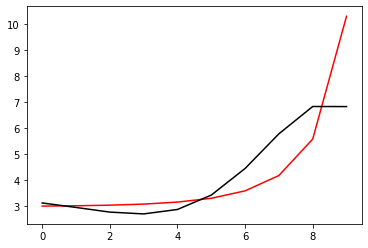

276100 0.010661077848262925
[3.16447802 3.00501051 2.83688847 2.77827061 2.9602611  3.52650615
 4.56787807 5.93177876 7.02704343 7.02701847]


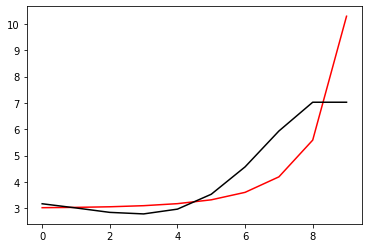

277200 0.01391176009847308
[3.08305414 2.94123603 2.79151221 2.7558771  2.96988044 3.58460394
 4.70402174 6.19006565 7.43095767 7.35383702]


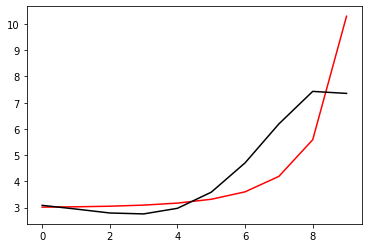

278300 0.011178372568632392
[3.11835867 2.93158583 2.73395627 2.6459411  2.79734357 3.32465752
 4.29777553 5.52664268 6.5396935  6.53580006]


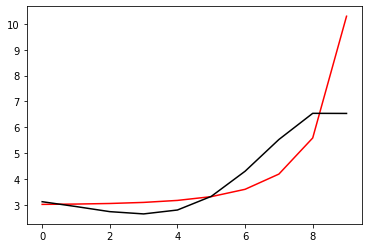

279400 0.013919730038849176
[3.10984023 2.9260081  2.73036017 2.64512528 2.80112111 3.33655586
 4.3253644  5.58548349 6.6433563  6.62282197]


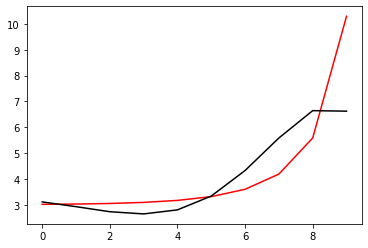

280500 0.010047597278292566
[3.17011083 2.98314101 2.7824546  2.69265601 2.84562139 3.3807033
 4.37525258 5.65671427 6.74792029 6.75482673]


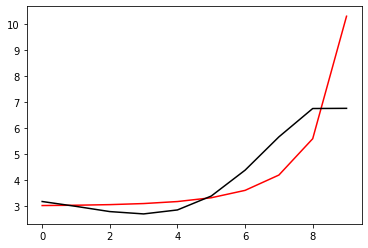

281600 0.008383870456786468
[3.11553506 2.94676775 2.7645601  2.6972249  2.88121962 3.46471243
 4.54314329 5.9638582  7.19687142 7.18453052]


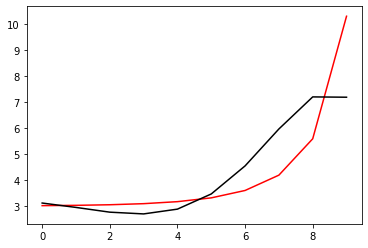

282700 0.10215591211763872
[3.01343677 2.83713759 2.64773219 2.57500087 2.75719899 3.34354328
 4.42661444 5.83416429 7.03704143 7.44768921]


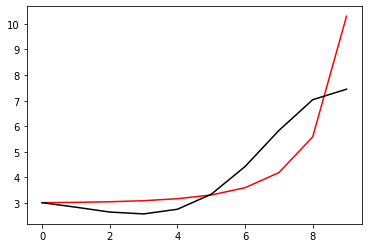

283800 0.02887218786947068
[3.19942974 3.01262831 2.81118551 2.72640735 2.89652573 3.46984792
 4.53826104 5.93252834 7.12452384 7.10950526]


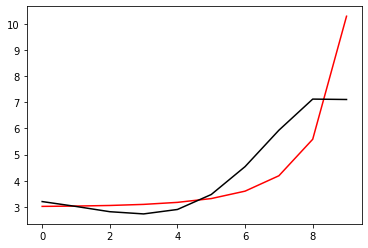

284900 0.0023912061178544665
[3.05556435 2.89956904 2.72619949 2.66917201 2.86927264 3.47881549
 4.59690879 6.06497495 7.34703609 7.4199605 ]


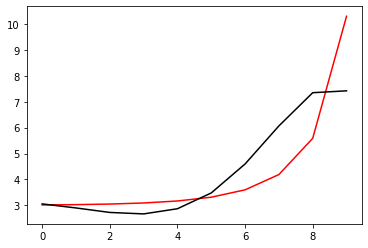

286000 0.05944393644279413
[3.02641298 2.89580098 2.74479012 2.70624271 2.92028473 3.53720292
 4.65408875 6.11734864 7.39526773 7.43698244]


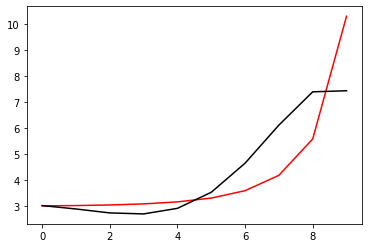

287100 0.01076541170273269
[3.10461335 2.99451787 2.86450917 2.84543481 3.07856757 3.71588357
 4.85887564 6.36457612 7.68916988 7.69018653]


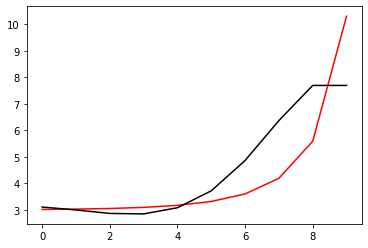

288200 0.015335418977095639
[3.08837908 2.94844834 2.78952054 2.74141988 2.94535699 3.55068519
 4.64984364 6.07648395 7.35557257 7.28361357]


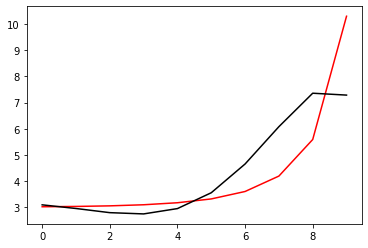

289300 0.01083063024964311
[3.06233515 2.93413236 2.78772004 2.75332975 2.97461297 3.60508966
 4.74493221 6.23972746 7.5984472  7.59873834]


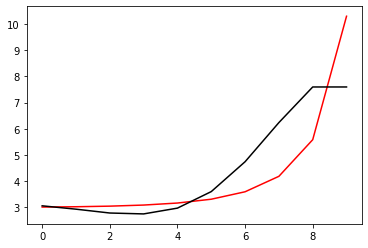

290400 0.012663471446324693
[3.08653257 2.91431895 2.72162249 2.63688069 2.79906862 3.34940538
 4.3587426  5.6346064  6.81925605 6.80878274]


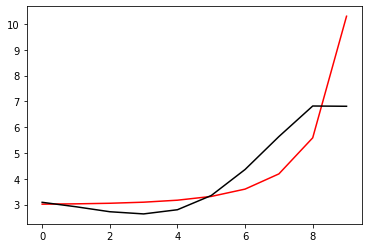

291500 0.00995975158498591
[3.1591136  2.98268237 2.7850776  2.69585914 2.85464007 3.40352849
 4.41596133 5.70695369 6.9155306  6.9137004 ]


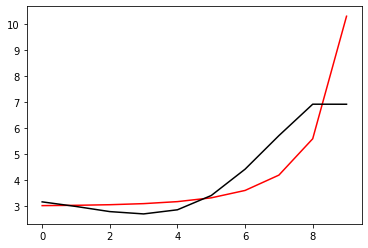

292600 0.010145707029602768
[3.10132659 2.9363119  2.75117943 2.67781538 2.8591522  3.44371689
 4.51751014 5.91250835 7.24259277 7.23961016]


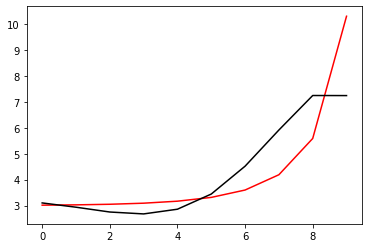

293700 0.02183369185316499
[3.14332553 2.9570803  2.75015365 2.65568514 2.81740226 3.3828024
 4.4307834  5.77360063 7.05125344 7.4306736 ]


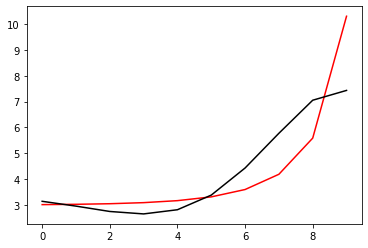

294800 0.030061095707977808
[3.10864802 2.9295593  2.72768508 2.63749582 2.80340375 3.37402447
 4.43137919 5.79603433 7.10526986 7.09758135]


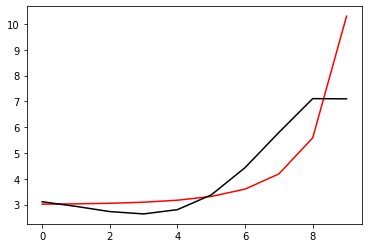

295900 0.011025293442172044
[3.13842725 2.96977672 2.77711121 2.69626754 2.87276252 3.45704723
 4.5355682  5.93850179 7.28946553 7.34465825]


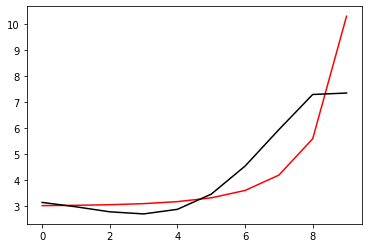

297000 0.060630171058620494
[3.13614597 2.99333313 2.82610291 2.77000801 2.97169917 3.58410772
 4.69994189 6.16220489 7.57488759 7.56987179]


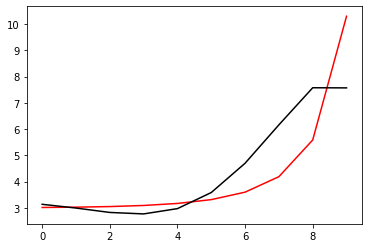

298100 0.010750788516765034
[3.12252559 2.93886848 2.73413151 2.64430303 2.81659    3.40174094
 4.48023092 5.86729887 7.22110221 7.21680785]


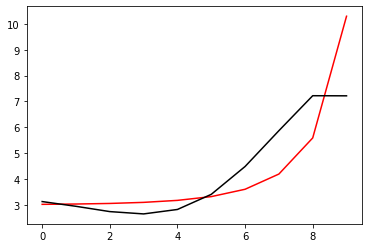

299200 0.016060613420146322
[3.11220832 2.939845   2.74482048 2.66479759 2.84856766 3.44943413
 4.55290915 5.98354654 7.39282133 7.34517495]


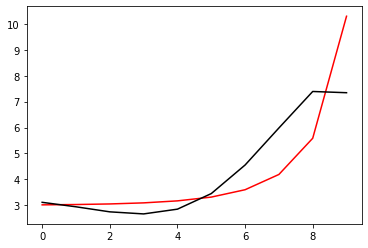

300300 0.01090520357300258
[3.09616336 2.94583933 2.77081229 2.70961125 2.91310379 3.53799443
 4.67680303 6.16718334 7.64826197 7.67521063]


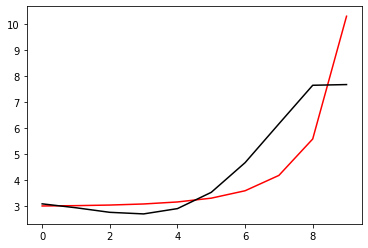

301400 0.013966983926118535
[3.13628874 2.94304579 2.72227256 2.61087971 2.75513402 3.29937423
 4.30647289 5.57660682 6.88573185 6.86800684]


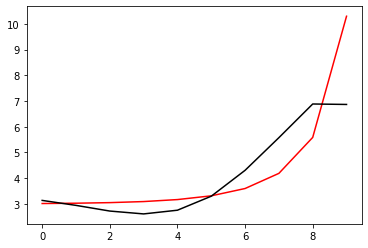

302500 0.0009241568633494066
[3.10606708 2.91972102 2.70455623 2.59855175 2.74878306 3.30111055
 4.32230137 5.62113962 6.96877811 6.96728011]


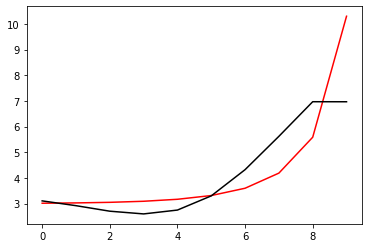

303600 0.010733681640621275
[3.10331687 2.92290322 2.7123266  2.61103205 2.76758697 3.3304373
 4.37271297 5.71674    7.12317195 7.12497254]


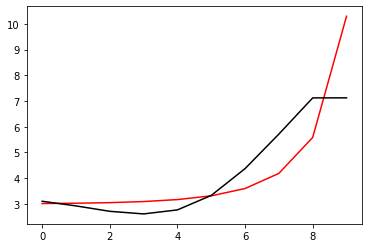

304700 0.012593172134198976
[3.14902968 2.98215589 2.78403995 2.69560571 2.86816158 3.45500737
 4.54004145 5.964772   7.4649766  7.39613404]


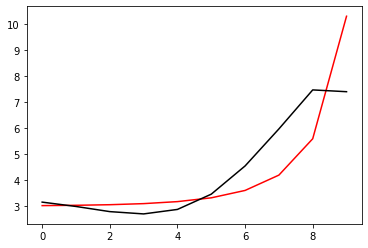

305800 0.030521070794968276
[3.09706271 2.91256783 2.69751567 2.59225415 2.74836296 3.31473194
 4.34860962 5.58851751 6.96234793 7.42592198]


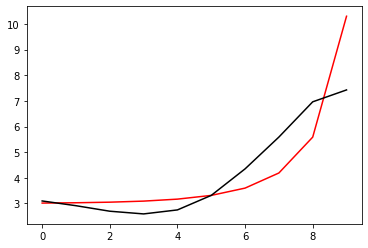

306900 0.011070770453059767
[3.22444725 3.03431758 2.81293782 2.70154379 2.85205129 3.41355918
 4.44436111 5.68848712 7.06570351 7.05829111]


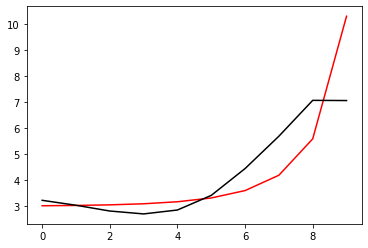

308000 0.06072144169663894
[3.2038729  3.0286821  2.82179939 2.72569374 2.89406605 3.47937206
 4.54652506 5.85167576 7.2949717  7.3004331 ]


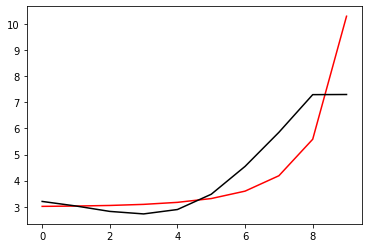

309100 0.010780355240353815
[3.12439716 2.96309846 2.77095889 2.69186416 2.88292115 3.50272479
 4.62785723 6.03299341 7.58099917 7.58176592]


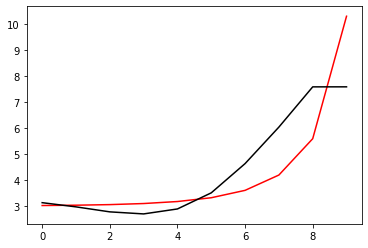

310200 0.01971759414991925
[3.00979631 2.88202835 2.71956172 2.66168307 2.86050684 3.46282657
 4.51238599 5.69821553 6.9468621  7.26679793]


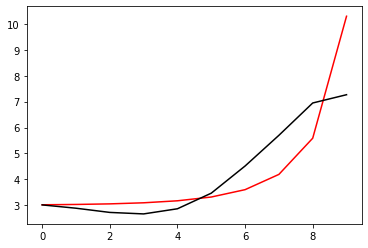

311300 0.01096688016759801
[3.07800874 2.94656208 2.78150782 2.72163586 2.9190913  3.52070249
 4.57048137 5.75923623 7.00280822 6.99057106]


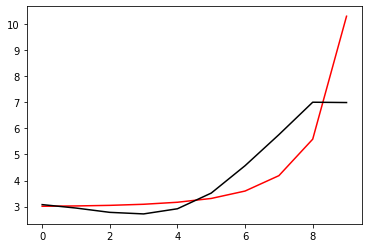

312400 0.004678525980995431
[3.08167039 2.9570863  2.79940716 2.7473325  2.95451124 3.57081698
 4.64696154 5.88571147 7.17750865 7.16046874]


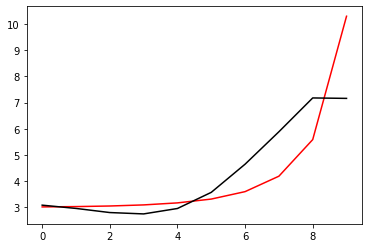

313500 0.008162414033917481
[3.0563812  2.94294103 2.79749011 2.75808219 2.98055282 3.61937586
 4.73565649 6.05118369 7.41830161 7.42079962]


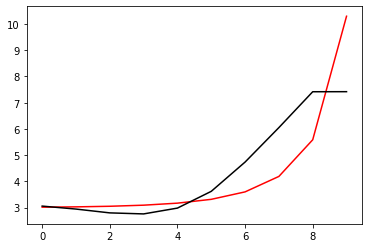

314600 0.6999978156613187
[3.32927294 3.21493329 3.06968408 3.02935002 3.25086278 3.88928205
 5.00090726 6.27499348 7.53305451 7.68550967]


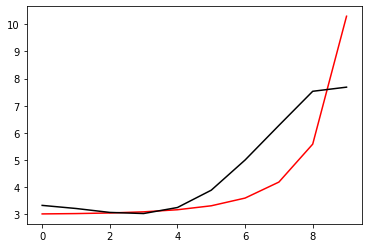

315700 0.0189182815085478
[3.12565888 2.97552065 2.79312209 2.71146946 2.8819588  3.44872487
 4.4513194  5.58636927 6.76727945 6.74699851]


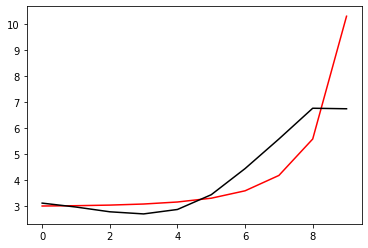

316800 0.02873323127163465
[3.15657619 3.01590504 2.84278241 2.77052316 2.95160699 3.53258379
 4.55814031 5.73500366 6.95804029 6.94645577]


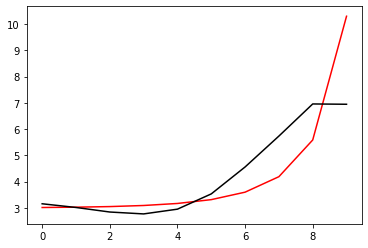

317900 0.010698866350485198
[3.12764056 3.00529181 2.85117581 2.79884679 3.00325475 3.61647584
 4.69443223 5.96175083 7.27743362 7.30905837]


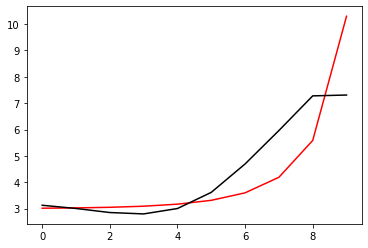

319000 0.06062495977782223
[3.13336873 2.97166919 2.78242042 2.69640918 2.86572704 3.43690069
 4.45561935 5.63690822 6.82716804 6.85298025]


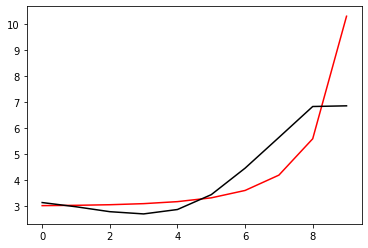

320100 0.010648084274363406
[3.15880535 3.00149757 2.81617551 2.73419052 2.90817902 3.48599156
 4.51638739 5.72106134 6.93526855 6.93587786]


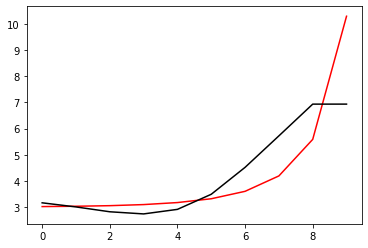

321200 0.019586651433684467
[3.15090824 3.00400063 2.82921839 2.75900617 2.94787559 3.54795817
 4.61714486 5.89239934 7.1838679  7.09096522]


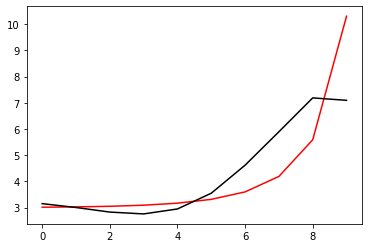

322300 0.010985975341502734
[3.08729283 2.95760273 2.80033293 2.74833849 2.95823153 3.58742747
 4.7058368  6.07180973 7.45990852 7.49881971]


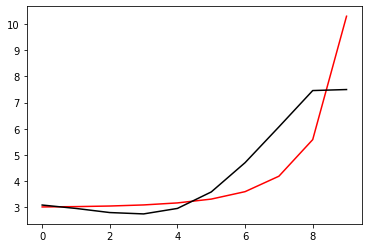

323400 0.007809064400275184
[3.15157252 2.99158113 2.80243136 2.71551233 2.88482347 3.46218412
 4.50729734 5.77102544 7.0404076  7.02328453]


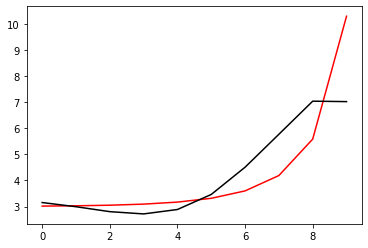

324500 0.006598876945676764
[3.1011616  2.95105161 2.77315008 2.69979342 2.88655154 3.48902141
 4.57438021 5.9054611  7.25334281 7.24913769]


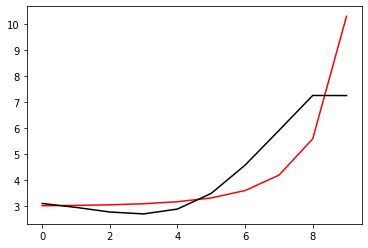

325600 0.0008715928082959536
[3.1285891  2.98317323 2.81191137 2.74757898 2.94721448 3.5701035
 4.69141665 6.08897899 7.50981601 7.53910619]


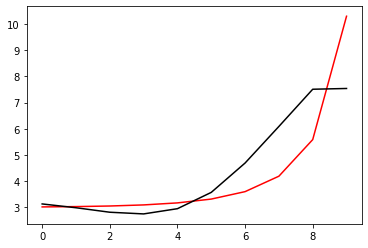

326700 0.0107459950951201
[3.09845606 2.9795078  2.83383504 2.79183518 3.00878497 3.64298287
 4.77224428 6.19152138 7.63246068 7.62856463]


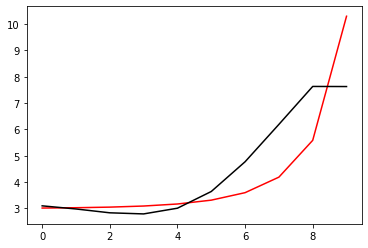

327800 0.01686103165553261
[3.05852504 2.97773605 2.87425248 2.87525971 3.13614129 3.81815422
 5.0053741  6.48716227 7.91946571 7.80195281]


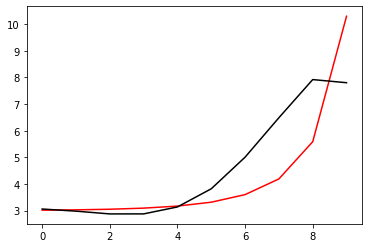

328900 0.010675155504946713
[3.03925878 2.96755951 2.87243726 2.87748979 3.13470245 3.79796713
 4.93051714 6.25853287 7.45158264 7.42495273]


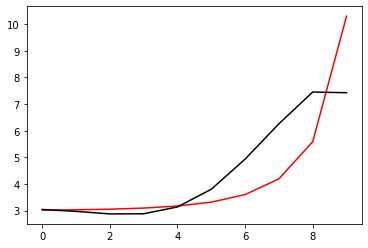

330000 0.0598689113374944
[3.01484311 2.95148045 2.86708766 2.88360299 3.15474165 3.84024284
 5.02327531 6.47397384 7.70080067 7.69827216]


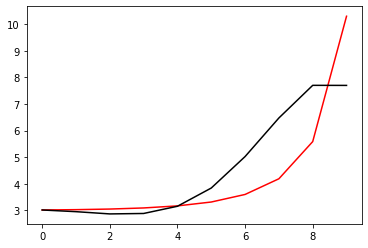

331100 0.02506067038470161
[2.91897218 2.81779823 2.69630764 2.67277094 2.89662181 3.51892755
 4.60626431 5.89232826 6.94248077 6.9778141 ]


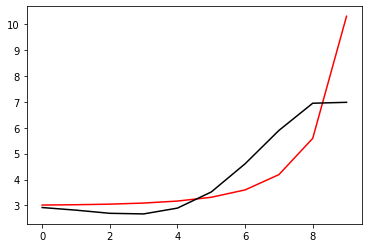

332200 0.016306944422358725
[3.06748462 2.96318171 2.83925511 2.81370932 3.03568838 3.65619496
 4.74227309 6.03195504 7.0867925  7.027426  ]


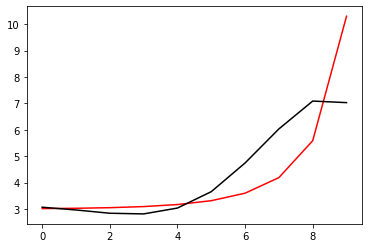

333300 0.011010542457339413
[3.04766984 2.95230901 2.83878759 2.82488589 3.06054747 3.69956396
 4.81500346 6.15767433 7.28111022 7.28415233]


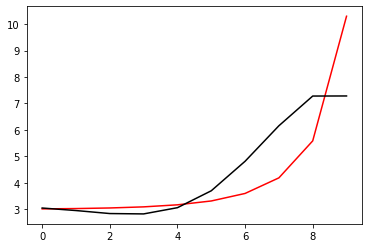

334400 0.0014606095807518753
[2.98953313 2.90920973 2.81371972 2.81941128 3.07691422 3.74366092
 4.90123739 6.31904699 7.53537575 7.51041423]


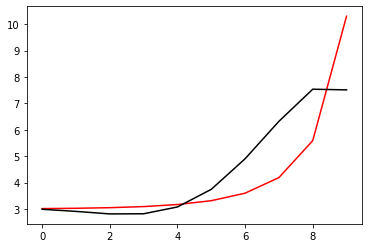

335500 0.007529683272614558
[3.03647945 2.92825998 2.8048939  2.78162553 3.00640431 3.6311506
 4.72576226 6.05319506 7.2099349  7.2043313 ]


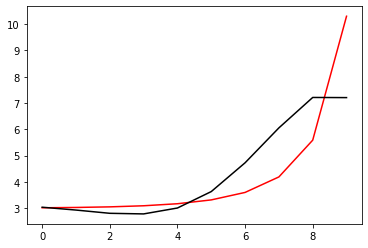

336600 0.0009501866373590358
[3.02775632 2.92777712 2.81597823 2.80751358 3.05101108 3.70198713
 4.8390115  6.24089646 7.47553541 7.48600612]


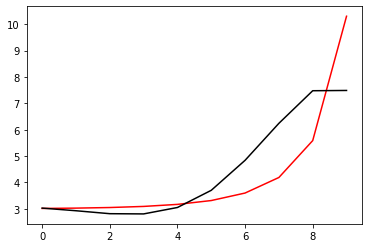

337700 0.010951671970053919
[3.07290885 2.97891181 2.87769593 2.88401593 3.14710442 3.82668684
 5.01193325 6.50014943 7.81575271 7.83780655]


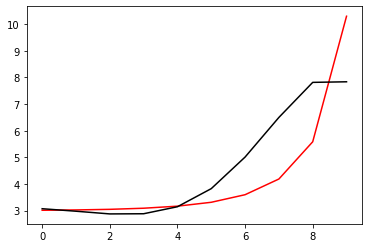

338800 0.027350574843413078
[2.9846761  2.89852107 2.80410691 2.81341054 3.07095926 3.72725764
 4.84784172 6.18051963 7.3038791  7.25198282]


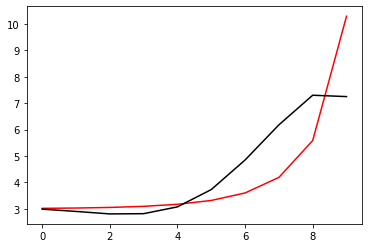

339900 0.010757147516113855
[3.02401955 2.9504438  2.87037222 2.8962274  3.17508833 3.86504937
 5.05241079 6.51823991 7.70857227 7.68951853]


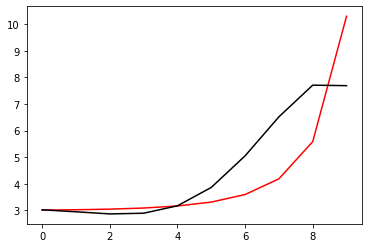

341000 0.10395160500055231
[2.92667891 2.82990307 2.72963642 2.73580505 2.99244751 3.65373488
 4.8036475  6.22953502 7.33033364 7.36851468]


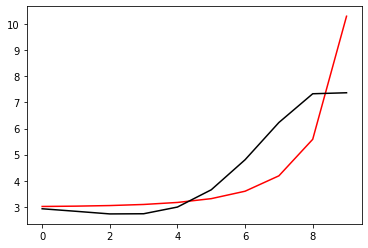

342100 0.01070605139215455
[3.02438024 2.92555945 2.82400549 2.8299068  3.08729461 3.75070521
 4.90504839 6.34007137 7.44910095 7.45034268]


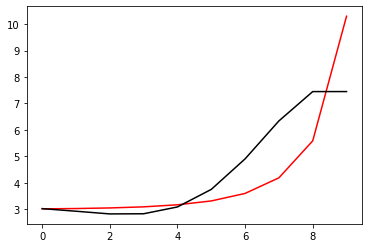

343200 0.0070805029830472675
[3.00474327 2.91494742 2.82271628 2.83905694 3.10919283 3.79090621
 4.97636237 6.46817705 7.64997525 7.59574674]


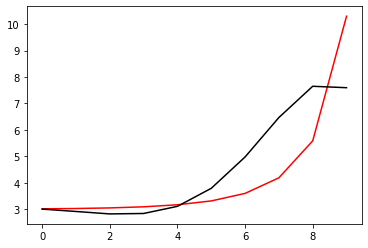

344300 0.010823438661665411
[2.93945666 2.86534156 2.7898561  2.82435407 3.11562014 3.82606973
 5.05855783 6.63451506 7.9203261  7.94278828]


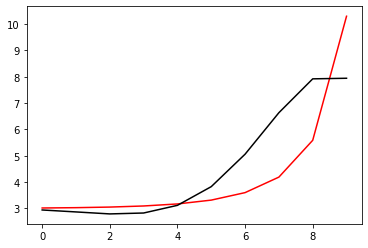

345400 0.003474483170682416
[3.0110997  2.94125584 2.86932824 2.90395228 3.18781808 3.87429138
 5.03929155 6.43703507 7.53158573 7.55149272]


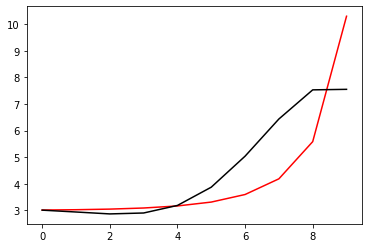

346500 0.0017105520308210668
[2.93010301 2.86680677 2.8017796  2.84312689 3.13392912 3.82995322
 5.0188828  6.50081163 7.66419132 7.64488218]


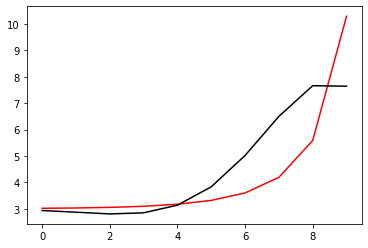

347600 0.0012308724310286267
[3.0036671  2.94331218 2.88519084 2.93684639 3.24382923 3.97020337
 5.22872297 6.83618586 7.98333614 7.94807283]


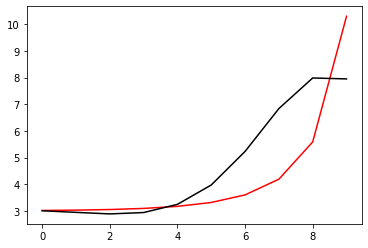

348700 0.10940838893361662
[2.85463196 2.79056373 2.72437413 2.75893301 3.03161989 3.68974459
 4.80839781 6.12371222 6.95484426 7.0651925 ]


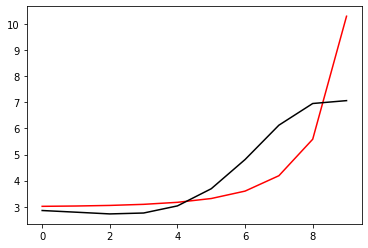

349800 0.026378781650475087
[2.98262748 2.90794577 2.83350756 2.86189808 3.13017062 3.78530969
 4.90156561 6.21372836 7.03403259 7.00190552]


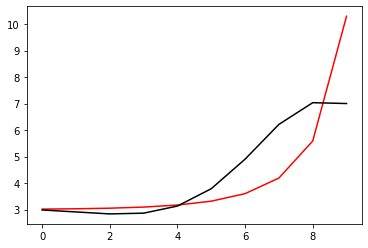

350900 0.010661392058580932
[2.99140169 2.92185877 2.85299026 2.88762751 3.16346659 3.82939259
 4.96393219 6.3103591  7.17127254 7.16710948]


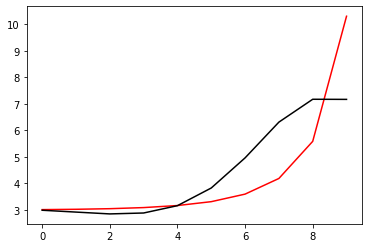

352000 0.05999352198535913
[2.99255322 2.93142966 2.87187526 2.91679867 3.20483029 3.88778059
 5.05086601 6.4507898  7.37549046 7.3700718 ]


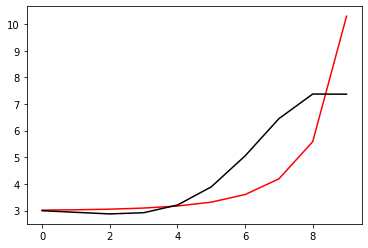

353100 0.010567832415410159
[3.04619935 2.9443802  2.84252082 2.84138155 3.07468169 3.68355415
 4.73053782 5.94401161 6.71435472 6.71451464]


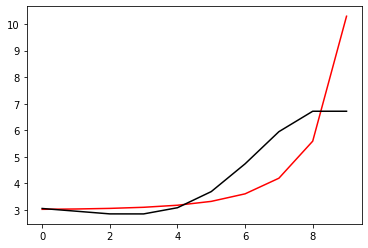

354200 0.01455651984255525
[3.04032282 2.94724113 2.85547326 2.86713741 3.11726737 3.75023693
 4.83450763 6.10715874 6.94609551 6.86749059]


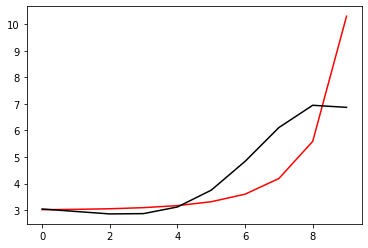

355300 0.01069422530041019
[2.97678395 2.89293892 2.8125343  2.83886521 3.10817263 3.7686134
 4.89688409 6.24460353 7.17245845 7.19664909]


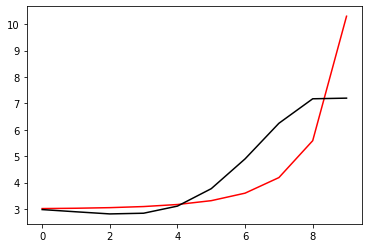

356400 0.007867848501329277
[3.08426982 2.95332826 2.82269084 2.79426055 2.99846195 3.5703328
 4.55967932 5.69510758 6.45801632 6.41602348]


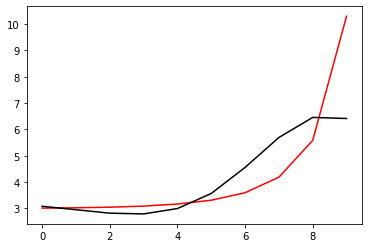

357500 0.008547823051484436
[3.04720964 2.92585703 2.80537962 2.79001864 3.01191935 3.61014753
 4.64279967 5.85199427 6.70870231 6.70728924]


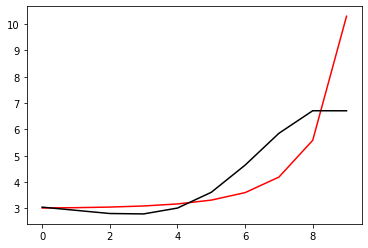

358600 0.00909413041923629
[2.99009038 2.88325229 2.77826559 2.78180217 3.02787044 3.66023148
 4.74732392 6.04830916 7.01324705 7.00733614]


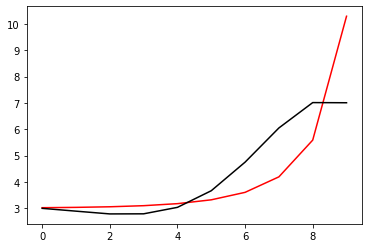

359700 0.10916518463378463
[2.92468276 2.80065547 2.67979463 2.66970095 2.90361194 3.522559
 4.58453166 5.83222188 6.7712257  7.17339319]


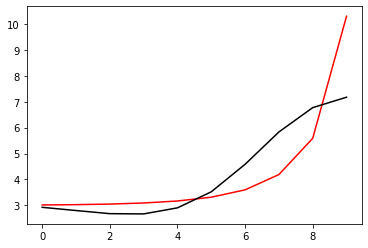

360800 0.029569729474754253
[3.04296024 2.91070052 2.78069945 2.76193728 2.98721975 3.59694419
 4.64968697 5.89377821 6.8341866  6.82102697]


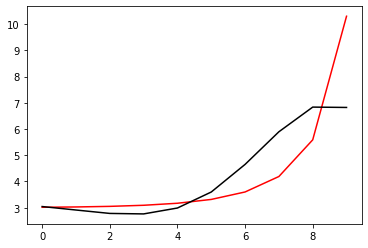

361900 0.010708344313770247
[3.10615507 2.99252109 2.8780247  2.87346119 3.11201722 3.7350221
 4.80456663 6.07919189 7.05973398 7.07299348]


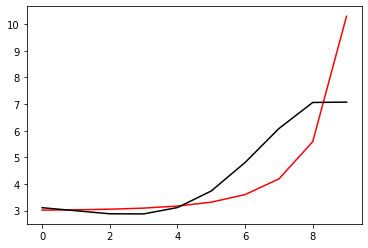

363000 0.1127351407257572
[2.96540432 2.81933383 2.67038788 2.62842329 2.8224809  3.38398081
 4.35535203 5.48254331 6.35389212 6.37623825]


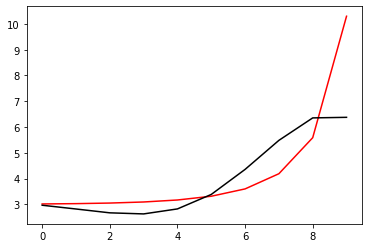

364100 0.010553160515255055
[3.1765504  3.0129434  2.84585109 2.78609307 2.96177968 3.50232529
 4.44791964 5.54546882 6.38150256 6.38662226]


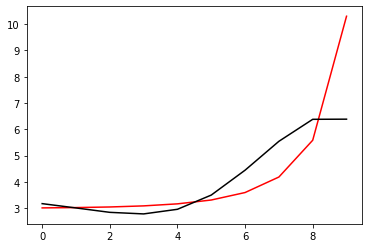

365200 0.02509072377177655
[3.16669167 3.01569844 2.86057846 2.81503623 3.00925652 3.57668179
 4.56595797 5.73770084 6.66969342 6.57193475]


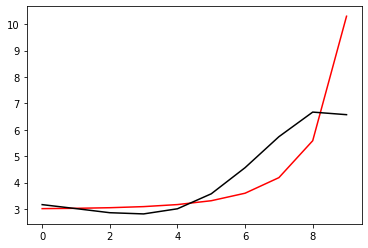

366300 0.011146186410487473
[3.07965444 2.94582912 2.80836793 2.78472177 3.00883714 3.62132696
 4.68517055 5.97938245 7.0528716  7.08370491]


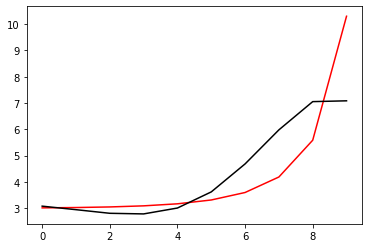

367400 0.00727207291859013
[3.11606133 2.95668376 2.79202794 2.74133326 2.93800552 3.51926977
 4.53854153 5.76028602 6.7795617  6.75013146]


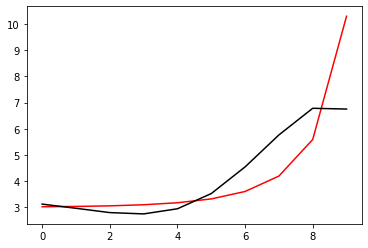

368500 0.005589429697538373
[3.00707926 2.86212177 2.71335228 2.68356976 2.91002438 3.53680725
 4.62975843 5.96489587 7.10272131 7.08270767]


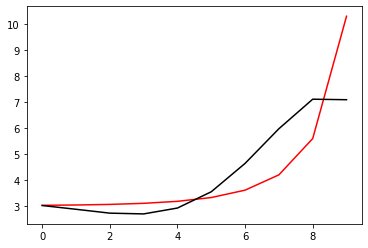

369600 0.010490458160676605
[3.04913193 2.90999609 2.76210065 2.72545278 2.9305586  3.50607104
 4.47766207 5.46732236 6.24054694 6.25568447]


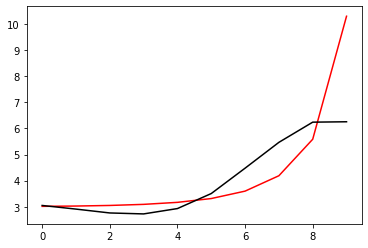

370700 0.02899619968889401
[3.03331091 2.89918831 2.75552877 2.72293535 2.93261314 3.51441972
 4.4971354  5.51177793 6.31569577 6.30885351]


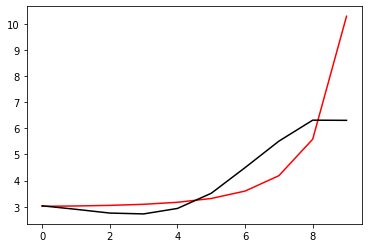

371800 0.028536096435862163
[3.13085841 2.99791282 2.85539748 2.82472845 3.03793548 3.62601693
 4.62036656 5.66009076 6.48049003 6.47337314]


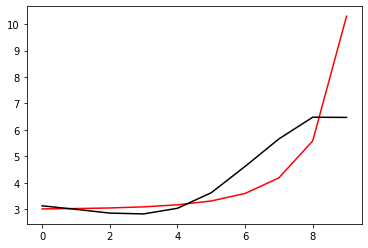

372900 0.010647994385403193
[3.10660394 2.9907914  2.8663536  2.85620539 3.09580206 3.72293236
 4.78309802 5.93772716 6.87030513 6.90372289]


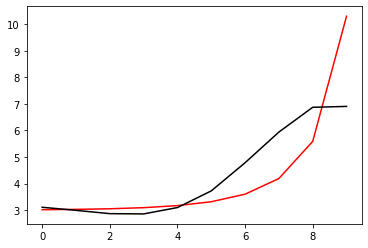

374000 0.060309918119277876
[3.06620928 2.96422101 2.8554644  2.86324614 3.12643479 3.78946329
 4.91279713 6.18643598 7.23353023 7.21289553]


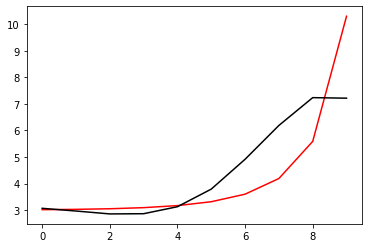

375100 0.4547995733810588
[2.69304067 2.61064752 2.52316911 2.55215644 2.83906274 3.53363304
 4.7097373  6.0897607  7.24354976 7.61880792]


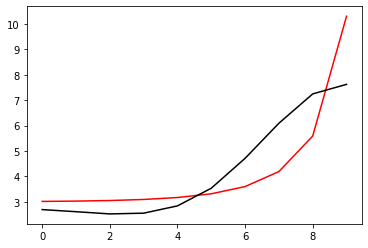

376200 0.012515570758686973
[3.0101655  2.92718009 2.83803311 2.86139309 3.13487693 3.79884531
 4.90293017 6.1247544  7.05341162 6.98065093]


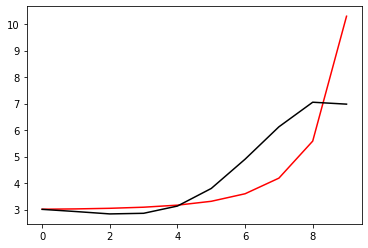

377300 0.010726287556186855
[2.96093375 2.89107066 2.81782587 2.85876054 3.15429018 3.85261546
 5.02676851 6.39653539 7.39796499 7.3960111 ]


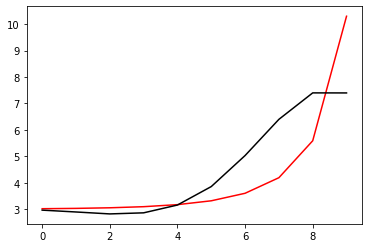

378400 0.003073438957644679
[3.02603717 2.91427076 2.80035679 2.80070747 3.05351725 3.7018967
 4.8077682  6.05930805 6.94782981 6.92410681]


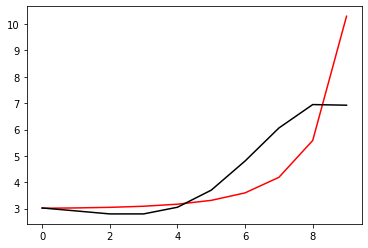

379500 0.0011509160306754176
[2.96206031 2.86058995 2.75881431 2.77408432 3.04660272 3.72376152
 4.87553573 6.20556785 7.18734172 7.16763787]


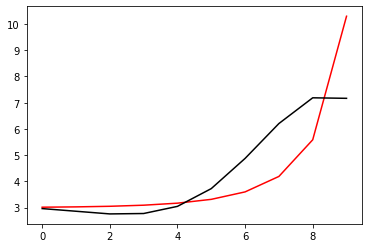

380600 0.0007498109728707201
[2.99077837 2.91255264 2.83519581 2.87588795 3.17672301 3.88904382
 5.08990709 6.498848   7.56391153 7.50970977]


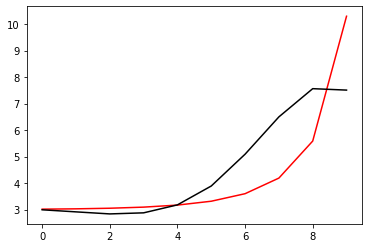

381700 0.11202676537695677
[2.86774879 2.75325302 2.64261682 2.64991732 2.91385401 3.57901314
 4.71064644 6.02920056 7.0138877  7.44032619]


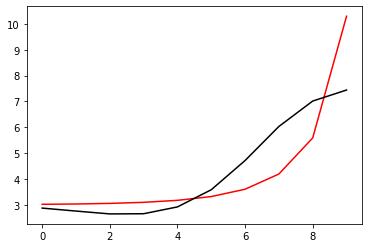

382800 0.024417156403667668
[3.06927128 2.94962524 2.83275412 2.8331101  3.08843169 3.74167058
 4.85637388 6.15638553 7.12016627 7.08273335]


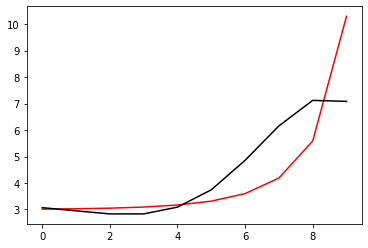

383900 0.010705041831823518
[3.05924755 2.95237437 2.8473378  2.85995887 3.1290915  3.80013336
 4.94188489 6.29074843 7.31933824 7.33111278]


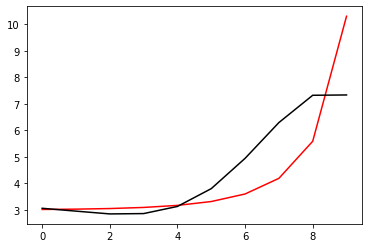

385000 0.1124275932266797
[2.94285027 2.80265731 2.66192097 2.63519854 2.85708422 3.46273405
 4.49908469 5.68744055 6.60123168 6.62801976]


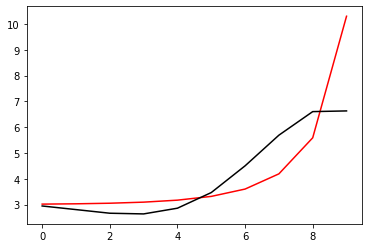

386100 0.01058284210676597
[3.03826241 2.89370897 2.74743205 2.7148235  2.930061   3.52765084
 4.55460347 5.7367992  6.6464913  6.64747372]


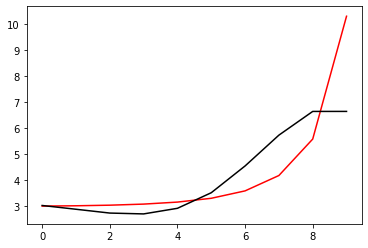

387200 0.01693940555684859
[3.04278237 2.90424786 2.76310352 2.73650515 2.95951215 3.56852783
 4.61521742 5.83659272 6.79939895 6.75367789]


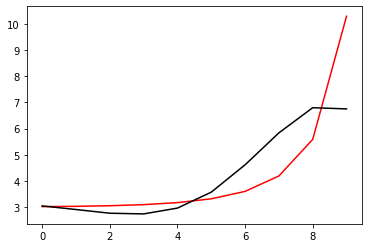

388300 0.011085065662091617
[3.06408521 2.94358545 2.81967064 2.81184672 3.05742054 3.69705464
 4.79093191 6.09146284 7.14865547 7.20105809]


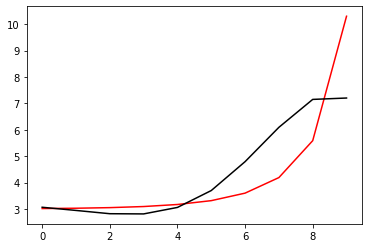

389400 0.004801440568698383
[3.0741396  2.93258576 2.7870159  2.758043   2.98243214 3.59797515
 4.65719648 5.90834113 6.93926414 6.90293127]


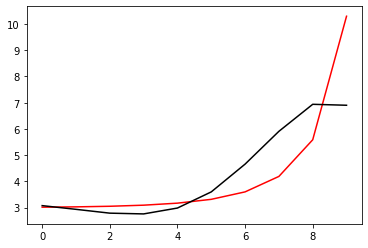

390500 0.0011306926246096528
[2.99651505 2.86730535 2.73584346 2.72573148 2.97758168 3.63630754
 4.76659304 6.1273044  7.26588236 7.24675654]


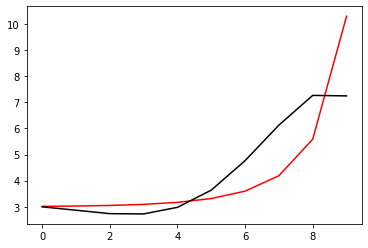

391600 0.0008288616823694998
[3.02340902 2.91367852 2.80185957 2.81230515 3.08749556 3.77588823
 4.950292   6.38323147 7.58649986 7.57549401]


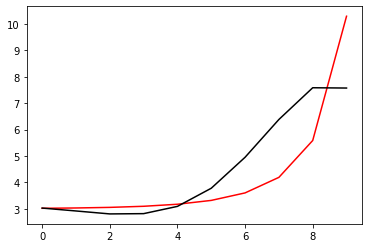

392700 0.017041587379296053
[3.00609105 2.90533337 2.80044795 2.81227835 3.07762252 3.7317672
 4.80708521 5.84964037 6.70938946 6.71822989]


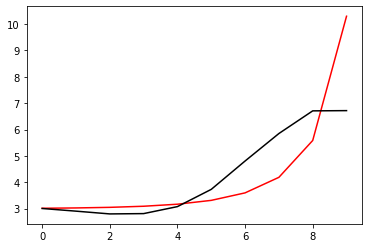

393800 0.027539922032549676
[3.0237994  2.92812536 2.82848657 2.84589476 3.11801218 3.78170269
 4.87229127 5.94469981 6.83607866 6.80914486]


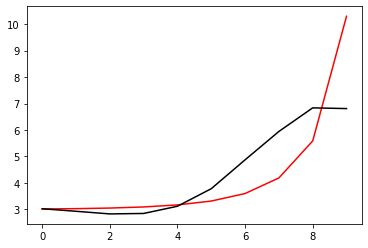

394900 0.010645435588322875
[3.02895856 2.94158462 2.85063376 2.87706837 3.15979895 3.83806413
 4.95190028 6.07113999 7.0131459  7.01501529]


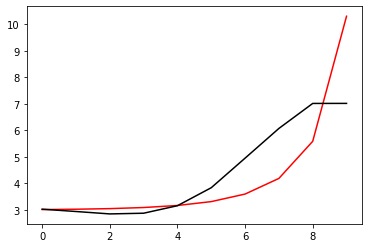

396000 0.05917913495203146
[3.02845326 2.95476251 2.87867471 2.92050133 3.2211084  3.92354693
 5.07532527 6.2686812  7.28681944 7.26887216]


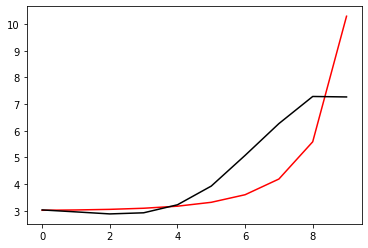

397100 0.010607920454687947
[3.05582837 2.95587178 2.85331207 2.8659818  3.13208289 3.78851709
 4.8715859  5.98218725 6.94107911 6.94341598]


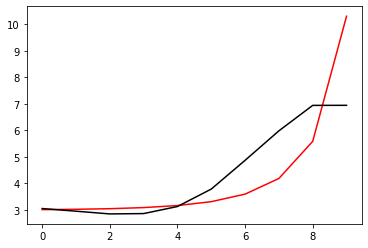

398200 0.01065985492047454
[2.99114618 2.9038156  2.81720207 2.84956012 3.14151885 3.83526539
 4.97673958 6.18760807 7.24723362 7.20540655]


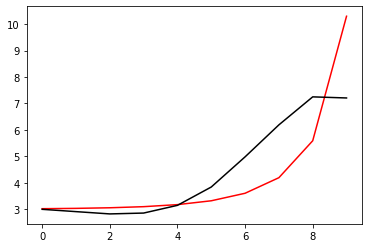

399300 0.010690446682181508
[2.996523   2.88056569 2.76431145 2.76500816 3.02050513 3.66654399
 4.7362407  5.85240758 6.84057956 6.83238219]


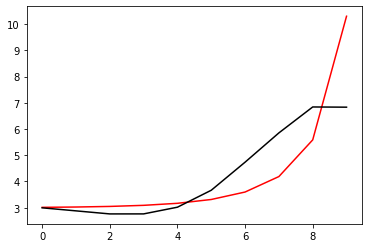

400400 0.0022952390520742977
[3.00226666 2.89932562 2.79637213 2.81159146 3.08418504 3.75289372
 4.85712217 6.03747628 7.09359747 7.0673938 ]


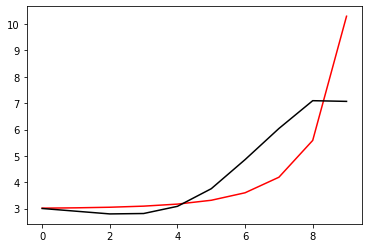

401500 0.0012188739751651358
[3.02944688 2.8843502  2.74014925 2.71430066 2.94272028 3.55759829
 4.58828822 5.67579376 6.63125538 6.62042217]


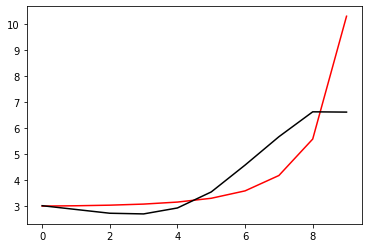

402600 0.0009433538678981712
[3.10543131 2.96134535 2.81796721 2.79486707 3.02901427 3.65473727
 4.70622571 5.83771989 6.84895546 6.80705102]


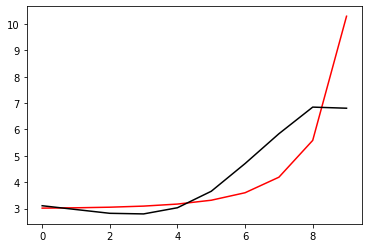

403700 0.011668724016016992
[3.05736182 2.92858864 2.79957678 2.79266626 3.04719758 3.7022466
 4.80196581 6.02266616 7.14007016 7.09109409]


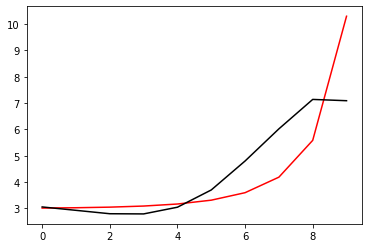

404800 0.03043333767139894
[3.02515616 2.87050565 2.71608601 2.68500082 2.9159866  3.54525312
 4.60995461 5.79034506 6.87987816 6.99738184]


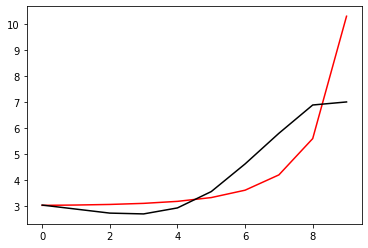

405900 0.010724533558918874
[3.06159912 2.91308962 2.76251102 2.7345901  2.96848803 3.60114343
 4.67230242 5.87172735 6.98524864 6.98165442]


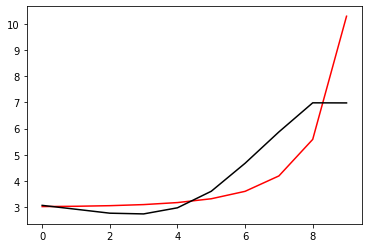

407000 0.06038134429263033
[3.12006514 2.98941319 2.8529628  2.83686236 3.08087903 3.72296586
 4.80678697 6.03682575 7.18629117 7.18359828]


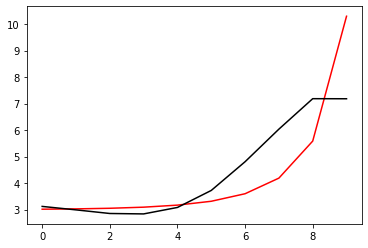

408100 0.010515721140640194
[3.0363782  2.86913792 2.69775776 2.64839964 2.85925865 3.46393476
 4.49844347 5.6699581  6.76981375 6.77054835]


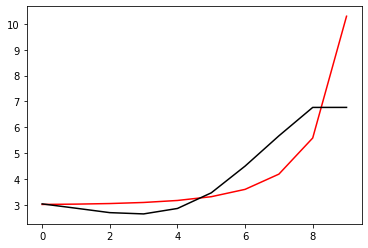

409200 0.022940875895694768
[3.16786194 2.99267367 2.81222191 2.75487079 2.95959485 3.56086148
 4.5971917  5.78383536 6.90479626 6.81958674]


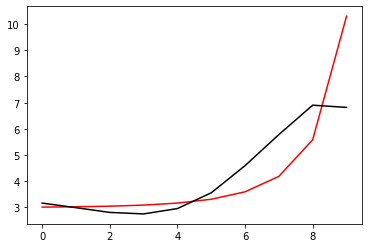

410300 0.011282484714603894
[3.1106269  2.9529487  2.78895749 2.74993802 2.97738282 3.61036898
 4.69653272 5.96663432 7.18372331 7.20670107]


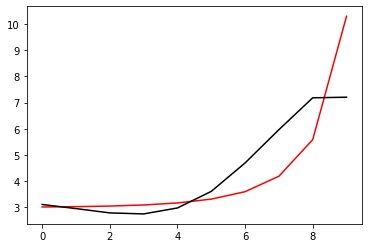

411400 0.0018294545511070908
[3.04907574 2.91309038 2.77059067 2.75614503 3.01571688 3.69586218
 4.85742968 6.24822653 7.58744847 7.544893  ]


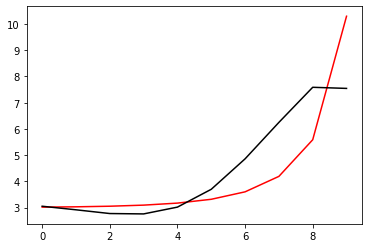

412500 0.0010198172244769695
[3.06780358 2.89310347 2.71118233 2.65670648 2.87292644 3.49861256
 4.57677204 5.84255177 7.08105131 7.07638505]


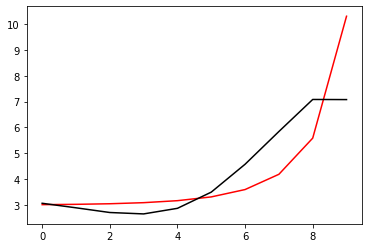

413600 0.010549549140974229
[3.05592919 2.89453771 2.72308825 2.67827776 2.90482839 3.54373655
 4.64333241 5.95077608 7.24048595 7.24478609]


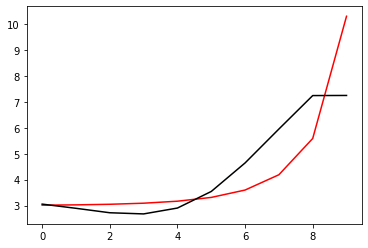

414700 0.18209028795235022
[3.28545488 3.11631994 2.93195972 2.86897134 3.06991704 3.66750966
 4.68916748 5.86220082 7.04943177 7.32335535]


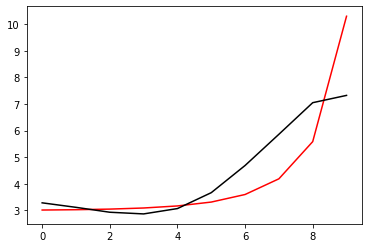

415800 0.030390357148283368
[3.10852336 2.91447578 2.70472258 2.61579373 2.78834712 3.35174872
 4.33068529 5.45746282 6.60227149 6.60025248]


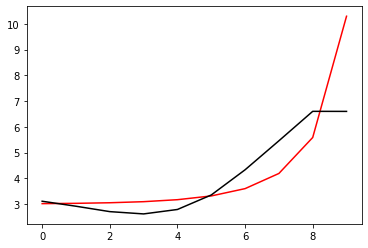

416900 0.011043958770516917
[3.2229009  3.02989699 2.82000142 2.73167204 2.90660126 3.4756741
 4.46738661 5.6224211  6.79909886 6.79526647]


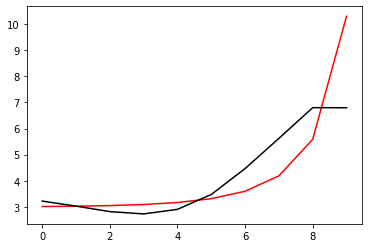

418000 0.06067577502907957
[3.19041111 3.01603931 2.82287579 2.75204362 2.94824855 3.54775996
 4.59048058 5.83541617 7.11635401 7.11509221]


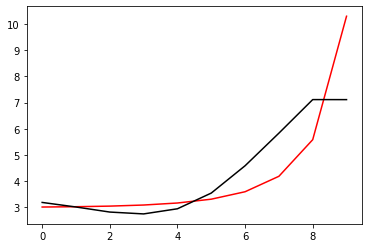

419100 0.010709798669322902
[3.11701397 2.94067649 2.74449095 2.67052392 2.86420001 3.46233001
 4.50866567 5.7789697  7.10029846 7.10726347]


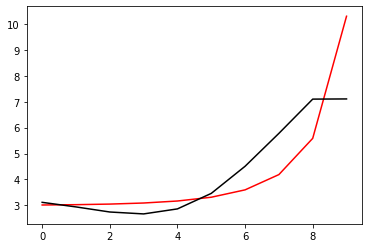

420200 0.013372146747853171
[3.13963459 2.98495639 2.81140032 2.76296423 2.98952149 3.63641014
 4.76467711 6.17067516 7.62236105 7.43081076]


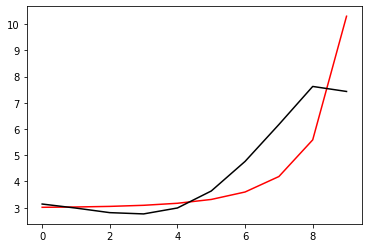

421300 0.010979050371298846
[3.11984018 2.92083312 2.70150214 2.60444804 2.77570099 3.34978864
 4.3582811  5.53066122 6.78564935 6.79944306]


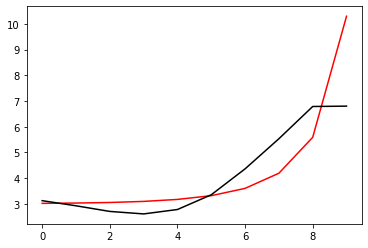

422400 0.009060988631529161
[3.18872857 2.98520803 2.76129047 2.66129983 2.83268234 3.41222512
 4.43640995 5.64439595 6.94371464 6.91469956]


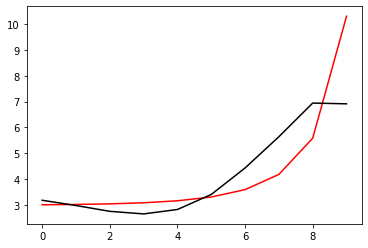

423500 0.004058799910474703
[3.13344259 2.94245743 2.73077025 2.64521529 2.83641832 3.44718404
 4.52620431 5.83086377 7.24011583 7.23295239]


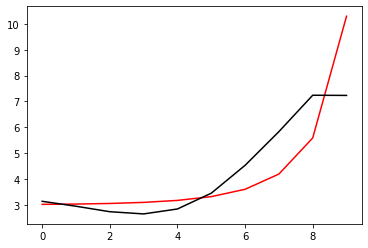

424600 0.00920210122744974
[3.10685978 2.92837092 2.72880254 2.6573995  2.86869787 3.51236004
 4.65068366 6.059472   7.57143556 7.59004828]


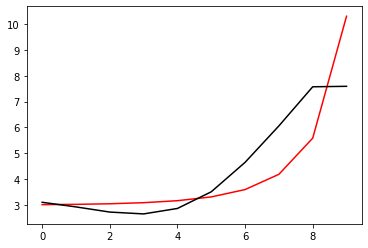

425700 0.43046519834395514
[3.3534137  3.16829169 2.95874166 2.87403043 3.0686898  3.68790048
 4.7725854  6.02787815 7.38912328 7.67604215]


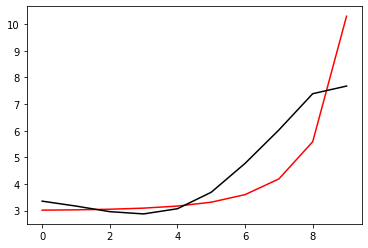

426800 0.030349770600217457
[3.1291983  2.92078175 2.68658632 2.57612773 2.74276674 3.32959585
 4.37774349 5.60596093 6.96316563 6.95955953]


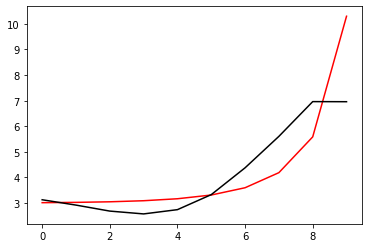

427900 0.01099198622671535
[3.24052447 3.03420946 2.8012305  2.69301002 2.86449258 3.4611718
 4.52899248 5.79690486 7.19676017 7.198286  ]


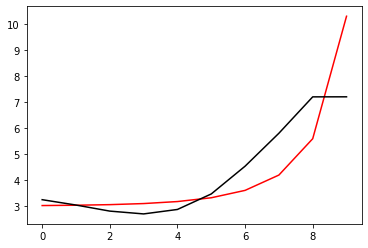

429000 0.060814647483881705
[3.17098551 2.97880708 2.75936477 2.66670569 2.85941222 3.48935749
 4.61464377 5.98305999 7.49125938 7.49095021]


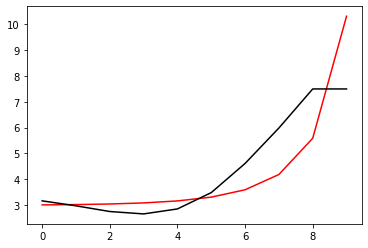

430100 0.010809694425347155
[3.16893267 2.97974329 2.76071661 2.66572257 2.85266517 3.4709229
 4.57605574 5.92854635 7.41800048 7.42132536]


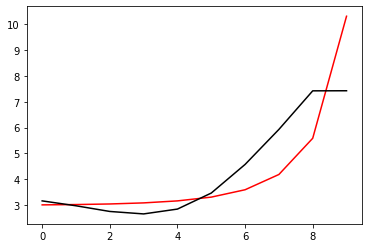

431200 0.01006576443066368
[3.13950149 2.96857859 2.76978899 2.69906967 2.91988426 3.59267625
 4.79510484 6.31470969 7.96194075 7.79122304]


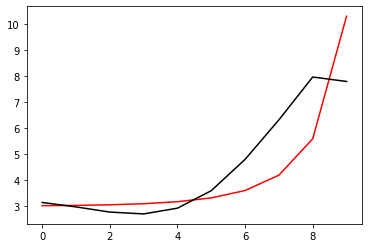

432300 0.014517499614722165
[3.21702104 3.01154822 2.77424051 2.65844345 2.82168969 3.40831396
 4.45176237 5.63945481 6.95149291 6.96421806]


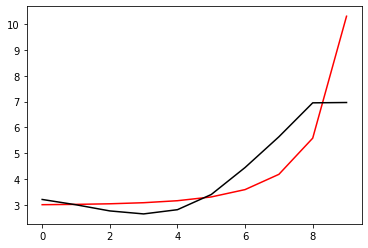

433400 0.00824627728615029
[3.19419912 2.99706996 2.76698942 2.6583347  2.83018167 3.43019077
 4.50043688 5.74280649 7.08808434 7.06076156]


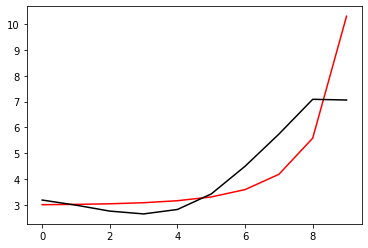

434500 0.009048466038210128
[3.15930445 2.97387908 2.75427548 2.65615686 2.84105013 3.46189125
 4.57427943 5.90145132 7.29819764 7.2964284 ]


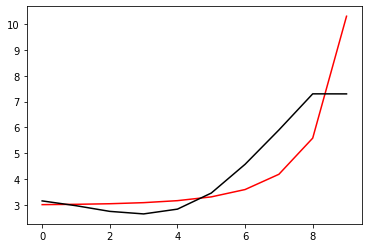

435600 0.010269900752896103
[3.09136108 2.92347996 2.72022425 2.63819377 2.84241889 3.49336217
 4.66565929 6.11103071 7.58104706 7.58122448]


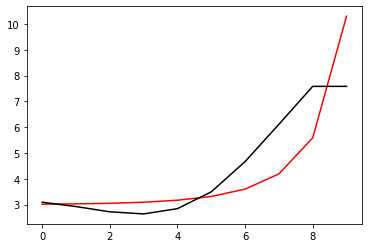

436700 0.010877061522676654
[3.21748179 3.03579854 2.81586712 2.71308461 2.89335872 3.51665809
 4.65215047 6.0134477  7.38449552 7.73071751]


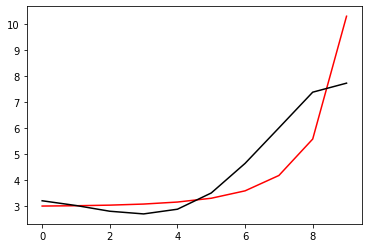

437800 0.024477988289739953
[3.17526623 3.0088247  2.80544129 2.72063337 2.9224311  3.57530924
 4.75630367 6.19086143 7.62896678 7.58559533]


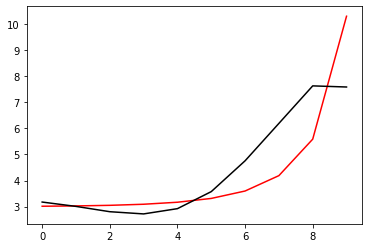

438900 0.01089059053621488
[3.16801277 3.00522797 2.8070126  2.72809319 2.9381924  3.60534661
 4.81398403 6.30954108 7.80813087 7.82653847]


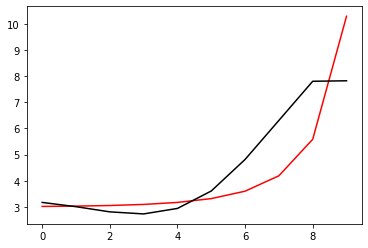

440000 0.05940224034245202
[3.09854282 2.92053051 2.70641543 2.60873083 2.79488193 3.42730007
 4.57668331 5.97127799 7.33268474 7.34998655]


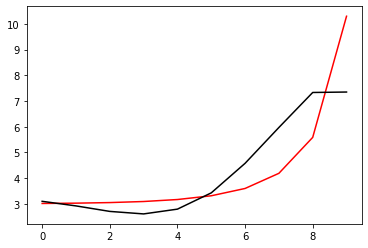

441100 0.010816858520350124
[3.11257585 2.94105168 2.73226997 2.63900659 2.82948883 3.46787779
 4.62926096 6.05337563 7.43426517 7.43558699]


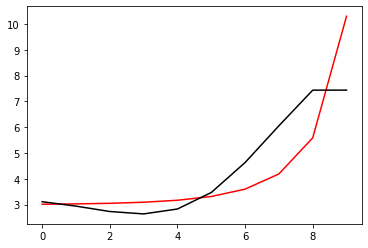

442200 0.011858930252008015
[3.11113077 2.95797481 2.76723193 2.69217714 2.90422293 3.57468852
 4.79463926 6.32528164 7.77406048 7.70406337]


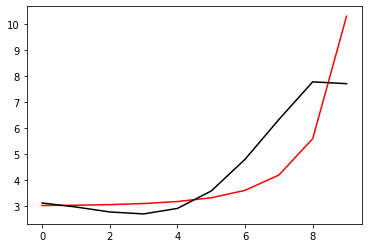

443300 0.010929638074730184
[3.06307668 2.9215354  2.74383513 2.68183181 2.90936994 3.60425586
 4.8744023  6.51562111 8.06062947 8.08804937]


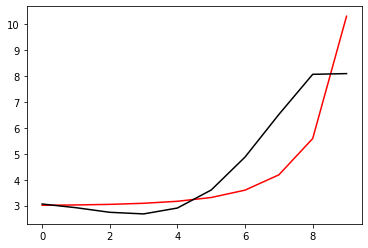

444400 0.00724840697216235
[3.18839884 2.99842851 2.77140803 2.6574314  2.82671819 3.44707212
 4.59650237 5.96116544 7.24634901 7.21935666]


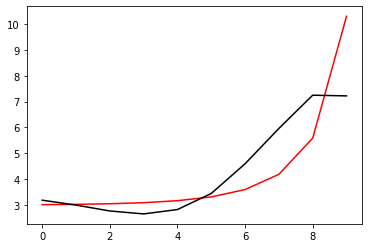

445500 0.009515164879821257
[3.15951574 2.97841617 2.76044711 2.65637702 2.83758208 3.47461038
 4.65063518 6.06369503 7.4085053  7.40478733]


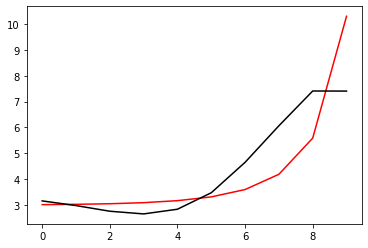

446600 0.008962805335634079
[3.10215092 2.93397547 2.72993066 2.64124065 2.84099278 3.50393209
 4.72128007 6.20920343 7.64188035 7.63441734]


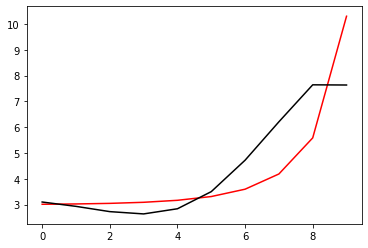

447700 0.567005915354767
[3.37668423 3.20443883 2.99509395 2.89827895 3.08535268 3.72468715
 4.88139006 6.21544474 7.52049243 7.71887483]


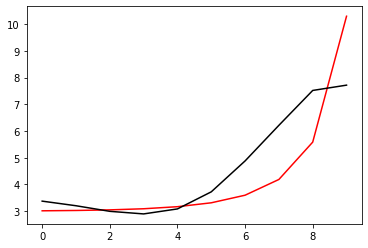

448800 0.03010670268134429
[3.14310625 2.95510419 2.72808836 2.61164998 2.77606388 3.3883404
 4.51582177 5.84243122 7.18389268 7.17268033]


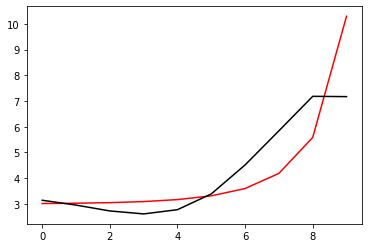

449900 0.010592715263526672
[3.11610917 2.94078464 2.7259016  2.62163643 2.7993834  3.42904785
 4.5842055  5.96542133 7.36941048 7.36246315]


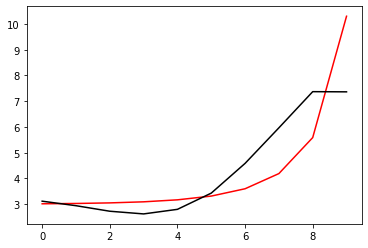

451000 0.06072315009982206
[3.15665261 3.00299996 2.808743   2.72302818 2.9180107  3.56625611
 4.74813407 6.18716984 7.65362245 7.64539738]


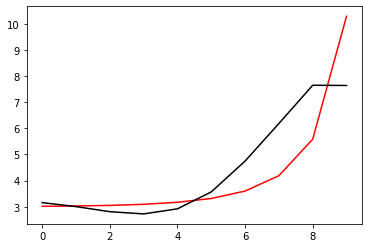

452100 0.010877265478275059
[3.2526902  3.06130002 2.83007534 2.706562   2.86112325 3.46058871
 4.56855051 5.89368942 7.27068757 7.32718306]


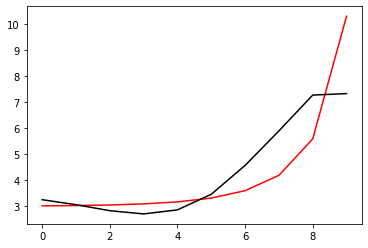

453200 0.01645398368309838
[3.18649047 3.00756194 2.79057396 2.68454956 2.86222279 3.49604203
 4.66072213 6.08210926 7.5619685  7.4591089 ]


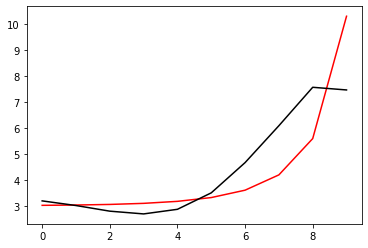

454300 0.011061060050931068
[3.13123004 2.96829148 2.76908685 2.68365289 2.8873943  3.55930975
 4.78728707 6.31761649 7.90273002 7.93126128]


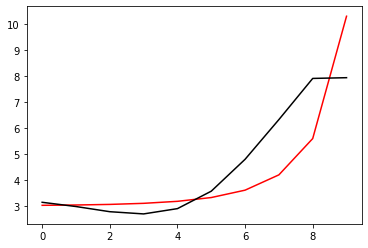

455400 0.009503259682180661
[3.21077121 3.01205735 2.77345522 2.6425307  2.78798998 3.37174471
 4.43745642 5.6554249  6.93703464 6.9200268 ]


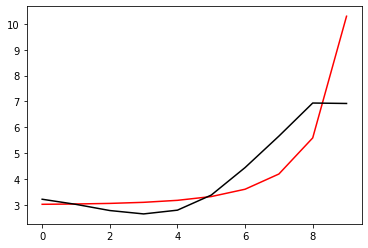

456500 0.010137300273386864
[3.1902192  2.99954981 2.76808608 2.6444312  2.79858539 3.39562667
 4.48760085 5.76030962 7.08202236 7.07676014]


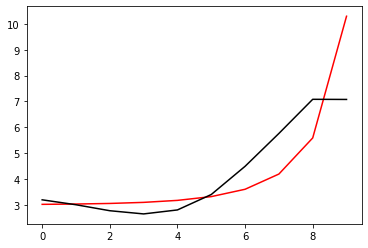

457600 0.002083048570049423
[3.17642531 2.99973039 2.78149734 2.67176542 2.84303654 3.46634385
 4.60822684 5.97416699 7.3510978  7.31601744]


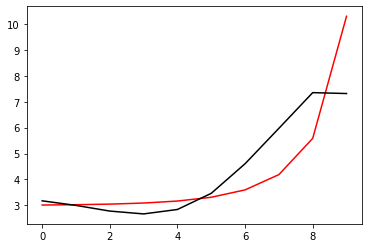

458700 0.012252880396612806
[3.12922756 2.96817315 2.76545657 2.6721657  2.86427349 3.52115165
 4.72989903 6.22442881 7.68799878 7.61866187]


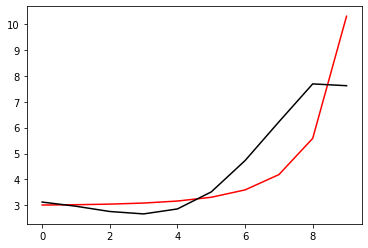

459800 0.0307754511780566
[3.08345626 2.90276705 2.68085685 2.56796377 2.74101309 3.38072545
 4.57336447 6.03240828 7.45344983 7.54737251]


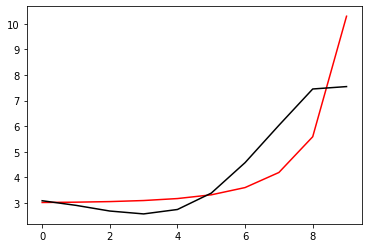

460900 0.011045526289434855
[3.14076235 2.96606746 2.74871613 2.63913949 2.81444661 3.45610689
 4.65304833 6.13033591 7.57573064 7.5748215 ]


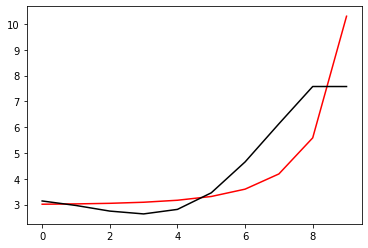

462000 0.4482732699154854
[3.26602095 3.13806143 2.96428629 2.89335536 3.10099517 3.76537965
 4.95540312 6.19433557 7.31809721 7.68697749]


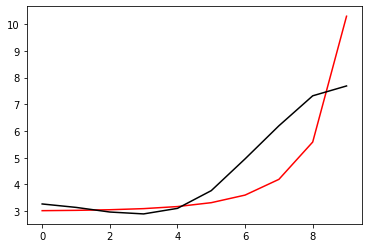

463100 0.010677247805459594
[3.10894973 2.98249577 2.80847039 2.73333366 2.92967862 3.56819297
 4.69890583 5.84282454 7.06680539 7.0672332 ]


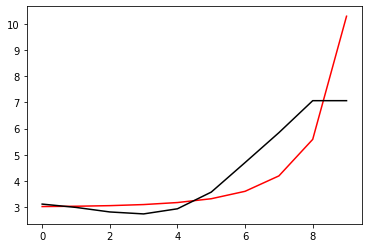

464200 0.015502748299484774
[3.11292728 2.99384066 2.82874273 2.76358455 2.9728779  3.63203084
 4.80187132 6.02148737 7.28368778 7.20662614]


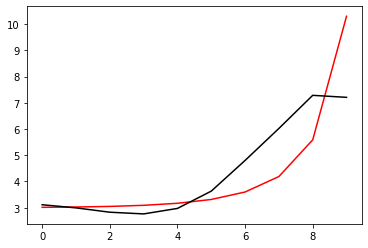

465300 0.011002000571104403
[3.07438786 2.96558502 2.81278783 2.76010139 2.98371445 3.66375144
 4.87297994 6.1806791  7.50097814 7.52865088]


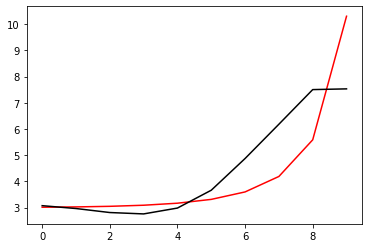

466400 0.0012570356047314519
[3.00452828 2.91390582 2.78337605 2.75318742 3.0017165  3.715972
 4.98543829 6.41871974 7.81904439 7.80097386]


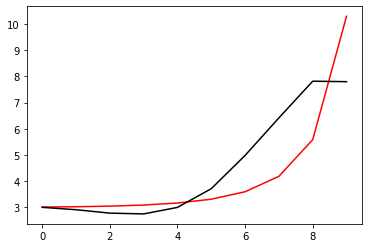

467500 0.008548488260469769
[3.08029932 2.95654006 2.7918494  2.72342247 2.92523603 3.57354525
 4.72803748 5.92916705 7.15723685 7.14518334]


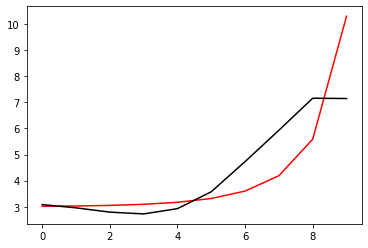

468600 0.008518411174368225
[3.02834353 2.91379607 2.7625343  2.7107401  2.93365585 3.61194824
 4.81451953 6.10680114 7.41844211 7.40649961]


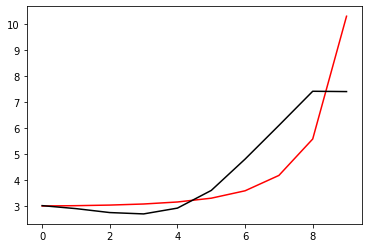

469700 0.109723192513977
[2.95734174 2.82258923 2.65627539 2.59179994 2.80283389 3.46752875
 4.64542359 5.90135578 7.16985319 7.57125453]


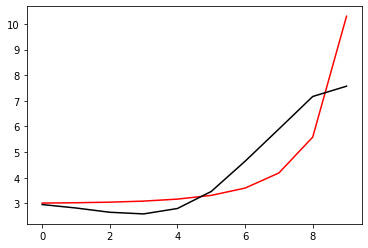

470800 0.026493834863530547
[3.14063678 2.99686865 2.82198388 2.74941829 2.95196809 3.60684487
 4.77348188 6.02630684 7.29006326 7.26424913]


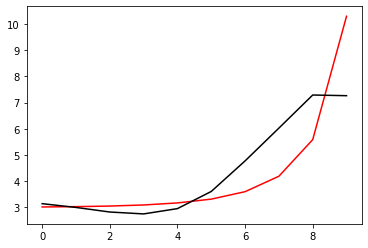

471900 0.010838352690347695
[3.13421997 3.00783843 2.85056911 2.79598168 3.01735323 3.69428424
 4.8918432  6.2032456  7.53199438 7.54620032]


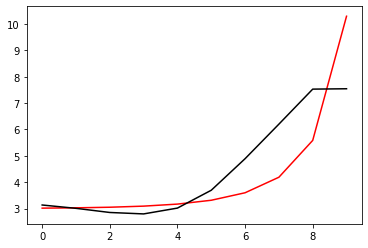

473000 0.10637171430203907
[3.01681922 2.85681359 2.6649102  2.57216556 2.74694057 3.35825462
 4.4494255  5.60683959 6.81870426 6.84245891]


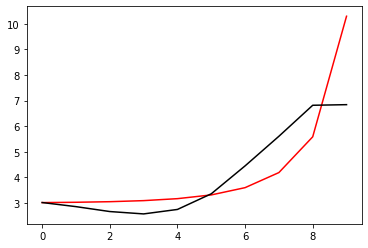

474100 0.010878185654834406
[3.24030627 3.06703239 2.86076653 2.75266086 2.90954778 3.49773405
 4.55723679 5.67911121 6.84455952 6.85107524]


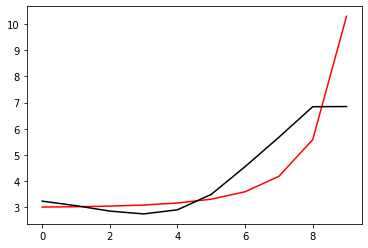

475200 0.021443483150382754
[3.17818335 3.01719058 2.82433223 2.73234224 2.90949019 3.52620751
 4.63193645 5.83837048 7.10028153 6.98888793]


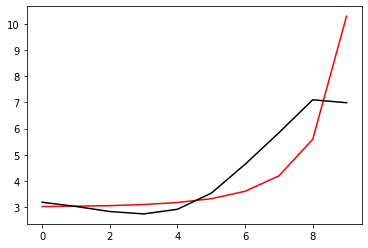

476300 0.01104803083922038
[3.10828447 2.96045747 2.7830506  2.71070393 2.91398886 3.56964609
 4.74131722 6.06827605 7.45296878 7.5005028 ]


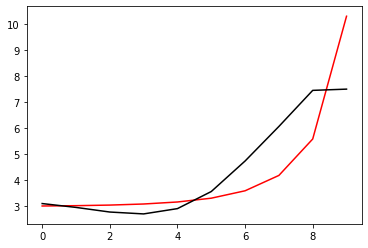

477400 0.007870766341935228
[3.18359745 2.98745995 2.76405689 2.64865441 2.80972249 3.41911016
 4.53021145 5.77414083 7.06831717 7.03361016]


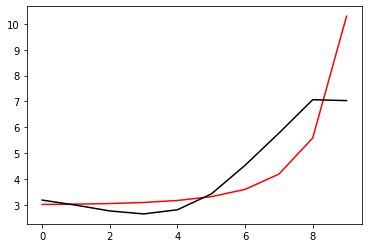

478500 0.005148691617579804
[3.13582499 2.95302446 2.74217716 2.64109734 2.81975491 3.45352336
 4.60329493 5.91599735 7.2923594  7.28805044]


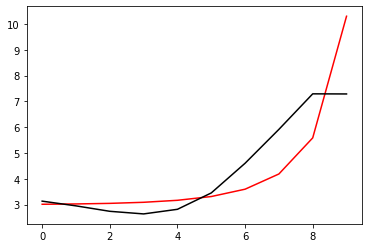

479600 0.0009487120343873814
[3.16143983 2.9922464  2.79395281 2.70618562 2.89995183 3.55324768
 4.73398923 6.10875416 7.55249214 7.5823333 ]


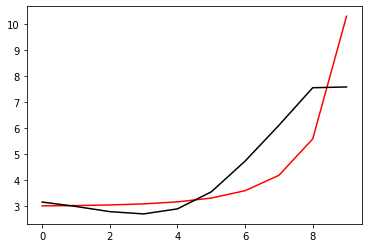

480700 0.02369851029925997
[3.10218707 2.94597012 2.75694939 2.67172166 2.85490995 3.47098283
 4.5522397  5.61621886 6.70345659 6.69049629]


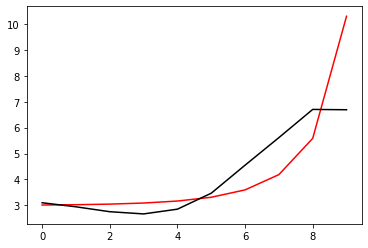

481800 0.030086150718591317
[3.0945737  2.94299861 2.75845582 2.67791515 2.86662299 3.49048842
 4.58542624 5.68004619 6.80057408 6.79353325]


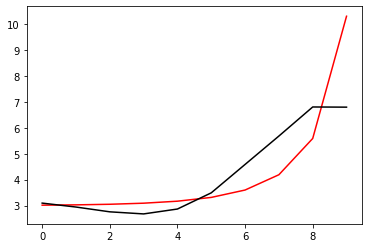

482900 0.011066233122584089
[3.07943317 2.93616273 2.7597369  2.6875115  2.8857341  3.52263283
 4.6400034  5.78448321 6.95810176 6.95128078]


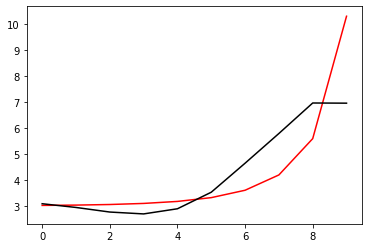

484000 0.05979700170723845
[3.00628617 2.8923746  2.74360806 2.69699738 2.92007629 3.58422183
 4.73920913 5.95658063 7.19872612 7.15681561]


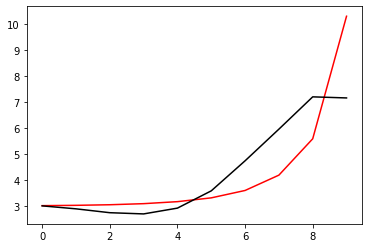

485100 0.010760089514342019
[3.09812202 3.00405399 2.87641979 2.84839143 3.08738587 3.76571253
 4.93838657 6.20627872 7.48837772 7.49605892]


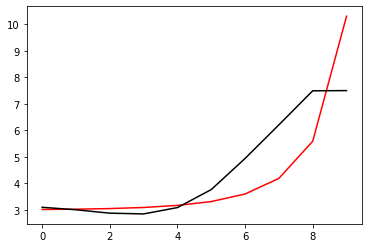

486200 0.018135588203078177
[3.08835425 2.953506   2.78907761 2.72477722 2.92499507 3.55582569
 4.65830958 5.82162769 7.0192895  6.97136789]


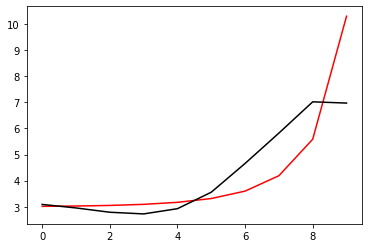

487300 0.011131320242608728
[3.08437949 2.96169865 2.81070715 2.76125298 2.97868681 3.63193408
 4.76863491 5.99476012 7.25907094 7.2474541 ]


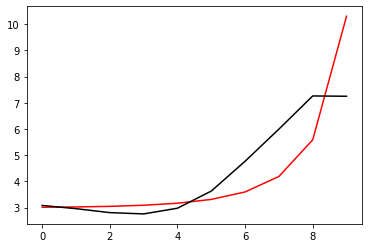

488400 0.0018301529346511872
[3.03096599 2.92623882 2.79659601 2.77137586 3.0176557  3.70930857
 4.90478106 6.23333337 7.59807197 7.56861554]


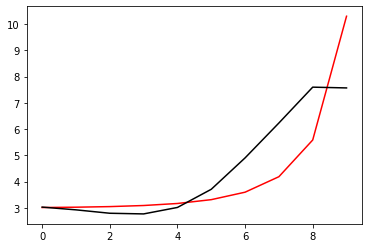

489500 0.010216158418741118
[3.13636544 2.97929672 2.79607459 2.71455213 2.89670131 3.50345176
 4.56312499 5.68067024 6.9038883  6.89671177]


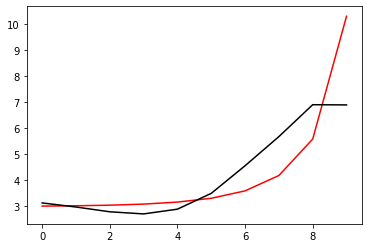

490600 0.001089036125176179
[3.12614263 2.982598   2.81402174 2.74938573 2.95159528 3.58437421
 4.68256453 5.86411416 7.14967922 7.11156221]


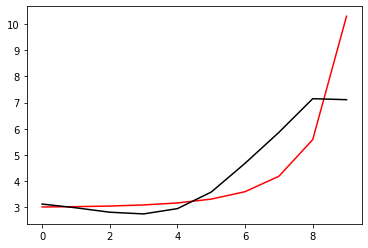

491700 0.011453090762052935
[3.08558218 2.9523986  2.79630508 2.74765203 2.97105404 3.63481059
 4.78467412 6.05926094 7.43413367 7.36822877]


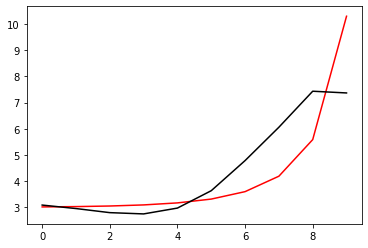

492800 0.029766272411693287
[3.07531632 2.91203202 2.72897513 2.65595753 2.85557097 3.49129527
 4.59681747 5.80426427 7.12048571 7.24136759]


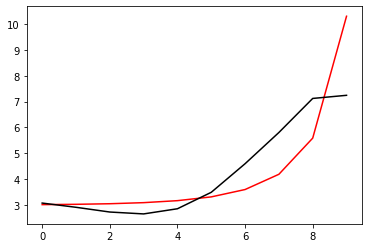

493900 0.01079859248361608
[3.16438892 3.00116474 2.81789555 2.7459074  2.94807213 3.58877491
 4.70520713 5.93989605 7.28473632 7.28160583]


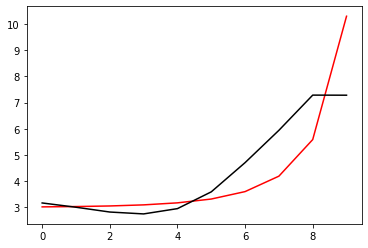

495000 0.06051081644485998
[3.14529168 2.99965546 2.83352312 2.77981961 3.00227265 3.66792227
 4.82159676 6.12303707 7.53616674 7.53558127]


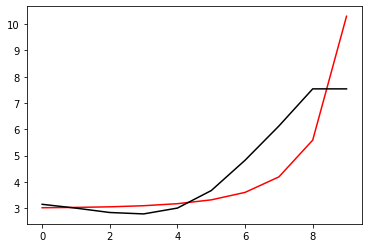

496100 0.010685905184112724
[3.17094177 2.97791191 2.76323591 2.65803375 2.8197771  3.40132563
 4.4189741  5.50538285 6.71017672 6.74347826]


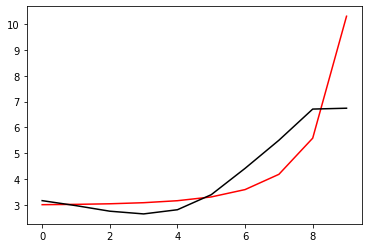

497200 0.022447879951640645
[3.15489742 2.96860681 2.75974235 2.66093621 2.83050204 3.42328137
 4.46077356 5.58652227 6.83738246 6.80512872]


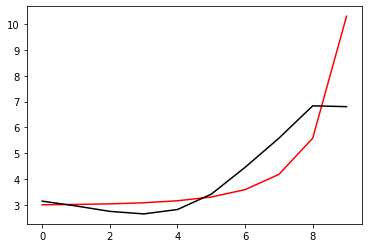

498300 0.012014771481791413
[3.15426915 2.98133509 2.78487608 2.69997966 2.88703218 3.50524825
 4.58605897 5.78957589 7.12326504 7.10195553]


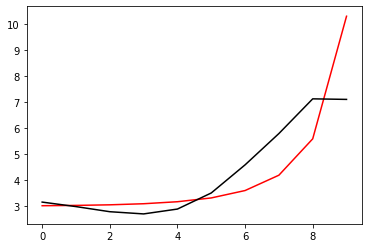

499400 0.003380616647320131
[3.09379692 2.94155025 2.76478725 2.70094278 2.91301579 3.56592362
 4.70489168 6.01266202 7.44955338 7.4024122 ]


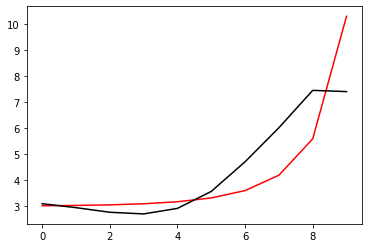

In [13]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

0 0.06070804142070269
[3.07971563 2.94011276 2.77557324 2.72371276 2.94770858 3.61362018
 4.77177204 6.11772875 7.39275057 7.58517581]


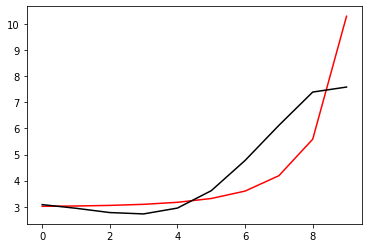

1100 0.01077485358939552
[3.1426317  2.98334622 2.7989576  2.72868503 2.94071166 3.61564132
 4.81249323 6.04568436 7.16914183 7.19940413]


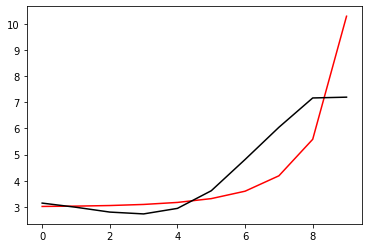

2200 0.011585393447905499
[3.10862189 2.95954429 2.7868112  2.73090986 2.96227109 3.66616201
 4.91326225 6.25296248 7.50479412 7.40825272]


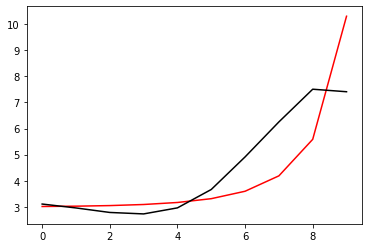

3300 0.010993421825001674
[3.07238165 2.94775518 2.80148539 2.77449302 3.03984221 3.78833997
 5.10456852 6.57789913 7.95960304 7.95557127]


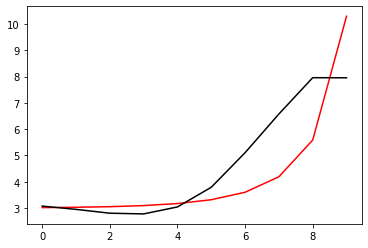

4400 0.0883949200716746
[3.14936411 3.02811395 2.88781023 2.8656719  3.13160977 3.86896514
 5.14575721 6.53254488 7.73329723 7.75373761]


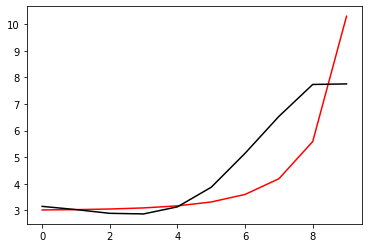

5500 0.004173512096486195
[3.04101345 2.91173419 2.76290166 2.73033785 2.9815359  3.69510239
 4.93327735 6.27983183 7.46563911 7.44699721]


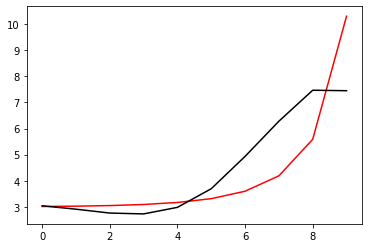

6600 0.0008838742197962231
[3.03916651 2.92348962 2.78977196 2.77387509 3.04482556 3.78506486
 5.06743586 6.50571556 7.79648551 7.73022625]


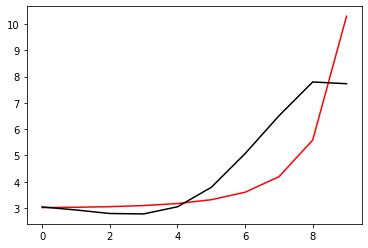

7700 0.010914593679492952
[3.03207466 2.93342602 2.81917827 2.82390261 3.11781105 3.8868432
 5.21529447 6.75384508 8.15141034 8.17884071]


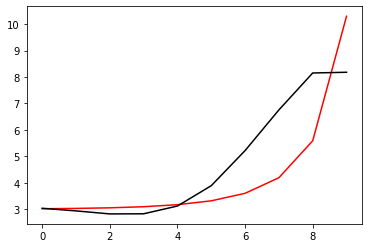

8800 0.012960948223416131
[3.0105736  2.92220991 2.82241773 2.84217576 3.1517104  3.93895982
 5.3001293  6.93724363 8.45321939 8.34689399]


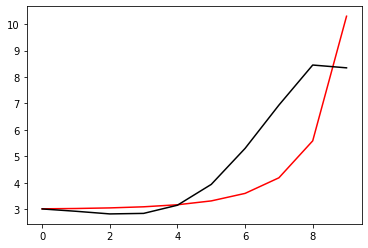

9900 0.01087588396437209
[3.04434146 2.9632298  2.86752018 2.88373508 3.17511309 3.91313237
 5.15073788 6.50833994 7.70010045 7.69585569]


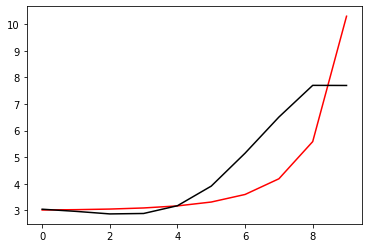

11000 0.05907745682777508
[3.01745246 2.94190796 2.85232859 2.87451387 3.17223508 3.91899657
 5.17678269 6.59328899 7.80725087 7.79292958]


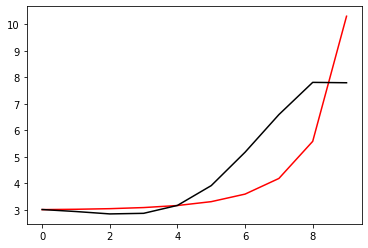

12100 0.010886616875827782
[2.9924911  2.92675054 2.84882272 2.8834171  3.19605017 3.96597853
 5.27574445 6.81078849 8.04992435 8.05126444]


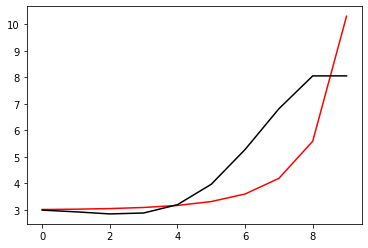

13200 0.01101808907104822
[2.94831201 2.87477296 2.7891899  2.81191674 3.10298057 3.83072629
 5.05659527 6.4439327  7.50463189 7.49601897]


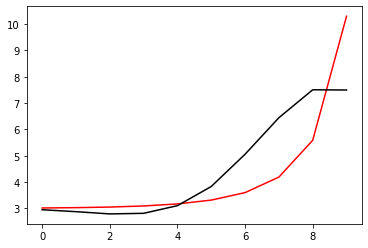

14300 0.010821438104742256
[2.976253   2.90960596 2.83244814 2.86472284 3.16768779 3.91352556
 5.17420308 6.62681606 7.71049866 7.70370632]


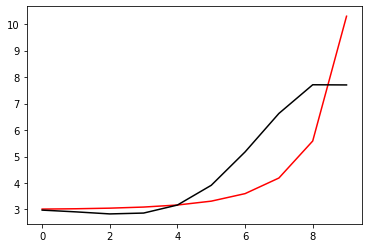

15400 0.0009446774579249279
[2.92678651 2.86932298 2.80389702 2.84872653 3.1656548  3.93048973
 5.22826794 6.76786444 7.92363751 7.92527663]


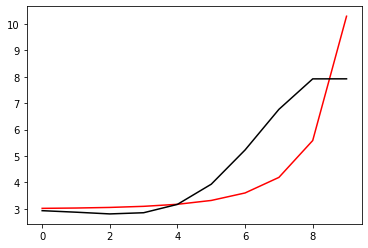

16500 0.005767240443424816
[2.92296753 2.84056    2.75321823 2.77791351 3.07478259 3.81728203
 5.08813533 6.59552904 7.72322714 7.69374574]


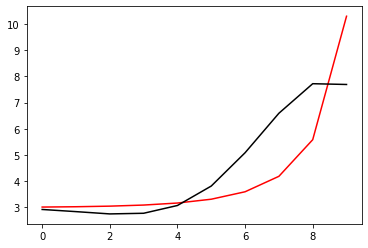

17600 0.09969988968672762
[2.9192786  2.79784989 2.67246177 2.65740388 2.90709061 3.5846421
 4.75675416 6.12365295 7.07812919 7.29439165]


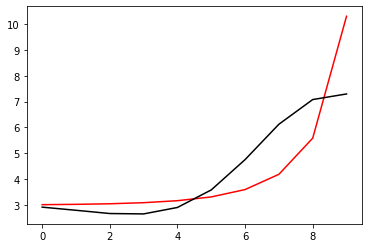

18700 0.013682760138961775
[3.04041278 2.91508451 2.7855806  2.76670491 3.01212996 3.68409064
 4.84889712 6.21069052 7.16166593 7.13544897]


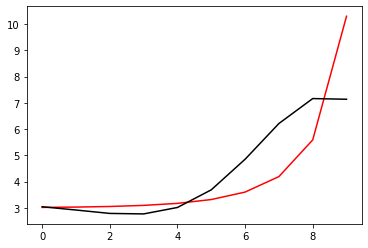

19800 0.021007653565870275
[3.06330859 2.94898158 2.83007118 2.82291378 3.08196464 3.77191592
 4.96505966 6.37847427 7.39920354 7.34652134]


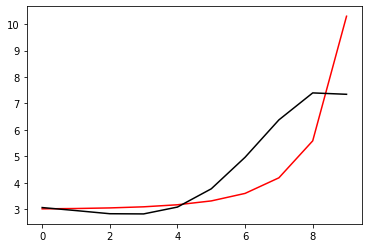

20900 0.010840865196245482
[3.06269423 2.96056114 2.85449965 2.86231376 3.13946125 3.85410674
 5.0875103  6.57584509 7.69409141 7.74574025]


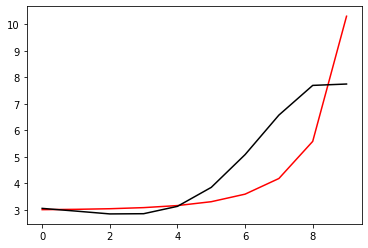

22000 0.06048148052511303
[3.10276804 2.97908687 2.84870993 2.82759302 3.06575463 3.71914203
 4.84065519 6.11545255 7.04823388 7.06274211]


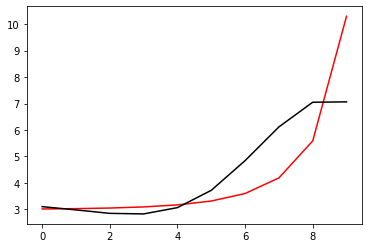

23100 0.010701184377401942
[3.07646826 2.9600094  2.83745499 2.82595042 3.07623828 3.74681358
 4.89802244 6.23123961 7.2320323  7.23346625]


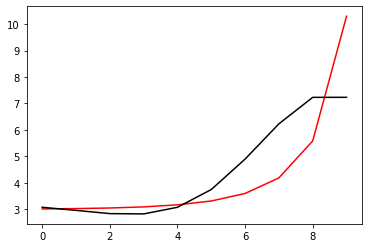

24200 0.010832715233068096
[2.97985096 2.87794148 2.77403069 2.78746166 3.07222022 3.79488771
 5.03328506 6.51031104 7.65511058 7.57669529]


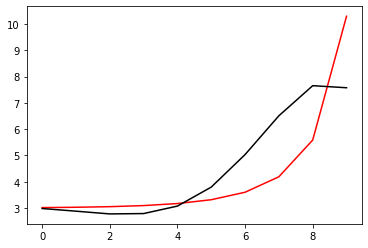

25300 0.011346711164702868
[3.08130969 2.95238493 2.81824105 2.79673712 3.03655026 3.69180485
 4.81144211 6.06998041 7.03150533 6.98835928]


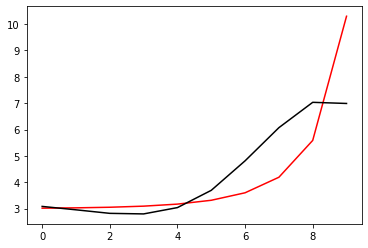

26400 0.002141149057391437
[3.03183112 2.91256549 2.7893485  2.78182049 3.04022586 3.7226426
 4.88745867 6.225256   7.27038215 7.2477618 ]


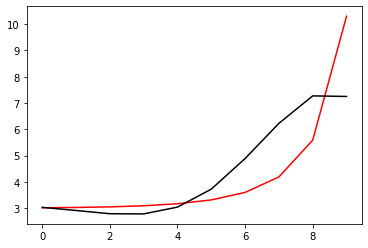

27500 0.0011049198800459558
[2.96742858 2.85997265 2.75118343 2.7627951  3.04773011 3.77048628
 5.00453986 6.46305865 7.62608226 7.6115367 ]


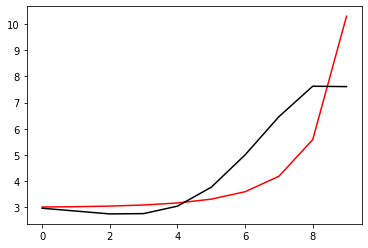

28600 0.010729190902262164
[2.95794758 2.86239934 2.76061378 2.76905412 3.03075502 3.68788627
 4.75679951 5.81974047 6.62715563 6.85042496]


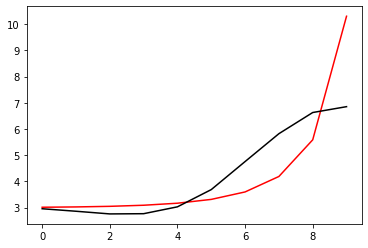

29700 0.02026473526665183
[2.98609389 2.89121714 2.79053362 2.80061302 3.06485698 3.72626385
 4.80335242 5.88330458 6.70415051 6.68281724]


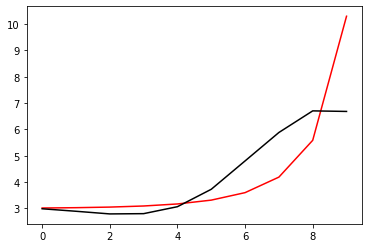

30800 0.02846706143554993
[2.99134639 2.90254167 2.80817785 2.82506863 3.09755194 3.7707434
 4.86843297 5.98853119 6.84684585 6.82770661]


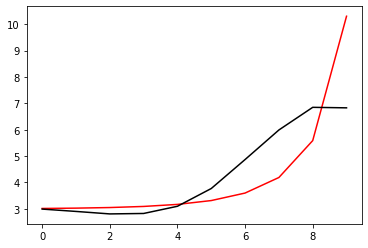

31900 0.010662071875461004
[3.00222308 2.92191765 2.83679107 2.86365644 3.14808714 3.83814062
 4.96533256 6.14427642 7.05721095 7.07027033]


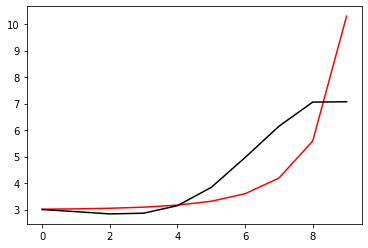

33000 0.05297293309336005
[3.03405304 2.97002954 2.9032842  2.95016352 3.2585392  3.9817755
 5.16343714 6.43750588 7.42785069 7.38654029]


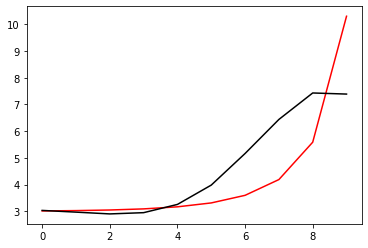

34100 0.5087836958572318
[2.60571827 2.54590236 2.48833508 2.54743003 2.87198231 3.61939257
 4.84606187 6.21598109 7.30127973 7.74333354]


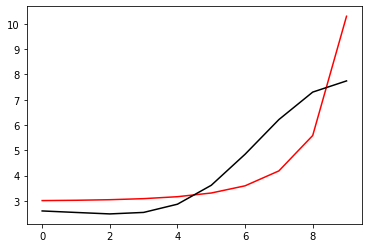

35200 0.010528283795431583
[2.99880397 2.92277227 2.84792973 2.88542002 3.17803509 3.8709952
 4.99764651 6.19706066 7.05488971 7.00134071]


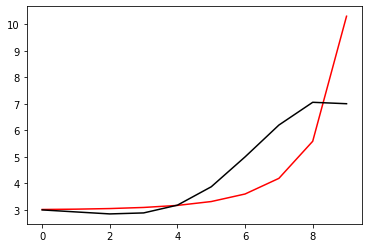

36300 0.010727649590447924
[2.96474087 2.89676901 2.83100771 2.87849699 3.18299302 3.89278633
 5.04999403 6.31161191 7.22990488 7.22771722]


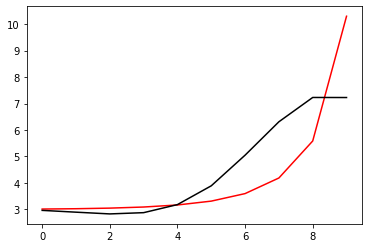

37400 0.0009531243307379109
[2.91633327 2.85993308 2.80887356 2.87344498 3.19907519 3.93936277
 5.15061937 6.51478341 7.5262835  7.52185236]


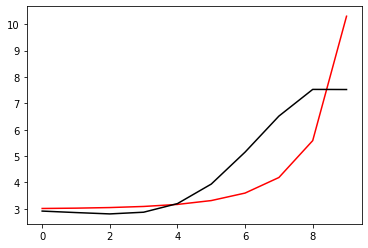

38500 0.0047107294633683735
[2.97143211 2.88367063 2.79994572 2.82874939 3.11087831 3.78940123
 4.89720937 6.08209544 6.95248426 6.93836383]


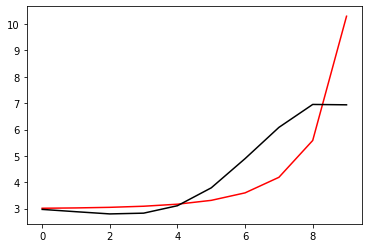

39600 0.6967098230925296
[3.24784876 3.15945658 3.07682831 3.10860266 3.39506127 4.07736781
 5.17914295 6.31883801 7.09728669 7.2152128 ]


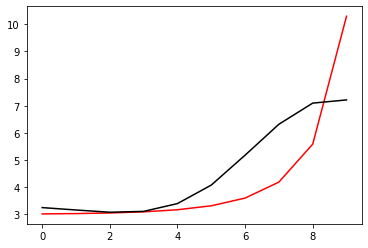

40700 0.027376911665260302
[3.00311269 2.88515317 2.76948269 2.76266918 2.99932664 3.61016618
 4.60570088 5.61891109 6.32509635 6.31267943]


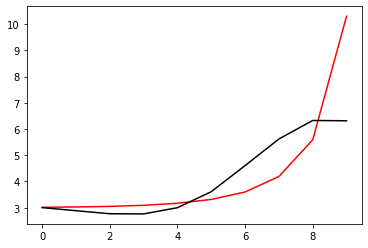

41800 0.02781567900267173
[3.09562348 2.97389599 2.8550787  2.84726044 3.08566673 3.70260643
 4.71307192 5.75997744 6.50128668 6.48056691]


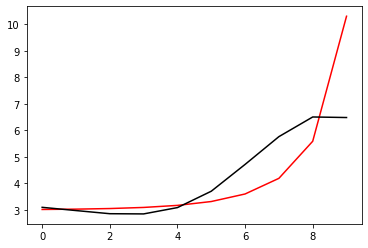

42900 0.010639362787367886
[3.08414764 2.9774611  2.8741965  2.88470026 3.14618689 3.79598761
 4.86069402 6.00103294 6.83627844 6.85036419]


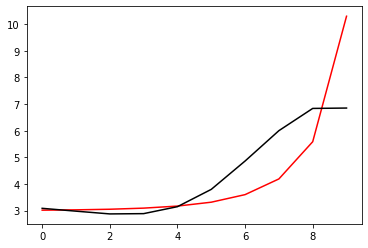

44000 0.0696028379088558
[3.07626974 2.98967193 2.90750737 2.94211902 3.23308954 3.92378365
 5.05522488 6.30993592 7.2529395  7.19457465]


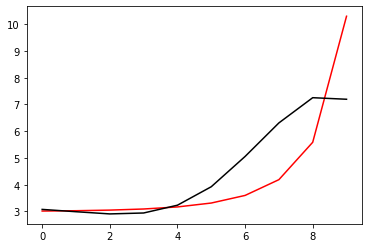

45100 0.010617067770450376
[3.08223326 2.97567484 2.8723438  2.88341503 3.14507901 3.79369999
 4.85854972 6.02096729 6.91098757 6.90944444]


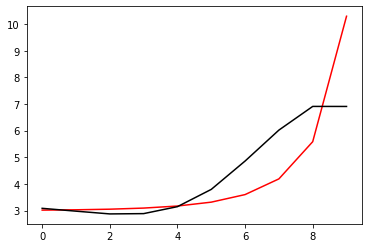

46200 0.011827633795212024
[2.96446    2.8719129  2.78625045 2.8206839  3.11430399 3.80995354
 4.95037668 6.23352378 7.24543619 7.18469275]


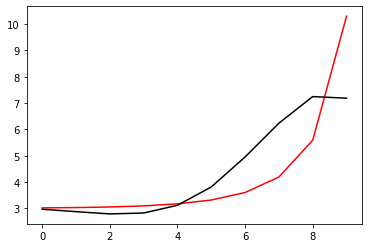

47300 0.011204245073362595
[3.02935231 2.9369584  2.85248093 2.88796123 3.1809031  3.87201444
 5.00523108 6.29445389 7.30857419 7.28911878]


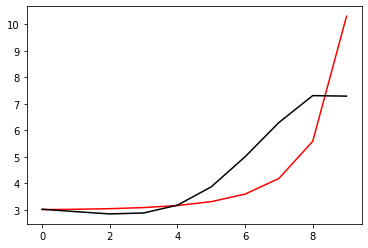

48400 0.06637555504535758
[2.87501026 2.79822001 2.72685826 2.77067901 3.06332568 3.73913205
 4.83353263 6.05652461 6.9591179  7.13542218]


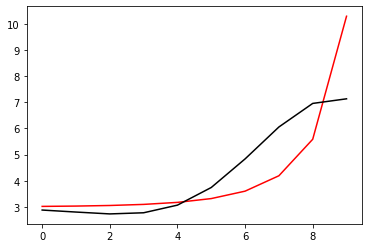

49500 0.004490975479709889
[2.96059209 2.87873593 2.80330887 2.84381599 3.13354149 3.80620469
 4.89647486 6.11444155 7.0061077  6.99687624]


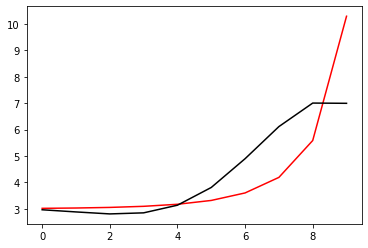

50600 0.000738602677869668
[2.9752248  2.89933889 2.83011697 2.87741186 3.17546475 3.86012752
 4.97107931 6.22612239 7.15395333 7.15411579]


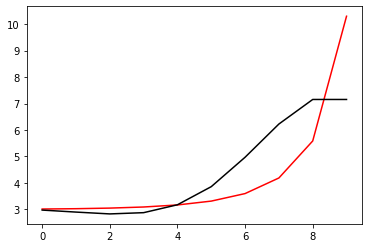

51700 0.010789133374692277
[2.95987681 2.89395156 2.83534354 2.89400013 3.20557151 3.90927822
 5.05318068 6.36892248 7.35963412 7.35306345]


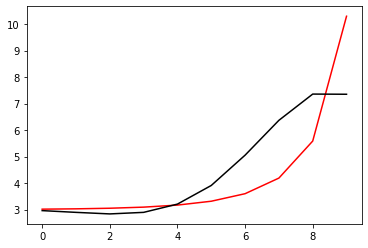

52800 0.092136957310454
[2.8631818  2.76982234 2.68721387 2.72378597 3.01412761 3.69562582
 4.81414676 6.10128252 7.06912545 7.11750195]


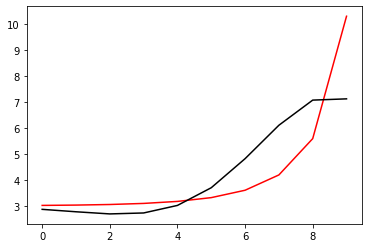

53900 0.010681734771251778
[3.03797551 2.940431   2.85375194 2.88711465 3.17486608 3.85425631
 4.97249346 6.26739591 7.24797507 7.25061347]


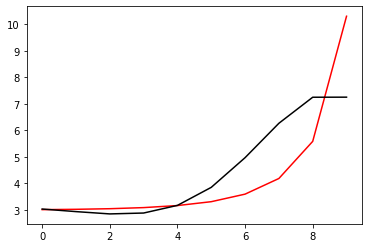

55000 0.05809344411742324
[3.028046   2.9459233  2.87478738 2.92502308 3.23223572 3.9367604
 5.09317555 6.45326    7.51607565 7.49520439]


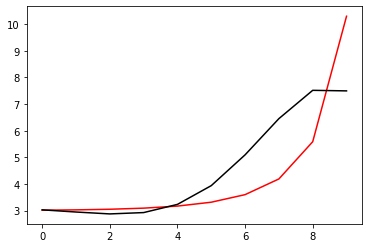

56100 0.010658404845037139
[3.01960771 2.90224781 2.79595521 2.81070936 3.07948317 3.73723612
 4.83110824 6.11633895 7.12617297 7.1271574 ]


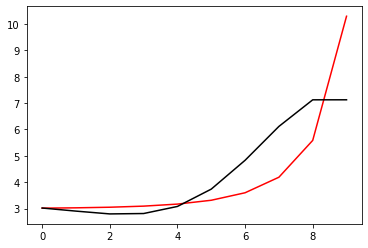

57200 0.008674751823229175
[3.02822357 2.92348831 2.82950814 2.8585483  3.14526744 3.82812921
 4.96166391 6.31269434 7.40150976 7.30597228]


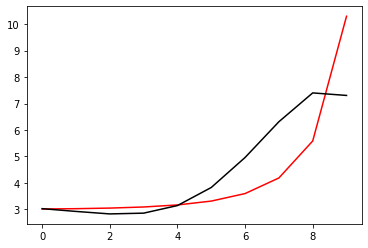

58300 0.017150495794305262
[3.05440478 2.96904545 2.8919019  2.93451263 3.22859594 3.90459015
 4.98903843 6.1628196  7.07487587 7.16298779]


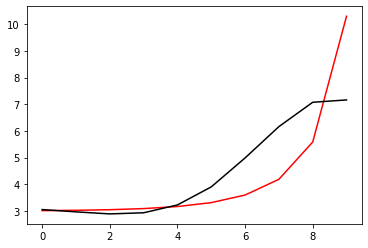

59400 0.0018445660322643598
[2.97073148 2.89772815 2.83211121 2.8856853  3.19158573 3.88453352
 5.00911005 6.29692816 7.24631026 7.23178992]


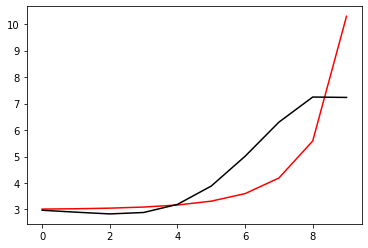

60500 0.022961892350854402
[2.87643208 2.81321381 2.75839079 2.82352272 3.14374518 3.86036063
 5.0447449  6.49142672 7.49927955 7.46085133]


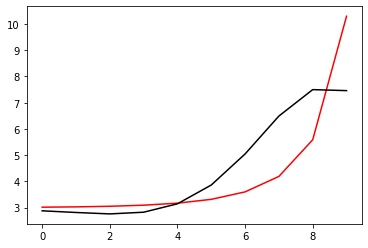

61600 0.0007474423620519102
[3.01544401 2.92130155 2.83368146 2.86277105 3.13957094 3.79485476
 4.87168157 6.06699045 6.88204338 6.87980335]


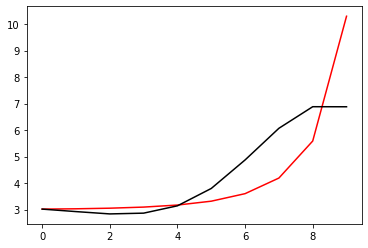

62700 0.010715073692640785
[2.99659489 2.91403698 2.84006047 2.88586172 3.18468224 3.87289157
 5.00522053 6.29274192 7.18532871 7.19182488]


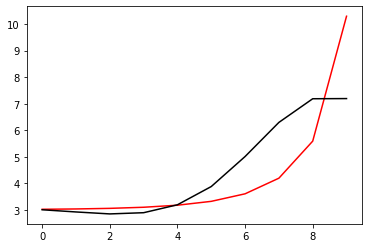

63800 0.10400261930261581
[2.84532764 2.73320421 2.63177829 2.65108392 2.9224304  3.57823716
 4.66409772 5.8720135  6.67189885 7.07571898]


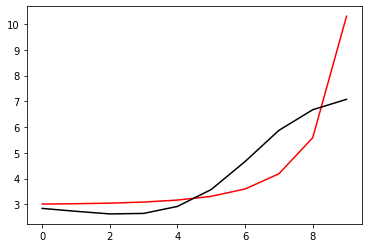

64900 0.010663482482418815
[3.09552888 2.96671278 2.84752549 2.84795323 3.09708027 3.72327619
 4.76661943 5.91903011 6.65081552 6.64250448]


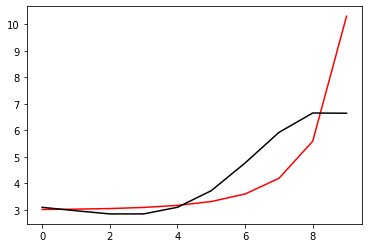

66000 0.06045093565164103
[3.07734539 2.95993773 2.85133701 2.86359261 3.12712624 3.7732828
 4.84862768 6.05945673 6.86799316 6.87046936]


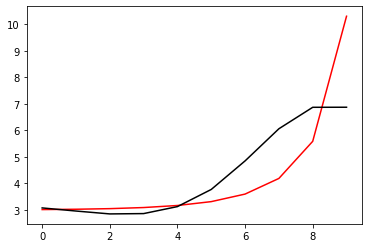

67100 0.010683510902732736
[3.05068931 2.94820451 2.85430315 2.88352949 3.16873824 3.84627654
 4.9731063  6.27572451 7.19473363 7.19736902]


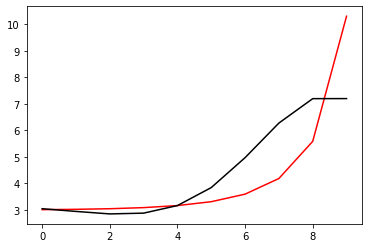

68200 0.011584644049774856
[2.95061822 2.85717626 2.77349256 2.81465473 3.11498084 3.81414699
 4.97801416 6.35584819 7.36368204 7.37762717]


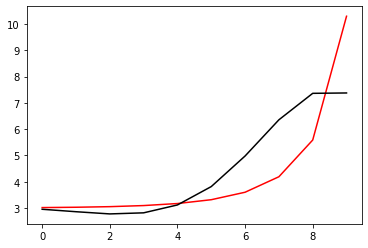

69300 0.01191057709932935
[3.10126914 2.95198283 2.81338052 2.8000329  3.04266052 3.67271843
 4.74011577 5.97853925 6.84618247 6.81695825]


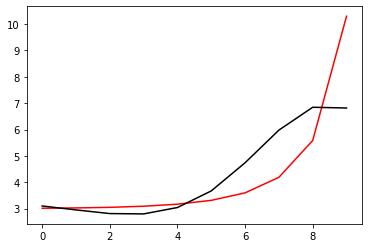

70400 0.0037931729481558213
[3.06195913 2.92404218 2.79599834 2.79495806 3.05330719 3.70575574
 4.80852147 6.10613349 7.04862747 7.02675254]


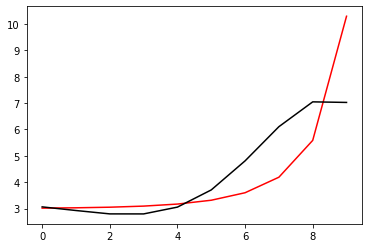

71500 0.024708898283187706
[2.94692392 2.8227397  2.70856197 2.72438983 3.00510717 3.69038233
 4.84664652 6.23563776 7.29002167 7.26375787]


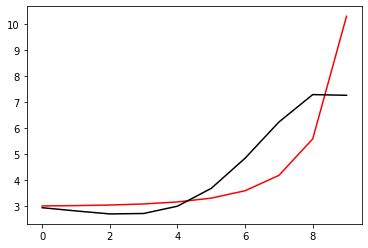

72600 0.01062201902267808
[3.06270689 2.88989692 2.72263433 2.67944216 2.88863983 3.4744428
 4.47119777 5.60905325 6.45048215 6.44823578]


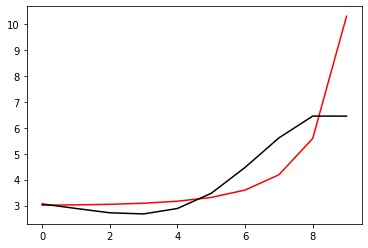

73700 0.010878145249819855
[3.16120643 2.9894146  2.8213211  2.7776005  2.98707158 3.5746256
 4.57698491 5.73165648 6.59513253 6.58129084]


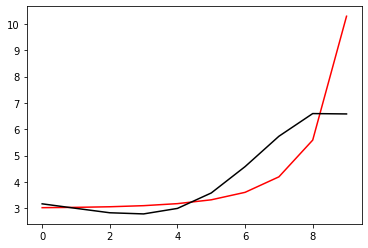

74800 0.029102323015372678
[3.10730823 2.94811346 2.79221287 2.76433521 2.99700272 3.62208367
 4.69017223 5.95788187 6.95365853 6.95109403]


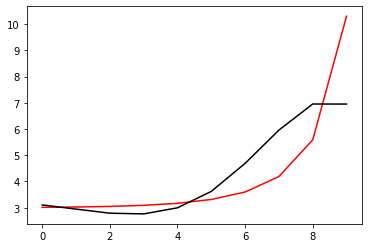

75900 0.024729055475161518
[3.03935421 2.85647308 2.67316547 2.61591005 2.81614438 3.40078665
 4.40634471 5.5621     6.49835202 6.55450524]


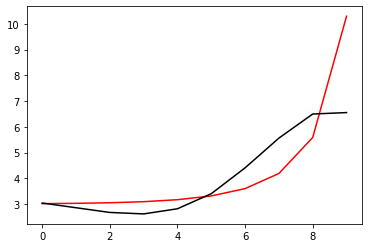

77000 0.06061930794141135
[3.18054908 3.00406008 2.82509422 2.77206477 2.97698638 3.56726126
 4.58086441 5.75202809 6.69606173 6.69746158]


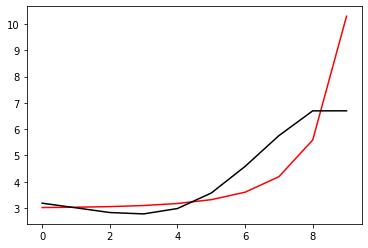

78100 0.01070377594879081
[3.11625468 2.95209644 2.78483556 2.74691458 2.97471283 3.60335758
 4.68592353 5.97563062 7.04544029 7.04561222]


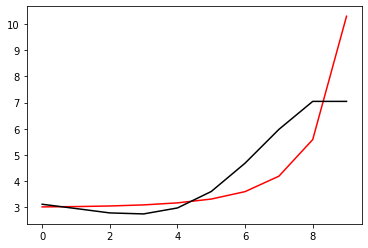

79200 0.0202209335841743
[3.10096859 2.89393515 2.68256149 2.60019017 2.78120942 3.35308132
 4.34533738 5.45702195 6.37825628 6.395676  ]


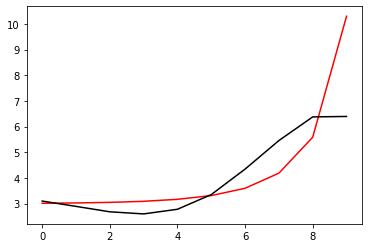

80300 0.013676749773623527
[3.19054785 2.97672383 2.75745323 2.66838679 2.84482963 3.41524835
 4.41187816 5.54165661 6.49054378 6.45444791]


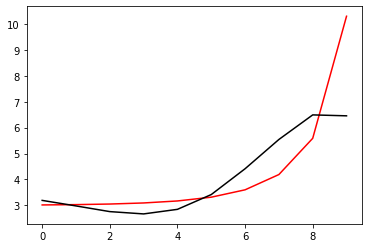

81400 0.007830667425650395
[3.15932116 2.96721532 2.7670811  2.69806357 2.89840256 3.50144389
 4.54903165 5.76428926 6.81760306 6.76106642]


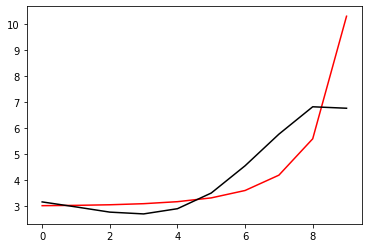

82500 0.01758093626967055
[3.0227666  2.85296609 2.67471497 2.63096369 2.86505784 3.51884587
 4.65023913 6.00300829 7.20518989 7.17890789]


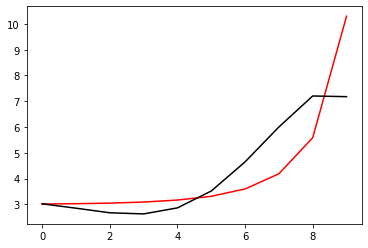

83600 0.010734140683664201
[3.10223042 2.90479737 2.69449771 2.61482368 2.80674519 3.40460622
 4.44962461 5.66703523 6.7387909  6.73976117]


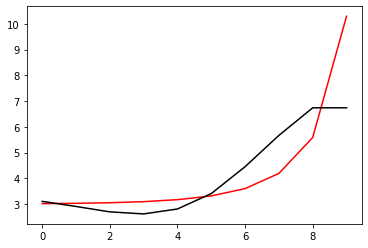

84700 0.025389025598898236
[3.1123958  2.92302562 2.71808114 2.64363331 2.84300178 3.45343471
 4.52236467 5.78845772 6.9203516  6.8971268 ]


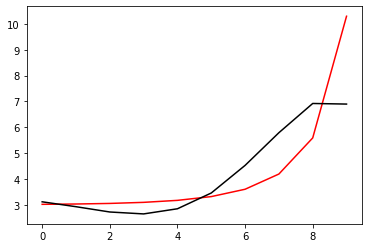

85800 0.029381484440323746
[3.13581779 2.96578852 2.77570931 2.71337875 2.92485807 3.55060621
 4.64601407 5.96969845 7.17126634 7.18817121]


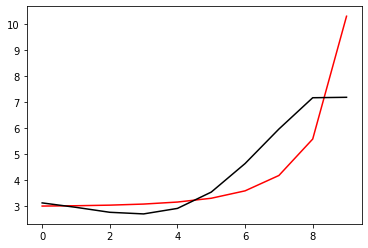

86900 0.5932940795527184
[2.71941586 2.59501042 2.44981164 2.43046384 2.68766915 3.36781078
 4.53495712 5.95899682 7.25253689 7.70961171]


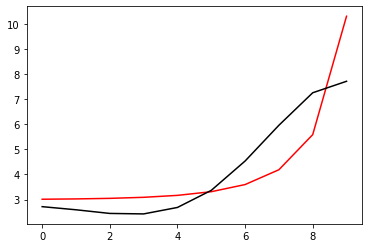

88000 0.06054962885000046
[3.09506689 2.98102128 2.84013673 2.81520251 3.05070921 3.6789443
 4.73159776 5.91914667 6.88440032 6.88175171]


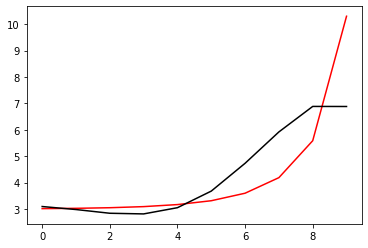

89100 0.010634806983150938
[3.08163428 2.97325388 2.83863157 2.81969864 3.06239244 3.70218609
 4.78026651 6.02607334 7.02247505 7.02352612]


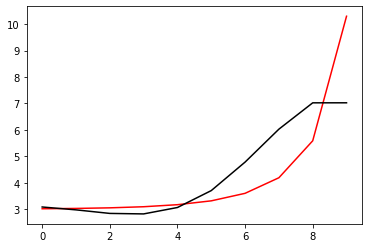

90200 0.011065259288876007
[3.0358103  2.93826774 2.81648556 2.81111329 3.07147694 3.74106722
 4.88339119 6.261842   7.32886949 7.2461241 ]


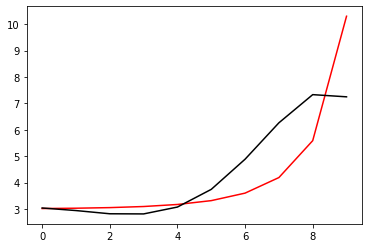

91300 0.010762099275173163
[2.97100826 2.88549003 2.77822679 2.78620863 3.06126952 3.75318007
 4.94323559 6.422843   7.55137431 7.54181815]


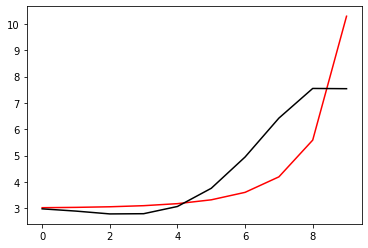

92400 0.0034599653985656563
[3.05085145 2.94222489 2.81226473 2.79512007 3.04080081 3.69426686
 4.82282649 6.18385145 7.22280698 7.1874106 ]


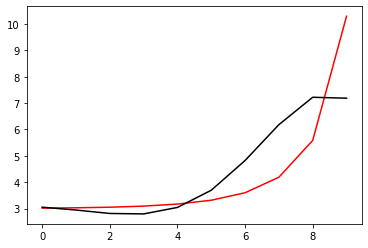

93500 0.023988970777526434
[2.94191534 2.83896096 2.71935446 2.71583132 2.98106953 3.66721033
 4.85649614 6.32663012 7.4806051  7.44376353]


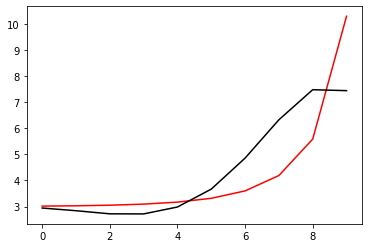

94600 0.010592653385495044
[3.04896201 2.90483272 2.7408893  2.68746599 2.8913089  3.48986024
 4.52718396 5.71354421 6.64528224 6.6401505 ]


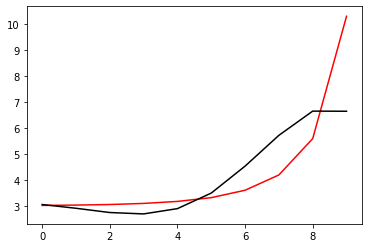

95700 0.024171991315118865
[3.05376346 2.91685468 2.75954228 2.71225231 2.92209983 3.52789604
 4.57702407 5.78907275 6.75496107 6.73294323]


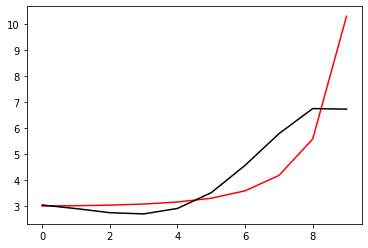

96800 0.028123495415321616
[3.09757816 2.96609246 2.81605162 2.77891959 3.00400994 3.63486779
 4.7271402  6.01408197 7.06643569 7.05382067]


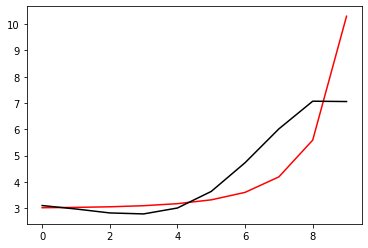

97900 0.003868350339043824
[3.04587996 2.88504085 2.70875369 2.64812148 2.85180773 3.46069114
 4.52057433 5.75777684 6.77714165 6.77935586]


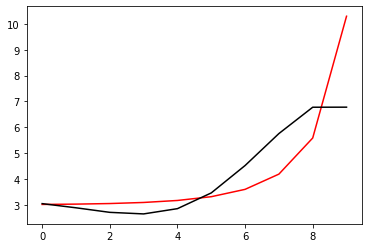

99000 0.060660124279352835
[3.1114391  2.95066714 2.77373813 2.71307923 2.91792372 3.53050544
 4.59977686 5.85979291 6.91021914 6.91106232]


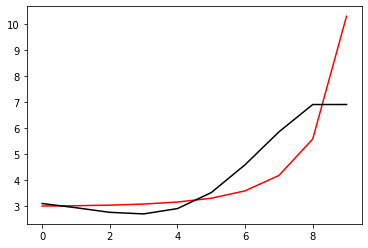

100100 0.010685507644820638
[3.14161585 3.00224812 2.84413396 2.80038061 3.02081852 3.6495568
 4.74015624 6.03815655 7.13431141 7.13296217]


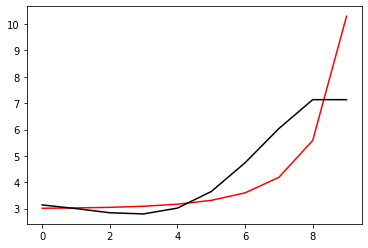

101200 0.02013441640963259
[3.08472499 2.90100319 2.69838843 2.60885682 2.77844427 3.34169518
 4.3305624  5.47158984 6.45454612 6.45960633]


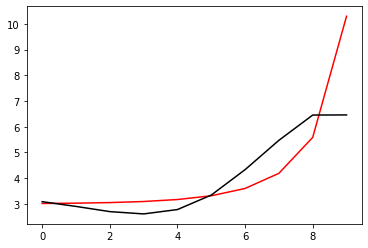

102300 0.011278394923877354
[3.1223087  2.93657809 2.73060539 2.63745221 2.80298959 3.36167607
 4.34664139 5.4904784  6.48059815 6.54354027]


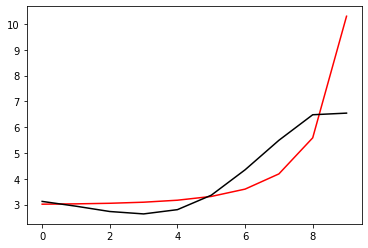

103400 0.009638998137360234
[3.1789778  2.99431752 2.78829099 2.695601   2.86306738 3.42731731
 4.42720483 5.60857037 6.64770654 6.61740399]


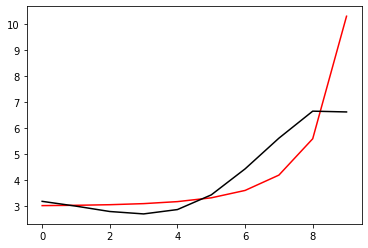

104500 0.009868543086119582
[3.13117974 2.96489838 2.77879944 2.7102613  2.90982816 3.52280838
 4.60641403 5.92856059 7.10895731 7.12528547]


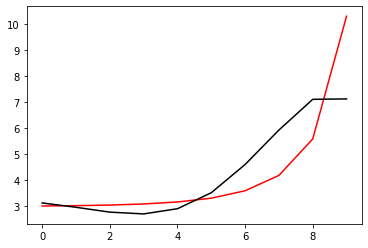

105600 0.0007210934521353858
[3.09626725 2.97251332 2.82850532 2.79959267 3.03472421 3.67816694
 4.78754301 6.13288094 7.30220435 7.22740645]


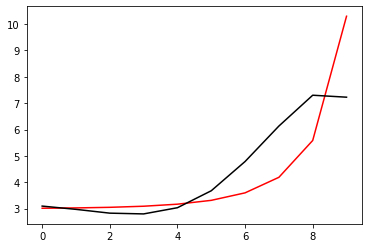

106700 0.1680411252252652
[3.23281137 3.09667572 2.94064912 2.89736965 3.11368486 3.72834424
 4.78277637 5.99908162 7.06400436 7.41339096]


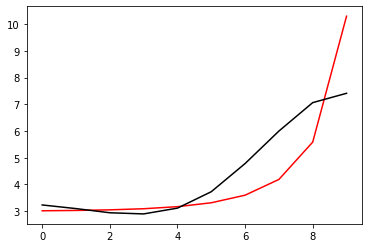

107800 0.030175157269940345
[3.06674066 2.91546053 2.74265863 2.67972829 2.87065236 3.44895685
 4.4489258  5.59169088 6.57596666 6.56891406]


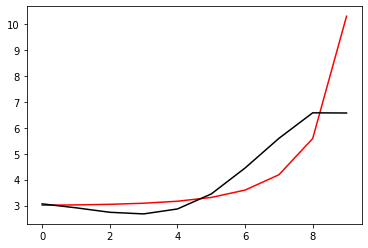

108900 0.010822649149223823
[3.15978587 3.00792365 2.83518858 2.77386717 2.96907538 3.55670576
 4.57603377 5.75591529 6.77105905 6.76736836]


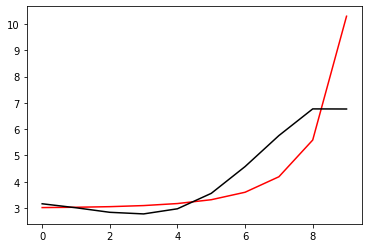

110000 0.06055305155305615
[3.12907628 2.99602158 2.84217219 2.80098403 3.02050031 3.64316762
 4.72186505 6.00327465 7.11554909 7.11588238]


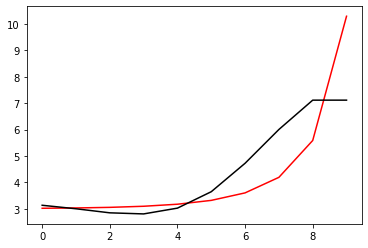

111100 0.010699375920968934
[3.10424015 2.97436282 2.82506572 2.78953037 3.01730495 3.6548945
 4.76610007 6.12199021 7.3168617  7.31882376]


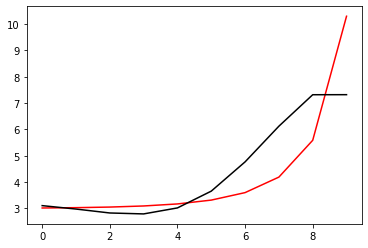

112200 0.017167066749897375
[3.07104315 2.90487567 2.72280578 2.65840516 2.86198994 3.48116708
 4.57634343 5.88730173 7.02717071 7.00843702]


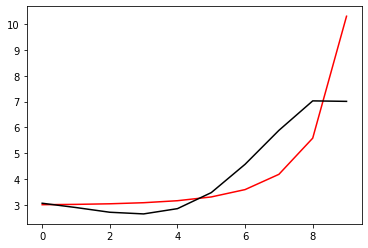

113300 0.010826668224804416
[3.07562384 2.9190407  2.74427921 2.68601008 2.89510801 3.52041321
 4.62552945 5.95966531 7.13200834 7.12974478]


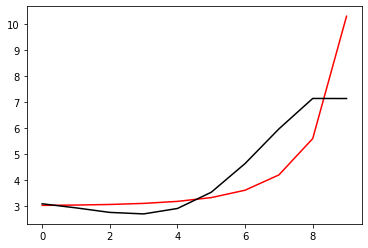

114400 0.0024901980490265175
[3.05565558 2.92296033 2.77060013 2.73394835 2.9657317  3.61856619
 4.76362245 6.16542035 7.42042826 7.38690561]


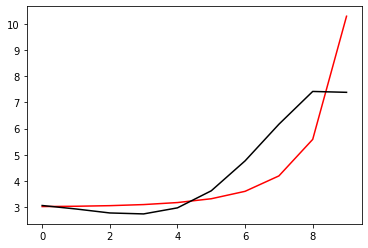

115500 0.003514436477686252
[3.12947959 2.94425045 2.73740399 2.64234685 2.80614616 3.36794768
 4.37037828 5.55033518 6.61452719 6.59813583]


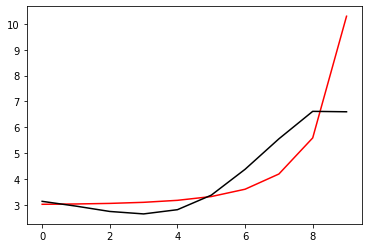

116600 0.010673213247390031
[3.09622547 2.91842361 2.71793504 2.62956505 2.80139068 3.37476362
 4.39733464 5.61668697 6.73634986 6.73956036]


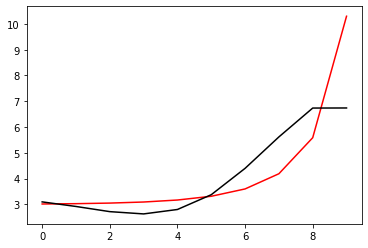

117700 0.010778736983373083
[3.19360077 3.02209095 2.82666161 2.74339565 2.92094448 3.50207043
 4.53866341 5.78979665 6.94781759 6.96819047]


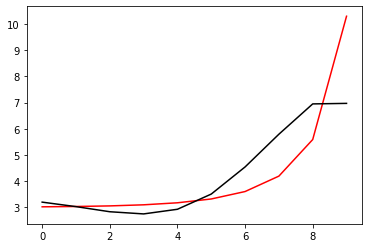

118800 0.02711755515372533
[3.14060932 2.98370661 2.80493465 2.74322227 2.95188879 3.58317124
 4.70693043 6.10325567 7.41634462 7.40139294]


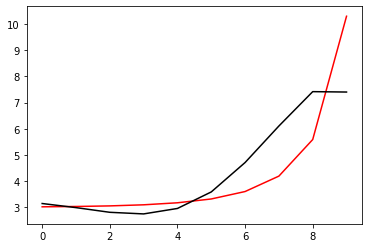

119900 0.011317963488343397
[3.1600321  2.96588943 2.75276418 2.66014139 2.84152501 3.44729508
 4.53564722 5.85700879 7.1026769  7.14473423]


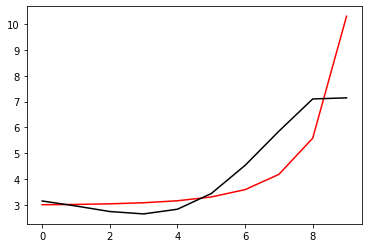

121000 0.060730255183272054
[3.19252383 3.00918984 2.80467035 2.72001696 2.90958284 3.52526386
 4.62869776 5.97810224 7.25877501 7.26069981]


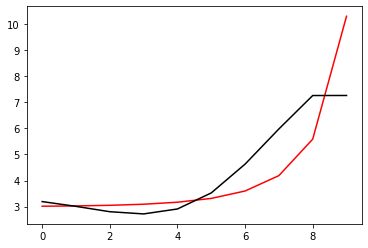

122100 0.01078970565810762
[3.17113817 3.00665758 2.81898256 2.75088049 2.95856429 3.59729533
 4.73566321 6.14485275 7.49686067 7.49629436]


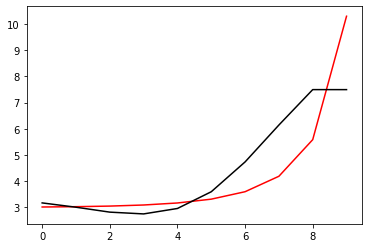

123200 0.01874883139043898
[3.15904674 2.95263042 2.72470192 2.6187111  2.7900143  3.39064414
 4.48285146 5.83602148 7.13715733 7.11249124]


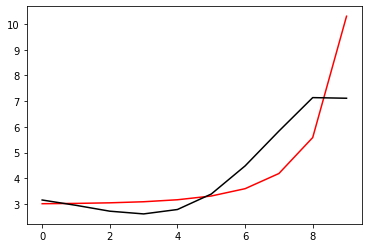

124300 0.011045293770184594
[3.1411658  2.94566494 2.72645781 2.62903779 2.81010368 3.4239989
 4.53776843 5.92997962 7.28217016 7.28426724]


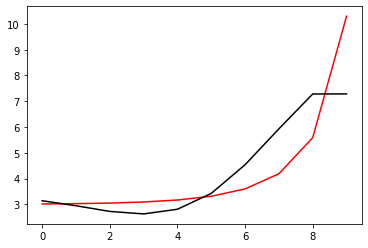

125400 0.003352698062497917
[3.12029828 2.94706581 2.74768794 2.66975011 2.87240245 3.51418131
 4.67029105 6.13271739 7.5689188  7.52695385]


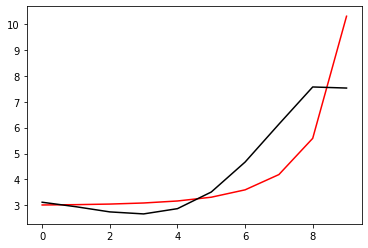

126500 0.001218172904136333
[3.05890196 2.88816737 2.69250447 2.62161225 2.83846581 3.50814386
 4.71858117 6.2794823  7.82534186 7.80155176]


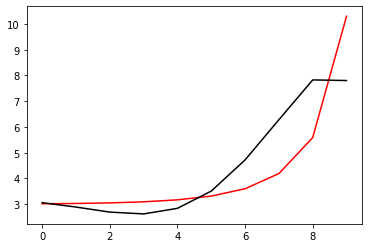

127600 0.6037934080460723
[3.26878335 3.14127067 2.98637421 2.9524     3.20271224 3.90231099
 5.12767968 6.38671411 7.6168877  8.03166152]


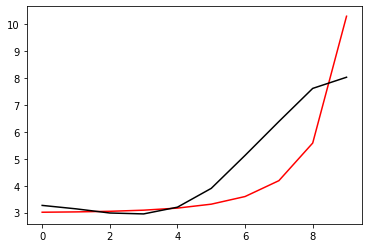

128700 0.011080037032753995
[3.07707545 2.95727827 2.80642846 2.77054144 3.00941107 3.67835772
 4.82527986 5.94495083 7.35103586 7.33751906]


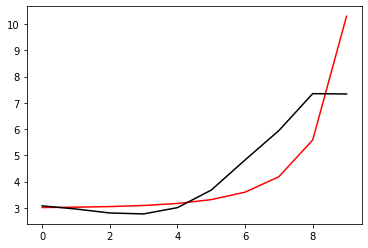

129800 0.023126021963550934
[3.07569656 2.96375781 2.82181087 2.79526112 3.04600205 3.73439266
 4.92087492 6.12481261 7.54528448 7.49440827]


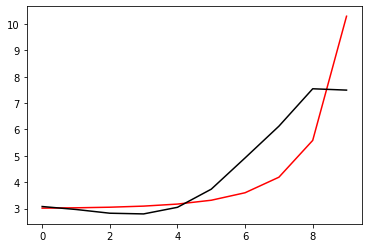

130900 0.010804165177867637
[3.06579452 2.96713001 2.84048366 2.82972697 3.0998432  3.81871762
 5.0643829  6.38740472 7.83238475 7.85900931]


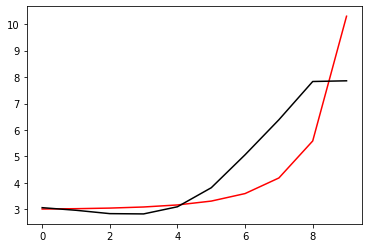

132000 0.07798566546650153
[3.08874589 2.99747542 2.882691   2.88456216 3.17040632 3.91455053
 5.20993493 6.65081686 8.12991635 8.05077287]


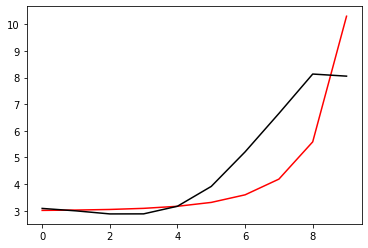

133100 0.5101382306093339
[2.67113256 2.58148148 2.47062843 2.47481582 2.76002136 3.49929229
 4.78511205 6.25518189 7.77465326 8.20279443]


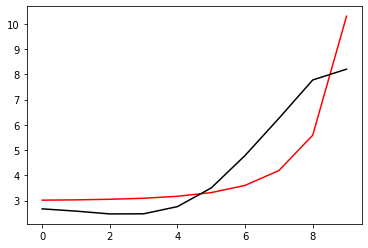

134200 0.00886598838110291
[3.04766564 2.94604566 2.82179026 2.80785365 3.06509943 3.75611072
 4.95265371 6.271822   7.57714209 7.52500645]


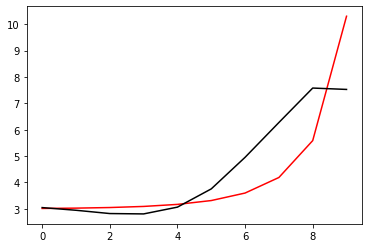

135300 0.010815178673476694
[3.02025183 2.9263079  2.81102173 2.80637666 3.07413319 3.77967127
 5.00093342 6.37490307 7.73715784 7.73556066]


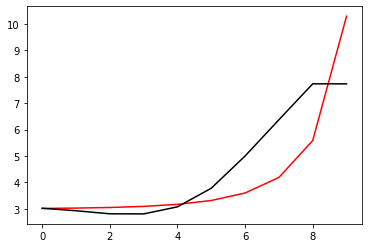

136400 0.0010035681368380602
[2.9627612  2.88252231 2.78393097 2.796918   3.08474794 3.8176816
 5.08423428 6.55131255 8.00506937 8.00125052]


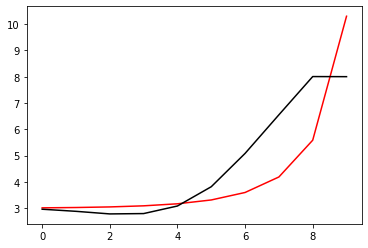

137500 0.010730264006402632
[3.03658605 2.97123448 2.88506096 2.90320055 3.18370919 3.88515232
 5.061768   6.30672187 7.46473424 7.52805514]


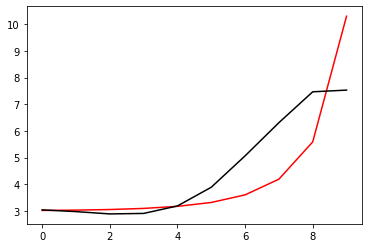

138600 0.0007087440192746115
[3.00183519 2.94001251 2.85816288 2.88024978 3.16445576 3.87052371
 5.05807894 6.34924343 7.53739287 7.53827725]


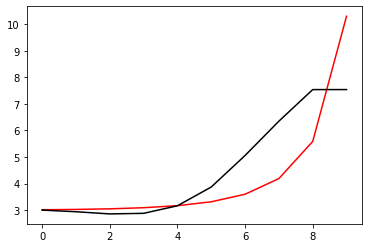

139700 0.010879971230638857
[2.95800096 2.90203019 2.82793601 2.85784881 3.15068187 3.86965947
 5.08758692 6.47303418 7.70153181 7.68006945]


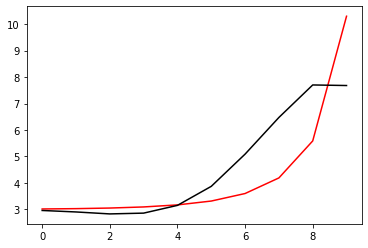

140800 0.06628745235600783
[2.89762713 2.81948599 2.72868028 2.74418583 3.02450523 3.73541902
 4.96304021 6.3934102  7.53996841 7.63372776]


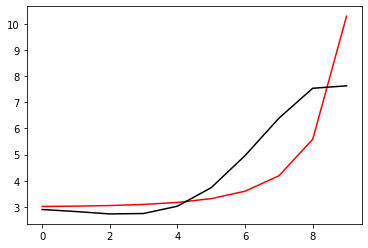

141900 0.010766665857085038
[3.01918195 2.93832689 2.84604319 2.86046646 3.13939369 3.8484344
 5.07414632 6.51256114 7.67157015 7.66183442]


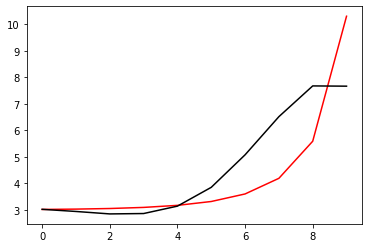

143000 0.11123809618761077
[2.92734424 2.81418806 2.69309914 2.6808174  2.93305885 3.61256417
 4.80160234 6.20130169 7.32322329 7.31960754]


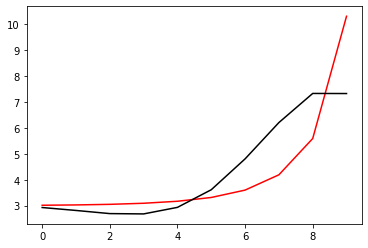

144100 0.010742732517172095
[3.06644897 2.95119555 2.82793856 2.81395219 3.06443384 3.74210591
 4.93012071 6.33776914 7.47484712 7.47544942]


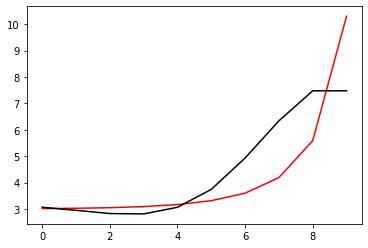

145200 0.009677892861666617
[2.99973848 2.89918526 2.79167996 2.79558417 3.06728005 3.7735036
 5.00535859 6.49055376 7.73004857 7.68361232]


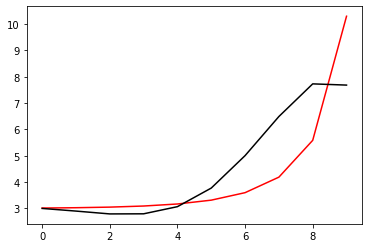

146300 0.010951133905406526
[3.07035976 2.94373321 2.80853892 2.78272058 3.01958003 3.68025965
 4.84695651 6.25232312 7.42487502 7.41691161]


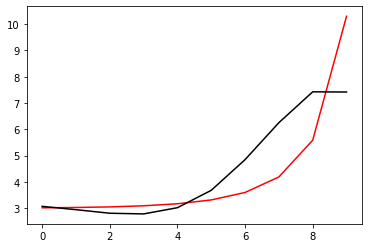

147400 0.001358196814827883
[3.01704331 2.90513283 2.78627261 2.77965878 3.03945826 3.73064891
 4.94405355 6.43117987 7.69719413 7.68397386]


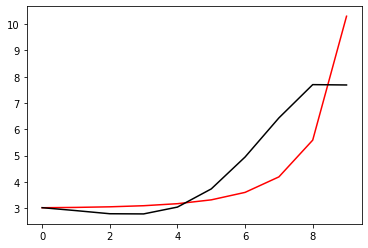

148500 0.0074201098325521265
[3.0811018  2.93556308 2.77959093 2.73167113 2.94115482 3.56116399
 4.65258632 5.92333092 7.0378743  7.01398032]


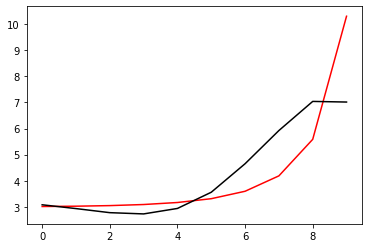

149600 0.0007456812107081857
[3.09110087 2.96257207 2.82421328 2.79623168 3.02903475 3.67882045
 4.81242428 6.14804925 7.32668792 7.27384666]


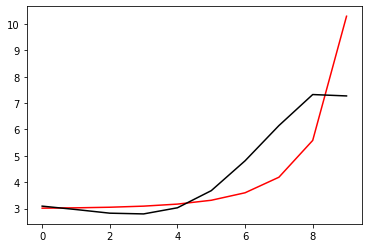

150700 0.32555426214101224
[3.25631004 3.11803149 2.96832035 2.92667652 3.13983706 3.75497125
 4.81463767 6.00517979 7.07538901 7.34320876]


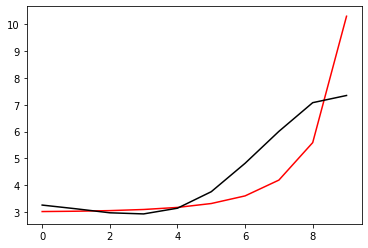

151800 0.030150299014739413
[3.07953522 2.91572124 2.74017701 2.67283075 2.85882703 3.44309755
 4.46827678 5.6329566  6.6970982  6.69077091]


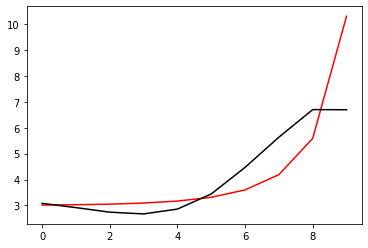

152900 0.010787980394006955
[3.17293919 3.01088853 2.83672535 2.77254819 2.96428961 3.55875322
 4.60341465 5.80853365 6.92115792 6.92094827]


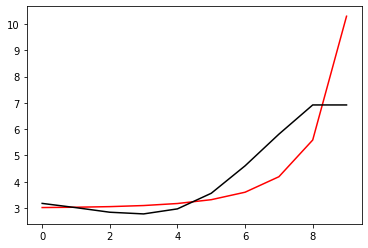

154000 0.06067798982977169
[3.10772584 2.95815393 2.79642681 2.74792505 2.96119239 3.58884891
 4.69121399 6.00096831 7.23580351 7.23399616]


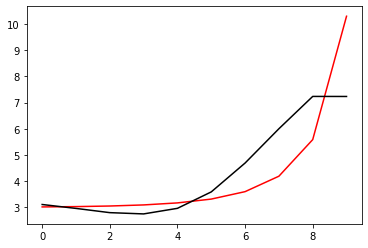

155100 0.010606165897799
[3.06419255 2.87530913 2.67306303 2.58308129 2.75048955 3.31865388
 4.32406491 5.45960618 6.56198558 6.58786467]


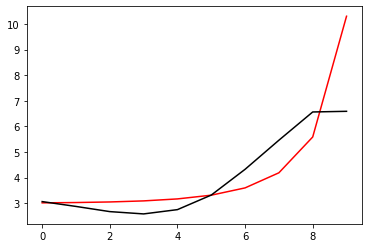

156200 0.029624799562524076
[3.21663139 3.01635197 2.80187209 2.7007371  2.8581645  3.4173709
 4.41576077 5.55214291 6.65638899 6.60109287]


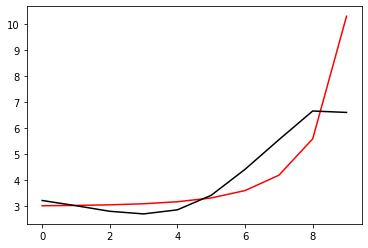

157300 0.01186900981733404
[3.15504675 2.97013156 2.77014892 2.68610309 2.86577319 3.45763689
 4.51034254 5.74187971 6.96283755 6.92266708]


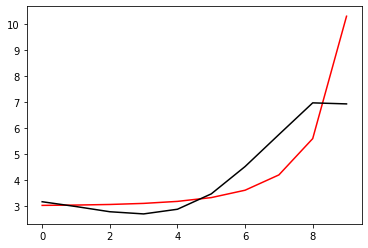

158400 0.00393932191542947
[3.09836913 2.93577776 2.75712735 2.69722792 2.90750165 3.54345161
 4.66813192 6.01941437 7.36290783 7.32199104]


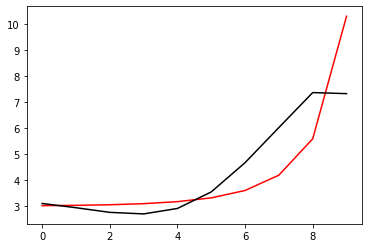

159500 0.008921364678814513
[3.15624666 2.96698941 2.75889185 2.66820178 2.84502326 3.43987598
 4.5033135  5.75607674 7.01093208 6.99497152]


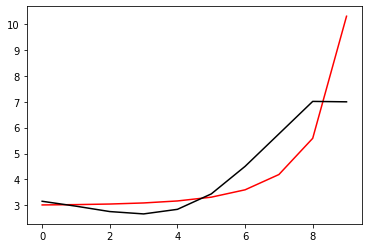

160600 0.010844658498168385
[3.06462026 2.89221148 2.70115469 2.63072886 2.83429    3.46810214
 4.59372356 5.94662191 7.30685765 7.31276373]


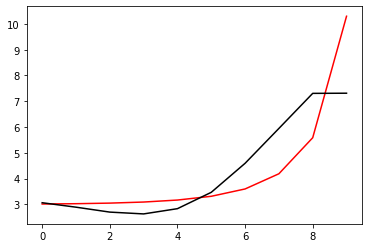

161700 0.010775606122824693
[3.14642155 2.99914475 2.82869711 2.77500446 2.99246213 3.63849768
 4.78013445 6.1706756  7.56483948 7.56078304]


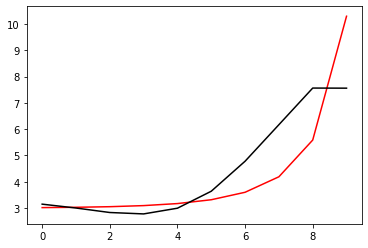

162800 0.028609213750561507
[3.11209039 2.98726708 2.83538429 2.79391848 3.01323041 3.63926388
 4.69742022 5.70385477 6.83141491 6.81643229]


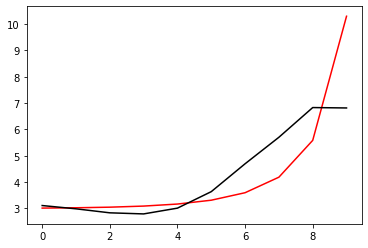

163900 0.010696379615190607
[3.10071783 2.98272013 2.83814986 2.80430051 3.03319767 3.67456473
 4.76420592 5.84172893 6.99654254 6.99142082]


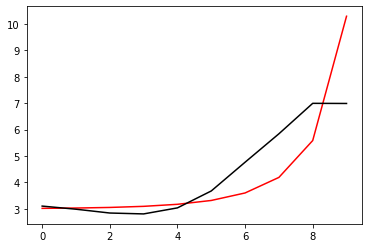

165000 0.0604072528753824
[3.0895482  2.98330907 2.85176829 2.8315816  3.07757319 3.74585556
 4.88853231 6.07428156 7.26438174 7.26546549]


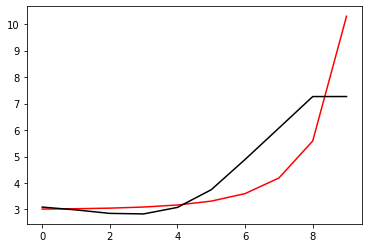

166100 0.010666636018861742
[3.0964862  2.94413276 2.76968773 2.70794123 2.91249502 3.53708545
 4.63171328 5.76213958 6.86198315 6.8611986 ]


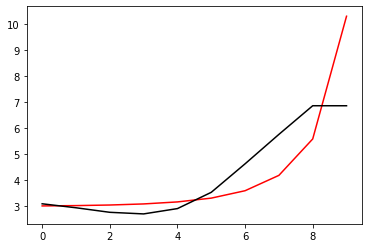

167200 0.01795149157172448
[3.12762857 2.98592155 2.82199797 2.77139058 2.98913442 3.631487
 4.75272539 5.93152461 7.08560701 7.01150566]


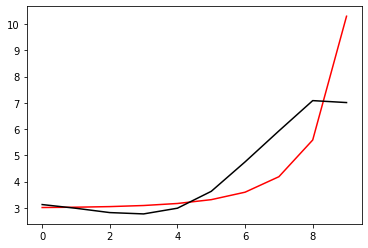

168300 0.010968385003077136
[3.07145299 2.94671237 2.80022251 2.767312   3.00452244 3.67120875
 4.82775552 6.073431   7.30093907 7.31790995]


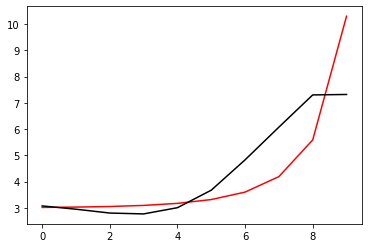

169400 0.0030400375692259474
[3.04925143 2.94043769 2.81003947 2.7910373  3.03907423 3.7127049
 4.87333007 6.14484602 7.39306441 7.32905344]


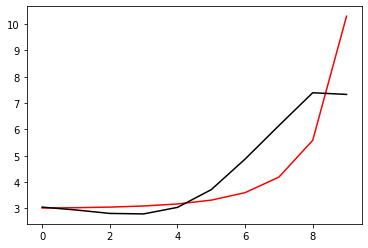

170500 0.002863895106000954
[2.94165587 2.85289194 2.74959433 2.76191211 3.04794494 3.77261
 5.01023175 6.41821176 7.79881084 7.7764555 ]


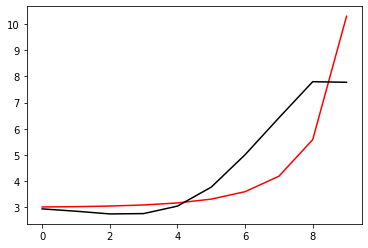

171600 0.0009053467887705992
[2.96478988 2.88604647 2.79574216 2.81941572 3.11399917 3.84437356
 5.08975918 6.54633718 7.98181042 7.97731563]


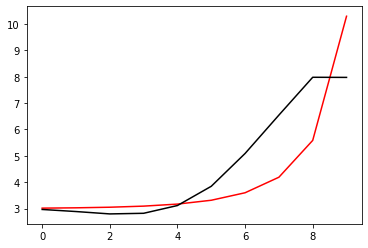

172700 0.011079177547135227
[2.95625568 2.89058702 2.81457467 2.84863851 3.14545685 3.8627113
 5.06637069 6.44559924 7.75980411 7.73876851]


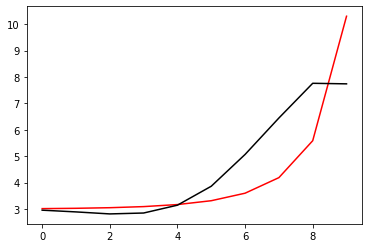

173800 0.015191778780581592
[2.97474061 2.9160432  2.8484951  2.89134827 3.19798786 3.92824755
 5.15295711 6.57312916 7.92464285 7.86628737]


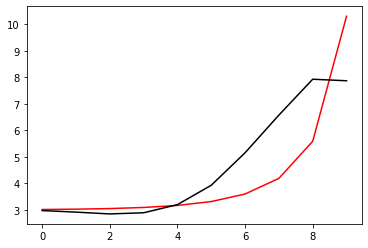

174900 0.010683932525806716
[3.05020549 2.96554891 2.87170018 2.88419799 3.15176618 3.82445889
 4.9533805  6.22212175 7.42160635 7.4903081 ]


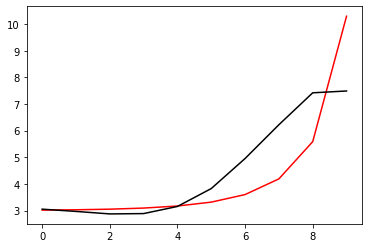

176000 0.0601990504800031
[3.0205391  2.94160068 2.85539573 2.87716974 3.15616568 3.84492045
 5.00129893 6.3257614  7.58616531 7.58829724]


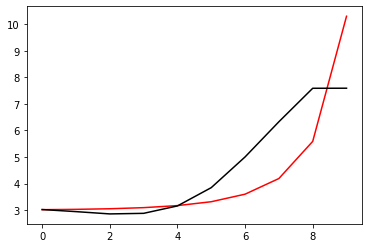

177100 0.010870484238096176
[3.02756538 2.95510028 2.8787109  2.91307474 3.20822813 3.92038081
 5.11698756 6.52076928 7.85888157 7.87423528]


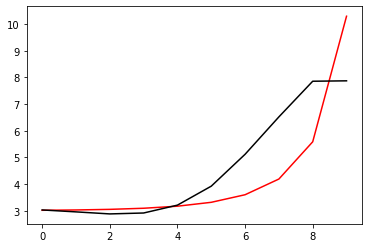

178200 0.012200037353880058
[2.99145834 2.88262879 2.77177326 2.77301423 3.03443857 3.70897522
 4.85835996 6.20183458 7.49823343 7.47705419]


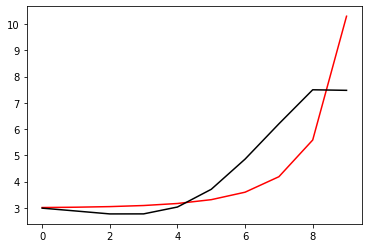

179300 0.010772792779688027
[2.99203537 2.89663385 2.80033088 2.81822868 3.09934205 3.79991113
 4.98945852 6.40464872 7.78079718 7.78285802]


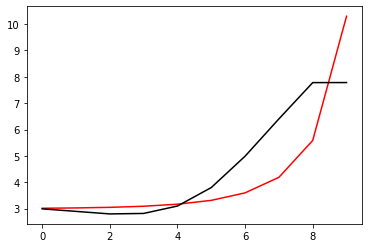

180400 0.00720604722161194
[3.06105001 2.91939209 2.77431958 2.73885698 2.95558251 3.56641747
 4.6108223  5.79490213 6.96391156 6.94890749]


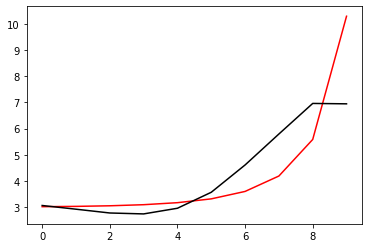

181500 0.006328260893851724
[3.05625147 2.92154238 2.78278715 2.75449129 2.97986778 3.6026191
 4.66648767 5.8870415  7.10207595 7.09019653]


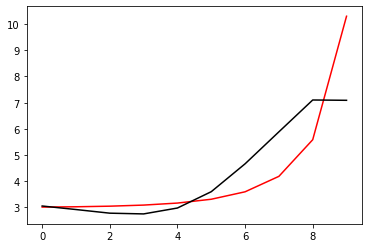

182600 0.0007198212933322719
[3.07020335 2.95142346 2.82819967 2.81674032 3.06123343 3.70818034
 4.80794533 6.08966876 7.37521877 7.33009753]


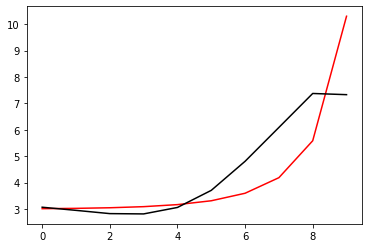

183700 0.45053323683076735
[2.77150381 2.64475324 2.51498377 2.49883553 2.74005917 3.38529444
 4.48827213 5.79356272 7.11205101 7.51826563]


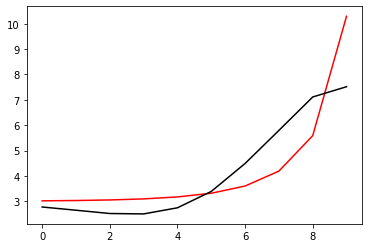

184800 0.029015632146839807
[3.08818175 2.95511996 2.81666057 2.78814267 3.00955856 3.62008648
 4.65964264 5.85516723 7.01111875 6.99790399]


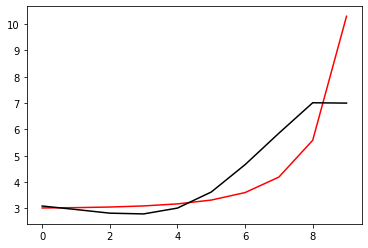

185900 0.010677707319146421
[3.09342643 2.96983857 2.84006494 2.82075347 3.05298365 3.67853885
 4.74352232 5.98550177 7.1870552  7.19339325]


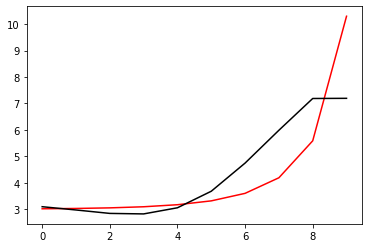

187000 0.06019267636473416
[3.08614031 2.97707096 2.86111532 2.85634299 3.10557611 3.7547317
 4.8597243  6.17436157 7.44664328 7.42799121]


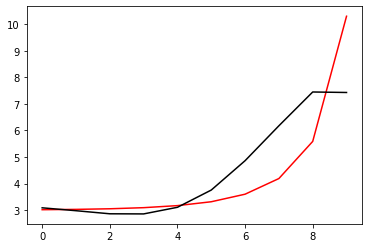

188100 0.010513898598709239
[3.01484044 2.86661502 2.7092327  2.65940553 2.85580652 3.43440779
 4.42822678 5.55500449 6.68576706 6.6994613 ]


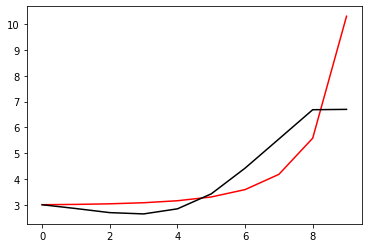

189200 0.025342434675647563
[3.19864557 3.0407153  2.87244023 2.81126357 2.99514288 3.55861549
 4.53349108 5.64071908 6.74648903 6.71563345]


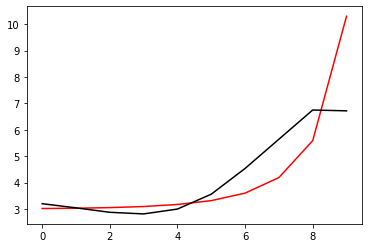

190300 0.01110365332435797
[3.0858022  2.94203923 2.78803781 2.74290767 2.94603024 3.53552891
 4.55176541 5.73123534 6.92432234 6.93840041]


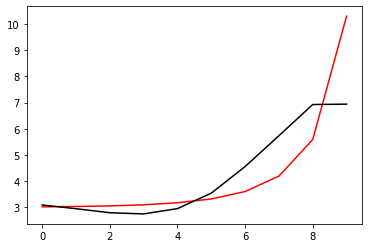

191400 0.0031398536150064197
[3.05218507 2.92640246 2.79182623 2.76928773 3.00025769 3.62781606
 4.70361654 5.9819179  7.27910333 7.22829154]


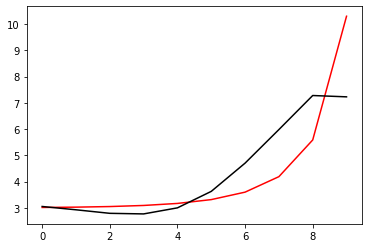

192500 0.0023919019754332894
[3.00736511 2.89421026 2.77417163 2.76989452 3.02600076 3.69260671
 4.83777495 6.23971295 7.65669533 7.65606751]


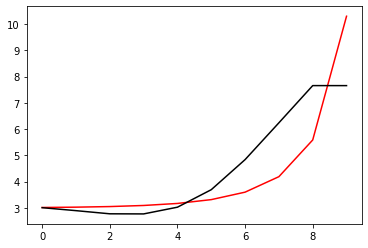

193600 0.010337885411652146
[2.99232424 2.88777374 2.77369294 2.76808456 3.0087991  3.63093628
 4.65907832 5.62137928 6.77608775 6.88243746]


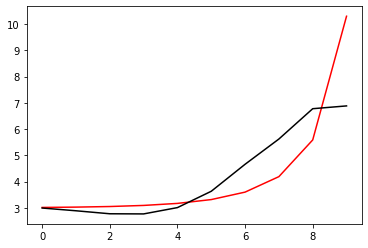

194700 0.021256541478081963
[3.00137726 2.90051521 2.79020072 2.78857982 3.03413371 3.66324686
 4.70309044 5.69057432 6.86624001 6.84224012]


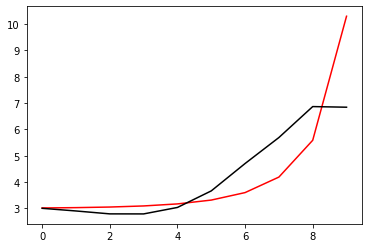

195800 0.028947219460635186
[3.0025977  2.90831406 2.80489277 2.81056982 3.06493137 3.70668767
 4.76783191 5.80060778 7.0159973  6.99967359]


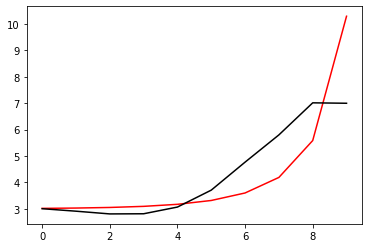

196900 0.010651322183773229
[3.05363405 2.97390811 2.88560611 2.90649648 3.17755461 3.84032823
 4.93209154 6.02370078 7.2781725  7.30181182]


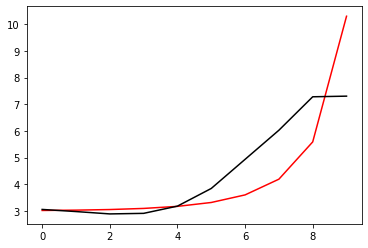

198000 0.18519575399066104
[3.07408309 3.01574815 2.95162944 2.99761063 3.29696062 3.99649591
 5.14391492 6.33958989 7.67569085 7.60255166]


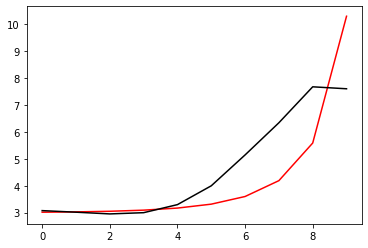

199100 0.01055433267062025
[2.994706   2.92531068 2.84769468 2.87406048 3.14154674 3.78499655
 4.83018375 5.85477365 6.95673003 6.95696391]


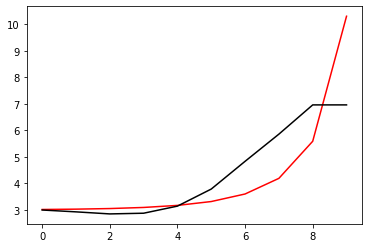

200200 0.012453120756440972
[2.99486074 2.93065803 2.85945009 2.89328909 3.17055693 3.82900025
 4.90048673 5.97498731 7.1192934  7.05925928]


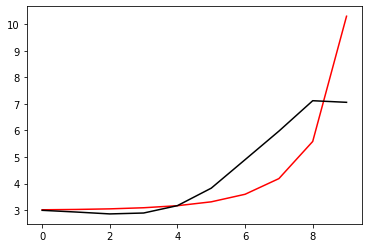

201300 0.010723086217274165
[2.97065331 2.91412986 2.85222264 2.89607693 3.18523246 3.8605773
 4.96139933 6.09716994 7.29523068 7.32407556]


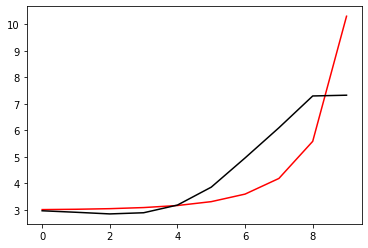

202400 0.0010030889695984157
[2.91785247 2.87305993 2.82640244 2.88693638 3.19580292 3.89873592
 5.04660768 6.27810524 7.55797517 7.53757468]


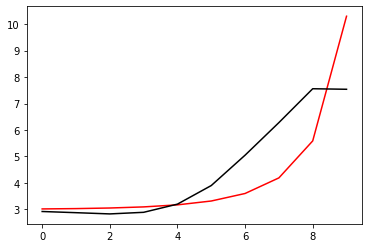

203500 0.002973057679210269
[2.97493293 2.88445525 2.7950146  2.81401319 3.07944608 3.73073941
 4.80628113 5.93554126 7.10947697 7.09241563]


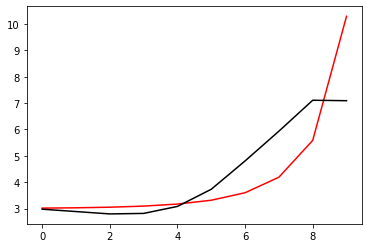

204600 0.0007532957927893262
[2.98720785 2.90908793 2.83254096 2.86536086 3.14625791 3.81692724
 4.92090199 6.10330974 7.33730433 7.31051117]


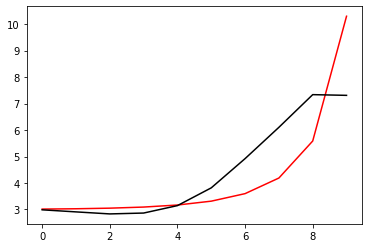

205700 0.07888300529145813
[3.13383442 3.03959412 2.94558804 2.95746685 3.21006568 3.83701329
 4.86661503 5.94643944 7.09491683 7.35651106]


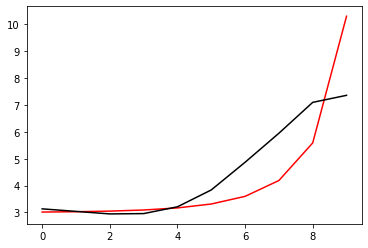

206800 0.029283592026585394
[3.01151681 2.90772254 2.80356392 2.80508952 3.0464773  3.66122716
 4.68136639 5.77351649 6.95160377 6.93580544]


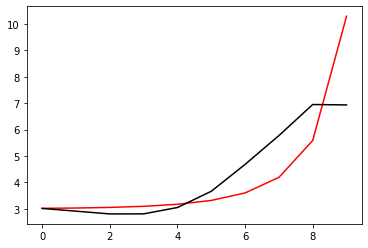

207900 0.010610363593195617
[3.05640294 2.96922552 2.8818754  2.90086525 3.16038747 3.79542563
 4.84330135 5.98951313 7.22019616 7.24485554]


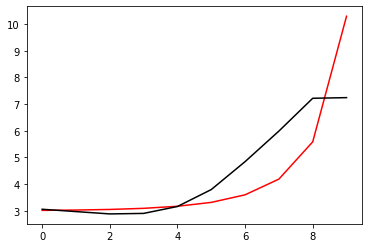

209000 0.06037694728070801
[3.03420399 2.90453638 2.7768622  2.75769821 2.97927023 3.57242535
 4.56576638 5.638168   6.79576667 6.78659026]


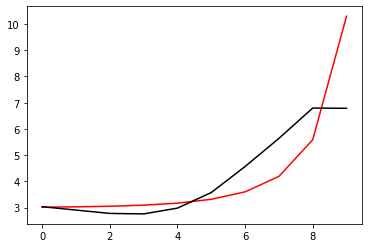

210100 0.010570006639933618
[3.04389074 2.92175192 2.80029915 2.78766472 3.01645118 3.61880674
 4.6271077  5.73122782 6.92481381 6.92561043]


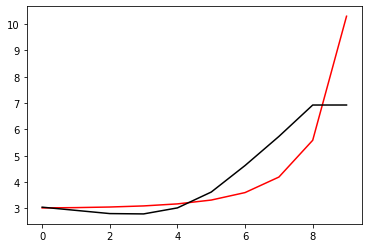

211200 0.015001935927027034
[3.04559592 2.94062151 2.83580161 2.84104552 3.09003642 3.71779058
 4.7636573  5.93411292 7.19814811 7.13824995]


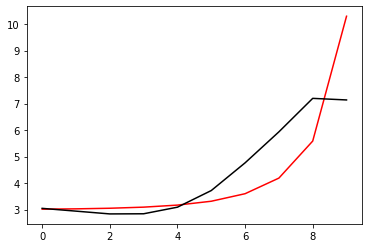

212300 0.011192425495019316
[3.06134088 2.93530504 2.80618265 2.78267266 2.99387739 3.56491067
 4.51694398 5.55056116 6.70606869 6.68475104]


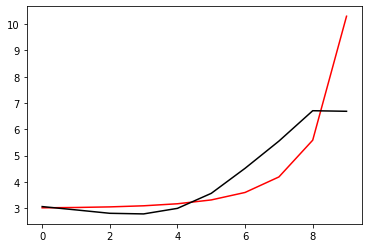

213400 0.003968773003779357
[3.03831984 2.92521052 2.81146446 2.80797607 3.04667477 3.658836
 4.6780216  5.82022974 7.07410045 7.0465311 ]


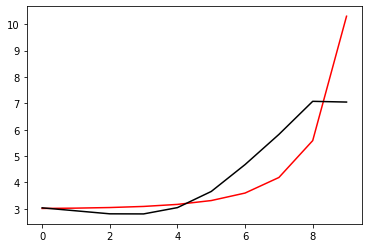

214500 0.012896827246222169
[2.94233033 2.84085592 2.74226344 2.75963466 3.02842657 3.68751297
 4.7862307  6.06031353 7.43079393 7.39787695]


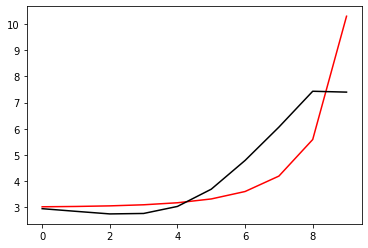

215600 0.0031691292320352904
[3.06999993 2.93766032 2.80741332 2.79108591 3.01968512 3.62270837
 4.63183687 5.76826277 6.98133924 6.95529654]


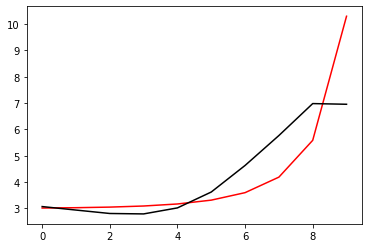

216700 0.010734149742451408
[3.07450541 2.95413057 2.83479791 2.83028191 3.07308644 3.69575558
 4.73697018 5.9320703  7.21454968 7.2127705 ]


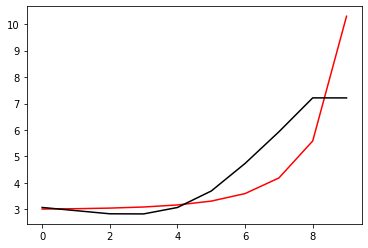

217800 0.08939159492045028
[2.95393533 2.8052112  2.65865812 2.62877709 2.84734245 3.44502476
 4.4585838  5.62890937 6.88844169 6.97101522]


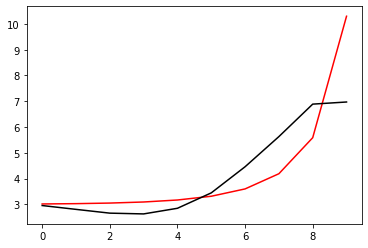

218900 0.01075159732347058
[3.14394605 2.98616412 2.82972689 2.79081074 3.00096511 3.59037128
 4.59634791 5.76474675 7.02124452 7.0213097 ]


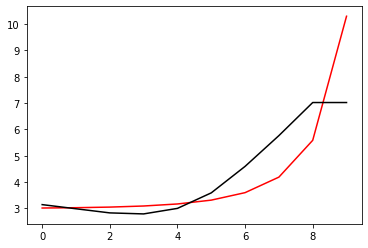

220000 0.060475397667845904
[3.13516724 2.99446639 2.85289036 2.82930352 3.05675024 3.66817881
 4.70714975 5.93173833 7.25360748 7.25236433]


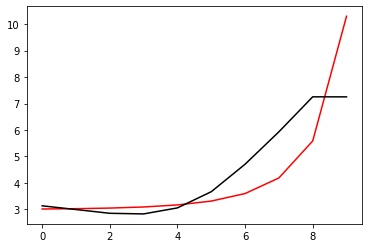

221100 0.010680049646959799
[3.08341805 2.95730958 2.82880425 2.81949153 3.06470592 3.7014174
 4.78280504 6.08609974 7.49868778 7.50832088]


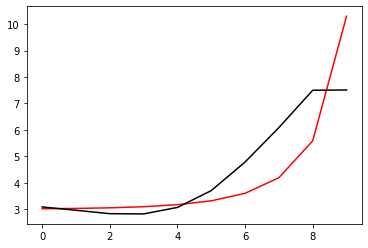

222200 0.016876637521764878
[3.05913157 2.8964499  2.73363824 2.69284409 2.9082296  3.51208654
 4.54546004 5.77593762 7.13057339 7.12078217]


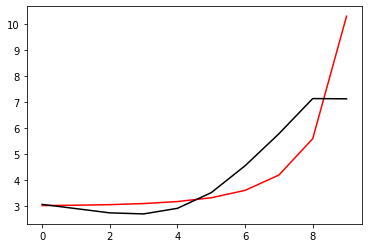

223300 0.010789733514219762
[3.06686051 2.91318808 2.75665624 2.72145285 2.94257166 3.55356153
 4.59913095 5.85571186 7.24282419 7.24271036]


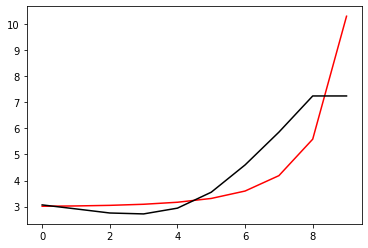

224400 0.0024862954560155126
[3.04931479 2.91636852 2.77777319 2.75995326 2.99993405 3.63449166
 4.71586729 6.03499217 7.49519617 7.45757025]


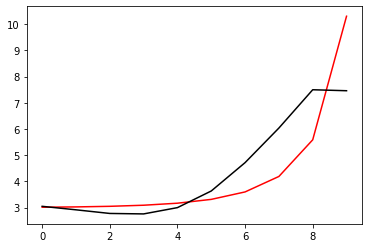

225500 0.0009593059826638291
[3.08901296 2.90547276 2.7133986  2.63769898 2.80979768 3.35330717
 4.29474992 5.40271645 6.66764498 6.66183186]


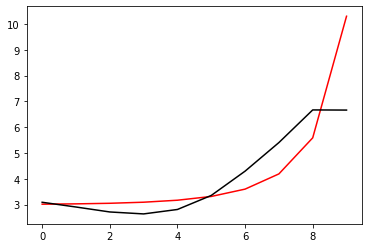

226600 0.0019644509059236316
[3.19124252 3.00819799 2.81546442 2.73987591 2.91365249 3.46159094
 4.41349066 5.5452439  6.83861082 6.81090554]


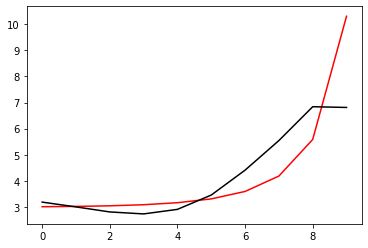

227700 0.011183504214717394
[3.15455262 2.98722884 2.80873463 2.7490588  2.94336104 3.52163867
 4.52449554 5.74441565 7.14339964 7.10072286]


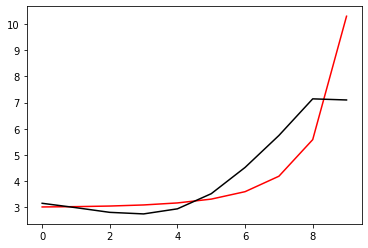

228800 0.030326955700849784
[3.09471428 2.9042924  2.70220703 2.62072075 2.79626128 3.35868558
 4.34578568 5.54389408 6.9253548  7.0048429 ]


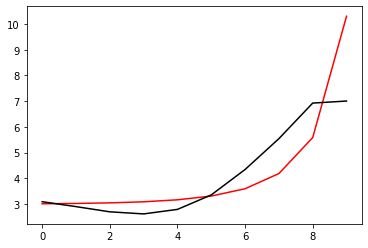

229900 0.018158640674632846
[3.05070776 2.87160579 2.67879691 2.60662198 2.79281784 3.36934968
 4.37884064 5.61626126 7.0442546  7.01058083]


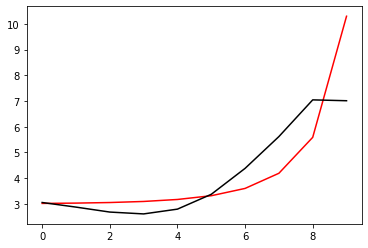

231000 0.060683822774302815
[3.2011038  3.02007162 2.82295673 2.7460629  2.9280253  3.50165923
 4.51296949 5.76536946 7.20263238 7.20583663]


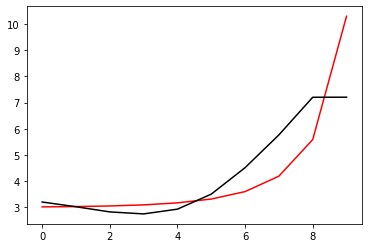

232100 0.010758395900935976
[3.11015861 2.94048705 2.75480628 2.69301064 2.89853738 3.51240151
 4.59671499 5.97272963 7.53248028 7.53411565]


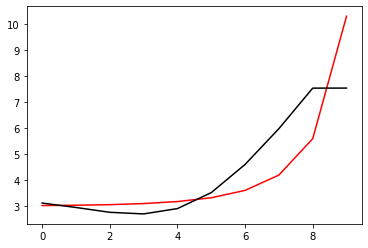

233200 0.022955573635026167
[3.14306321 3.00655166 2.84990456 2.81111864 3.03072448 3.63936025
 4.65671106 5.61968458 6.94216295 7.16543272]


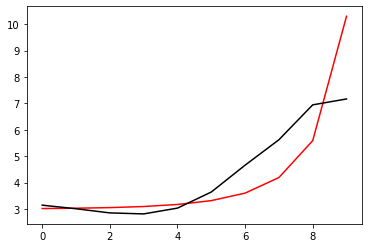

234300 0.012177976671150451
[3.10343444 2.97371368 2.82372435 2.79170321 3.01978713 3.64229147
 4.68954562 5.72434326 7.08286606 7.03756632]


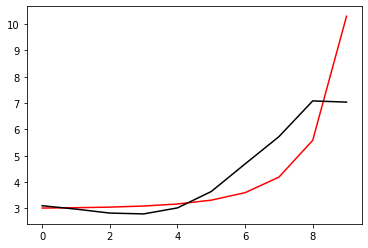

235400 0.004464285426058741
[3.07056644 2.94994116 2.8093336  2.78706829 3.02776652 3.6713284
 4.7632275  5.89736305 7.2925265  7.26896217]


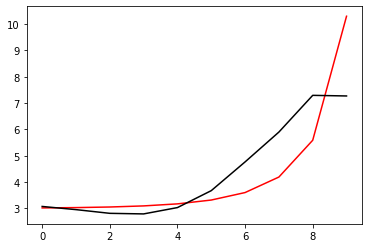

236500 0.00330876223279475
[2.9716452  2.86335786 2.73598093 2.72693398 2.98389865 3.65391417
 4.80311007 6.0772891  7.54810099 7.52162144]


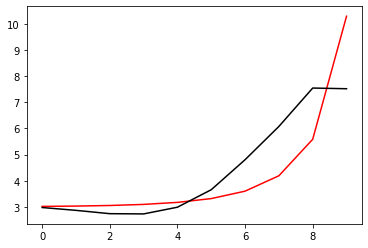

237600 0.71279484329294
[3.29975878 3.19033929 3.06362687 3.05524715 3.31602791 3.99797895
 5.1688354  6.41032063 7.69716639 7.87671583]


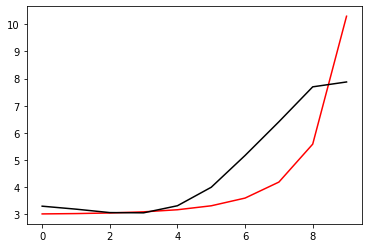

238700 0.01956465174837891
[3.0825343  2.94335403 2.78410314 2.73671402 2.94484677 3.54538898
 4.57861573 5.63188533 6.8138057  6.79161834]


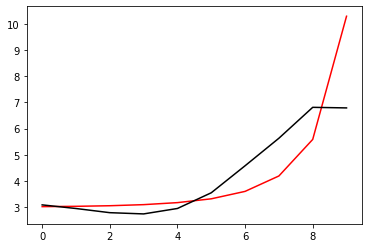

239800 0.02779489189013538
[3.11799985 2.98691171 2.83569906 2.79688406 3.01577848 3.63253215
 4.69306257 5.79419229 7.0000657  6.9771995 ]


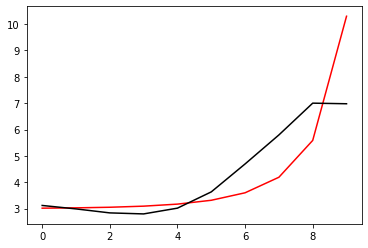

240900 0.01068508798698907
[3.10971483 2.99200948 2.85449495 2.82999895 3.06629716 3.70869795
 4.81285004 5.99432185 7.25493081 7.26485806]


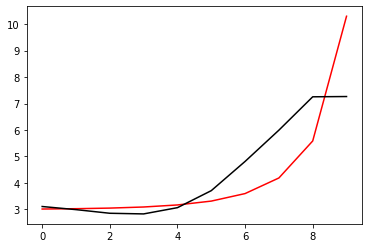

242000 0.06059015373218887
[3.05838905 2.95031924 2.8240247  2.81119069 3.06154344 3.72515968
 4.86839416 6.1395293  7.47223117 7.45308878]


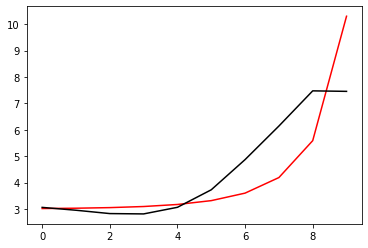

243100 0.010612810840591756
[3.08518202 2.94947578 2.79437492 2.74886792 2.95999541 3.57047137
 4.62162523 5.69803602 6.90219687 6.91285414]


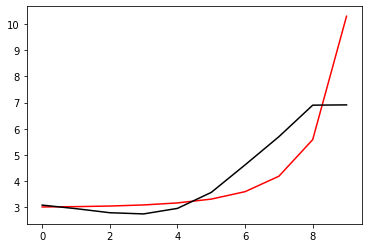

244200 0.016254977288136387
[3.08924545 2.96648722 2.82630123 2.79823332 3.03125655 3.67211223
 4.76845628 5.92005167 7.19142778 7.10328424]


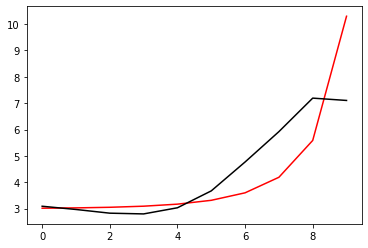

245300 0.010809870661900782
[3.03597127 2.92878936 2.80705573 2.79958049 3.05691294 3.72990008
 4.87414885 6.11409473 7.46326051 7.46896761]


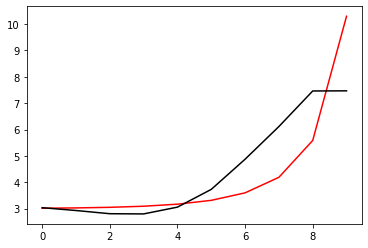

246400 0.005030663060178499
[3.08378402 2.95030344 2.80151625 2.76546675 2.99061391 3.62218365
 4.70146489 5.84609222 7.11799844 7.05909585]


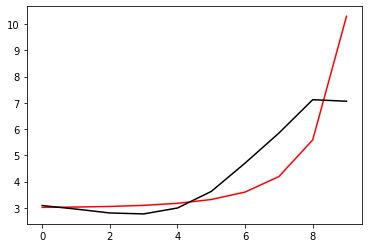

247500 0.002785657542511964
[2.98506854 2.86466547 2.73136802 2.71368756 2.96201559 3.62620666
 4.75670252 5.99350826 7.35984637 7.34015024]


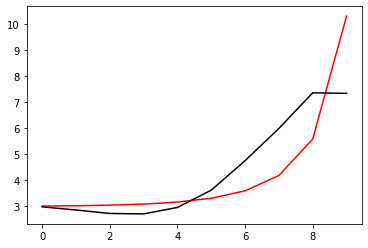

248600 0.0006830868528136098
[3.03327039 2.94419384 2.84012111 2.84621081 3.1101992  3.77832907
 4.89745514 6.1253931  7.4581396  7.46707586]


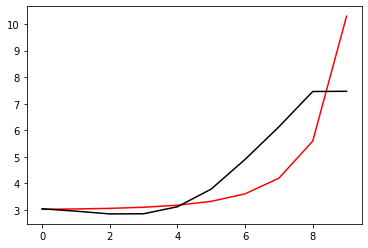

249700 0.010662262253578138
[3.04147361 2.95360364 2.85197554 2.8577605  3.11574158 3.76790886
 4.85719843 6.05957003 7.34558586 7.2968047 ]


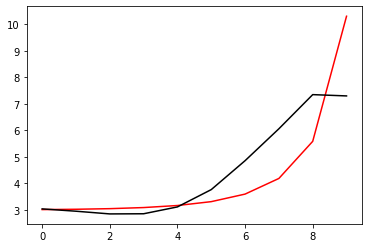

250800 0.029334699604264405
[3.02837618 2.91309679 2.78639515 2.76726132 2.99887599 3.62036748
 4.66908752 5.8163452  7.05301949 7.16954864]


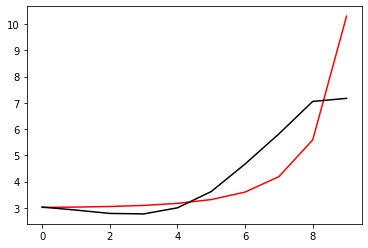

251900 0.010640334820069649
[3.07562927 2.97700536 2.86700603 2.86428295 3.11213387 3.75099322
 4.82187104 6.00885292 7.28200849 7.27259123]


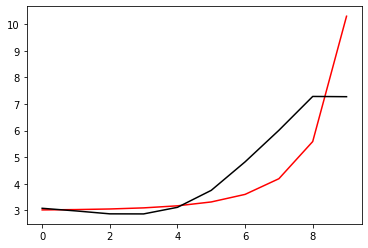

253000 0.060516372123003564
[3.11298959 2.98982071 2.85471345 2.82492781 3.04100502 3.63757797
 4.64483094 5.74814035 6.95450981 6.94897127]


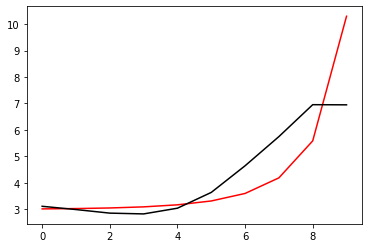

254100 0.010627693917696805
[3.10343467 2.99453761 2.87542111 2.86412992 3.10248973 3.72880175
 4.78091868 5.95808835 7.22987827 7.23102865]


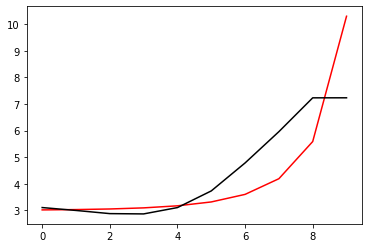

255200 0.010649176311953047
[3.00309061 2.90722599 2.80575941 2.81771025 3.08797124 3.76261224
 4.89545223 6.20920658 7.60760183 7.5661671 ]


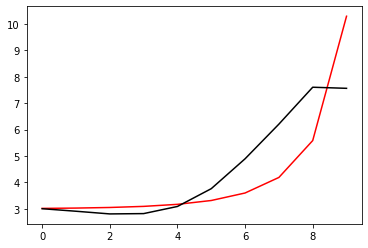

256300 0.011576847143506963
[3.0968617  2.96101787 2.81977211 2.79159381 3.01847879 3.6395183
 4.69106845 5.87411831 7.16867991 7.12847226]


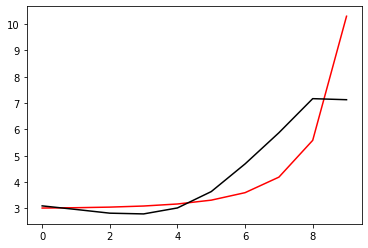

257400 0.0024589141301354723
[3.03825517 2.91635485 2.789468   2.77765018 3.02421276 3.6717634
 4.76464439 6.01937643 7.38831707 7.36373072]


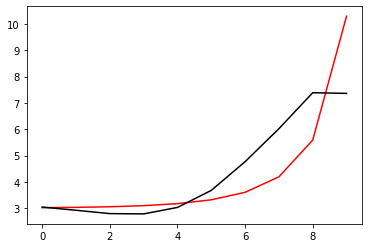

258500 0.010588254103992948
[3.04992024 2.94657519 2.83746928 2.84302656 3.10675696 3.7729344
 4.89238601 6.20146462 7.61932093 7.64000801]


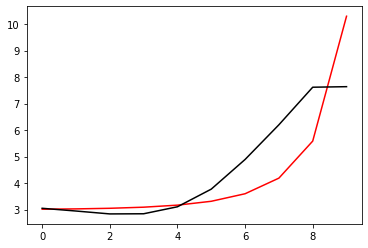

259600 0.0007277210849275107
[3.0187749  2.925554   2.82871003 2.84580196 3.11933872 3.79376077
 4.92655838 6.28469078 7.75792318 7.85062355]


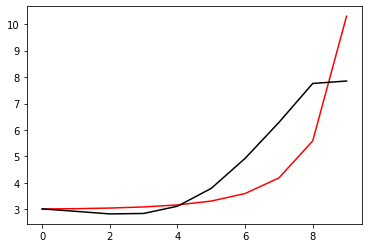

260700 0.42781745979647057
[2.76379696 2.64721472 2.52957737 2.52556153 2.77465239 3.41616369
 4.49556456 5.72021216 7.10330355 7.62365301]


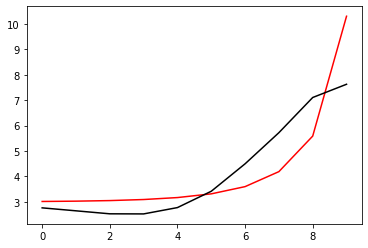

261800 0.029540380918167297
[3.0248379  2.9031057  2.77759192 2.76159536 2.99097987 3.59793591
 4.61524092 5.73761334 6.97497167 6.95638402]


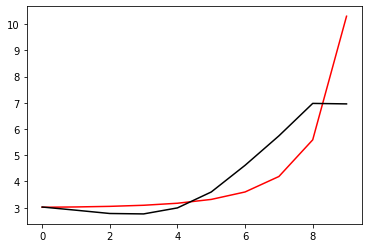

262900 0.009965415703144107
[3.02135626 2.90656457 2.78739971 2.77812942 3.01549341 3.63389599
 4.67154206 5.83596775 7.1183958  7.1126402 ]


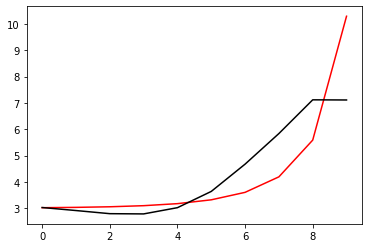

264000 0.06009998445737183
[3.08195488 2.98129385 2.87538491 2.87931149 3.13084835 3.76697024
 4.83195401 6.04771976 7.37288495 7.37185828]


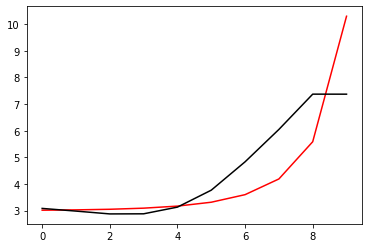

265100 0.010507458098782745
[3.00564044 2.86495645 2.71737328 2.67640814 2.87569303 3.44259797
 4.39988647 5.43985961 6.62439761 6.64028315]


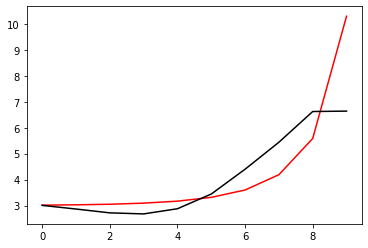

266200 0.02715264535413175
[3.1722944  3.02311229 2.86577218 2.81442797 3.00187242 3.55391455
 4.4918563  5.51222879 6.6683187  6.65839381]


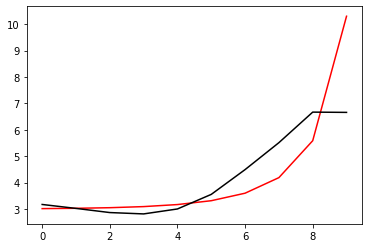

267300 0.011453919282569912
[3.09252337 2.95403756 2.80894247 2.77389414 2.98438915 3.57230797
 4.57169553 5.69992495 6.97886071 6.93932349]


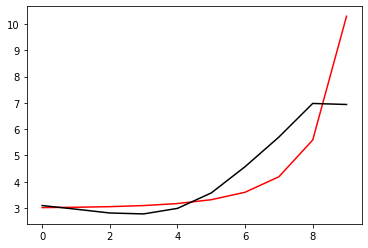

268400 0.0029943750080991217
[3.04056477 2.91597802 2.78596527 2.76988318 3.00632121 3.63403505
 4.70146238 5.94716536 7.33754986 7.29091307]


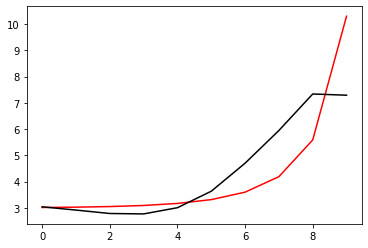

269500 0.0009797344934960287
[3.07863646 2.90321048 2.71973069 2.64705005 2.8190672  3.36282213
 4.29931293 5.32298598 6.5273291  6.51822517]


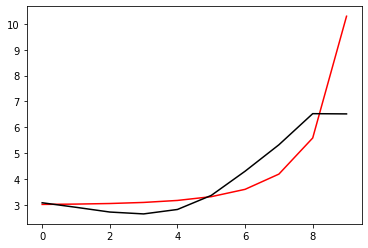

270600 0.010612255960074752
[3.08149154 2.9073074  2.72320588 2.64980616 2.82103558 3.36423707
 4.30309002 5.34342102 6.56826861 6.56942194]


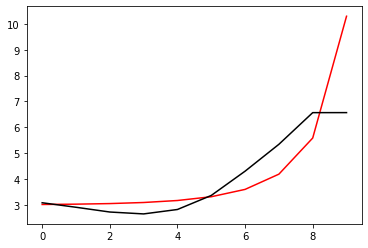

271700 0.010701284897249278
[3.18487418 3.01882494 2.84219766 2.77861241 2.96416391 3.53046395
 4.51056286 5.62703172 6.92229824 6.92949155]


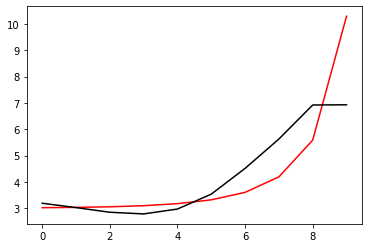

272800 0.03155820696427902
[3.16548402 3.02943665 2.88491909 2.8591401  3.09277025 3.72671717
 4.81074123 6.07927528 7.49138805 7.40774582]


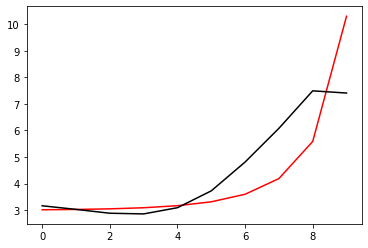

273900 0.006771059519457372
[2.99993586 2.87063755 2.72911499 2.69979373 2.91767958 3.51108817
 4.49760062 5.5088223  6.64783749 6.61749945]


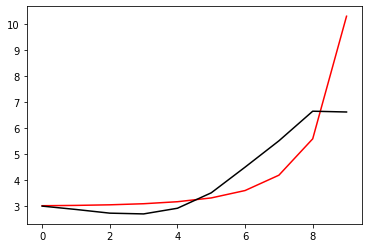

275000 0.06052997228069215
[3.13101611 2.9945941  2.84737466 2.81454483 3.03198932 3.62954885
 4.62864718 5.67152664 6.82917287 6.83081551]


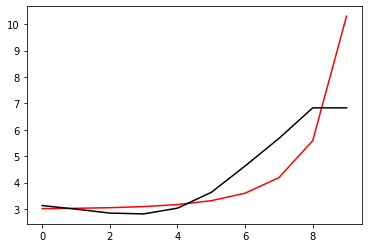

276100 0.010624527618631674
[3.11130499 2.9902275  2.85864045 2.84278031 3.0812083  3.70927926
 4.76107108 5.90365704 7.15274154 7.15232673]


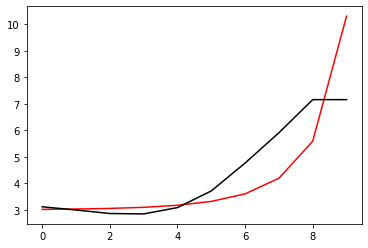

277200 0.01228316560485043
[3.02782907 2.91596755 2.79560434 2.7935684  3.0516688  3.71210737
 4.82581209 6.09479871 7.46120437 7.3559693 ]


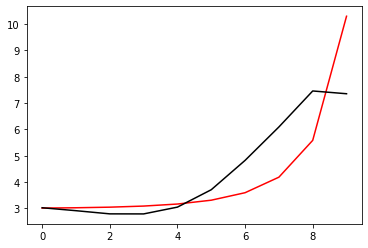

278300 0.011573458850455447
[3.09820496 2.961144   2.8143969  2.78438746 3.01152579 3.63323261
 4.68719933 5.84960042 7.11987037 7.07002916]


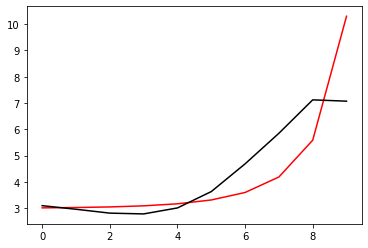

279400 0.0024606056123006948
[3.03923252 2.91903214 2.79063867 2.78103551 3.03249051 3.68637429
 4.78886343 6.0338073  7.38163121 7.34711436]


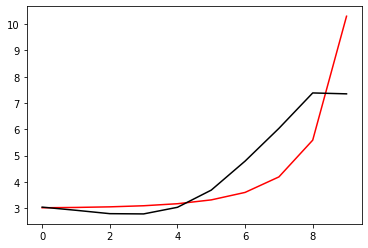

280500 0.01045534417526421
[3.04018855 2.93996249 2.83065455 2.83779271 3.10336219 3.76875341
 4.88370843 6.16388264 7.53624828 7.54526613]


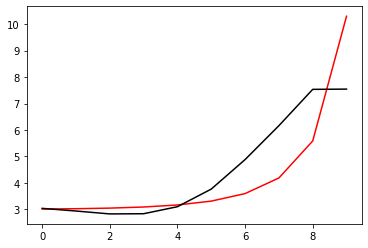

281600 0.13288594922293187
[2.84615167 2.74414717 2.63377203 2.6364888  2.89090766 3.53252888
 4.60359015 5.82567073 7.1042331  7.25699257]


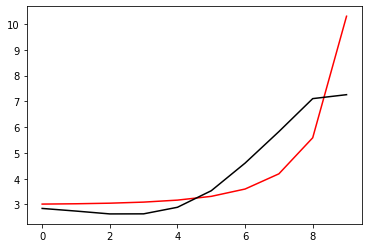

282700 0.01977955303189157
[3.01687895 2.90287927 2.7816266  2.77390129 3.0171966  3.64481745
 4.69538325 5.88856239 7.12567963 7.10922312]


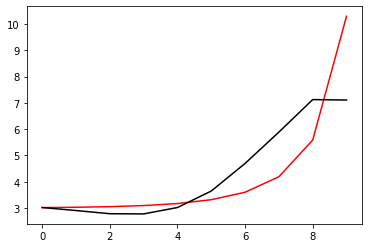

283800 0.028234095120758463
[3.02143409 2.91533312 2.80163386 2.80147825 3.05338843 3.69274388
 4.76270366 5.99244584 7.27010804 7.25785948]


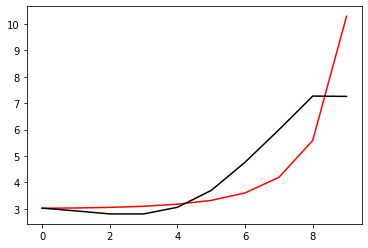

284900 0.010634845002251382
[3.01114376 2.91374865 2.80896218 2.81792117 3.08047564 3.73493175
 4.83148209 6.11529359 7.45505537 7.46936656]


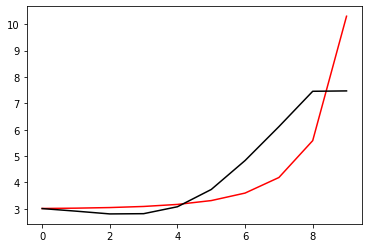

286000 0.06050890877910698
[3.04703171 2.9235764  2.78971366 2.76419768 2.98294179 3.57558653
 4.57700094 5.72603786 6.94687477 6.9388751 ]


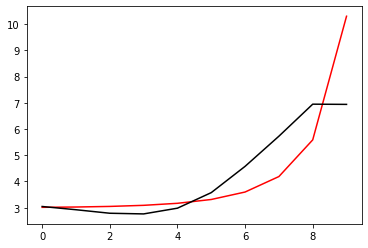

287100 0.01060014514009278
[3.09068209 2.98214883 2.86392081 2.85475025 3.09104933 3.70429028
 4.73418489 5.93038286 7.19239006 7.1925269 ]


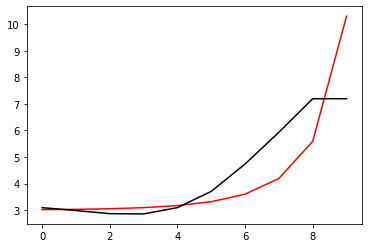

288200 0.010604770410372808
[3.00284504 2.90783522 2.80763615 2.82204325 3.09136647 3.75590021
 4.87316152 6.21578488 7.62525392 7.57800148]


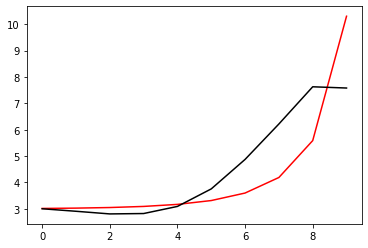

289300 0.010731729739203204
[3.02846541 2.88976727 2.74770507 2.72093455 2.94689833 3.55953787
 4.60241438 5.8298204  7.12172258 7.11706879]


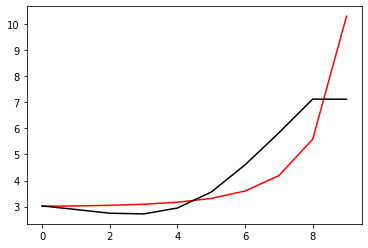

290400 0.003996511380262118
[3.06816846 2.93955215 2.80556267 2.78620297 3.01957199 3.6411031
 4.69820657 5.95486111 7.28321584 7.23632182]


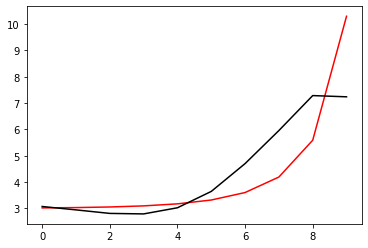

291500 0.021887711318417158
[2.94953176 2.83943178 2.72423784 2.72522018 2.98256175 3.63627802
 4.74348177 6.08578526 7.51675922 7.50496513]


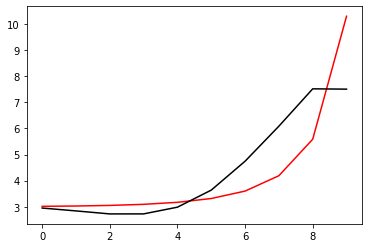

292600 0.010607749395033257
[3.05912337 2.90084966 2.73319247 2.67546694 2.86155294 3.41724577
 4.37188955 5.48376277 6.70499451 6.70491379]


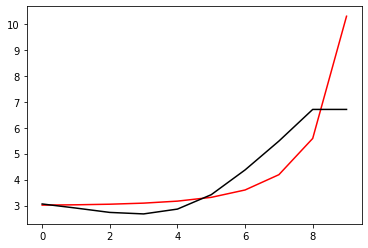

293700 0.010843451059435006
[3.16336938 3.00504103 2.83643452 2.77823404 2.9646005  3.52208395
 4.4829075  5.61339391 6.85371676 6.84244873]


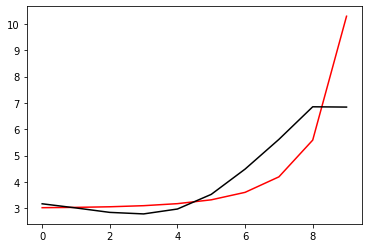

294800 0.02921231284577091
[3.10675901 2.95982375 2.80358171 2.76181129 2.97218144 3.56855638
 4.59799197 5.84671217 7.21751741 7.22273075]


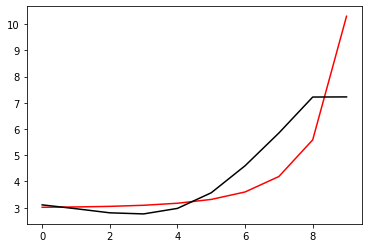

295900 0.012195703427622698
[3.11168412 2.94536115 2.76691096 2.7005674  2.88217967 3.44029067
 4.40768705 5.54122086 6.82365258 6.85957046]


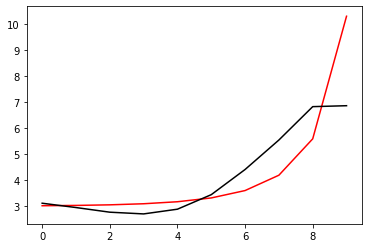

297000 0.13148080582707697
[3.2734283  3.10804977 2.92921468 2.86257502 3.04437987 3.60325441
 4.57113401 5.70311876 6.96340115 7.01316934]


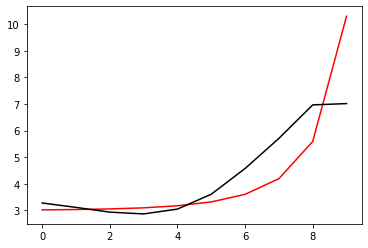

298100 0.010638154387475163
[3.12465345 2.94278607 2.74543762 2.66059322 2.82542415 3.37040071
 4.33554337 5.50457527 6.85327912 6.86221288]


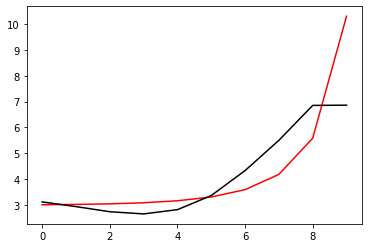

299200 0.018141901058585062
[3.09231809 2.92071878 2.73231588 2.65822852 2.8383046  3.408735
 4.42403412 5.6943404  7.14971706 7.08078772]


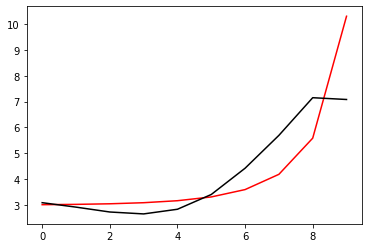

300300 0.010780323906529943
[3.05672096 2.90552647 2.73665655 2.6835526  2.88940925 3.49786775
 4.58207476 5.97822852 7.53858492 7.58902423]


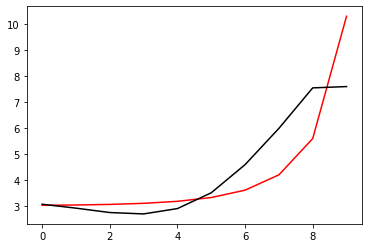

301400 0.008434036612851832
[3.06215486 2.95073437 2.81535016 2.78415375 2.99183025 3.56032576
 4.49523561 5.45322016 6.70327828 6.86382754]


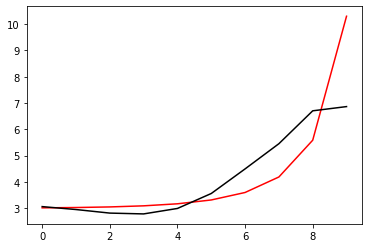

302500 0.009332855529539842
[3.05541031 2.9481929  2.81744575 2.79121385 3.00539571 3.58481898
 4.54356539 5.55261976 6.81782315 6.79753936]


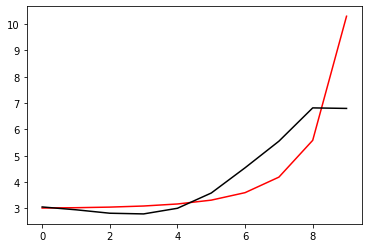

303600 0.0008733972556879042
[3.06381039 2.96482241 2.84346813 2.82770729 3.05598067 3.65909914
 4.66698837 5.76732923 7.04620853 7.02493542]


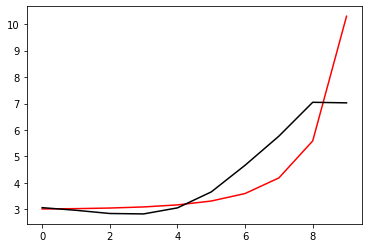

304700 0.010650164764816518
[3.0485861  2.96230981 2.85566819 2.85569657 3.10416802 3.73992952
 4.81383839 6.03517757 7.34433692 7.35090871]


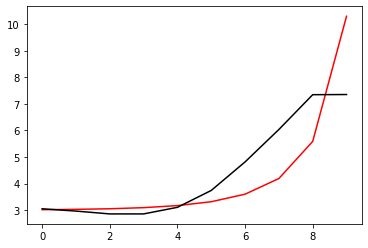

305800 0.017469311931247188
[3.05132722 2.97855948 2.89019036 2.91030596 3.18444115 3.86089474
 5.01277709 6.36924191 7.7200011  7.59110852]


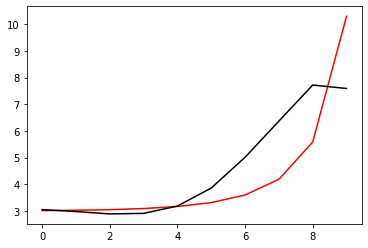

306900 0.010626342212557009
[3.0113391  2.94595152 2.86301126 2.882406   3.14586527 3.79379063
 4.88179909 6.11343804 7.27040918 7.24901884]


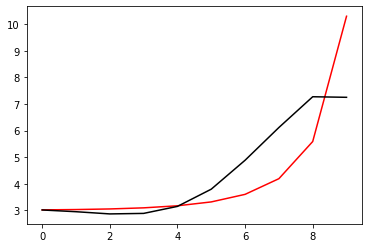

308000 0.05983885404068872
[3.00814395 2.95201305 2.88111344 2.91343339 3.19246149 3.86339042
 4.99273743 6.3038395  7.52128124 7.5196237 ]


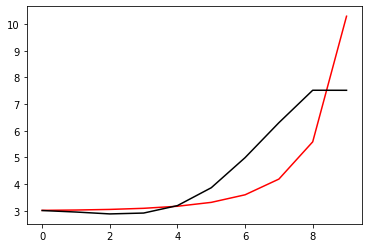

309100 0.010536377310032425
[3.07469109 2.98891712 2.88729353 2.88327784 3.1149938  3.71583032
 4.72480994 5.82168942 6.88662258 6.88878138]


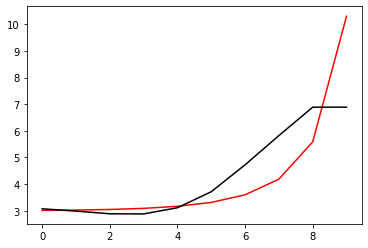

310200 0.013788231977686409
[3.02209491 2.94161171 2.84902247 2.8580649  3.10941613 3.74291012
 4.81012232 6.00848732 7.16883153 7.07578791]


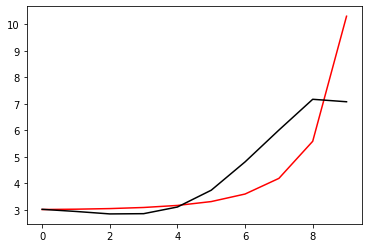

311300 0.010686734348201372
[2.95935157 2.89073845 2.81550242 2.84624905 3.1255445  3.79936655
 4.9318713  6.24065338 7.49350377 7.50123968]


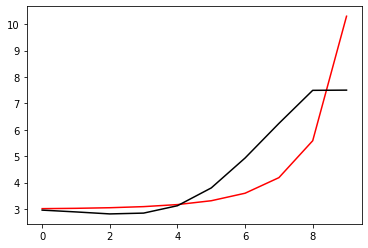

312400 0.004412995147519388
[3.02091948 2.91007146 2.79451473 2.78519567 3.02125323 3.64154031
 4.69336091 5.87326088 6.99948633 6.97252553]


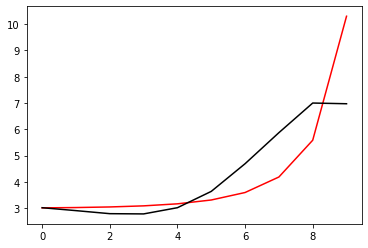

313500 0.0032397065076698504
[2.99852284 2.89657275 2.78987474 2.79029483 3.03777626 3.67352778
 4.74992623 5.97621087 7.16029861 7.15265818]


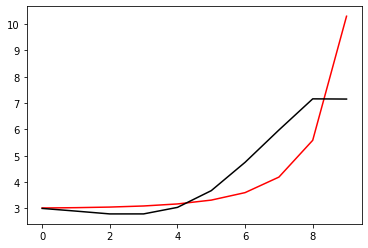

314600 0.6749089457893626
[3.27698985 3.17538598 3.06858802 3.06793371 3.31209672 3.9390904
 4.99125072 6.16533769 7.27870386 7.41805385]


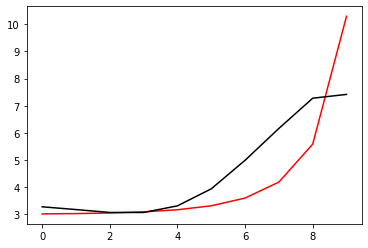

315700 0.019692503970632127
[3.02212922 2.91345626 2.79766157 2.78535419 3.01290423 3.61560539
 4.63747531 5.80432543 6.96358261 6.92083366]


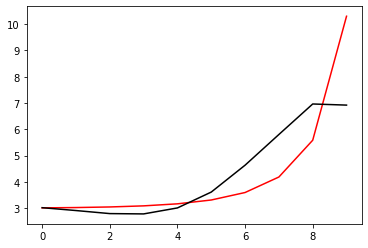

316800 0.020370571853728488
[3.07101686 2.98171511 2.88638699 2.89567258 3.14603991 3.77467371
 4.83114216 6.0559842  7.26622917 7.17953505]


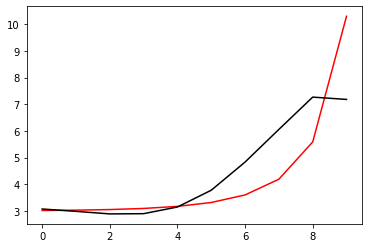

317900 0.025586190332911523
[2.97019153 2.84582794 2.71896756 2.69935142 2.92160638 3.51942639
 4.53363784 5.69342867 6.84198916 6.85083824]


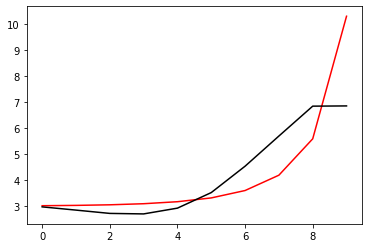

319000 0.06055830588098789
[3.09026073 2.96307931 2.83275048 2.8102462  3.03008398 3.62622685
 4.64137616 5.81194467 6.97468448 6.97632907]


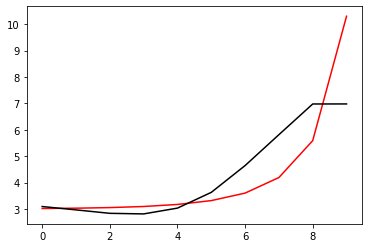

320100 0.010618751403066347
[3.09878849 2.98899592 2.87476306 2.8685157  3.10559673 3.72230377
 4.76704502 5.98916482 7.21177142 7.21190001]


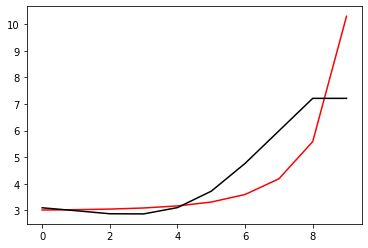

321200 0.019887670026825004
[3.04932739 2.89413583 2.73386168 2.67939347 2.86098118 3.40357839
 4.33310487 5.38236612 6.45407149 6.46076209]


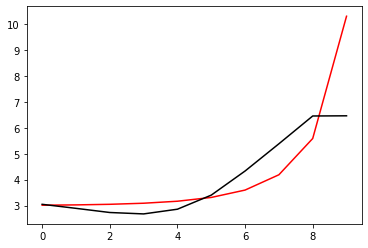

322300 0.011972170298170427
[3.11309371 2.95272173 2.78714608 2.72867287 2.90774131 3.44993828
 4.38353626 5.44798524 6.54067384 6.52504178]


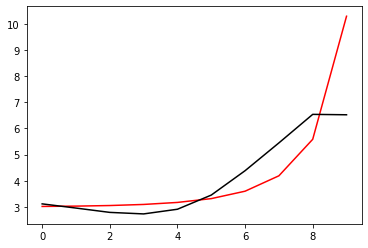

323400 0.007180058159387787
[3.09821947 2.95334987 2.80236266 2.76039631 2.96004148 3.53135879
 4.51179755 5.65566278 6.84479346 6.82967528]


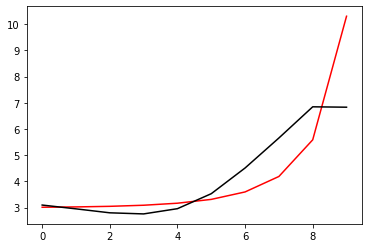

324500 0.0010207077259204484
[2.99804937 2.87828468 2.75176625 2.73595124 2.96602002 3.57761531
 4.62011181 5.86598307 7.16626203 7.16083025]


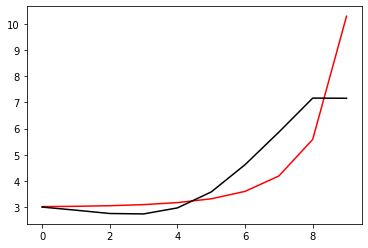

325600 0.0006866105149636414
[3.04269848 2.94445074 2.83920608 2.84517787 3.09997195 3.74417295
 4.83826435 6.17126019 7.54924055 7.52048249]


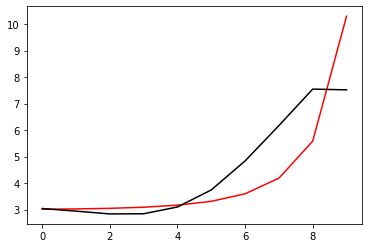

326700 0.010748467944103932
[2.97816636 2.92142952 2.85490876 2.89393297 3.17432134 3.83195099
 4.90831911 6.10059169 7.23663737 7.19443623]


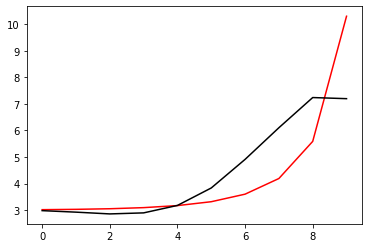

327800 0.01727141665426578
[3.01745564 2.96031043 2.89810589 2.94442468 3.23766575 3.92148631
 5.06190762 6.37801696 7.50694786 7.46520685]


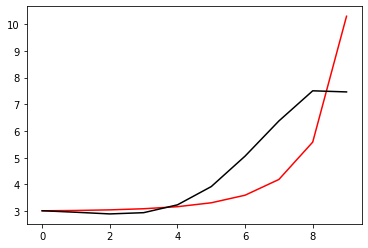

328900 0.005460638108797074
[2.9685177  2.88965719 2.80353771 2.8190782  3.06745163 3.67735251
 4.68658531 5.79885116 6.70947649 6.71825493]


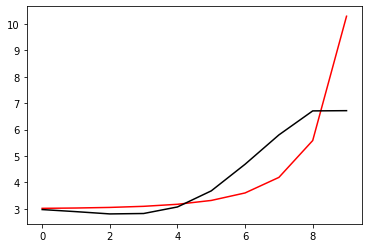

330000 0.06040486428119966
[2.96911011 2.89412614 2.81208972 2.83189863 3.08533158 3.70256738
 4.72473905 5.8608274  6.79002874 6.78983943]


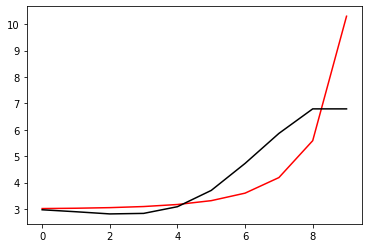

331100 0.010563430219964379
[3.01359899 2.94428027 2.86876818 2.89584325 3.15837313 3.78904471
 4.83378136 6.00613591 6.95389256 6.95325997]


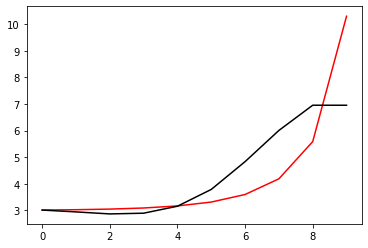

332200 0.010752968266924871
[2.96503947 2.90611875 2.84321544 2.88474145 3.1658674  3.82516586
 4.92166263 6.18694384 7.21633285 7.14773401]


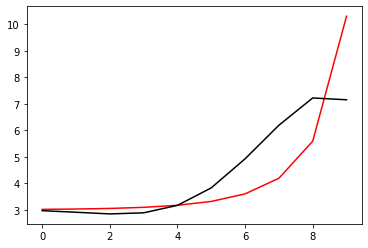

333300 0.010769222591742691
[2.99357295 2.91252507 2.82657379 2.84076959 3.08488789 3.68674163
 4.68456618 5.7845935  6.59405028 6.58420378]


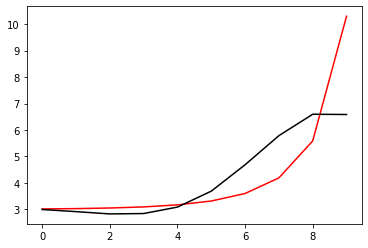

334400 0.004031365818506107
[2.99562415 2.91932611 2.83864681 2.85892588 3.11093597 3.72494251
 4.74452966 5.88384746 6.72924205 6.71659968]


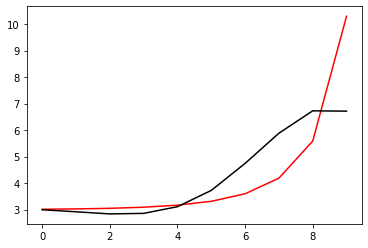

335500 0.009972355445212888
[2.98976994 2.92071559 2.84822282 2.8778221  3.14170415 3.77375388
 4.82559499 6.02376689 6.92391026 6.93079099]


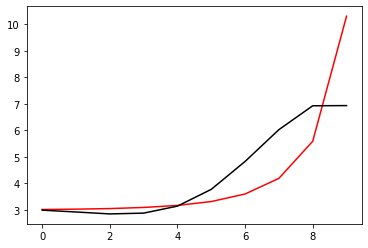

336600 0.0007067511103671898
[2.96343375 2.90628715 2.84755616 2.89246436 3.17511583 3.8346138
 4.9342488  6.21789031 7.19502503 7.14160399]


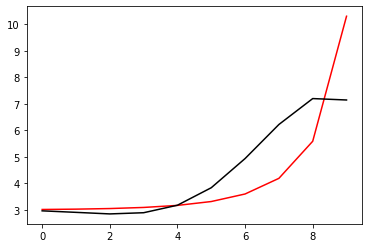

337700 0.10356381726928403
[2.88524587 2.80433536 2.72519464 2.75042548 3.01285039 3.64972581
 4.71938618 5.95845439 6.90471976 7.27461872]


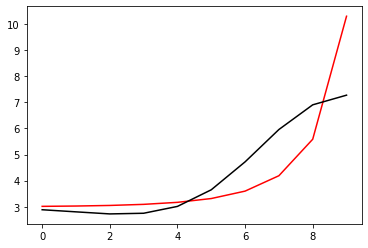

338800 0.024485696637853806
[3.04865149 2.95372112 2.8614361  2.87475068 3.12567608 3.75064641
 4.80808295 6.04068171 6.98353411 6.94720991]


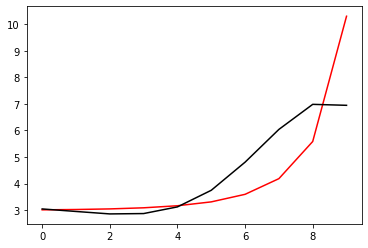

339900 0.010690055795337657
[3.04557366 2.96648157 2.89099014 2.92309901 3.19591173 3.84914354
 4.94776124 6.24646431 7.26446641 7.28392552]


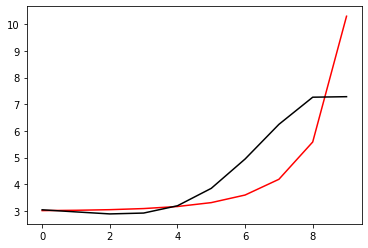

341000 0.07760001834896678
[3.1559493  3.02194593 2.89445151 2.87649094 3.09792261 3.69278132
 4.71831025 5.93143246 6.86290887 6.8765309 ]


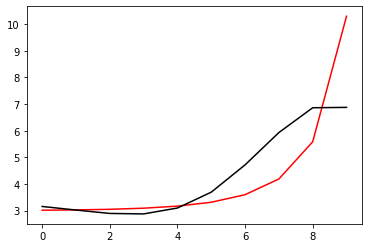

342100 0.010600839119783491
[3.09088676 2.96690969 2.8483085  2.83956398 3.07058695 3.6764995
 4.71796023 5.96089955 6.93361406 6.9339385 ]


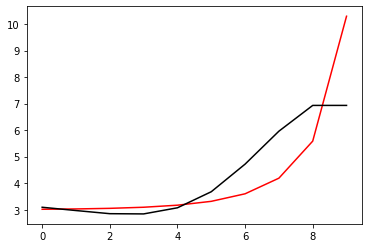

343200 0.012563182967915773
[3.03362785 2.92388429 2.82062177 2.8311249  3.0873684  3.72926137
 4.82675773 6.16016185 7.24139961 7.19099992]


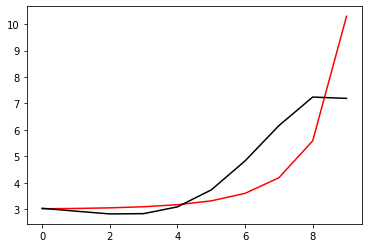

344300 0.010905002181871268
[3.04633083 2.89220057 2.7415393  2.70001776 2.89310745 3.44645834
 4.40117348 5.50789029 6.37561457 6.37339208]


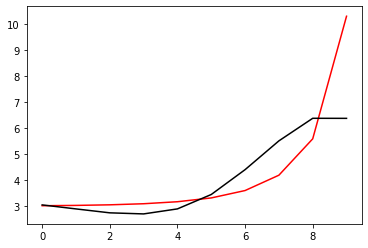

345400 0.009748829905424848
[3.10226628 2.94657276 2.79405077 2.75228073 2.94736957 3.50637811
 4.47379984 5.60707923 6.50898781 6.46477173]


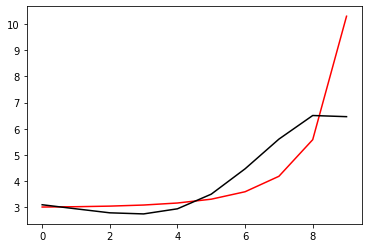

346500 0.008100473999227266
[3.07566622 2.93150929 2.78879957 2.75821773 2.96764165 3.54784454
 4.55142073 5.74961331 6.73238986 6.73749264]


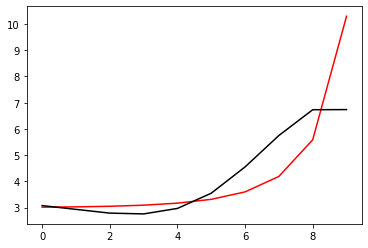

347600 0.6563014569107737
[3.33102669 3.19431699 3.05707206 3.03296976 3.25144377 3.84424678
 4.8592242  6.04053802 6.97252725 7.10852564]


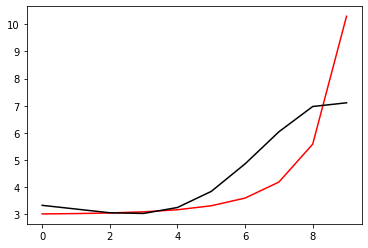

348700 0.010696440902904865
[3.12560736 2.9874551  2.84630998 2.81658037 3.02657858 3.60629653
 4.60472537 5.78707984 6.77289914 6.7661233 ]


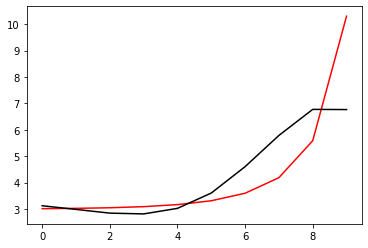

349800 0.02777036313913468
[3.14974252 3.02295114 2.89496885 2.88355003 3.12092343 3.74393889
 4.81276419 6.09939937 7.17873635 7.10946625]


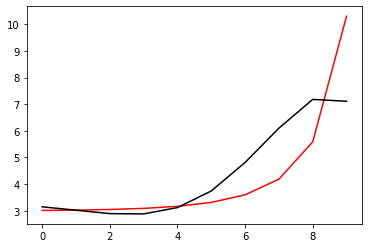

350900 0.010617162658657399
[3.0622914  2.96436718 2.8609574  2.86803938 3.11501395 3.73219988
 4.76114887 5.90784018 6.78834439 6.78053567]


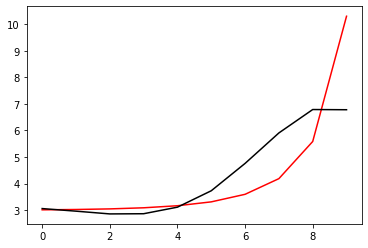

352000 0.060175485098426955
[3.04970377 2.96246784 2.87111979 2.89205633 3.15793016 3.80769787
 4.91180617 6.23675554 7.15026811 7.1504171 ]


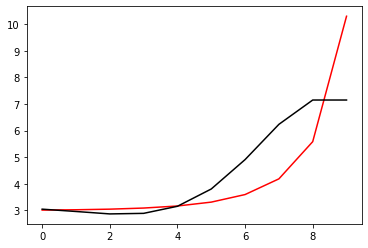

353100 0.010487693676294627
[2.99404687 2.86277068 2.72668506 2.69994378 2.91137172 3.4912551
 4.49410734 5.63344242 6.38222208 6.42389441]


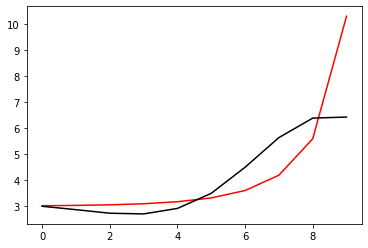

354200 0.02685132898155973
[3.14731771 3.00803428 2.86287765 2.82637171 3.02671854 3.59267501
 4.57653392 5.69471897 6.42038829 6.42090892]


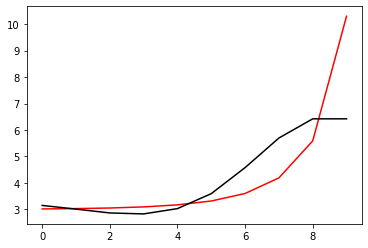

355300 0.011338131106059591
[3.07477031 2.94515297 2.81151318 2.79055503 3.01357132 3.61568627
 4.66141971 5.88607151 6.74044713 6.68763679]


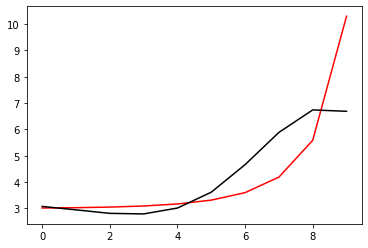

356400 0.0025854580959766586
[3.02302733 2.90674758 2.78804262 2.78584774 3.03506144 3.67800167
 4.79234983 6.13141871 7.1057374  7.06941896]


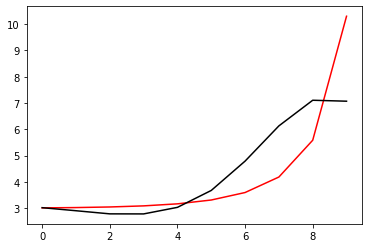

357500 0.0011640106777640606
[3.06757127 2.89989861 2.72766003 2.66839483 2.85154171 3.40597265
 4.37714157 5.46590388 6.23262085 6.22449037]


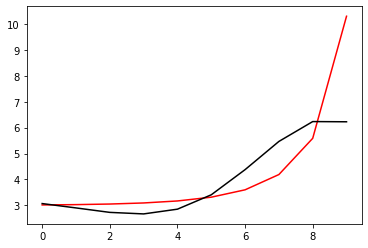

358600 0.0018705805289746993
[3.17045054 3.0004495  2.82526225 2.7644639  2.94839984 3.50734579
 4.4897621  5.60482392 6.40731495 6.37531775]


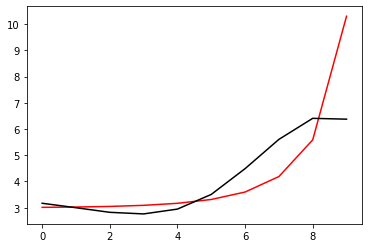

359700 0.010676951831955645
[3.15634218 3.0036209  2.84397753 2.7997676  3.00356298 3.58971996
 4.61470966 5.8034684  6.69723069 6.66111089]


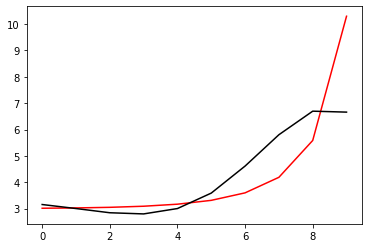

360800 0.030224466608137893
[3.14325598 2.97106715 2.79089974 2.72700849 2.91273234 3.4813834
 4.48336912 5.63584463 6.51275992 6.5843005 ]


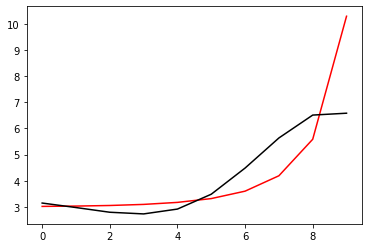

361900 0.010787023700199141
[3.17331878 3.01809612 2.85289541 2.80353625 3.00431192 3.59009115
 4.61456733 5.80335933 6.72034297 6.71837952]


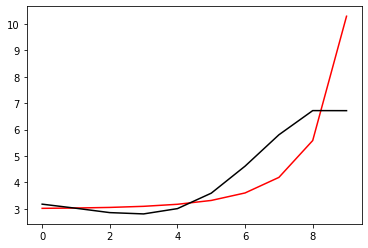

363000 0.06062895329456173
[3.09771805 2.96015664 2.813212   2.78534801 3.0147048  3.64243886
 4.73274109 6.0254441  7.05495356 7.05375569]


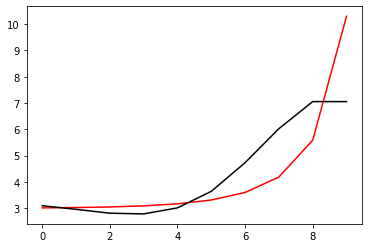

364100 0.010520130244138882
[3.03323899 2.86514938 2.69053345 2.63833033 2.84648193 3.45267177
 4.5092708  5.746927   6.73315529 6.7322446 ]


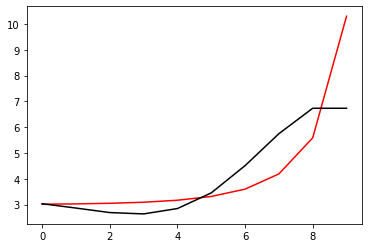

365200 0.02457956690957374
[3.19887494 3.01913155 2.83097126 2.76484491 2.95868424 3.54926776
 4.58849232 5.81204406 6.78638444 6.7298217 ]


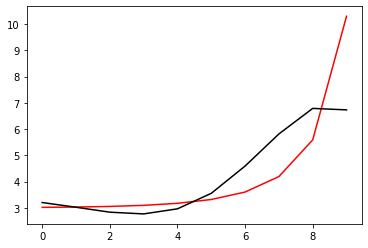

366300 0.011502171298162457
[3.12584039 2.95992744 2.7860461  2.73735043 2.95473251 3.58037121
 4.67644978 5.99384183 7.07986791 7.08380283]


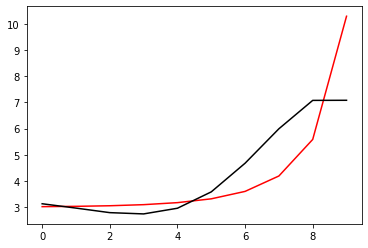

367400 0.0021950118841718054
[3.0647892  2.91798395 2.76327039 2.73664426 2.98306113 3.65152614
 4.81645584 6.24422827 7.44656149 7.40287639]


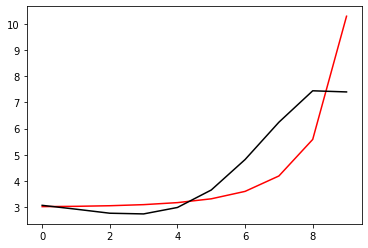

368500 0.009268661556279263
[3.14050917 2.95362209 2.7577848  2.69062277 2.89639414 3.5192286
 4.61946381 5.94846586 7.08378033 7.07781066]


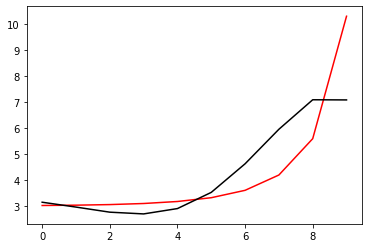

369600 0.010387034766364754
[3.07058681 2.89830151 2.71667665 2.66588837 2.89288301 3.54635002
 4.69540147 6.1038954  7.32641909 7.32604262]


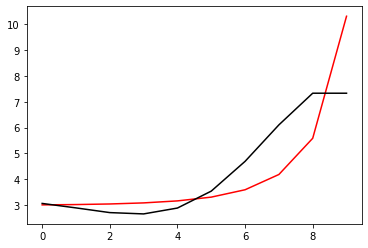

370700 0.1097604746137964
[2.99950233 2.81407129 2.61873938 2.55501012 2.77060032 3.41215936
 4.53982182 5.90931966 7.10688042 7.50746413]


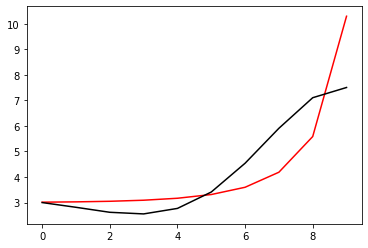

371800 0.027970942183126873
[3.19241781 2.9966348  2.78971019 2.71473654 2.91950978 3.55010131
 4.6667633  6.02959617 7.22299604 7.20287539]


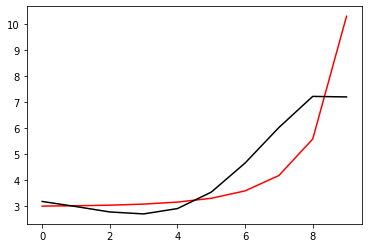

372900 0.010851687947267557
[3.17662981 3.00004157 2.80931626 2.75002576 2.9721214  3.62473636
 4.77414168 6.19136576 7.45213016 7.46185472]


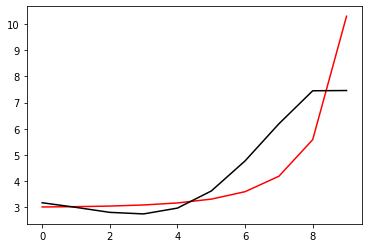

374000 0.06136377884248039
[3.2639008  3.03601604 2.7945286  2.68579899 2.85855063 3.45716869
 4.54061431 5.88106335 7.0677379  7.08118518]


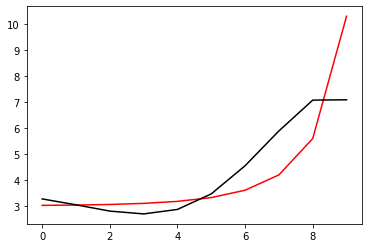

375100 0.010839889122999272
[3.22582541 3.01045275 2.77901276 2.67998133 2.86338727 3.47579409
 4.58105771 5.9612559  7.20231802 7.20257703]


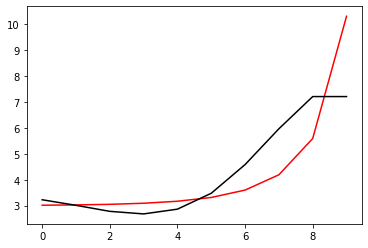

376200 0.015221570156712973
[3.17221832 2.9752837  2.76105055 2.68139543 2.89011439 3.54004938
 4.70678631 6.18880945 7.55369182 7.46042453]


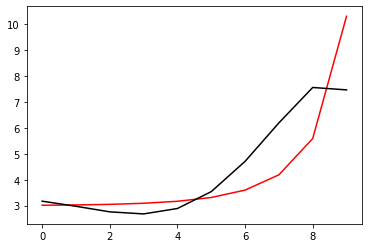

377300 0.011122338184410007
[3.13852928 2.96197346 2.76595464 2.70558828 2.93955249 3.62809774
 4.86025227 6.45130083 7.93492409 7.98733675]


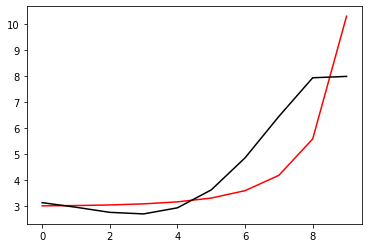

378400 0.004671684434760176
[3.17864072 2.96785746 2.73633567 2.63992109 2.83619489 3.47973405
 4.64343367 6.12215415 7.52272704 7.47693359]


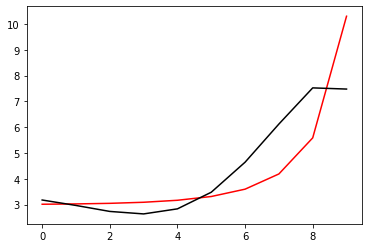

379500 0.001212017400065069
[3.10374926 2.91041066 2.69468092 2.61467889 2.83097579 3.50276234
 4.71144958 6.26436023 7.75462459 7.73943989]


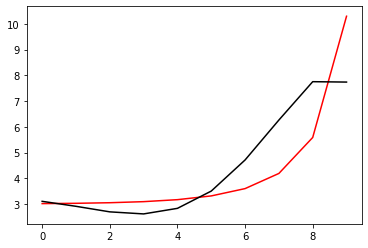

380600 0.6629359732586269
[3.37498707 3.19100021 2.98128969 2.90452845 3.12291911 3.79436291
 4.99051009 6.50030456 7.94314455 8.07657057]


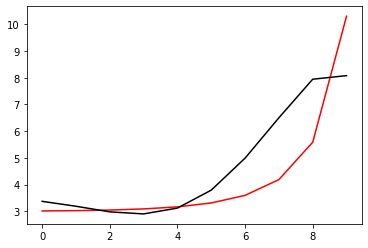

381700 0.01095970567567464
[3.18058729 2.99079517 2.77294568 2.68618062 2.89318056 3.55227326
 4.73993122 6.26814548 7.77455113 7.72618459]


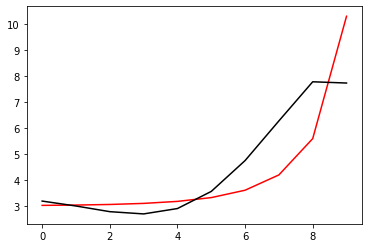

382800 0.02695267210408825
[3.2134681  3.03396333 2.82648253 2.75067962 2.97186415 3.65230831
 4.87593328 6.46530827 8.0352882  7.93788105]


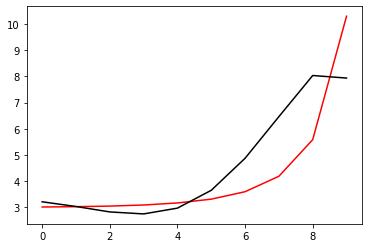

383900 0.002985322570220202
[3.06456372 2.89588251 2.69479378 2.61786506 2.82476389 3.46475432
 4.58383319 5.78532647 7.04277334 7.02895387]


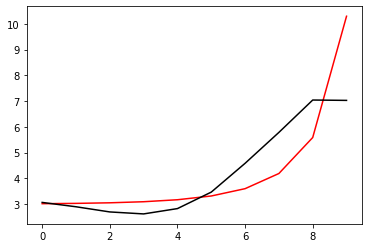

385000 0.06064966361008559
[3.11394782 2.94107289 2.73662854 2.65698743 2.86225995 3.50235602
 4.62470875 5.84001406 7.10987883 7.10540592]


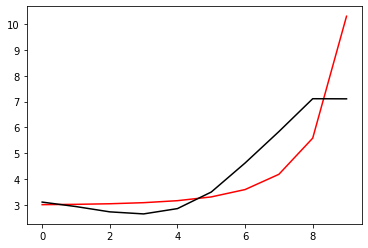

386100 0.010768629018833405
[3.16002178 2.99574893 2.79929905 2.72716725 2.94096587 3.59303442
 4.73509341 5.98981423 7.29165768 7.29148263]


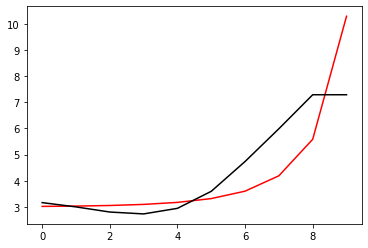

387200 0.012305933823900788
[3.09118869 2.94493428 2.76725844 2.71447397 2.951763   3.63837921
 4.83955899 6.20486532 7.61674629 7.55641948]


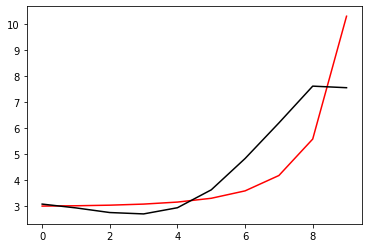

388300 0.0109047602264066
[3.08611149 2.908471   2.70025742 2.61512561 2.81474054 3.45033527
 4.57118075 5.81522854 7.06882137 7.06402103]


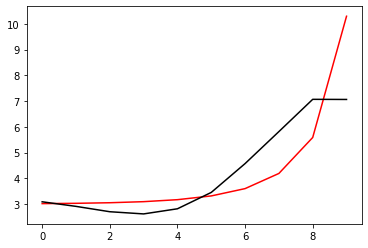

389400 0.006532359791988752
[3.16688045 2.98141905 2.76674494 2.6772014  2.87566215 3.51561979
 4.65115283 5.93231846 7.22170395 7.2093747 ]


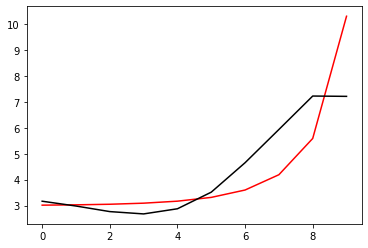

390500 0.005895822939345669
[3.11832637 2.94472065 2.74173043 2.66448259 2.87815229 3.54132751
 4.71939628 6.08700312 7.46452259 7.46634187]


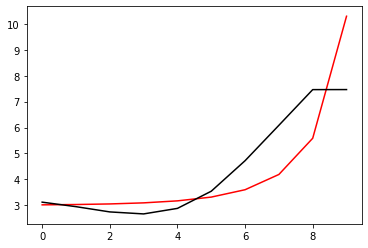

391600 0.10651626025896704
[3.24412722 3.07345582 2.87370612 2.79984626 3.01911443 3.69353539
 4.89405924 6.31058139 7.71720064 7.78075267]


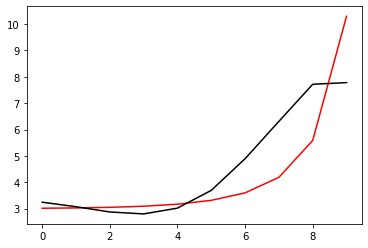

392700 0.01093904049505906
[3.15422852 2.98905994 2.79146993 2.7147556  2.92350984 3.57425858
 4.72740369 6.06306946 7.33766527 7.32899409]


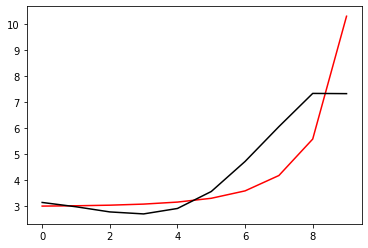

393800 0.019265149266588462
[3.15499541 3.00844201 2.8301357  2.77388362 3.008075   3.69823949
 4.92587432 6.40091405 7.74902982 7.65237577]


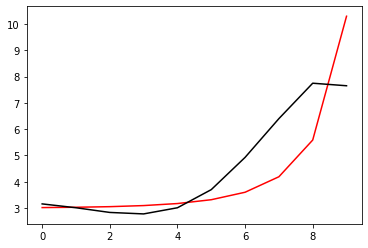

394900 0.004535382969462434
[3.08240094 2.91348241 2.71271658 2.63088133 2.83389897 3.48231836
 4.64946764 6.04500305 7.2874426  7.329926  ]


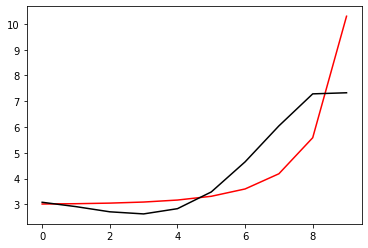

396000 0.060475193992623785
[3.09002348 2.92731026 2.73174968 2.65422829 2.86131139 3.51489514
 4.69125586 6.11002141 7.3824618  7.38281356]


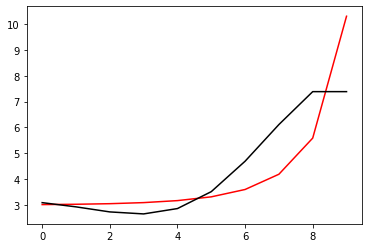

397100 0.010828231774799982
[3.15368924 3.0056286  2.8236255  2.75831872 2.97759461 3.64600456
 4.84475355 6.30659908 7.62362723 7.62284767]


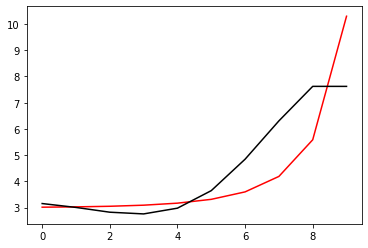

398200 0.00822243232946503
[3.10437875 2.97057648 2.80420267 2.75482718 2.99284938 3.68879374
 4.93633685 6.49574006 7.92706435 7.82343293]


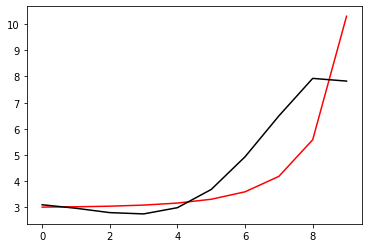

399300 0.010911879491257692
[2.99489974 2.89055345 2.75585805 2.73540775 3.00118049 3.72932211
 5.0261388  6.68321467 8.22334377 8.22949414]


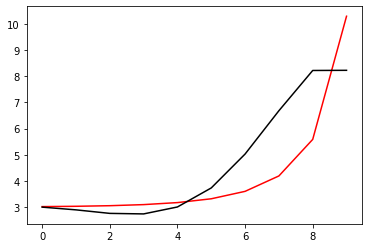

400400 0.006491270796857362
[3.11516537 2.97670565 2.80291574 2.73239206 2.92785244 3.54467982
 4.64058872 5.90623755 6.96394797 6.97031894]


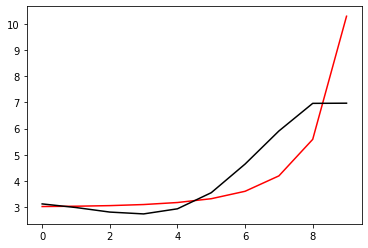

401500 0.010296844550902936
[3.10552552 2.97295478 2.80553818 2.74187567 2.94575129 3.57563227
 4.69688536 6.01516539 7.11785048 7.10604539]


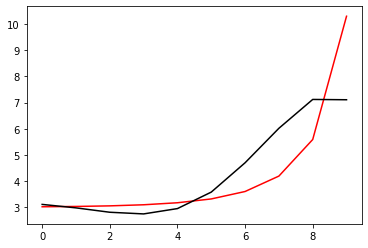

402600 0.0009517160260030118
[3.08883677 2.96594385 2.80923753 2.75700828 2.97467601 3.62555895
 4.78677118 6.18503156 7.35272793 7.33284869]


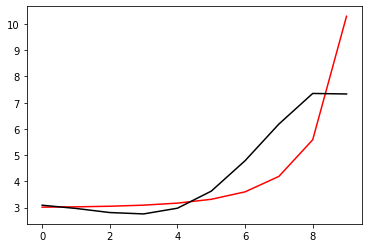

403700 0.25610842069358347
[2.84965763 2.72643563 2.57190997 2.52189541 2.74101035 3.39351012
 4.5629134  6.00413518 7.24381206 7.54351307]


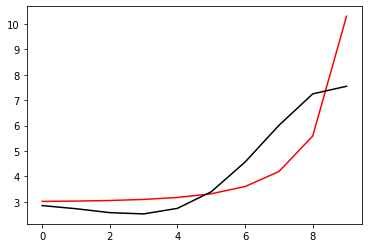

404800 0.027734885734644495
[3.05537155 2.96377543 2.83605827 2.80578859 3.03496817 3.68101565
 4.80004768 6.01839632 6.97507181 6.94034795]


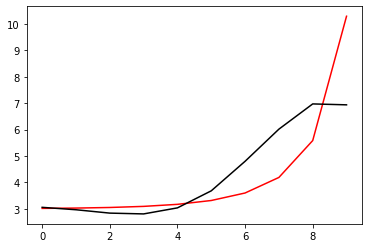

405900 0.01070356231483748
[3.05314513 2.96862549 2.85040065 2.83083183 3.07377114 3.74329126
 4.91828566 6.2745621  7.22260941 7.22802463]


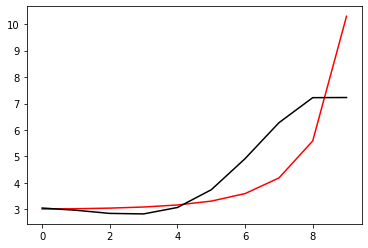

407000 0.05437614049672489
[3.05949583 2.98945326 2.89032464 2.8924323  3.16307101 3.87831743
 5.15231181 6.69918784 7.63846763 7.60326346]


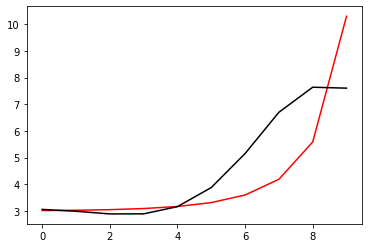

408100 0.010737020669203923
[3.08719427 2.98781401 2.86161989 2.83453333 3.06990485 3.73760849
 4.94123134 6.3820676  7.26952305 7.26778812]


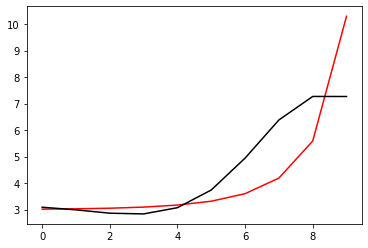

409200 0.010559164808806342
[2.98744447 2.89746618 2.78637571 2.7796121  3.04298044 3.75446547
 5.03237219 6.59968724 7.61925119 7.57035248]


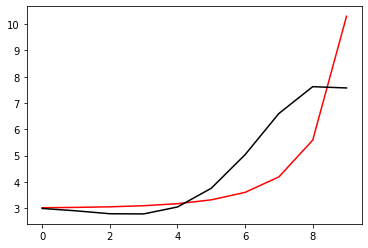

410300 0.011944365157758348
[3.08103783 2.97437087 2.84488508 2.81413497 3.04124527 3.69063688
 4.85035899 6.20487861 6.95404948 6.94135517]


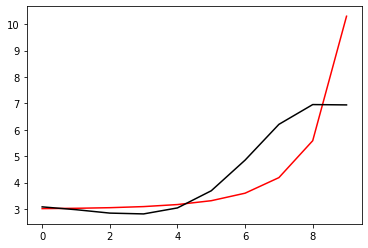

411400 0.0047059752186632995
[3.05923439 2.9570878  2.83231692 2.80657327 3.0395976  3.69791055
 4.87474341 6.26544838 7.04968706 7.03527422]


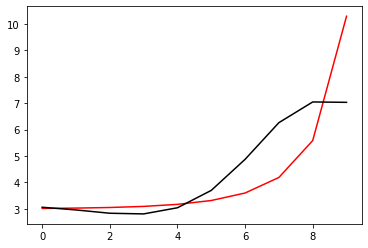

412500 0.009742262557628407
[3.03206239 2.93633732 2.81842355 2.79986619 3.04116349 3.71170933
 4.91179514 6.35240462 7.18546025 7.18746939]


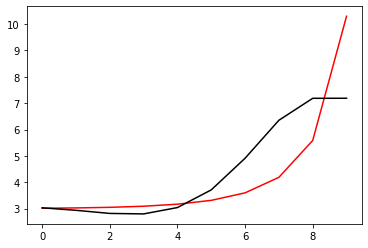

413600 0.0007930407001783904
[3.01364366 2.9302756  2.82612461 2.82236619 3.08113845 3.77737926
 5.02364673 6.54978493 7.44960437 7.38939484]


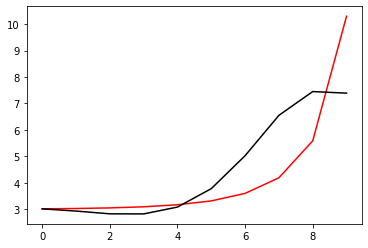

414700 0.6253029994537662
[3.25961637 3.16723052 3.05491963 3.04141178 3.28731994 3.96439489
 5.16960299 6.57422948 7.31425591 7.53290182]


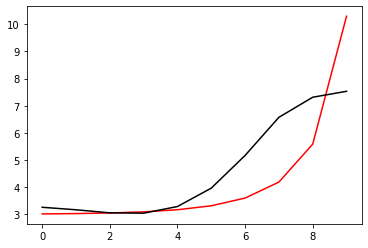

415800 0.022582951458691932
[3.06448548 2.9656665  2.84761523 2.82802937 3.06570832 3.73078587
 4.92104244 6.33363717 7.14158165 7.08376331]


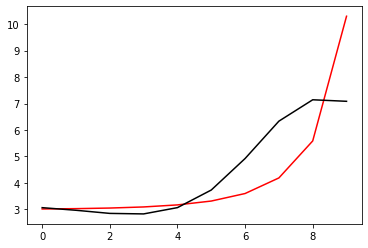

416900 0.010849377120050656
[3.06071729 2.97433724 2.87218475 2.8722208  3.1348501  3.8357701
 5.08237086 6.58710356 7.49063349 7.51236461]


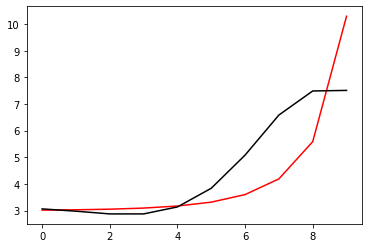

418000 0.11230932504769703
[2.9199198  2.81527424 2.69280934 2.66700349 2.89200131 3.53236884
 4.67742998 6.0326316  6.76500839 6.7617283 ]


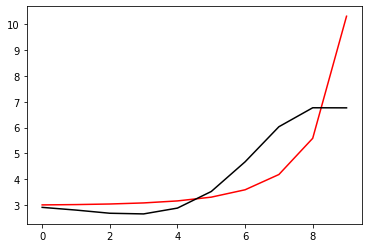

419100 0.010626726968562303
[3.00027345 2.88894259 2.76076693 2.73012196 2.95061129 3.58630053
 4.72596121 6.07791331 6.81016672 6.81064796]


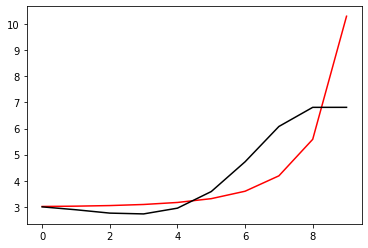

420200 0.01410745595802046
[3.0092438  2.90460939 2.78311172 2.75956578 2.98801889 3.63432557
 4.79107919 6.17646269 6.95538858 6.92048246]


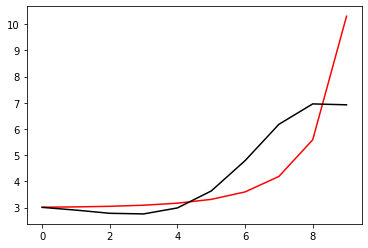

421300 0.010768689336846937
[3.00753441 2.91638129 2.80932829 2.80134056 3.0474152  3.71690331
 4.90970905 6.36012271 7.22375209 7.25629677]


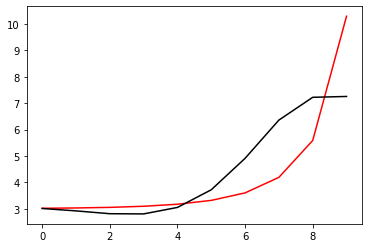

422400 0.004969883553507063
[3.0593969  2.94498995 2.81247446 2.77513585 2.98358755 3.59818577
 4.70110583 6.01391975 6.76365092 6.70394085]


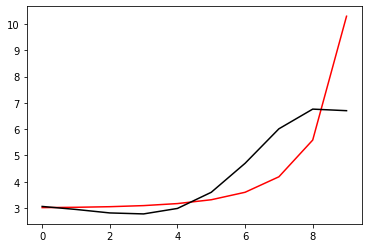

423500 0.004254151803850243
[3.01738861 2.91088823 2.78922045 2.76682201 2.99616037 3.64294357
 4.80050639 6.20769418 7.06709633 7.05913099]


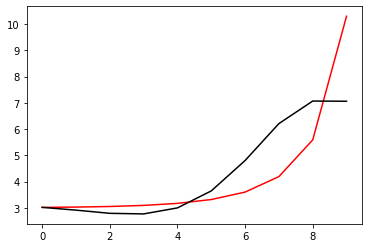

424600 0.0007471941167424011
[3.03638716 2.94246147 2.83733692 2.83517115 3.08884379 3.76729791
 4.97151989 6.45644963 7.40202424 7.39951607]


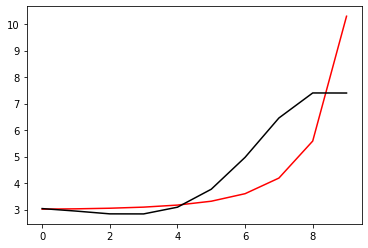

425700 0.010799731602176621
[3.00514202 2.93174955 2.84560869 2.85865485 3.12014966 3.79116201
 4.94614285 6.25603224 6.99902085 6.99437324]


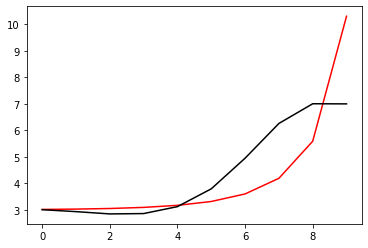

426800 0.01801941985280254
[2.99916608 2.93509884 2.8601618  2.886284   3.16524496 3.86644991
 5.09433853 6.57901609 7.30164182 7.19869997]


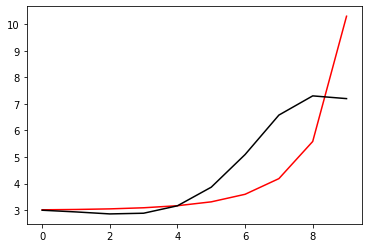

427900 0.010645242440334053
[3.07366868 2.98179562 2.87768316 2.8699834  3.10534607 3.74195238
 4.86012248 6.13130253 6.69010613 6.81313982]


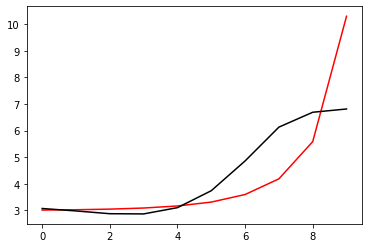

429000 0.06045039037173139
[3.04723858 2.96129709 2.86486493 2.86689081 3.11479614 3.76979777
 4.91909044 6.24854792 6.87290568 6.87373095]


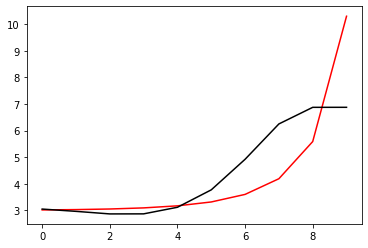

430100 0.010731938744611048
[3.02076143 2.94900909 2.87089713 2.89573027 3.17288465 3.86971253
 5.08496444 6.51871133 7.23914782 7.27461434]


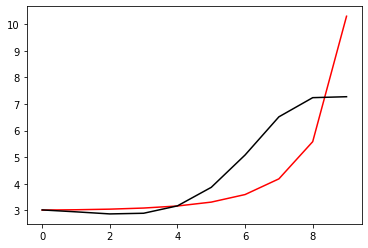

431200 0.01382573726739368
[2.98372451 2.87900859 2.77239738 2.77129677 3.02200049 3.68701343
 4.85633185 6.22065682 6.83942279 6.83608646]


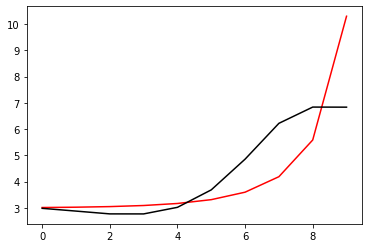

432300 0.010854314520596962
[3.02197153 2.92268531 2.82152433 2.82683386 3.08565646 3.76235876
 4.95040611 6.34736536 7.00610585 6.99712276]


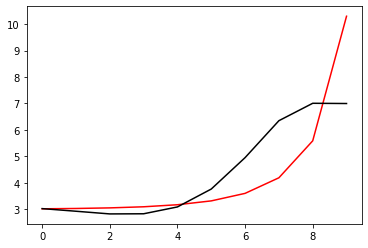

433400 0.0017880458258378606
[2.99549057 2.90695069 2.8166085  2.83384232 3.10679618 3.80290566
 5.02214208 6.47614115 7.20996057 7.19382891]


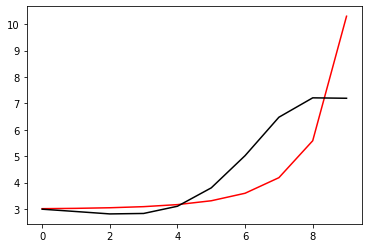

434500 0.03782498218040221
[2.88378049 2.80983868 2.73622957 2.77301469 3.07033653 3.80129449
 5.07834983 6.63777495 7.50517791 7.4761253 ]


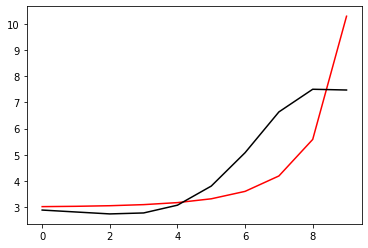

435600 0.0009964891229595815
[3.04684771 2.92686413 2.80691372 2.79683829 3.04294678 3.70980054
 4.89303504 6.31624308 7.06318134 7.0545261 ]


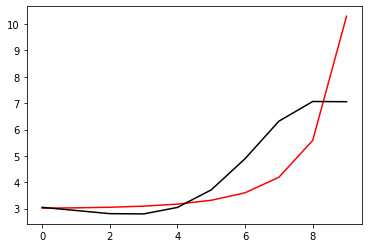

436700 0.010824425456145507
[3.03017625 2.92458827 2.81924148 2.82584487 3.09167158 3.78411623
 5.00486206 6.49103322 7.32072417 7.33111871]


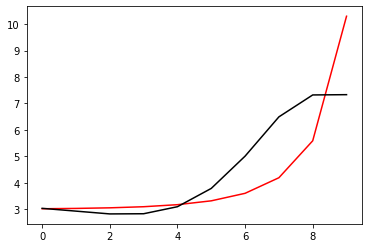

437800 0.04491794008460154
[2.97895883 2.84501604 2.71294914 2.69463552 2.93525644 3.59770422
 4.77450681 6.20191729 7.00344888 7.08115968]


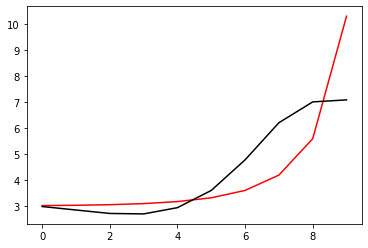

438900 0.010760725709541407
[3.10044839 2.96129089 2.82303781 2.7993623  3.03514213 3.69291084
 4.86598095 6.29765353 7.11489242 7.11315117]


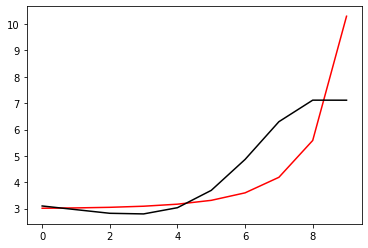

440000 0.059811971962420156
[3.10727371 2.98881605 2.86997065 2.86696713 3.12588685 3.81197748
 5.024329   6.51832222 7.41607261 7.39574109]


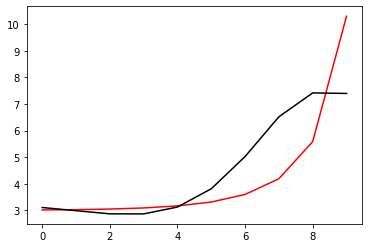

441100 0.010726731993871575
[3.11832916 2.95709545 2.79488469 2.74864491 2.96164988 3.59234276
 4.72758938 6.12008784 6.9454654  6.94463504]


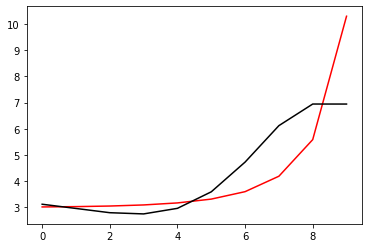

442200 0.013474257020900514
[3.09720209 2.95023412 2.80155784 2.77102145 3.0036493  3.66116599
 4.83666323 6.29268736 7.19949437 7.13010678]


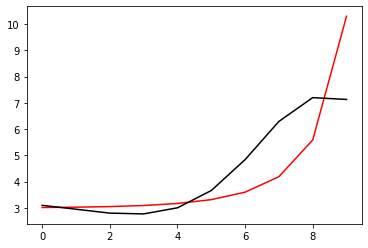

443300 0.010831999429041774
[3.02914735 2.90691863 2.78183951 2.77638764 3.03774703 3.73165066
 4.95934905 6.49698841 7.50477739 7.53762367]


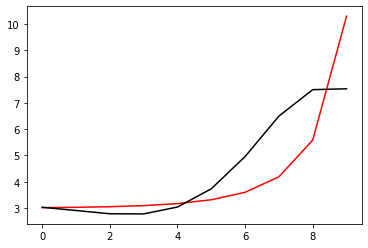

444400 0.009666019744379327
[3.06358382 2.89824453 2.73036724 2.68255796 2.89906179 3.53826588
 4.68752866 6.1164374  7.03414474 7.02184313]


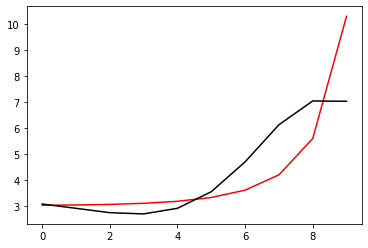

445500 0.005935167446970419
[3.07637982 2.92217264 2.76250004 2.72242775 2.94718536 3.59658005
 4.76160173 6.22072154 7.18599521 7.18559372]


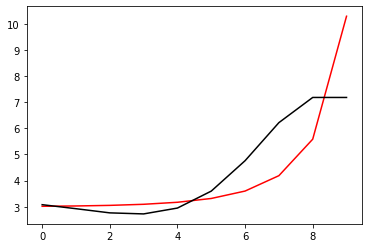

446600 0.7073675312471298
[3.36066913 3.21483198 3.05995211 3.02249692 3.24738961 3.89085013
 5.03101122 6.41680512 7.28923861 7.43713818]


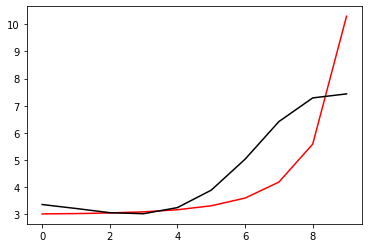

447700 0.02942227745432192
[3.08812886 2.90933056 2.71849726 2.64144498 2.81941646 3.40107886
 4.45542968 5.74906755 6.60816551 6.60230223]


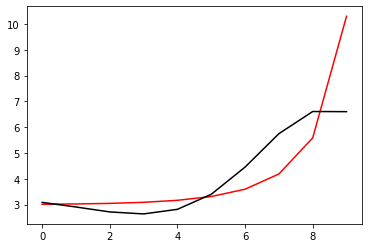

448800 0.02872924990543857
[3.19050405 3.01447729 2.82510021 2.74985834 2.93052685 3.51641555
 4.57886554 5.89089235 6.77641599 6.76973782]


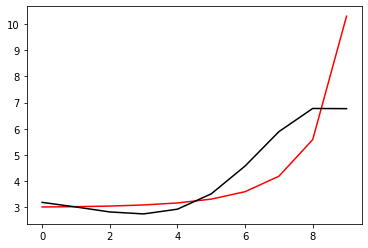

449900 0.010869458920370856
[3.13260461 2.96815031 2.79036111 2.72992291 2.93194378 3.5517867
 4.67320887 6.08628756 7.0967715  7.09834277]


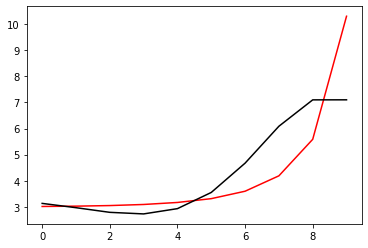

451000 0.060736392164329335
[3.16549242 2.96340902 2.74849956 2.65340277 2.82326804 3.41088564
 4.49184536 5.83944696 6.78609279 6.78198791]


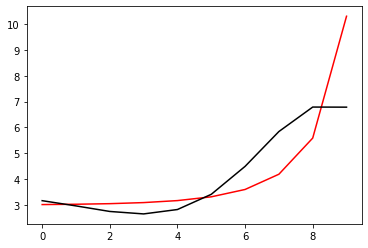

452100 0.010762308837685235
[3.15820716 2.96611471 2.75868314 2.67085968 2.84894617 3.4473872
 4.54555838 5.92435274 6.91557607 6.91655577]


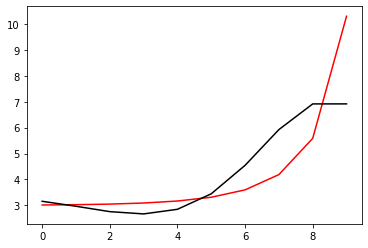

453200 0.0171288209073314
[3.14177861 2.97309546 2.78684076 2.72079615 2.92391648 3.55462105
 4.69979504 6.15119125 7.23173646 7.13793177]


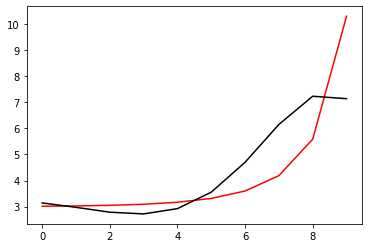

454300 0.010911852912437119
[3.10325373 2.91117424 2.70001636 2.60897998 2.78671156 3.38937185
 4.50228592 5.92771753 7.0087501  7.00697695]


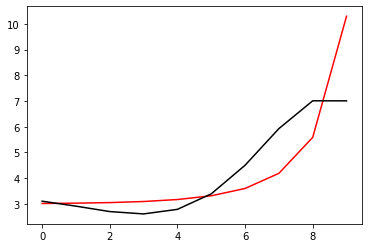

455400 0.010664352070506089
[3.09834878 2.92069598 2.72059434 2.63938487 2.82741321 3.44328669
 4.57952235 6.05722061 7.2264544  7.18025583]


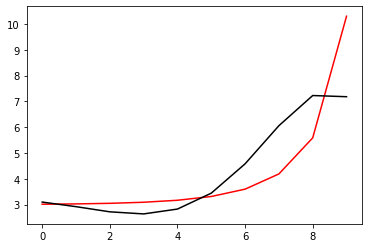

456500 0.05138560178247233
[2.99010246 2.83549868 2.65843398 2.60309747 2.8260255  3.49623912
 4.72674351 6.36449545 7.72662117 7.67877456]


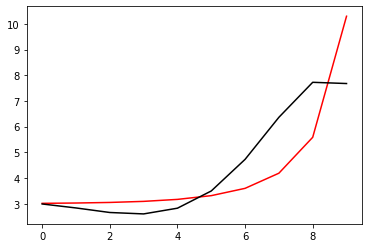

457600 0.010788433259953198
[3.09460456 2.91193688 2.70310606 2.61174959 2.79104902 3.40015674
 4.52731197 5.98306832 7.19298505 7.19290519]


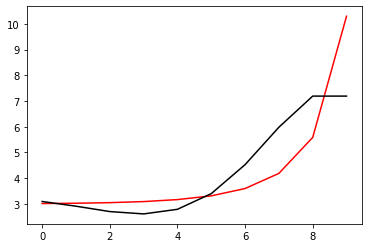

458700 0.010839714089128078
[3.16459226 3.0016686  2.80837912 2.72904529 2.91818751 3.53636249
 4.67586255 6.15849125 7.40959932 7.40816626]


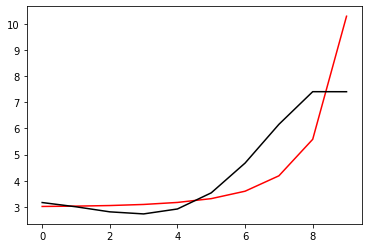

459800 0.02088322044664595
[3.07454853 2.96725224 2.82706393 2.79480815 3.02720379 3.68855936
 4.87941634 6.43740406 7.78007019 7.67329875]


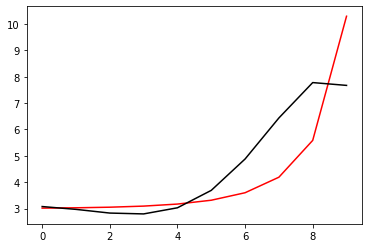

460900 0.010814913750101652
[3.14692353 3.02347722 2.8672911  2.81311344 3.01301076 3.61929704
 4.70303807 6.05864744 7.19069639 7.19099835]


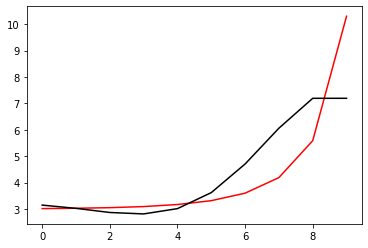

462000 0.06058705007641861
[3.10624665 2.99023745 2.84135494 2.79387978 3.00086361 3.6171997
 4.72218052 6.1248994  7.28819886 7.28932094]


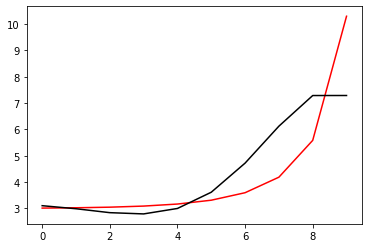

463100 0.010714768427217037
[3.08954054 2.98306609 2.84465446 2.80764953 3.02708046 3.66292171
 4.80824783 6.28485518 7.47756516 7.4765207 ]


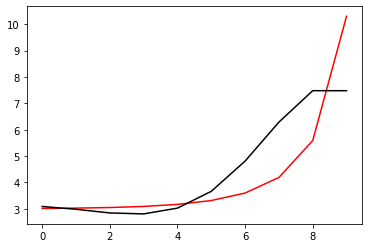

464200 0.010957600779810688
[2.98051587 2.89494438 2.78029545 2.76839349 3.01900249 3.70464041
 4.95043453 6.60271877 7.88341778 7.7978569 ]


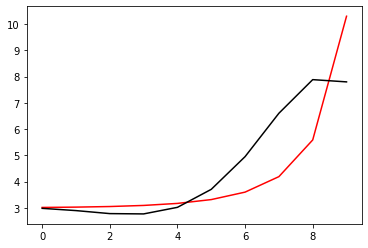

465300 0.010895991790457207
[3.0636617  2.95162727 2.81100765 2.77034815 2.9868108  3.62703298
 4.80022526 6.31096552 7.50726563 7.4936499 ]


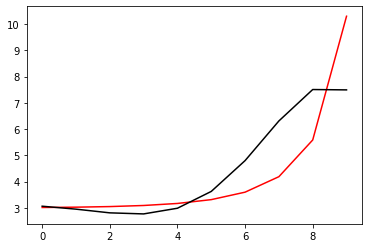

466400 0.0012367991735733439
[3.00805595 2.910013   2.78773925 2.76853029 3.01157603 3.68952656
 4.92255039 6.52836641 7.81935172 7.81244688]


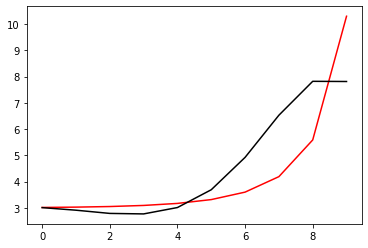

467500 0.008658889376408258
[3.10828607 2.96052176 2.78708479 2.71272741 2.89083585 3.48085803
 4.57324919 5.94713558 7.03652013 7.01532213]


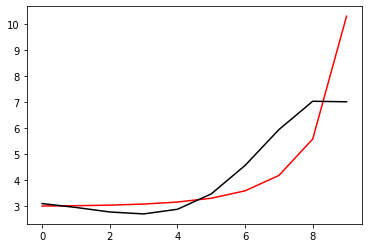

468600 0.0008980248589695035
[3.1178436  2.98223373 2.82116842 2.76016059 2.95360197 3.56369739
 4.68625327 6.1108869  7.26731135 7.23812871]


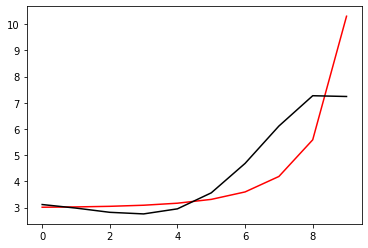

469700 0.011810540561476363
[3.07166991 2.94558011 2.79568098 2.74827915 2.95964265 3.59683144
 4.76519175 6.27167626 7.53450637 7.47463134]


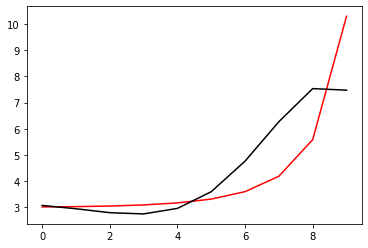

470800 0.029832234865187865
[3.10751975 2.95779552 2.78344848 2.70913945 2.88819489 3.47969195
 4.56283997 5.88965688 7.0471219  7.43367678]


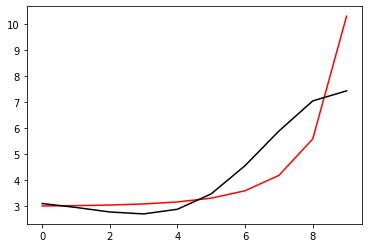

471900 0.010964665631002962
[3.09603298 2.9527365  2.78471    2.71731234 2.90435503 3.50655505
 4.60696855 5.96686161 7.16588191 7.1605629 ]


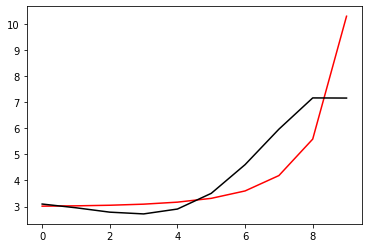

473000 0.060441332709231264
[3.12824252 3.00523035 2.85753544 2.81047253 3.0180012  3.64242335
 4.77086185 6.1756375  7.42309872 7.42618044]


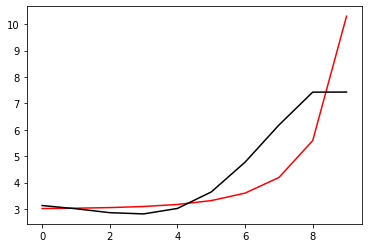

474100 0.010485038491974323
[3.05465941 2.88882668 2.69830651 2.60702523 2.76508583 3.32515017
 4.35003036 5.57851438 6.69925727 6.71609894]


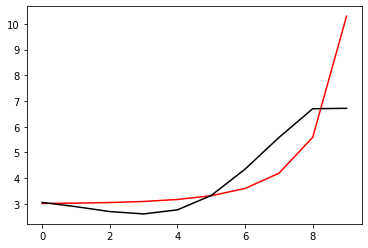

475200 0.02661878584795446
[3.22727345 3.05299395 2.85334826 2.7532037  2.9023979  3.45308618
 4.46803571 5.69047528 6.80437388 6.74123224]


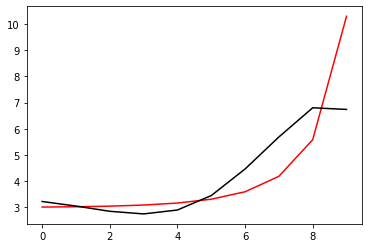

476300 0.011573384533610976
[3.13472149 2.97470499 2.79047823 2.7092849  2.88358273 3.47150418
 4.54793925 5.87480456 7.11569533 7.0797898 ]


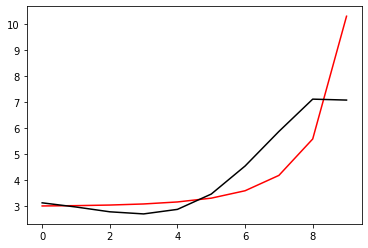

477400 0.003164664347919144
[3.09089272 2.94682859 2.77953773 2.71860328 2.91929658 3.54612811
 4.68687322 6.12167169 7.47613392 7.41856857]


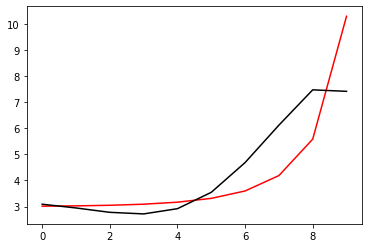

478500 0.010167603927087645
[3.07584851 2.95307667 2.8075559  2.76988576 2.99767783 3.66104607
 4.86006097 6.39342745 7.83751822 7.89003592]


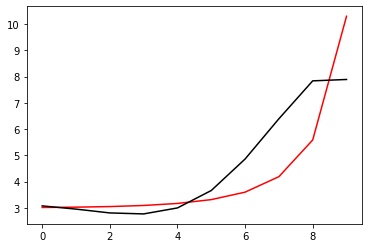

479600 0.0009311713766040798
[2.98829415 2.91529544 2.81671131 2.8197956  3.08021323 3.76372114
 4.95235611 6.34555695 7.54057871 7.47469649]


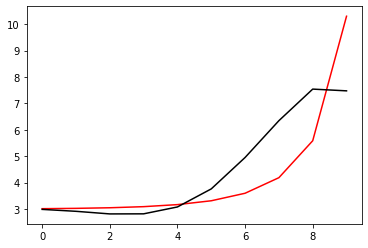

480700 0.49527377002022444
[2.70626461 2.62471857 2.52230359 2.52401623 2.78715661 3.483744
 4.72093661 6.23136098 7.35786092 7.79614109]


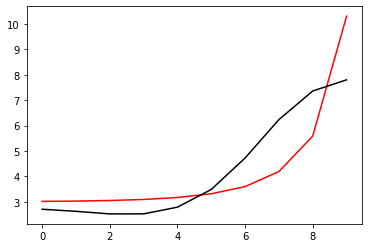

481800 0.021888999488687236
[3.04796648 2.97089728 2.86878639 2.86376724 3.10807235 3.76210193
 4.90537124 6.22207794 7.0806827  7.05510052]


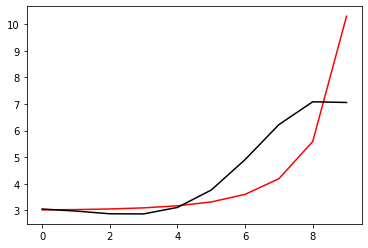

482900 0.010677674040354536
[3.03231902 2.95930571 2.86219147 2.86240821 3.11287749 3.77613583
 4.93785499 6.29690372 7.18749723 7.18408651]


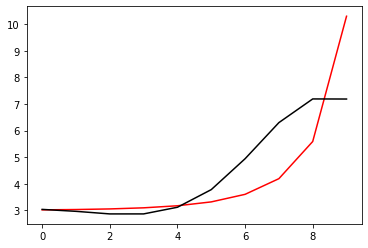

484000 0.06032928255339918
[3.01632188 2.9498609  2.86103217 2.8699727  3.13071239 3.80928672
 5.00102638 6.42551838 7.36216057 7.35592967]


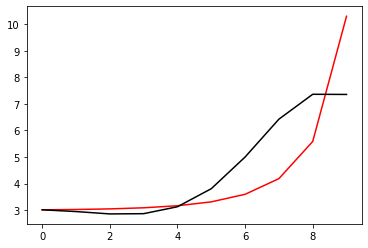

485100 0.010880325342875807
[3.01184419 2.95863504 2.88677044 2.91425737 3.19756429 3.91000868
 5.16451103 6.70425027 7.70527231 7.71415896]


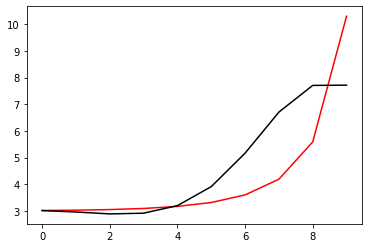

486200 0.016629120875402865
[2.96037553 2.86304062 2.7486844  2.73088272 2.96054194 3.60001311
 4.73995002 6.08939447 6.92843559 6.92199484]


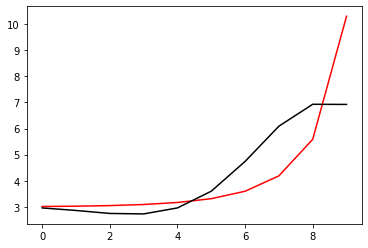

487300 0.011322747791374224
[3.06299618 2.96015374 2.84156024 2.82077149 3.04844313 3.68715629
 4.82853752 6.18842198 7.04580264 7.02547129]


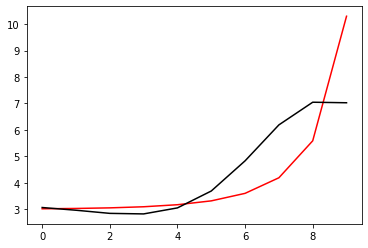

488400 0.002190171593022787
[3.01623676 2.92312905 2.81587587 2.80822097 3.05175389 3.71239075
 4.8887229  6.31289641 7.25681437 7.23257487]


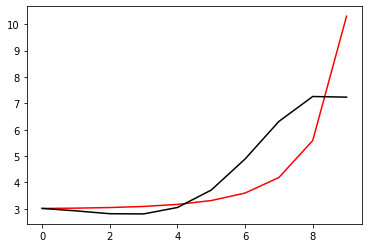

489500 0.028575140096847664
[2.90621206 2.82824937 2.740273   2.75533147 3.02643001 3.72480679
 4.96039577 6.48972631 7.56589639 7.5380768 ]


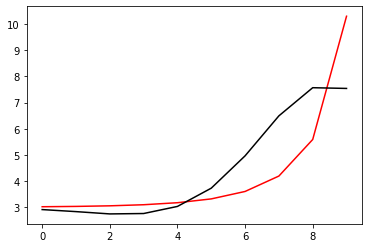

490600 0.0016303369875777546
[3.09935372 2.97042147 2.82828926 2.78334149 2.98125207 3.57660642
 4.64231454 5.88960493 6.71758835 6.69205416]


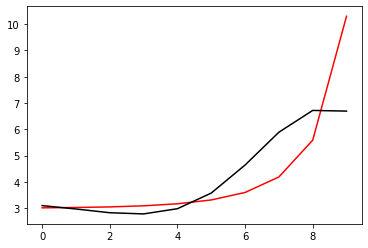

491700 0.010773595846065416
[3.09411738 2.97482523 2.84241473 2.80842454 3.01914556 3.63116711
 4.72154727 6.01075551 6.89298268 6.888741  ]


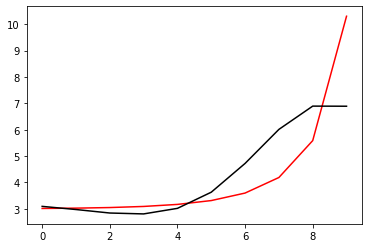

492800 0.020318818936830758
[3.11268312 3.01101917 2.8973202  2.88455274 3.12042467 3.76526329
 4.90296126 6.26620266 7.23445862 7.191517  ]


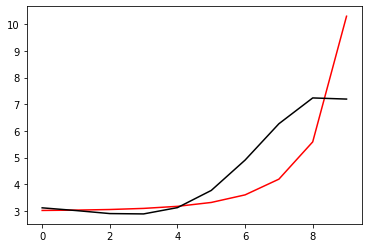

493900 0.0107834461305951
[3.09110109 2.97392775 2.84235075 2.8072482  3.01155428 3.60577688
 4.65374677 5.85864136 6.60958452 6.60459405]


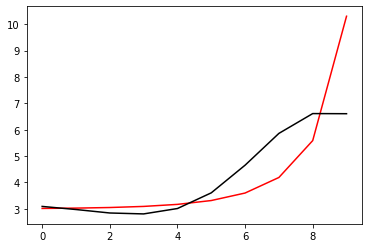

495000 0.06054454344637977
[3.08952447 2.97873295 2.85330213 2.8248338  3.03715992 3.64334628
 4.71398579 5.96504903 6.75321139 6.75503527]


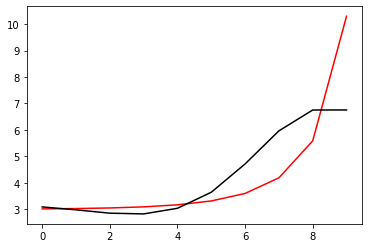

496100 0.010633312133164433
[3.07874877 2.97856443 2.86383245 2.8470021  3.073532   3.70102096
 4.81165716 6.14104778 6.99202632 6.99252334]


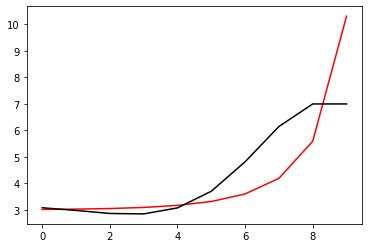

497200 0.011656410482212179
[2.9656575  2.88288957 2.78797202 2.79426825 3.05108429 3.72657771
 4.9294345  6.43300495 7.42934402 7.35027967]


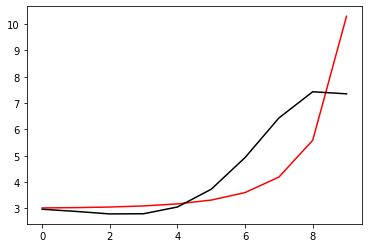

498300 0.011321203953671711
[3.0152828  2.95219511 2.87342474 2.88839361 3.14153076 3.7900452
 4.91044025 6.20109176 6.9203068  7.25752151]


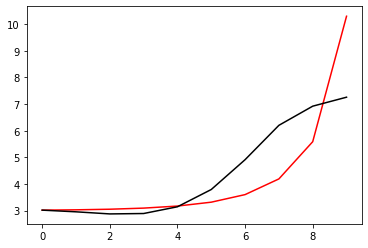

499400 0.0037945294217892095
[2.99655516 2.9384987  2.86542456 2.88605062 3.14525428 3.80206676
 4.93968278 6.27205401 7.00895081 6.98095774]


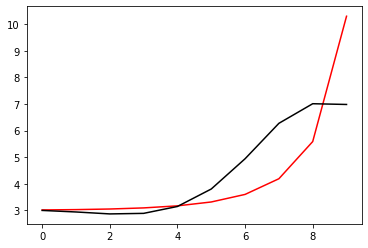

In [15]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

0 0.30018693274760017
[3.10862415 3.0534337  2.9839344  3.00848402 3.27252351 3.93685833
 5.08974546 6.44815955 7.18065844 7.08817588]


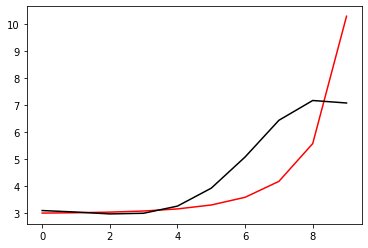

1100 0.010644924172907287
[2.94809273 2.89478508 2.8275003  2.85413475 3.12011584 3.78644989
 4.94211757 6.30703265 7.05161999 7.05134321]


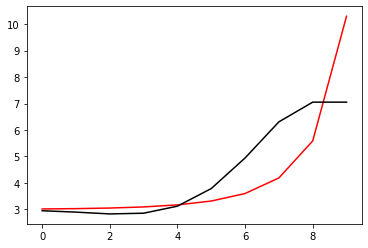

2200 0.007848103236380766
[2.97175208 2.92373359 2.86329477 2.897491   3.17227813 3.85016666
 5.02339499 6.42009122 7.21423995 7.14420707]


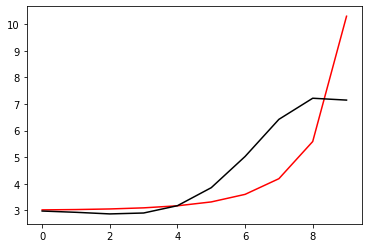

3300 0.010714928938622031
[2.92445577 2.88601878 2.83769402 2.88459321 3.17313637 3.86781896
 5.06564017 6.50791469 7.37309951 7.41045589]


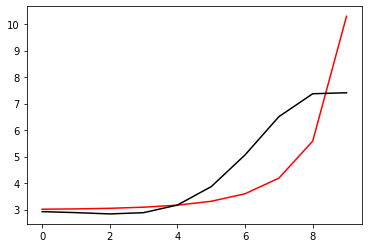

4400 0.004382882009299871
[3.01269524 2.92473316 2.82620336 2.81897749 3.04348085 3.65174785
 4.71812299 5.96883461 6.64951986 6.6218232 ]


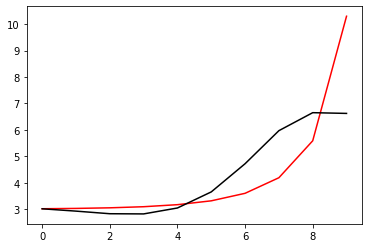

5500 0.01002599295470352
[3.01453178 2.93364081 2.84331486 2.84578276 3.08212894 3.70645007
 4.79746914 6.09032685 6.83005886 6.83054588]


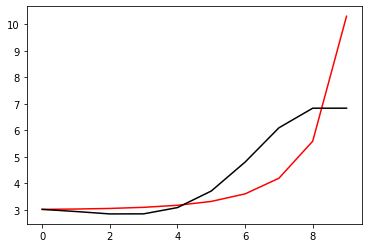

6600 0.0006785492891512217
[3.00156166 2.9319139  2.85490036 2.87278806 3.12734484 3.77540071
 4.90182646 6.25449528 7.07441464 7.02893332]


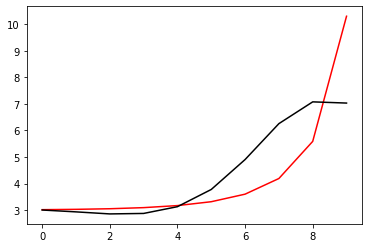

7700 0.5004312032998818
[2.68139814 2.60695683 2.5292095  2.54896293 2.80715388 3.46090391
 4.59795144 5.97907453 6.84670304 7.29184715]


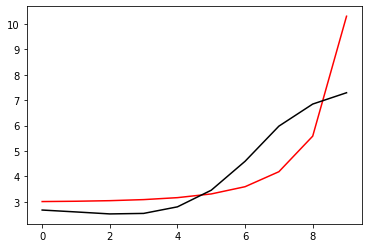

8800 0.028082967313518243
[3.01670282 2.94457568 2.86475971 2.87550112 3.11240488 3.72120665
 4.76507403 5.96671192 6.59128049 6.57735519]


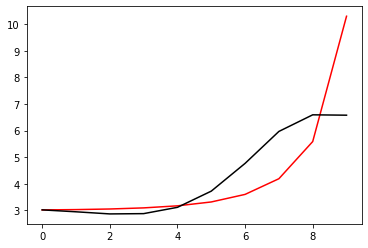

9900 0.01060701922231439
[3.01534913 2.94752518 2.87255708 2.88887077 3.13276974 3.75223044
 4.816268   6.05540943 6.70617889 6.70850201]


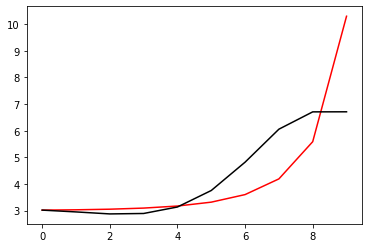

11000 0.060377590679217795
[3.01176304 2.95105496 2.88431184 2.91006778 3.16577074 3.80308497
 4.90039467 6.19973788 6.89274253 6.8813478 ]


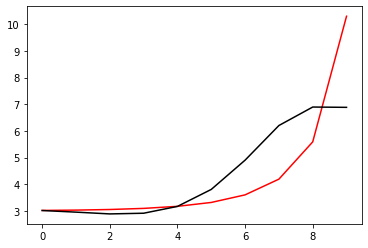

12100 0.010775558160154203
[3.00782569 2.96123193 2.91125484 2.95623314 3.23584836 3.9085402
 5.06811463 6.46835654 7.22389318 7.24204271]


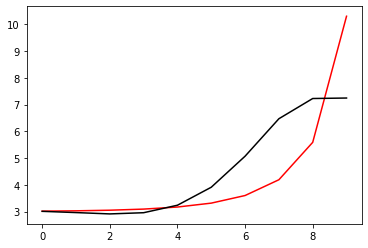

13200 0.014826023321938091
[2.969244   2.87789801 2.78690035 2.79264493 3.03177442 3.65768998
 4.75508047 6.06573761 6.7584006  6.74183819]


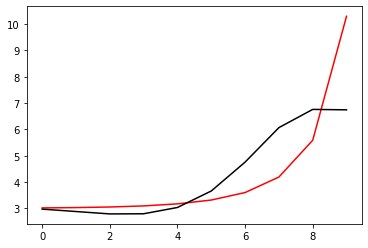

14300 0.010946545405557579
[3.01591328 2.93342862 2.85143647 2.86747775 3.11879411 3.76069644
 4.88190233 6.23305391 6.98277773 6.98323903]


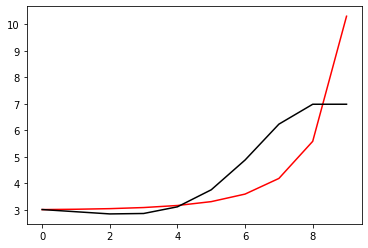

15400 0.0013587805686365484
[2.95185134 2.88355329 2.81703754 2.85055403 3.12199939 3.78952228
 4.9485534  6.36450526 7.2040884  7.18188504]


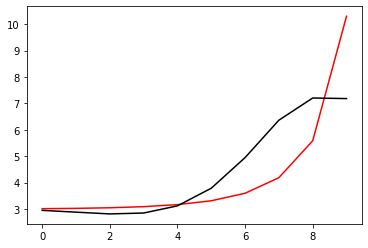

16500 0.009583827869395654
[3.04981848 2.93169077 2.816426   2.80213557 3.02328161 3.63096458
 4.70855337 6.01696847 6.76150371 6.75784885]


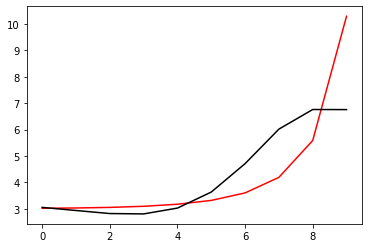

17600 0.0007104538650613148
[3.04829487 2.94405015 2.84221844 2.84307429 3.08188368 3.71203872
 4.82173829 6.18078436 6.99134822 6.9545315 ]


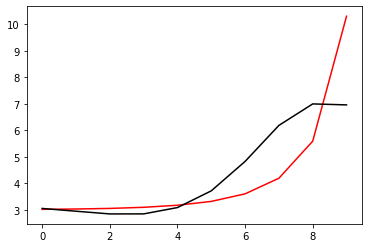

18700 0.010704625342935727
[3.03455533 2.93984362 2.84804558 2.8612613  3.11527592 3.76559278
 4.90633967 6.32129044 7.21035868 7.19343217]


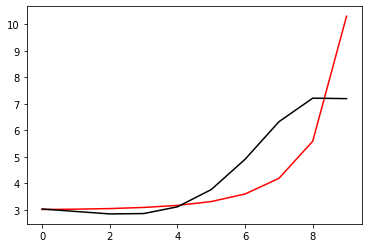

19800 0.029822574412301506
[2.98899487 2.87521181 2.76305674 2.75368731 2.97878697 3.58381476
 4.63492757 5.84908432 6.600236   6.99987421]


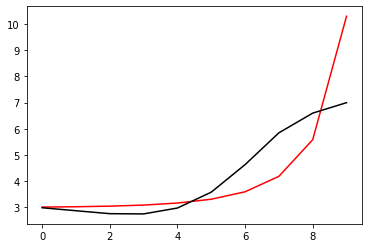

20900 0.010676539564186573
[3.09625429 2.97491082 2.85490301 2.83855341 3.05737938 3.65652261
 4.70284736 5.9192868  6.67807922 6.6720417 ]


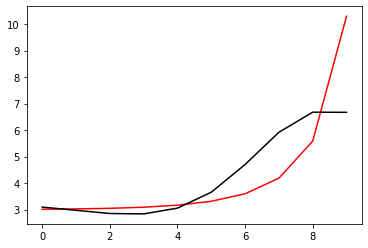

22000 0.06038589905209437
[3.08614399 2.97708399 2.86979255 2.86862164 3.1063253  3.73076587
 4.81474172 6.0921919  6.92199387 6.92353112]


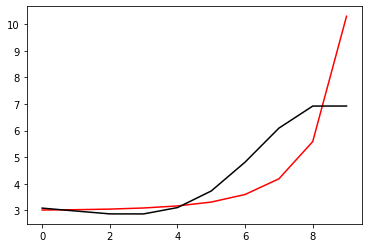

23100 0.010672613683737087
[3.05223853 2.95434078 2.85928813 2.87402751 3.1334075  3.78952688
 4.92463064 6.28976506 7.22032138 7.22464011]


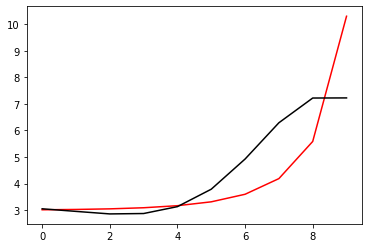

24200 0.013335139122870043
[3.02307554 2.93875671 2.8557991  2.8811942  3.14839421 3.80512253
 4.91804851 6.17123681 6.88527422 6.79354696]


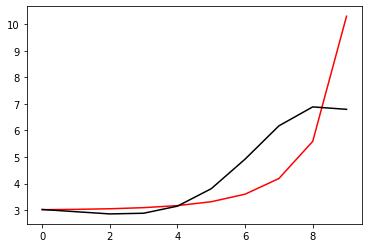

25300 0.010770592882815703
[2.988833   2.91102058 2.83552818 2.86968301 3.148557   3.82473679
 4.98371951 6.36667414 7.13056822 7.1234313 ]


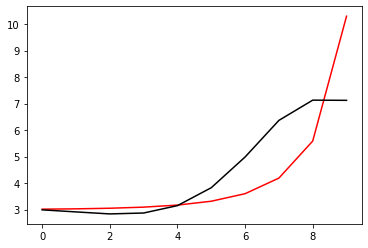

26400 0.0009939531731058852
[2.93427662 2.86704158 2.80458978 2.85442213 3.15446484 3.86582713
 5.10354995 6.67018967 7.50796996 7.50234811]


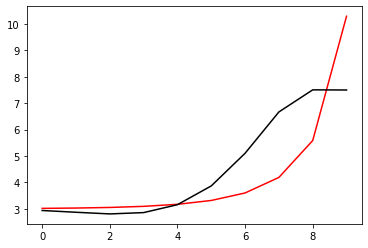

27500 0.00927344005826339
[3.0084171  2.91136593 2.8176383  2.83352355 3.09341897 3.74983404
 4.89724934 6.2726296  6.87216094 6.85801779]


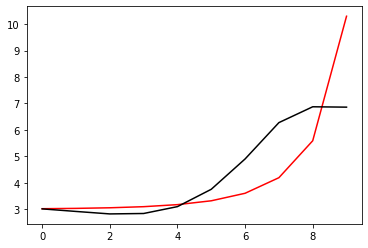

28600 0.0011716086554127189
[2.97643993 2.88778969 2.80453727 2.83431955 3.11365035 3.79970648
 4.99602468 6.45327913 7.14735917 7.11155486]


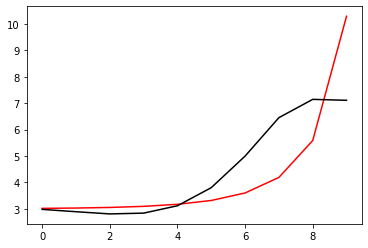

29700 0.0108163693692647
[3.08208905 2.95361438 2.83047185 2.81929859 3.05303189 3.68131778
 4.79530619 6.14294916 6.73186806 6.72373543]


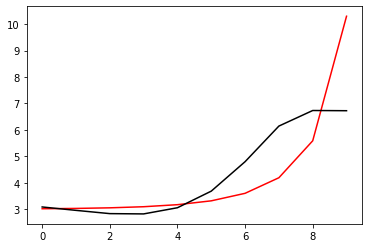

30800 0.022864533291499633
[3.07349468 2.95734156 2.84610142 2.84843266 3.09848252 3.74827202
 4.89327285 6.29004965 6.94617699 6.89858316]


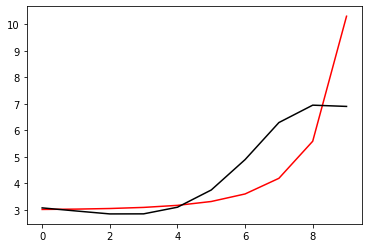

31900 0.010660551698645692
[3.10170508 2.99081002 2.88096301 2.88063716 3.12050211 3.74321178
 4.81651866 6.02900844 6.4851913  6.56044969]


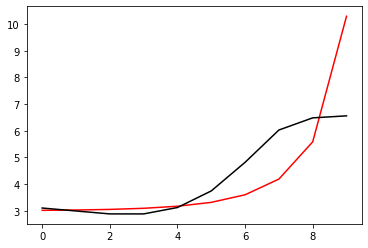

33000 0.06049682562260089
[3.06599533 2.96127244 2.85746454 2.86381605 3.11215615 3.74848009
 4.85270924 6.14668757 6.64847385 6.65119878]


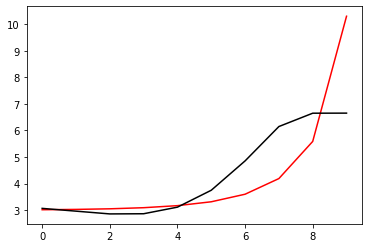

34100 0.010692863417090265
[3.04944412 2.95513523 2.86219982 2.88119195 3.14665902 3.8118889
 4.97949897 6.40669734 6.94990585 6.94853967]


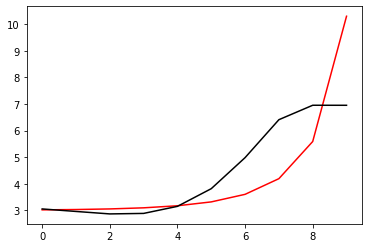

35200 0.02045897685249642
[2.99670539 2.85963765 2.72213845 2.69380724 2.90566543 3.50329792
 4.57746542 5.85118993 6.26959008 6.27988712]


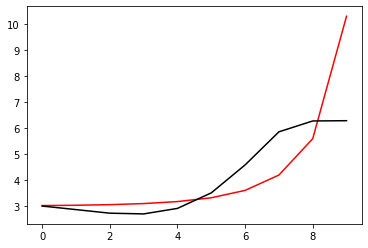

36300 0.01184222868424545
[3.08913135 2.952307   2.81497535 2.78856476 3.00516471 3.61222046
 4.70369184 6.010558   6.47650524 6.41514998]


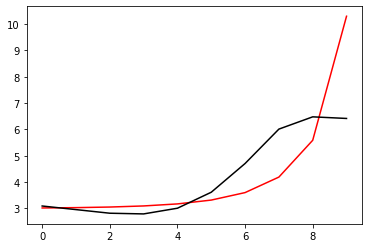

37400 0.0033270997538947427
[3.03965247 2.91764092 2.79564653 2.78763486 3.0283635  3.67055143
 4.81764802 6.21660507 6.79934552 6.76512975]


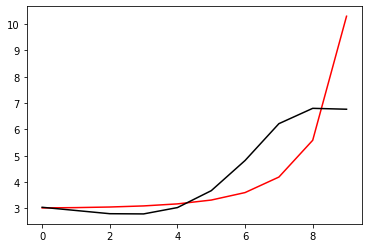

38500 0.05933791657100183
[2.91116802 2.80199665 2.69497914 2.70702263 2.97746855 3.66793992
 4.89836915 6.43960262 7.1896959  7.14594833]


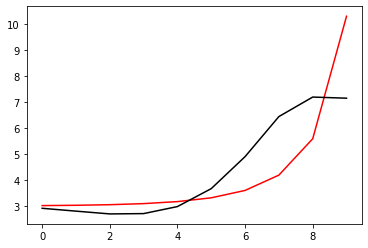

39600 0.0012871840862526641
[3.09648854 2.95180639 2.80715293 2.77914246 3.00308597 3.62993715
 4.75246551 6.10374838 6.69339829 6.6611431 ]


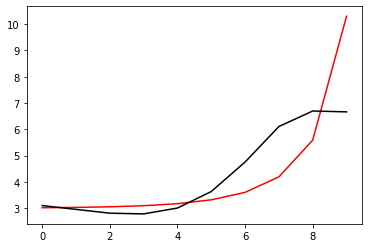

40700 0.010786130948801372
[3.08116086 2.95253386 2.82253951 2.81013051 3.05244153 3.70322833
 4.85994504 6.26573702 6.92940718 6.9292186 ]


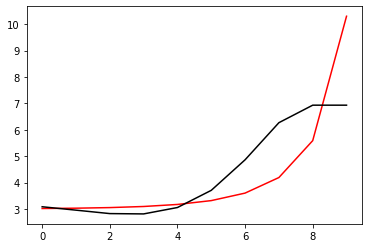

41800 0.024222705265045833
[3.15166696 3.00790996 2.85951101 2.82527311 3.04008207 3.65052754
 4.73860445 6.04512702 6.65910063 6.65957291]


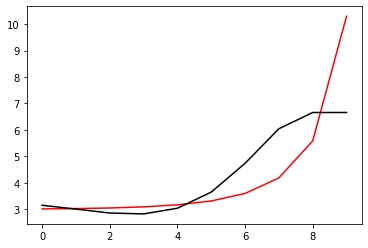

42900 0.010717675382149025
[3.10266383 2.97655305 2.84664011 2.83389461 3.07592812 3.72415324
 4.86822001 6.25678334 6.96081414 6.98212463]


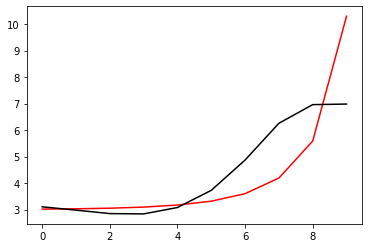

44000 0.05982176469901937
[3.04224616 2.89042054 2.73249976 2.68945032 2.89696889 3.50025425
 4.57384047 5.85232851 6.50844788 6.49880749]


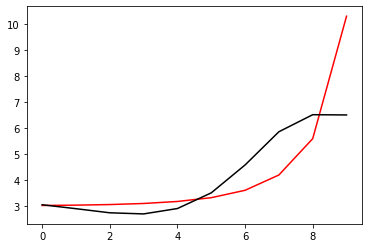

45100 0.010645771461758607
[3.15163802 3.00114927 2.84301385 2.79924662 3.00570755 3.60723179
 4.67853413 5.96189288 6.63258633 6.63563149]


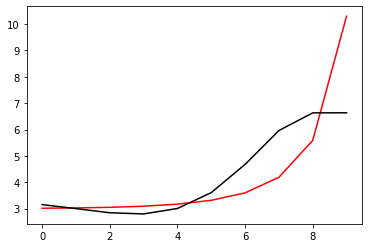

46200 0.013039103353678787
[3.07194495 2.93341171 2.79001205 2.76851667 3.01180251 3.67762901
 4.86255868 6.32342768 7.16964658 7.01574893]


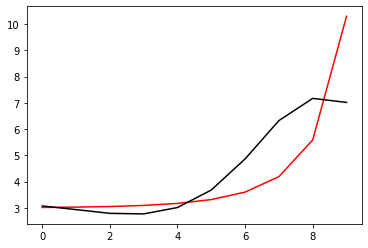

47300 0.010951592917957727
[3.09468591 2.92050451 2.74062344 2.68323339 2.89043868 3.51549127
 4.63907794 5.98553365 6.74774582 6.73272618]


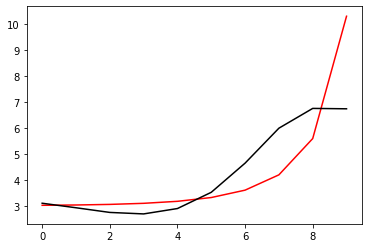

48400 0.003772728487616119
[3.09134425 2.93399211 2.76932154 2.72831154 2.95548697 3.6076611
 4.77160248 6.18214124 7.02542685 7.00194945]


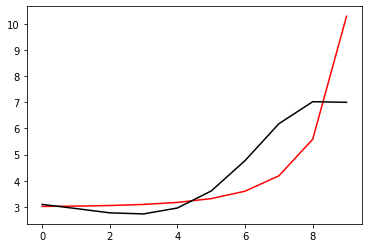

49500 0.0415826775882402
[2.96313555 2.82398563 2.6777594  2.65835352 2.9144499  3.60923805
 4.84055646 6.35923831 7.33117323 7.30136739]


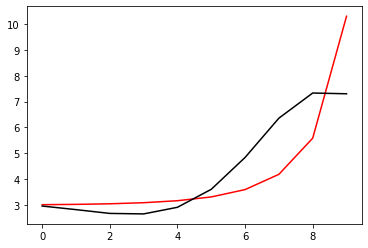

50600 0.010712887539855675
[3.08337887 2.90155821 2.71085672 2.64439356 2.84654064 3.47020906
 4.59415159 5.95975422 6.79105802 6.79051258]


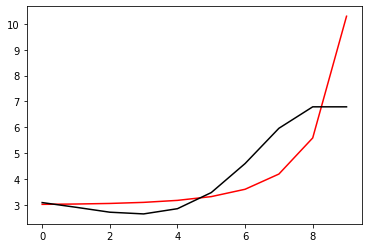

51700 0.02100714579358476
[3.09283375 2.92228983 2.73980867 2.68087963 2.89140379 3.52617439
 4.66795365 6.06802197 6.95232069 6.92007487]


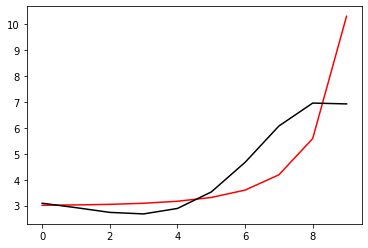

52800 0.021290531273359274
[3.15960243 3.01071304 2.84487652 2.79939874 3.02182717 3.66847519
 4.82621615 6.25990645 7.19912917 7.13175601]


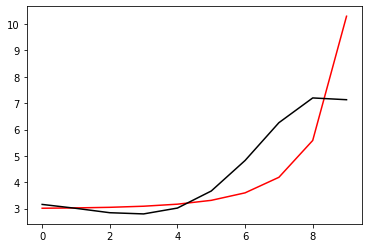

53900 0.5231769952600125
[2.74429025 2.63569367 2.50829424 2.4987222  2.75736062 3.44469239
 4.65749351 6.1840382  7.25323961 7.53408398]


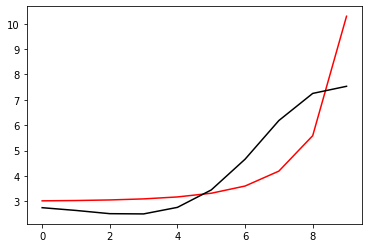

55000 0.060390539572363275
[3.03646282 2.95608019 2.8529804  2.86109609 3.13003166 3.81674162
 5.00195905 6.34434497 7.07089981 7.06789513]


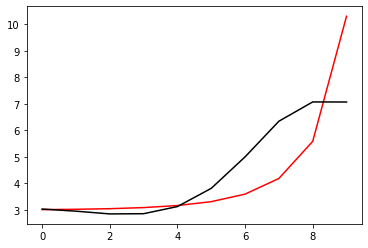

56100 0.01091061715889575
[3.02636001 2.95998371 2.87436345 2.90098893 3.1938371  3.92187903
 5.20600844 6.74348217 7.41644052 7.42728085]


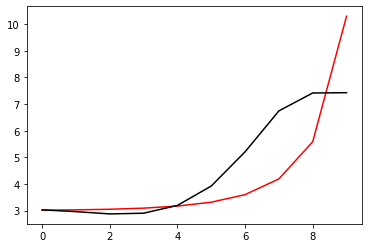

57200 0.011729465438877682
[3.00177894 2.90599783 2.7939087  2.79307356 3.05533192 3.74560096
 4.97966694 6.44895522 7.09800478 7.06650928]


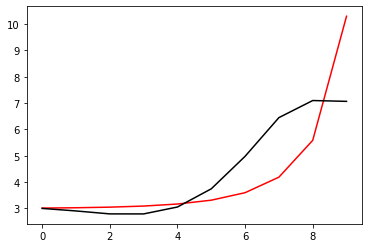

58300 0.010809984779415277
[2.97472031 2.88652673 2.78550128 2.79799516 3.07784093 3.79467878
 5.07135172 6.6169442  7.36196946 7.36251839]


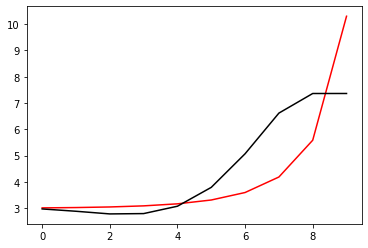

59400 0.00426049187954548
[3.05744113 2.93874519 2.80510402 2.78042331 3.01403565 3.66452524
 4.82660189 6.17801302 6.7899158  6.75842757]


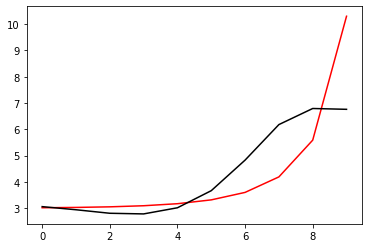

60500 0.0011975564539897167
[2.98020536 2.86841605 2.74470198 2.73365122 2.98699397 3.66886813
 4.88307401 6.32355697 7.04038208 7.01682749]


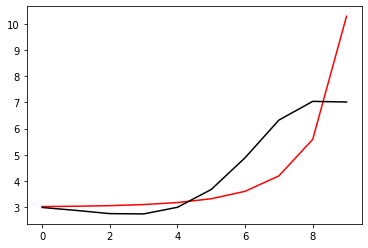

61600 0.5971640566015017
[3.22976877 3.1204795  3.00162506 2.99702535 3.25860748 3.94925616
 5.15879545 6.55847598 7.24300006 7.38962157]


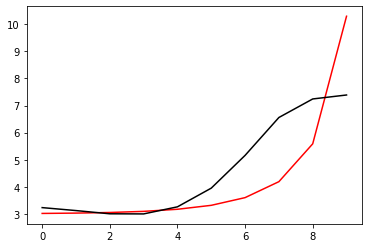

62700 0.010899454316203504
[3.0996926  2.96017802 2.81138352 2.77716903 3.00768732 3.66310563
 4.83200878 6.20048701 6.88450762 6.87383973]


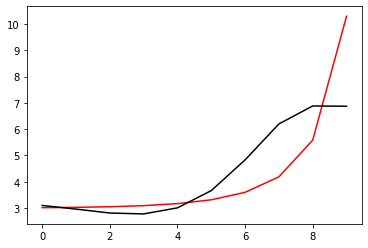

63800 0.019610877763641742
[3.10428919 2.98368104 2.85366621 2.83947043 3.09269319 3.77667491
 4.98509922 6.41596315 7.17825454 7.11000283]


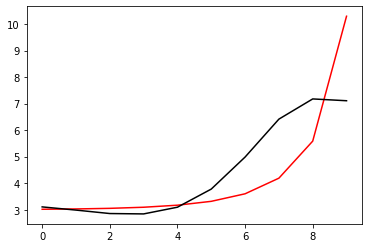

64900 0.010704033165441993
[3.06337118 2.91721511 2.76084189 2.71897871 2.9412992  3.5868168
 4.74175027 6.11253696 6.8463749  6.8213878 ]


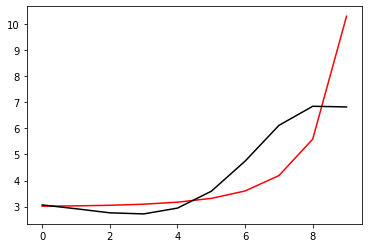

66000 0.06039002940511722
[3.11899381 2.9902765  2.84935619 2.821668   3.05700094 3.7151365
 4.88445181 6.28227175 7.0567257  7.05784666]


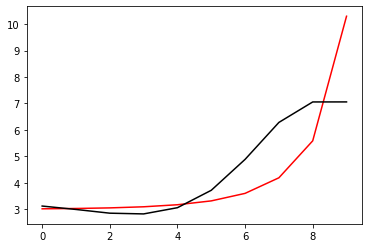

67100 0.010540972359612022
[3.04922907 2.87617915 2.69028938 2.6154845  2.79663217 3.38181929
 4.4337922  5.64818802 6.27931955 6.30726998]


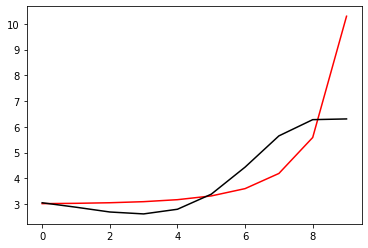

68200 0.02395949061977022
[3.14207873 2.96116427 2.76732974 2.68572893 2.86123452 3.44196232
 4.49141157 5.71019536 6.35339366 6.32383897]


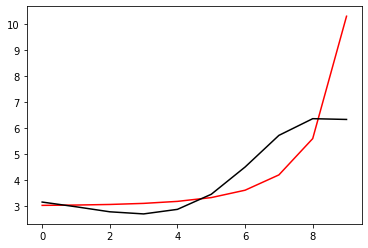

69300 0.011930731072830847
[3.13171585 2.96510996 2.78461407 2.71816946 2.91295386 3.5215894
 4.61597916 5.91073273 6.6539665  6.62152395]


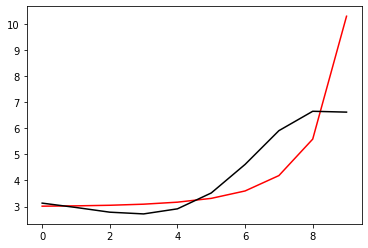

70400 0.0037098595173799776
[3.07503463 2.92769411 2.76605191 2.72128417 2.94411007 3.59385659
 4.75433576 6.15642383 7.02507091 6.98980294]


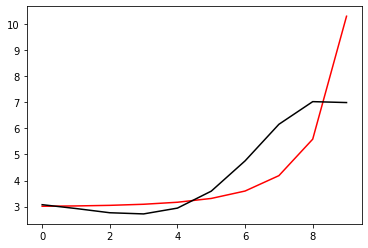

71500 0.002434389754491983
[3.10596534 2.92466675 2.72859242 2.6477944  2.82883206 3.42170188
 4.49202971 5.75285815 6.45346481 6.43673881]


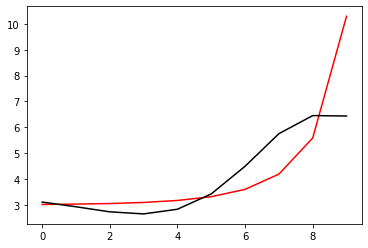

72600 0.010689051965488508
[3.08303701 2.90891133 2.71830574 2.64281056 2.82994804 3.43163408
 4.51825281 5.81328283 6.55752365 6.56078452]


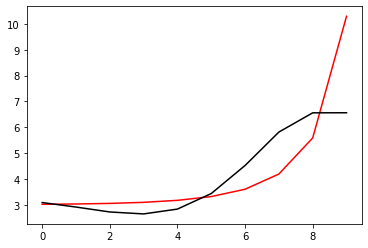

73700 0.025450421049762362
[3.08512743 2.91982405 2.73566693 2.66605449 2.85968581 3.47058211
 4.57455704 5.90859771 6.70288394 6.67814665]


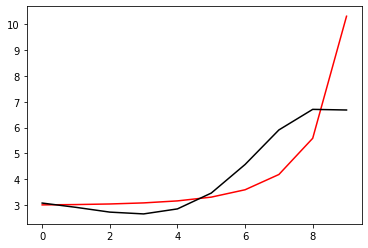

74800 0.03044809407249228
[3.12833331 2.93972932 2.72944913 2.63065324 2.78901263 3.35093765
 4.37636096 5.58002433 6.20034885 6.19816141]


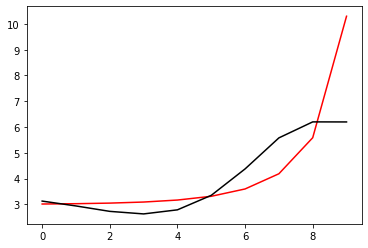

75900 0.016668975665600435
[3.05632514 2.88134011 2.68221244 2.59358545 2.76237711 3.33743013
 4.38462199 5.63189284 6.3138363  6.27130784]


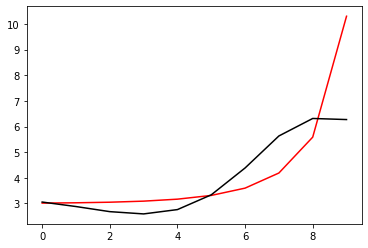

77000 0.060699524999109154
[3.21448821 3.03461881 2.82985287 2.73611251 2.90064242 3.47233579
 4.51747705 5.76715533 6.4429954  6.45011691]


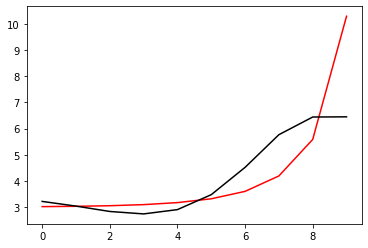

78100 0.01068925818231066
[3.07711144 2.92991686 2.75681553 2.69454406 2.89290744 3.50707078
 4.61861773 5.98497042 6.79015836 6.78627035]


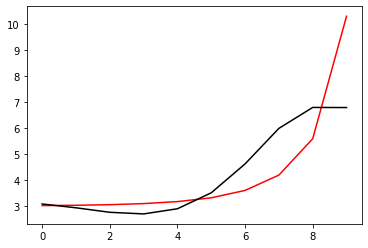

79200 0.02619359240020314
[2.97229352 2.86163959 2.72118217 2.68391358 2.89541791 3.50039824
 4.54398991 5.54064524 6.15291567 6.43164512]


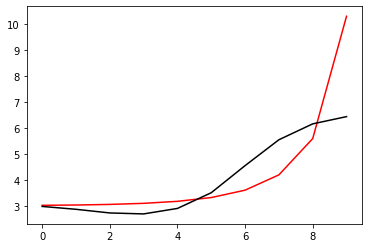

80300 0.01087272340567241
[3.03042525 2.9134844  2.76837301 2.72739865 2.93614648 3.5392794
 4.58180125 5.58295015 6.19604714 6.18682545]


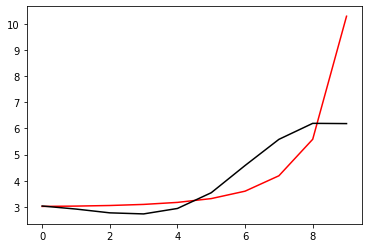

81400 0.008024937953720019
[3.08433875 2.96255917 2.81458841 2.77251726 2.98302546 3.59288599
 4.65133587 5.6903467  6.33677121 6.31974921]


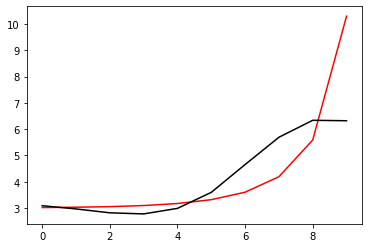

82500 0.005984847042740592
[3.03226971 2.92074048 2.7853943  2.75817846 2.98866191 3.63015443
 4.74569436 5.89406506 6.63965513 6.63616549]


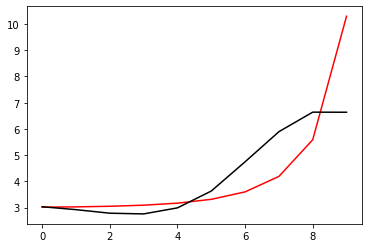

83600 0.0008119889507961832
[3.05032246 2.94639193 2.82247956 2.80900388 3.05827938 3.7295714
 4.89729203 6.14698007 6.9716434  6.99242884]


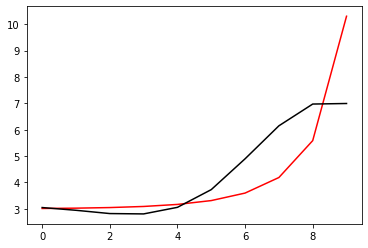

84700 0.010753379856782257
[3.05471935 2.96940124 2.86710249 2.87498749 3.14723964 3.8479209
 5.06090472 6.40506003 7.29900749 7.29514326]


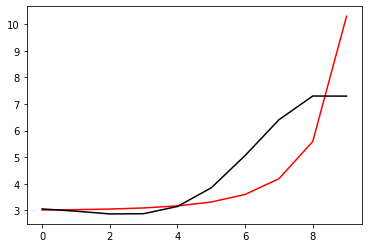

85800 0.021548321510390357
[3.00763186 2.9411866  2.85714767 2.8788121  3.15837859 3.85551868
 5.0388205  6.2804858  6.95866982 6.88151323]


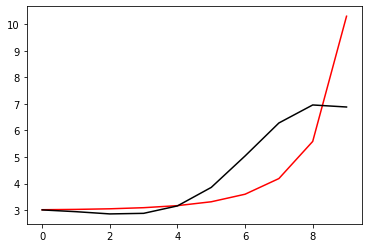

86900 0.010764073956913941
[2.99691    2.94147601 2.87141992 2.90837267 3.20731283 3.93596034
 5.18625995 6.57603211 7.28985569 7.27440643]


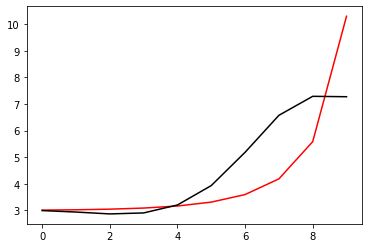

88000 0.06029556110794238
[2.9797109  2.88188131 2.77405298 2.77406236 3.03425259 3.71831116
 4.91316122 6.23455555 6.87580445 6.88314846]


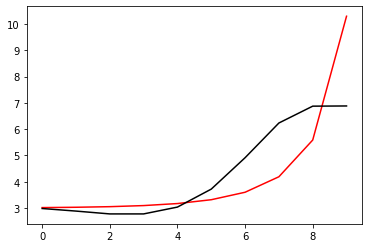

89100 0.010714972067431276
[3.04220661 2.95487087 2.85772598 2.86832534 3.13924776 3.83533691
 5.04550382 6.39733457 7.08061989 7.08144214]


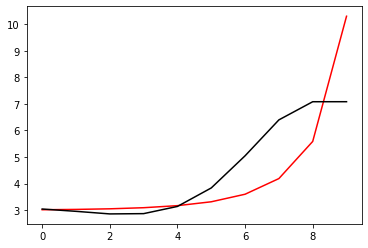

90200 0.010385780966096603
[2.94903966 2.87501811 2.79531161 2.82713446 3.12509052 3.85946973
 5.12879215 6.5839514  7.39778739 7.35923131]


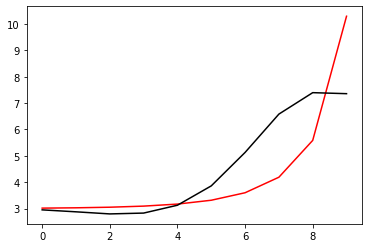

91300 0.01140885801423308
[3.05209816 2.94892615 2.83788286 2.83337656 3.08437502 3.74840648
 4.89406259 6.13615644 6.77306988 6.74325334]


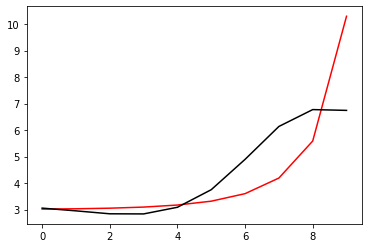

92400 0.002227327974543491
[3.00598143 2.90986533 2.80813392 2.81607614 3.08419993 3.77442705
 4.96432053 6.28868478 7.0175865  6.9938769 ]


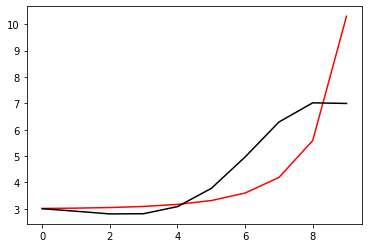

93500 0.004770528303348195
[2.96613475 2.88211653 2.79688689 2.82612624 3.12210809 3.85211032
 5.10441469 6.53775276 7.37740536 7.37400954]


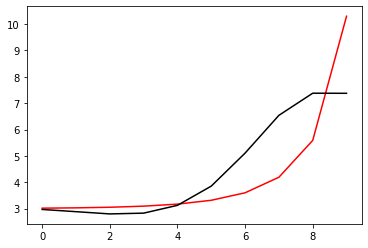

94600 0.0009416122100507295
[2.95131126 2.88793301 2.82135285 2.86351922 3.16121379 3.87100991
 5.05764166 6.35366029 7.0013071  7.01235099]


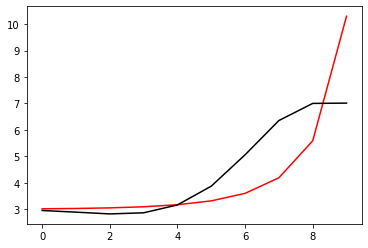

95700 0.010878475804904085
[2.95816851 2.89784986 2.83493439 2.88106209 3.18346827 3.90006967
 5.09890208 6.41984832 7.08847497 7.08602755]


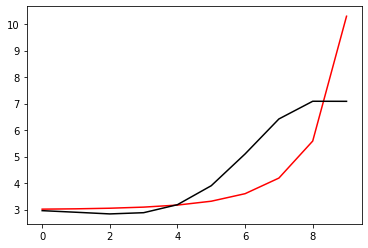

96800 0.016848573586111335
[2.95990915 2.90790916 2.85482363 2.91195786 3.22802973 3.96486565
 5.19900721 6.58181776 7.29695563 7.2205178 ]


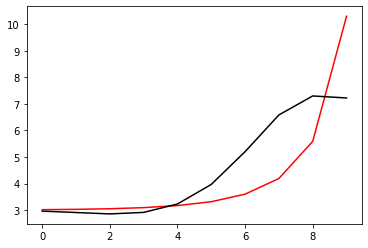

97900 0.010650812124123263
[3.04204409 2.96419616 2.88412184 2.90994206 3.18547957 3.86152082
 4.99011155 6.1925923  6.76659836 6.80466321]


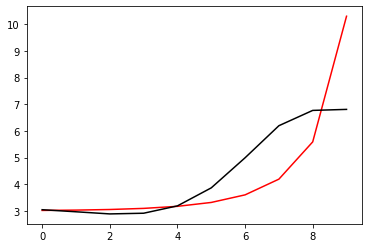

99000 0.060196090356577
[3.01652474 2.94439914 2.87171642 2.9066371  3.1935041  3.88536999
 5.040401   6.29567422 6.93074012 6.93188675]


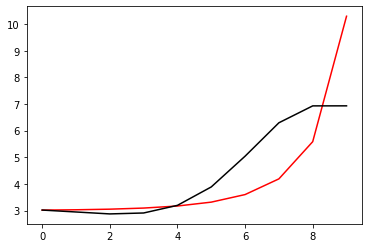

100100 0.010850175191438934
[3.00470594 2.94482676 2.88814047 2.94300307 3.25544545 3.98367773
 5.19697996 6.55126672 7.28243389 7.29627282]


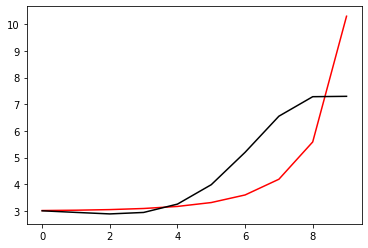

101200 0.014315261308173064
[3.06257385 2.94528802 2.83520073 2.84009171 3.103416   3.77841446
 4.92506875 6.19175382 6.85214631 6.81958833]


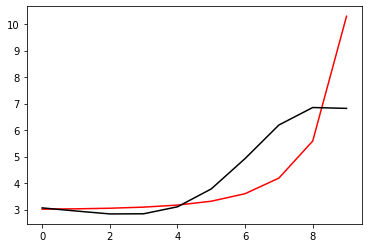

102300 0.010889593615229787
[3.02783129 2.9196415  2.81850811 2.83399823 3.1102491  3.8027125
 4.97673251 6.29452703 7.02463014 7.02578483]


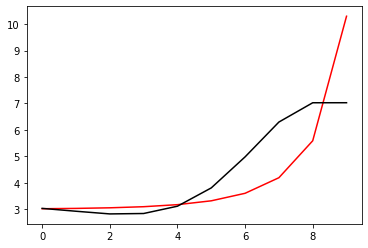

103400 0.0012681492576234676
[2.97222914 2.88040155 2.79621841 2.83082972 3.12913691 3.84946116
 5.06473753 6.4573382  7.28420469 7.26887776]


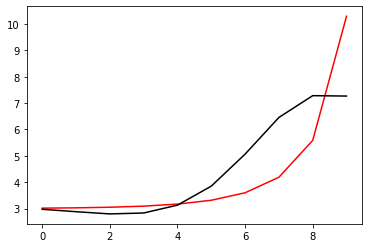

104500 0.001351089799857535
[3.00570521 2.87275157 2.74780218 2.74166214 2.99552918 3.65990704
 4.79367044 6.0720551  6.78828073 6.77503357]


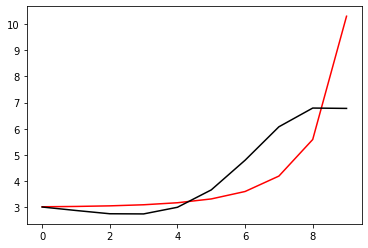

105600 0.0008011043960349299
[3.05123209 2.93027976 2.81488007 2.81786045 3.08084268 3.75539438
 4.90361684 6.21100915 6.9701808  6.93457282]


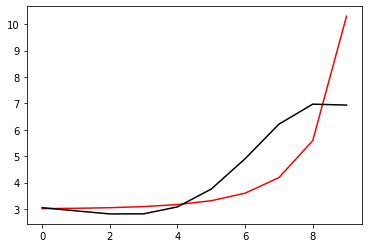

106700 0.14414379251586512
[3.20750858 3.07267236 2.93934777 2.92070232 3.15519194 3.78641226
 4.86038059 6.05532502 6.7290212  6.98161551]


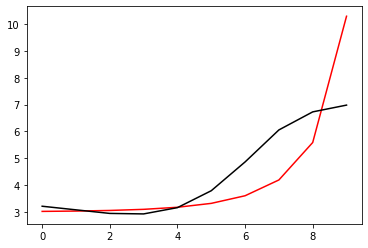

107800 0.03015932858573023
[3.05943751 2.89997665 2.74132449 2.6973467  2.90489769 3.50498983
 4.5424967  5.70393223 6.35800313 6.35305028]


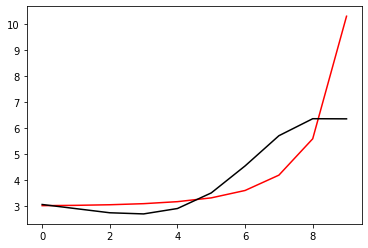

108900 0.01079344278544878
[3.15715072 2.99949326 2.84109117 2.7977664  3.00640718 3.60814645
 4.6497057  5.82591368 6.50188452 6.5026812 ]


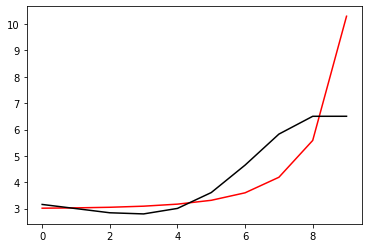

110000 0.06064882204074535
[3.09459013 2.94857153 2.80161511 2.77334038 3.00360231 3.63965316
 4.74183635 6.0280515  6.84224954 6.84112488]


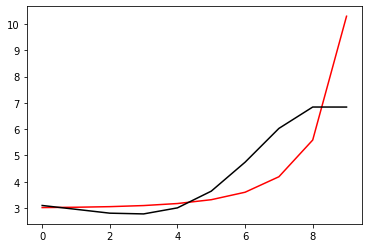

111100 0.010634654979556424
[3.14825199 2.9651345  2.77807045 2.70799917 2.89239005 3.47103365
 4.485838   5.62352807 6.33571955 6.33869507]


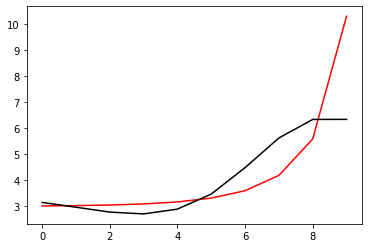

112200 0.024173987685714163
[3.17033223 3.00123026 2.82730887 2.77257478 2.97671579 3.58360042
 4.64332442 5.85527353 6.65266267 6.54010299]


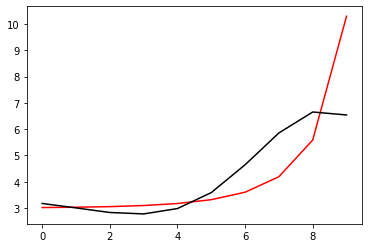

113300 0.011128429797296504
[3.09638588 2.94276958 2.78433052 2.74936258 2.98163906 3.63239615
 4.76602943 6.09956707 7.02719898 7.03300393]


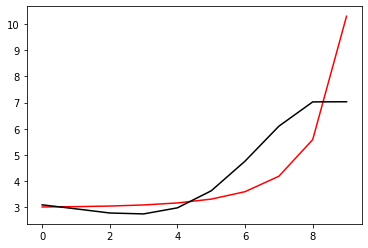

114400 0.007546050065937142
[3.13946763 2.9627795  2.77871157 2.71677998 2.91951093 3.53293288
 4.60688444 5.83374526 6.68354064 6.6462576 ]


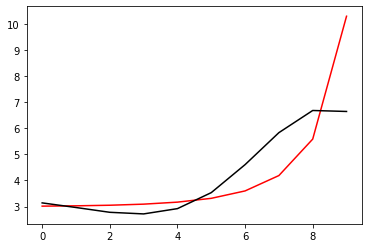

115500 0.00164028904016134
[3.06675624 2.89954268 2.72612584 2.67944663 2.90601303 3.55920678
 4.70330894 6.04581254 7.00919546 6.99373799]


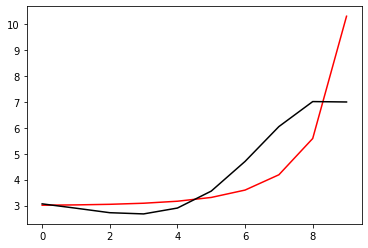

116600 0.6914968291818228
[3.3546074  3.19545511 3.03011827 2.99449128 3.23797588 3.91554774
 5.0796864  6.36817993 7.22954221 7.39378325]


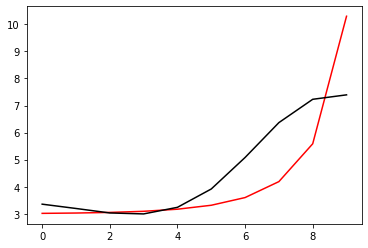

117700 0.022180618448345336
[3.08684392 2.91792616 2.73846453 2.68405757 2.90151207 3.54065052
 4.65256302 5.91718202 6.85402921 6.81696629]


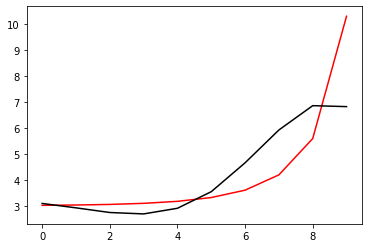

118800 0.02293178897336539
[3.12514524 2.97876235 2.82153986 2.79074201 3.03531828 3.70850092
 4.86887524 6.21014291 7.21503545 7.15562814]


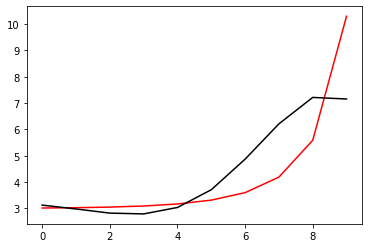

119900 0.4304671383257033
[2.77946707 2.66350259 2.53870859 2.54300754 2.82885197 3.5563086
 4.80055687 6.28345063 7.43526515 7.67933081]


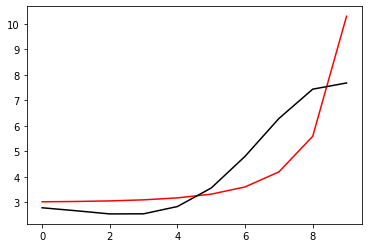

121000 0.06029418268252621
[3.0481919  2.95535663 2.84892538 2.86465014 3.1525524  3.86386454
 5.03494496 6.18906487 7.09450116 7.08683728]


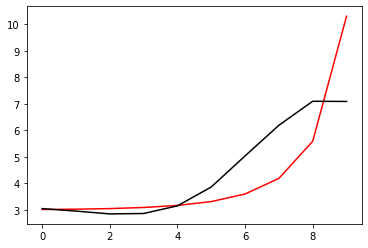

122100 0.010815500309101578
[3.02968026 2.94836063 2.85536845 2.8853065  3.19164676 3.93508719
 5.19063975 6.57663066 7.40556928 7.40643094]


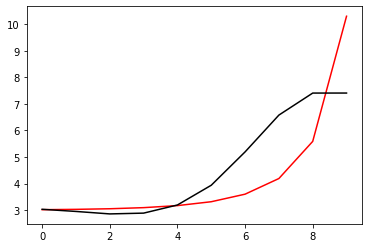

123200 0.01154186582284354
[3.04367389 2.93877289 2.82394044 2.83024079 3.10793447 3.81189064
 5.01267783 6.33698666 6.95856513 6.92773096]


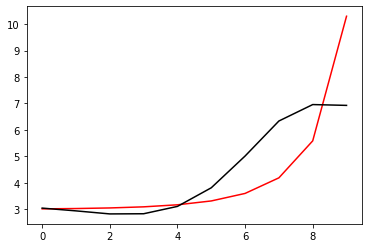

124300 0.01091811224880741
[3.02652078 2.92744246 2.81866047 2.8311059  3.11611565 3.83096716
 5.05180331 6.41762979 7.07893067 7.06782213]


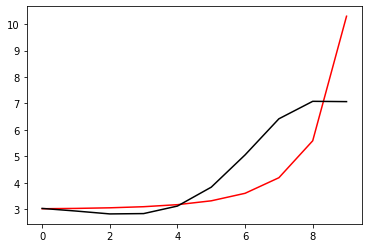

125400 0.0014808373696905005
[2.9882848  2.89906355 2.80072796 2.82361953 3.12072384 3.85310972
 5.10573773 6.53734373 7.26312045 7.25368198]


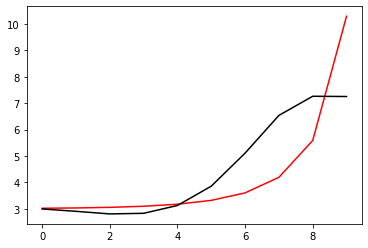

126500 0.03696928619907364
[2.88375736 2.80763979 2.72583372 2.76716678 3.08782178 3.85680552
 5.17752214 6.74286433 7.59732173 7.55974484]


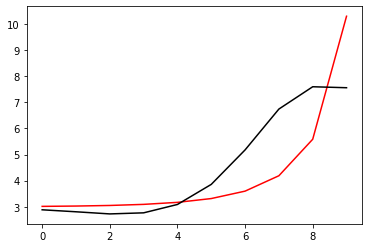

127600 0.0009975529050100973
[2.9939768  2.89298527 2.78696822 2.80335527 3.09595969 3.82771619
 5.08596064 6.54286835 7.31855513 7.30391305]


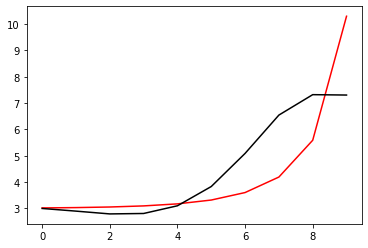

128700 0.010905580590698703
[3.10422357 2.98490878 2.86102545 2.85794109 3.12703919 3.8253489
 5.02599744 6.39811778 7.12794483 7.44011403]


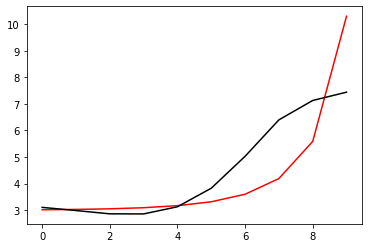

129800 0.017690579405964184
[3.05872126 2.95155464 2.84155663 2.85502528 3.14504777 3.87292006
 5.11983641 6.5695625  7.38696605 7.29582313]


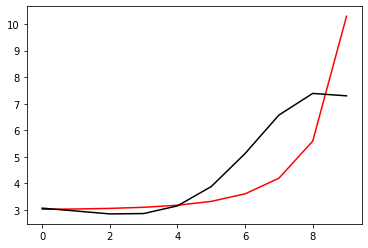

130900 0.010718386396571222
[3.10902894 2.97449407 2.83454401 2.81310269 3.05782478 3.71712111
 4.8406139  6.06572442 6.73770653 6.85292321]


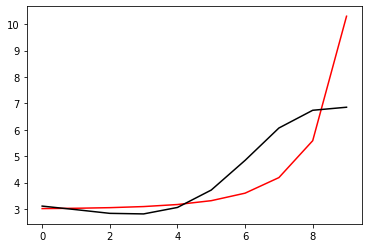

132000 0.06053655981437096
[3.08834761 2.96250103 2.83193269 2.82180915 3.08113977 3.76165357
 4.9199123  6.20686555 6.94472938 6.94659444]


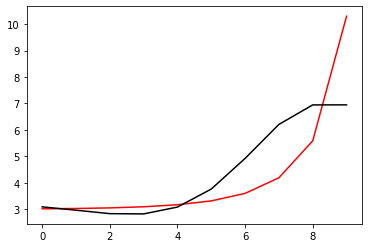

133100 0.010771299732721017
[3.0031696  2.8923305  2.77934031 2.79096896 3.07902628 3.80174787
 5.0281866  6.42668324 7.27302196 7.35963814]


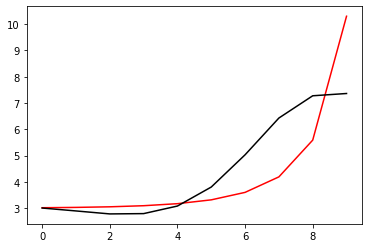

134200 0.01762258348745104
[3.09369356 2.94051945 2.7864069  2.75713894 3.00114446 3.66886649
 4.81249356 6.08585161 6.81283782 6.77272721]


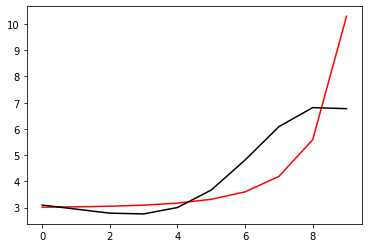

135300 0.01136053701895537
[3.09085897 2.94850236 2.80413083 2.78519794 3.04123351 3.72491559
 4.89304688 6.20974179 6.99369571 6.98188524]


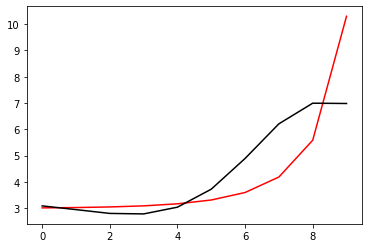

136400 0.0018561352280261464
[3.02816337 2.90083492 2.77060786 2.76660062 3.03987306 3.74637004
 4.95021186 6.33219465 7.20120924 7.17704442]


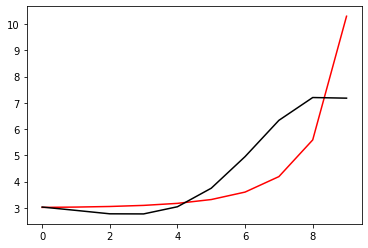

137500 0.008348841234763269
[3.08165039 2.92666349 2.76711979 2.73306471 2.97410475 3.64187665
 4.79247245 6.10865903 6.93703866 6.93351635]


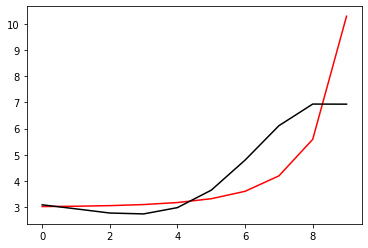

138600 0.0064072426754568325
[3.03908724 2.89510865 2.74698439 2.72673773 2.98579508 3.67966111
 4.87324712 6.26659512 7.18592444 7.1987049 ]


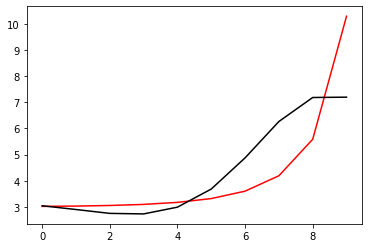

139700 0.010848016303167746
[3.06010779 2.93211145 2.79970835 2.79657487 3.07651083 3.79958313
 5.04049432 6.51655387 7.51989127 7.50244594]


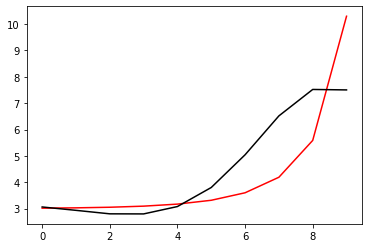

140800 0.02256778173225105
[3.03937132 2.93013688 2.81431734 2.82324807 3.10715923 3.81821559
 5.01266269 6.37518737 7.19183812 7.13145967]


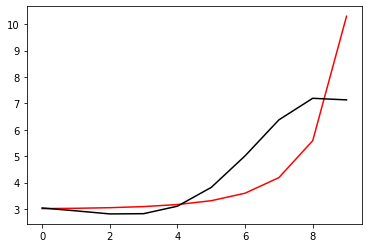

141900 0.010791742108142361
[3.03271002 2.93365253 2.82848597 2.84856698 3.14602571 3.87734066
 5.10975522 6.54682302 7.42999048 7.42139064]


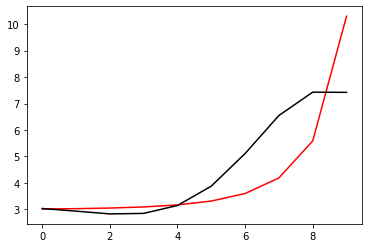

143000 0.06056443088115085
[3.13619205 2.99078611 2.83738729 2.80474712 3.04033693 3.68934525
 4.79527105 6.02439601 6.7307344  6.79692528]


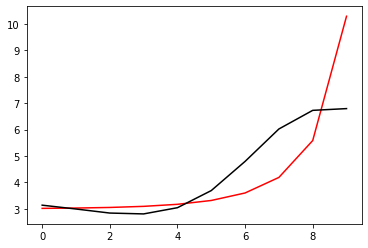

144100 0.010688898652381346
[3.11078999 2.9703679  2.82194207 2.79501348 3.03773257 3.69698105
 4.82062461 6.08524583 6.83905724 6.84009745]


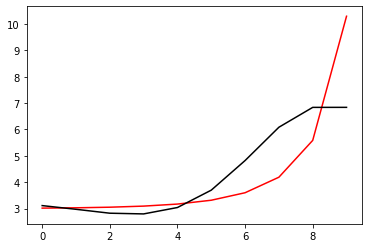

145200 0.012570585887636444
[3.05477621 2.92513177 2.78929528 2.77840096 3.0432693  3.73630919
 4.91613042 6.27492129 7.13687117 7.06163981]


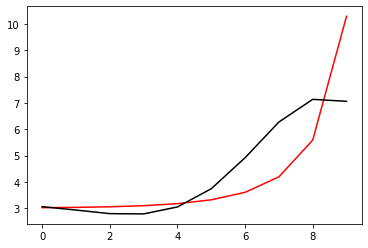

146300 0.01081757849429984
[3.02959425 2.89809289 2.76102131 2.7507064  3.01951629 3.7235299
 4.93229367 6.36429508 7.31899031 7.36211999]


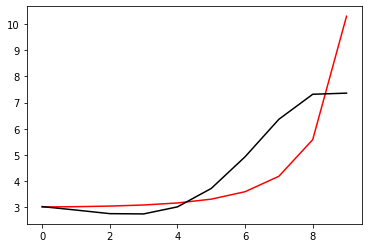

147400 0.004955998635203477
[3.10836027 2.94184894 2.76859636 2.72157092 2.95122005 3.60800466
 4.74590656 6.0505968  6.89429001 6.84587599]


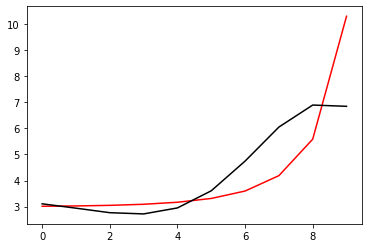

148500 0.0011896581894268352
[3.03502913 2.88291288 2.72382836 2.69303564 2.94312615 3.62867874
 4.81162193 6.19108945 7.12611536 7.11080118]


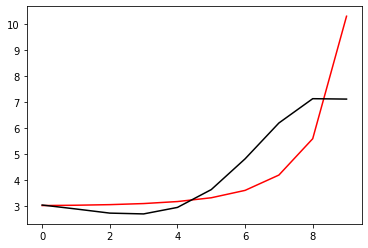

149600 0.7367048949166936
[3.36810008 3.22619896 3.07570648 3.05298185 3.31123932 4.00298978
 5.17574567 6.4842219  7.31257313 7.45944794]


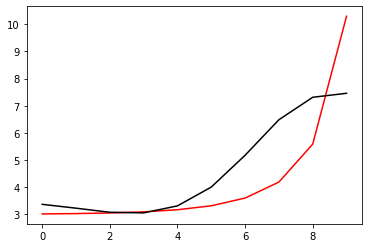

150700 0.010898429107743484
[3.1343633  2.97533699 2.8043628  2.75726133 2.98434641 3.63196182
 4.74031503 5.99228161 6.88366869 6.86213187]


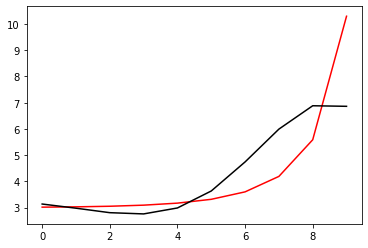

151800 0.02002303888943615
[3.14071022 3.0017068  2.85165435 2.82807948 3.08382934 3.76991714
 4.93473947 6.27026939 7.24238678 7.17284304]


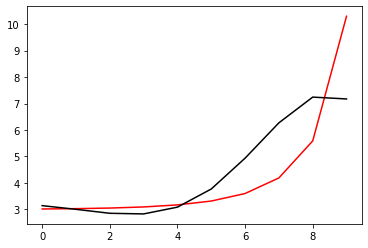

152900 0.010998219070260783
[3.134126   2.97008414 2.79268194 2.73789541 2.95512651 3.58514967
 4.64859032 5.79729994 6.67442897 6.78204497]


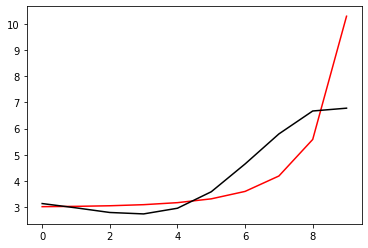

154000 0.060595823756136
[3.14392541 2.99262657 2.82786185 2.78651693 3.01900111 3.66816694
 4.75970118 5.95498953 6.87760586 6.87969409]


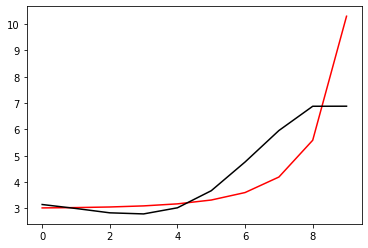

155100 0.010715670206967415
[3.04328817 2.90909392 2.7623226  2.74079292 2.997073   3.67841739
 4.82046614 6.10021638 7.1067275  7.09458679]


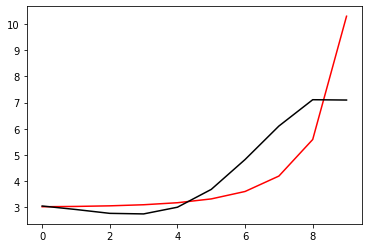

156200 0.011851652970187842
[2.99064397 2.86947382 2.73967413 2.73956248 3.0253506  3.75193096
 4.97205897 6.38693356 7.5286841  7.44584443]


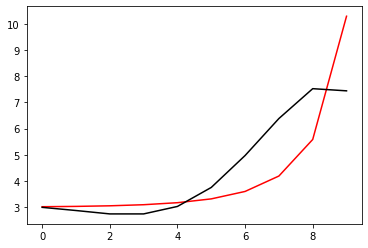

157300 0.04240818752187341
[2.92417143 2.82551844 2.71437394 2.72348247 3.00290945 3.69534039
 4.83193658 6.09802956 7.04395035 7.31912866]


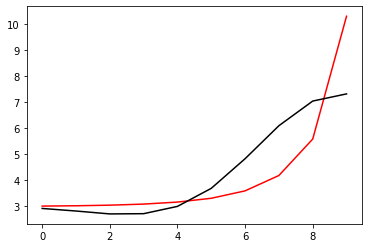

158400 0.00276570582729339
[3.02378193 2.92403903 2.81356985 2.82488635 3.10912357 3.81122408
 4.96672959 6.26024003 7.20313234 7.17781623]


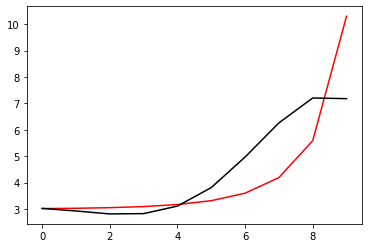

159500 0.0011761493419762935
[2.95206017 2.86154411 2.76164645 2.78398126 3.08136934 3.80343347
 4.99929055 6.37707755 7.39630261 7.37568444]


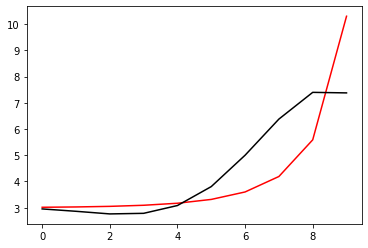

160600 0.6141069443461644
[3.19102307 3.09617876 2.99565512 3.01919048 3.3212131  4.05419355
 5.26868682 6.649712   7.62174928 7.73625814]


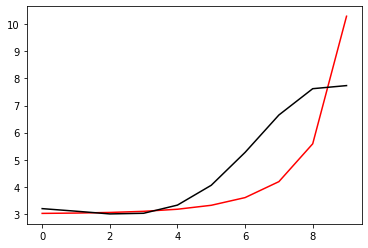

161700 0.0108885493955344
[3.03672853 2.92347166 2.80458786 2.80874696 3.0883027  3.79277908
 4.9722292  6.32943283 7.31569754 7.29925396]


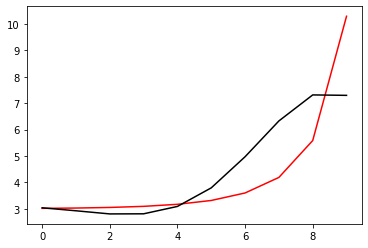

162800 0.0172121600852617
[3.05741839 2.95251913 2.84388282 2.860238   3.15517705 3.88156451
 5.09704485 6.51956048 7.58644777 7.50277943]


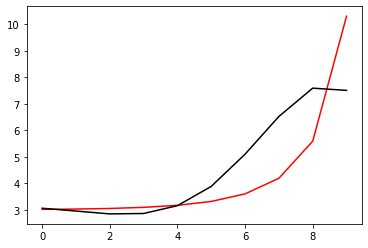

163900 0.010764242870950564
[3.12077537 2.96917097 2.81564225 2.78731415 3.03459563 3.70405116
 4.84312381 6.16847659 7.15395702 7.17443398]


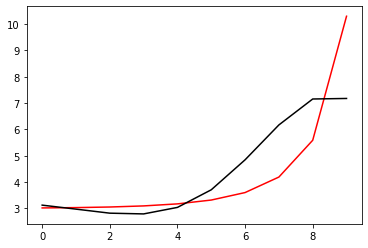

165000 0.060608890345659173
[3.10192625 2.95817759 2.81154465 2.79060208 3.04632849 3.72709315
 4.88503965 6.24725314 7.28253776 7.28579827]


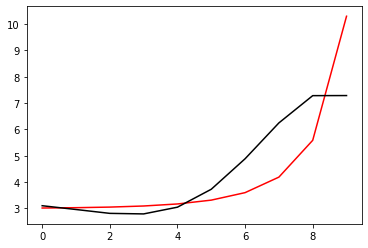

166100 0.010887712183693915
[3.10084733 2.97758434 2.85053654 2.84973123 3.12736574 3.83510647
 5.03264878 6.46128079 7.5759229  7.58657109]


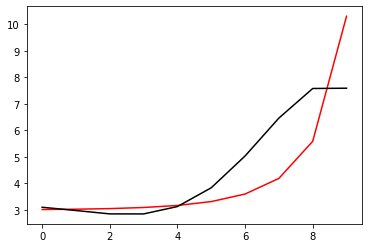

167200 0.013774735899339571
[3.10425195 2.95565211 2.8019492  2.77323228 3.01950307 3.68709312
 4.82539015 6.17428316 7.24821368 7.20443343]


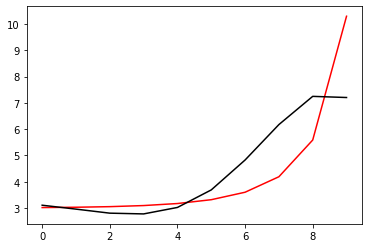

168300 0.010866564222010263
[3.05464113 2.92309968 2.78692318 2.77756819 3.04644471 3.743741
 4.9279538  6.35291793 7.50904324 7.51382184]


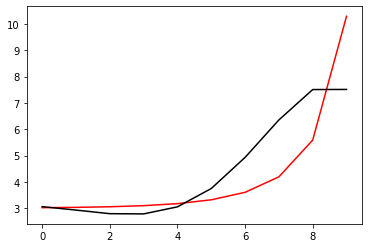

169400 0.0036792439571073656
[3.09315959 2.93798834 2.77656477 2.74111613 2.98169004 3.64456535
 4.77971023 6.13429558 7.24227338 7.21238888]


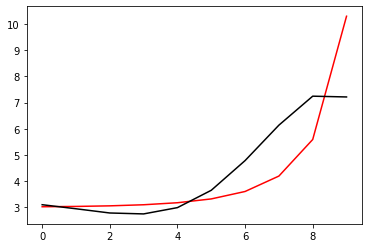

170500 0.020094104609814284
[2.9806775  2.83954325 2.69362025 2.67711246 2.942524   3.64192358
 4.83817151 6.2959168  7.51831294 7.48728457]


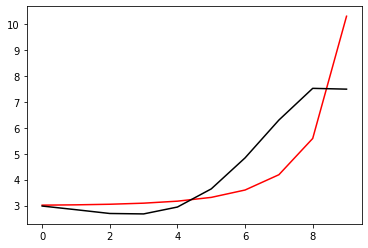

171600 0.010658970439408385
[3.08086922 2.90341344 2.71534585 2.64810769 2.84623515 3.4437049
 4.46547227 5.63035625 6.56331776 6.56032835]


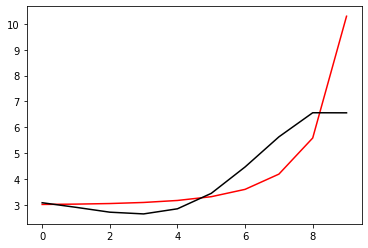

172700 0.010986697876898209
[3.17339953 2.99614301 2.80793372 2.74195567 2.94379365 3.54944196
 4.58830992 5.78523908 6.74623387 6.72542241]


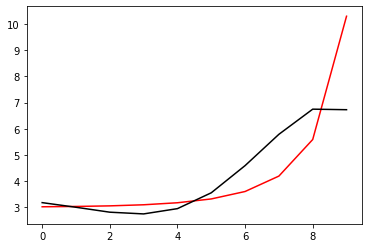

173800 0.024682899120964132
[3.16416959 3.00326162 2.83022081 2.7808833  3.00362403 3.64025429
 4.73250802 6.02018944 7.07166143 7.03895567]


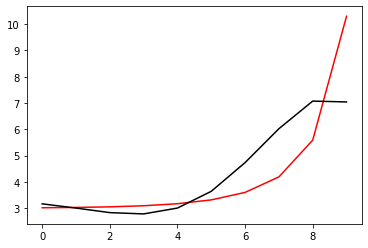

174900 0.010785011792578467
[3.11385755 2.96698872 2.80719414 2.77260812 3.01482535 3.68245081
 4.8330777  6.228592   7.39055632 7.41220982]


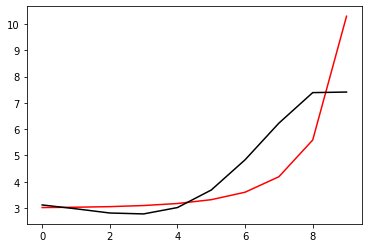

176000 0.05998947345218456
[3.08449283 2.90601453 2.71507769 2.64997011 2.86179888 3.49663967
 4.60234301 5.91270361 7.01151809 7.01077589]


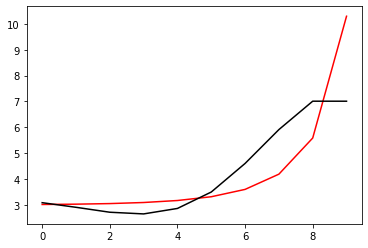

177100 0.010745273279511774
[3.10095373 2.93146037 2.74668834 2.68627973 2.90189558 3.54053812
 4.6531395  5.98207833 7.10774245 7.1087241 ]


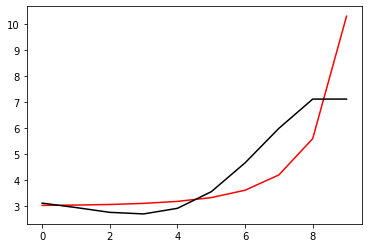

178200 0.013732304130940608
[3.08686403 2.93802224 2.77187965 2.72954287 2.96476259 3.62818896
 4.77857699 6.17248026 7.3775412  7.30967141]


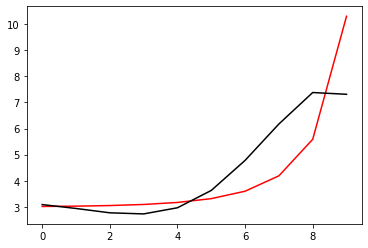

179300 0.011079662319977706
[3.11874512 2.93881616 2.73772786 2.65554778 2.84262598 3.44060234
 4.4900391  5.73741876 6.84951288 6.83205995]


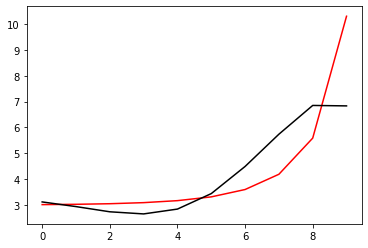

180400 0.0052517483532370235
[3.11625133 2.94983803 2.76212132 2.6947067  2.90003211 3.52413153
 4.61714265 5.93894442 7.12848069 7.06229129]


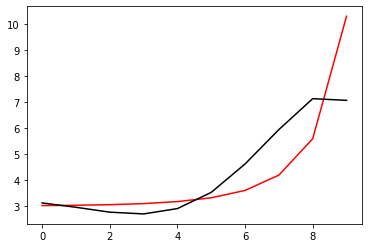

181500 0.029711672644503792
[3.00089916 2.84561825 2.67157908 2.62287251 2.857315   3.53177364
 4.71754315 6.19426281 7.53743943 7.49687134]


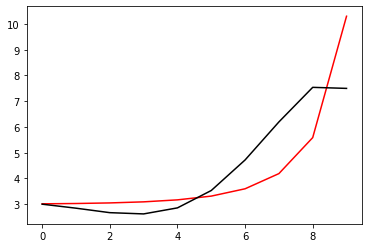

182600 0.0008201046918864604
[3.15432459 2.99349985 2.81032079 2.7473744  2.9585243  3.590536
 4.68841497 5.98497663 7.17367045 7.12933477]


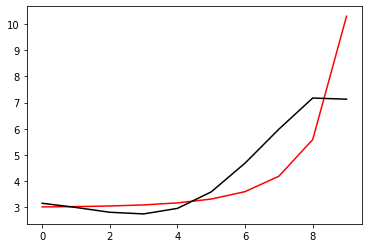

183700 0.010802625878608849
[3.15244614 3.0016504  2.82998332 2.78107941 3.01180669 3.67472126
 4.82604114 6.21071115 7.47979278 7.40414411]


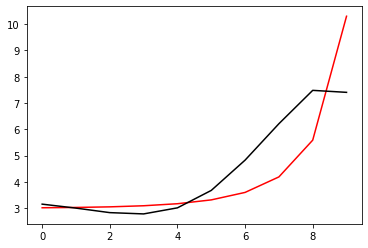

184800 0.029994380563581217
[3.05620214 2.91139787 2.7428087  2.69061988 2.90585301 3.52813888
 4.58006217 5.70163702 6.6835591  6.67353183]


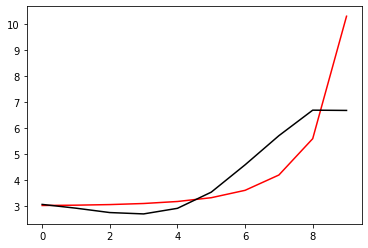

185900 0.010756401073091525
[3.13642224 2.99262512 2.82604938 2.77721739 2.99838763 3.63162056
 4.70494057 5.8696566  6.89432207 6.89308255]


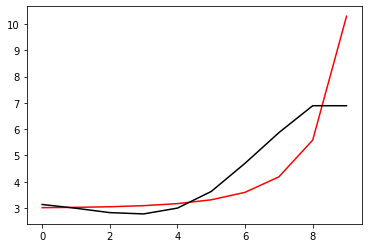

187000 0.060412485851250836
[3.127369   2.99949035 2.84920729 2.81714843 3.05791622 3.71848692
 4.83779333 6.08753758 7.20016032 7.20042023]


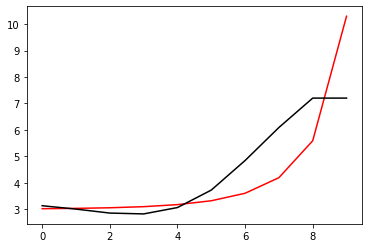

188100 0.010534738438979466
[2.96208461 2.8532977  2.72270979 2.70904976 2.96834614 3.65161183
 4.80979519 6.14594143 7.35823357 7.33618278]


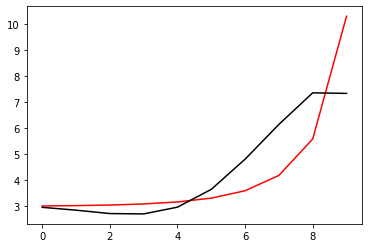

189200 0.029292778978305765
[3.11515442 3.02060862 2.90559337 2.90525899 3.17373366 3.85671196
 4.9799308  6.11685528 7.12464565 7.527632  ]


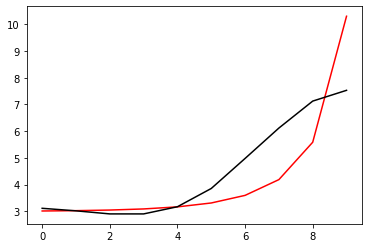

190300 0.010905738265457134
[3.02006619 2.93828738 2.83513521 2.84431874 3.11995416 3.80807594
 4.93863557 6.13572162 7.1959647  7.17327409]


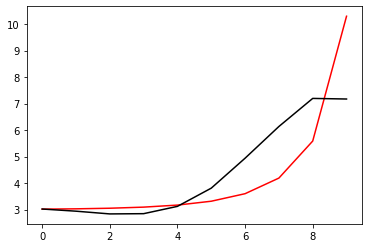

191400 0.0014501450228474018
[2.97966528 2.90637638 2.81389394 2.8340364  3.12278393 3.83260407
 5.02035916 6.38810201 7.43843732 7.42884978]


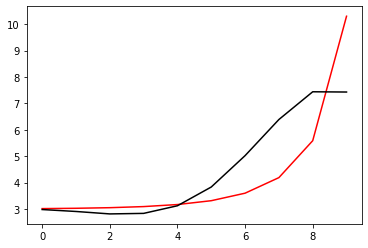

192500 0.031782916684853585
[2.88397459 2.81780252 2.73850696 2.77451919 3.08482147 3.83322599
 5.11863303 6.73194483 7.84067294 7.79386449]


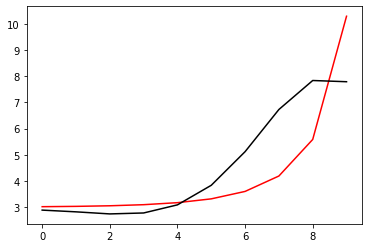

193600 0.007611192835972423
[3.00741114 2.89549821 2.77003334 2.75673301 3.00897466 3.67818131
 4.8340912  6.17779815 7.01293132 6.98950886]


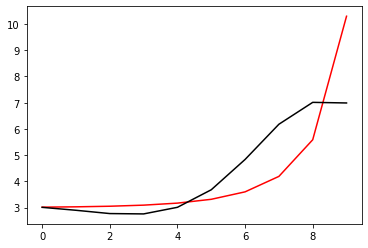

194700 0.011786178139563529
[3.02044967 2.91645403 2.79941221 2.79503481 3.05749873 3.74081339
 4.91979996 6.30835392 7.20645087 7.1710572 ]


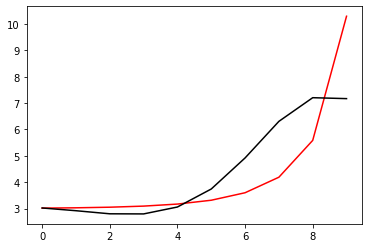

195800 0.016882928774751987
[3.04116889 2.95551378 2.85864122 2.87576885 3.16276646 3.87861043
 5.10700064 6.5792335  7.57989225 7.46524298]


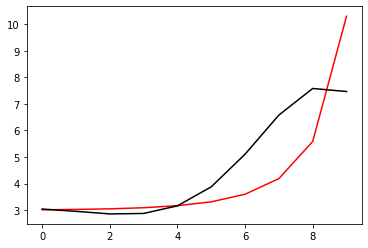

196900 0.021799579881281284
[2.9502822  2.84146936 2.72162116 2.71248326 2.96621758 3.63547268
 4.79217442 6.17183276 7.12478616 7.10480188]


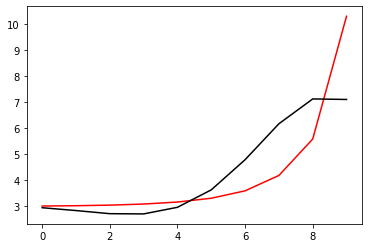

198000 0.05993579466444653
[3.08536694 2.9767201  2.85817559 2.85191893 3.11018915 3.78705967
 4.95761141 6.36685538 7.35680671 7.35488261]


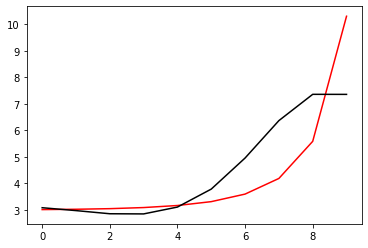

199100 0.010560362557399658
[3.0361377  2.88154944 2.71661752 2.66223714 2.86616038 3.47215215
 4.52978785 5.75113147 6.60652735 6.6262706 ]


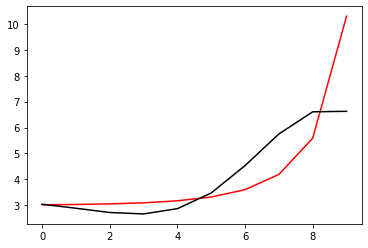

200200 0.02318483629859989
[3.13204281 2.97252461 2.80231875 2.7435833  2.94416904 3.54843865
 4.60774789 5.83993774 6.71288922 6.66354116]


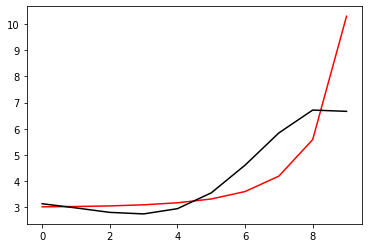

201300 0.011494025080302105
[3.10577213 2.95951409 2.80261595 2.7594186  2.97924918 3.61021571
 4.71067419 6.00943002 6.96250833 6.95625825]


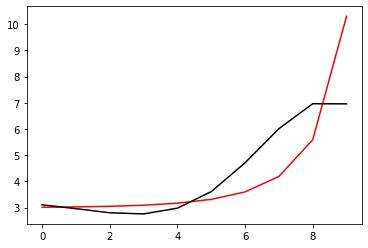

202400 0.00341943618448713
[3.0432747  2.93299155 2.80986727 2.7975446  3.04377266 3.69555801
 4.81119672 6.12607074 7.0885312  7.01899752]


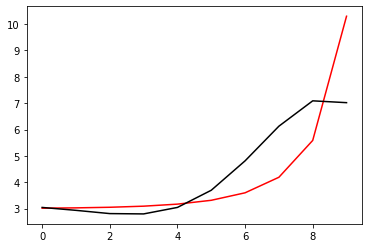

203500 0.017315195325668685
[2.94175719 2.84083076 2.73139334 2.73680899 3.00678745 3.69434209
 4.87227138 6.30227069 7.4057241  7.38605705]


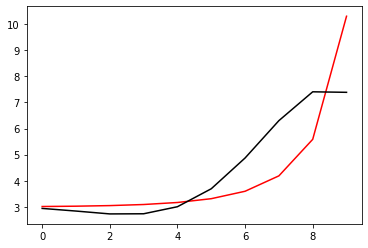

204600 0.0013905762044347592
[3.05498391 2.9387714  2.81138033 2.79450131 3.03379124 3.67357833
 4.76794811 6.05174275 7.00619512 6.9633344 ]


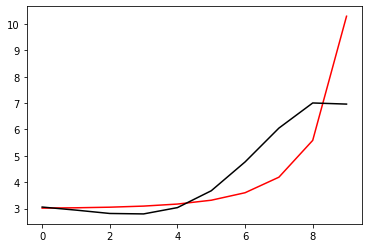

205700 0.010697833004138615
[3.09348867 2.9777554  2.85285524 2.84097713 3.08897726 3.74456386
 4.86998109 6.21654005 7.24403679 7.24091503]


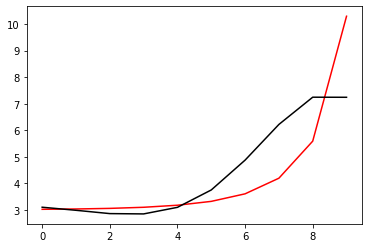

206800 0.24386964156746477
[2.8140484  2.69901694 2.57681965 2.56872849 2.82082003 3.4806113
 4.61029235 5.95936474 6.9605878  7.21360974]


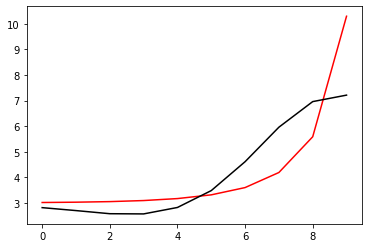

207900 0.010704645095071076
[3.06536875 2.95114927 2.8273733  2.81412226 3.05458887 3.68946865
 4.76467709 6.00247063 6.85126811 6.8466419 ]


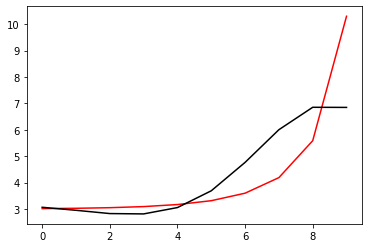

209000 0.06056889806209684
[3.062564   2.95361326 2.83491161 2.82693031 3.07369239 3.71807482
 4.81161292 6.08479932 6.95949055 6.96161514]


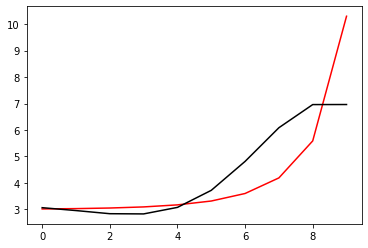

210100 0.010665771487749958
[3.05712353 2.95691626 2.84689735 2.84789695 3.10531803 3.76565079
 4.88949778 6.21974795 7.13611819 7.13791865]


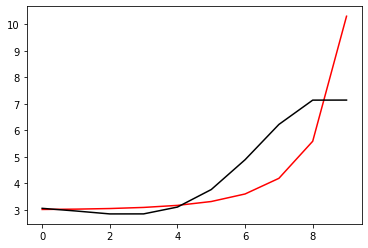

211200 0.010087688773519078
[2.97275101 2.8917556  2.80246194 2.82593424 3.11104622 3.8132511
 5.01423668 6.47943182 7.49866304 7.45524283]


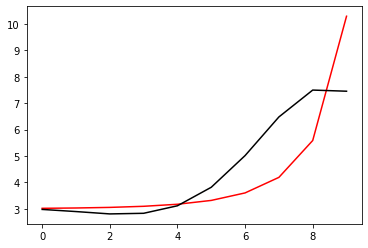

212300 0.010762931473697909
[3.03492607 2.90656946 2.76772023 2.73622619 2.95474657 3.56447939
 4.61398877 5.81413836 6.62645516 6.64049398]


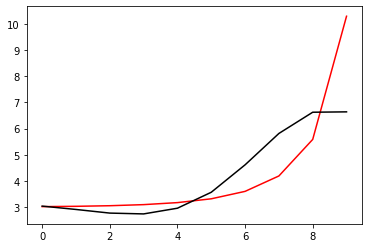

213400 0.004868034902010573
[3.05282726 2.93149652 2.79942564 2.77515359 3.00194911 3.6225973
 4.68911037 5.91977483 6.77290137 6.73034286]


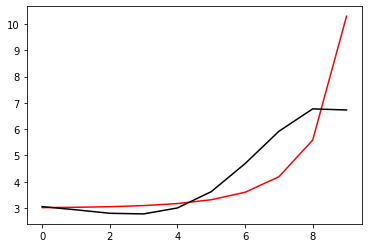

214500 0.00427528428889871
[3.01455279 2.90442978 2.78473073 2.77495689 3.02003593 3.66663513
 4.77443942 6.07485307 7.01645693 7.01417487]


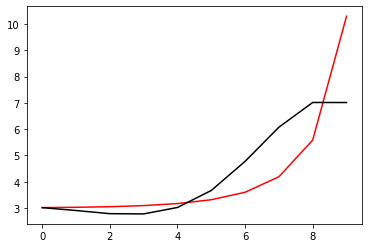

215600 0.06007467775514709
[3.13920199 3.03191106 2.91672199 2.91232581 3.16365971 3.81837811
 4.93984725 6.27273638 7.25884104 7.2858093 ]


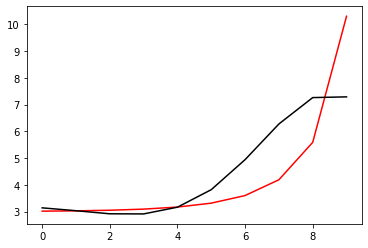

216700 0.010784532695585138
[3.04319038 2.95209912 2.84932987 2.85163122 3.10064715 3.7366247
 4.80265187 5.9846507  6.73600352 6.73102758]


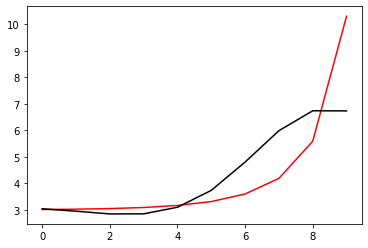

217800 0.021307697615637285
[3.0347475  2.95309092 2.86138936 2.87664756 3.14319059 3.80949187
 4.94567061 6.28100948 7.0422771  6.96845351]


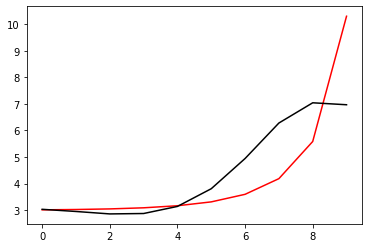

218900 0.007110276045699615
[3.00117238 2.89609699 2.78182059 2.7725832  3.00919072 3.63430307
 4.71123744 5.95646961 6.54799072 6.62728393]


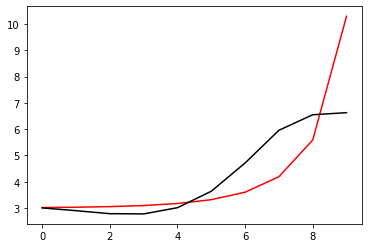

220000 0.060396587200977486
[2.99524344 2.89510631 2.78557003 2.78121336 3.02351581 3.65693108
 4.7488732  6.0228511  6.64353209 6.64302575]


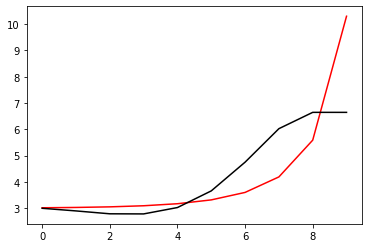

221100 0.010635685492480442
[3.05161659 2.95888024 2.85714328 2.86141162 3.11443326 3.76373917
 4.88249781 6.19908706 6.84755132 6.84673534]


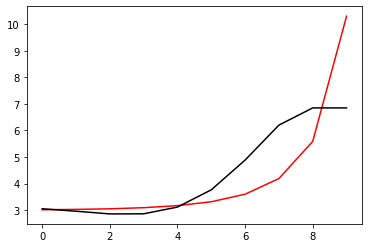

222200 0.011224991438590988
[2.97615421 2.89698844 2.81051594 2.83206261 3.10705388 3.79014818
 4.97054912 6.39968145 7.16195802 7.09617992]


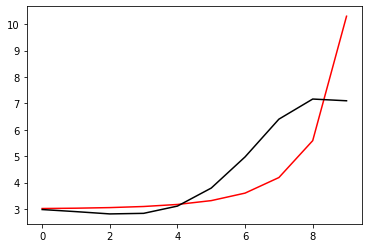

223300 0.010800825972059414
[3.02488712 2.89487001 2.75609258 2.72082523 2.92794225 3.5177299
 4.54794942 5.72465467 6.27890781 6.28067822]


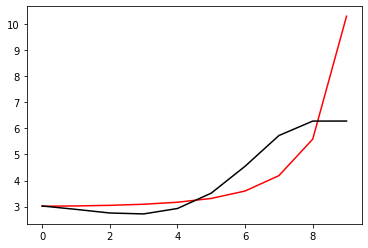

224400 0.008126623618840222
[3.10351135 2.9667551  2.82226392 2.78355548 2.99023711 3.5843123
 4.62708262 5.83219898 6.42812948 6.41480078]


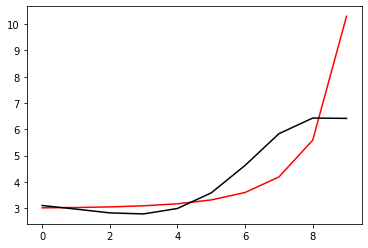

225500 0.005522886783684277
[3.04143697 2.91458168 2.78095746 2.75603917 2.98144881 3.60412241
 4.6951194  5.98353035 6.68538126 6.68201599]


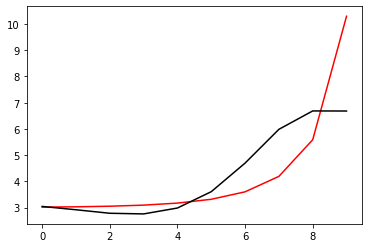

226600 0.00833064362446873
[2.99904983 2.8875101  2.77043778 2.76475213 3.01402086 3.67030956
 4.81513901 6.19528398 7.0067503  7.01008029]


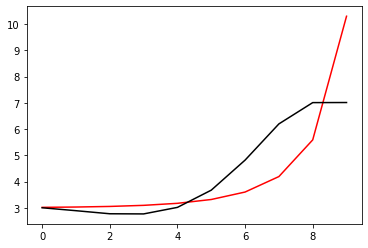

227700 0.11888763031699862
[2.86986805 2.74609891 2.61871399 2.60381068 2.84370816 3.48758019
 4.60625953 5.93206618 6.72194459 7.10960765]


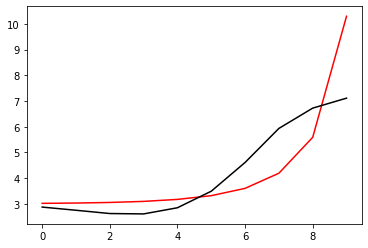

228800 0.02961017237754782
[3.0502943  2.9130006  2.77167142 2.74271532 2.96713655 3.59203549
 4.68619741 5.98477893 6.74835387 6.73700385]


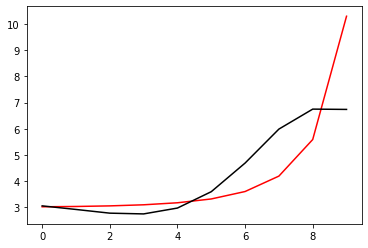

229900 0.010690030159361092
[3.10550552 2.98356194 2.85507876 2.83794587 3.07374005 3.71091624
 4.82169295 6.15096923 6.96086983 6.97224115]


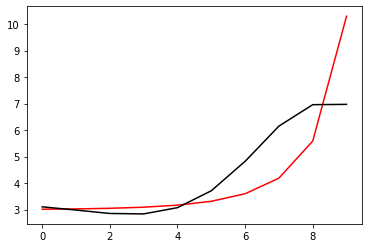

231000 0.06064099825527477
[3.17278949 2.99774619 2.81843869 2.75298912 2.94086663 3.52589374
 4.57360564 5.83075292 6.57768799 6.58915334]


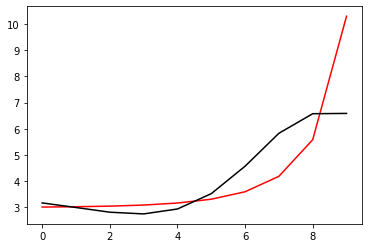

232100 0.010670449055407316
[3.16562111 2.99959352 2.82776606 2.77043166 2.96788537 3.5657794
 4.63363014 5.9263706  6.72441651 6.72475993]


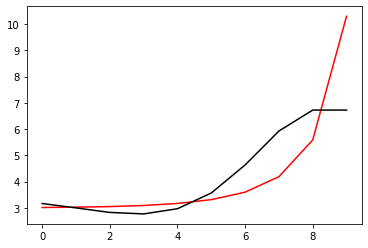

233200 0.016707015066716988
[3.10689145 2.95778422 2.80278495 2.76563896 2.98947602 3.62542525
 4.75286784 6.14025651 7.05674031 6.9719852 ]


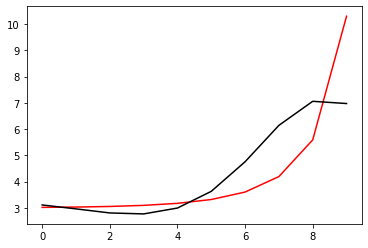

234300 0.010847982681333228
[3.04928349 2.92432707 2.7920544  2.77878192 3.03018946 3.70220993
 4.88362562 6.35769601 7.37753675 7.42105272]


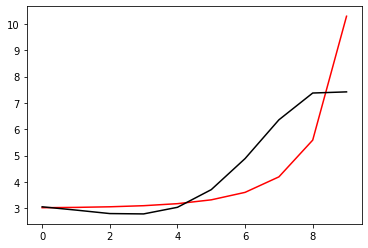

235400 0.005540877028200145
[3.11474499 2.94655874 2.77166329 2.71641191 2.92376994 3.54217244
 4.64278272 5.99199682 6.91342593 6.88938113]


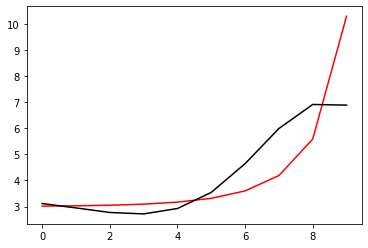

236500 0.004639569410383681
[3.0736613  2.91869573 2.75607556 2.71466302 2.93947976 3.58256128
 4.72177435 6.13335256 7.13427698 7.12834215]


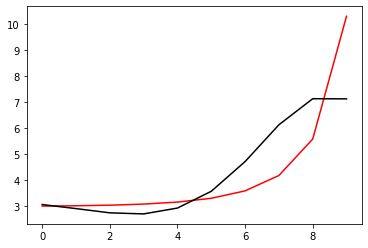

237600 0.7046595025691841
[3.36524711 3.21704441 3.05885752 3.02058372 3.24717542 3.88765436
 5.0063099  6.34170554 7.2400379  7.3939718 ]


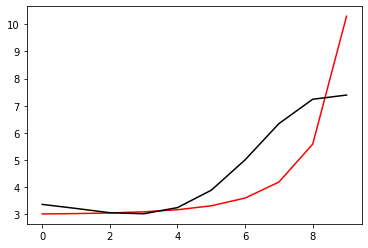

238700 0.029900752121832064
[3.09186281 2.90883508 2.71291733 2.63327933 2.81105774 3.38747716
 4.41739217 5.66006415 6.55537427 6.55140737]


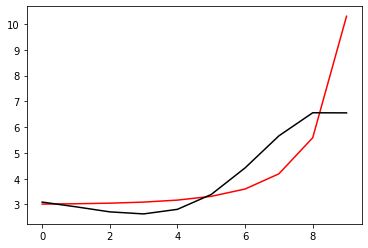

239800 0.030258453823337587
[3.09470188 2.91327914 2.71746555 2.63793867 2.81624731 3.39433072
 4.43013373 5.69217908 6.62120904 6.61790533]


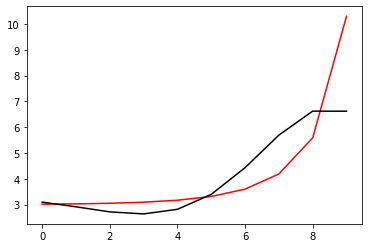

240900 0.010811558700111724
[3.18462961 3.01408776 2.82848698 2.76075749 2.95427832 3.55432255
 4.62625411 5.9502907  6.94952947 6.96094576]


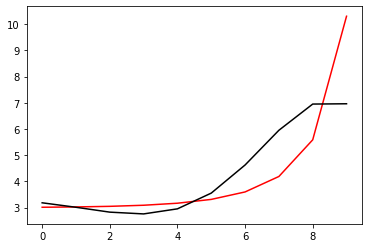

242000 0.06067460325654919
[3.13856401 2.98070695 2.80835126 2.7581194  2.97836076 3.62351346
 4.77711348 6.23915387 7.3853543  7.37883201]


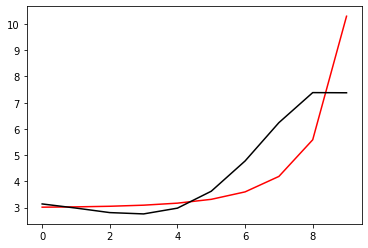

243100 0.010800069620744113
[3.16644995 2.96586771 2.75251246 2.66506849 2.85298101 3.46964819
 4.5873386  5.96214767 7.03994941 7.03869064]


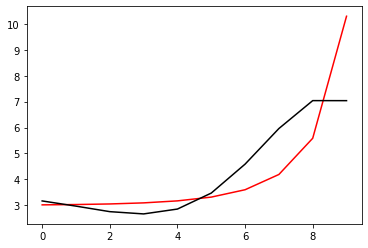

244200 0.016709969991622144
[3.1706103  2.98487524 2.78467949 2.7113036  2.91629905 3.55636163
 4.70971611 6.14176528 7.28957479 7.21427387]


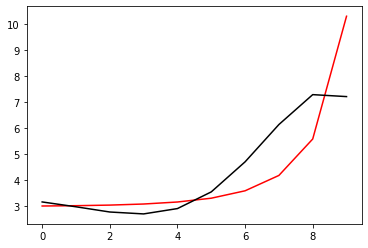

245300 0.010976726938224294
[3.09012069 2.9454148  2.7820934  2.74109248 2.97320058 3.63348257
 4.79751034 6.22971331 7.36057534 7.35433081]


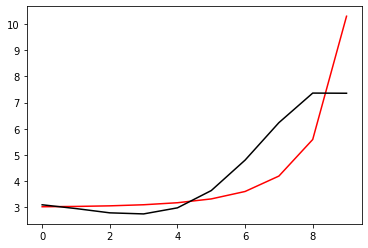

246400 0.0015685356338795975
[3.0474931  2.91827603 2.77215984 2.75005442 3.00585935 3.70102329
 4.92592155 6.46621333 7.70337473 7.68386212]


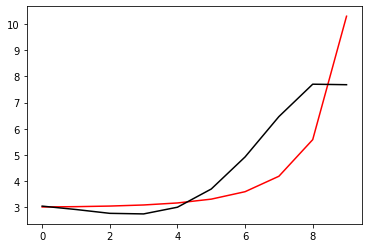

247500 0.009776989139390265
[3.1191585  2.9544002  2.77349224 2.71580121 2.93181457 3.57473044
 4.71781122 6.12316239 7.18605102 7.17899955]


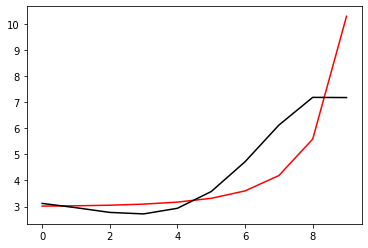

248600 0.0010629608509428038
[3.11343408 2.95734575 2.7844369  2.73494386 2.96084737 3.61824899
 4.78721083 6.24227703 7.36317578 7.35614602]


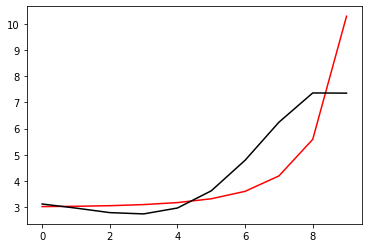

249700 0.010852649279699493
[3.09990459 2.95853347 2.79977642 2.76466613 3.00753526 3.68906082
 4.89973244 6.43139311 7.63600158 7.65941582]


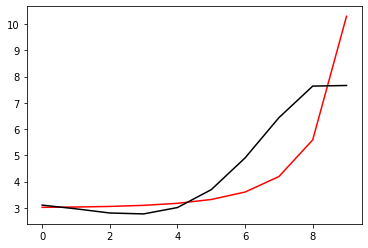

250800 0.023944825564568714
[3.14538016 2.98838156 2.81261032 2.75777724 2.97744028 3.62906313
 4.7965517  6.26492832 7.41845172 7.40543682]


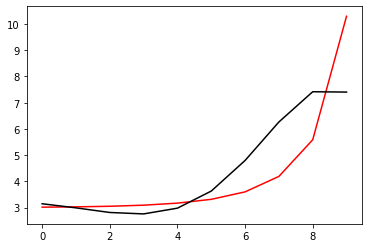

251900 0.010847812798620205
[3.12615254 2.9847383  2.82519295 2.78794063 3.02860057 3.70863535
 4.91949409 6.45680537 7.68838384 7.69156769]


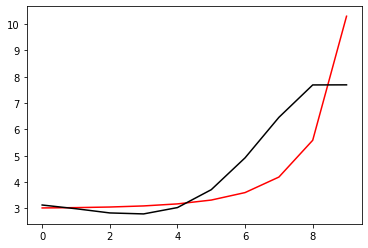

253000 0.06069201855598734
[3.108413   2.93495727 2.74378613 2.6738037  2.87801274 3.51172082
 4.65535912 6.09829488 7.22868126 7.23436159]


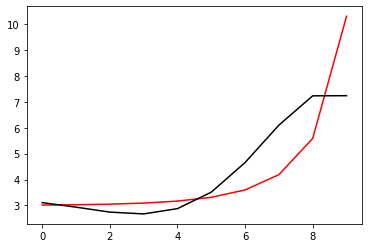

254100 0.01079884356512783
[3.14031717 2.97564982 2.79174525 2.72862164 2.94036351 3.58414528
 4.74433306 6.21807101 7.38929346 7.38995876]


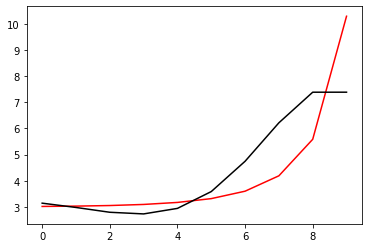

255200 0.01081749479879532
[3.09050172 2.94243238 2.77439836 2.72787437 2.95972125 3.63242594
 4.84114216 6.40004999 7.67946128 7.61807937]


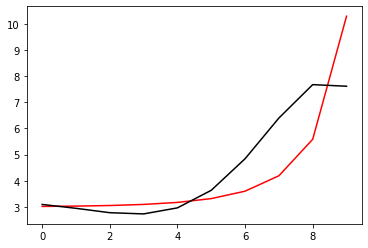

256300 0.012007767663804141
[3.11021226 2.97773664 2.82081525 2.77852957 3.00342615 3.64675159
 4.76728063 6.05117713 7.08355524 7.04753534]


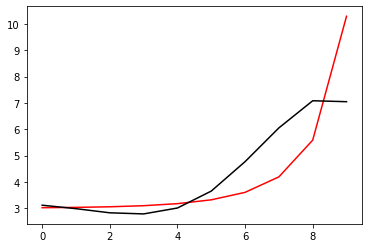

257400 0.003980683476820832
[3.08037687 2.95459854 2.8049595  2.77049224 3.00561    3.6670002
 4.83515299 6.26206616 7.28994547 7.265827  ]


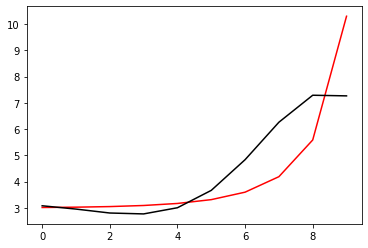

258500 0.001233577484798689
[3.00749377 2.89014652 2.7500916  2.72548618 2.97273973 3.65476206
 4.87746864 6.4703726  7.54028097 7.52201132]


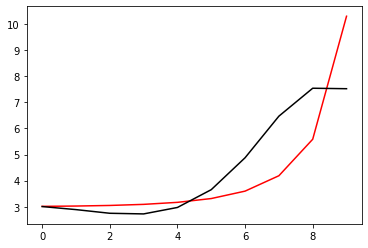

259600 0.0011901059568842443
[3.06263837 2.9663956  2.85083859 2.85292205 3.1343702  3.87280769
 5.21422016 6.99225224 8.00973928 7.91224587]


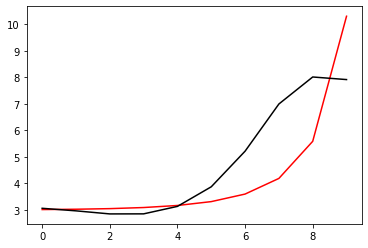

260700 0.010811290712476248
[3.02179782 2.93580684 2.82733453 2.82847904 3.09576896 3.79534253
 5.04289215 6.61071118 7.3651617  7.3770534 ]


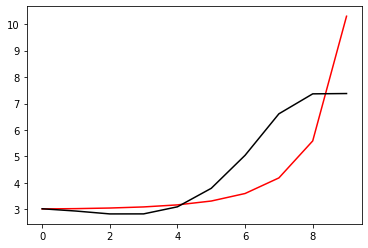

261800 0.01749288418345645
[3.00792135 2.92915598 2.82919254 2.83932034 3.1177613  3.83530496
 5.11952253 6.75619106 7.54405806 7.47127378]


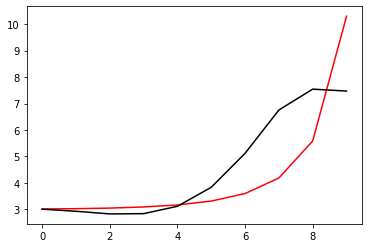

262900 0.010895350949122787
[2.99437603 2.92615625 2.83915731 2.86294678 3.15817576 3.90244271
 5.23945952 6.96978103 7.80646234 7.81774795]


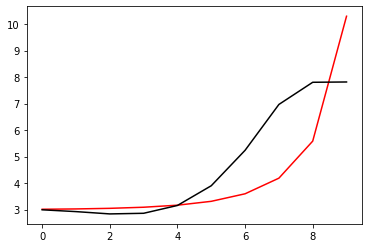

264000 0.05120954620942764
[2.99380945 2.93725142 2.86640647 2.90696389 3.2216939  3.9951605
 5.38532886 7.20492529 8.1034643  8.03634114]


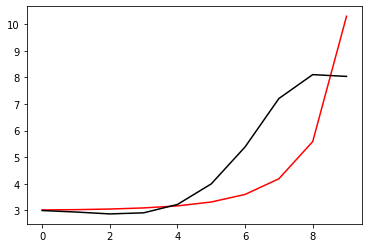

265100 0.010891236900526954
[3.03207335 2.9414636  2.83939373 2.84787745 3.12599578 3.85238706
 5.17441769 6.90304027 7.76182466 7.76031999]


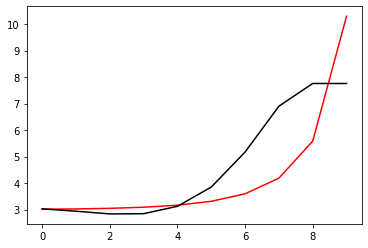

266200 0.012181832341441006
[3.06638344 2.96249543 2.84595386 2.83564294 3.08493834 3.76052023
 4.98216533 6.52150508 7.15069249 7.15924923]


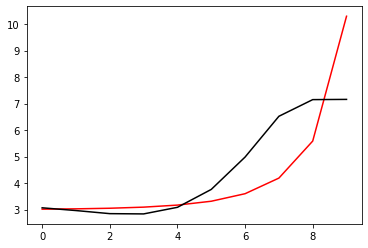

267300 0.011030437738606458
[3.04666545 2.94622727 2.83311904 2.82633725 3.07966681 3.7612168
 4.99436003 6.55867777 7.21754067 7.2101292 ]


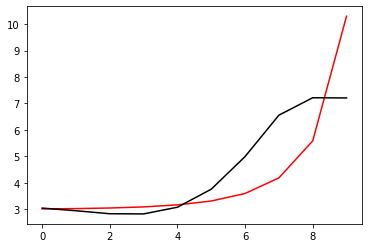

268400 0.0020393129727120703
[3.01972256 2.92534941 2.81842509 2.81805858 3.07880232 3.77132985
 5.02520409 6.63210934 7.33807237 7.32710657]


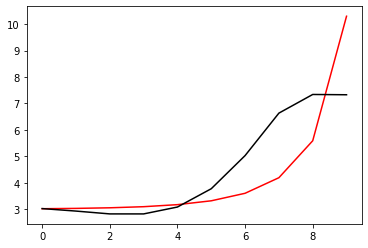

269500 0.0011548918860454188
[2.94950332 2.8643799  2.76740558 2.77755706 3.05068067 3.76190603
 5.05193676 6.7350804  7.52984066 7.51453472]


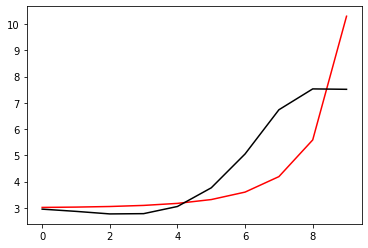

270600 0.0009515205835073319
[3.01204397 2.93687574 2.85331403 2.87933053 3.17283606 3.91549569
 5.26001267 7.02750633 7.88239584 7.83685052]


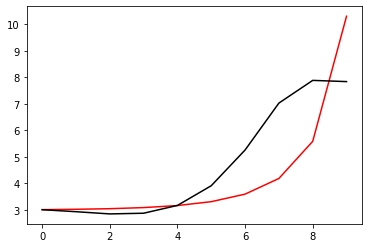

271700 0.010764895339004961
[3.02783666 2.9565563  2.87316642 2.89159118 3.16330605 3.85627736
 5.08916079 6.62329827 7.18500469 7.21487494]


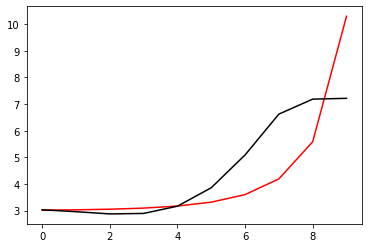

272800 0.01768993661079324
[3.00486917 2.93727805 2.85815911 2.8811646  3.15833901 3.85971679
 5.10973372 6.68134341 7.27802135 7.24182864]


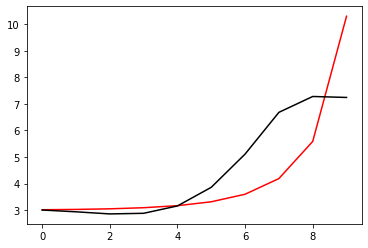

273900 0.01080181137607315
[2.98167364 2.92021749 2.84835169 2.87914557 3.165531   3.88080012
 5.15791235 6.78422572 7.42810387 7.43855045]


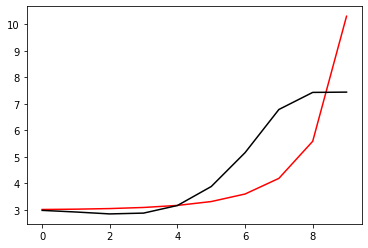

275000 0.05738963153259472
[2.97673998 2.92584681 2.86734177 2.91333017 3.21879708 3.96374458
 5.29654902 7.01809858 7.72369193 7.6858953 ]


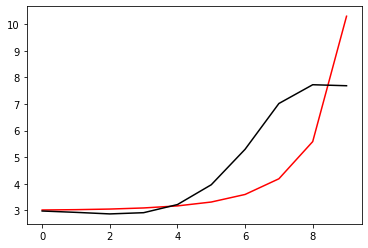

276100 0.010750446963502877
[3.04281994 2.9628124  2.87458846 2.88655383 3.14841887 3.82950033
 5.05415411 6.57666757 7.09320529 7.08721237]


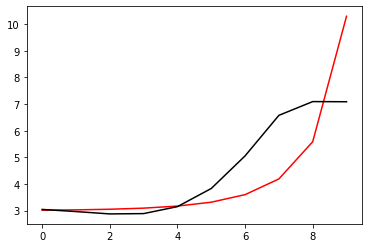

277200 0.008233049855896743
[2.97274808 2.89741615 2.81703857 2.84058038 3.1194109  3.82796296
 5.10011705 6.70505566 7.33180882 7.27130549]


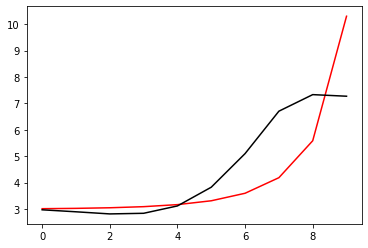

278300 0.010883434873586157
[3.02636876 2.92816844 2.82488513 2.82494449 3.07737041 3.75199815
 4.97194464 6.49751236 7.06727098 7.04735828]


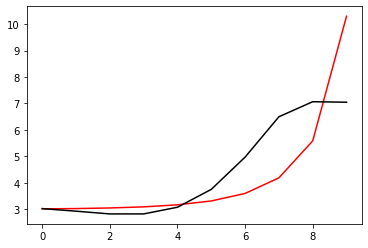

279400 0.0012525796514088893
[2.97663507 2.8887548  2.79779382 2.81289301 3.08380992 3.78353129
 5.04087522 6.62872698 7.2908418  7.28620371]


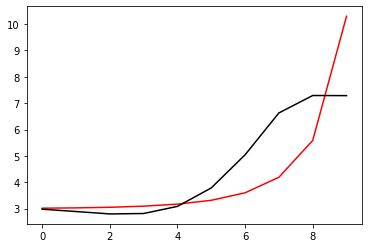

280500 0.01050412333891899
[3.10033123 2.96203049 2.81837796 2.77767707 2.98462717 3.59989022
 4.72351303 6.09671722 6.59739766 6.59031754]


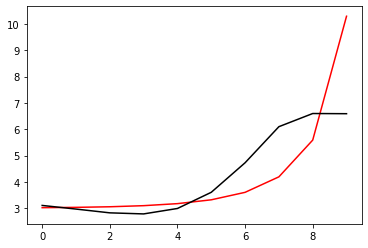

281600 0.000902257982078423
[3.08374207 2.95507482 2.82129614 2.79266884 3.01484302 3.65111626
 4.80613138 6.22877598 6.79522875 6.77132983]


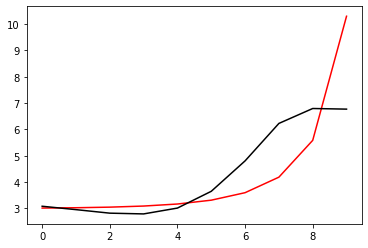

282700 0.011477425896203312
[3.046945   2.9264682  2.80185729 2.78613116 3.02671491 3.6912659
 4.89213797 6.39038859 7.05574152 7.00725192]


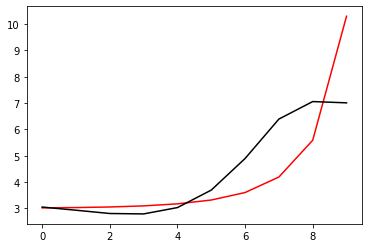

283800 0.02960007815929917
[3.05452415 2.90339536 2.74938562 2.70668855 2.92100194 3.5551944
 4.70625215 6.11844028 6.74300131 6.8545988 ]


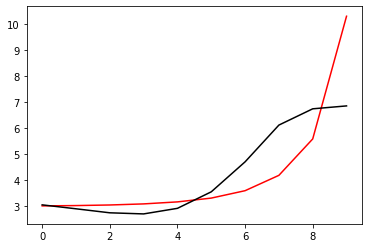

284900 0.010800696247479768
[3.06187534 2.91889591 2.77141013 2.73569884 2.95804663 3.60268144
 4.76967247 6.21108974 6.88218256 6.88058651]


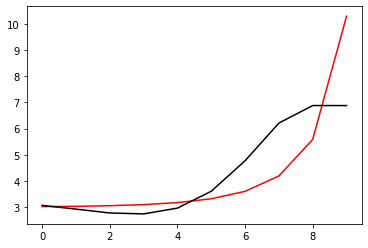

286000 0.06007741906426153
[3.10515477 2.98563715 2.85880304 2.84273747 3.08414014 3.74843198
 4.93896914 6.41816208 7.14711309 7.13995302]


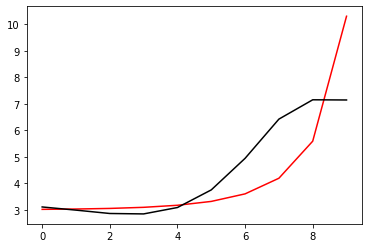

287100 0.010558541298002684
[3.01768519 2.86051275 2.69778459 2.64765404 2.85458231 3.47864249
 4.61291276 6.01655002 6.69467872 6.69304075]


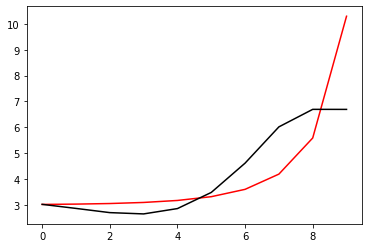

288200 0.016287860598309303
[3.06736586 2.91325809 2.75181596 2.70313381 2.91203293 3.53919955
 4.67971033 6.09910235 6.80815763 6.77349952]


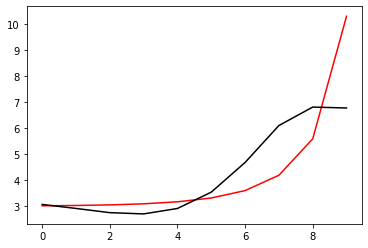

289300 0.011031411138485835
[3.07933281 2.94352126 2.79768024 2.76422773 2.98925448 3.63563008
 4.80336416 6.26909749 7.04960532 7.07262272]


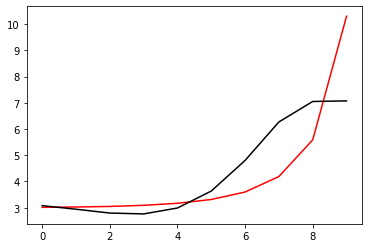

290400 0.0038192981667317005
[3.08316038 2.9339109  2.77434753 2.72806114 2.94080753 3.57440625
 4.72952817 6.19406497 7.00063916 6.96764424]


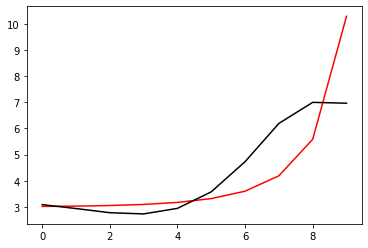

291500 0.023979744771471936
[2.98371794 2.84274911 2.69299293 2.66132205 2.89761473 3.57163884
 4.80045735 6.39591417 7.37423763 7.33264339]


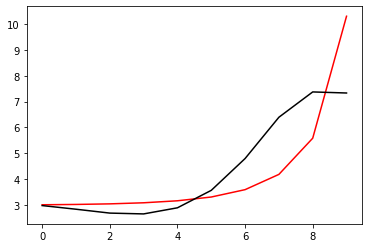

292600 0.010718256365838192
[3.08509695 2.90413285 2.70974406 2.62713054 2.79981771 3.38166246
 4.45024762 5.74312365 6.46056323 6.45863797]


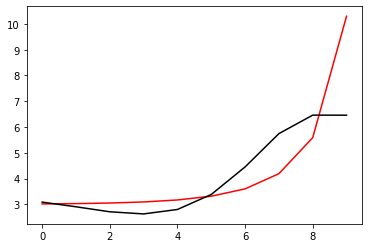

293700 0.010954537216496403
[3.18871424 3.00827428 2.81361807 2.73207691 2.90820395 3.49732326
 4.58012519 5.9010789  6.6578033  6.63458497]


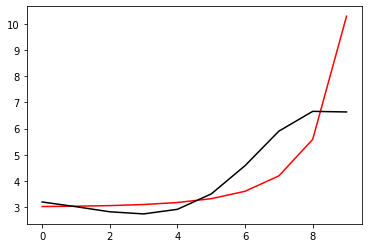

294800 0.0293904960820332
[3.13159981 2.96403393 2.78230937 2.7173472  2.9171627  3.54308732
 4.6865906  6.10573085 6.98030874 6.97556673]


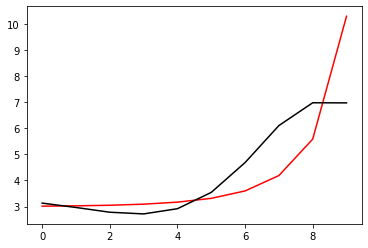

295900 0.011663254657883492
[3.15469426 2.96339181 2.75590372 2.66517099 2.83909017 3.43558496
 4.53544649 5.88293613 6.71061419 6.69849596]


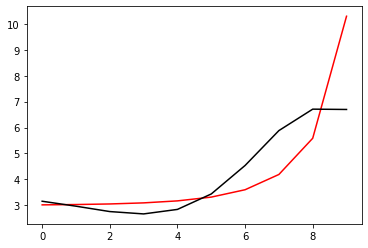

297000 0.06074159145076111
[3.1449376  2.96605681 2.76887917 2.68872957 2.87505568 3.48810914
 4.61364124 6.00588074 6.89360455 6.89486905]


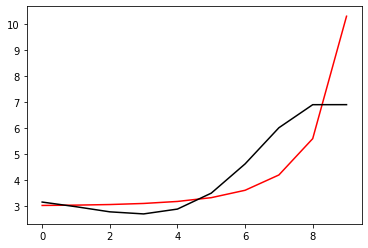

298100 0.010755216462382691
[3.15811434 3.00470142 2.82966115 2.76966553 2.97551036 3.60915576
 4.76113923 6.19860379 7.14638182 7.14497403]


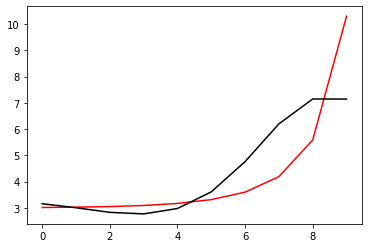

299200 0.019962857946189974
[3.10329532 2.90708477 2.68877051 2.5847845  2.74350554 3.31836315
 4.37862687 5.66780362 6.51335603 6.51111353]


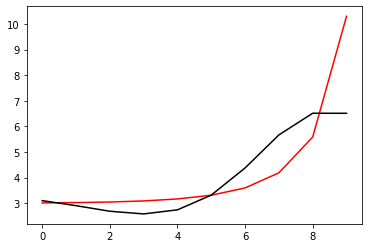

300300 0.013831976677065733
[3.19739268 2.99579415 2.77012949 2.6583556  2.80905306 3.37522617
 4.42668436 5.71351269 6.56639577 6.5222813 ]


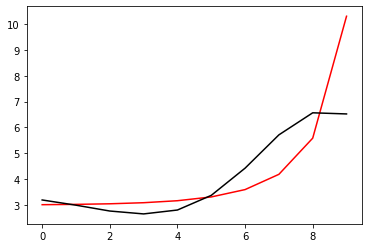

301400 0.006475753617799104
[3.15488185 2.97132967 2.76433125 2.67470213 2.85479206 3.46497484
 4.59015034 6.00038765 6.99716429 6.93501784]


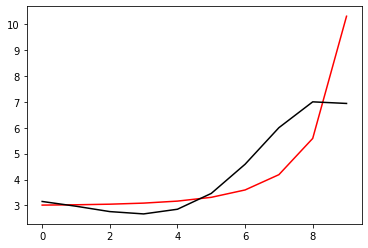

302500 0.0018433983490751692
[3.06261742 2.91502196 2.7423268  2.68448812 2.89357458 3.53015047
 4.68239366 6.12861409 7.14082654 7.11391122]


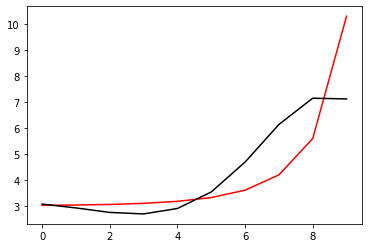

303600 0.007763345011260066
[3.03890462 2.90202431 2.74243675 2.70028786 2.93159096 3.60508746
 4.82871727 6.40951675 7.55329698 7.5580223 ]


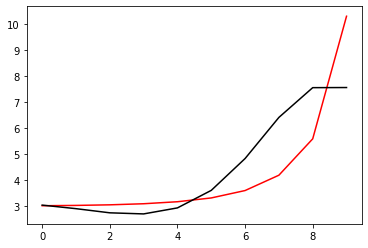

304700 0.011758679108001092
[3.09871314 2.96337109 2.80187089 2.75058257 2.9602471  3.5877893
 4.71447804 6.10109705 6.96809696 6.95521455]


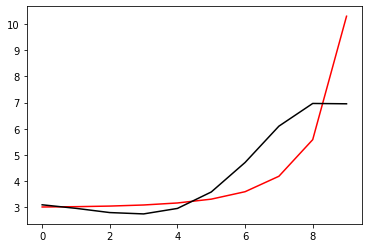

305800 0.027911348367993104
[3.09981318 2.969045   2.81209942 2.76544868 2.98075344 3.61671501
 4.75854396 6.17211584 7.06324462 7.04911161]


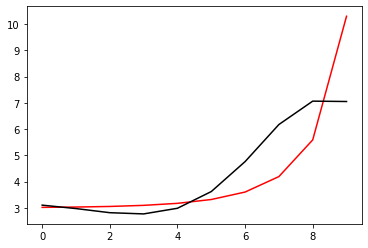

306900 0.010759464773914842
[3.0956941  2.97195024 2.82202775 2.78231805 3.00582681 3.65384055
 4.81744592 6.27101864 7.20058669 7.21020108]


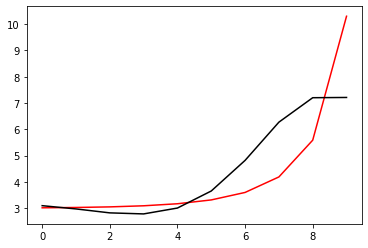

308000 0.060438901034743975
[3.08772001 2.97582477 2.83816924 2.81057806 3.04825108 3.71674872
 4.91648147 6.43390729 7.42299194 7.39989165]


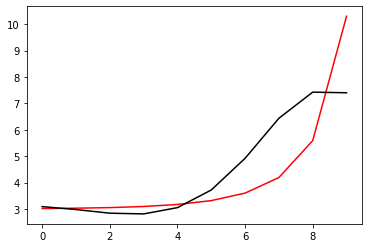

309100 0.010708285680482823
[3.12981452 2.99522004 2.83361162 2.77858809 2.98334367 3.60793576
 4.74136598 6.15810659 7.08399816 7.08620237]


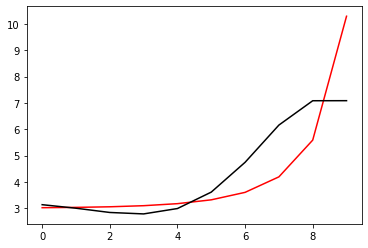

310200 0.011922871005275214
[3.06388683 2.94067042 2.79386964 2.75728618 2.98706178 3.64974777
 4.84670665 6.36551834 7.40140542 7.34651921]


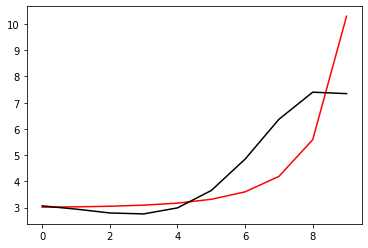

311300 0.010847939925358237
[3.08000465 2.91245282 2.72355269 2.64617713 2.83432401 3.44937764
 4.58153675 6.00551986 6.95128267 6.94855057]


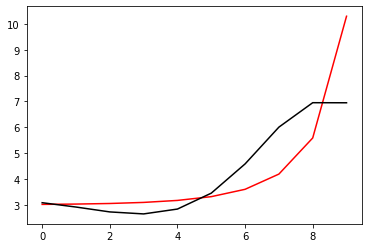

312400 0.004945728078204892
[3.10098544 2.94351919 2.76263763 2.69226819 2.88707576 3.50971318
 4.6533214  6.10044114 7.08453151 7.04722191]


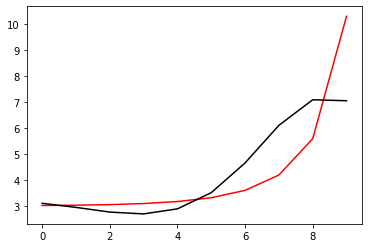

313500 0.008172029079520521
[3.08850469 2.94572904 2.77829275 2.72132346 2.9313241  3.57436393
 4.75037957 6.25566222 7.32523887 7.34836473]


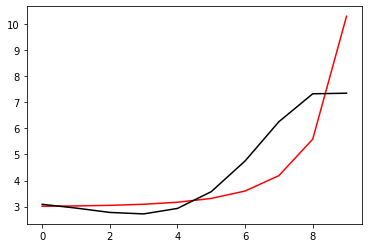

314600 0.009738807731393219
[3.07106237 2.93960979 2.78006782 2.72317371 2.91865897 3.51808235
 4.58572923 5.83571915 6.62502506 6.61865931]


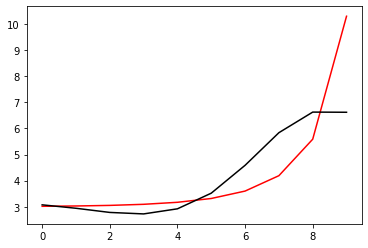

315700 0.01089478921773524
[3.10622634 2.98307049 2.83209761 2.78413766 2.99015419 3.60420696
 4.69574683 5.98855819 6.83027349 6.80765923]


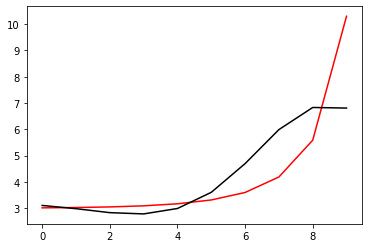

316800 0.02120178076773034
[3.10851918 3.00044502 2.86597346 2.83569416 3.06286301 3.70643185
 4.84574458 6.22044859 7.15767954 7.0928205 ]


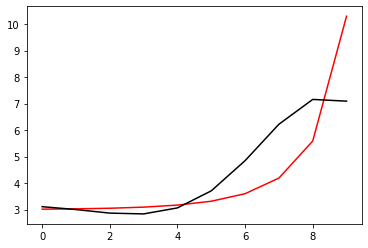

317900 0.0067756737814511905
[2.9526079  2.86017549 2.74382844 2.73171219 2.97818007 3.64596722
 4.82502514 6.28131201 7.33011768 7.47101687]


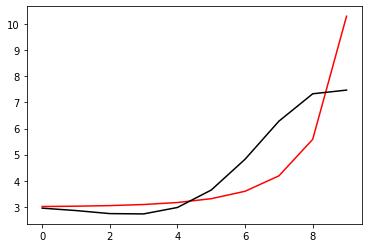

319000 0.06053065105784415
[3.11487424 2.99665649 2.85295263 2.81079149 3.02262044 3.64613869
 4.75993707 6.11788507 7.06987632 7.07211921]


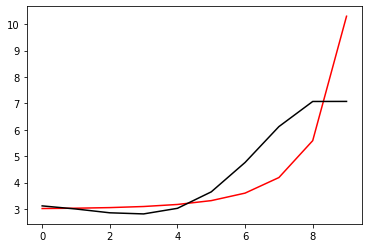

320100 0.010729831279388547
[3.07134806 2.96210016 2.8311007  2.80531807 3.03963247 3.69794212
 4.87181815 6.33525541 7.40892588 7.40772383]


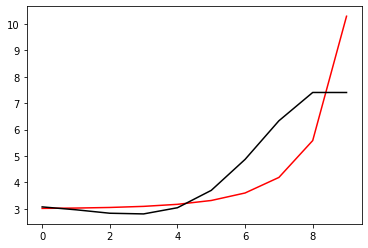

321200 0.01602159756549038
[3.040074   2.89488304 2.73136914 2.67635276 2.88421501 3.5165209
 4.65384452 6.04653581 7.07248082 7.04901513]


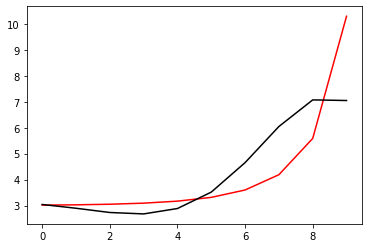

322300 0.010818319309026544
[3.05974456 2.92354354 2.7677402  2.71978984 2.93432955 3.5740213
 4.72282888 6.14119462 7.20576472 7.20315212]


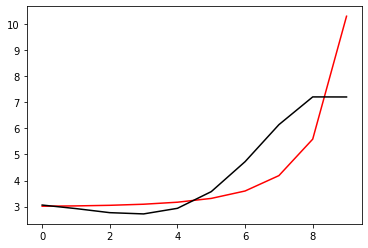

323400 0.0017395415787664031
[3.02795139 2.914351   2.78154593 2.75673917 2.99562425 3.66409094
 4.85368304 6.34089935 7.49359009 7.46930504]


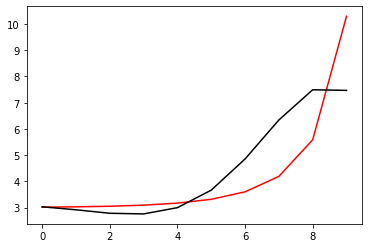

324500 0.008842797285837242
[3.11219021 2.95648094 2.78027331 2.71036066 2.89941868 3.50599753
 4.6075006  5.97373792 7.03044993 7.02312206]


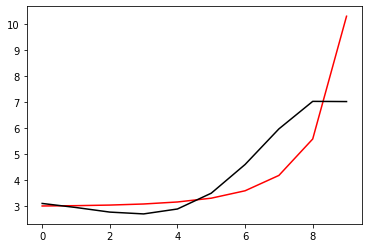

325600 0.006755834562297295
[3.06973031 2.92691856 2.76522544 2.71294851 2.92457255 3.56318413
 4.71566124 6.16491557 7.31585334 7.30046177]


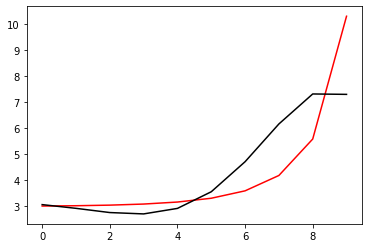

326700 0.010832183801915534
[3.0720911  2.95026475 2.81187253 2.78603086 3.0292921  3.70974058
 4.92382481 6.46528871 7.70824538 7.69535177]


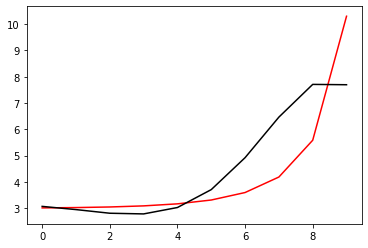

327800 0.028794276784366687
[3.06008737 2.93705195 2.79541888 2.76139654 2.98620979 3.62481333
 4.73967046 6.07772245 7.13470219 7.1803847 ]


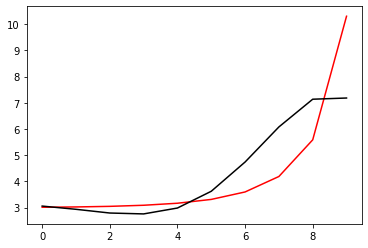

328900 0.010737599571312414
[3.07242706 2.95517445 2.81960931 2.79244098 3.02633921 3.67999312
 4.82611865 6.22094363 7.28932248 7.28430094]


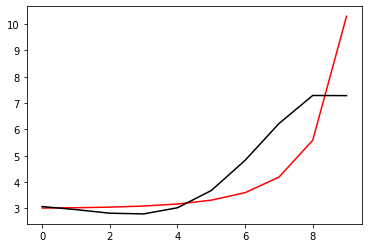

330000 0.060512871918042756
[3.06840174 2.95961031 2.8328515  2.81507312 3.06061861 3.73269927
 4.91693114 6.38509228 7.48346352 7.4858256 ]


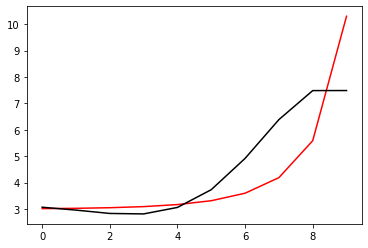

331100 0.010924603464186222
[3.06444061 2.9723871  2.86384872 2.8656566  3.13528782 3.84425251
 5.09905056 6.68607088 7.82845903 7.8441161 ]


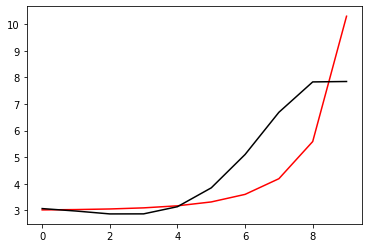

332200 0.013319497689025338
[3.08576675 2.96721769 2.83089313 2.80087643 3.03058062 3.68228982
 4.84099595 6.23204746 7.21530364 7.14109595]


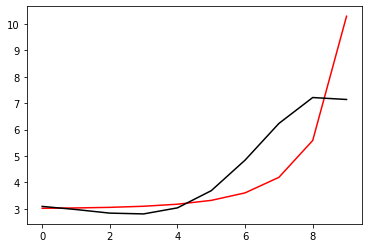

333300 0.010867195865516106
[3.04739445 2.93612367 2.80895119 2.79024345 3.0347492  3.70857873
 4.90522635 6.36562035 7.42522963 7.41974247]


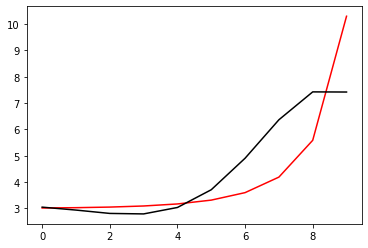

334400 0.0015109944690385867
[3.01683626 2.91970695 2.81110801 2.81538762 3.08967754 3.80645383
 5.0715541  6.64200387 7.80585695 7.77271298]


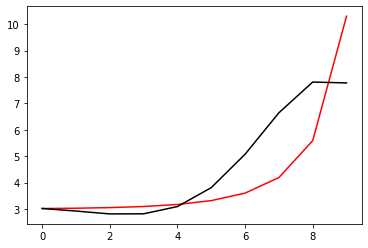

335500 0.01092444281016724
[3.04853686 2.97549918 2.88891073 2.90928826 3.18888389 3.88966334
 5.08917987 6.49216735 7.42351239 7.47887956]


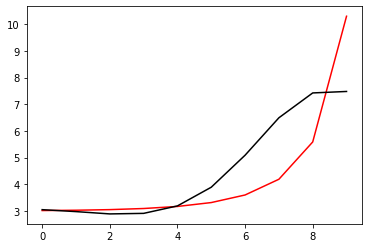

336600 0.00074334178820671
[3.01476102 2.94522169 2.86239977 2.8862303  3.1691896  3.87421886
 5.08293612 6.51460923 7.47776506 7.47871642]


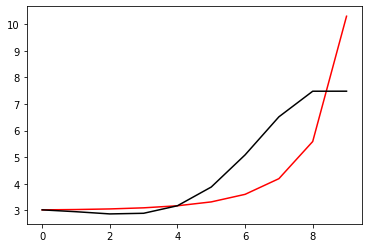

337700 0.010854690879900895
[2.96952204 2.90470782 2.82740951 2.85645637 3.14466274 3.85658499
 5.08041435 6.55776112 7.56960716 7.56769848]


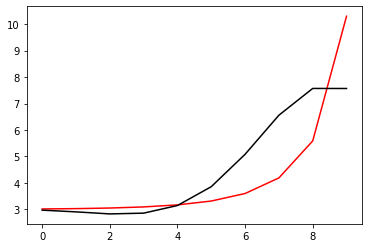

338800 0.09364428432522215
[2.83235072 2.77209584 2.69985235 2.73104617 3.01589181 3.71540258
 4.91433488 6.34796875 7.25045549 7.4864554 ]


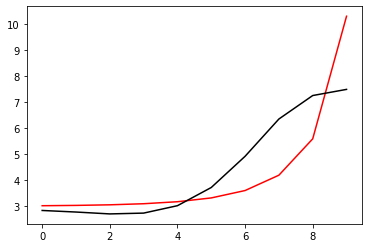

339900 0.010723703748964395
[2.97941047 2.91567396 2.84166268 2.87233372 3.15814803 3.86072664
 5.06512949 6.50283829 7.38412516 7.37371267]


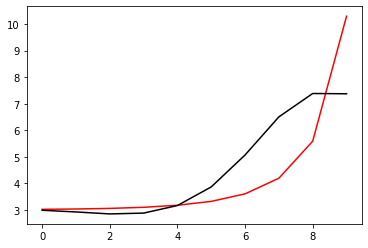

341000 0.05955315381503935
[2.98584045 2.92895674 2.86369734 2.90404536 3.20126369 3.91991764
 5.15277749 6.64691825 7.58632655 7.57912148]


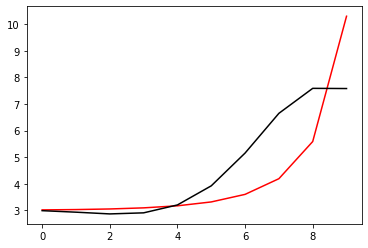

342100 0.010597121358132311
[3.01219003 2.9297255  2.83685418 2.84353934 3.09416498 3.7382404
 4.83466134 6.07495392 6.71472575 6.78697005]


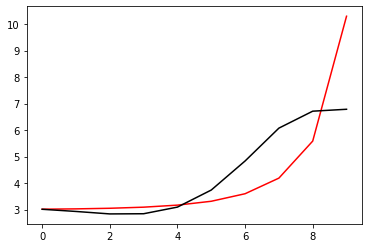

343200 0.013720168020358792
[3.01073886 2.93235836 2.84438755 2.85706859 3.11592463 3.77377157
 4.89830817 6.19326867 6.86431514 6.81070936]


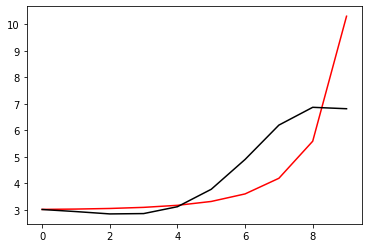

344300 0.010892872514260316
[3.00402258 2.9315428  2.85056746 2.87137853 3.14072476 3.81533857
 4.97358905 6.33531823 7.04916435 7.05215313]


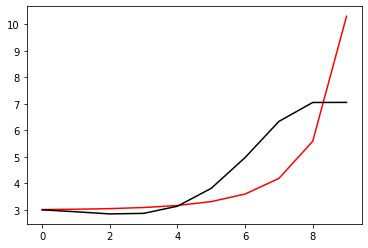

345400 0.0012438375768079107
[2.95264738 2.88959495 2.81987643 2.85309273 3.13718134 3.83364445
 5.03482101 6.48632716 7.2745667  7.25792567]


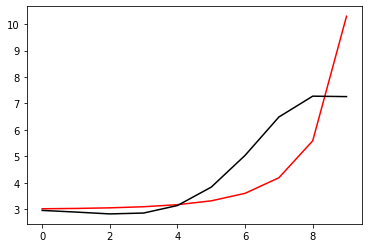

346500 0.010149958969855905
[3.04045645 2.94297318 2.83525048 2.82375626 3.04911839 3.65605292
 4.69792816 5.84814803 6.3192041  6.31053724]


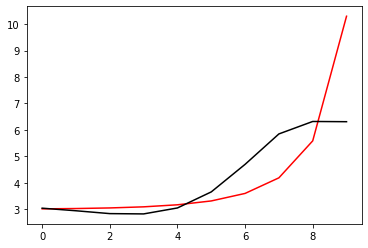

347600 0.0010362443311593757
[3.04220843 2.94993403 2.84777327 2.84273117 3.07641061 3.69639979
 4.76321845 5.96031626 6.46271004 6.4516833 ]


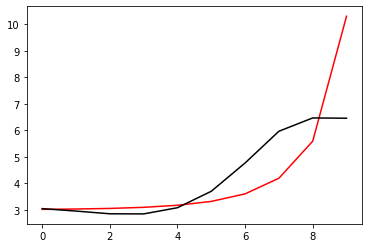

348700 0.010808132915562405
[3.03105474 2.94626804 2.85233428 2.85685233 3.10285897 3.74232736
 4.8468681  6.11629519 6.67290604 6.66507055]


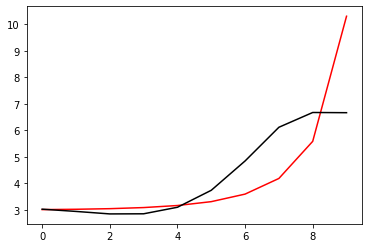

349800 0.018435226137078712
[3.04183333 2.97225587 2.89602935 2.92171541 3.19580627 3.87970278
 5.06558495 6.46675416 7.09580271 7.03270142]


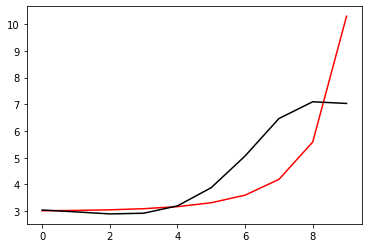

350900 0.002397344368796621
[2.96740206 2.87723489 2.77742936 2.77246097 3.00132421 3.61075443
 4.66674355 5.86671717 6.2804139  6.28453051]


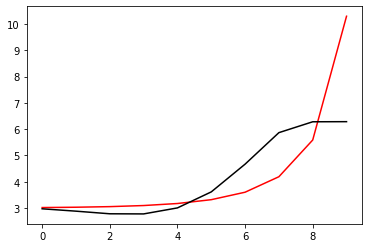

352000 0.06052765770408962
[3.01613397 2.92170729 2.81883999 2.81201842 3.04024979 3.65072454
 4.71052398 5.91926379 6.34115778 6.34416622]


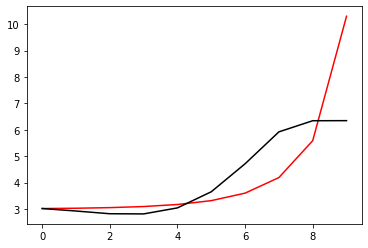

353100 0.010577664538701933
[3.04863827 2.96000436 2.8633644  2.86376693 3.10109282 3.72490781
 4.80688432 6.05121993 6.50220656 6.50180609]


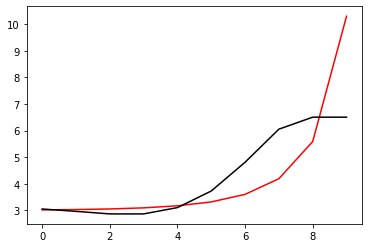

354200 0.013750466191985904
[3.00690769 2.92874847 2.84437801 2.85974766 3.11703928 3.7719644
 4.90916548 6.24774197 6.79055503 6.70401138]


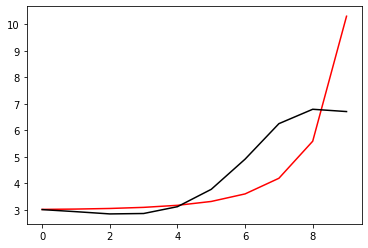

355300 0.01070360693765536
[2.93870095 2.87572077 2.80795425 2.84090701 3.11802114 3.79952183
 4.98048706 6.39757526 7.02646192 7.03298614]


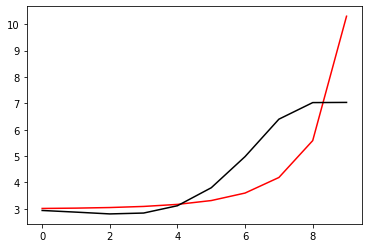

356400 0.008446912658001167
[2.99744613 2.89287369 2.78508711 2.7779346  3.01110482 3.63724851
 4.73540622 6.02366181 6.53261052 6.51363551]


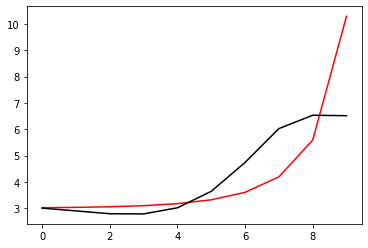

357500 0.008196504476793057
[3.00939754 2.91358377 2.81388475 2.81517892 3.05764506 3.69551886
 4.81140512 6.13233413 6.69236321 6.69133315]


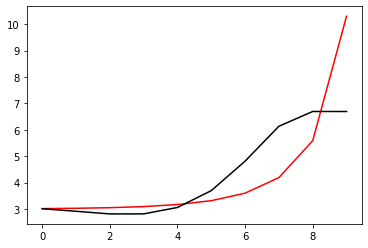

358600 0.1389850062241435
[3.15270302 3.05198392 2.94864223 2.947998   3.19009989 3.82954261
 4.95062517 6.29032813 6.8910448  6.93370054]


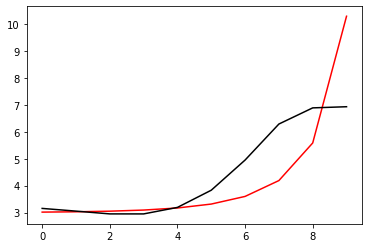

359700 0.02408372381374725
[3.00829936 2.89772929 2.78308801 2.76842634 2.99032373 3.59675805
 4.66001673 5.90394197 6.38093407 6.36003162]


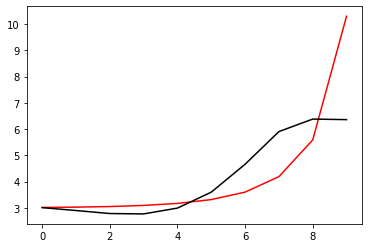

360800 0.026205703438654304
[3.08157322 2.97179996 2.85896784 2.84848136 3.07795977 3.69807998
 4.78694483 6.07616647 6.59848779 6.56997053]


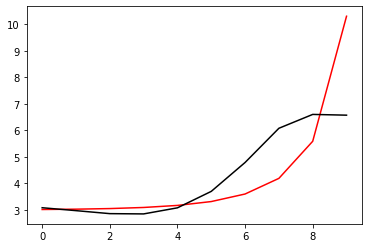

361900 0.010711949249053077
[3.07388049 2.97921451 2.88204408 2.88960709 3.14167698 3.7944217
 4.93773626 6.31808702 6.93388644 6.96833892]


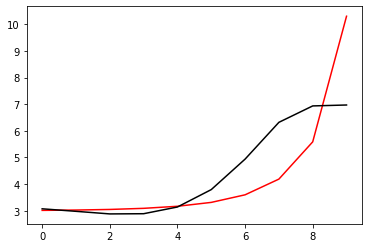

363000 0.10980155551178708
[3.07482074 3.00203504 2.92816968 2.96150696 3.24434005 3.93931841
 5.14993381 6.63907328 7.36405491 7.28188754]


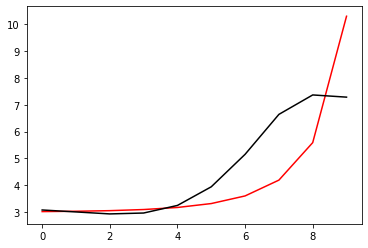

364100 0.01067917216973935
[3.07607328 2.98820685 2.897611   2.90993171 3.16181666 3.80370651
 4.91339737 6.22205659 6.73632364 6.73467699]


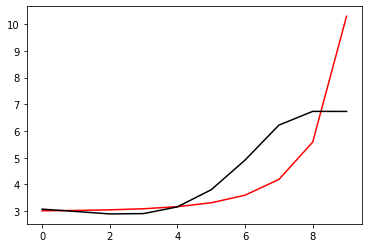

365200 0.011006988744489441
[2.9806128  2.9025052  2.82392325 2.85124311 3.12348188 3.79791905
 4.97075745 6.40495088 7.056969   6.97733002]


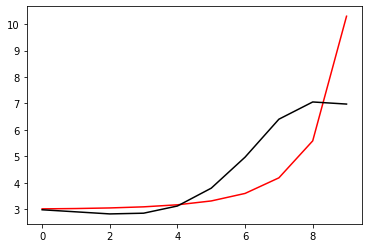

366300 0.013063485936760008
[3.09497598 2.96549609 2.83311679 2.80236934 3.00668136 3.59069995
 4.62484749 5.83262554 6.28853619 6.31596076]


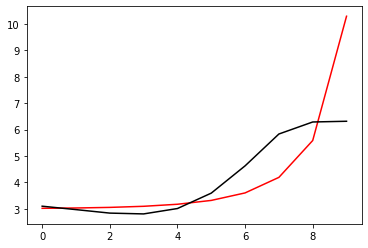

367400 0.005768004763553088
[3.05964811 2.9373787  2.81299845 2.79311441 3.0129755  3.62132361
 4.69697822 5.97722917 6.53201387 6.50095913]


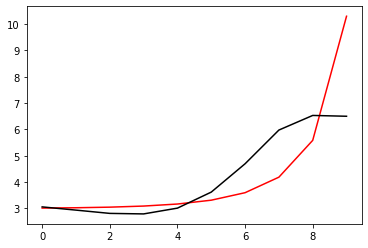

368500 0.0013754352975836339
[2.98756932 2.87743703 2.76672216 2.76437172 3.00796562 3.65163379
 4.78553798 6.16482613 6.84489892 6.83194057]


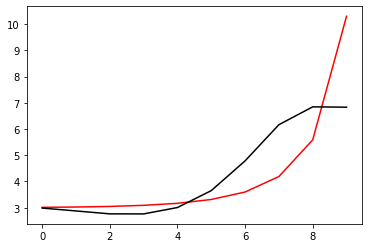

369600 0.595994690183985
[3.23001606 3.12594872 3.02190193 3.02745935 3.28009816 3.93218298
 5.06385132 6.40632698 7.05750035 7.22238771]


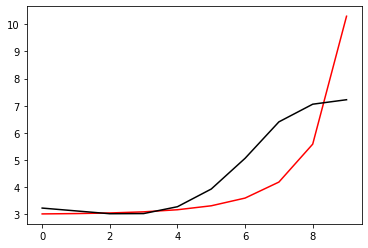

370700 0.0108102249844701
[3.09916543 2.96554538 2.83205886 2.80894712 3.03200002 3.65089133
 4.74482726 6.05670036 6.70578898 6.69377482]


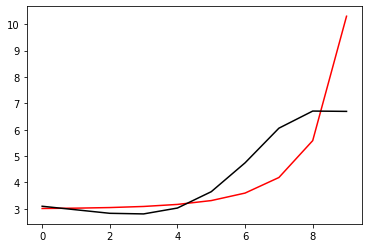

371800 0.021111718155955483
[3.0931429  2.97801557 2.86236236 2.85878756 3.10469506 3.75280992
 4.88811736 6.26320916 6.99252555 6.93628509]


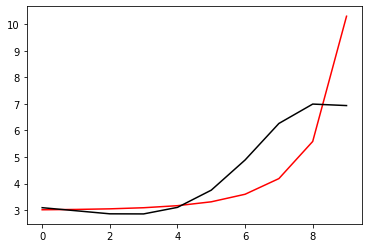

372900 0.0662380601895483
[2.94773672 2.79899775 2.6479629  2.60635697 2.80729111 3.39271573
 4.42434866 5.63855945 6.27834298 6.40452029]


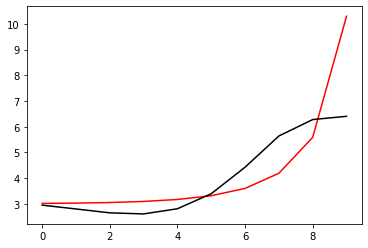

374000 0.06144985038803746
[3.19690915 3.03219628 2.86372531 2.8042964  2.98607516 3.54857749
 4.55004863 5.72659354 6.32424646 6.34592942]


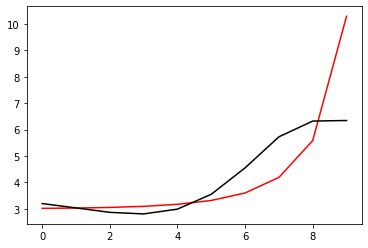

375100 0.010601608473561609
[3.15789911 3.00636525 2.84962005 2.80233125 2.99737795 3.57602927
 4.60171028 5.82252863 6.48424754 6.48433052]


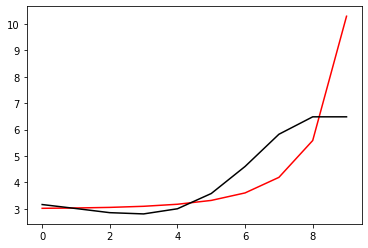

376200 0.016435872628644346
[3.07731291 2.93965178 2.79855888 2.77314582 3.00130994 3.63382046
 4.7522797  6.12575379 6.96541056 6.8261417 ]


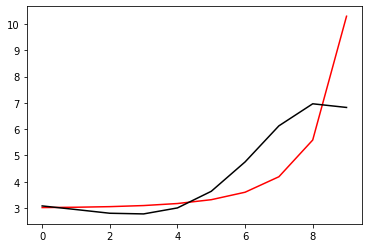

377300 0.01107110028302095
[3.09510555 2.90901318 2.71725367 2.63898499 2.80810953 3.36441285
 4.36252738 5.52392017 6.20136069 6.20279351]


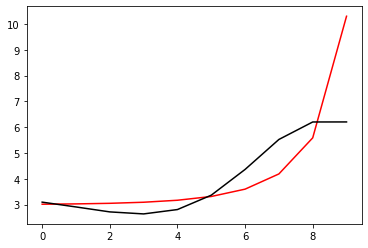

378400 0.01422039729859654
[3.09691149 2.91250007 2.72046619 2.64200535 2.81131339 3.36847991
 4.37022521 5.54614143 6.25091554 6.2418032 ]


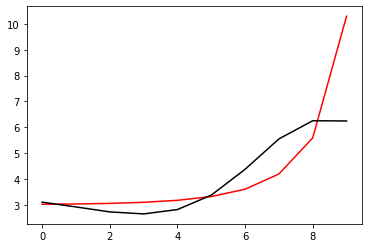

379500 0.010328803479783918
[3.16045517 2.97673783 2.78426829 2.70769752 2.88377155 3.45681183
 4.49265349 5.73669717 6.52858977 6.53562556]


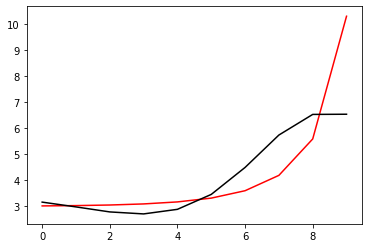

380600 0.0007500852422034408
[3.1452853  2.98846568 2.82375587 2.77991882 2.998229   3.63139076
 4.76036822 6.14044468 7.05411351 7.00606495]


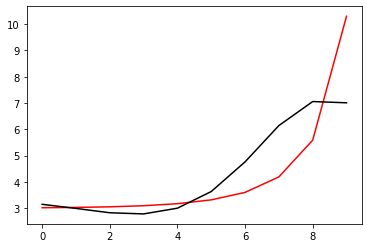

381700 0.02963430839368712
[3.04727524 2.89860516 2.73849868 2.69297516 2.89738866 3.49116493
 4.52003016 5.58343156 6.1412431  6.14785023]


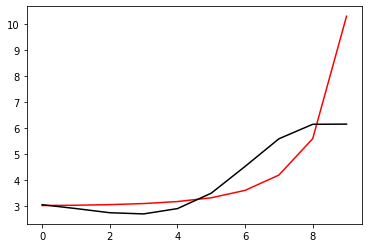

382800 0.030219563832689138
[3.04672109 2.90016238 2.74173406 2.69795982 2.90474746 3.50229786
 4.53836759 5.62017258 6.20396515 6.20031894]


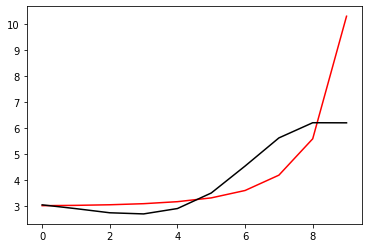

383900 0.010819850764638254
[3.14996101 3.00057223 2.84013449 2.7963834  3.00655576 3.61275568
 4.66647019 5.7849516  6.40808765 6.40680242]


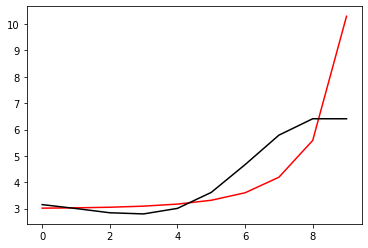

385000 0.06051413074485005
[3.12899898 2.99507985 2.85008146 2.82351548 3.05591484 3.69505305
 4.80335236 6.01835579 6.74607644 6.73906484]


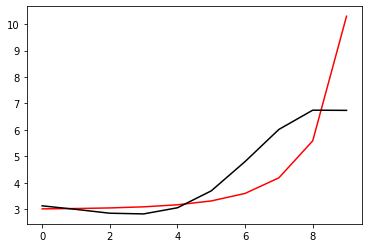

386100 0.010747076002973657
[2.95820561 2.8486749  2.72459786 2.71372595 2.95405923 3.58529871
 4.63909208 5.54282001 6.1013873  6.55793584]


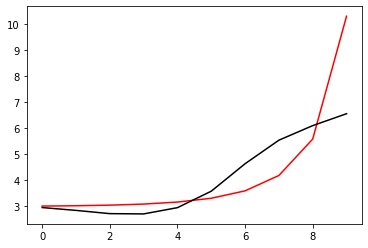

387200 0.019120305277735495
[3.00353289 2.88672207 2.75666429 2.74063332 2.97639892 3.60307851
 4.65147593 5.5548579  6.11185319 6.10116307]


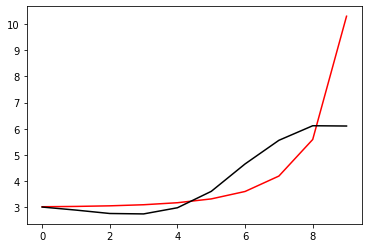

388300 0.01252633070454834
[3.07911515 2.95431899 2.8184265  2.79881979 3.03423079 3.66536061
 4.72603971 5.66153513 6.24505942 6.2178235 ]


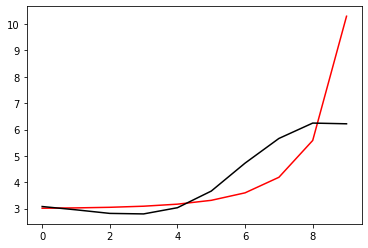

389400 0.004913783354977845
[3.03573652 2.92295234 2.800127   2.79540308 3.05046408 3.71177915
 4.82452669 5.85885301 6.53185679 6.51304578]


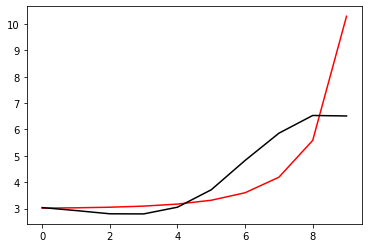

390500 0.02410417347849254
[2.92452601 2.82846106 2.72475018 2.74143264 3.02401958 3.7266262
 4.91014034 6.08244112 6.87996008 6.86372526]


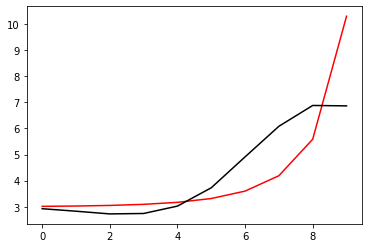

391600 0.010592734841790795
[3.03794808 2.89135283 2.73381485 2.69137805 2.90380272 3.51077212
 4.54042751 5.46096086 6.05057519 6.04789257]


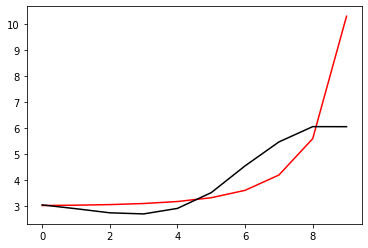

392700 0.010805686908438543
[3.1473581  3.00078991 2.84268688 2.79980443 3.01215543 3.61946569
 4.65056528 5.58870629 6.19423932 6.18745399]


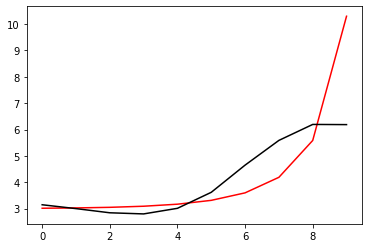

393800 0.022859121278264758
[3.14820992 3.02334838 2.88784871 2.86981967 3.1119445  3.75907599
 4.84964775 5.89397961 6.6074341  6.56694163]


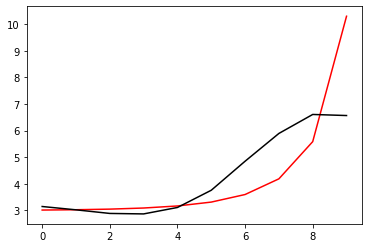

394900 0.010664087262822633
[3.07472582 2.97441624 2.86490039 2.87310145 3.14222121 3.81867336
 4.94622034 6.06731388 6.85982535 6.8978807 ]


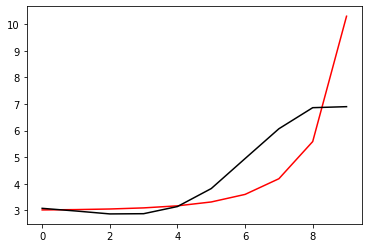

396000 0.10892392398982917
[2.96016046 2.82353519 2.6818585  2.66082721 2.90292618 3.55112174
 4.6375655  5.69472314 6.43509685 6.43791863]


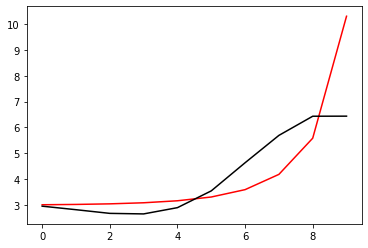

397100 0.01074572380538112
[3.18303176 3.028915   2.8685897  2.82842499 3.05019804 3.67488243
 4.73259173 5.76431674 6.47705573 6.48227546]


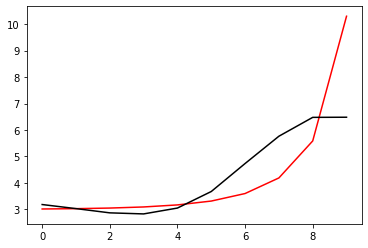

398200 0.019630889238039823
[3.11227208 2.9752656  2.83233587 2.81137337 3.05598125 3.71070522
 4.8129095  5.92384455 6.72880163 6.64406415]


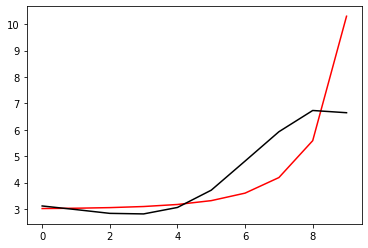

399300 0.011020909493047607
[3.05488032 2.93471652 2.81057361 2.81261415 3.08845517 3.78961096
 4.96572671 6.20437372 7.14337081 7.19197072]


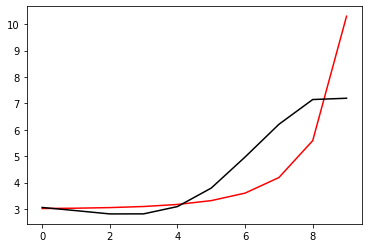

400400 0.003909768582183212
[3.06406251 2.92283969 2.7772629  2.757761   3.01082919 3.68316582
 4.81145505 5.98305565 6.8939077  6.85488266]


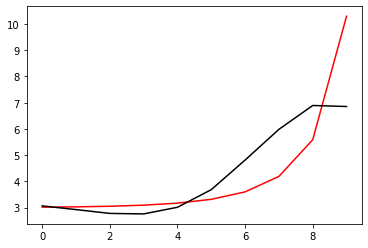

401500 0.01098912044308326
[2.96760585 2.84115477 2.7124287  2.71354545 2.99418959 3.70699667
 4.90035513 6.18437383 7.20381575 7.18064127]


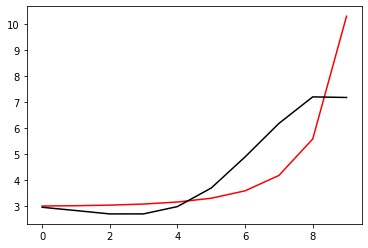

402600 0.004053302878760641
[3.10362728 2.94628797 2.78499477 2.74921939 2.98248504 3.6244599
 4.69986531 5.79966333 6.59007939 6.57095419]


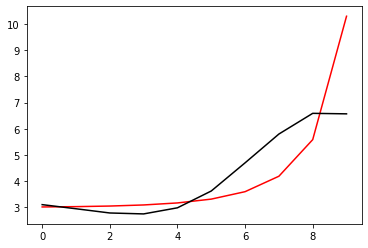

403700 0.010918262186018185
[3.11406569 2.96450448 2.80985746 2.780918   3.02239037 3.67604945
 4.7712642  5.90972297 6.74207746 6.73631892]


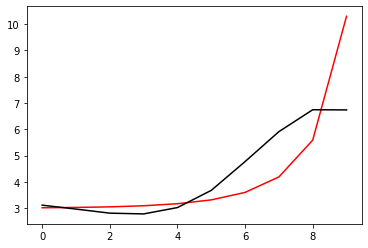

404800 0.022933815545331145
[3.10964842 2.97486641 2.83387655 2.81923664 3.07792589 3.75586209
 4.89110412 6.10228908 7.00968172 6.95632692]


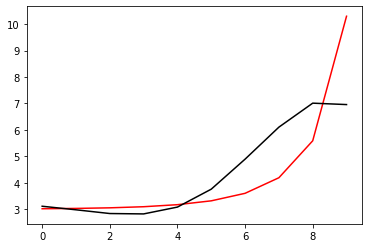

405900 0.0025597417147673364
[3.02526405 2.88283538 2.73250564 2.70603041 2.94850619 3.60179895
 4.70018863 5.87750044 6.75715022 6.73846172]


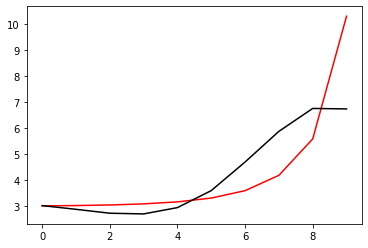

407000 0.06063234769986785
[3.04989272 2.91563805 2.77289562 2.75424857 3.00613231 3.67304594
 4.7967043  6.03381561 6.99142042 6.99150394]


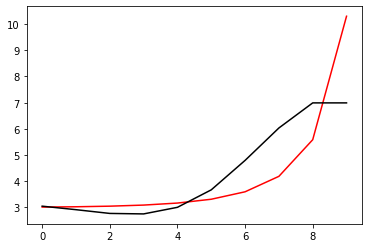

408100 0.010734346023457481
[3.03045234 2.92162721 2.80412578 2.81048045 3.08931507 3.7898078
 4.9659111  6.3054965  7.3798989  7.37907125]


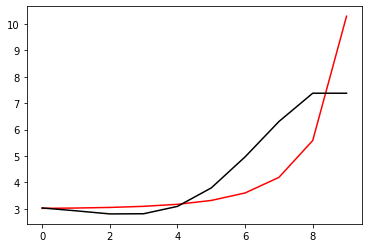

409200 0.0547993347492292
[2.85169396 2.76804937 2.67763585 2.70967439 3.01303336 3.73716701
 4.93611602 6.29994468 7.36174656 7.62265631]


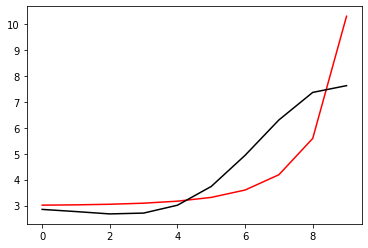

410300 0.01084317968135285
[3.0283506  2.92164643 2.80931542 2.81871332 3.09544661 3.78154712
 4.91555206 6.17059584 7.1087754  7.07496438]


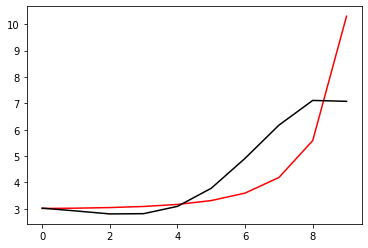

411400 0.001663611370982697
[3.00085085 2.90357799 2.80238883 2.82456336 3.11749585 3.82784456
 5.00626969 6.35155535 7.39185516 7.37734606]


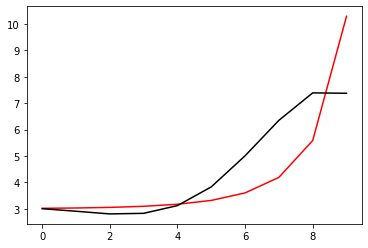

412500 0.03545725668328914
[2.89738938 2.80850862 2.72048975 2.76003233 3.07756241 3.82780475
 5.0824612  6.58077882 7.78965405 7.74175401]


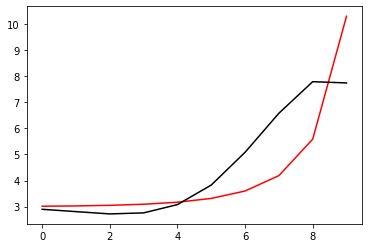

413600 0.0007886684975326378
[3.02060675 2.91327437 2.80569981 2.82368016 3.11512691 3.82842792
 5.01953293 6.39997984 7.49412422 7.43192771]


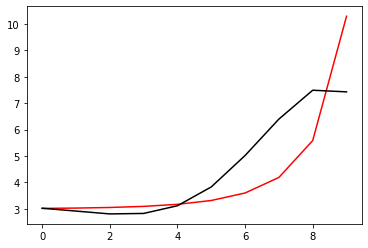

414700 0.27476728709779
[2.79485583 2.67957092 2.56737401 2.58327367 2.87508604 3.59185113
 4.79248653 6.19946483 7.31902247 7.75686704]


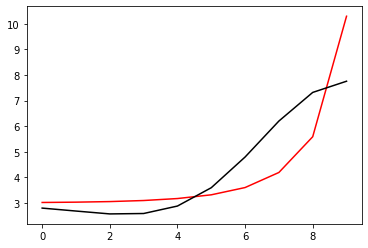

415800 0.02259843845171526
[3.05582099 2.94129423 2.82672335 2.83590485 3.11346516 3.801187
 4.94206887 6.23522437 7.19749018 7.16130923]


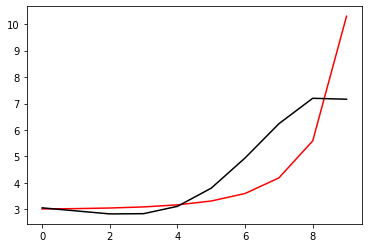

416900 0.010735885533666889
[3.04198767 2.9357032  2.82891007 2.84610486 3.13321155 3.83526468
 5.00380646 6.35141623 7.35366458 7.35764831]


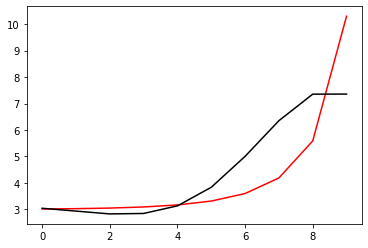

418000 0.05730878043380167
[3.04091862 2.95062602 2.86006316 2.89450034 3.20261456 3.93597931
 5.16096698 6.60418344 7.66340923 7.63738743]


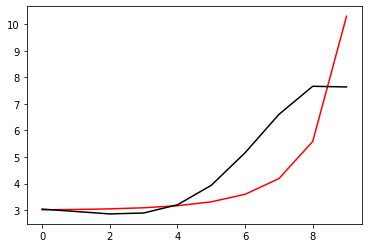

419100 0.01061131598689239
[3.04583291 2.92512599 2.80029748 2.79276961 3.04374499 3.68773003
 4.75351065 5.91136381 6.69831728 6.76658738]


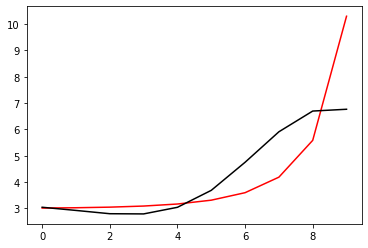

420200 0.015961201255446332
[3.05241133 2.93752451 2.81880353 2.81855334 3.07962337 3.74060163
 4.84028493 6.05949798 6.87517424 6.81922387]


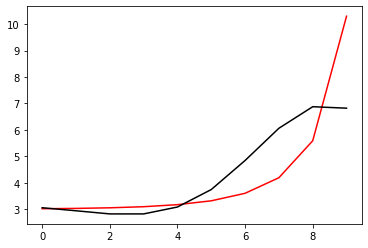

421300 0.011065743389121753
[3.04465887 2.93786361 2.82732442 2.83612503 3.10886106 3.78863586
 4.9258742  6.21707624 7.07508602 7.07591098]


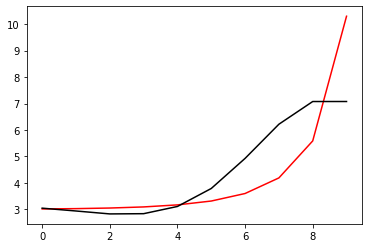

422400 0.0013862480025495318
[2.98388667 2.88953774 2.7917299  2.8137438  3.1020848  3.80533111
 4.98924321 6.37710033 7.30974649 7.28893169]


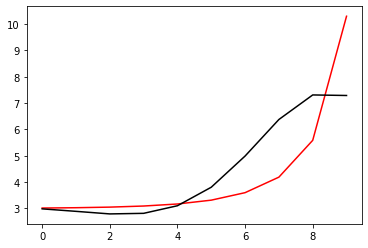

423500 0.0015825823836935807
[3.03543136 2.89266416 2.74446041 2.71234768 2.93769163 3.55667941
 4.60459428 5.73965785 6.47544668 6.46264663]


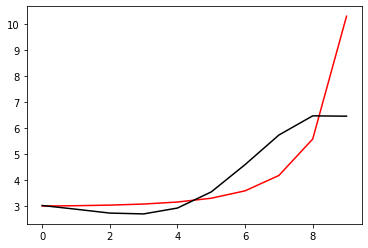

424600 0.010606696442100315
[3.01882787 2.88248254 2.73977374 2.71306418 2.94407556 3.5701243
 4.6295319  5.7895757  6.55991093 6.56124138]


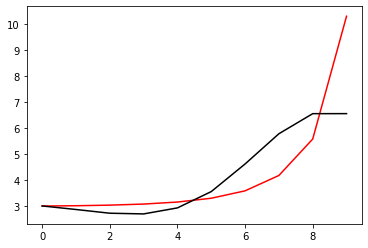

425700 0.010695181820022819
[3.10597432 2.97278987 2.83414101 2.81447857 3.05750571 3.70444636
 4.80080133 6.02675967 6.87400639 6.8446015 ]


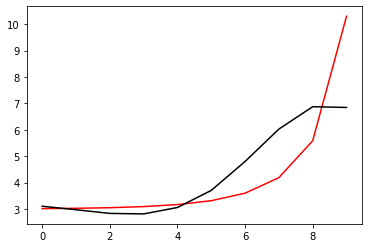

426800 0.021035276131630098
[3.12707617 3.00476993 2.87833772 2.87364012 3.13612247 3.81093508
 4.95174249 6.25590545 7.18909713 7.09562174]


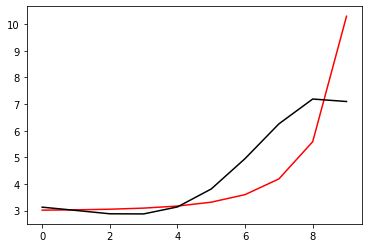

427900 0.010737658547106366
[3.05402201 2.96487339 2.87061962 2.89451927 3.17996357 3.87002747
 5.01837385 6.33725331 7.27965988 7.30260137]


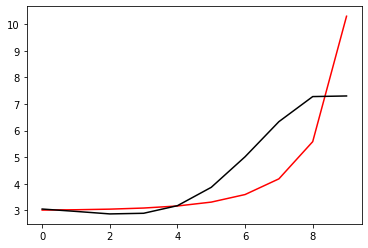

429000 0.056893307118951214
[3.01675109 2.94530053 2.87315672 2.92123568 3.23453546 3.96141325
 5.16914689 6.59859106 7.65939864 7.63684542]


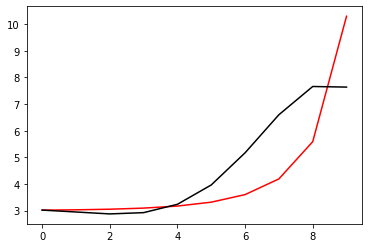

430100 0.01057966307682519
[3.01702647 2.89889632 2.77964911 2.77517846 3.02236307 3.65216467
 4.69408744 5.82429943 6.61402745 6.74534843]


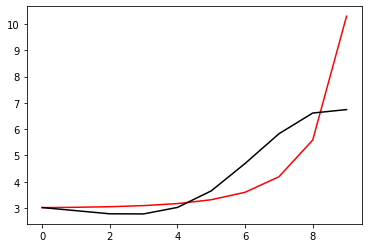

431200 0.01569181897328298
[3.0214951  2.90930909 2.79593546 2.79822599 3.05437802 3.69851014
 4.76712082 5.94409034 6.76469576 6.72243251]


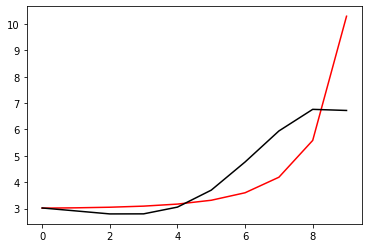

432300 0.011056360930782473
[3.03785992 2.9354094  2.83203431 2.84593145 3.11762482 3.78665254
 4.90092222 6.15450513 7.02299196 7.00342135]


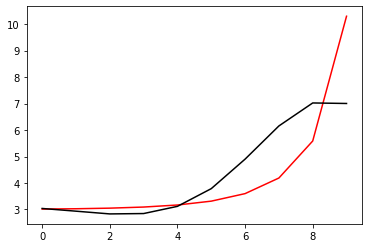

433400 0.0013742389951446026
[2.97032706 2.88288942 2.79473625 2.82450889 3.11485216 3.81099596
 4.97494182 6.32335081 7.27266228 7.25705439]


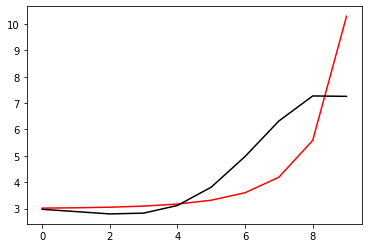

434500 0.005936619082934382
[3.01968139 2.9034034  2.78591604 2.78571233 3.04361009 3.70014046
 4.80528027 6.05790945 6.96253689 6.95303095]


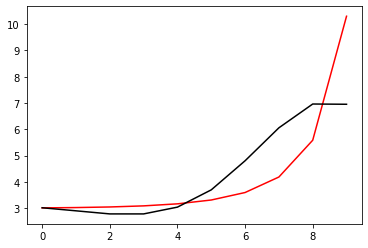

435600 0.0007292455290547001
[3.01393015 2.91889667 2.82461947 2.85011865 3.13778079 3.83252503
 4.9930099  6.33048127 7.30830139 7.24463925]


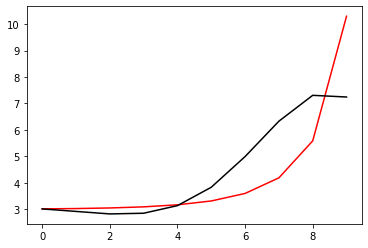

436700 0.010685139336085251
[3.02668559 2.94236478 2.85478556 2.87902669 3.15096522 3.80190452
 4.8605875  5.99488899 6.69831169 6.71360888]


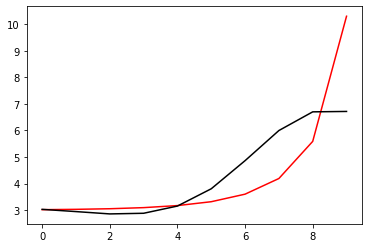

437800 0.023664869945334763
[3.02173726 2.94212556 2.85972155 2.88972387 3.16905433 3.83169922
 4.91329549 6.09106412 6.82050227 6.787756  ]


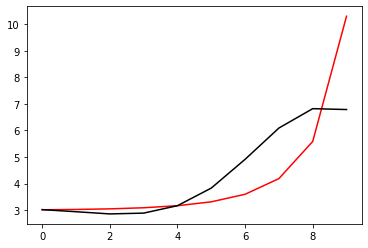

438900 0.0106450975949994
[3.00904561 2.93633575 2.86156501 2.89980048 3.1893258  3.86776145
 4.98033732 6.21870954 6.9882032  7.00194116]


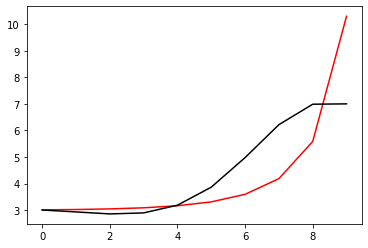

440000 0.05802192471319465
[3.007131   2.94755142 2.88787002 2.94272667 3.25306957 3.96337587
 5.13478336 6.47351302 7.29715657 7.26510272]


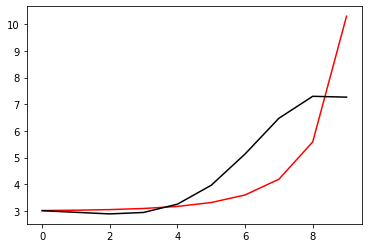

441100 0.010621542453644366
[2.97105758 2.87278857 2.77659127 2.79469849 3.06538052 3.72857236
 4.83894933 6.09765922 6.86384167 6.86241442]


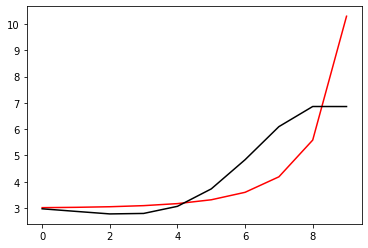

442200 0.010693766987432388
[2.99097345 2.90531704 2.82258168 2.85550217 3.14342884 3.82908633
 4.97256415 6.28589701 7.11862012 7.06231212]


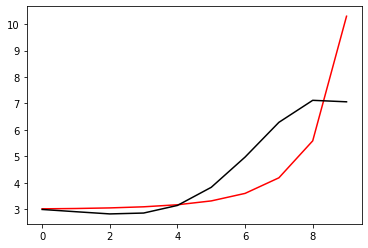

443300 0.010761558060842646
[2.93492339 2.85908113 2.78901679 2.83746289 3.14514997 3.85895638
 5.04811084 6.44337358 7.37782121 7.39460691]


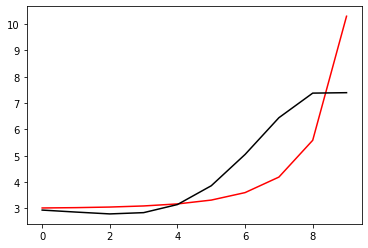

444400 0.002821267982860045
[3.02651398 2.90672187 2.7932756  2.79825227 3.05914626 3.71597272
 4.8252901  6.11283646 6.95575699 6.93842206]


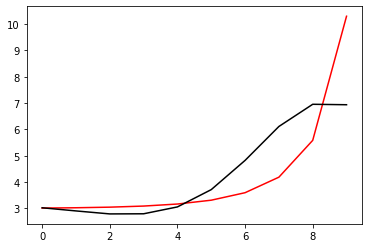

445500 0.0011576086223778201
[2.96421458 2.85549169 2.75408474 2.77407259 3.05472601 3.74021618
 4.89519608 6.25873107 7.19631198 7.17947525]


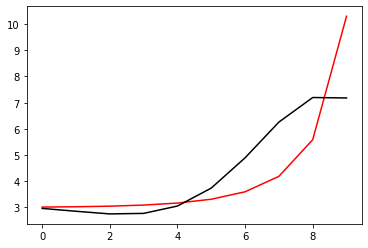

446600 0.0007698723791299377
[2.98555046 2.89980637 2.82129338 2.86520769 3.17232818 3.89056595
 5.09226909 6.53112327 7.55628774 7.51355049]


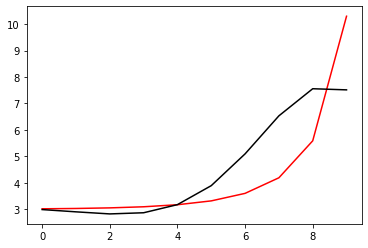

447700 0.010620652093483283
[3.02376994 2.94935228 2.87696799 2.91787234 3.20584878 3.87357107
 4.95880464 6.16261565 6.89544346 6.91568304]


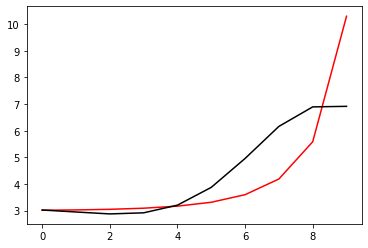

448800 0.020259216921304446
[3.00572684 2.93585051 2.86839709 2.91465794 3.20931053 3.88755541
 4.99466954 6.24390241 7.00447592 6.96336715]


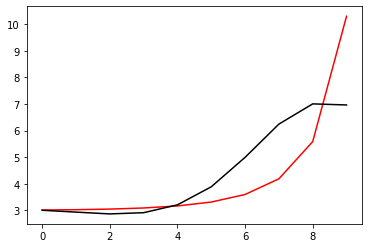

449900 0.010674692616666407
[2.98384941 2.92065552 2.86062763 2.91487834 3.21935651 3.91293008
 5.05167576 6.36579293 7.16622109 7.18172638]


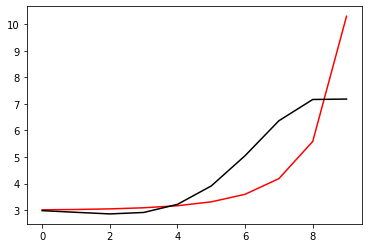

451000 0.05683424292890538
[2.98055289 2.93049506 2.88581694 2.95732182 3.28386587 4.01211204
 5.21734252 6.64415244 7.49350075 7.45875325]


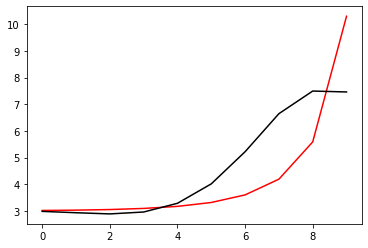

452100 0.010637306514559818
[3.03299236 2.95045778 2.87344742 2.90942118 3.19251288 3.86010842
 4.97048719 6.23452174 6.89060918 6.88631118]


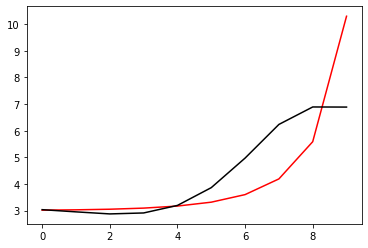

453200 0.00944961659425052
[2.97114683 2.89443154 2.82576966 2.87360499 3.1741691  3.87011721
 5.03032869 6.38142511 7.13965523 7.0722946 ]


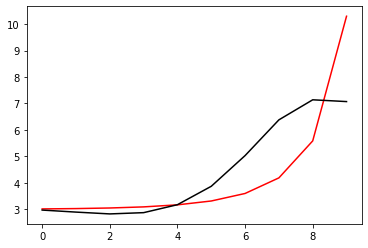

454300 0.010922324874234234
[2.92155549 2.84727853 2.78434124 2.84173883 3.15742183 3.87924084
 5.08838821 6.53525244 7.40889774 7.42810783]


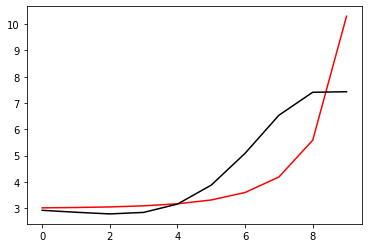

455400 0.00345121651865484
[3.03556284 2.91871451 2.81302589 2.82743417 3.09695516 3.76287281
 4.89172665 6.21323327 6.97746799 6.95125879]


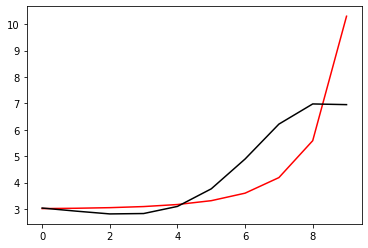

456500 0.0019385481922118502
[2.95252835 2.84395744 2.74727993 2.77384638 3.06050446 3.75295488
 4.9267466  6.32744112 7.19348126 7.17019018]


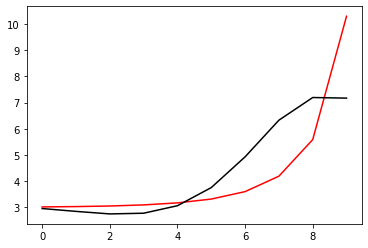

457600 0.0007596599927726749
[3.01282708 2.91395063 2.82649719 2.86332774 3.16161924 3.86851785
 5.06415811 6.5098611  7.43952868 7.36859665]


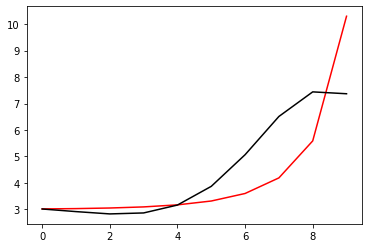

458700 0.01077130688415865
[3.02198059 2.92204726 2.83355758 2.87001116 3.16799322 3.87441483
 5.07235412 6.54131284 7.52172137 7.52412722]


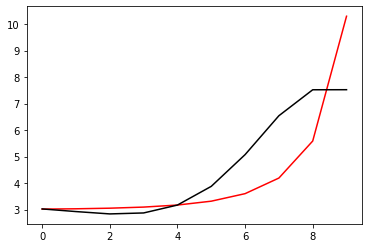

459800 0.13073483276123957
[2.82982253 2.71596641 2.60923331 2.62177015 2.88604937 3.54048395
 4.65376459 6.00068454 6.91019827 7.22557304]


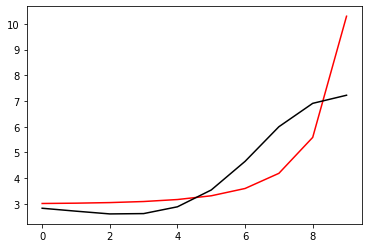

460900 0.01063083330368986
[3.04660696 2.95307213 2.86291013 2.88712939 3.15593428 3.80243559
 4.88097584 6.12713758 6.83424567 6.81105575]


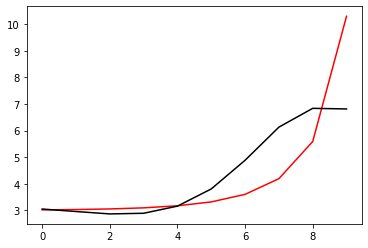

462000 0.060209264407941325
[3.02754764 2.94294739 2.86242211 2.89762963 3.18091163 3.8514179
 4.98262711 6.34996984 7.12027631 7.12128144]


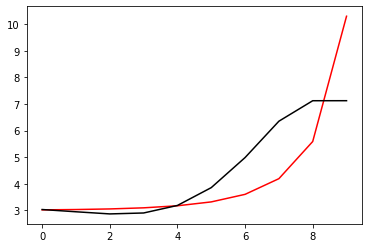

463100 0.010648302034510048
[3.13078528 2.99032531 2.85697318 2.84175517 3.07500885 3.69261637
 4.76683805 6.06645408 6.72420572 6.73021244]


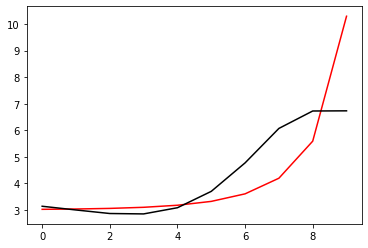

464200 0.01555315014774053
[3.08489522 2.95273794 2.82761285 2.82266463 3.06984858 3.70834837
 4.81639062 6.17189924 6.90607748 6.8327377 ]


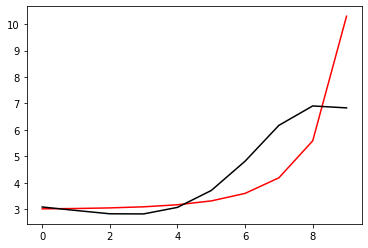

465300 0.010786456553132479
[3.02438093 2.90525528 2.79270841 2.80213288 3.06725781 3.73100299
 4.87879821 6.30081698 7.12504668 7.14759622]


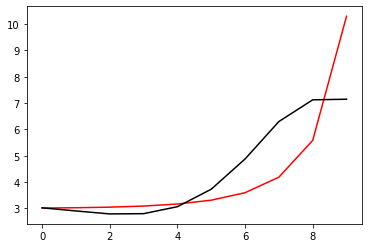

466400 0.005439420149518592
[3.0739191  2.93345013 2.79576634 2.7758078  3.0036     3.61342901
 4.67377767 5.96436695 6.68918168 6.63036722]


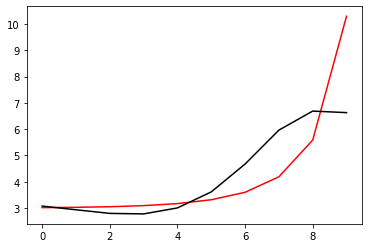

467500 0.004671117561691121
[3.03111015 2.9002499  2.77331073 2.76777219 3.01657664 3.6599331
 4.77756049 6.16184967 6.99408307 6.9862003 ]


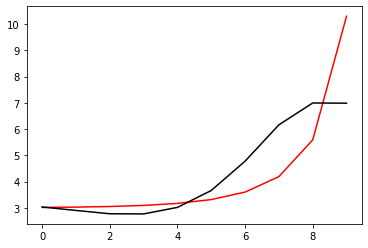

468600 0.0009543756537648639
[3.01658317 2.90346957 2.7957861  2.81253482 3.08881995 3.76932406
 4.94255118 6.41224772 7.33823677 7.32516892]


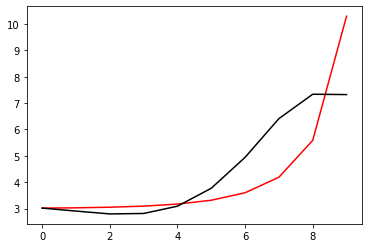

469700 0.018541592626044687
[3.01153824 2.89477211 2.78132274 2.78791611 3.04525715 3.68778926
 4.78122883 6.10001627 6.84053416 6.93314451]


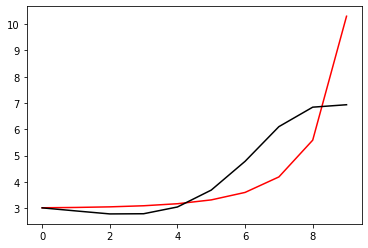

470800 0.02763605554977706
[3.02739449 2.91594668 2.80746874 2.81941272 3.08359018 3.73657024
 4.84808802 6.19471967 6.9546852  6.93540878]


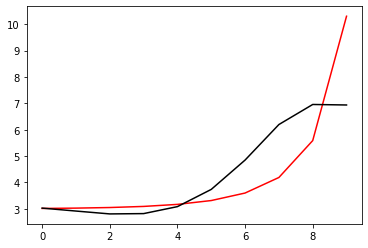

471900 0.010701455940460262
[3.03855818 2.93532031 2.83474893 2.85514096 3.12990134 3.79874548
 4.9376478  6.32795992 7.1225786  7.13132686]


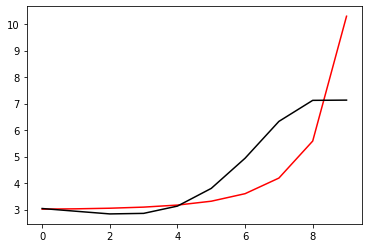

473000 0.0598332839968147
[3.03491433 2.9439074  2.85533284 2.88818361 3.17815234 3.86946936
 5.04726507 6.50173984 7.35381039 7.32714363]


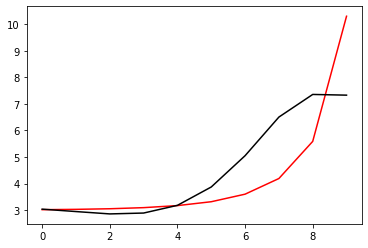

474100 0.010612912785640336
[3.06607713 2.94513531 2.8231118  2.81681621 3.0576568  3.6791972
 4.74276127 6.00669186 6.73786072 6.73254305]


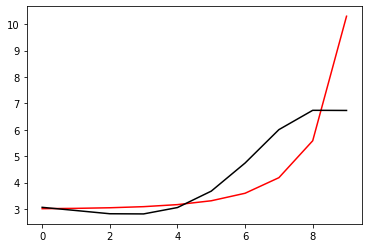

475200 0.013307022948333603
[3.03619771 2.92636387 2.81736516 2.82743914 3.09065901 3.74584477
 4.86334464 6.21003472 7.03038877 6.95948238]


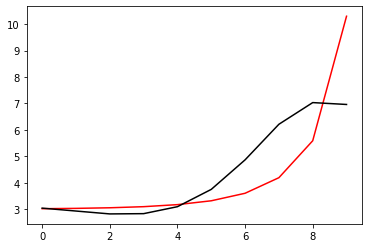

476300 0.0107321952022017
[2.97421152 2.88051408 2.78904301 2.81839082 3.10467478 3.79101978
 4.95624407 6.3796324  7.28693786 7.28957549]


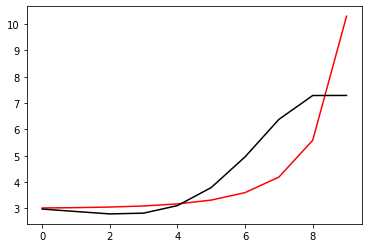

477400 0.0038068396740157688
[3.04520387 2.91584422 2.78777198 2.77892736 3.0226271  3.65497844
 4.73981608 6.04294677 6.84748373 6.80783847]


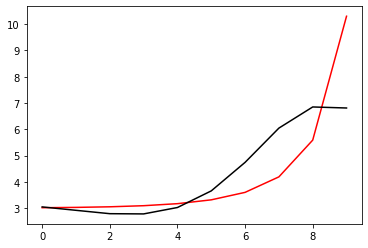

478500 0.0042772157674879204
[3.01086174 2.89401418 2.77875397 2.78474756 3.04749066 3.70706211
 4.83431642 6.20528222 7.09627149 7.08932179]


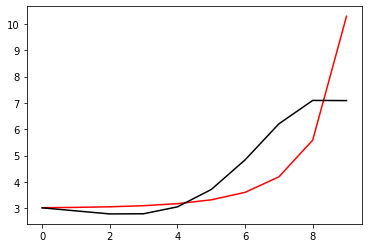

479600 0.5766561684669191
[3.2270258  3.11469507 3.00314392 3.01143513 3.27452376 3.92988735
 5.04133828 6.38149798 7.25074938 7.36687766]


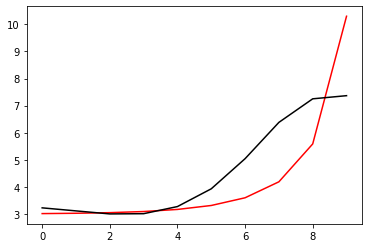

480700 0.01963206906311469
[3.05119548 2.90883742 2.76819066 2.74865082 2.98388456 3.60942234
 4.68876695 6.00280435 6.86482357 6.83695544]


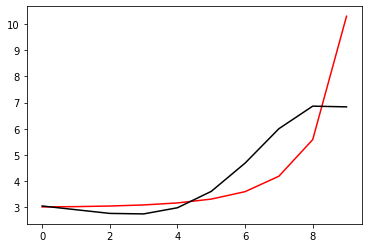

481800 0.022545821288042892
[3.10346728 2.9766418  2.84851583 2.84010231 3.08593108 3.72298203
 4.81825993 6.16107689 7.06658097 7.0192921 ]


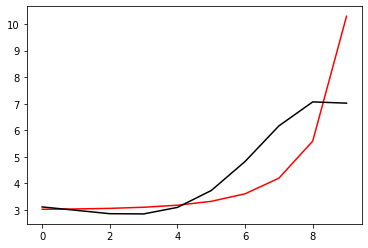

482900 0.008535465613499358
[3.0504373  2.90470116 2.75369644 2.71776242 2.92842398 3.51500161
 4.52994669 5.75948293 6.60574884 6.60728435]


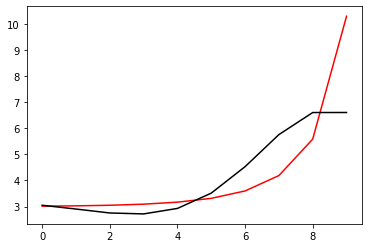

484000 0.05986817279572026
[3.02849224 2.8897755  2.74527317 2.71660352 2.93653637 3.53708479
 4.57711502 5.85366152 6.76022098 6.75434891]


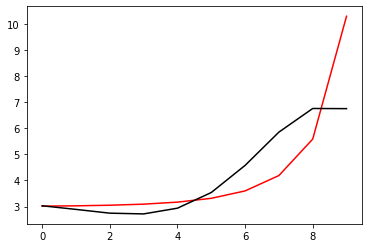

485100 0.010638821182529318
[3.08238509 2.95715597 2.82495778 2.80831703 3.04114549 3.6578229
 4.72340086 6.04701986 7.01169489 7.01435618]


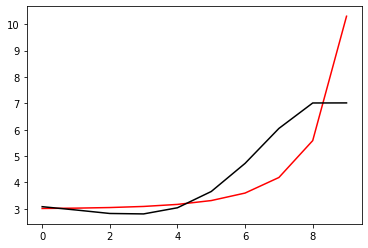

486200 0.024379594693782564
[3.2057794  3.02894096 2.84915531 2.79050282 2.98754339 3.57288148
 4.59957817 5.84657792 6.73521426 6.71636351]


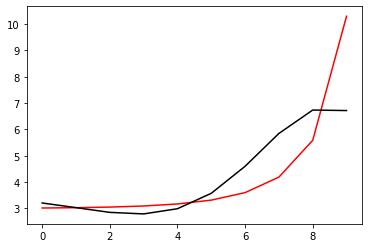

487300 0.011650630865327812
[3.11971273 2.95805996 2.79252953 2.74922808 2.96438725 3.57387796
 4.63709467 5.94208398 6.90534433 6.88772091]


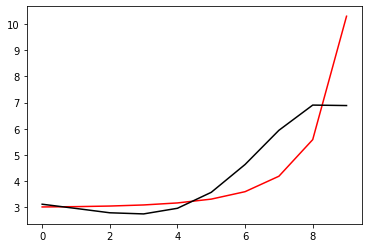

488400 0.003122905113375714
[3.06794438 2.92277747 2.77329489 2.747952   2.98543652 3.62613658
 4.73818739 6.12145463 7.18038178 7.14435454]


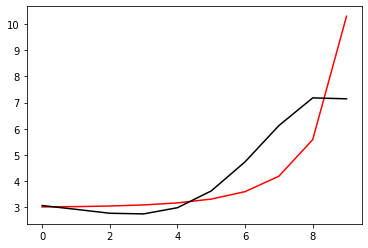

489500 0.06022952924678351
[2.9377323  2.8070634  2.67406688 2.67036887 2.93991708 3.63238391
 4.8322242  6.3539866  7.56379569 7.52838848]


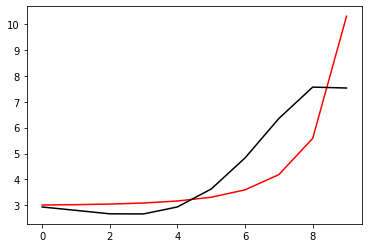

490600 0.0015700774448876987
[3.12677997 2.95859887 2.78561991 2.73915179 2.95922015 3.58507763
 4.677613   6.02985    7.09924581 7.0687241 ]


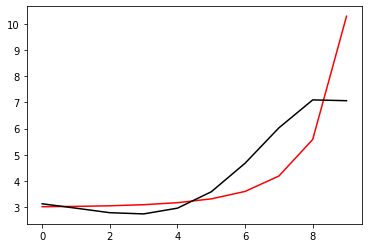

491700 0.010812538348346354
[3.1135713  2.96233358 2.80455789 2.77366532 3.01164584 3.66097741
 4.78882515 6.19729402 7.33535211 7.33869528]


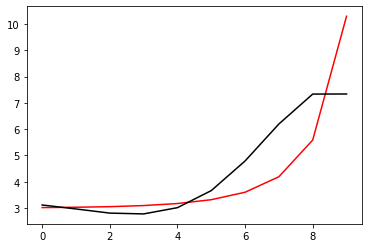

492800 0.0407981739207688
[3.04276371 2.8693621  2.685391   2.62351694 2.82296042 3.41814151
 4.45970397 5.7416929  6.81862722 7.05812663]


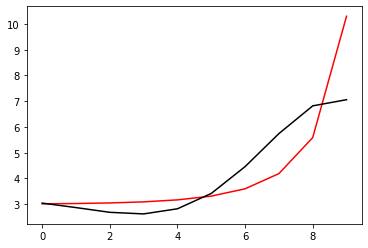

493900 0.010788279000937815
[3.16373155 2.99781815 2.82016119 2.76453081 2.97071194 3.57391811
 4.62698452 5.92803064 7.02153805 7.01963122]


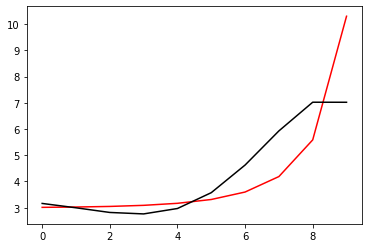

495000 0.060611590953239064
[3.11871106 2.97384524 2.817429   2.78514582 3.01990481 3.66287105
 4.77853729 6.17741781 7.37499396 7.37363811]


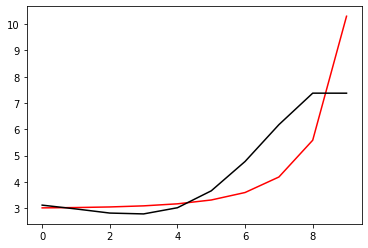

496100 0.010670860706225697
[3.10725725 2.9185327  2.71752146 2.63958625 2.82546419 3.40840259
 4.42870686 5.64452729 6.70997991 6.7289203 ]


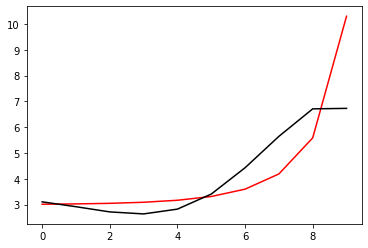

497200 0.025835518403726467
[3.23809988 3.0450907  2.83790042 2.7531166  2.93169762 3.5066844
 4.51882902 5.73016774 6.79238269 6.76109452]


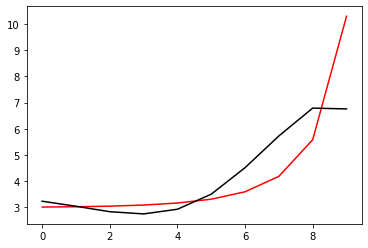

498300 0.01084690336071496
[3.08664779 2.90785388 2.71407243 2.64357913 2.83904224 3.43703587
 4.48655213 5.76403373 6.91163163 6.91793647]


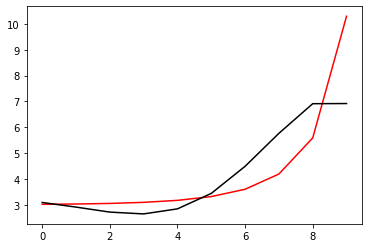

499400 0.011065769706101292
[3.07586148 2.90988502 2.72695922 2.66682779 2.87384964 3.48764418
 4.56541407 5.90101019 7.12342552 7.06189182]


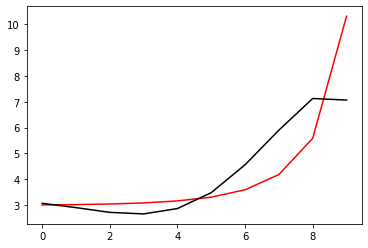

In [16]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

0 0.06053258266342069
[3.01768813 3.06153522 2.88689086 2.83309604 3.04507062 3.46528413
 4.54980916 5.90528036 7.15429979 7.25908536]


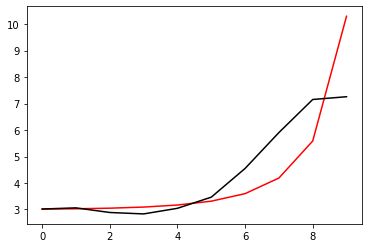

1100 0.010522936917644814
[2.93117158 2.8140245  2.93622664 3.20535339 3.34288282 3.81962519
 4.58628402 5.82312095 6.99304918 6.99372949]


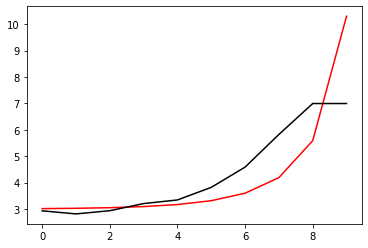

2200 0.011268240676458353
[2.88037037 2.78252137 2.90851282 3.18351951 3.35278581 3.85426729
 4.66423324 5.95775311 7.20305318 7.14807182]


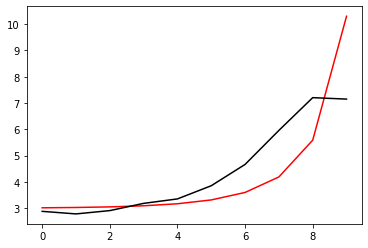

3300 0.010587421306265879
[2.93423736 2.79548499 2.86988932 3.09333738 3.22539621 3.67161845
 4.4150643  5.61777441 6.77809088 6.77028111]


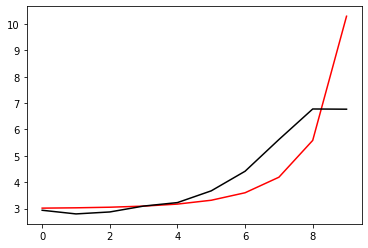

4400 0.0033460462984137317
[2.94202728 2.82057844 2.90034305 3.13017955 3.28689086 3.7542378
 4.53316395 5.7837217  7.00892022 6.99119868]


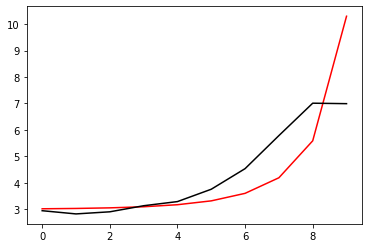

5500 0.013439428378570076
[2.85250191 2.75317993 2.83731924 3.0726449  3.26344969 3.75861408
 4.58595691 5.90189888 7.2154141  7.21525279]


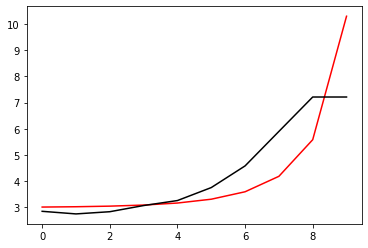

6600 0.009859006813331038
[2.94063735 2.80095885 2.83789598 3.02507917 3.17410194 3.61288507
 4.36822383 5.58455359 6.78872853 6.78456283]


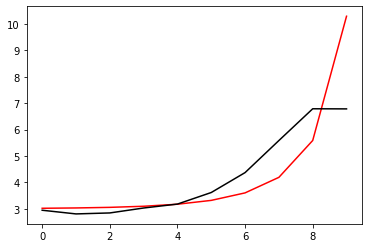

7700 0.010622426012069409
[2.99256076 2.86897733 2.90886747 3.09771344 3.26285896 3.71234844
 4.48651553 5.7280275  6.97141155 6.96519171]


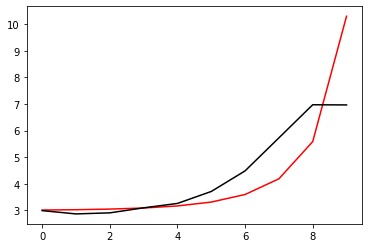

8800 0.019177421758702354
[3.01061303 2.91177151 2.95968039 3.15664865 3.35556854 3.83609842
 4.66065501 5.97049384 7.30581568 7.25383623]


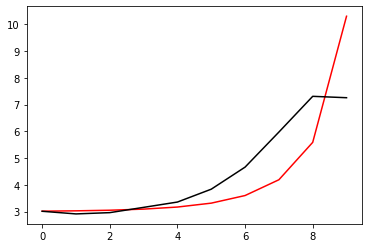

9900 0.04853216931963843
[2.88080537 2.7542472  2.75994698 2.91147299 3.08142063 3.51379643
 4.27237973 5.47732666 6.72368578 6.76462717]


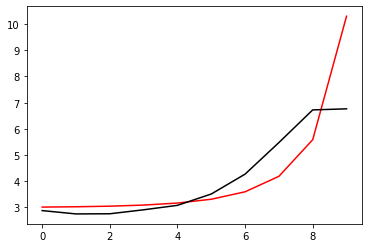

11000 0.10784270926097847
[3.13921552 2.99317463 2.97337998 3.09919401 3.25126392 3.6614075
 4.39610887 5.57104691 6.78715313 6.81100872]


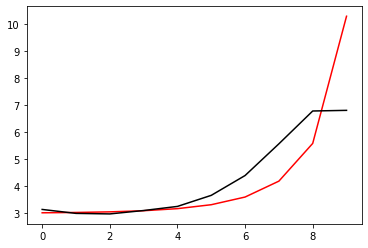

12100 0.010440306113900913
[3.05664422 2.92683684 2.91579212 3.05042875 3.22493112 3.65932287
 4.43184356 5.66015605 6.94633572 6.94605718]


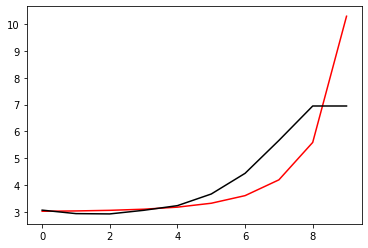

13200 0.012742561591151384
[2.99293323 2.88629878 2.88942234 3.04067858 3.25674985 3.74283382
 4.59687511 5.93753019 7.35234901 7.29842501]


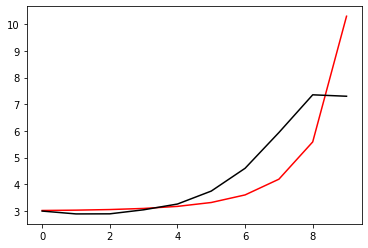

14300 0.010785041641980506
[3.0020189  2.86530612 2.82873811 2.93487658 3.10888935 3.53286904
 4.28247159 5.41545467 6.69214326 6.67357781]


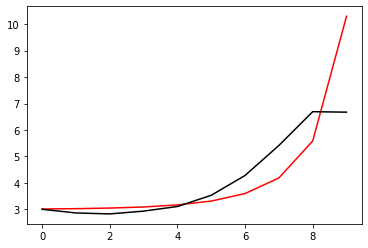

15400 0.004368093643304913
[2.99529398 2.87530845 2.85060445 2.97061763 3.17391372 3.63635733
 4.44447657 5.65557393 7.01264307 6.98987303]


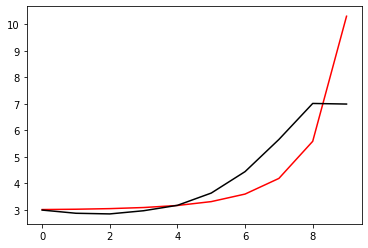

16500 0.04233891187897858
[2.87246765 2.77302398 2.7629632  2.90047813 3.14418816 3.66096144
 4.55392588 5.88092425 7.35475189 7.33096704]


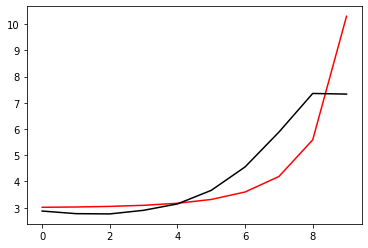

17600 0.010459656867286752
[2.97395598 2.83891904 2.78821472 2.88127807 3.07773844 3.52946573
 4.32228546 5.49654568 6.82216866 6.82174973]


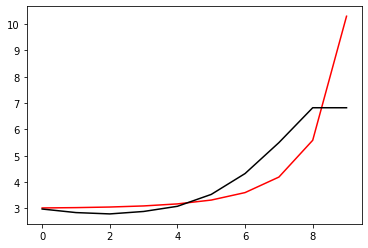

18700 0.010606730181599048
[3.07090936 2.93500214 2.87804246 2.96434153 3.16148087 3.6156755
 4.41728584 5.60944816 6.9605519  6.96161218]


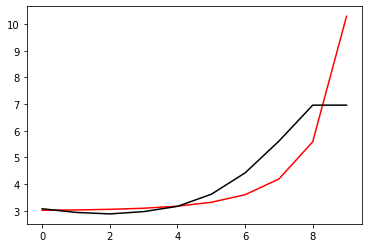

19800 0.021839152253003157
[3.0963393  2.97622837 2.92965999 3.0285299  3.25507776 3.75252675
 4.62515498 5.92276265 7.38899201 7.35990816]


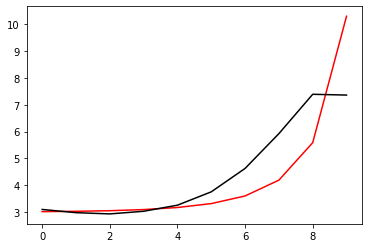

20900 0.010586956457894533
[3.0436084  2.94083427 2.90516689 3.01232556 3.25637372 3.77380289
 4.67550288 6.01129599 7.50562762 7.54086229]


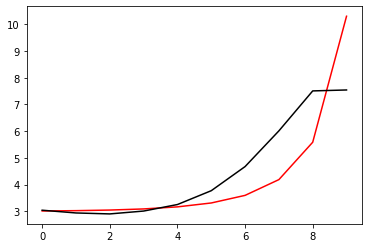

22000 0.06041471190820829
[3.13190401 2.9816514  2.89132332 2.93850086 3.12391253 3.56833296
 4.36092957 5.48202539 6.77663472 6.84734651]


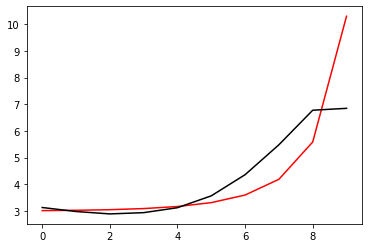

23100 0.01045056529720883
[3.0997326  2.96215517 2.88086908 2.93605054 3.13315668 3.59079362
 4.40077101 5.54720426 6.87101327 6.87227108]


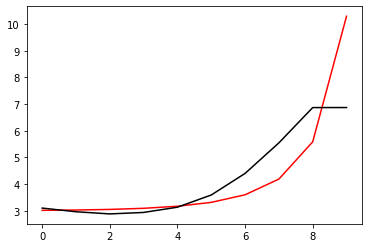

24200 0.017568607089142686
[3.063415   2.94288822 2.87638487 2.94912926 3.17676973 3.67882316
 4.55624723 5.79916946 7.22583131 7.16893881]


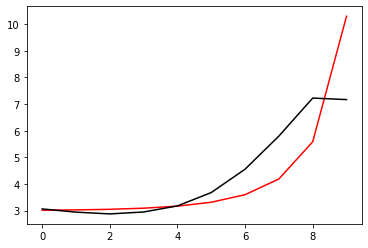

25300 0.010589092796332165
[2.98008757 2.86358823 2.79623396 2.867488   3.10348769 3.62081249
 4.52609442 5.81863826 7.30598609 7.31056166]


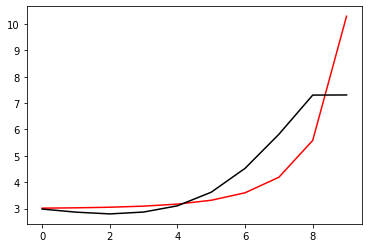

26400 0.0013538376764131714
[2.95962265 2.87510478 2.83687683 2.93753262 3.21665661 3.79044913
 4.77321997 6.16606464 7.74145072 7.71403273]


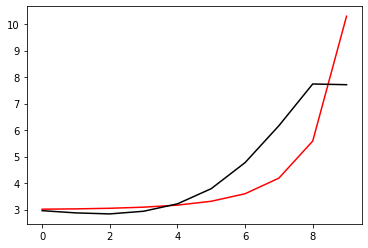

27500 0.002067000934600548
[2.96811682 2.86117416 2.79703885 2.87004634 3.12473589 3.67038716
 4.60688414 5.91441388 7.44124685 7.4219151 ]


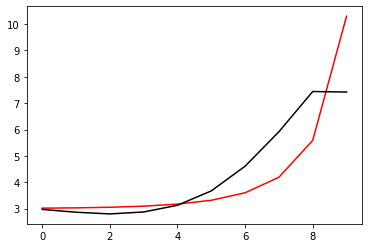

28600 0.5820782723613455
[3.19511217 3.09461935 3.03393301 3.1086415  3.36954389 3.9199668
 4.84771072 6.11337953 7.58941156 7.71434518]


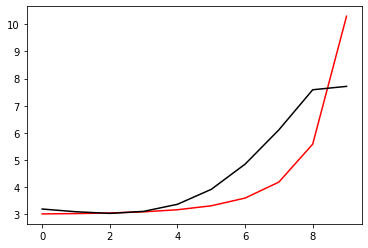

29700 0.010780259670104883
[3.08039295 2.94143371 2.84254151 2.88052918 3.10711825 3.62285277
 4.51490404 5.75121014 7.2152391  7.20754022]


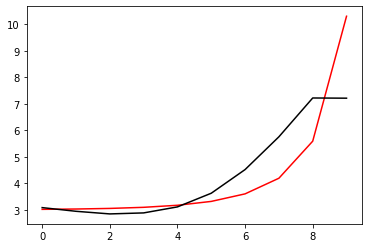

30800 0.021168503247358573
[3.08101712 2.95965322 2.87537122 2.92826314 3.17514277 3.71827554
 4.64960723 5.94287141 7.47078545 7.41768004]


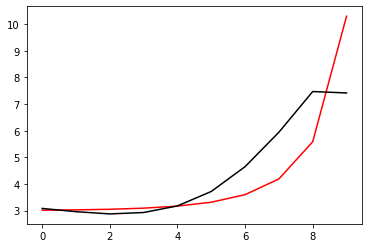

31900 0.01088358351834505
[3.02968069 2.90270137 2.80705901 2.8435415  3.06985891 3.57902361
 4.44282213 5.59808203 6.95175775 7.01905976]


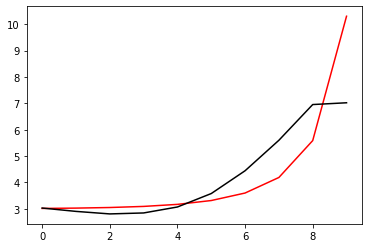

33000 0.06046464088040664
[3.0628515  2.94378146 2.85479913 2.89836428 3.13555247 3.66304927
 4.56200756 5.77517207 7.1392549  7.14180509]


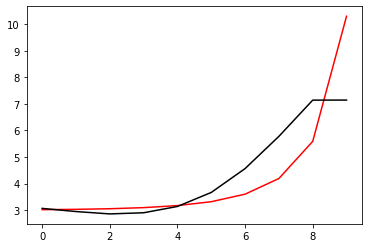

34100 0.010559584660356754
[3.05520365 2.94703882 2.86698855 2.91941502 3.17017992 3.72047451
 4.66387178 5.95699856 7.3632749  7.36236996]


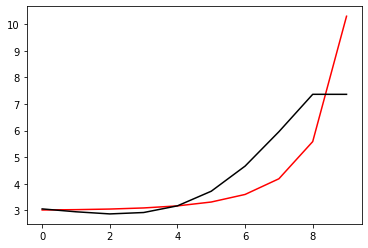

35200 0.014025065791628427
[2.92109825 2.82998811 2.76539739 2.83361476 3.10814178 3.69830175
 4.71935471 6.15068615 7.65072255 7.60408323]


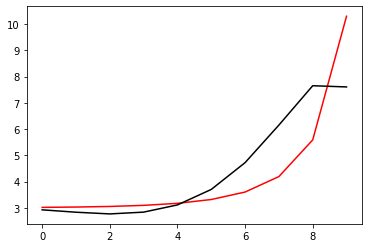

36300 0.011634205157059726
[3.08485436 2.94605432 2.83398651 2.85445179 3.0791436  3.60988255
 4.54723467 5.85191266 7.20761258 7.17546953]


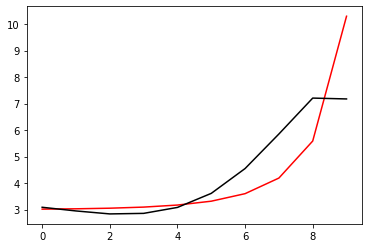

37400 0.003372014607347611
[3.04486499 2.91823627 2.81659086 2.84815785 3.08878517 3.64360777
 4.61918477 5.98492287 7.41747692 7.39586756]


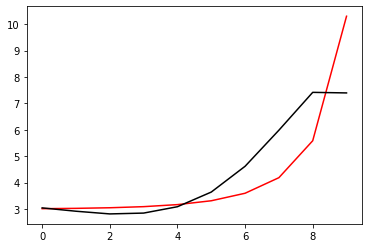

38500 0.005120296877215452
[2.94619215 2.83832623 2.75377633 2.80296608 3.06783159 3.65802234
 4.68818929 6.13955895 7.67567121 7.66824533]


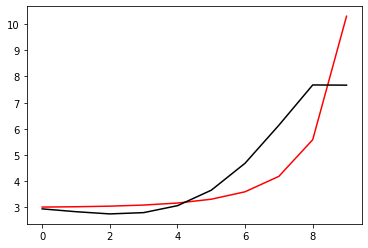

39600 0.4594270003238498
[3.17700353 3.06540951 2.97481554 3.01672493 3.27866729 3.87120527
 4.9086782  6.37271465 7.9169772  7.92188218]


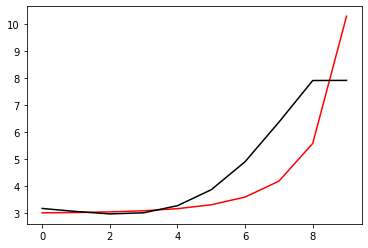

40700 0.012202476321042552
[3.02929679 2.91271466 2.81443001 2.8449308  3.08985575 3.65394456
 4.63915144 6.00688895 7.41135671 7.37889054]


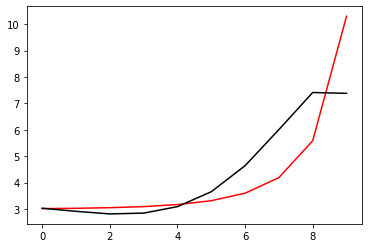

41800 0.020694348568546368
[3.0446419  2.93967543 2.85197373 2.89351029 3.15354514 3.74149102
 4.76809823 6.20195039 7.65649393 7.59809255]


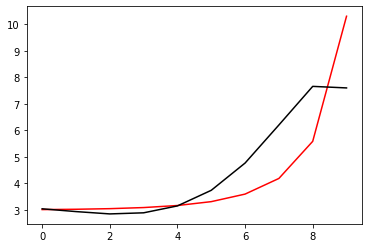

42900 0.0107348812843867
[3.03474347 2.94498911 2.87159777 2.92775374 3.20792805 3.82796455
 4.91062303 6.43576814 7.96744713 8.01227655]


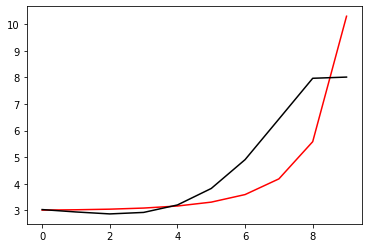

44000 0.0603454888820023
[3.08591618 2.97173116 2.87022532 2.892169   3.13023928 3.69088614
 4.67136506 5.98766436 7.3167569  7.32761226]


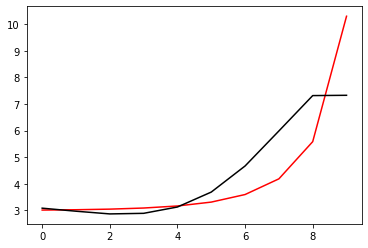

45100 0.01061409666774399
[3.05780003 2.95094529 2.85680604 2.8868776  3.13672106 3.71640362
 4.72923019 6.10119137 7.49266013 7.49419983]


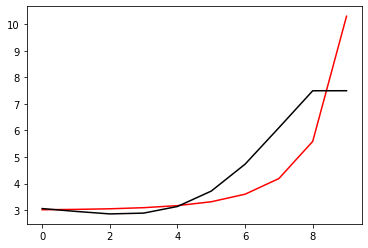

46200 0.010822183485198644
[2.95867196 2.86630461 2.78998253 2.84280232 3.12705558 3.76279711
 4.86886553 6.38379594 7.91396438 7.83600252]


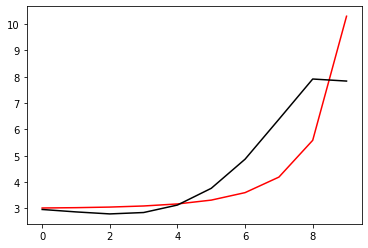

47300 0.010717969816957017
[3.03105398 2.90790473 2.796428   2.80763142 3.04029936 3.60250273
 4.580439   5.85781254 7.22510746 7.20219912]


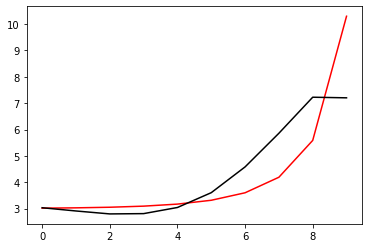

48400 0.0020636406732390655
[3.01480145 2.90474463 2.80697499 2.83402191 3.08844094 3.68323429
 4.71134456 6.06472873 7.50889026 7.48558545]


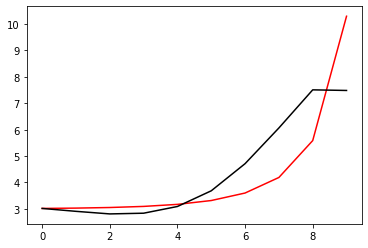

49500 0.010368931714020296
[3.01663049 2.92051617 2.83726768 2.88060189 3.15794934 3.78837891
 4.87306956 6.3149122  7.84364622 7.8542926 ]


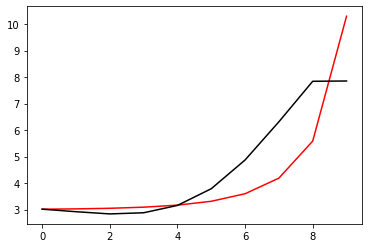

50600 0.07977299159688708
[2.88615945 2.80156945 2.72670314 2.77188855 3.04138487 3.64617543
 4.67065559 5.99776313 7.3507159  7.3889055 ]


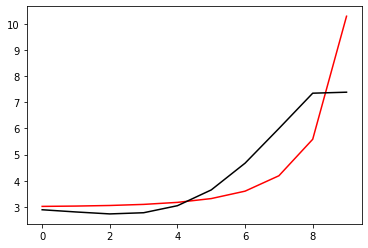

51700 0.01117721544389505
[3.00046622 2.90936983 2.82921806 2.87018751 3.13692396 3.74053708
 4.76511366 6.09348114 7.44183607 7.41335763]


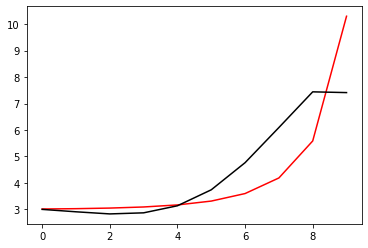

52800 0.020240098331621468
[3.00899159 2.9261326  2.85409723 2.90344562 3.18084125 3.80035831
 4.85114042 6.22407517 7.62226009 7.56549243]


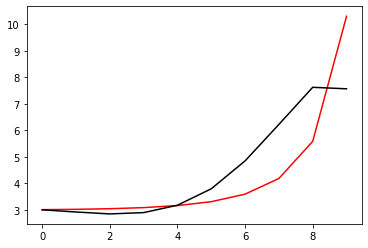

53900 0.010702540637478424
[2.99922157 2.93083349 2.87354415 2.9378968  3.23371129 3.87976883
 4.97306177 6.41616981 7.88993857 7.94135291]


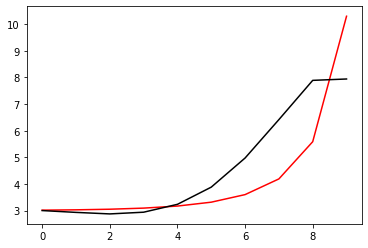

55000 0.05992169299166312
[2.9730323  2.86642884 2.77292466 2.80107586 3.05979693 3.66426056
 4.70362209 6.0758303  7.48955153 7.47969269]


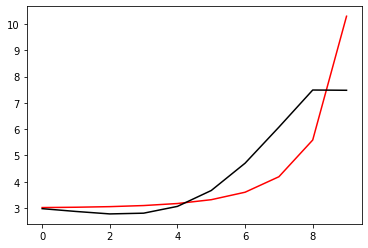

56100 0.01065671054468978
[3.03624699 2.94179137 2.85914589 2.8974166  3.16677853 3.78402235
 4.8407161  6.24122664 7.68988093 7.69014507]


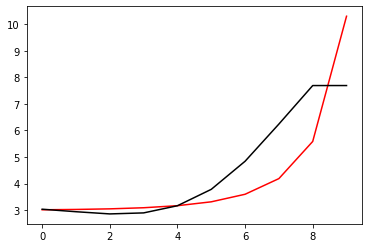

57200 0.01068164034208805
[2.95172309 2.86481387 2.79216698 2.84397434 3.1340543  3.78522018
 4.89901189 6.3954024  7.9624638  7.91467001]


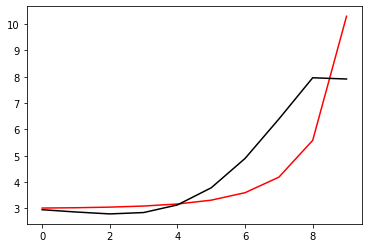

58300 0.010689626933591337
[3.00198284 2.879105   2.76925118 2.78222163 3.02994216 3.62955916
 4.67024077 6.06267339 7.53782423 7.5325939 ]


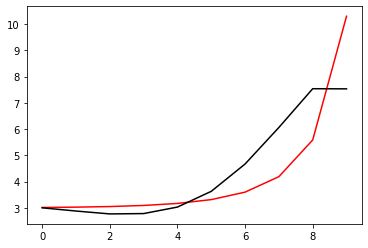

59400 0.0013309692460920955
[2.99717422 2.89042921 2.79555691 2.82396465 3.08978816 3.71358874
 4.78990812 6.23877774 7.78201261 7.77414997]


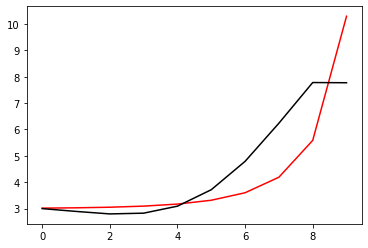

60500 0.010122742797535129
[3.08492714 2.94658059 2.81605771 2.80403087 3.02130582 3.58032756
 4.56048478 5.87504656 7.30086568 7.29820156]


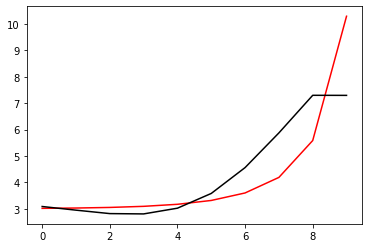

61600 0.0007194118361776827
[3.07127913 2.94506278 2.82725113 2.8307104  3.06925359 3.66106323
 4.69570768 6.09708853 7.60888977 7.56003416]


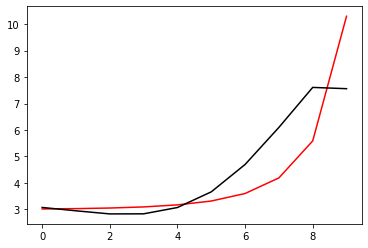

62700 0.11384932644121577
[2.90514638 2.76099919 2.62669658 2.61625909 2.84479684 3.43156376
 4.46446246 5.85644226 7.34616238 7.74766129]


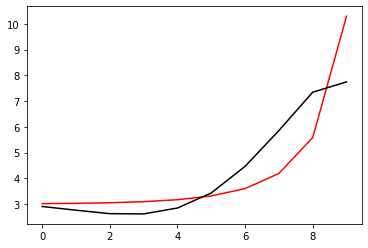

63800 0.027725320738131012
[3.13446552 2.97422281 2.82240919 2.79381894 3.00250099 3.5652664
 4.56642601 5.91784151 7.35820108 7.34076563]


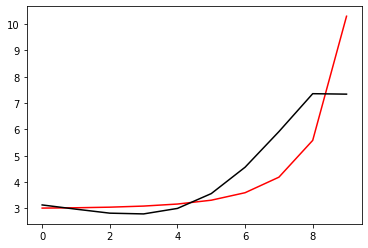

64900 0.010703603953819358
[3.12370427 2.97634967 2.83536888 2.81800095 3.04025887 3.62206853
 4.65303673 6.05344655 7.55450483 7.56731126]


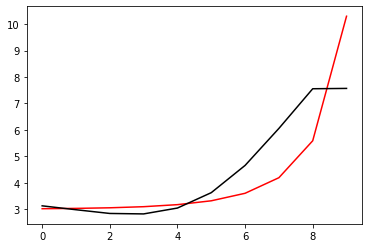

66000 0.06063219722823827
[3.07175806 2.93829163 2.80946559 2.80566452 3.04650089 3.65749379
 4.7376524  6.22063817 7.82077624 7.80812048]


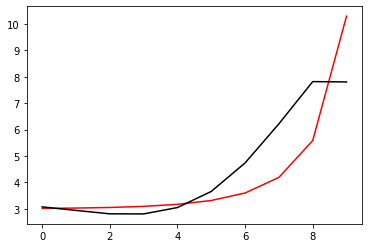

67100 0.010691092859995803
[3.0953187  2.93247391 2.77527264 2.74378525 2.95614621 3.53289019
 4.56109282 5.95796182 7.43800542 7.4424922 ]


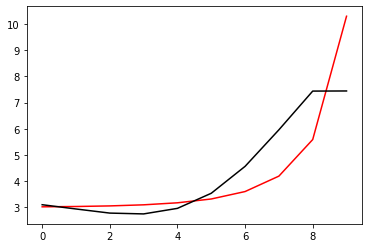

68200 0.014077879976104513
[3.0963357  2.94134661 2.79075349 2.7664612  2.98844281 3.58038272
 4.63526069 6.07827256 7.61046534 7.55498108]


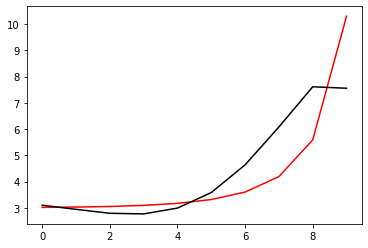

69300 0.010935943005978749
[3.08543697 2.94366797 2.80426361 2.79134087 3.02743782 3.64045521
 4.73123101 6.23584569 7.83665444 7.85790142]


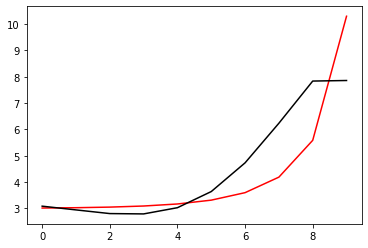

70400 0.001166788830487503
[3.01539742 2.89577087 2.776171   2.78247815 3.04089349 3.68522081
 4.82732616 6.41910622 8.1173381  8.10402227]


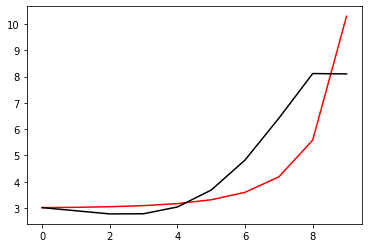

71500 0.0019961312854026724
[3.06552881 2.90760403 2.7495826  2.71669459 2.93266577 3.5251341
 4.59361324 6.07435138 7.63943256 7.62195335]


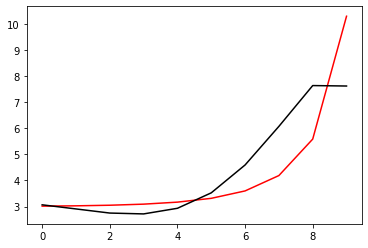

72600 0.0008716037270241632
[3.09199345 2.94671277 2.79941922 2.77708448 3.005437   3.61504471
 4.71009588 6.23349609 7.85134526 7.81457673]


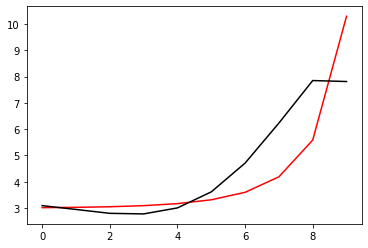

73700 0.010928480708261969
[3.08549806 2.94277164 2.79692759 2.77589312 3.00708998 3.62315657
 4.73214979 6.28674062 7.95326431 7.97776632]


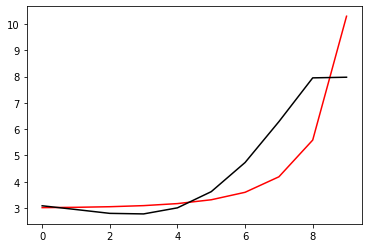

74800 0.11107435624293728
[2.93797548 2.7691673  2.59500637 2.54251698 2.73749626 3.30660196
 4.34157326 5.77011316 7.34066291 7.73374171]


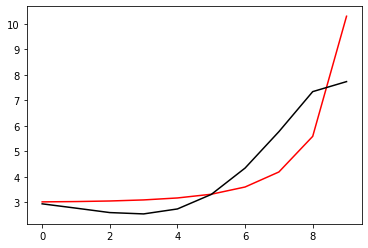

75900 0.01088808757930267
[3.1427386  2.97339616 2.79620164 2.73829182 2.92429146 3.47802493
 4.48581063 5.86888676 7.37137129 7.36710226]


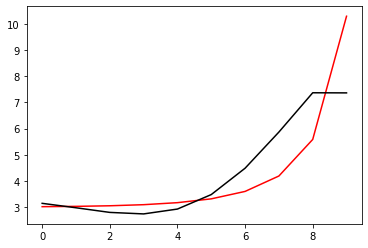

77000 0.060608674981459415
[3.15412139 2.99706784 2.83046257 2.78322638 2.98216157 3.55468936
 4.59351429 6.02866039 7.59108029 7.59323121]


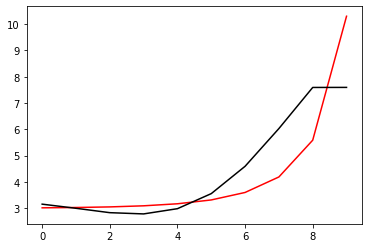

78100 0.010760560694610326
[3.13449613 2.99567406 2.84574695 2.81548146 3.03532774 3.63876699
 4.72913849 6.24977856 7.90716302 7.91123007]


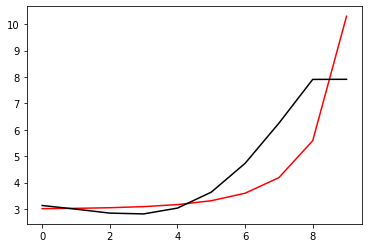

79200 0.018723306303102805
[3.12411424 2.95445661 2.77043841 2.70210122 2.87795389 3.42412091
 4.42066564 5.75569025 7.29093455 7.24525656]


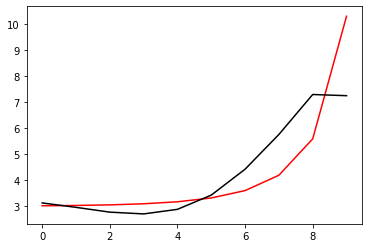

80300 0.011470940006922463
[3.12975854 2.97483694 2.80561656 2.75350528 2.94948119 3.5238123
 4.56266393 5.95985991 7.55531532 7.52873036]


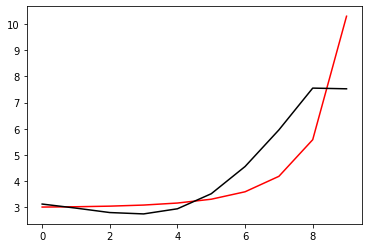

81400 0.0020522180445446967
[3.05631674 2.92891219 2.78699733 2.76178645 2.98650507 3.59543999
 4.68128313 6.14663915 7.806574   7.77179592]


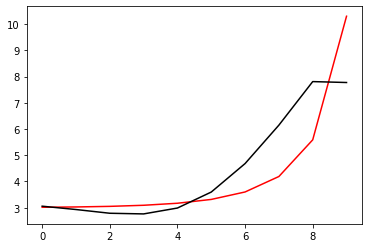

82500 0.0013662561442115248
[3.09325755 2.92401731 2.73742141 2.66388677 2.83378825 3.37304801
 4.35450064 5.65801009 7.19712812 7.16548802]


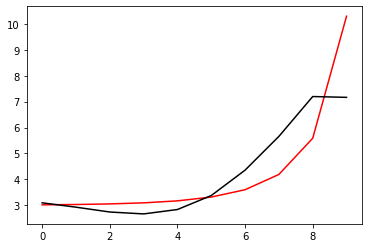

83600 0.010706611361917142
[3.0623744  2.90289698 2.72550788 2.6619775  2.84498771 3.40475525
 4.42256175 5.79287545 7.4123535  7.42098789]


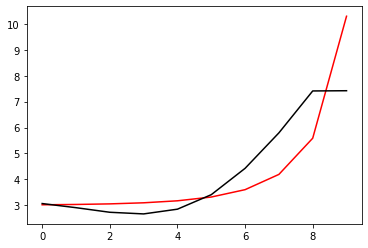

84700 0.010723972081994878
[3.13064128 2.99289343 2.83480407 2.78798401 2.98673372 3.56410645
 4.60719488 6.02342543 7.68845007 7.68311839]


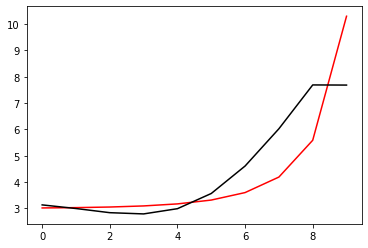

85800 0.027658843198011936
[3.05698378 2.96523349 2.84855628 2.83611708 3.06032538 3.64806599
 4.65671791 5.82897754 7.25869579 7.21737888]


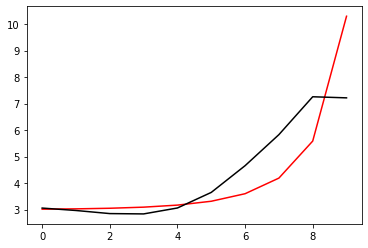

86900 0.010658082070160986
[3.05384466 2.97120994 2.86575969 2.86544876 3.10617676 3.72466018
 4.81568487 6.19600357 7.52683919 7.52390834]


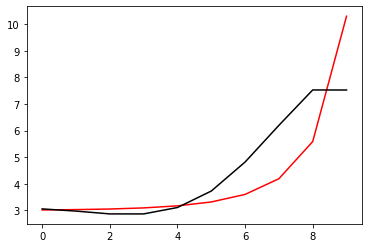

88000 0.06049268769374466
[3.0728202  2.98072984 2.86538427 2.8501722  3.06712611 3.64457641
 4.65986692 5.89181858 6.97278104 7.01518243]


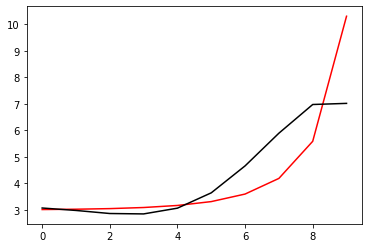

89100 0.010581357789894231
[3.06194312 2.97435178 2.8643987  2.85479686 3.07886406 3.6684556
 4.71089956 6.00749892 7.11023994 7.11167209]


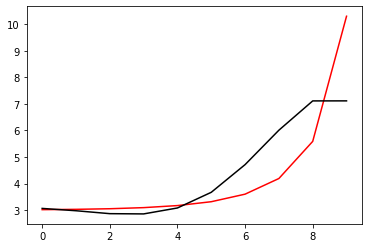

90200 0.010741238744142342
[3.02175197 2.94258435 2.84346102 2.84617907 3.08713381 3.70669771
 4.81592494 6.25714066 7.41366318 7.32772593]


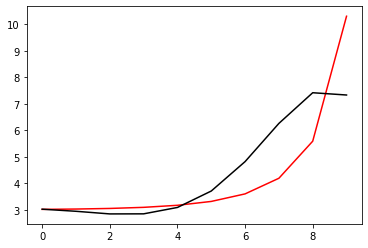

91300 0.010828060421524658
[2.93732918 2.87398855 2.79465569 2.8185929  3.08591102 3.74775801
 4.94179049 6.54515686 7.77649244 7.79125101]


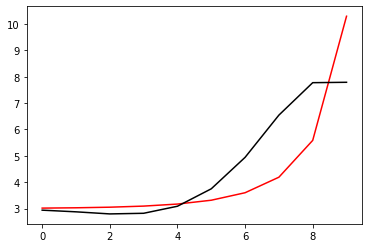

92400 0.003333926719880518
[3.05419073 2.94410266 2.82037254 2.80031146 3.0220221  3.63227321
 4.75525239 6.22703584 7.34460967 7.31980732]


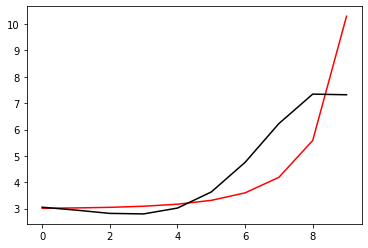

93500 0.0010237020307596087
[2.98008544 2.8782368  2.76507147 2.75804333 2.9971641  3.63410671
 4.80019817 6.34516531 7.55646644 7.53681732]


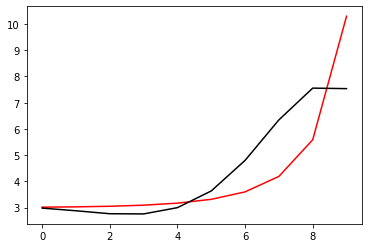

94600 0.0017690691917733687
[3.09192393 2.99446241 2.88769429 2.88731713 3.13343966 3.7791653
 4.95596461 6.52358153 7.77110039 7.76820247]


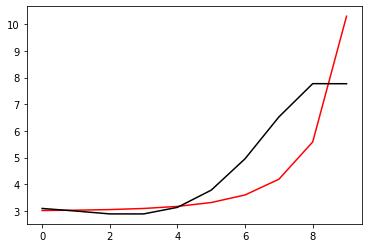

95700 0.010851280192598107
[2.98941212 2.90909565 2.82236979 2.84358333 3.11462488 3.79470948
 5.02494995 6.68997292 8.07037828 8.06988881]


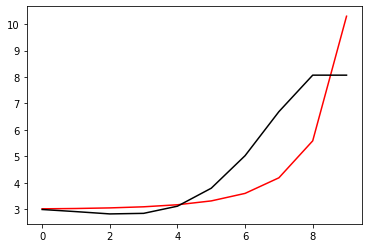

96800 0.020417312331068582
[2.99497818 2.91655997 2.83246587 2.85304155 3.1159117  3.77274654
 4.94851466 6.50856741 7.73819921 7.7036381 ]


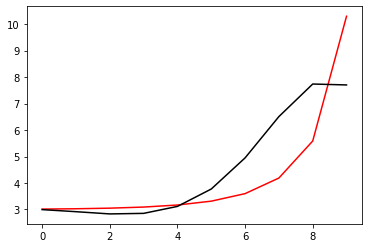

97900 0.010752813205019215
[3.00347845 2.93004598 2.85136095 2.87748834 3.14657452 3.81178653
 5.00050643 6.5835358  7.84429604 7.83832193]


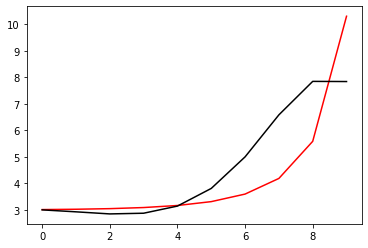

99000 0.05894013037393387
[2.99564537 2.93220385 2.86493867 2.90336313 3.18690669 3.87216305
 5.09216894 6.72745745 8.05347142 8.03650888]


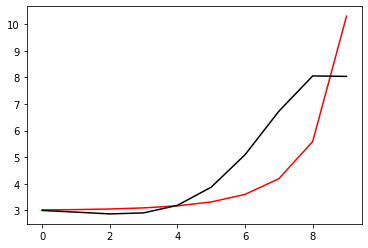

100100 0.010681845437746274
[2.95173795 2.88621703 2.81639726 2.84828736 3.11688568 3.76959401
 4.91605336 6.39917996 7.54922498 7.553112  ]


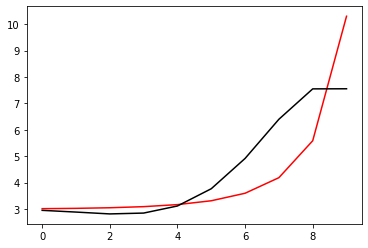

101200 0.004349886843119253
[2.97018431 2.91171685 2.85053191 2.8926555  3.17488115 3.84961709
 5.03776267 6.59344756 7.78318786 7.73196737]


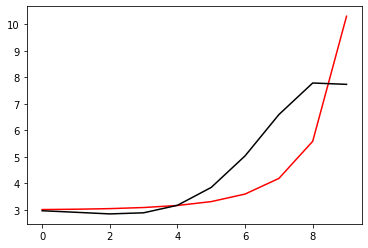

102300 0.01079335792834009
[2.92156194 2.87154362 2.82123085 2.87556052 3.17262521 3.86969175
 5.09970295 6.73855366 8.00622982 8.02033523]


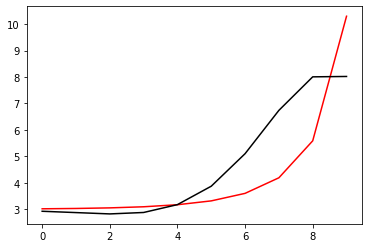

103400 0.001130202525131283
[2.96760212 2.89512161 2.82393119 2.85757872 3.13229744 3.80221565
 4.99304388 6.56881886 7.77154588 7.76753179]


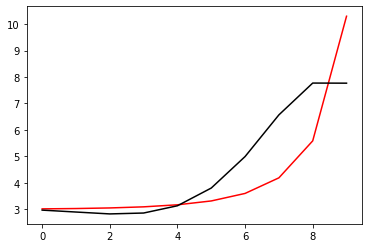

104500 0.008145852079976578
[2.89965913 2.83345989 2.77247988 2.82044425 3.11548759 3.81779878
 5.06534409 6.74338742 8.07306198 8.04806782]


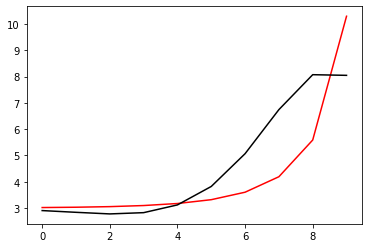

105600 0.001330223405253351
[2.9756665  2.88774295 2.80483853 2.82847964 3.09206071 3.74626349
 4.90925477 6.43979932 7.57809737 7.54914883]


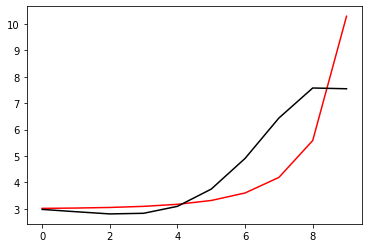

106700 0.010814865101408958
[2.98949112 2.90770506 2.83066829 2.86063386 3.13171462 3.79661712
 4.97728317 6.53921387 7.71592915 7.71513431]


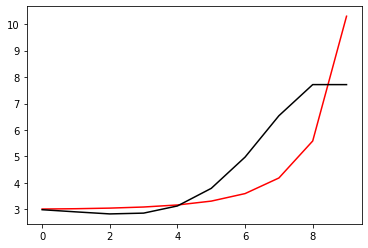

107800 0.019486315478372176
[3.04948622 2.94775616 2.8513337  2.86238406 3.11378829 3.75589052
 4.90539984 6.42409336 7.56519103 7.55862012]


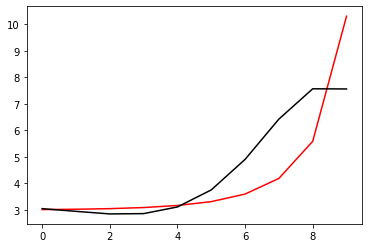

108900 0.010760963039368781
[3.02866094 2.93807346 2.85326467 2.87783366 3.14585758 3.81106084
 4.99644511 6.57415171 7.79127149 7.798662  ]


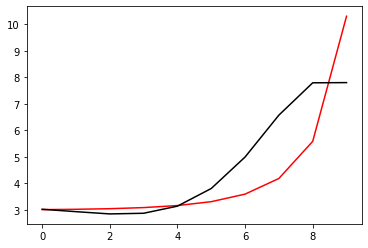

110000 0.06051590860494534
[3.01357523 2.89618541 2.78610507 2.78545713 3.02437506 3.64947363
 4.77040462 6.24620169 7.33923826 7.36814985]


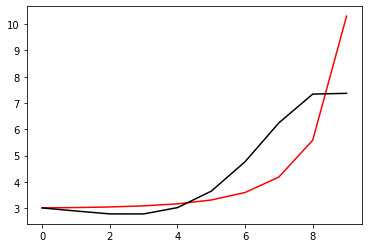

111100 0.010703641326306431
[3.04210054 2.92977299 2.82400437 2.82815065 3.07299816 3.70665445
 4.84152858 6.34080737 7.46120909 7.46235758]


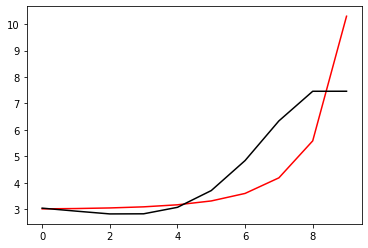

112200 0.00760524451436663
[3.0160403  2.91457199 2.81895082 2.83450355 3.09378719 3.74891616
 4.92024884 6.48262248 7.68013868 7.62239769]


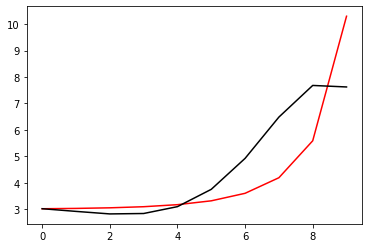

113300 0.011006583027538153
[2.94014396 2.85677122 2.77905399 2.8141225  3.09700807 3.78550851
 5.01141279 6.66629346 7.97416547 7.99529366]


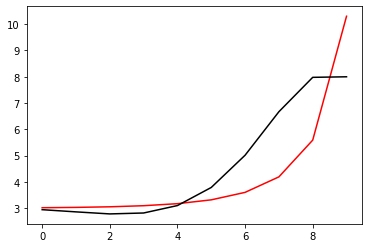

114400 0.0016275486670566527
[3.02462936 2.91171451 2.80365019 2.80771888 3.05664429 3.70254373
 4.86442469 6.42106348 7.66358617 7.65203295]


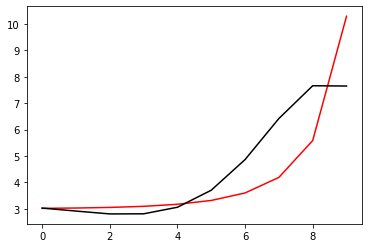

115500 0.0039576750137628805
[2.94294026 2.84351027 2.75072304 2.7740363  3.04881577 3.73314114
 4.95743729 6.61499209 7.97539119 7.95575382]


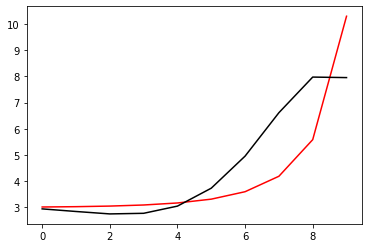

116600 0.0008101458988428081
[3.05886569 2.93181597 2.81011924 2.80347122 3.04538019 3.68913208
 4.85497929 6.42848862 7.73000593 7.72831377]


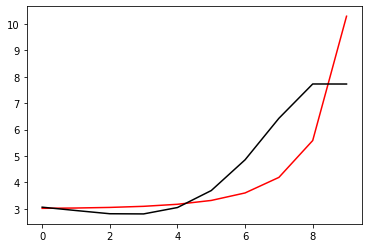

117700 0.020686332241290892
[2.98605839 2.86469679 2.74806352 2.74776428 2.99785064 3.65295922
 4.83732086 6.44887436 7.8140606  7.90825236]


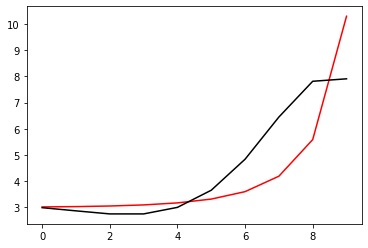

118800 0.1035406088499283
[2.91808065 2.76712607 2.61742158 2.58038497 2.78604462 3.37822042
 4.45299627 5.859735   7.07841675 7.5277636 ]


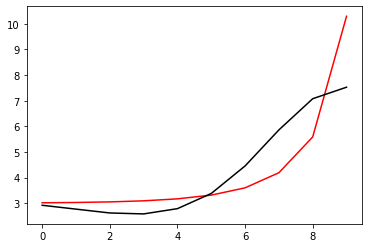

119900 0.010789058388452477
[3.1418587  2.98213941 2.82188631 2.77295842 2.96379631 3.53500363
 4.57777568 5.93890272 7.10045105 7.09384319]


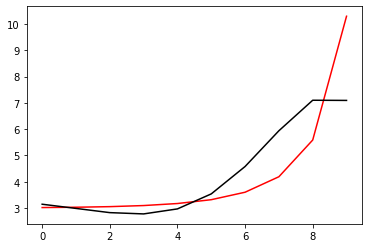

121000 0.060589650638555204
[3.1352824  2.98694645 2.83643346 2.79788121 3.0009886  3.58864907
 4.65682435 6.06149989 7.28256156 7.28537131]


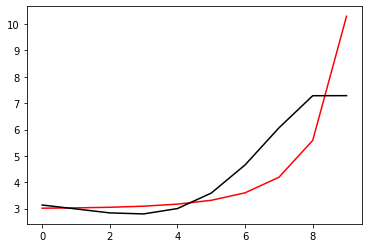

122100 0.010733302998674461
[3.1200177  2.99080683 2.85794412 2.83833004 3.0640076  3.68192404
 4.79589983 6.27473781 7.58811001 7.58917634]


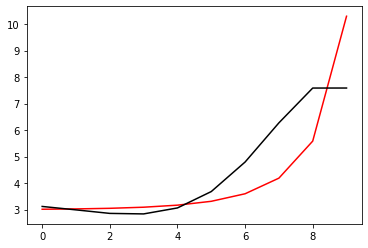

123200 0.025276168372438745
[3.0372437  2.86650226 2.69018512 2.62477483 2.79855338 3.34804599
 4.35160987 5.6415166  6.81748965 6.81867773]


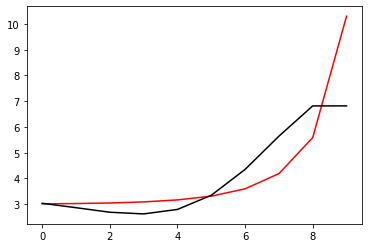

124300 0.010837835006024423
[3.07530668 2.90517427 2.72789774 2.66162996 2.83507081 3.3852577
 4.3923641  5.69455725 6.89163268 6.88921969]


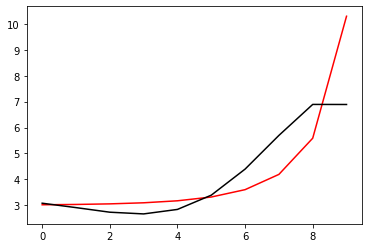

125400 0.011816088735041643
[3.08175701 2.91821982 2.74535169 2.68398311 2.86436987 3.42589128
 4.45412453 5.79927176 7.05913357 7.02218821]


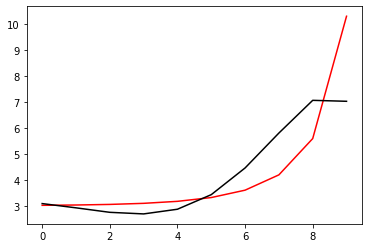

126500 0.0035235276549614816
[3.07004107 2.92519204 2.76788956 2.72175728 2.91951768 3.50429089
 4.5701409  5.98502633 7.33927476 7.36913123]


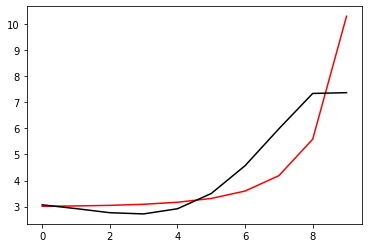

127600 0.0009093414327322216
[3.05322402 2.96016975 2.84834832 2.83930537 3.063075   3.65429138
 4.6724931  5.82721753 6.94501359 6.92726042]


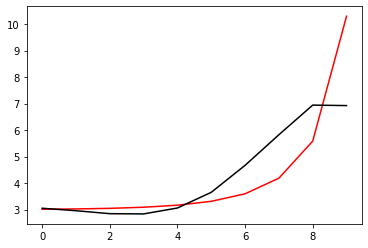

128700 0.010776533474749753
[3.03310265 2.94811285 2.84590478 2.84732185 3.0854412  3.70318385
 4.79435827 6.15717842 7.19952753 7.18759843]


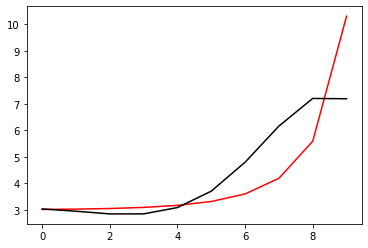

129800 0.0912537089615677
[2.92563067 2.81021568 2.67787071 2.64623935 2.84685211 3.41937222
 4.45794559 5.71245584 6.55218221 7.00371769]


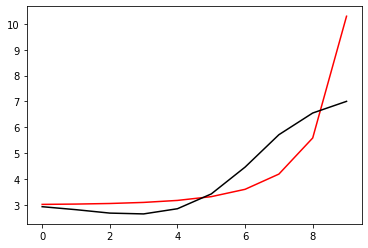

130900 0.004054322372268602
[3.00535792 2.88394576 2.74552302 2.70753482 2.9012571  3.46576384
 4.49424147 5.74037203 6.57481109 6.55186574]


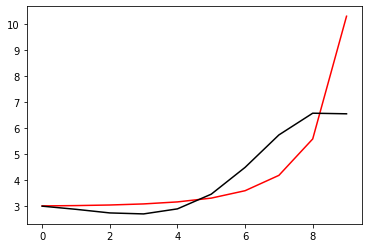

132000 0.06052007949242739
[3.11663333 2.99804715 2.86280938 2.82841304 3.0266229  3.59737324
 4.63482677 5.89968607 6.75969745 6.76145399]


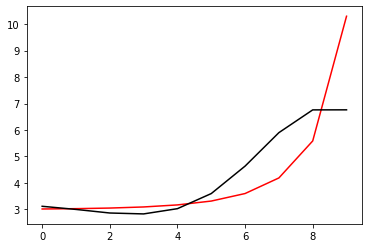

133100 0.010619658607139072
[3.05413299 2.95690951 2.84462727 2.83483404 3.06176631 3.67017841
 4.76125679 6.10982056 7.06911099 7.0675662 ]


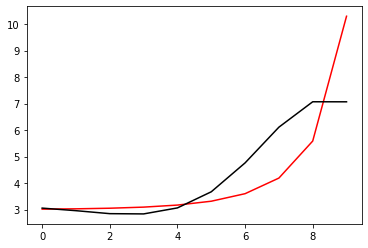

134200 0.009767598742144008
[3.02422549 2.94915047 2.86347115 2.88375582 3.14832469 3.80933082
 4.97718993 6.44065155 7.52236186 7.4022199 ]


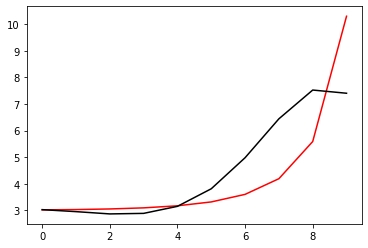

135300 0.010829809095295156
[3.0472382  2.92273943 2.78868465 2.75839303 2.96539649 3.54968815
 4.59056224 5.84808186 6.80074608 6.78420943]


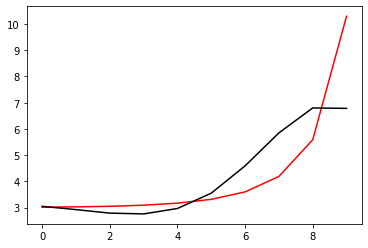

136400 0.004139173482564636
[3.0506188  2.93895666 2.81847879 2.80349049 3.02909509 3.63839699
 4.71551346 6.02928542 7.04955151 7.02769612]


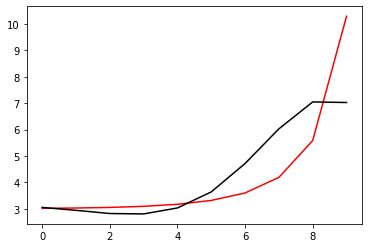

137500 0.002128812065268015
[2.95685326 2.86080771 2.75825709 2.76369396 3.01402002 3.6564032
 4.78202492 6.173788   7.28735028 7.27708234]


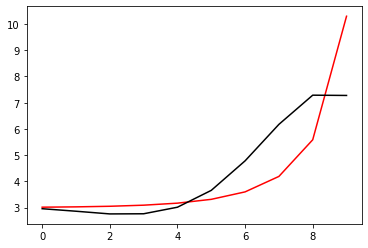

138600 0.4065606491219362
[3.17161107 3.08045688 2.98278787 2.99050329 3.23906016 3.87185416
 4.97001854 6.31869807 7.40646712 7.5596339 ]


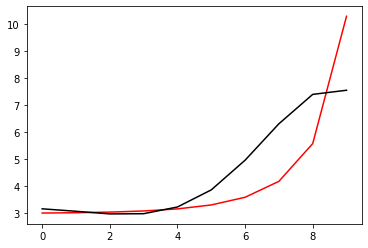

139700 0.011074921621468474
[3.05356735 2.95263809 2.84377691 2.83714672 3.06475085 3.66291759
 4.69823643 5.93402109 6.8664528  6.84123168]


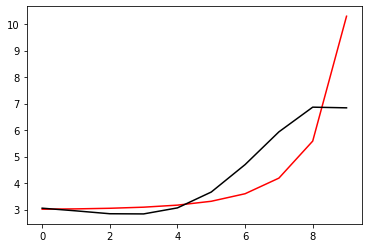

140800 0.02493515932117213
[3.05300987 2.9597237  2.8587864  2.86095824 3.09982309 3.715557
 4.78357963 6.0785384  7.05257351 7.01578988]


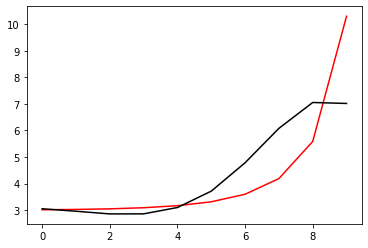

141900 0.010669446034570972
[3.04426815 2.9637561  2.87648579 2.89367207 3.15139319 3.79589852
 4.91591291 6.30038757 7.33600928 7.37470543]


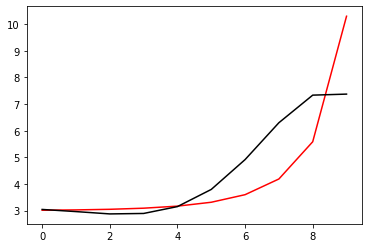

143000 0.0605276862114291
[3.0716566  2.966308   2.8523994  2.83882653 3.05822021 3.64933638
 4.68531958 5.93486129 6.89080129 6.88796299]


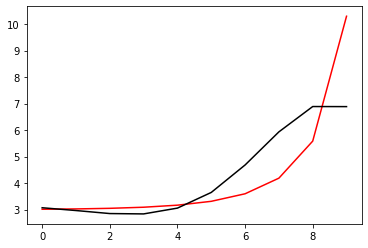

144100 0.01062095553967182
[3.07038193 2.9748121  2.87258938 2.87339845 3.11155698 3.73011322
 4.81035794 6.13178939 7.15540901 7.15549438]


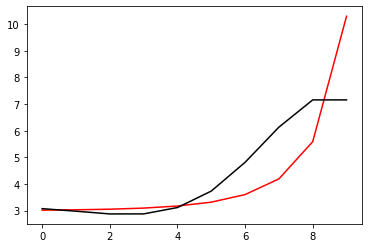

145200 0.017899600839579664
[3.02053484 2.88817022 2.75178475 2.72031502 2.92600385 3.50774477
 4.53771369 5.78166811 6.69808834 6.69835442]


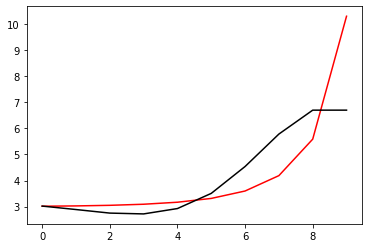

146300 0.011759555559856218
[3.09813628 2.95948967 2.81759207 2.78240232 2.98656714 3.56994683
 4.60690797 5.86857585 6.80800544 6.79330755]


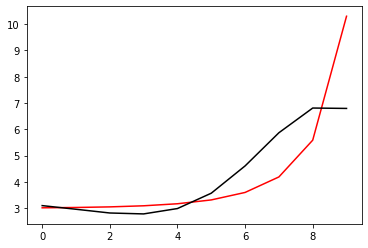

147400 0.004614916732253025
[3.07028771 2.9430699  2.81223594 2.78979124 3.01029622 3.61790223
 4.69571472 6.02912107 7.0548276  7.03162197]


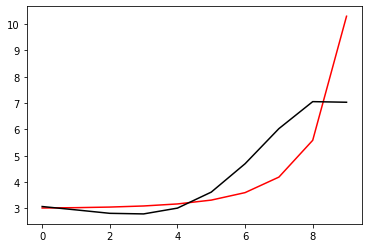

148500 0.005961155769891381
[2.96792852 2.85542039 2.73951375 2.73414762 2.97623284 3.61551717
 4.74742256 6.17927711 7.32399368 7.3196595 ]


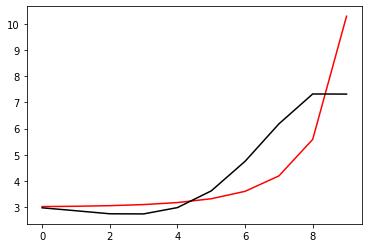

149600 0.5884493795809093
[3.24738295 3.13372892 3.01529296 3.00612345 3.24224773 3.87001619
 4.97186708 6.32701773 7.3862432  7.55959816]


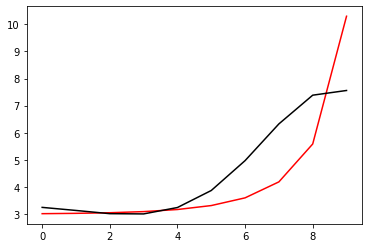

150700 0.02015028987713688
[3.06040361 2.92032239 2.7753121  2.73986322 2.94854302 3.54538095
 4.61197767 5.93846582 6.99389567 6.96510691]


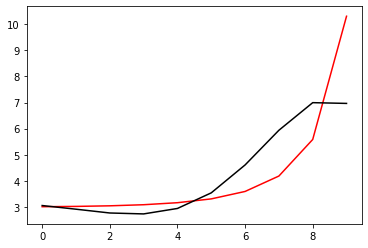

151800 0.022955784112180973
[3.11437385 2.9901781  2.85832817 2.83485673 3.05503617 3.66420509
 4.7471738  6.1036456  7.20083325 7.15399658]


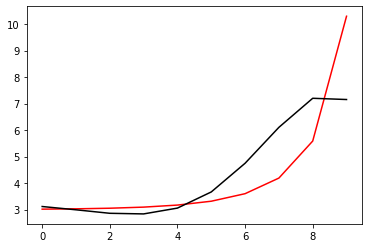

152900 0.010778623670067985
[3.1653362  3.02149348 2.86724108 2.81844639 3.00812165 3.57519432
 4.59071339 5.84889958 6.88328462 6.85883752]


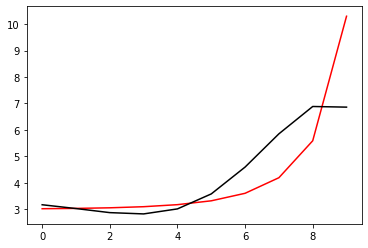

154000 0.06045404767099454
[3.1259728  2.99902097 2.86248718 2.83415769 3.04936417 3.65158735
 4.71974801 6.05637489 7.17221974 7.1744896 ]


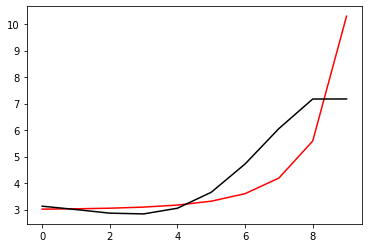

155100 0.010695389897607962
[3.07944177 2.96323839 2.83854607 2.82485999 3.06027165 3.69355338
 4.81407012 6.23931399 7.45197763 7.45408698]


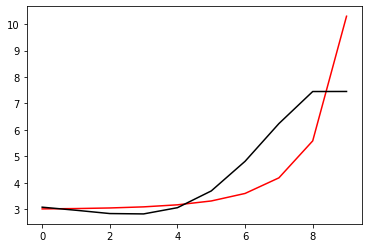

156200 0.016730445976167907
[3.03852903 2.8873174  2.72968887 2.68597009 2.89399674 3.49938573
 4.57692607 5.91507812 7.07282502 7.05146529]


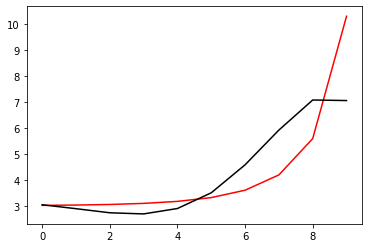

157300 0.010786605788087237
[3.05877286 2.91649928 2.76557845 2.72786658 2.94185697 3.55424334
 4.64303601 6.0057873  7.19799171 7.1969419 ]


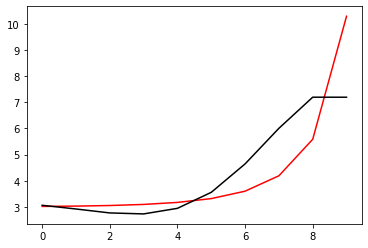

158400 0.0021617837708037212
[3.03620303 2.914047   2.78187429 2.7628063  2.99715174 3.63482138
 4.76111542 6.18827486 7.46006521 7.4248636 ]


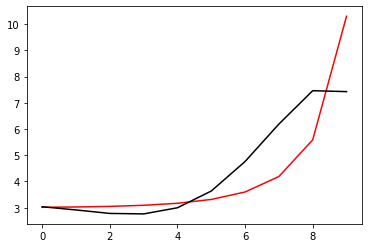

159500 0.007821682740543366
[3.11333433 2.94781204 2.7719569  2.70921215 2.89751013 3.48013604
 4.52849832 5.8435662  7.01457897 7.00324058]


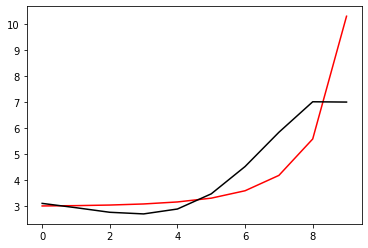

160600 0.004409369573757841
[3.09166047 2.94196009 2.78103193 2.73455302 2.94248119 3.5516302
 4.64004726 6.01838394 7.2641517  7.24463006]


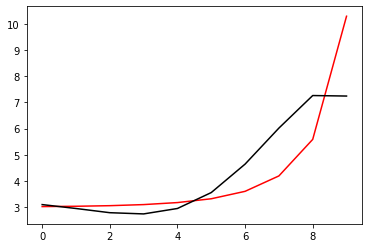

161700 0.010767767427028278
[3.09021584 2.96560261 2.82706463 2.79958525 3.02262667 3.64244114
 4.73861851 6.13118169 7.39325698 7.39108215]


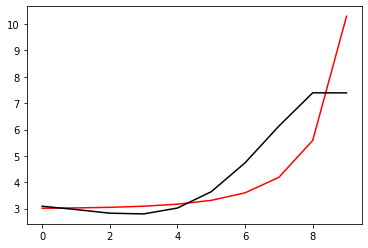

162800 0.02975794649286306
[3.08124013 2.93049897 2.76644937 2.71325091 2.90934133 3.49694809
 4.54540671 5.85923652 7.06860429 7.13122718]


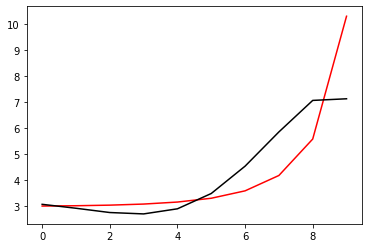

163900 0.010702965657345657
[3.13317821 2.99925762 2.85053351 2.81181758 3.02228676 3.62556584
 4.69445703 6.04113023 7.2876688  7.28744821]


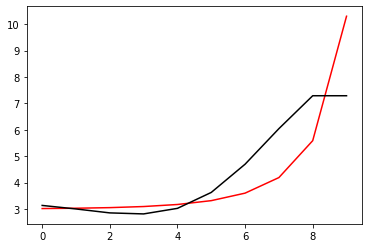

165000 0.2885483362318933
[3.21682108 3.10140147 2.96984845 2.94703597 3.17182324 3.78519915
 4.84278757 5.98901496 6.93345936 7.27678467]


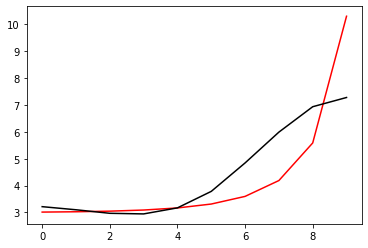

166100 0.01052661944130623
[3.03403342 2.90474263 2.75846685 2.71795532 2.91830259 3.49310723
 4.48565636 5.54587172 6.50026579 6.49764909]


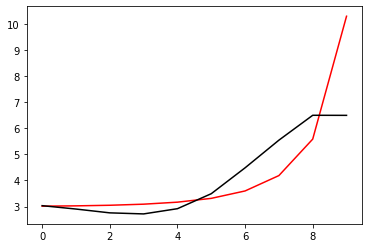

167200 0.02579721837774961
[3.12277234 2.98547211 2.83262859 2.78728318 2.98509994 3.56058234
 4.55888229 5.63625604 6.60631931 6.55122842]


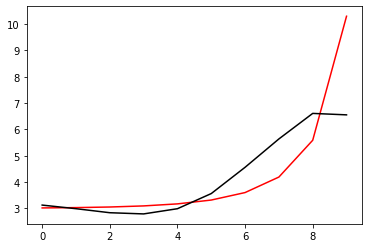

168300 0.011648459335801945
[3.08714473 2.96095211 2.81991357 2.78810675 3.00358508 3.60573531
 4.64941924 5.80802844 6.86333101 6.85521195]


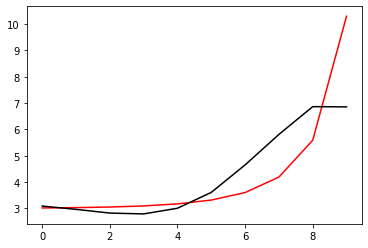

169400 0.002913098807486704
[3.03272853 2.92252007 2.79867348 2.78568743 3.02446677 3.66029276
 4.7598938  6.01853262 7.17035898 7.11442824]


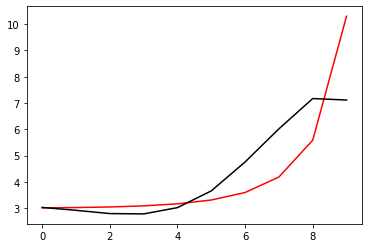

170500 0.04246902961448479
[2.90898964 2.81884317 2.71931617 2.7346966  3.01086192 3.70334314
 4.89761867 6.31282565 7.59991836 7.56559758]


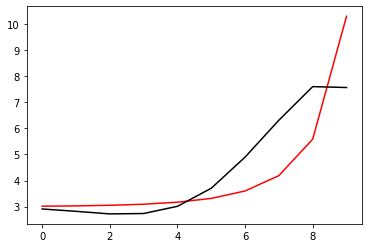

171600 0.0024599729557394975
[3.05097134 2.92820673 2.7949794  2.77463706 3.01008179 3.6487477
 4.75684916 6.04250876 7.2374514  7.20772604]


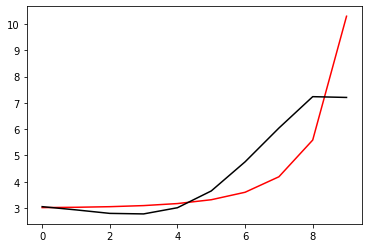

172700 0.3638354616677777
[3.25673547 3.12617635 2.98315648 2.94929542 3.1644986  3.76771242
 4.80324143 5.96035083 7.04882009 7.32011971]


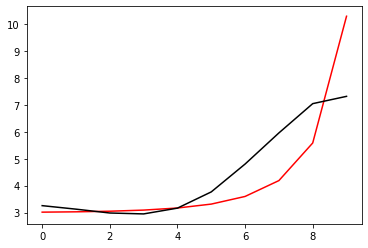

173800 0.030143740150282924
[3.06232369 2.90753714 2.7400369  2.68153987 2.87063539 3.44434474
 4.4472465  5.58124185 6.66643649 6.66121997]


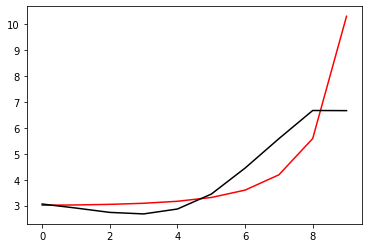

174900 0.010799083802877956
[3.16276171 3.00924159 2.84230995 2.7847697  2.97536616 3.55155875
 4.56008476 5.71285889 6.81744301 6.81663265]


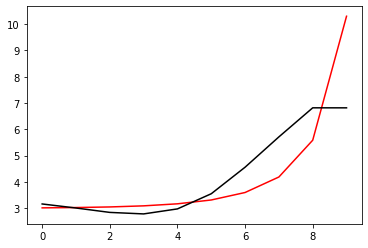

176000 0.06064052347771769
[3.10343589 2.96062318 2.80534918 2.76303608 2.97566087 3.58736011
 4.65862565 5.92508426 7.15768077 7.15661585]


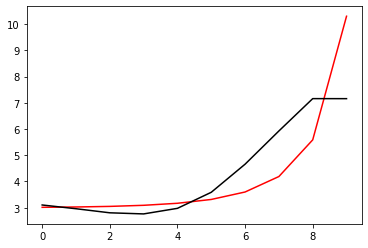

177100 0.011079067173396788
[3.05039139 2.86760446 2.67189209 2.58872128 2.75750174 3.31463621
 4.29852064 5.39982312 6.49583012 6.5229063 ]


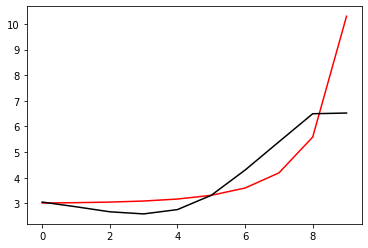

178200 0.021122979523768518
[3.13224782 2.94247002 2.73931536 2.64986014 2.8137874  3.36791493
 4.35246896 5.4657561  6.57943979 6.55170206]


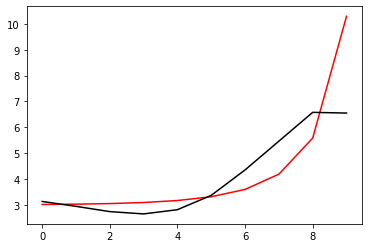

179300 0.011451155192101298
[3.13753734 2.95032079 2.74830941 2.66148012 2.83116158 3.3970625
 4.40611885 5.57316809 6.7586773  6.75303327]


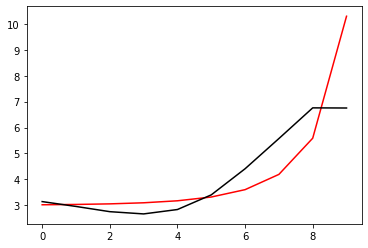

180400 0.011789994768928714
[3.08486907 2.91505651 2.72862941 2.65905616 2.85057491 3.44839216
 4.51163129 5.78000024 7.08385412 7.03072442]


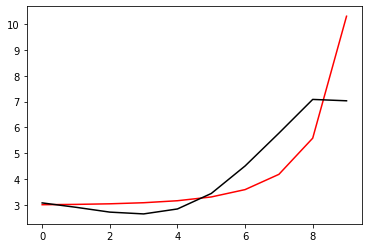

181500 0.0024974619508979917
[3.06374611 2.91822634 2.75340967 2.70491855 2.9201137  3.54951713
 4.66473426 6.0323927  7.43475518 7.43107829]


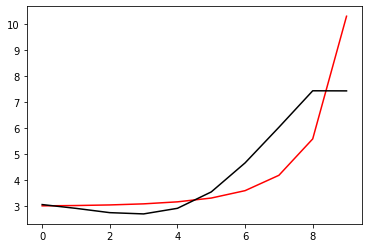

182600 0.0014125273151583643
[3.06869843 2.96547264 2.83490748 2.80859268 3.02820896 3.62991966
 4.64758927 5.77599502 6.86952535 6.84428983]


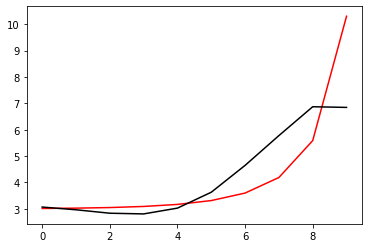

183700 0.010813540283136336
[3.06146561 2.96476436 2.84201737 2.82412328 3.05482645 3.67541849
 4.73564596 5.95659091 7.06941211 7.05805745]


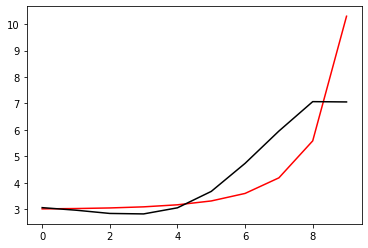

184800 0.01867171088112907
[3.06391459 2.98238899 2.87790742 2.88034378 3.13781697 3.80259634
 4.95370503 6.33347473 7.46142344 7.36609406]


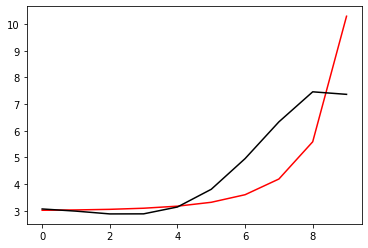

185900 0.0017536829911721948
[3.00626817 2.88737038 2.74874363 2.71618109 2.9359882  3.55706001
 4.65346257 5.95269319 7.00841869 7.02358739]


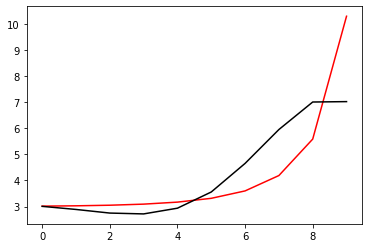

187000 0.06055871411117115
[3.03459417 2.92004604 2.78598515 2.75794076 2.98275233 3.61063981
 4.71847402 6.04307737 7.13306999 7.13461598]


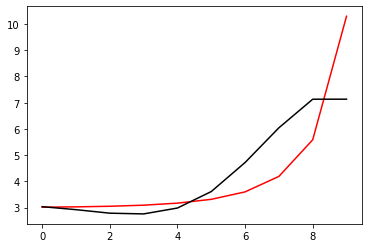

188100 0.01070798289408225
[3.09083945 2.99333075 2.87648551 2.8645117  3.10487412 3.74967432
 4.87972513 6.24523367 7.38516859 7.38656607]


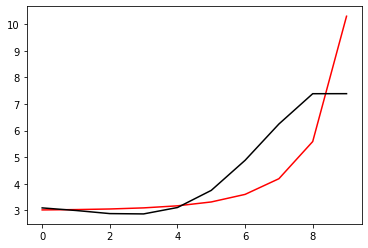

189200 0.018923142396517816
[3.09804159 2.95303314 2.7922814  2.73860086 2.93751124 3.53654255
 4.60685504 5.89610783 6.97498243 6.93534469]


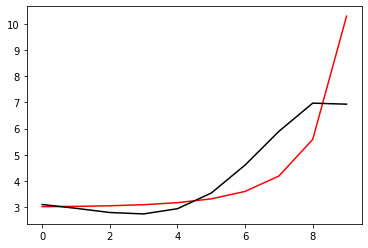

190300 0.01147334356732399
[3.10126561 2.96777112 2.81854239 2.77758556 2.99179325 3.61171481
 4.71380041 6.05549092 7.19818578 7.18884979]


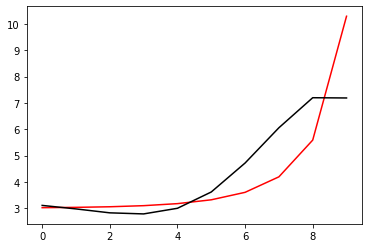

191400 0.002024215218573761
[3.03167237 2.91763772 2.7887658  2.76920905 3.00710808 3.65656454
 4.80112474 6.21283244 7.43812642 7.40452438]


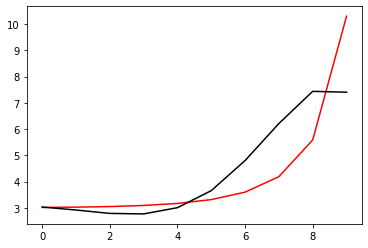

192500 0.0009897271977093937
[3.06773239 2.90665259 2.72829307 2.65500162 2.82936575 3.39237562
 4.39921618 5.59616991 6.65220245 6.6459141 ]


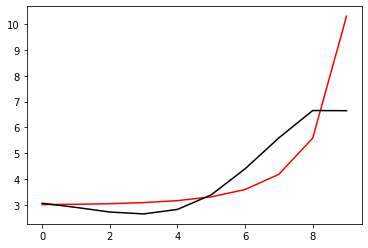

193600 0.002024359571133596
[3.16215182 3.00003901 2.8199299  2.74528063 2.91876908 3.48185081
 4.49166901 5.70207151 6.77566764 6.73945789]


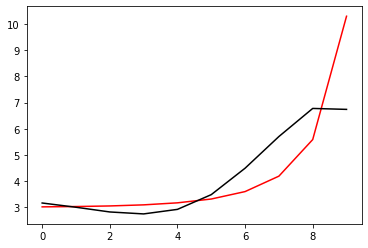

194700 0.013373823639734708
[3.11200082 2.96076143 2.79270709 2.73402237 2.93059841 3.5308368
 4.60550204 5.92787784 7.13082137 7.07880396]


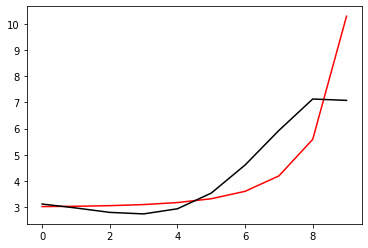

195800 0.027411666111160866
[3.2028129  3.03457832 2.84772169 2.76918754 2.94386789 3.51661889
 4.54647902 5.78245993 6.90923083 6.95098604]


196900 0.010795547661577694
[3.1700278  3.01691653 2.84585258 2.78597444 2.98457107 3.59141116
 4.67415472 5.99138814 7.19818448 7.20123141]


198000 0.06065518564479808
[3.11209012 2.97146359 2.81385476 2.77073103 2.99267767 3.63606931
 4.78097996 6.20127605 7.5088532  7.50734821]


199100 0.010720718181395654
[3.08171251 2.90798226 2.71922691 2.647957   2.84486201 3.4638833
 4.57172722 5.91632117 7.1688908  7.16664653]


200200 0.015261025959963901
[3.0927797  2.93003659 2.75007176 2.68704925 2.89257089 3.52220575
 4.64677026 6.0245816  7.31922042 7.26892921]


201300 0.010826476545215798
[3.06327325 2.92186811 2.76141356 2.71717021 2.94239101 3.5957872
 4.75568704 6.19678109 7.56669491 7.59249416]


202400 0.004665552561818039
[3.1200384  2.96054272 2.78026445 2.71450632 2.9153621  3.53733666
 4.64878689 6.01702072 7.32872726 7.30116187]


203500 0.015827205234926256
[3.00845704 2.86035043 2.69386032 2.6457739  2.87128531 3.53132115
 4.70741778 6.18291584 7.6032401  7.57371694]


204600 0.0076384086321923
[3.14907191 2.96486526 2.76046657 2.67259255 2.85325045 3.45511863
 4.54192878 5.87881464 7.16159968 7.14963905]


205700 0.01086643676463562
[3.15966802 2.99176068 2.80203905 2.72919978 2.92708759 3.55161372
 4.67287546 6.06655911 7.41591462 7.40185281]


206800 0.08488388855073403
[3.03151111 2.83885314 2.62501431 2.52918116 2.70479285 3.30571804
 4.39879078 5.76364745 7.09432321 7.16917774]


207900 0.010973085547253313
[3.22346596 3.02120742 2.7967374  2.69085253 2.85699031 3.44866771
 4.53328116 5.89505656 7.22487802 7.22562448]


209000 0.06077085352474203
[3.17327068 2.9936456  2.78901065 2.70265633 2.89011962 3.50861046
 4.6329781  6.05994855 7.46993324 7.46120936]


210100 0.010837373150347806
[3.14211206 2.98301455 2.79756096 2.73086796 2.94170909 3.59259351
 4.76882282 6.28342711 7.79543936 7.79998037]


211200 0.01683833238088254
[3.15449433 2.96139045 2.74307235 2.64477036 2.82452972 3.44038137
 4.56489132 5.99978778 7.45889192 7.41440795]


212300 0.011516117118424098
[3.16405507 2.98634918 2.78175594 2.6972247  2.89275432 3.52968826
 4.68713097 6.1769286  7.70044555 7.68702652]


213400 0.00389080549293737
[3.09451128 2.96206873 2.79767922 2.7462269  2.96505186 3.60872878
 4.7361375  6.11368316 7.5167194  7.48704644]


214500 0.005475357425148767
[3.05487414 2.93075827 2.77617331 2.73514122 2.96720263 3.63277482
 4.81033256 6.30898642 7.77925723 7.77061102]


215600 0.0008934297732840718
[3.04590454 2.93359271 2.7939673  2.76891332 3.02086528 3.71809649
 4.96277557 6.59810959 8.12476409 8.09561559]


216700 0.017850153807832444
[3.01438027 2.90088655 2.76048575 2.73111732 2.97214588 3.64698479
 4.84943464 6.38788491 7.68759062 7.69872979]


217800 0.022865648569753594
[3.04883381 2.93786326 2.80083078 2.77532834 3.02141901 3.70404371
 4.92001976 6.48229765 7.8082399  7.77461202]


218900 0.01082928415082279
[3.05757907 2.95334794 2.82358653 2.80506974 3.05873301 3.75153019
 4.98465426 6.57962666 7.94653218 7.96592726]


220000 0.058101666463633676
[3.0514612  2.96164051 2.84807825 2.84592316 3.11793679 3.8354661
 5.10869972 6.77314814 8.21948701 8.18648671]


221100 0.010908766763360661
[2.95734034 2.88405941 2.7904029  2.80721818 3.09845568 3.83977398
 5.15188479 6.89272393 8.43889836 8.52593287]


222200 0.6696454313509494
[3.18377931 3.11918772 3.03792437 3.06370304 3.35828445 4.09392762
 5.37306672 6.89059928 8.14988277 8.50195381]


223300 0.010739775086969439
[2.96178817 2.88453157 2.78571385 2.78440676 3.03372167 3.68721401
 4.80617095 6.05634932 7.26443865 7.26495186]


224400 0.001972061301730252
[2.99414653 2.92103168 2.82736021 2.83174909 3.08786459 3.75094615
 4.88558754 6.16523808 7.40051904 7.38735124]


225500 0.008021529099996736
[2.97938689 2.91298391 2.82800354 2.84212374 3.1099593  3.78994176
 4.95368475 6.2911299  7.58929394 7.58413992]


226600 0.7305054119125367
[3.26403954 3.19318977 3.10622178 3.1186163  3.38455851 4.06178236
 5.2148795  6.50600505 7.68762211 7.8117999 ]


227700 0.010815623846098497
[3.04023652 2.95115504 2.84496201 2.83495757 3.07140263 3.70525629
 4.7915528  6.0129758  7.22694285 7.21920004]


228800 0.01791711905087539
[3.0429454  2.97032764 2.8849462  2.90001239 3.16728709 3.84298669
 4.9918037  6.31026903 7.60380496 7.50715643]


229900 0.04903169560395881
[2.92220397 2.81528672 2.69996226 2.68759613 2.92755515 3.57265476
 4.68011813 5.94474884 7.19239719 7.20069604]


231000 0.06059206533066931
[3.02835164 2.9169698  2.79742274 2.7817257  3.01877272 3.66154244
 4.76908004 6.0453975  7.30915416 7.31123367]


232100 0.010680995589303017
[3.0296408  2.92689557 2.81577782 2.80914859 3.05593145 3.71093542
 4.83871377 6.1603941  7.48143805 7.4815247 ]


233200 0.015451134576356315
[3.04082625 2.94519854 2.83905879 2.83406848 3.07571664 3.7115848
 4.78671676 5.97412897 7.08922703 7.01902582]


234300 0.010960366203202775
[3.03209157 2.94354043 2.84543106 2.84993037 3.10410242 3.76085366
 4.88248472 6.17659085 7.32248172 7.31754375]


235400 0.0012075636121489117
[2.97196006 2.89352801 2.80719035 2.82489143 3.09500777 3.77625657
 4.95114209 6.37300378 7.58613138 7.57355908]


236500 0.0011382001305272928
[3.0092594  2.88952072 2.75988744 2.73101357 2.94679521 3.55542992
 4.61254089 5.79089442 6.81562844 6.80389314]


237600 0.010583343044510855
[2.9913975  2.87935419 2.75764587 2.73785221 2.9643158  3.58721912
 4.66700727 5.88997686 6.96659177 6.96926903]


238700 0.010649680052143907
[3.06181063 2.9685473  2.86560621 2.86488699 3.11077021 3.75512872
 4.86312384 6.13762444 7.26558107 7.28499457]


239800 0.021987605932617213
[3.08839888 2.98870475 2.88056693 2.87329297 3.10799694 3.73026338
 4.79170168 5.99669603 7.08842395 7.12309146]


240900 0.0107446363105579
[3.06612413 2.9818436  2.89161453 2.90518767 3.16446488 3.81796727
 4.92390404 6.19931886 7.3569035  7.35482955]


242000 0.06056891247131272
[3.06288191 2.93403742 2.80253024 2.77653511 2.99435711 3.59755336
 4.63115836 5.80567277 6.86333401 6.88674532]


243100 0.010605005152454381
[3.08799689 2.96639114 2.8412276  2.82196298 3.04730316 3.66007566
 4.70872047 5.91217808 7.00597296 7.00656627]


244200 0.013284919357940447
[3.03554703 2.92810766 2.81766352 2.8156481  3.06256602 3.70546157
 4.8016372  6.08541791 7.27496079 7.20700066]


245300 0.010768555356929858
[3.05734304 2.90326732 2.74796772 2.70306833 2.90647676 3.50022836
 4.53492173 5.74721316 6.86756724 6.86624924]


246400 0.008060534601715184
[3.05781784 2.91485822 2.76802494 2.73140743 2.94352726 3.54797931
 4.59982554 5.84712664 7.01581267 6.98288043]


247500 0.010621384856004296
[3.10170512 2.9740449  2.83926918 2.8143514  3.03893235 3.65900658
 4.73651391 6.03677895 7.27616334 7.3201387 ]


248600 0.0007996219498508159
[3.02657389 2.94302095 2.84683438 2.85286532 3.09720518 3.71823579
 4.7582977  5.93590755 7.01854478 6.96063767]


249700 0.010717774757572301
[3.00420869 2.9315321  2.84900881 2.87095229 3.13609387 3.78981119
 4.89453604 6.2046609  7.38187394 7.37098663]


250800 0.02145484472977073
[3.07802724 2.98565137 2.88457029 2.88586254 3.12607383 3.74624114
 4.80142128 6.0238383  7.11415101 7.18196237]


251900 0.010659524866234917
[3.05003498 2.96875532 2.88129156 2.89873733 3.15898988 3.80681903
 4.90579148 6.2022549  7.36235991 7.35511144]


253000 0.060527232083570616
[3.11785227 2.98762527 2.85309578 2.82441719 3.03725089 3.63123159
 4.65898859 5.85398781 6.92659157 6.93107933]


254100 0.010614945172036542
[3.10021457 2.97791377 2.85130894 2.83191895 3.05609983 3.66545912
 4.71753645 5.95672016 7.08224248 7.08329015]


255200 0.010936190355090428
[3.04875053 2.94461526 2.83807883 2.8423707  3.09584426 3.74474598
 4.85602243 6.18894402 7.41468644 7.38545136]


256300 0.011082458623856614
[3.08654214 2.94100369 2.79353846 2.75779244 2.96996852 3.57138384
 4.62081326 5.87679837 7.03080281 7.01271412]


257400 0.0034593566206410904
[3.06528714 2.93420862 2.80078354 2.78126699 3.01378318 3.64341347
 4.73613029 6.06175058 7.29637601 7.27581797]


258500 0.043237325519324285
[2.93010131 2.81940729 2.70751181 2.71236755 2.97421489 3.64284725
 4.7946543  6.21675798 7.55959171 7.53552079]


259600 0.0011668103403596087
[3.13571991 2.9762742  2.81429455 2.76665136 2.96859662 3.55909379
 4.59530751 5.85204543 7.02288451 7.00859645]


260700 0.0107646148905367
[3.12241578 2.9749411  2.82369443 2.78773988 3.00369029 3.61322403
 4.67942501 5.98740443 7.2201914  7.22588371]


261800 0.02524155876491264
[3.08271659 2.94981284 2.81278232 2.79358347 3.03156948 3.67358646
 4.79335797 6.19179731 7.52817923 7.51523955]


262900 0.010739622509438157
[3.11727301 2.97206804 2.81966388 2.78211506 2.99683797 3.60460325
 4.66523232 5.97007789 7.25343847 7.24655792]


264000 0.060079906625325565
[3.11767388 2.9919185  2.85962713 2.84439068 3.08551556 3.72728486
 4.83612021 6.209625   7.5517384  7.54968789]


265100 0.010494200792856477
[3.04755832 2.8779049  2.70024822 2.63755971 2.82576621 3.39927982
 4.39811653 5.57349159 6.77749401 6.80692575]


266200 0.025621504901785275
[3.22079061 3.04293594 2.85540988 2.78219015 2.95878064 3.51833475
 4.49987018 5.65762512 6.83964847 6.81039847]


267300 0.010961474282494273
[3.09688165 2.93251593 2.75817664 2.69998405 2.89543592 3.48174862
 4.50716515 5.74160359 7.01791632 7.02631472]


268400 0.003151844317378193
[3.07172151 2.92878128 2.77637676 2.74264434 2.96770948 3.59384816
 4.68025629 6.01237607 7.3894874  7.34185131]


269500 0.010821675141304714
[3.11019945 2.99121723 2.86109076 2.84818695 3.09352936 3.74099838
 4.85622722 6.24094919 7.66365301 7.69220987]


270600 0.0015846575519748332
[3.08868685 2.96717956 2.82960855 2.79946744 3.01071098 3.59267978
 4.58469839 5.76187866 6.91790977 6.91888034]


271700 0.010982799130698512
[3.08816781 2.97058303 2.83685459 2.81066926 3.0268021  3.61628075
 4.62257287 5.82649464 7.00253871 6.99563912]


272800 0.026521871290732465
[3.08399119 2.97368722 2.8473262  2.82883226 3.05450343 3.65853984
 4.69192635 5.94476139 7.15676699 7.13233854]


273900 0.01065940025038365
[3.07400414 2.97580517 2.8620998  2.85675572 3.09852416 3.72674725
 4.80412101 6.13319999 7.3992543  7.43871648]


275000 0.1088549939318651
[2.97813303 2.84052323 2.68653824 2.63751022 2.82893251 3.39191631
 4.37052381 5.53316883 6.68688432 6.71321114]


276100 0.010965611026812748
[3.2128282  3.05998672 2.88988124 2.82393465 2.99668841 3.53697304
 4.48548756 5.61031182 6.71470851 6.72225896]


277200 0.02267395029899021
[3.14874312 3.00898739 2.85290379 2.80321723 2.99649805 3.56622067
 4.56322857 5.77233213 6.97820079 6.86435901]


278300 0.010855830985438863
[3.06485095 2.93721813 2.79562142 2.76473154 2.98493584 3.59787787
 4.67097561 6.01022425 7.35528115 7.40658288]


279400 0.013613926827968423
[3.09123387 2.91435271 2.72197036 2.63781485 2.79808526 3.33370966
 4.28579935 5.41240334 6.57750454 6.56319047]


280500 0.0009465966426060494
[3.08496932 2.90907118 2.71631766 2.63177166 2.79182422 3.32793373
 4.28375192 5.42616076 6.61478389 6.60476871]


281600 0.010625422167880644
[3.09417518 2.91845811 2.7237842  2.63636697 2.79255947 3.32384264
 4.27629833 5.42977379 6.64043088 6.64729742]


282700 0.028817626105109323
[3.09561813 2.92454882 2.73375758 2.65170587 2.81682498 3.36524197
 4.35543622 5.59418829 6.90589084 6.88403406]


283800 0.029781760608434942
[3.10321292 2.94764872 2.77126501 2.70438131 2.88751685 3.46190411
 4.50053965 5.83889747 7.24202901 7.25166404]


284900 0.5843622555689595
[2.72839445 2.6090474  2.47167149 2.4463544  2.67624018 3.30877788
 4.42915763 5.8796364  7.35113681 7.79669061]


286000 0.060406368866730606
[3.0357347  2.91922358 2.78041302 2.74614633 2.95449632 3.54239675
 4.57503476 5.8701237  7.12581852 7.12169392]


287100 0.010633204258085695
[3.09078861 2.98541929 2.85807773 2.83499648 3.05574108 3.66008967
 4.71895731 6.05765303 7.3484888  7.34984683]


288200 0.01092037164466524
[2.99330968 2.906991   2.80204208 2.8036956  3.05576514 3.70732628
 4.8487956  6.32988755 7.76578119 7.71760654]


289300 0.010833923071262913
[3.05332315 2.93825687 2.80206474 2.76630188 2.97008697 3.55191734
 4.57999086 5.87600744 7.16801614 7.14010185]


290400 0.0023358000576860867
[3.03432201 2.92985026 2.80741803 2.78875636 3.01561106 3.63271204
 4.72082435 6.1168764  7.5094646  7.48135025]


291500 0.0010466081950514863
[2.97076547 2.87675167 2.76985133 2.77174382 3.028253   3.69373404
 4.86743114 6.40349189 7.92620649 7.90618538]


292600 0.0006723601259737983
[3.0493875  2.98361213 2.90179476 2.92033458 3.17872513 3.81670838
 4.88960362 6.1413037  7.33144829 7.36904267]


293700 0.01064318528002816
[3.00767725 2.94638038 2.86965476 2.89279751 3.15566735 3.79962502
 4.88758764 6.19457471 7.41461124 7.41576234]


294800 0.016594334912490336
[2.98766832 2.93645868 2.8724569  2.90999591 3.19192294 3.86874671
 5.03377951 6.50572872 7.72191057 7.61937362]


295900 0.04746178637091121
[2.88532051 2.80889136 2.72441936 2.7429266  3.006193   3.66518543
 4.82111889 6.30186406 7.44557417 7.47204961]


297000 0.06010292686173759
[3.02474776 2.94595347 2.86078853 2.87986968 3.14499406 3.80799182
 4.97183716 6.47035845 7.64179314 7.64154401]


298100 0.010870367991541927
[3.03436366 2.9611909  2.88401691 2.91268179 3.18952798 3.86913502
 5.06019231 6.60984117 7.85573046 7.86743831]


299200 0.018124459626790875
[3.0531738  2.94783478 2.83594412 2.82392181 3.04696252 3.64360795
 4.68444193 5.95741705 6.91435392 6.90893485]


300300 0.01120621809576253
[3.05162692 2.9511039  2.84415699 2.83789915 3.06858784 3.67790867
 4.7446201  6.06699923 7.04862964 7.02550225]


301400 0.0031688551061080272
[3.02608696 2.93382017 2.83549929 2.8391177  3.08262915 3.71287233
 4.82213488 6.22659918 7.25813171 7.23642297]


302500 0.02040294596188217
[2.91936799 2.83763252 2.75090293 2.7675424  3.02729664 3.68347362
 4.8471621  6.36918667 7.50198339 7.47134987]


303600 0.010578242539650002
[3.02643728 2.89452895 2.7553156  2.71499894 2.90681299 3.46912866
 4.47727594 5.70719157 6.5731433  6.57127422]


304700 0.01079281201189503
[3.12615848 2.98941351 2.84599383 2.80371189 2.99653068 3.56459779
 4.58662886 5.84543708 6.74883721 6.74173319]


305800 0.02394317521054251
[3.1119273  2.99041728 2.86247123 2.83820713 3.05358168 3.65366857
 4.72631895 6.06745342 7.06571384 7.01998118]


306900 0.17114577184895635
[2.83412105 2.72408912 2.6088499  2.5999966  2.83431271 3.46060978
 4.57667843 6.00226966 7.11856059 7.37248745]


308000 0.06021136074535744
[3.01816854 2.90165493 2.77622059 2.75088615 2.95676912 3.52952087
 4.52937184 5.59732292 6.3109875  6.30269597]


309100 0.010523574550466255
[3.1278073  3.00161119 2.86734972 2.83435598 3.03358186 3.6002912
 4.59384703 5.65906483 6.36829534 6.37336492]


310200 0.022385054291484033
[3.10330227 2.98634381 2.86210784 2.84153878 3.05780233 3.65101135
 4.68960153 5.83527114 6.63477026 6.5391829 ]


311300 0.011022929977964682
[3.04096578 2.93903411 2.83114191 2.82958386 3.07013327 3.69890164
 4.7956732  6.04417658 6.95112282 6.98278106]


312400 0.005847023268832824
[3.0479144  2.96153645 2.87163032 2.89152827 3.16053128 3.83234727
 4.99984909 6.36900249 7.38295771 7.27861226]


313500 0.003008816029467392
[2.96020016 2.88467424 2.80345188 2.82615761 3.0877866  3.73266216
 4.83073605 6.06527448 6.92240138 6.90973296]


314600 0.0007270747850375377
[2.96756315 2.90485072 2.83862531 2.87856813 3.16281977 3.84373757
 5.01045994 6.36671921 7.26808705 7.19655613]


315700 0.11057299212272409
[2.86460284 2.7780871  2.69213643 2.71417073 2.98214154 3.64887296
 4.80393574 6.14260067 7.00837233 7.42419854]


316800 0.02302322023568474
[3.06193119 2.9543245  2.84867806 2.85278689 3.10369443 3.7527281
 4.88783089 6.21082869 7.06577111 7.02235171]


317900 0.010725708699336546
[3.05166035 2.95855207 2.86795667 2.88894815 3.15979227 3.83485954
 5.00769455 6.39526788 7.33077195 7.34374007]


319000 0.06013985123561903
[3.01211459 2.885104   2.760898   2.74849664 2.98392047 3.61638188
 4.72903533 6.04054793 6.93051342 6.91797187]


320100 0.010667923225172567
[3.08126764 2.96948304 2.85846371 2.858448   3.10551634 3.74937067
 4.87479733 6.21055657 7.13296754 7.13316387]


321200 0.017895467743084613
[3.02723413 2.87870084 2.73322805 2.70055136 2.91386697 3.51696477
 4.58407389 5.8378787  6.66055921 6.65783565]


322300 0.011332668666090069
[3.09721143 2.94267453 2.79155149 2.7548779  2.96609662 3.56956464
 4.64103743 5.9085731  6.7513405  6.7439717 ]


323400 0.004803747952274308
[3.08432632 2.94159804 2.80105662 2.77650917 3.00340669 3.63011273
 4.74027331 6.07586736 7.00309913 6.9795811 ]


324500 0.006020663351280627
[2.97988334 2.85207945 2.72536043 2.7165986  2.96378622 3.62055001
 4.7819694  6.21235985 7.25847997 7.25120755]


325600 0.0008644422925564804
[3.0366211  2.91919724 2.80100933 2.80146909 3.06024615 3.73377637
 4.92390669 6.41378814 7.52683602 7.5202022 ]


326700 0.010821747679092986
[3.0266846  2.92664004 2.82685324 2.84684839 3.12921216 3.83469131
 5.07296078 6.64851946 7.86122886 7.85732394]


327800 0.019065185778901983
[3.03739254 2.94916432 2.8579841  2.88034306 3.15414975 3.82924884
 4.98790319 6.38456446 7.33861676 7.32618275]


328900 0.01071850397655002
[3.02093201 2.93684754 2.84990361 2.87656561 3.15544084 3.83797896
 5.01084915 6.43706411 7.41803365 7.41040788]


330000 0.06019667332097056
[3.00303203 2.92593376 2.84636254 2.8806056  3.16848662 3.86422383
 5.06163707 6.53584469 7.55720902 7.55487132]


331100 0.010837682082310788
[2.99542039 2.93093083 2.86551793 2.91498766 3.22168264 3.94550751
 5.19309326 6.75315419 7.83433901 7.84438565]


332200 0.008351637798223717
[3.01842047 2.93017738 2.84234703 2.86749223 3.14396338 3.82344932
 4.99627727 6.42999452 7.35030447 7.33113344]


333300 0.010790873740278518
[2.99549648 2.91281736 2.83059637 2.86156561 3.14491364 3.83442525
 5.02578577 6.49653887 7.4546637  7.44941736]


334400 0.0011598341258420852
[2.96460731 2.89096609 2.81817644 2.85895658 3.1538701  3.86011383
 5.08174235 6.61069177 7.62627661 7.62056854]


335500 0.022189861677372087
[2.8786532  2.81638884 2.75776901 2.81489178 3.13089621 3.86979406
 5.15237824 6.79708793 7.92724564 7.8989996 ]


336600 0.007042093866956485
[3.01743346 2.90550067 2.79423402 2.79164282 3.03167084 3.65757351
 4.74274162 6.00872101 6.67200356 6.66397899]


337700 0.011554721534598305
[3.03710419 2.9299489  2.82329401 2.82584848 3.07224832 3.70723222
 4.80707566 6.09899965 6.79577221 6.76678847]


338800 0.023998992097968838
[3.04298794 2.944203   2.84587928 2.85763031 3.11519567 3.76578064
 4.89063646 6.22687072 6.98137148 6.94422027]


339900 0.010702193411390488
[3.03621031 2.94992805 2.86438919 2.8900683  3.16428585 3.83782644
 4.99924901 6.40029597 7.23746369 7.28357092]


341000 0.11260003955458844
[2.92017639 2.80025781 2.6794652  2.66629875 2.89368966 3.50200042
 4.55527519 5.77513896 6.48616024 6.5207415 ]


342100 0.010566804314645793
[3.01474432 2.89006022 2.76381271 2.74507972 2.96636676 3.56740622
 4.61215162 5.82656468 6.5366367  6.5373389 ]


343200 0.016401381127983956
[2.99859762 2.88327405 2.76561465 2.75603122 2.98784111 3.60260344
 4.66846206 5.92189985 6.68792289 6.65071987]


344300 0.010831963531863853
[3.02809216 2.9230756  2.81594881 2.81893706 3.06719944 3.70592201
 4.81059748 6.13302065 6.9903133  7.05227876]


345400 0.008077613198817231
[3.07910025 2.9320792  2.78387679 2.74707538 2.95456474 3.54555815
 4.58259626 5.8079348  6.58364526 6.54606416]


346500 0.010064894341574404
[3.07988162 2.9449431  2.80732705 2.78188259 3.00276726 3.61153855
 4.67540585 5.94564148 6.77988399 6.78378671]


347600 0.6816271476607414
[3.33254481 3.20357897 3.07049078 3.04929209 3.27387882 3.88299507
 4.93249909 6.15071324 6.91753773 7.04428951]


348700 0.026535744937184382
[3.04387979 2.90390659 2.7573154  2.72048015 2.92613324 3.51153379
 4.53630526 5.75917735 6.60157946 6.58453258]


349800 0.02821131848807446
[3.09518443 2.96337597 2.82515243 2.79943649 3.02163084 3.63381207
 4.70478396 6.00452787 6.92543716 6.92199026]


350900 0.04098691844664771
[2.99728553 2.83718815 2.67371626 2.62787597 2.83672912 3.44294751
 4.50738256 5.77271781 6.66420333 6.69669012]


352000 0.05974986862687572
[3.05932234 2.89527819 2.72684095 2.6767862  2.88248584 3.48696696
 4.55290897 5.82928113 6.74111889 6.7325379 ]


353100 0.010654941344026777
[3.05880933 2.90657059 2.74598803 2.70214778 2.91318435 3.52307356
 4.59805106 5.89816661 6.84875736 6.84974617]


354200 0.01385102721700059
[3.10040695 2.96949913 2.82798513 2.80393338 3.0389663  3.68198127
 4.80858923 6.19515863 7.25534807 7.09083043]


355300 0.010936912293207141
[3.0930857  2.9234891  2.74485552 2.68477734 2.88259798 3.48005693
 4.53647907 5.81867042 6.79912301 6.78847011]


356400 0.005309151538087987
[3.10404135 2.9465329  2.77784642 2.72756903 2.93651423 3.54861422
 4.6277823  5.94930446 6.98262922 6.93504097]


357500 0.010081517297370082
[3.07522987 2.94731311 2.8047568  2.77809473 3.00995275 3.64695747
 4.75909585 6.13356777 7.23422641 7.25282616]


358600 0.5628668480041092
[3.25704374 3.13662255 3.00117857 2.97895201 3.21243806 3.84510464
 4.93695764 6.26613474 7.33846813 7.50501761]


359700 0.02392591359778179
[3.06274772 2.91505458 2.75284292 2.70371076 2.90838413 3.50749138
 4.55960094 5.85036828 6.89825406 6.8795194 ]


360800 0.02372744233699577
[3.14246925 3.0048099  2.85147886 2.81114708 3.02581985 3.63819929
 4.71146486 6.0400059  7.13872483 7.11406799]


361900 0.2290083525708739
[2.84099872 2.72104471 2.58697202 2.56748155 2.80589896 3.44812176
 4.56588873 5.97032714 7.170833   7.41489716]


363000 0.06007778963795642
[3.01383416 2.89435005 2.7563893  2.7259815  2.94103849 3.53404863
 4.53651442 5.55986559 6.4071249  6.39771085]


364100 0.010543084792019021
[3.10996373 2.9815288  2.83598536 2.79901518 3.00846127 3.59648874
 4.59414173 5.61681938 6.45787029 6.46172474]


365200 0.0215577976193125
[3.10431052 2.98555674 2.85066496 2.82602372 3.05186069 3.66524788
 4.70694472 5.808318   6.72304234 6.6260165 ]


366300 0.011018296255958031
[3.04509515 2.94202748 2.82441735 2.81848072 3.06720029 3.71367221
 4.81120214 6.01416813 7.02305296 7.05258364]


367400 0.004572492479246431
[3.04185507 2.95402087 2.85495768 2.86971072 3.14485127 3.83124162
 4.99755336 6.32406607 7.43302872 7.32907128]


368500 0.011508982967056417
[3.09017335 3.00230793 2.90240051 2.91016542 3.16725562 3.81306882
 4.88745708 6.03342137 6.91951937 6.9617346 ]


369600 0.0007080113047976655
[3.00289856 2.92563158 2.83822657 2.85939672 3.13225071 3.80134772
 4.92319311 6.18199588 7.15687497 7.10168879]


370700 0.19267306745924434
[3.16135978 3.06856808 2.96625312 2.96988228 3.22011794 3.85639719
 4.92236439 6.06042455 6.90588072 7.25154697]


371800 0.029282123632997852
[3.07330452 2.97004725 2.85539787 2.84299102 3.06965734 3.66688272
 4.66167479 5.6717207  6.35021924 6.33191197]


372900 0.010663639976328874
[3.06993192 2.97227954 2.86347485 2.85750343 3.09226361 3.70213831
 4.72135923 5.77978593 6.48596307 6.48109551]


374000 0.06043732104791244
[3.05965284 2.97141868 2.87279135 2.87809837 3.12710779 3.75923961
 4.82085169 5.95974201 6.71197849 6.7138336 ]


375100 0.010726928643347518
[3.04745511 2.97656065 2.89732521 2.9239246  3.19925237 3.87100048
 5.00355535 6.26264704 7.07471357 7.09182251]


376200 0.0226703550996755
[3.06342805 2.96380319 2.85427476 2.84627129 3.07867434 3.68992908
 4.7195112  5.77254538 6.47601286 6.39736045]


377300 0.011168685315966133
[3.02887496 2.93893786 2.84189637 2.84979336 3.1032779  3.745322
 4.82356442 5.95798141 6.73857886 6.71095436]


378400 0.0018152353909693486
[2.97015841 2.89678321 2.82092329 2.85413152 3.13861222 3.82231054
 4.96253904 6.19977137 7.0733002  7.03207031]


379500 0.00895332882313502
[3.03045852 2.92321341 2.81159392 2.80569047 3.04325481 3.66097641
 4.68494159 5.69711755 6.42711288 6.41322963]


380600 0.0059207803988784785
[2.99115192 2.89607376 2.79965263 2.81341595 3.07733004 3.73319922
 4.81631347 5.92452522 6.74432698 6.7247227 ]


381700 0.11233305732882805
[2.86156501 2.75151231 2.64416808 2.65036539 2.90893652 3.55904379
 4.6278191  5.71362922 6.51320256 6.90691684]


382800 0.02972628357268926
[3.01708476 2.89757399 2.77997344 2.77537368 3.02127515 3.65482923
 4.7016246  5.76579613 6.53944252 6.53017491]


383900 0.010739640379188233
[3.02994205 2.91973699 2.81044904 2.81475734 3.07098281 3.71830313
 4.78755045 5.89843226 6.73114367 6.73453514]


385000 0.06035822417945337
[3.08011651 2.9913236  2.90170769 2.92485477 3.19984498 3.86795371
 4.96632994 6.13549466 7.03422647 7.00310791]


386100 0.010507228746021613
[3.05612679 2.9504419  2.84195506 2.84080274 3.07972435 3.686295
 4.67067555 5.65134899 6.32091428 6.33994668]


387200 0.02255688120521024
[3.05500254 2.95369648 2.84974486 2.85392995 3.10003716 3.71811021
 4.72423459 5.74567747 6.44609611 6.39981981]


388300 0.011553041800970852
[3.03699213 2.94310856 2.84675209 2.85953592 3.11681645 3.75241521
 4.79175106 5.87681754 6.62862655 6.64119508]


389400 0.002739975150733125
[2.98861564 2.90690922 2.82320762 2.84983658 3.12435921 3.78607565
 4.87419277 6.05226405 6.87918039 6.82564187]


390500 0.02821054805891273
[2.87894525 2.81655369 2.75392103 2.80288529 3.10369538 3.80275684
 4.95753442 6.2614815  7.19416367 7.17946178]


391600 0.010467668447455222
[2.9992907  2.88604424 2.77019652 2.76116142 2.99276629 3.59613167
 4.59256834 5.61790937 6.32601272 6.31999776]


392700 0.023531048734974705
[3.00453847 2.89680773 2.78636935 2.78345489 3.02244576 3.63603601
 4.64990666 5.71189306 6.468573   6.44599589]


393800 0.03030341484184736
[3.08179477 2.93380234 2.78302284 2.738627   2.9311992  3.4862778
 4.41888898 5.37106486 5.99040689 5.98557149]


394900 0.01751868968803484
[2.99603634 2.86035294 2.72067809 2.68795274 2.89388663 3.46655773
 4.42663228 5.4281115  6.11701495 6.07784255]


396000 0.06049908698734181
[3.15329106 3.01406301 2.86919793 2.83079026 3.02968566 3.59261212
 4.53996694 5.53345533 6.21021286 6.21335807]


397100 0.010488475332148006
[3.00090505 2.87531131 2.7440864  2.72110529 2.93876407 3.52790062
 4.52030254 5.6050414  6.40676594 6.40417308]


398200 0.022473617205641803
[3.08336341 2.9280843  2.76649094 2.71130438 2.89097572 3.42812987
 4.33881931 5.29201807 5.91386957 5.90220173]


399300 0.012262165081625061
[3.09782068 2.94094485 2.77776055 2.72220245 2.90323591 3.44468173
 4.36587141 5.34324392 5.99695353 5.98401146]


400400 0.013888259735000711
[3.04205813 2.89561209 2.74122882 2.69486926 2.88679478 3.44362106
 4.39160769 5.42140273 6.14192196 6.11152116]


401500 0.0010917125987003763
[3.03337524 2.89108867 2.73979133 2.69784138 2.89709631 3.46740007
 4.44383059 5.53655086 6.33449699 6.36892069]


402600 0.010562174586940877
[3.03239    2.89532575 2.74838261 2.71278644 2.92314918 3.51466882
 4.53645519 5.72544451 6.62632253 6.63308362]


403700 0.011141619581798616
[3.12085974 2.98123602 2.83119739 2.79280346 3.00239025 3.59500882
 4.60513326 5.72480647 6.57684792 6.96934208]


404800 0.023118389918316187
[3.12230475 3.00213229 2.87170887 2.85399065 3.08659568 3.70678265
 4.75400085 5.92989096 6.83594111 6.78670751]


405900 0.04533097312149519
[2.9830887  2.83413857 2.67810284 2.63755701 2.84945475 3.44767465
 4.46310786 5.59606231 6.47686652 6.51612289]


407000 0.06046019359575691
[3.07749643 2.91954316 2.75421354 2.70550284 2.91060296 3.5036605
 4.51776878 5.66101496 6.56004483 6.55869238]


408100 0.010629367033175154
[3.10358069 2.94809737 2.78352899 2.73618196 2.94463468 3.54518262
 4.57697467 5.76283434 6.72122514 6.7205797 ]


409200 0.014328917384467206
[3.0415804  2.90505397 2.76021335 2.73669231 2.97732961 3.62598596
 4.73667244 6.05202933 7.1525018  7.00874519]


410300 0.01147284237052567
[3.03531013 2.94957251 2.84919434 2.8615923  3.12754327 3.78435239
 4.86081597 5.97155426 6.82012417 6.78562878]


411400 0.0023174061397440242
[2.99065466 2.9136023  2.82345844 2.84642519 3.12556616 3.80495252
 4.94271736 6.23976183 7.05687074 7.0279064 ]


412500 0.02967668527919218
[2.88345683 2.8194466  2.74572927 2.78562994 3.08506202 3.79743876
 5.01837173 6.5353771  7.37778685 7.33883123]


413600 0.00084813175993412
[3.06176404 2.96405601 2.85194512 2.84555757 3.08362295 3.70147432
 4.74746122 5.85697057 6.30073614 6.2938848 ]


414700 0.010886340450705488
[3.04924716 2.95620285 2.84928814 2.84863654 3.09420745 3.72469192
 4.7975291  5.96427811 6.43699761 6.42791211]


415800 0.02352332786202391
[3.04307202 2.95924885 2.86291394 2.87423159 3.13568409 3.79264635
 4.91904513 6.18455883 6.69307534 6.64421363]


416900 0.010805332220658492
[3.03743719 2.9662753  2.88540979 2.91448299 3.19977526 3.89675656
 5.1024638  6.50502922 7.06652642 7.09518873]


418000 0.060602185228260684
[3.072077   2.94884291 2.81749431 2.79432389 3.02109245 3.6442855
 4.74318635 5.99742262 6.45821168 6.46249604]


419100 0.010638457522807543
[3.09036478 2.97817615 2.8576764  2.84577642 3.08487942 3.72334465
 4.84331997 6.13329786 6.64333322 6.64393388]


420200 0.01320339991186292
[3.04788642 2.95329694 2.85222717 2.86201779 3.12675075 3.7990642
 4.96767815 6.33530648 6.94323819 6.9188936 ]


421300 0.010779546870694615
[2.95269648 2.86743287 2.77980475 2.80645956 3.09295767 3.79678786
 5.01575714 6.47668175 7.21065147 7.2309041 ]


422400 0.011433617373940514
[3.01129907 2.88977016 2.76291288 2.74426885 2.97297066 3.59281446
 4.67269861 5.90775764 6.41530234 6.40282266]


423500 0.00749018990747772
[3.03740699 2.91686572 2.79165036 2.77632709 3.01087199 3.64107509
 4.73946595 6.00891286 6.56392156 6.55591515]


424600 0.0007367161836846256
[3.04497626 2.94067443 2.83198071 2.83472566 3.09049577 3.74872104
 4.88796923 6.22142773 6.85316229 6.80438245]


425700 0.12942043514243423
[2.85086474 2.73185568 2.61080974 2.60283206 2.84887512 3.49759163
 4.62652262 5.9586704  6.61104001 6.99640962]


426800 0.029558345024211834
[3.03524863 2.9084791  2.77828499 2.75981116 2.9924585  3.62223478
 4.72309997 6.01921981 6.63216262 6.6211091 ]


427900 0.010685870571679822
[3.09269784 2.98164533 2.8653047  2.8600279  3.10603552 3.7511838
 4.87320993 6.20661717 6.87427614 6.89121914]


429000 0.06017417791245538
[2.95785881 2.86909098 2.77452576 2.79121713 3.06119564 3.73667657
 4.9046722  6.32051163 7.10691987 7.06327847]


430100 0.507669499631598
[2.62126533 2.55729332 2.48818016 2.52856182 2.82130893 3.5212893
 4.72168946 6.19599448 7.0670263  7.51633429]


431200 0.014802151479766695
[3.01246478 2.94823168 2.87428195 2.90149142 3.16617776 3.80914785
 4.89342949 6.14691463 6.72405081 6.68900406]


432300 0.010892312249361517
[2.98740571 2.92850152 2.86107457 2.89544879 3.1691112  3.82620227
 4.93883267 6.24983196 6.87429515 6.86637103]


433400 0.00145452691639858
[2.94278523 2.89276251 2.83634995 2.8826173  3.17072628 3.84985701
 5.00561733 6.40180275 7.09692759 7.07958528]


434500 0.055723560328452285
[2.84092703 2.79545213 2.74964993 2.810236   3.11879086 3.83286495
 5.06123124 6.60685422 7.44092072 7.39585157]


435600 0.004940276989673536
[2.96332269 2.8801316  2.79717083 2.81987154 3.08632444 3.74622627
 4.88735875 6.26348592 6.95869632 6.93474597]


436700 0.010911018215312835
[3.0576978  2.97480992 2.89421312 2.92145475 3.19500442 3.8662804
 5.02655758 6.43999933 7.19154044 7.19647799]


437800 0.0292884792791077
[2.97541502 2.86450709 2.75686416 2.75758792 3.00306993 3.6410026
 4.75464083 6.10670017 6.8428959  6.9078374 ]


438900 0.010676400409571343
[3.06416724 2.96444523 2.86688651 2.87776695 3.13337065 3.78202448
 4.90895481 6.28443153 7.05624295 7.0522349 ]


440000 0.07226618881520513
[3.01044342 2.86874382 2.72737513 2.69090961 2.88955975 3.45849759
 4.45609169 5.63124565 6.24251861 6.34560195]


441100 0.010563769238046795
[3.10837656 2.95807604 2.80816729 2.7643616  2.95661942 3.51981245
 4.5124478  5.68624137 6.30058005 6.30292379]


442200 0.023611465859828148
[3.12981869 2.99157086 2.85273658 2.82167944 3.03004757 3.61631207
 4.64598445 5.88096293 6.57177687 6.4756567 ]


443300 0.011073701923428
[3.05827097 2.93898874 2.81879967 2.80927988 3.0449348  3.67042547
 4.76350603 6.10232878 6.91727254 6.91716322]


444400 0.003175220555070381
[3.0402259  2.92830237 2.81559596 2.81590305 3.0652301  3.71185474
 4.84266896 6.25303915 7.15789277 7.07703973]


445500 0.0059627391324168725
[2.97399304 2.89611864 2.81443505 2.84019079 3.10573499 3.75128465
 4.84384601 6.16025377 7.01195744 6.98819985]


446600 0.0007455787989299204
[2.96852728 2.90584787 2.84384385 2.89335466 3.19105886 3.88905707
 5.08794251 6.59635741 7.51368059 7.43416171]


447700 0.01067681739315504
[2.98212811 2.9250504  2.86798356 2.9181826  3.2089175  3.88552299
 5.03229021 6.41016552 7.09135792 7.09384336]


448800 0.0166212222334757
[2.96172824 2.91369183 2.86735865 2.92963787 3.23594743 3.93708044
 5.13116934 6.60240832 7.36859091 7.26249755]


449900 0.0017425156251756123
[2.92881497 2.8548596  2.78095027 2.8103525  3.07360424 3.7107379
 4.79679423 6.0720557  6.65714324 6.9085726 ]


451000 0.060401077037543174
[3.01133012 2.94026586 2.87081591 2.90639596 3.1781824  3.82787108
 4.93352797 6.2411732  6.86187992 6.86074112]


452100 0.01071935241947925
[3.00787036 2.94799812 2.89263245 2.94527279 3.23872308 3.91904673
 5.0730195  6.46038587 7.17280066 7.17371885]


453200 0.022662462484867744
[2.94682623 2.84262578 2.74263453 2.74848352 2.9885781  3.59868898
 4.63937561 5.82028613 6.37700785 6.39409034]


454300 0.010748687336301726
[3.00431042 2.90044734 2.80064189 2.80729665 3.04889761 3.66168133
 4.70771563 5.90241206 6.48169202 6.47074516]


455400 0.00332337342239149
[3.0014901  2.91098776 2.82534124 2.84835306 3.10995214 3.74949365
 4.83466687 6.09105552 6.74842487 6.72556053]


456500 0.015585412348907259
[2.90128823 2.8283339  2.7627722  2.80910833 3.09900408 3.77600083
 4.91610063 6.26062303 7.0277137  7.0225761 ]


457600 0.0006482501529585426
[3.03258    2.93882612 2.8508756  2.87301629 3.13429881 3.77260771
 4.85417353 6.12044407 6.82665595 6.77305822]


458700 0.5447999057352656
[3.24506256 3.14448076 3.04934803 3.06323795 3.31230493 3.9258498
 4.94314481 6.05948222 6.6590758  6.86273205]


459800 0.028483366142732166
[3.10847392 2.98192466 2.86013182 2.84747763 3.06914491 3.65311081
 4.64062317 5.74323126 6.36223285 6.34791692]


460900 0.010623963478431336
[3.09067929 2.97747461 2.8695731  2.87362184 3.11651315 3.72959347
 4.7602309  5.9282363  6.61997543 6.62361788]


462000 0.060449079974142644
[3.04739896 2.9478268  2.85464399 2.87718164 3.1449623  3.79427159
 4.88176781 6.13978381 6.92967017 6.91976487]


463100 0.010514461875229938
[2.98923076 2.85241467 2.72483636 2.71652857 2.95575483 3.57395986
 4.61276844 5.78880571 6.52250177 6.52236002]


464200 0.01672692359385898
[3.02040013 2.8866974  2.76078738 2.75463107 2.99701592 3.62028049
 4.66893446 5.86714595 6.63382748 6.60286967]


465300 0.010706592268918262
[3.00993468 2.88926499 2.77412249 2.77925872 3.03510512 3.67665988
 4.75476152 6.00666974 6.84610991 6.87897473]


466400 0.0018357327755794634
[2.98035164 2.88638315 2.79496528 2.82221667 3.10042486 3.76748286
 4.88220131 6.19966335 7.12391359 7.07690545]


467500 0.009356781101714444
[3.05990199 2.93008986 2.80217079 2.7894447  3.01821893 3.61344516
 4.60989054 5.74207706 6.44984117 6.44202256]


468600 0.0010763490727438035
[3.07495685 2.95255702 2.83136786 2.82584112 3.06347661 3.67141051
 4.68902341 5.85736538 6.60491911 6.58389455]


469700 0.010729186497973671
[3.06231987 2.95123627 2.84066375 2.84651331 3.09825813 3.72672841
 4.77930831 6.00858771 6.82505682 6.83575446]


470800 0.019613307870047864
[3.09160996 2.99092608 2.89169298 2.91120203 3.18202635 3.8407341
 4.94652941 6.2659069  7.17465488 7.16275481]


471900 0.010742010000431132
[3.03931645 2.90971804 2.78097031 2.76845163 3.00252767 3.61398125
 4.65001124 5.86448352 6.69532432 6.71794539]


473000 0.060510822708698495
[3.08779197 2.96874519 2.84909546 2.84510365 3.08768518 3.70860746
 4.757788   5.99549588 6.85736657 6.85920015]


474100 0.010714901944702348
[3.08529697 2.98534554 2.88427181 2.89917973 3.16265413 3.80947969
 4.89589153 6.19279706 7.12727116 7.13055568]


475200 0.011484545934139122
[2.98900827 2.89232912 2.7975299  2.82189931 3.1001834  3.77166226
 4.90358447 6.28703582 7.33480752 7.26756545]


476300 0.011439008255320862
[3.06260789 2.94260939 2.82254873 2.8172355  3.05610835 3.66547165
 4.68224427 5.85682392 6.67380675 6.65147192]


477400 0.005178546048889331
[3.05052332 2.93799086 2.82517289 2.82799342 3.07764628 3.70447788
 4.75546161 5.99317712 6.85521656 6.83901599]


478500 0.007262839218925974
[3.00712808 2.90491122 2.80209967 2.81572401 3.07919407 3.72806318
 4.82291586 6.14506476 7.07560268 7.0755742 ]


479600 0.5971547293924995
[3.22787669 3.1224416  3.01672412 3.02813247 3.29175131 3.94524423
 5.04888282 6.35425428 7.22698336 7.36907175]


480700 0.0108644922311458
[3.10049807 2.96113059 2.82225588 2.80159388 3.03274373 3.65094481
 4.71614141 5.99450746 6.87854565 6.87099333]


481800 0.020502956128935743
[3.10356284 2.98175547 2.86025583 2.85861955 3.11224395 3.7599339
 4.86802384 6.21123111 7.16857469 7.10535044]


482900 0.010729735449780628
[3.02190421 2.91749373 2.81371798 2.83138366 3.10797674 3.78665852
 4.9429559  6.36688161 7.42081538 7.49910144]


484000 0.06044968677632492
[3.04055655 2.9014716  2.76277041 2.74349795 2.97793809 3.60047743
 4.66424156 5.92040478 6.81872018 6.86496352]


485100 0.010645201069758088
[3.08433997 2.95549717 2.82563926 2.81471246 3.05748847 3.68935132
 4.76607501 6.04575267 6.97566559 6.97674549]


486200 0.01216654821001228
[3.02258908 2.90810414 2.79383169 2.80138418 3.06813867 3.73438981
 4.86500329 6.23118346 7.26617268 7.20561854]


487300 0.01083496968623829
[3.06021911 2.89814944 2.73380051 2.68716693 2.89023907 3.47030992
 4.46497981 5.62141527 6.49420075 6.49308212]


488400 0.008372916092480262
[3.1335549  2.96699431 2.79723209 2.74592711 2.945682   3.52478149
 4.52383693 5.69792174 6.59838461 6.57773846]


489500 0.0019096030797657497
[3.05686075 2.90074707 2.74239727 2.70660936 2.92941173 3.54606352
 4.61140645 5.89951326 6.93466298 6.92502117]


490600 0.6944938031485528
[3.36065868 3.21002078 3.05615233 3.02632892 3.25839633 3.88866203
 4.96383146 6.20147487 7.12471326 7.29211042]


491700 0.029972579705203548
[3.10410879 2.91272727 2.71471091 2.63737506 2.81497985 3.37626062
 4.35923424 5.50610228 6.44422432 6.43948167]


492800 0.030338167115095644
[3.10552388 2.91599362 2.71752023 2.63964104 2.81733547 3.38050816
 4.37134828 5.54475746 6.52509238 6.5213774 ]


493900 0.009409773471110128
[3.0816834  2.91275585 2.7339733  2.67747898 2.88024835 3.4763622
 4.51798414 5.77669325 6.84625654 6.94550969]


495000 0.06064424720227499
[3.09347503 2.94105544 2.77572422 2.73064745 2.94373722 3.55085957
 4.61167817 5.92032813 7.05672354 7.06109571]


496100 0.010583613062769111
[3.02675034 2.91458674 2.78651004 2.77358151 3.01184929 3.63002975
 4.65997028 5.82509715 6.82214201 7.02931636]


497200 0.013447864783041247
[3.05075443 2.94887783 2.83234618 2.83264993 3.08992706 3.74277725
 4.85070676 6.13963812 7.10493754 7.02429656]


498300 0.010757831336984434
[2.99538816 2.90915547 2.80959544 2.82666222 3.103918   3.78835837
 4.96329456 6.37560107 7.36773185 7.36470894]


499400 0.003669385391472532
[3.04772339 2.93471485 2.8085542  2.79741052 3.04357015 3.69006641
 4.80885169 6.10821387 7.05400776 7.01389361]


In [17]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

In [19]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'co')
    plt.plot(x_data1[i], y_data1[i], 'ro')
    plt.plot(x_data3[i], y_data3[i], 'mo')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.show()

In [20]:
optimizer=tf.optimizers.Adam(learning_rate=0.001)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h])
    for i in range (100):
        optimizer.apply_gradients(zip(gradients, [h]))
    if j%11==0: 
        print(j*100, Error_func(h, Positive[j%10], Negative[j%10]).numpy()), print(h.numpy())
        plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

0 0.38542002364311534
[3.18233189 3.07981853 2.9648372  2.96505679 3.22333747 3.88396876
 5.019953   6.34090392 7.29719718 7.2906916 ]


1100 0.010981870185437689
[3.017002   2.91730905 2.8051294  2.8078557  3.06857311 3.73201438
 4.87210043 6.20209491 7.17284189 8.26741352]


2200 0.00925426952667801
[3.02441305 2.9330133  2.82994673 2.84217174 3.1139357  3.79215303
 4.95454565 6.32404774 7.35174179 9.0339689 ]


3300 0.01078488495466828
[2.96700465 2.88839687 2.7996598  2.82619603 3.11370598 3.81209395
 5.00455616 6.42942727 7.53680109 9.56601461]


4400 0.0049311715869960575
[3.05677727 2.94674052 2.82427861 2.81205294 3.05134501 3.68159188
 4.76369354 6.0225702  7.00793087 9.8088809 ]


5500 0.0027167511329003824
[2.99761835 2.89368909 2.77988716 2.77910567 3.03470354 3.69100335
 4.81786449 6.15432204 7.22815324 9.86675224]


6600 0.6945500989601721
[3.26589179 3.16700531 3.06158138 3.07095207 3.33844481 4.00716481
 5.13453795 6.42053974 7.41517246 9.88617632]


7700 0.010785053508611047
[3.06674334 2.95408716 2.83343695 2.82496758 3.06971905 3.70769348
 4.79736772 6.07353483 7.13343427 9.86778386]


8800 0.018283924028608723
[3.0847595  2.98253967 2.87535391 2.884757   3.15506786 3.83398082
 4.99447075 6.38719354 7.5535821  9.88551958]


9900 0.01074923838249938
[3.08772307 2.9584168  2.82331682 2.80283575 3.03886432 3.67411754
 4.77042074 6.06135573 7.1698739  9.88852058]


11000 0.05968607597453588
[3.09353605 2.98179199 2.86490707 2.86430879 3.12318808 3.78755571
 4.92527739 6.28154233 7.4599884  9.8762811 ]


12100 0.010712921292730071
[3.17254384 3.01610728 2.85337893 2.80562161 3.01330089 3.61553801
 4.66564593 5.901837   6.98953935 9.91115374]


13200 0.015595926660164709
[3.10829902 2.96119213 2.80898449 2.77544806 3.00350227 3.63760954
 4.74132732 6.06715807 7.25783964 9.85613606]


14300 0.010847952928785919
[3.04877349 2.91897291 2.78502423 2.77263893 3.02679637 3.69696275
 4.85726914 6.2772202  7.56831693 9.89063109]


15400 0.004266556096153945
[3.09743325 2.94459931 2.78570802 2.74734987 2.97305602 3.60743886
 4.71070663 6.03130009 7.25974664 9.81058612]


16500 0.018796670538695992
[2.98395373 2.84451107 2.70050672 2.68080561 2.93172783 3.60397116
 4.77050335 6.19820211 7.54198396 9.90619537]


17600 0.0009270560966553929
[3.13760683 2.97752957 2.8089756  2.76036869 2.97452859 3.59336022
 4.67039094 5.95073496 7.1647242  9.86690596]


18700 0.010805642400808037
[3.11560259 2.96838336 2.81336378 2.7814276  3.01833641 3.67214642
 4.80903063 6.18981109 7.50048224 9.94360776]


19800 0.029948012826430358
[3.12854555 2.96075032 2.78243869 2.7235852  2.92673513 3.53057545
 4.57361468 5.74996516 6.93195233 9.86474747]


20900 0.010801637826122501
[3.14410838 2.98776005 2.81991206 2.77171707 2.98653139 3.60458206
 4.66803017 5.88014748 7.10008449 9.86823973]


22000 0.06040723750867878
[3.13076688 2.99335692 2.84479004 2.81769699 3.05759497 3.7086667
 4.82068027 6.10984228 7.40652426 9.79789733]


23100 0.010682255488324847
[3.07325757 2.91093852 2.73500663 2.67739428 2.88097916 3.4824978
 4.51472709 5.67915489 6.9095247  9.8620619 ]


24200 0.0164411525888063
[3.06326915 2.91213393 2.74686528 2.70057286 2.91751354 3.53727315
 4.60007343 5.82394703 7.1158378  9.8599718 ]


25300 0.011547598366081591
[3.06563285 2.95785955 2.83254276 2.82077231 3.06415093 3.69572075
 4.73591208 5.84996636 6.98293969 9.90197061]


26400 0.0024907543698257104
[3.02395614 2.92514087 2.81081479 2.81151088 3.0716039  3.7317914
 4.83960653 6.13747829 7.35942049 9.87031419]


27500 0.018881243589002266
[2.92100196 2.83650673 2.74047143 2.7615028  3.04749612 3.74935964
 4.94762941 6.44906766 7.78726971 9.90671958]


28600 0.0017962500043059064
[3.04293458 2.93079048 2.80516944 2.79252037 3.03676296 3.67861124
 4.77030182 6.0331992  7.13992377 9.93459476]


29700 0.010737973104520142
[3.06969522 2.96642483 2.85227692 2.85358998 3.11644847 3.78634877
 4.92448416 6.2660503  7.4518135  9.88014359]


30800 0.029312474743701362
[3.01465596 2.88142056 2.73955291 2.71338443 2.94744344 3.58390125
 4.67578529 5.9509641  7.09448285 9.74293013]


KeyboardInterrupt: 